<h1><center>The Process of Data Science - Summer 2022</h1></center>
<h1><center>Assignment 2 Telephone company customer churn</h1></center>

<b>Zesheng Jia</b>  



# Table of Contents<a class="anchor" id="top"></a>

* # [Initialization](#initialization)
    * ### [Import packages](#packages)
    * ### [Jupyter notebook setting](#book_setting)
    * ### [Utility function](#func_task1)
* # [Chapter 1. Task 1: Data understanding and feature engineering](#task1_top)
* # [Chapter 2. Task 2. Build a baseline model to predict customer churn](#task2_top) 
* # [Chapter 3. Task 3. Build a NN model to predict customer churn](#task3_top)    
* # [Chapter 4. Task 4. Concept drift detection](#task3_top)   
* # [Reference](#ref)   
             

## Initialization <a class="anchor" id="initialization" name="initialization"></a>

#### Download dataset

In [1]:
!wget https://github.com/EasonJia9598/A63tQoZDWIGp6rZ99RpZ/raw/main/Telco.csv

--2022-07-09 14:48:31--  https://github.com/EasonJia9598/A63tQoZDWIGp6rZ99RpZ/raw/main/Telco.csv
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/EasonJia9598/A63tQoZDWIGp6rZ99RpZ/main/Telco.csv [following]
--2022-07-09 14:48:32--  https://raw.githubusercontent.com/EasonJia9598/A63tQoZDWIGp6rZ99RpZ/main/Telco.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1021347 (997K) [text/plain]
Saving to: ‘Telco.csv’

Telco.csv           100%[===================>] 997.41K  --.-KB/s    in 0.05s   

2022-07-09 14:48:32 (20.6 MB/s) - ‘Telco.csv’ saved [1021347/1021347]



### Import some packages<a class="anchor" name="packages"></a>
> Hidden Cell: You may unfold this section for code details

In [2]:

# import all related libraries
import pandas as pd
import warnings
import seaborn as sns
from datetime import datetime
from datetime import timedelta
import joblib
import datetime
import math
from sklearn.base import BaseEstimator, TransformerMixin

# PyTorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

# For data preprocess
import numpy as np
import csv
import os

# For plotting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# get basemap for geographical plot
# from mpl_toolkits.basemap import Basemap

myseed = 42069  # set a random seed for reproducibility
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(myseed)
torch.manual_seed(myseed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(myseed)

# Numerical Operations
import math
import numpy as np

# Reading/Writing Data
import pandas as pd
import os
import csv

# For Progress Bar
from tqdm import tqdm

# Pytorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split

# For plotting learning curve
from torch.utils.tensorboard import SummaryWriter

# for matplotlib ploting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

from sklearn.model_selection import learning_curve
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import validation_curve
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.metrics import fbeta_score
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix



### Jupyer notebook setting<a class="anchor" name="book_setting"></a>
> Hidden Cell: You may unfold this section for code details

In [60]:
sns.set()
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

###############################################
def max_print_out(pattern=False):
    '''It will maximize print out line and set float format with .2f'''
    number = None if pattern else 10
    # Set options to avoid truncation when displaying a dataframe
    pd.set_option("display.max_rows", number)
    pd.set_option("display.max_columns", 50)
    # Set floating point numbers to be displayed with 2 decimal places
    pd.set_option('display.float_format', '{:.2f}'.format)
    # for showing all entities 

### Utility Function <a class="anchor" name="func_task1"></a>
> Hidden Cell: You may unfold this section for code details

In [85]:
################################  FUNCTION  ################################


    
#---------------------------Load Data---------------------------------------

def loading_data(data, path):
    '''This function will load mutiple data set and combine them together'''
    if len(path) > 1:
        data = pd.read_csv(path[0])
        for i in range(len(path)-1):
            data = pd.concat([data,pd.read_csv(path[i+1])] , axis=0) 
        # reset index for resolving duplicate indexing probelem
        data = data.reset_index(drop=False)
        # there is a column called index. We won't use it
        # Becasue we will set up our own index
        data = data.drop(['index'],axis=1)
        print("Successfully combined ",len(path), " dataset")
        return data
    else:
        data = data.drop(['index'],axis=1)
        print("Successfully load ",len(path), " dataset")
        return pd.read_csv(path[0])
    
#--------------------------Describe columns----------------------------------------

def describe_columns(data, features_name=[]):
    '''This function will help u print out features value counts'''
    if len(features_name) > 1:
        for i in range(len(features_name)):
            print("----------", data[features_name[i]].name,"---------")
            print(data[features_name[i]].value_counts())
    else:
        print("----------", data[features_name[0]].name,"---------")
        print(data[features_name[0]].value_counts())
        

#-------------Function from tutorial 2-----------------------------

def build_continuous_features_report(data_df):
    
    """Build tabular report for continuous features"""

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Min": lambda df: df.min(),
        "1st Qrt.": lambda df: df.quantile(0.25),
        "Mean": lambda df: df.mean(),
        "Median": lambda df: df.median(),
        "3rd Qrt": lambda df: df.quantile(0.75),
        "Max": lambda df: df.max(),
        "Std. Dev.": lambda df: df.std(),
    }

    contin_feat_names = data_df.select_dtypes("number").columns
    continuous_data_df = data_df[contin_feat_names]

    report_df = pd.DataFrame(index=contin_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df
    
#-------------Function from tutorial 2---------------------------

def build_categorical_features_report(data_df):

    """Build tabular report for categorical features"""

    def _mode(df):
        return df.apply(lambda ft: ft.mode().to_list()).T

    def _mode_freq(df):
        return df.apply(lambda ft: ft.value_counts()[ft.mode()].sum())

    def _second_mode(df):
        return df.apply(lambda ft: ft[~ft.isin(ft.mode())].mode().to_list())

    def _second_mode_freq(df):
        return df.apply(
            lambda ft: ft[~ft.isin(ft.mode())]
            .value_counts()[ft[~ft.isin(ft.mode())].mode()]
            .sum()
        )

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Mode": _mode,
        "Mode Freq": _mode_freq,
        "Mode %": lambda df: _mode_freq(df) / len(df) * 100,
        "2nd Mode": _second_mode,
        "2nd Mode Freq": _second_mode_freq,
        "2nd Mode %": lambda df: _second_mode_freq(df) / len(df) * 100,
    }

    cat_feat_names = data_df.select_dtypes(exclude="number").columns
    continuous_data_df = data_df[cat_feat_names]

    report_df = pd.DataFrame(index=cat_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df


#-------------One function to plot multiple kinds of graph ---------------------------

# All codes were written by myself

# set keyword only parameter. Since we have 3 options to plot. plot function and data type must be indentified before ploting

def mulitple_function_plots(tight_layout = True, h_space = 0.4,w_space=0.3, columns = 2,  fig_size = (10,15) , 
                            *,data,plot_type="histogram",data_type="number"):
    
    '''Plot all features from the dataset, you must specified your dataset by, data = '''
    if data_type == "number":
        feat_names = data.select_dtypes("number").columns 
    elif data_type == "categorical":
        feat_names = data.select_dtypes(exclude="number").columns
        
    # seperate those features into 2 columns
    rows_number = math.ceil(len(feat_names)/columns)
    
    print("Those features will be plotted in ", rows_number, " rows and ", columns , "columns")
    # print continuous features name
    print(feat_names)
    
    #initialize figure
    fig, axs = plt.subplots(rows_number, columns, figsize=fig_size)
    index = 0
    start = datetime.datetime.now()
    
    #print
    for i in range(rows_number):
        for j in range(columns):
            if index < len(feat_names):
                if plot_type == 'histogram': # shortcut for histogram plot
                    sns.histplot(data=data, x=feat_names[index], bins = 30,kde=True, ax=axs[i][j])
                elif plot_type == 'boxplot': # boxplot
                    data.boxplot(column=feat_names[index],ax=axs[i][j], vert=False)
                elif plot_type == 'barplot': # barplot
                    data[feat_names[index]].value_counts().plot.bar(ax=axs[i][j],rot=0);
                # set corresponded name of selected features
                axs[i][j].set_xlabel(feat_names[index])
                # end of calculating the time
                end = datetime.datetime.now()
                # print info
                print(index+1, ". Finish Rendering :", feat_names[index],", used",  
                      (end - start).seconds, "millseconds")
                index += 1
            else:
                break
    #adjust pictures
    plt.subplots_adjust(hspace = h_space,wspace=w_space)
    # add figure title
    fig.suptitle(str(plot_type.title() + " of all " + data_type.title() + " features"), fontweight ="bold")
    # set whether we want to plot a tight_layout figure
    if tight_layout:
        fig.tight_layout()
        fig.subplots_adjust(top=0.95)
    return axs


#------------- draw heatmap -----------------------------------------------------

def heatmap_draw(data):
    # Correlation between different variables
    corr = data.corr()
    # Set up the matplotlib plot configuration
    f, ax = plt.subplots(figsize=(12, 10))
    # Configure a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    # Draw the heatmap
    sns.heatmap(corr, annot=True, cmap=cmap)
    plt.title("Heatmap correlation among all features")


import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

#------------------------draw_confusion_matrix------------------
def draw_confusion_matrix(data_df, features_val): 
  for i in range(len(features_val)):
    # get our features' name
    name = features_val[i]  
    # get our target value
    actual = data_df['Churn'].to_list()
    # get one of our features
    predicted = data_df[features_val[i]].to_list()
    # calculate the confusion matrix
    confusion_matrix = metrics.confusion_matrix(actual, predicted)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels =  [True,False])
    cm_display.plot()
    # matplot setting
    cm_display.ax_.set_xlabel(str(name))
    cm_display.ax_.set_ylabel("Churn")
    cm_display.ax_.set_title("Confusion matrix of Churn vs " + str(name))
    plt.show() 

#------------------------draw_normalized_confusion_matrix------------------
def draw_normalized_confusion_matrix(data_df, features_val, fig_size = (10,7)): 
  # seperate those features into 2 columns
  rows_number = math.ceil(len(features_val)/2.0)
  print("Those features will be plotted in ", rows_number, " rows and 2 columns")
  # print continuous features name
  print(features_val)

  #initialize figure
  fig, axs = plt.subplots(rows_number, 2, figsize=fig_size)
  index = 0
  start = datetime.datetime.now()
  
  # reuse code from assignment 1
  for i in range(rows_number):
    for j in range(2):
        if index < len(features_val):
          name = features_val[index]
          y_true = data_df['Churn'].to_list()
          y_pred = data_df[features_val[index]].to_list()
          x = confusion_matrix(y_true, y_pred)
          x_normed = normalize(x, axis=1, norm='l1')
          sns.heatmap(x_normed, annot=True, fmt='g', ax = axs[i][j]);  #annot=True to annotate cells, ftm='g' to disable scientific notation
          # labels, title and ticks
          axs[i][j].set_xlabel(str(name));axs[i][j].set_ylabel('Churn'); 
          axs[i][j].set_title('Confusion Matrix of Churn vs ' + str(name)); 
          axs[i][j].xaxis.set_ticklabels(['True', 'False']); axs[i][j].yaxis.set_ticklabels(['True', 'False']);
          end = datetime.datetime.now()
          # print info
          print(index+1, ". Finish Rendering :", features_val[index],", used",  
                (end - start).seconds, "millseconds")
          index += 1
        else:
            break

  fig.tight_layout()
  fig.subplots_adjust(top=0.95)



############################FUNCTIONS ON PIPELINE##########################################


#---------------categorical_df_to_continuous_df---------
# change categorical data to continuous data
def categorical_to_continuous_df(data_df, features, cate_values, cont_values):
  for i in range(len(features)):
    data_df[features[i]].replace(cate_values,
                        cont_values, inplace=True) # change the values from functions parameters to 1,or 0


#---------------describe_categorical_features---------
# create a new table to show details of categorical features
def describe_categorical_features(data_df, features):
  temp_data = data_df[features[0]].value_counts().to_frame().T
  for i in range(len(features) - 1):
    A = data_df[features[i+1]].value_counts().to_frame().T
    temp_data = pd.concat([temp_data,A], axis=0)
  return temp_data


def create_dp_data(X):
    # we need to normalized 3 continuous features
  # 1. TotalCharges
  normal_tc = X.pop('TotalCharges')
  normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
  # 2. MonthlyCharges
  normal_mc = X.pop('MonthlyCharges')
  normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
  # 3. Tenue
  normal_te = X.pop('Tenure')
  normal_te = (normal_te - normal_te.mean())/normal_te.std()
  X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)
  X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
             'TotalCharges','Tenure' , 'InternetService', 'Churn']] # pop all useful features.
  return X


#---------------categorical_df_to_continuous_df---------

# change categorical data to continuous data
def categorical_df_to_continuous_df(data_df, features, cate_values, cont_values):
  data_copy = data_df.copy()
  for i in range(len(features)):
    data_copy[features[i]].replace(cate_values,
                        cont_values, inplace=True)
  return data_copy

#---------------describe_categorical_features---------

# create a new table to show details of categorical features
def describe_categorical_features(data_df, features):
  temp_data = data_df[features[0]].value_counts().to_frame().T
  for i in range(len(features) - 1):
    A = data_df[features[i+1]].value_counts().to_frame().T
    temp_data = pd.concat([temp_data,A], axis=0)
  return temp_data


#---------------create final version data---------
def create_dp_data(X):
    # we need to normalized 3 continuous features
  # 1. TotalCharges
  normal_tc = X.pop('TotalCharges')
  normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
  # 2. MonthlyCharges
  normal_mc = X.pop('MonthlyCharges')
  normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
  # 3. Tenue
  normal_te = X.pop('Tenure')
  normal_te = (normal_te - normal_te.mean())/normal_te.std()
  X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)
  X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
             'TotalCharges','Tenure' , 'InternetService', 'Churn']] # pop all useful features.
  return X


################################  CLASS  ################################

from sklearn.base import BaseEstimator, TransformerMixin


#------------- transformer for feature selection on our data set ---------------------

class feature_selector(BaseEstimator, TransformerMixin):
    '''feature selctor class'''
    
    def __init__(self, feature_selection = True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.feature_selection = feature_selection
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
        X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
                'TotalCharges','Tenure' , 'InternetService', 'Churn']] 
        # pop all useful features.
        return X


#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # we need to normalized 3 continuous features
      # 1. TotalCharges
      normal_tc = X.pop('TotalCharges')
      normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
      # 2. MonthlyCharges
      normal_mc = X.pop('MonthlyCharges')
      normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
      # 3. Tenue
      normal_te = X.pop('Tenure')
      normal_te = (normal_te - normal_te.mean())/normal_te.std()
      X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)

      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.to_numpy()
      else:
        return X


#------------- main transformer ---------------------

# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = True, servies_remainer = False, normalization = True): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_cleaner = data_cleaner
        self.servies_remainer = servies_remainer
        self.normalization = normalization

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()

        #0. drop NaN values
        Nan_df = X[X.isna().any(axis=1)]  
        X = X.drop(Nan_df.index)

        # 1. First we change our features with only Yes and No.
        categorical_to_continuous_df(X, ['Partner', 'Dependents', 
                                                  'PhoneService', 'PaperlessBilling', 'Churn'],
                                                 cate_values=['Yes', 'No'], cont_values=[1,0])
        # 2. Now convert Yes to 1 and No, No internet service to 0.

        if self.servies_remainer == True:
          categorical_to_continuous_df(X, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                          'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                  cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,-1])
        else:
          categorical_to_continuous_df(X, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                            'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                    cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,0])
          
        # 3. Now, we change InternetService's DSL to 1, Fiber optic to 2, and No to 0
        categorical_to_continuous_df(X, ['InternetService'],
                                                   cate_values=['Fiber optic', 'DSL', 'No'], cont_values=[2,1,0])
        # 4. Contract's month-to-month to 1, 1 year to 12, and 2 years to 24
        categorical_to_continuous_df(X, ['Contract'],
                                                   cate_values=['Month-to-month', 'One year', 'Two year'], cont_values=[1,12,24])
        
        # 5. Now, we change gende, PaymentMethod to one hot encoder.
        gender = pd.get_dummies(X.pop('gender'))
        PaymentMethod = pd.get_dummies(X.pop('PaymentMethod'))
        X = pd.concat([X, PaymentMethod.astype(int), gender.astype(int)], axis=1)

        #convert Date to time series
        temp_date_saver = X.pop('Date')
        X['Date'] = pd.to_datetime(temp_date_saver, format= '%d %b, %Y')

        # create a new features called Tenure 
        X['Tenure'] = (pd.to_datetime('2022-06-29', format= '%Y-%m-%d') - X['Date']).dt.days

        # drop all useless features and categorical features we alreayd transfered
        X = X.drop('customerID',axis=1) 

        if self.data_cleaner == True:
          X = X.drop('Date', axis=1)

        # we put our target value at the end
        target = X.pop('Churn')
        X['Churn'] = target


        return X
        


#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# convert_pipeline is for create a whole pipeline but remain the dataFrame structure
convert_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
        ('feature_selector', feature_selector(feature_selection = True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False)),
    ])

# remain_internet_service_option will keep the features about internet service in 3 categories, YES, NO and NO internet service
remain_internet_service_option = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(servies_remainer=True)),
        # ('feature_selector', feature_selector(feature_selection = True)),
        # ('num_transfer', numerical_transfer(transfer_to_number = False)),
    ])


#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('feature_selector', feature_selector(feature_selection = True)),
        ('num_transfer', numerical_transfer()),
    ])

# whole_features_remain_pipeline will remain all the features but convert categorical data to numberical values
whole_features_remain_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
    ])

# all_features_remain_and_normalized_pipeline will keep all features but normalize continuous features
all_features_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)), 
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])

# date_remain_and_normalized_pipeline will keep all features and time series feature Date
date_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False)), 
        # ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])



# ensure the random seed, that our result won't be really random
def same_seed(seed):
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    # set cuda seed
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
##############
# split dataset
def train_valid_split(data_set, valid_ratio, seed):
    '''Split provided training data into training set and validation set'''
    # split dataset into train, validation set by ratio
    valid_set_size = int(valid_ratio * len(data_set))
    # get the rest of the set
    train_set_size = len(data_set) - valid_set_size
    # random split the set by what we defined before
    train_set, valid_set = random_split(data_set, [train_set_size, valid_set_size], generator=torch.Generator().manual_seed(seed))
    # return the np array for training
    return np.array(train_set), np.array(valid_set)

#### function of make the neural network prediction
def predict(test_loader, model, device):
    model.eval() # Set your model to evaluation mode.
    preds = []
    for x in tqdm(test_loader): # use tqdm to show the progress
        x = x.to(device)
        with torch.no_grad(): # before do prediction, we need to turn off gradient decent
            pred = model(x)
            preds.append(pred.detach().cpu()) # no need to use GPU for prediction
    preds = torch.cat(preds, dim=0).numpy() # concatenate the results
    return preds


def plot_learning_curve(loss_record, title='', type = 'acc' ,  y_start = 0., y_end = 1, ylabel='Accuracy', figsize = (17,10), x_start = 0, x_end = 2000):
    ''' Plot learning curve of your DNN (train & dev loss) '''

    accuracy_label = ['train_acc', 'valid_acc']
    loss_label = ['train_loss', 'valid_loss']

    if type == 'acc':
      plot_selection = accuracy_label
    else:
      plot_selection = loss_label

    x_end =  len(loss_record[plot_selection[0]])
    total_steps = len(loss_record[plot_selection[0]]) # get the length of our records
    x_1 = range(total_steps) # get the range of x
    x_2 = x_1[::len(loss_record[plot_selection[0]]) // len(loss_record['valid_acc'])]
    figure(figsize=figsize) # set figsize
    plt.plot(x_1, loss_record[plot_selection[0]], c='tab:red', label='train loss')
    plt.plot(x_2, loss_record[plot_selection[1]], c='tab:cyan', label='validation loss')
    plt.ylim(y_start, y_end) # set limit on x axis
    plt.xlim(x_start, x_end) # set limit on y axis
    plt.xlabel('Training steps')
    plt.ylabel(ylabel)
    plt.title('Learning curve of {}'.format(title))
    plt.legend()
    plt.show()

def plot_pred(dv_set, model, device, lim=360., preds=None, targets=None,figsize=(15,15)):
    ''' Plot prediction of your DNN '''
    if preds is None or targets is None:
        model.eval()
        preds, targets = [], [] # do prediction
        for x, y in dv_set:
            x, y = x.to(device), y.to(device)
            with torch.no_grad():
                pred = model(x)
                preds.append(pred.detach().cpu())
                targets.append(y.detach().cpu())
        preds = torch.cat(preds, dim=0).numpy() # save the prediction
        targets = torch.cat(targets, dim=0).numpy() # save the target value
    # matplot setting
    figure(figsize = figsize)
    plt.scatter(targets, preds, c='r', alpha=0.5)
    plt.plot([-0.2, lim], [-0.2, lim], c='b')
    plt.xlim(-0.2, lim)
    plt.ylim(-0.2, lim)
    plt.xlabel('ground truth value')
    plt.ylabel('predicted value')
    plt.title('Ground Truth v.s. Prediction')
    plt.show()





# Dataset class
class Dataset_container(Dataset):
    '''
    x: Features.
    y: Targets, if none, do prediction.
    '''
    def __init__(self, x, y=None):
        if y is None:
            self.y = y # return prediction
        else:
            self.y = torch.LongTensor(y) # get target value
        self.x = torch.FloatTensor(x) # get features

    def __getitem__(self, idx):
        if self.y is None:
            return self.x[idx] # get features
        else:
            return self.x[idx], self.y[idx] # get features and target

    def __len__(self):
        return len(self.x) # return length


def select_feat(train_data, valid_data, test_data, select_all=True):
    '''Selects useful features to perform regression'''
    # because we are operating on np arrays, we will alter the dataset and assume the last column is our target
    y_train, y_valid, y_test= train_data[:,-1], valid_data[:,-1],test_data[:,-1]
    # any columns before the last column is our features x
    raw_x_train, raw_x_valid, raw_x_test = train_data[:,:-1], valid_data[:,:-1], test_data[:,:-1]
    # Hyperparameter setting
    # select all for selecting all features
    if select_all:
        feat_idx = list(range(raw_x_train.shape[1]))
    else:
        # specific the feature index
        feat_idx = [0,1,2,3,4]
    #return the datasets
    return raw_x_train[:,feat_idx], raw_x_valid[:,feat_idx], raw_x_test[:,feat_idx], y_train, y_valid, y_test



device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 512,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-3,
    'early_stop': 50,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}


    # prepara for training data oversampling

from sklearn.datasets import make_classification

from imblearn.over_sampling import RandomOverSampler
from collections import Counter


def create_data_loader(model_train, model_test, oversampling = True):
  # Set seed for reproducibility
  same_seed(config['seed'])

  test_data = model_test.values
  # get training data
  train_data = model_train

  ###################################################################################
  ##################Oversampling on training data only###############################

  if oversampling == True:

      # split to trianing set and testing set
    train_data, valid_data = train_test_split(train_data, test_size = config['valid_ratio'], random_state = config['seed'])  
    print(f'original train_data with out oversampling size: {train_data.shape}')
    ros = RandomOverSampler(random_state=0) # RandomOverSampler
    X_resampled, y_resampled = ros.fit_resample(train_data.iloc[:,:-1], train_data.iloc[:,-1:]) # get the features and labels
    # get oversampled train data
    train_data = pd.concat([X_resampled,y_resampled], axis = 1) # concate features and labels
    
  else:
    train_data, valid_data = train_test_split(train_data, test_size = config['valid_ratio'], random_state = config['seed'])  


  ##################End of Oversampling on training data#############################
  ###################################################################################
  train_data = train_data.astype(float).values
  valid_data = valid_data.astype(float).values
  test_data = test_data.astype(float)
  # fool proof for unsuccessful data preparation stage.

  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Dataset_container(x_train, y_train), \
                                              Dataset_container(x_valid, y_valid), \
                                              Dataset_container(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader




#------------------------learning_curve------------------
def learning_curve(N, train_lc, val_lc):
  # set the figure size
  fig, ax = plt.subplots(figsize=(16, 6))
  # get the training score
  ax.plot(N, np.mean(train_lc, 1), color='blue', label='training score')
  # get the validation score
  ax.plot(N, np.mean(val_lc, 1), color='red', label='validation score')
  # draw the grid line
  ax.hlines(np.mean([train_lc[-1], val_lc[-1]]), N[0], N[-1],
                color='gray', linestyle='dashed')
  # graph setting up
  ax.set_ylim(0.5, 1.2)
  ax.set_xlim(N[0], N[-1])
  ax.set_xlabel('training size')
  ax.set_ylabel('Accuracy')
  ax.set_title("Random forest Accuracy Train/Valid of our final model")
  ax.legend(loc='best')
  fig.show()


#------------------------valid_score_curve------------------
def valid_score_curve(train_score, val_score, n_estimators = np.arange(1, 50)):
  fig, ax = plt.subplots(figsize=(16, 6))
  # get mean of 5 cv of values
  ax.plot(n_estimators, np.median(train_score, 1), color='blue', label='training score')
  ax.plot(n_estimators, np.median(val_score, 1), color='red', label='validation score')
  # matplot setting
  ax.legend(loc='best')
  ax.set_ylim(0.6, 1.2)
  ax.set_xlim(0, 50)
  ax.set_title("Train/Valid ACCURACY loss of different random forest models")
  ax.set_xlabel('number of trees')
  ax.set_ylabel('ACCURACY');
  plt.show()



import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix


#------------------------draw_confusion_matrix------------------
def draw_confusion_matrix_testing(y_test, pred):
  # calculate the confusion matrix
  confusion_matrix = metrics.confusion_matrix(y_test, pred)
  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [True, False])
  cm_display.plot()
  # matplot setting
  cm_display.ax_.set_xlabel("Prediciton")
  cm_display.ax_.set_ylabel("Churn")
  cm_display.ax_.set_title("Confusion matrix of Churn vs prediciton")
  plt.show()

#------------------------draw_normalized_confusion_matrix------------------
def draw_normalized_confusion_matrix_testing(y_true, y_pred, fig_size = (10,7)):

  #initialize figure
  fig, axs = plt.subplots(figsize=fig_size)
  x = confusion_matrix(y_true, y_pred)
  x_normed = normalize(x, axis=1, norm='l1')
  sns.heatmap(x_normed, annot=True, fmt='g', ax = axs);  #annot=True to annotate cells, ftm='g' to disable scientific notation
  # labels, title and ticks
  axs.set_xlabel("Prediction");axs.set_ylabel('Churn');
  axs.set_title('Confusion Matrix of Churn vs Prediction');
  axs.xaxis.set_ticklabels(['True', 'False']); axs.yaxis.set_ticklabels(['True', 'False']);
  fig.tight_layout()
  fig.subplots_adjust(top=0.95)


#------------------------DNN trainer ------------------


def trainer(train_loader, valid_loader,train_dataset, valid_dataset, model, config, device):

    criterion = nn.CrossEntropyLoss() # Define our loss function. By Cross Entropy
    # Use AdamW this time again
    optimizer = torch.optim.AdamW(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])
    # save our best_acc
    best_acc = 0.0
    # training parameters
    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0
    # make folder for training model
    if not os.path.isdir('./models'):
        os.mkdir('./models') # Create directory of saving models.

    # this is the result saver for our plot function
    loss_record_plot = {'train_acc': [], 'valid_acc': [], 'train_loss':[], 'valid_loss':[]}      # for recording training loss


    writer = SummaryWriter() # Writer of tensoboard.

    for epoch in range(n_epochs):

        # basic settings
        train_acc = 0.0
        train_loss = 0.0
        val_acc = 0.0
        val_loss = 0.0

        # get features and labels in one batch
        for i, batch in enumerate(tqdm(train_loader)):
          # move features and labels to CPU/GPU
          features, labels = batch
          features = features.to(device)
          labels = labels.to(device)

          optimizer.zero_grad()  # before training, we need to clean our saved weights and bias
          outputs = model(features)  # train

          loss = criterion(outputs, labels) # get loss by CrossEntropy
          loss.backward()
          optimizer.step()


          # save training accuracy and loss

          _, train_pred = torch.max(outputs, 1) # get the index of the class with the highest probability
          train_acc += (train_pred.detach() == labels.detach()).sum().item()
          train_loss += loss.item()


          model.eval() # set the model to evaluation mode

        # start validating

        if len(valid_dataset) > 0:
          with torch.no_grad(): # tell pytorch don't update gradient.
              # get features and labels from one batch
              for i, batch in enumerate(tqdm(valid_loader)):
                  features, labels = batch
                  features = features.to(device)
                  labels = labels.to(device)
                  outputs = model(features)

                  loss = criterion(outputs, labels)

                  # save validation accuracy and loss
                  _, val_pred = torch.max(outputs, 1)
                  val_acc += (val_pred.cpu() == labels.cpu()).sum().item() # get the index of the class with the highest probability
                  val_loss += loss.item()

              # prompt train/loss information

              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print('[{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                  epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array

              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1)
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1)
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)


              # if the model improves, save a checkpoint at this epoch
              if val_acc > best_acc:
                  best_acc = val_acc
                  early_stop_count = 0 # reset early stopping counter

                  torch.save(model.state_dict(), config['save_path'])
                  print('##################################################saving model with acc {:.3f}##############################################################'.format(best_acc/len(valid_dataset)))

              if val_acc < best_acc:
                  early_stop_count += 1 # add one to early stopping counter

              if early_stop_count >= config['early_stop']: # apply early stopping and quit training
                  print('\nModel is not improving, so we halt the training session.')
                  return loss_record_plot
        else:
            ############## Base on the famous theory - Occam's razor, we don't write another function here to simplify this procedure########
            ## "Entities should not be multiplied beyond necessity" ###
            # writing another function inside the training function is not a good idea
            # Although it looks bad, we keep it the structure simple.

            # print last epoch's info
              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print('[{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                  epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array

              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1)
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1)
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)

    # if not validating, save the last epoch
    if len(valid_dataset) == 0:
        torch.save(model.state_dict(), config['save_path'])
        print('saving model at last epoch')

    return loss_record_plot



#-------------------test_scores_on_two_models-------------------

def test_scores_on_two_models(test_loader, pred_1, pred_2, function, type = 'Accuracy'):
  RF_score = []
  NN_score = []
  for i in range(10):
    RF_score.append(function(test_loader[i].dataset.y.numpy(), pred_1[i]))
    NN_score.append(function(test_loader[i].dataset.y.numpy(), pred_2[i]))

  results = pd.DataFrame()
  results['randomForest'] = RF_score
  results['NeuralNetwork'] = NN_score

  figure(figsize=(8, 6), dpi=100)
  ax = sns.boxplot(data=results)
  plt.ylabel(str(type))
  plt.title('Boxplot of '+ str(type)+ 'between Randomforest and DNN')
  ks_2samp_test(results, 'randomForest', 'NeuralNetwork')
  return RF_score, NN_score



from scipy.stats import ks_2samp
#-------------------ks_2samp_test-------------------
def ks_2samp_test(data, param1='randomForest', param2='NeuralNetwork'):
	max_print_out(True)
	value, pvalue = ks_2samp(data[param1].values,data[param2].values)
	print("##################### p-value = ", pvalue, "####################")
	if pvalue > 0.05:
		print('Samples are likely drawn from the same distributions (fail to reject H0)')
	else:
		print('##################### Samples are likely drawn from different distributions (reject H0)####################')





# 1. Task 1: Data understanding and feature engineering (0.1)


1. Data quality report.

    a. Generate data quality reports for the continuous and the categorical features of the data set

    b. Plot the heatmap correlation among the variables in the data

    c. Identify data quality issues and build the data quality plan

## a. Extract the numerical and categorical features from the dataset and build the data quality report. <a class="anchor" name="task1_a"></a>
            


### a.1. Data loading<a class="anchor" name="task1_a_1"></a>
> Load all four  Data sets and combine them together

In [7]:
# Load Data
# loading_data is a function I put in above code section
raw_data  = pd.read_csv('/content/Telco.csv')
raw_data = raw_data.convert_dtypes()

### a.2. Data set report<a class="anchor" name="task1_a_2"></a>            

> In this section. Mainly focus on take a glance of our data set

In [6]:
sns.set()
# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

###############################################
def max_print_out(pattern=False):
    '''It will maximize print out line and set float format with .2f'''
    number = None if pattern else 10
    # Set options to avoid truncation when displaying a dataframe
    pd.set_option("display.max_rows", number)
    pd.set_option("display.max_columns", 20)
    # Set floating point numbers to be displayed with 2 decimal places
    pd.set_option('display.float_format', '{:.2f}'.format)
    # for showing all entities 

In [ ]:
# I turn off the maximun rows display for showing the last comlumn in the data set
# It will helpe me to see whether I concatenate those files correctly in general.
max_print_out(False)
raw_data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
0,0002-ORFBO,Female,0,Yes,Yes,Yes,DSL,No,No,No,No,No,No,One year,Yes,Electronic Check,65.60,593.30,No,"01 Jan, 2010"
1,0003-MKNFE,Male,0,No,No,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Month-to-month,Yes,Mailed Check,59.90,542.40,No,"01 Jan, 2010"
2,0004-TLHLJ,Male,0,No,No,Yes,DSL,No,No,No,No,No,No,Month-to-month,Yes,Credit card (automatic),73.90,280.85,Yes,"01 Jan, 2010"
3,0011-IGKFF,Male,1,Yes,No,Yes,DSL,No,No,No,No,No,No,Month-to-month,Yes,Credit card (automatic),98.00,1237.85,Yes,"02 Jan, 2010"
4,0013-EXCHZ,Female,1,Yes,No,Yes,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Electronic Check,83.90,267.40,Yes,"03 Jan, 2010"


--------- 
We can see that we load our dataset successfully.

In [ ]:
# We set our print out line limis to maximum and set string out print format [.2f ]
max_print_out(True)
# describe continous features summary
raw_data.describe()

,SeniorCitizen,MonthlyCharges,TotalCharges
count,7043.00,7043.00,7032.00
mean,0.16,64.76,2283.30
std,0.37,30.09,2266.77
min,0.00,18.25,18.80
25%,0.00,35.50,401.45
50%,0.00,70.35,1397.47
75%,0.00,89.85,3794.74
max,1.00,118.75,8684.80


In [8]:
# showing the index dtype and columns, non-null values and memory usage.
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   string 
 1   gender            7043 non-null   string 
 2   SeniorCitizen     7043 non-null   Int64  
 3   Partner           7043 non-null   string 
 4   Dependents        7043 non-null   string 
 5   PhoneService      7043 non-null   string 
 6   InternetService   7043 non-null   string 
 7   OnlineSecurity    7043 non-null   string 
 8   OnlineBackup      7043 non-null   string 
 9   DeviceProtection  7043 non-null   string 
 10  TechSupport       7043 non-null   string 
 11  StreamingTV       7043 non-null   string 
 12  StreamingMovies   7043 non-null   string 
 13  Contract          7043 non-null   string 
 14  PaperlessBilling  7043 non-null   string 
 15  PaymentMethod     7043 non-null   string 
 16  MonthlyCharges    7043 non-null   Float64


 17  TotalCharges      7032 non-null   Float64

 We can see that we have 11 NaN values.
 We need to find a solution for these data.

Their features' types are 16 String, 1 integer and 2 Float64 types.

We would like to find out their details and how to deal with them.

### a.3. Data quality report<a class="anchor" name="task1_a_3"></a>
In this section we will focus on find out:
* **Tabular report for continuous features**
* **Tabular report for categorical features**
* **Data visualizations of values in each feature** (source: Tutorial 2)


#### 1. Continuous features report<a class="anchor" name="task1_a_3_1"></a>

In [ ]:
#-------------Function from tutorial 2-----------------------------

def build_continuous_features_report(data_df):
    
    """Build tabular report for continuous features"""

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Min": lambda df: df.min(),
        "1st Qrt.": lambda df: df.quantile(0.25),
        "Mean": lambda df: df.mean(),
        "Median": lambda df: df.median(),
        "3rd Qrt": lambda df: df.quantile(0.75),
        "Max": lambda df: df.max(),
        "Std. Dev.": lambda df: df.std(),
    }

    contin_feat_names = data_df.select_dtypes("number").columns
    continuous_data_df = data_df[contin_feat_names]

    report_df = pd.DataFrame(index=contin_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df
    

In [ ]:
max_print_out(True)
# Call function from 
build_continuous_features_report(raw_data)

,Count,Miss %,Card.,Min,1st Qrt.,Mean,Median,3rd Qrt,Max,Std. Dev.
SeniorCitizen,7043,0.00,2,0.00,0.00,0.16,0.00,0.00,1.00,0.37
MonthlyCharges,7043,0.00,1585,18.25,35.50,64.76,70.35,89.85,118.75,30.09
TotalCharges,7043,0.16,6530,18.80,401.45,2283.30,1397.47,3794.74,8684.80,2266.77


In categorical features report, there are one features have too low cardinality.

It is "Senior Citizen", with cad = 2. That could be a categorical feature.


#### 2. Categorical features report<a class="anchor" name="task1_a_3_2"></a>

In [ ]:
#-------------Function from tutorial 2---------------------------

def build_categorical_features_report(data_df):

    """Build tabular report for categorical features"""

    def _mode(df):
        return df.apply(lambda ft: ft.mode().to_list()).T

    def _mode_freq(df):
        return df.apply(lambda ft: ft.value_counts()[ft.mode()].sum())

    def _second_mode(df):
        return df.apply(lambda ft: ft[~ft.isin(ft.mode())].mode().to_list())

    def _second_mode_freq(df):
        return df.apply(
            lambda ft: ft[~ft.isin(ft.mode())]
            .value_counts()[ft[~ft.isin(ft.mode())].mode()]
            .sum()
        )

    stats = {
        "Count": len,
        "Miss %": lambda df: df.isna().sum() / len(df) * 100,
        "Card.": lambda df: df.nunique(),
        "Mode": _mode,
        "Mode Freq": _mode_freq,
        "Mode %": lambda df: _mode_freq(df) / len(df) * 100,
        "2nd Mode": _second_mode,
        "2nd Mode Freq": _second_mode_freq,
        "2nd Mode %": lambda df: _second_mode_freq(df) / len(df) * 100,
    }

    cat_feat_names = data_df.select_dtypes(exclude="number").columns
    continuous_data_df = data_df[cat_feat_names]

    report_df = pd.DataFrame(index=cat_feat_names, columns=stats.keys())

    for stat_name, fn in stats.items():
        # NOTE: ignore warnings for empty features
        with warnings.catch_warnings():
            warnings.simplefilter("ignore", category=RuntimeWarning)
            report_df[stat_name] = fn(continuous_data_df)

    return report_df



In [ ]:
build_categorical_features_report(raw_data)

,Count,Miss %,Card.,Mode,Mode Freq,Mode %,2nd Mode,2nd Mode Freq,2nd Mode %
customerID,7043,0.00,7043,"[0002-ORFBO, 0003-MKNFE, 0004-TLHLJ, 0011-IGKF...",7043,100.00,[],0,0.00
gender,7043,0.00,2,[Male],3555,50.48,[Female],3488,49.52
Partner,7043,0.00,2,[No],3641,51.70,[Yes],3402,48.30
Dependents,7043,0.00,2,[No],4933,70.04,[Yes],2110,29.96
PhoneService,7043,0.00,2,[Yes],5016,71.22,[No],2027,28.78
InternetService,7043,0.00,3,[Fiber optic],2917,41.42,[DSL],2708,38.45
OnlineSecurity,7043,0.00,3,[No],3584,50.89,[Yes],2041,28.98
OnlineBackup,7043,0.00,3,[No],3543,50.31,[Yes],2082,29.56
DeviceProtection,7043,0.00,3,[No],3518,49.95,[Yes],2107,29.92
TechSupport,7043,0.00,3,[No],3547,50.36,[Yes],2078,29.50



In categorical features report, there are two features have too high cardinality. "customerID" and "Date".
And some of them has 3 cardinality but mode and 2nd mode are No and Yes.
It makes wonder what's the last one.

Here I would like to print out their value_counts(), to find out what their values are.

#### 3. Columns value counts report<a class="anchor" name="task1_a_3_3"></a>

In [ ]:
#--------------------------Describe columns----------------------------------------

def describe_columns(data, features_name=[]):
    '''This function will help u print out features value counts'''
    if len(features_name) > 1:
        for i in range(len(features_name)):
            print("----------", data[features_name[i]].name,"---------") # get name
            print(data[features_name[i]].value_counts()) # print value counts
    else:
        print("----------", data[features_name[0]].name,"---------")
        print(data[features_name[0]].value_counts())
     

In [ ]:
cat_feat_names = raw_data.select_dtypes(exclude="number").columns;
cat_feat_names

Index(['customerID', 'gender', 'Partner', 'Dependents', 'PhoneService',
       'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'PaymentMethod', 'Churn', 'Date'],
      dtype='object')

We first print out the columns has CAD <= 3. 

And we find that the first and last element in our cat_feat_names array, are the features has CAD much more than 3. Then we take a quick selection by cat_feat_names[1:len(cat_feat_names)] for not printing the first and the last.

In [ ]:
max_print_out(False)
# display value counts report of continuous features
describe_columns(raw_data, cat_feat_names[1:len(cat_feat_names)-1])

---------- gender ---------
Male      3555
Female    3488
Name: gender, dtype: Int64
---------- Partner ---------
No     3641
Yes    3402
Name: Partner, dtype: Int64
---------- Dependents ---------
No     4933
Yes    2110
Name: Dependents, dtype: Int64
---------- PhoneService ---------
Yes    5016
No     2027
Name: PhoneService, dtype: Int64
---------- InternetService ---------
Fiber optic    2917
DSL            2708
No             1418
Name: InternetService, dtype: Int64
---------- OnlineSecurity ---------
No                     3584
Yes                    2041
No internet service    1418
Name: OnlineSecurity, dtype: Int64
---------- OnlineBackup ---------
No                     3543
Yes                    2082
No internet service    1418
Name: OnlineBackup, dtype: Int64
---------- DeviceProtection ---------
No                     3518
Yes                    2107
No internet service    1418
Name: DeviceProtection, dtype: Int64
---------- TechSupport ---------
No                     35

Now, we can see all outputs at once.

And of most features has CAD 3 has values NO, YES, NO internet service.
And No and No internet service has the same consequnce. We can think those are the same value and set their values to one number.

Those are data quality issue.


And Contract has 3 values that mean different things. 
PaymentMethod has 4 kinds of values. 

We don't see they are quality issues. We will handle it later.

Now we print the features with CAD >> 3 (much more than 3).
customerID and Date.

In [9]:
max_print_out(False) # change back to default
describe_columns(raw_data, ['customerID', 'Date'])
max_print_out(True) # change back to default

---------- customerID ---------
0002-ORFBO    1
0019-EFAEP    1
0011-IGKFF    1
0013-EXCHZ    1
0013-MHZWF    1
             ..
9992-RRAMN    1
9992-UJOEL    1
9993-LHIEB    1
9958-MEKUC    1
9995-HOTOH    1
Name: customerID, Length: 7043, dtype: Int64
---------- Date ---------
04 Feb, 2011    7
06 Feb, 2018    7
18 Jul, 2017    7
07 Jun, 2015    7
28 Oct, 2015    7
               ..
30 Apr, 2019    1
27 Aug, 2020    1
02 May, 2019    1
03 May, 2019    1
07 Jul, 2015    1
Name: Date, Length: 3346, dtype: Int64


We can see that the Date are combined by different dates across multiple years. 

And customerID are numbers combined with words.

Those are not categorical data.

### a.4. Feature visualization<a class="anchor" name="task1_a_4"></a>
In this section, we will visualize our features with different kinds of plots.<br>
But first, let's define a multiple plot function.
Which can take dataset, plot type, feature type.
```
def mulitple_function_plots(*,data,plot_type="histogram", data_type="number"):
```

##### Define a function to plot Multiple kinds of visualization<a class="anchor" name="task1_a_4_0"></a>

In [79]:
#-------------One function to plot multiple kinds of graph ---------------------------

# All codes were written by myself

# set keyword only parameter. Since our data set is too big. must be indentified before ploting

def mulitple_function_plots(tight_layout = True, h_space = 0.4,w_space=0.3, columns = 2, fig_size = (10,15) , 
                            *,data,plot_type="histogram",data_type="number"):
    
    '''Plot all features from the dataset, you must specified your dataset by, data = '''
    if data_type == "number":
        feat_names = data.select_dtypes("number").columns 
    elif data_type == "categorical":
        feat_names = data.select_dtypes(exclude="number").columns
        
    # seperate those features into 2 columns
    rows_number = math.ceil(len(feat_names)/columns)
    
    print("Those features will be plotted in ", rows_number, " rows and ", columns, " columns")
    # print continuous features name
    print(feat_names)
    
    #initialize figure
    fig, axs = plt.subplots(rows_number,columns, figsize=fig_size)
    index = 0
    start = datetime.datetime.now()
    
    #print
    for i in range(rows_number):
        for j in range(columns):
            if index < len(feat_names):
                if plot_type == 'histogram': # shortcut for histogram plot
                    sns.histplot(data=data, x=feat_names[index], bins = 30,kde=True, ax=axs[i][j])
                elif plot_type == 'boxplot': # boxplot
                    data.boxplot(column=feat_names[index],ax=axs[i][j], vert=False)
                elif plot_type == 'barplot': # barplot
                    data[feat_names[index]].value_counts().plot.bar(ax=axs[i][j],rot=0);
                # set corresponded name of selected features
                axs[i][j].set_xlabel(feat_names[index])
                # end of calculating the time
                end = datetime.datetime.now()
                # print info
                # print(index+1, ". Finish Rendering :", feat_names[index],", used",  
                      # (end - start).microseconds/1000, "millseconds")
                index += 1
            else:
                break
    #adjust pictures
    plt.subplots_adjust(hspace = h_space,wspace=w_space)
    # add figure title
    fig.suptitle(str(plot_type.title() + " of all " + data_type.title() + " features"), fontweight ="bold")
    # set whether we want to plot a tight_layout figure
    if tight_layout:
        fig.tight_layout()
        fig.subplots_adjust(top=0.95)
    return axs


#### a.4.1. Continuous features <a class="anchor" name="task1_a_4_1"></a>

We will plot a few graphs for showing more details of our cont. features.<br>

##### a.4.1.a. Histogram of all cont. features.<a class="anchor" name="task1_a_4_1_a"></a>

We will plot all features in histogram graph with bin size = 30. <br>
After I tried a few combination of bin size. 30 is a good one to display and not too messy.

Those features will be plotted in  2  rows and  2  columns
Index(['SeniorCitizen', 'MonthlyCharges', 'TotalCharges'], dtype='object')


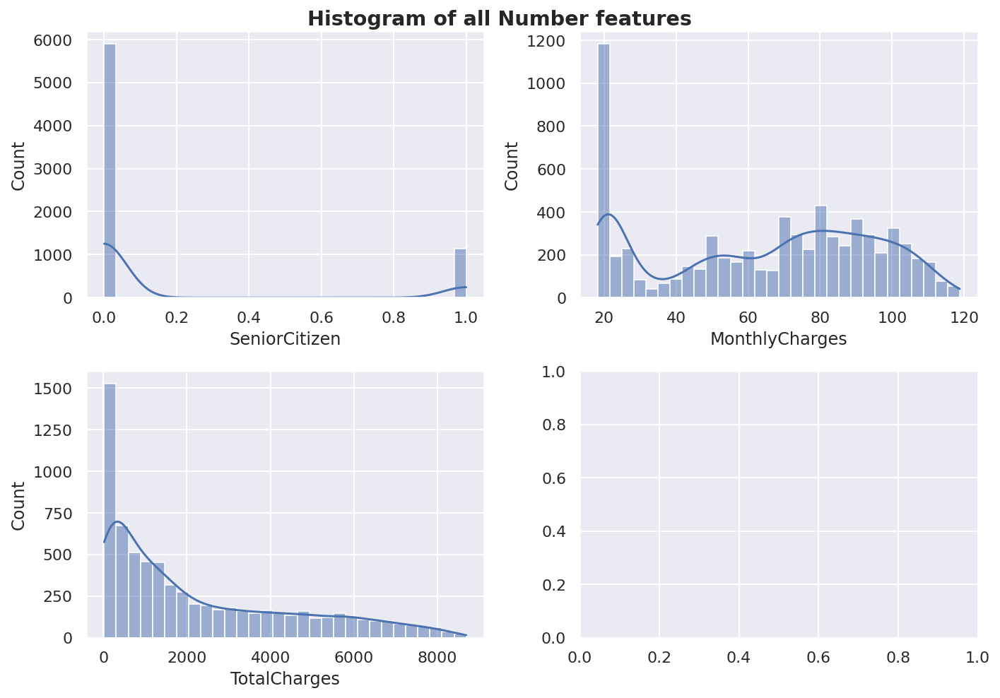

In [80]:
ax = mulitple_function_plots(data=raw_data,plot_type="histogram",data_type="number", fig_size=(10,7))

1. We can see that Total Charges has quite amounts of instacnes are near 0, which doesn't suit for common sense.
2. Monthly Charge has quite amounts of instances of 20. We could say that most of people choose the lowest price plan. We will investigate it soon. 
3. Senior Citzen has only two values. This is not a continuous feature.



Let's take a close look at TotalCharges.
First, we check if there are any total charges == 0.

In [ ]:
len(raw_data[raw_data['TotalCharges'] == 0])

0

Okay. That means we don't have a 0 value data quality issue of Total charges. 

In [ ]:
raw_data['TotalCharges'].describe()

count   7032.00
mean    2283.30
std     2266.77
min       18.80
25%      401.45
50%     1397.47
75%     3794.74
max     8684.80
Name: TotalCharges, dtype: float64

We can see that the minimum value is 18.
We take a close look at total charge less than 100's instance.
Are they all new customers?

Before we corrupt our data, we copy the original dataset and add a new column called date_TS for date time series

In [ ]:
raw_data_copy = raw_data.copy()
raw_data_copy['date_TS'] = pd.to_datetime(raw_data_copy['Date'], format= '%d %b, %Y')

We take a look of their distribution group by years.

In [ ]:
max_print_out(True)
print("There are",len(raw_data_copy.loc[raw_data_copy['TotalCharges'] < 100 , 'date_TS'].dt.year.value_counts()), "years")
raw_data_copy.loc[raw_data_copy['TotalCharges'] < 100 , 'date_TS'].dt.year.value_counts()


There are 11 years


2018    92
2012    84
2014    82
2011    77
2015    73
2020    72
2013    70
2016    69
2017    66
2019    65
2010    63
Name: date_TS, dtype: int64

Text(0.5, 1.0, 'Bar plot of total charge less than 100')

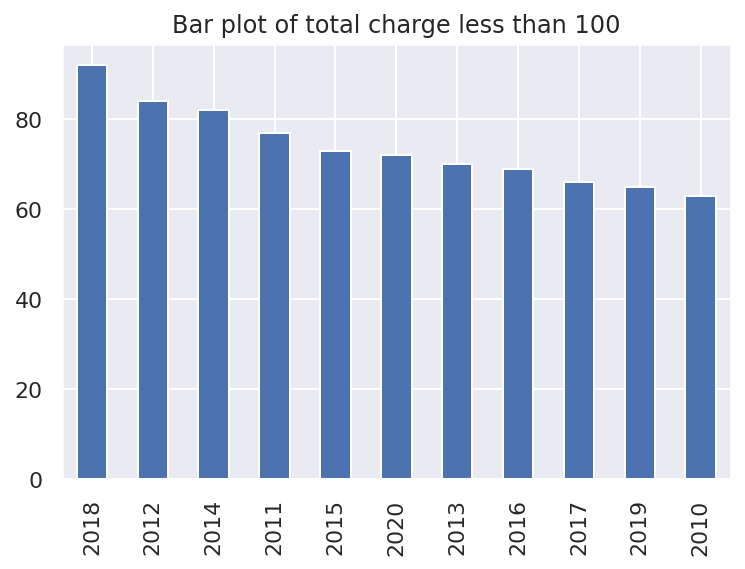

In [ ]:
raw_data_copy.loc[raw_data_copy['TotalCharges'] < 100 , 'date_TS'].dt.year.value_counts().plot.bar()
plt.title("Bar plot of total charge less than 100")

We can see the total charges less than 100 are distributed in every year.
My assumption is they are all churn YES instances.


In [ ]:
raw_data_copy.loc[raw_data_copy['TotalCharges'] < 100 , 'Churn'].value_counts()

Yes    431
No     382
Name: Churn, dtype: Int64

In [ ]:
temp_data_100 = raw_data_copy.loc[raw_data_copy['TotalCharges'] < 100 ]
temp_data_100[temp_data_100['Churn']=='No'].head()

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,...,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date,date_TS
17,0021-IKXGC,Female,1,No,No,Yes,No,No internet service,No internet service,No internet service,...,No internet service,No internet service,Month-to-month,Yes,Mailed Check,72.10,72.10,No,"10 Jan, 2010",2010-01-10
23,0030-FNXPP,Female,0,No,No,Yes,No,No internet service,No internet service,No internet service,...,No internet service,No internet service,Month-to-month,Yes,Mailed Check,19.85,57.20,No,"12 Jan, 2010",2010-01-12
48,0082-LDZUE,Male,0,No,No,Yes,No,No internet service,No internet service,No internet service,...,No internet service,No internet service,Month-to-month,Yes,Electronic Check,44.30,44.30,No,"27 Jan, 2010",2010-01-27
100,0178-CIIKR,Female,0,No,No,Yes,DSL,No,No,No,...,No,No,Month-to-month,Yes,Mailed Check,19.95,58.00,No,"26 Feb, 2010",2010-02-26
106,0188-GWFLE,Male,0,No,No,Yes,No,No internet service,No internet service,No internet service,...,No internet service,No internet service,Month-to-month,Yes,Electronic Check,20.05,33.70,No,"28 Feb, 2010",2010-02-28


In [ ]:
len(temp_data_100[temp_data_100['Churn']=='No'])

382

We pick one to see its detail.

In [ ]:
temp_data_100[temp_data_100['customerID'] == '0030-FNXPP']

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,...,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date,date_TS
23,0030-FNXPP,Female,0,No,No,Yes,No,No internet service,No internet service,No internet service,...,No internet service,No internet service,Month-to-month,Yes,Mailed Check,19.85,57.20,No,"12 Jan, 2010",2010-01-12


Now, we can confirm that the aboving make no sense instances' customerIDs are unique. Hence, there aren't any chance that a customer is using the service on Jan, 2010, but left sometime on Feb, 2010.
Which means there is no chance it exists another instance indicates his/her leaving. 

However, ask this question to TA and as the response from company side. Those could be a data quality issue, or not. We have no ability to handle this without a threshold and instruction from company side. 

Therefore, we ignore this problem in this assignment.

##### a.4.1.b. Boxplot of all cont. features.<a class="anchor" name="task1_a_4_1_b"></a>
Boxplot is very good to show outliers and mathematical status of each cont. features.<br>
Such as median, max,min, 1st quartile and 3rd quartile.<br>
It will help us find most data quality issues.<br>

Those features will be plotted in  2  rows and 2 columns
Index(['SeniorCitizen', 'MonthlyCharges', 'TotalCharges'], dtype='object')


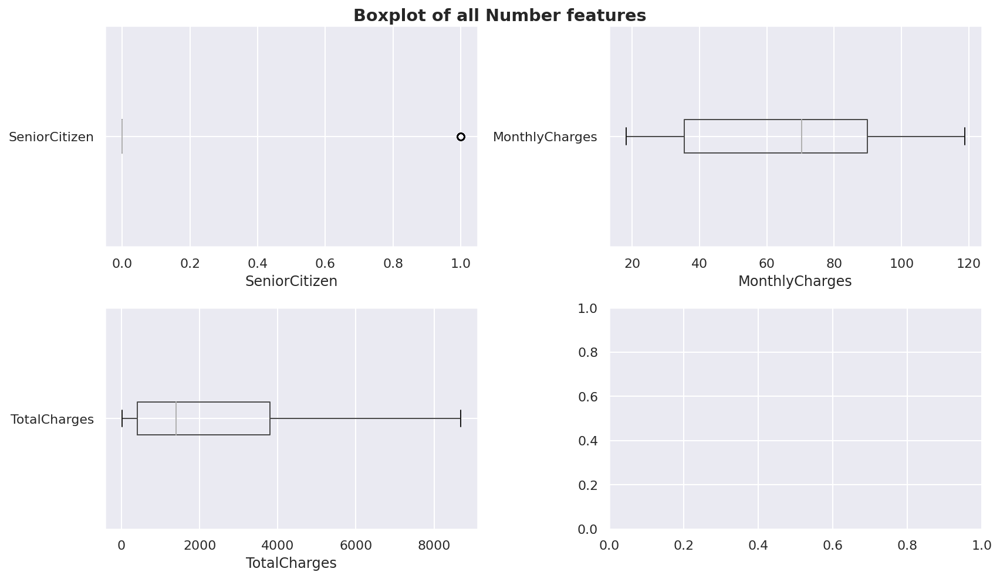

In [35]:
ax = mulitple_function_plots(data=raw_data,plot_type="boxplot",data_type="number", fig_size=(12,7))

We are glad to find that there are not too many outliers in this dataset.

#### a.4.2. Categorical features<a class="anchor" name="task1_a_4_2"></a>
Plot barplot for categorical features.

> From above categorical data quality report, we already know that "Date" and "CustomerID" have quite high cardinality.<br>
Which is basically impossible to plot in a single bar plot, and plot a feature that we already know it has problem is not wise <br>
Hence, I drop the column of those two features first. Plot the rest of them.


Those features will be plotted in  8  rows and 2 columns
Index(['gender', 'Partner', 'Dependents', 'PhoneService', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'Churn'],
      dtype='object')


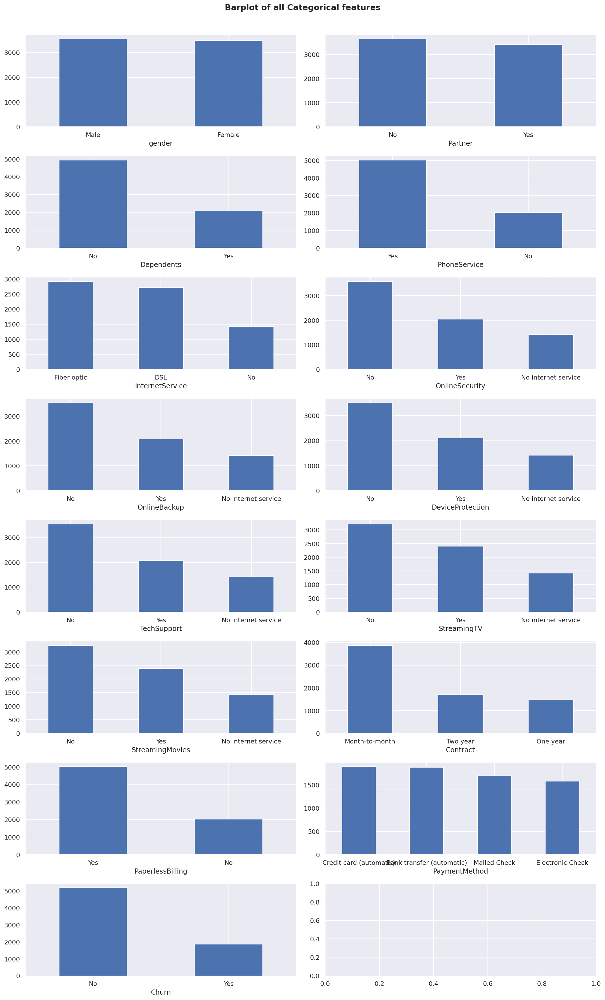

In [38]:
mulitple_function_plots(tight_layout=True,fig_size=(15,25), 
                        data=raw_data.drop(['Date','customerID'],axis=1),plot_type='barplot',data_type='categorical');

We can see PaymentMethod has a bad presentation. 
We plot it individually.


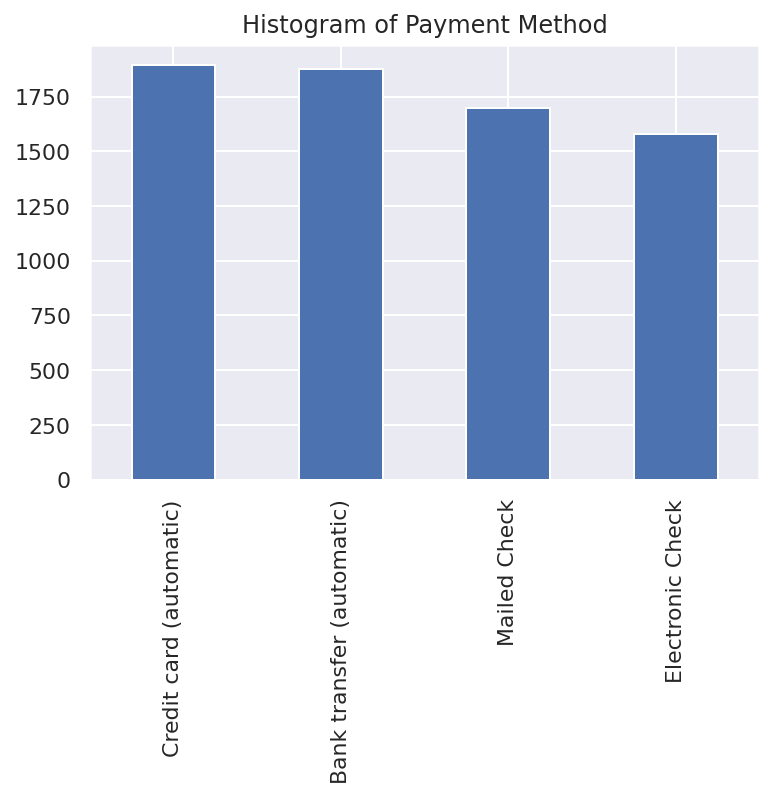

In [39]:
 plt.title("Histogram of Payment Method")
 raw_data['PaymentMethod'].value_counts().plot.bar();

We can see that those categorical features are quite good. No data quality issues here. Except we need to change No internet service to No sooner.

We use histogram to plot Date:

But we don't plot anything about customerID yet. That feature is like index. And without the ability of consulting how the value of customerID is generated, we ignore it for now.

In [40]:
date_col = pd.DataFrame(raw_data['Date'])

We have experience on dealing those in Assignment 1.
We do the time series directly.

##### Time series plot

We first take a look on Date column with 1 instance.


In [ ]:
date_col.head(1)

,Date
0,"01 Jan, 2010"


We change our data to time series.

In [ ]:
date_col = pd.to_datetime(date_col['Date'], format= '%d %b, %Y')
# %b for Month as locale’s abbreviated name.

> From [Datetime documentation](https://docs.python.org/3/library/datetime.html#strftime-and-strptime-behavior)

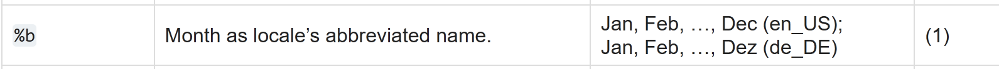

Print out head for check whether is success.

In [ ]:
date_col.head()

0   2010-01-01
1   2010-01-01
2   2010-01-01
3   2010-01-02
4   2010-01-03
Name: Date, dtype: datetime64[ns]

Print time series histogram.

Text(0.5, 1.0, 'Histogram of Date')

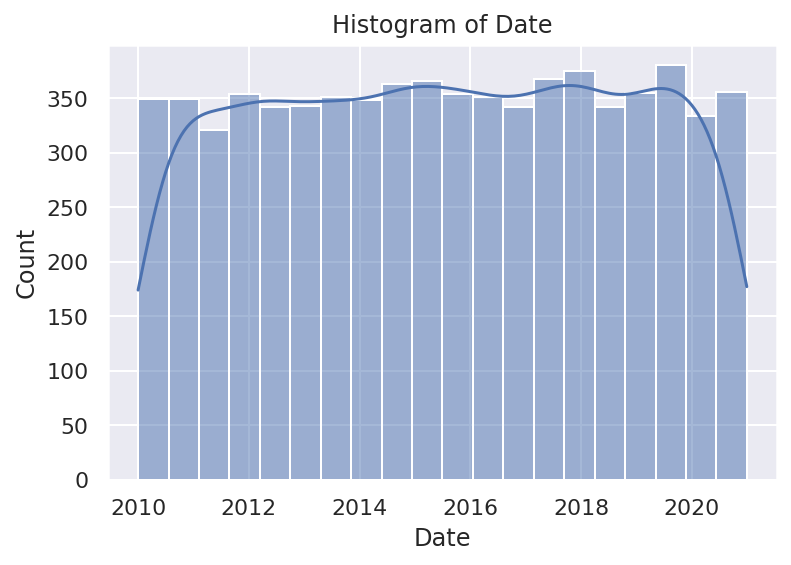

In [ ]:
sns.histplot(data=date_col,kde=True)
plt.title("Histogram of Date")

This historgram shows little useful information. 

We fist take a look of its value counts that groups by years.

In [ ]:
date_col.dt.year.value_counts()

2019    670
2015    656
2017    644
2018    644
2014    642
2016    642
2012    641
2020    631
2011    629
2013    628
2010    616
Name: Date, dtype: int64

Check how many years we have.

In [ ]:
len(date_col.dt.year.value_counts())

11

We set explict x-ticks for 11 years.

Text(0.5, 1.0, "Histogram of 'Date' group by years")

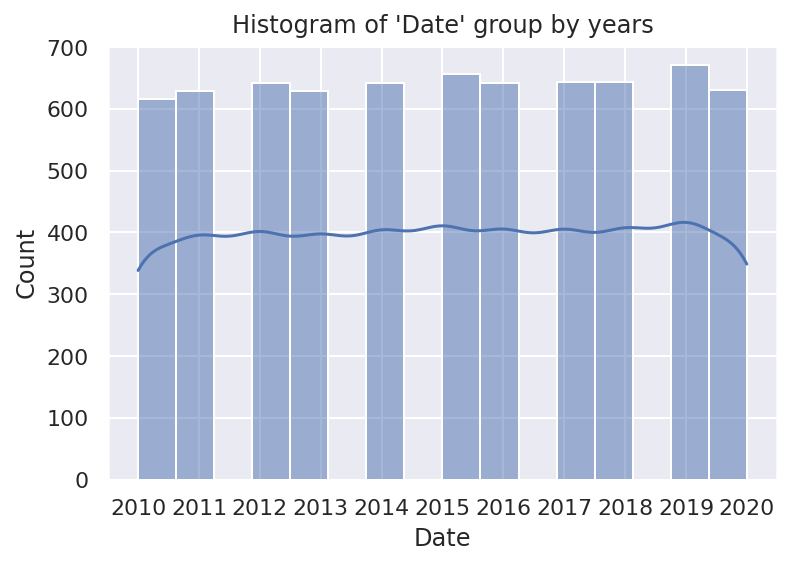

In [ ]:
from matplotlib.ticker import MaxNLocator
fig, ax = plt.subplots()
ax = sns.histplot(data=date_col.dt.year, kde=True) # dt.year is datetime group by years
ax.xaxis.set_major_locator(MaxNLocator(11)) 
plt.title("Histogram of 'Date' group by years")


We can see that, this company, every year has similar amounts new cutomers to join their service.

At the last, let's take a look at our target value. Churn.

Text(0.5, 1.0, 'Histogram of Churn')

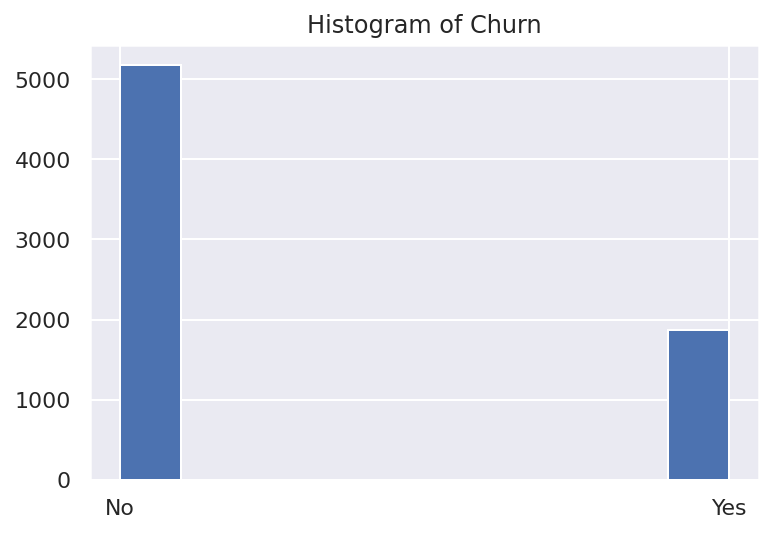

In [ ]:
raw_data['Churn'].hist()
plt.title("Histogram of Churn")

We can see that there is a huge unbalance of our target value. 
We will do oversamping soon at the split dataset stage. 
But since we only want to do oversampling on training set, but not on test set.
We won't do it on data preparation stage.

## b. Identify data quality issues and build the data quality plan<a class="anchor" name="task1_c"></a>
  

In [ ]:
raw_data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'PhoneService', 'InternetService', 'OnlineSecurity', 'OnlineBackup',
       'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
       'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges',
       'TotalCharges', 'Churn', 'Date'],
      dtype='object')

### b.1. Data quality issues table<a class="anchor" name="task1_c_1"></a>

| Continuous Feature   | Data Quality Issue  | Potential Handling Strategies  |
 |  ----  |          ----   |              --- |
| SeniorCitizen  |Not categorical data. |Nothing need to do. The current form is what we need|
| TotalyCharges  | Have 11 NaN values| Further inverstigation|

---
Since we are predicting a value in our task. Then in a regression model. We need to covert categorical data to a continuous form.

| Categorical Feature   | Data Quality Issue  | Potential Handling Strategies  |
|  ----  |          ----   |              --- |
| Churn  | Unbalanced target value | oversampling at dataset split stage|  |
| customerID  | Not useful data | drop the column  |
| Date  | contiunous data of time series| convert to time series |
| OnlineSecurity  |2 features with one meaning | combine features: No and No Internet Service |
| OnlineBackup  |2 features with one meaning | combine features: No and No Internet Service |
| DeviceProtection  |2 features with one meaning | combine features: No and No Internet Service |
| TechSupport  |2 features with one meaning | combine features: No and No Internet Service |
| StreamingTV  |2 features with one meaning | combine features: No and No Internet Service |
| StreamingMovies  |2 features with one meaning | combine features: No and No Internet Service |
| Contract | 3 values | Change to int type, with weight of its contract type|
| PaymentMethod  | 4 values | One hot encoder|
| All rest of categorical features  | String type | Change to int type, details/methods in the following section|

> In this project, the Churn is our target value.

#### b.1.1 Identify the problem<a class="anchor" name="task1_c_1.1"></a>  
Now let's figure out what problem we have now.



##### c.1.1.1  TotalCharges' value investigation <a class="anchor" name="task1_c_1.1.1"></a>  
First we plot the histogram again.

We start to see what its distribution is.

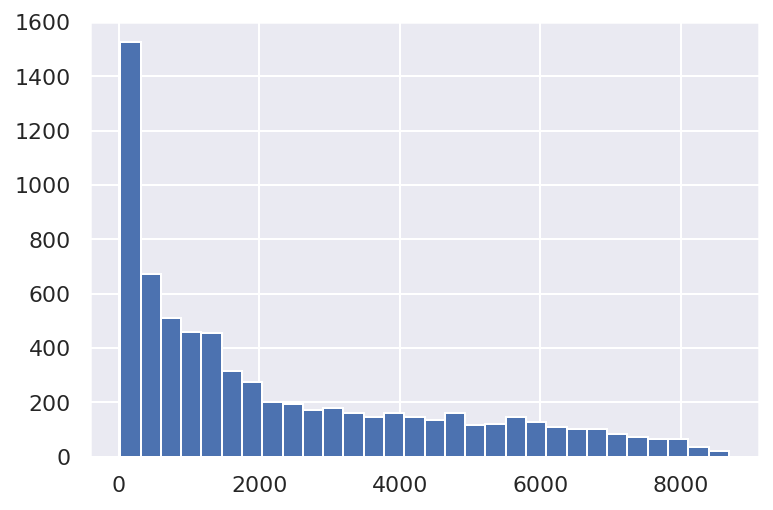

In [42]:
# whole distribution
raw_data.TotalCharges.hist(bins=30)

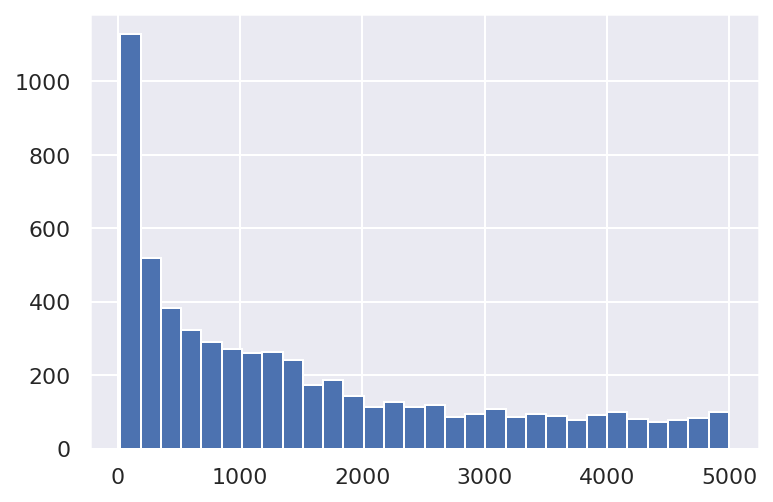

In [ ]:
# less than 5000
(raw_data[(raw_data['TotalCharges'] < 5000)]).TotalCharges.hist(bins=30)

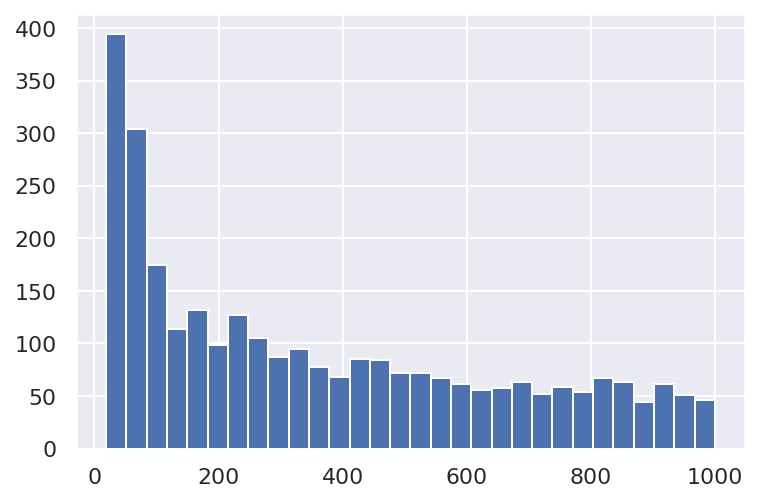

In [ ]:
# less than 1000
(raw_data[(raw_data['TotalCharges'] < 1000)]).TotalCharges.hist(bins=30)

###### We can see there is no a big difference between three different splits. It's time to create a function for finding its IQR values and outliers.

In [ ]:
#-------------  detect and delete outliers -----------------------------------------------------

def find_outliers(data_df, parameter,drop=False, set_threshold=False, threshold_value = 10): # deal with outliers
    
    '''detect and delete outliers '''
    Q1 = data_df[parameter].quantile(0.25) # get Q1
    Q3 = data_df[parameter].quantile(0.75) # get Q2 
    IQR = Q3-Q1 # get IQR
    print(f"IQR = {Q3} - {Q1} = {IQR}")
    print(f"MAX = {(Q3 + 1.5 * IQR)}")
    
    # we don't want a negative IQR. It's meanless in our dataset

    if Q1 > 1.5*IQR :
        print("Min: ", (Q1 - 1.5 * IQR))
    else:
        print("Min is 0")
    # set purge threshold
    cut_out_value =  (Q3 + 1.5 * IQR)
    if set_threshold == True:
        cut_out_value = threshold_value
    # print out useful information
    min_outliers_df = data_df[(data_df[parameter] < (Q1 - 1.5 * IQR))]
    max_outliers_df = data_df[(data_df[parameter] > cut_out_value)]           
    print("Num of min outliers: ", len(min_outliers_df))
    print("Num of max outliers: ", len(max_outliers_df))
    if drop:
        return data_df.drop(max_outliers_df.index)


###### Show outliers. 

In [ ]:
find_outliers(raw_data_copy,'TotalCharges',False)

IQR = 3794.7375 - 401.45 = 3393.2875000000004
MAX = 8884.66875
Min is 0
Num of min outliers:  0
Num of max outliers:  0


We don't have outliers in TotalCharges

In [ ]:
find_outliers(raw_data_copy,'MonthlyCharges',False)

IQR = 89.85 - 35.5 = 54.349999999999994
MAX = 171.375
Min is 0
Num of min outliers:  0
Num of max outliers:  0


We don't have outliers in MonthlyCharges either.

In [ ]:
# We take a look at data's info again.
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   string 
 1   gender            7043 non-null   string 
 2   SeniorCitizen     7043 non-null   Int64  
 3   Partner           7043 non-null   string 
 4   Dependents        7043 non-null   string 
 5   PhoneService      7043 non-null   string 
 6   InternetService   7043 non-null   string 
 7   OnlineSecurity    7043 non-null   string 
 8   OnlineBackup      7043 non-null   string 
 9   DeviceProtection  7043 non-null   string 
 10  TechSupport       7043 non-null   string 
 11  StreamingTV       7043 non-null   string 
 12  StreamingMovies   7043 non-null   string 
 13  Contract          7043 non-null   string 
 14  PaperlessBilling  7043 non-null   string 
 15  PaymentMethod     7043 non-null   string 
 16  MonthlyCharges    7043 non-null   Float64


But we have 11 Nan Values. 
Let's take a look at those NaN values.

In [ ]:
raw_data.isna().sum().sum()

11

We can see that we have 11 Nan values.
Let's see what they are.

In [ ]:
raw_data[raw_data.isna().any(axis=1)]

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
945,1371-DWPAZ,Female,0,Yes,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,Yes,Bank transfer (automatic),56.05,<NA>,No,"04 Jul, 2011"
1731,2520-SGTTA,Female,0,Yes,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,Yes,Mailed Check,20.00,<NA>,No,"09 Oct, 2012"
1906,2775-SEFEE,Male,0,No,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,Yes,Bank transfer (automatic),61.90,<NA>,No,"13 Jan, 2013"
2025,2923-ARZLG,Male,0,Yes,Yes,Yes,DSL,No,No,No,No,No,No,One year,Yes,Credit card (automatic),19.70,<NA>,No,"05 Apr, 2013"
2176,3115-CZMZD,Male,0,No,Yes,Yes,DSL,Yes,No,No,No,No,No,Two year,Yes,Electronic Check,20.25,<NA>,No,"16 Jun, 2013"
2250,3213-VVOLG,Male,0,Yes,Yes,Yes,Fiber optic,Yes,No,No,No,No,No,Two year,Yes,Electronic Check,25.35,<NA>,No,"30 Jul, 2013"
2855,4075-WKNIU,Female,0,Yes,Yes,Yes,Fiber optic,No,No,No,No,No,No,Two year,Yes,Electronic Check,73.35,<NA>,No,"20 Jul, 2014"
3052,4367-NUYAO,Male,0,Yes,Yes,Yes,DSL,No,Yes,No,No,Yes,Yes,Two year,Yes,Credit card (automatic),25.75,<NA>,No,"07 Nov, 2014"
3118,4472-LVYGI,Female,0,Yes,Yes,Yes,Fiber optic,Yes,No,No,No,Yes,No,Two year,Yes,Electronic Check,52.55,<NA>,No,"13 Dec, 2014"
4054,5709-LVOEQ,Female,0,Yes,Yes,No,Fiber optic,No,Yes,No,Yes,No,Yes,Two year,Yes,Bank transfer (automatic),80.85,<NA>,No,"13 May, 2016"


Since 11 instances are too few and there is no good way to fill these NaN values. We just drop those instances.

Now, we only need to focus on transfering categorical data into continuous data in this dataset.

### b.1.2 Data quality plan<a class="anchor" name="task1_c_1.2"></a>  

**Churn:** 
  * oversampling training set before training.

**customerID:** 
   * Drop

**Date:** 
   * Change to time series data. And calculate days from its date to now as a new features called days.

**OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport,StreamingTv, StreamingMovies**
   * Change No and No Internet Service to Int 0
   * Change Yes to 1
   
**Contract** 
   * Month-to-Month to Int 1
   * 1 year to Int 12
   * 2 years to Int 24

**Partner, Dependents, PhoneService, PaperlessBilling, Churn**
   * Yes to Int 1
   * No to Int 0
   
**PaymentMethod, gender**
   * Use one hot encoder to convert this feature.

**InternetService**
   * Faiber optic is much faster than DSL. Set priority on 3 values
   * Fiber optic = 2
   * DSL = 1
   * No = 0
**TotalCharges**
   * Drop all NaN instances.

## c.Preprocess your data according to the data quality plan<a class="anchor" name="task1_2"></a>

### c.1.0 Utility Functions in this section.<a class="anchor" name="task1_2.1.0"></a>

> Hidden blocks. Unfold for details. Run all functions for this section.
> <br> Redesigned for Assignment 2

***We will update our piple later in this notebook. If you run any errors. Re run the utility function at the begining. It has the most advanced version.***

In [ ]:
############################FUNCTIONS ON PIPELINE##########################################


#---------------categorical_df_to_continuous_df---------
# change categorical data to continuous data
def categorical_df_to_continuous_df(data_df, features, cate_values, cont_values):
  data_copy = data_df.copy()
  for i in range(len(features)):
    data_copy[features[i]].replace(cate_values,
                        cont_values, inplace=True)
  return data_copy

#---------------describe_categorical_features---------
# create a new table to show details of categorical features
def describe_categorical_features(data_df, features):
  temp_data = data_df[features[0]].value_counts().to_frame().T
  for i in range(len(features) - 1):
    A = data_df[features[i+1]].value_counts().to_frame().T
    temp_data = pd.concat([temp_data,A], axis=0)
  return temp_data


def create_dp_data(X):
    # we need to normalized 3 continuous features
  # 1. TotalCharges
  normal_tc = X.pop('TotalCharges')
  normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
  # 2. MonthlyCharges
  normal_mc = X.pop('MonthlyCharges')
  normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
  # 3. Tenue
  normal_te = X.pop('Tenure')
  normal_te = (normal_te - normal_te.mean())/normal_te.std()
  X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)
  X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
             'TotalCharges','Tenure' , 'InternetService', 'Churn']] # pop all useful features.
  return X

################################  CLASS  ################################

#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # we need to normalized 3 continuous features
      # 1. TotalCharges
      normal_tc = X.pop('TotalCharges')
      normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
      # 2. MonthlyCharges
      normal_mc = X.pop('MonthlyCharges')
      normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
      # 3. Tenue
      normal_te = X.pop('Tenure')
      normal_te = (normal_te - normal_te.mean())/normal_te.std()
      X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)

      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.to_numpy()
      else:
        return X




#------------- main transformer ---------------------
# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = True, servies_remainer = False, normalization = True): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_cleaner = data_cleaner
        self.servies_remainer = servies_remainer
        self.normalization = normalization

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()

        #0. drop NaN values
        Nan_df = X[X.isna().any(axis=1)]  
        X = X.drop(Nan_df.index)

        # 1. First we change our features with only Yes and No.
        categorical_to_continuous_df(X, ['Partner', 'Dependents', 
                                                  'PhoneService', 'PaperlessBilling', 'Churn'],
                                                 cate_values=['Yes', 'No'], cont_values=[1,0])
        # 2. Now convert Yes to 1 and No, No internet service to 0.

        if self.servies_remainer == True:
          categorical_to_continuous_df(X, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                          'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                  cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,-1])
        else:
          categorical_to_continuous_df(X, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                            'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                    cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,0])
          
        # 3. Now, we change InternetService's DSL to 1, Fiber optic to 2, and No to 0
        categorical_to_continuous_df(X, ['InternetService'],
                                                   cate_values=['Fiber optic', 'DSL', 'No'], cont_values=[2,1,0])
        # 4. Contract's month-to-month to 1, 1 year to 12, and 2 years to 24
        categorical_to_continuous_df(X, ['Contract'],
                                                   cate_values=['Month-to-month', 'One year', 'Two year'], cont_values=[1,12,24])
        
        # 5. Now, we change gende, PaymentMethod to one hot encoder.
        gender = pd.get_dummies(X.pop('gender'))
        PaymentMethod = pd.get_dummies(X.pop('PaymentMethod'))
        X = pd.concat([X, PaymentMethod.astype(int), gender.astype(int)], axis=1)

        #convert Date to time series
        temp_date_saver = X.pop('Date')
        X['Date'] = pd.to_datetime(temp_date_saver, format= '%d %b, %Y')

        # create a new features called Tenure 
        X['Tenure'] = (pd.to_datetime('2022-06-29', format= '%Y-%m-%d') - X['Date']).dt.days

        # drop all useless features and categorical features we alreayd transfered
        X = X.drop('customerID',axis=1) 
      
        # we put our target value at the end
        target = X.pop('Churn')
        X['Churn'] = target

        # define when we normailize our numerical features
        if self.normalization == True:
          # we need to normalized 3 continuous features
          # 1. TotalCharges
          normal_tc = X.pop('TotalCharges')
          normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
          # 2. MonthlyCharges
          normal_mc = X.pop('MonthlyCharges')
          normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
          # 3. Tenue
          normal_te = X.pop('Tenure')
          normal_te = (normal_te - normal_te.mean())/normal_te.std()
          X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)

        # NOT APPLIED IN THIS PART
        # if self.data_cleaner:
        #   X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
        #             'TotalCharges','Tenure' , 'InternetService', 'Churn']] # pop all useful features.
        #   return X
        # else:        
        if self.data_cleaner == True:
          X = X.drop('Date', axis=1)

        # we put our target value at the end
        target = X.pop('Churn')
        X['Churn'] = target


        return X
        
    
#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler


# convert_pipeline is for create a whole pipeline but remain the dataFrame structure
convert_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])


# remain_internet_service_option will keep the features about internet service in 3 categories, YES, NO and NO internet service

remain_internet_service_option = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(servies_remainer=True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])



#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('num_transfer', numerical_transfer()),
    ])

# whole_features_remain_pipeline will remain all the features but convert categorical data to numberical values
whole_features_remain_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False, normalization = False))
    ])

# all_features_remain_and_normalized_pipeline will keep all features but normalize continuous features
all_features_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False, normalization = True)), 
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])

# full pipeline to create a prepared dataset in a glance
full_pipeline = Pipeline([
     ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
     ('num_transfer', numerical_transfer()),
])



### c.1 Create data preparation Pipeline<a class="anchor" name="task1_2.1"></a>

### c.1.1 Change categorical data to continuous data<a class="anchor" name="task1_2.1.1"></a>

All we need to do is replace Yes to 1, No to 0 and No internet service to 0.

Let's write a function to do so.

In [43]:
#---------------categorical_df_to_continuous_df---------
# change categorical data to continuous data
def categorical_to_continuous_df(data_df, features, cate_values, cont_values):
  for i in range(len(features)):
    data_df[features[i]].replace(cate_values,
                        cont_values, inplace=True) # change the values from functions parameters to 1,or 0


Let's do some test on this function I wrote.

In [44]:
converted_data = raw_data.copy()

First we drop Nan instances.

In [45]:
# drop NaN values
Nan_df = converted_data[converted_data.isna().any(axis=1)]  
converted_data = converted_data.drop(Nan_df.index)

In [46]:
converted_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7032 non-null   string 
 1   gender            7032 non-null   string 
 2   SeniorCitizen     7032 non-null   Int64  
 3   Partner           7032 non-null   string 
 4   Dependents        7032 non-null   string 
 5   PhoneService      7032 non-null   string 
 6   InternetService   7032 non-null   string 
 7   OnlineSecurity    7032 non-null   string 
 8   OnlineBackup      7032 non-null   string 
 9   DeviceProtection  7032 non-null   string 
 10  TechSupport       7032 non-null   string 
 11  StreamingTV       7032 non-null   string 
 12  StreamingMovies   7032 non-null   string 
 13  Contract          7032 non-null   string 
 14  PaperlessBilling  7032 non-null   string 
 15  PaymentMethod     7032 non-null   string 
 16  MonthlyCharges    7032 non-null   Float64


Now we can see that we have no Nan Values.

Then we change our features with only Yes and No.

In [47]:
categorical_to_continuous_df(converted_data, ['Partner', 'Dependents', 
                                                  'PhoneService', 'PaperlessBilling', 'Churn'],
                                                 cate_values=['Yes', 'No'], cont_values=[1,0])

In [48]:
max_print_out(True)
converted_data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
0,0002-ORFBO,Female,0,1,1,1,DSL,No,No,No,No,No,No,One year,1,Electronic Check,65.60,593.30,0,"01 Jan, 2010"
1,0003-MKNFE,Male,0,0,0,1,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Month-to-month,1,Mailed Check,59.90,542.40,0,"01 Jan, 2010"
2,0004-TLHLJ,Male,0,0,0,1,DSL,No,No,No,No,No,No,Month-to-month,1,Credit card (automatic),73.90,280.85,1,"01 Jan, 2010"
3,0011-IGKFF,Male,1,1,0,1,DSL,No,No,No,No,No,No,Month-to-month,1,Credit card (automatic),98.00,1237.85,1,"02 Jan, 2010"
4,0013-EXCHZ,Female,1,1,0,1,DSL,Yes,Yes,No,No,No,No,Month-to-month,1,Electronic Check,83.90,267.40,1,"03 Jan, 2010"


Nice, that's what we need. 
Now convert Yes to 1 and No, No internet service to 0.

In [49]:
categorical_to_continuous_df(converted_data, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                           'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                   cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,0])

In [50]:
max_print_out(True)
converted_data.head(2)

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
0,0002-ORFBO,Female,0,1,1,1,DSL,0,0,0,0,0,0,One year,1,Electronic Check,65.60,593.30,0,"01 Jan, 2010"
1,0003-MKNFE,Male,0,0,0,1,No,0,0,0,0,0,0,Month-to-month,1,Mailed Check,59.90,542.40,0,"01 Jan, 2010"


Now, we change InternetService's DSL to 1, Fiber optic to 2, and No to 0

In [53]:
categorical_to_continuous_df(converted_data, ['InternetService'],
                                                   cate_values=['Fiber optic', 'DSL', 'No'], cont_values=[2,1,0])

In [54]:
max_print_out(True)
converted_data.head(2)

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
0,0002-ORFBO,Female,0,1,1,1,1,0,0,0,0,0,0,One year,1,Electronic Check,65.60,593.30,0,"01 Jan, 2010"
1,0003-MKNFE,Male,0,0,0,1,0,0,0,0,0,0,0,Month-to-month,1,Mailed Check,59.90,542.40,0,"01 Jan, 2010"


Now, we change Contract's month-to-month to 1, 1 year to 12, and 2 years to 24

In [55]:
categorical_to_continuous_df(converted_data, ['Contract'],
                                                   cate_values=['Month-to-month', 'One year', 'Two year'], cont_values=[1,12,24])

In [56]:
max_print_out(True)
converted_data.head(2)

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date
0,0002-ORFBO,Female,0,1,1,1,1,0,0,0,0,0,0,12,1,Electronic Check,65.60,593.30,0,"01 Jan, 2010"
1,0003-MKNFE,Male,0,0,0,1,0,0,0,0,0,0,0,1,1,Mailed Check,59.90,542.40,0,"01 Jan, 2010"


Now, we change gender Female and male to one hot encoder.

In [57]:
gender = pd.get_dummies(converted_data.pop('gender'))
converted_data= pd.concat([converted_data,gender.astype(int)], axis=1)

In [61]:
max_print_out(True)
converted_data.head(2)

,customerID,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,Date,Female,Male
0,0002-ORFBO,0,1,1,1,1,0,0,0,0,0,0,12,1,Electronic Check,65.60,593.30,0,"01 Jan, 2010",1,0
1,0003-MKNFE,0,0,0,1,0,0,0,0,0,0,0,1,1,Mailed Check,59.90,542.40,0,"01 Jan, 2010",0,1


Now we use one hot encoder to convert PaymentMethod

In [62]:
PaymentMethod = pd.get_dummies(converted_data.pop('PaymentMethod'))
converted_data= pd.concat([converted_data,PaymentMethod.astype(int)], axis=1)

In [63]:
max_print_out(True)
converted_data.head(2)

,customerID,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Date,Female,Male,Bank transfer (automatic),Credit card (automatic),Electronic Check,Mailed Check
0,0002-ORFBO,0,1,1,1,1,0,0,0,0,0,0,12,1,65.60,593.30,0,"01 Jan, 2010",1,0,0,0,1,0
1,0003-MKNFE,0,0,0,1,0,0,0,0,0,0,0,1,1,59.90,542.40,0,"01 Jan, 2010",0,1,0,0,0,1


Now, we drop customerID.

In [64]:
converted_data = converted_data.drop('customerID',axis=1);

In [65]:
max_print_out(True)
converted_data.head(2)

,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,Date,Female,Male,Bank transfer (automatic),Credit card (automatic),Electronic Check,Mailed Check
0,0,1,1,1,1,0,0,0,0,0,0,12,1,65.60,593.30,0,"01 Jan, 2010",1,0,0,0,1,0
1,0,0,0,1,0,0,0,0,0,0,0,1,1,59.90,542.40,0,"01 Jan, 2010",0,1,0,0,0,1


Take a look at first 5 rows.

In [74]:
max_print_out(True)
converted_data.head().T

,0,1,2,3,4
SeniorCitizen,0,0,0,1,1
Partner,1,0,0,1,1
Dependents,1,0,0,0,0
PhoneService,1,1,1,1,1
InternetService,1,0,1,1,1
OnlineSecurity,0,0,0,0,1
OnlineBackup,0,0,0,0,1
DeviceProtection,0,0,0,0,0
TechSupport,0,0,0,0,0
StreamingTV,0,0,0,0,0


Now we convert Date to time series and create a new features called days.

In [66]:
temp_date_saver = converted_data.pop('Date')
converted_data['Date'] =  pd.to_datetime(temp_date_saver, format= '%d %b, %Y')

# create a new features called Tenure 
converted_data['Tenure'] = (pd.to_datetime('2022-06-29', format= '%Y-%m-%d') - converted_data['Date']).dt.days
  

The following is the data preparation results we got.

In [73]:
converted_data.head().T

,0,1,2,3,4
SeniorCitizen,0,0,0,1,1
Partner,1,0,0,1,1
Dependents,1,0,0,0,0
PhoneService,1,1,1,1,1
InternetService,1,0,1,1,1
OnlineSecurity,0,0,0,0,1
OnlineBackup,0,0,0,0,1
DeviceProtection,0,0,0,0,0
TechSupport,0,0,0,0,0
StreamingTV,0,0,0,0,0


In [68]:
converted_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 24 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   SeniorCitizen              7032 non-null   Int64         
 1   Partner                    7032 non-null   int64         
 2   Dependents                 7032 non-null   int64         
 3   PhoneService               7032 non-null   int64         
 4   InternetService            7032 non-null   int64         
 5   OnlineSecurity             7032 non-null   int64         
 6   OnlineBackup               7032 non-null   int64         
 7   DeviceProtection           7032 non-null   int64         
 8   TechSupport                7032 non-null   int64         
 9   StreamingTV                7032 non-null   int64         
 10  StreamingMovies            7032 non-null   int64         
 11  Contract                   7032 non-null   int64         
 12  Paperl

In [69]:
converted_data.describe().T

,count,mean,std,min,25%,50%,75%,max
SeniorCitizen,7032.00,0.16,0.37,0.00,0.00,0.00,0.00,1.00
Partner,7032.00,0.48,0.50,0.00,0.00,0.00,1.00,1.00
Dependents,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
PhoneService,7032.00,0.71,0.45,0.00,0.00,1.00,1.00,1.00
InternetService,7032.00,1.21,0.76,0.00,1.00,1.00,2.00,2.00
OnlineSecurity,7032.00,0.29,0.45,0.00,0.00,0.00,1.00,1.00
OnlineBackup,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
DeviceProtection,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
TechSupport,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
StreamingTV,7032.00,0.34,0.47,0.00,0.00,0.00,1.00,1.00


Now that's what we want.

### c.1.2 Create data pipeline and transformer<a class="anchor" name="task1_2.1.2"></a>

In this stage, we convert what we did above to a transformer class and write a proper pipeline.

The whole transformer idea is coming from the book, [Géron, A. (2019)](https://www.oreilly.com/library/view/hands-on-machine-learning/9781492032632/).  Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition.O'Reilly Media, Inc.. All the details are written by myself.
The book didn't illustrate how to write a pipeline in details. I got a lot of help from [sklearn documentation](https://scikit-learn.org/stable/data_transforms.html).
> Reusing the idea from Assignment 1.
> Redesign functions for Assignment 2.

In [75]:
################################  CLASS  ################################

# Class for attribute transformer
# import important libray
from sklearn.base import BaseEstimator, TransformerMixin

class combined_attribute_adder_and_cleaner(BaseEstimator, TransformerMixin):
    '''data clean transfomer class'''
    
    def __init__(self, data_cleaner = False): # no *args or **kargs
        # we need to set extra var to ensure do we need to purge the dataset. 
        # In my following experments, sometimes we don't need to do so. 
        self.data_clean = data_cleaner

    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, data_df):
        # we first copy the data from our dataset.
        # operate on original data set sometimes is dangerous.
        X = data_df.copy()
        
        #0. drop NaN values
        Nan_df = X[X.isna().any(axis=1)]  
        X = X.drop(Nan_df.index)
        
        # 1. First we change our features with only Yes and No.
        categorical_to_continuous_df(X, ['Partner', 'Dependents', 
                                                  'PhoneService', 'PaperlessBilling', 'Churn'],
                                                 cate_values=['Yes', 'No'], cont_values=[1,0])
        # 2. Now convert Yes to 1 and No, No internet service to 0.
        categorical_to_continuous_df(X, ['OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                                                           'TechSupport', 'StreamingTV', 'StreamingMovies'],
                                                   cate_values=['Yes', 'No', 'No internet service'], cont_values=[1,0,0])
        # 3. Now, we change InternetService's DSL to 1, Fiber optic to 2, and No to 0
        categorical_to_continuous_df(X, ['InternetService'],
                                                   cate_values=['Fiber optic', 'DSL', 'No'], cont_values=[2,1,0])
        # 4. Contract's month-to-month to 1, 1 year to 12, and 2 years to 24
        categorical_to_continuous_df(X, ['Contract'],
                                                   cate_values=['Month-to-month', 'One year', 'Two year'], cont_values=[1,12,24])
        
        # 5. Now, we change gende, PaymentMethod to one hot encoder.
        gender = pd.get_dummies(X.pop('gender'))
        PaymentMethod = pd.get_dummies(X.pop('PaymentMethod'))
        X = pd.concat([X, PaymentMethod.astype(int), gender.astype(int)], axis=1)

        #convert Date to time series
        temp_date_saver = X.pop('Date')
        X['Date'] = pd.to_datetime(temp_date_saver, format= '%d %b, %Y')

        # create a new features called Tenure 
        X['Tenure'] = (pd.to_datetime('2022-06-29', format= '%Y-%m-%d') - X['Date']).dt.days
        
        # drop all useless features and categorical features we alreayd transfered
        X = X.drop('customerID',axis=1) 

        # we put our target value at the end
        target = X.pop('Churn')
        X['Churn'] = target

        
        if self.data_clean:
          X = X.drop('Date', axis=1)
          return X
        else:
        ## if we don't need to purge outliers, then just return X
          return X
        
    

Let's test it.

Now we only do normalization and drop useless features from data plan. We will add more functions to our transfomer after feature selection stage.

In [70]:
raw_data_copy = raw_data.copy()
attr_adder_and_cleaner = combined_attribute_adder_and_cleaner()
converted_transformer = attr_adder_and_cleaner.transform(raw_data_copy)

In [72]:
converted_transformer.head().T

,0,1,2,3,4
SeniorCitizen,0,0,0,1,1
Partner,1,0,0,1,1
Dependents,1,0,0,0,0
PhoneService,1,1,1,1,1
InternetService,1,0,1,1,1
OnlineSecurity,0,0,0,0,1
OnlineBackup,0,0,0,0,1
DeviceProtection,0,0,0,0,0
TechSupport,0,0,0,0,0
StreamingTV,0,0,0,0,0


In [76]:
cat_feat_names = converted_transformer.select_dtypes(include="number").columns;
cat_feat_names

Index(['SeniorCitizen', 'Partner', 'Dependents', 'PhoneService',
       'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'MonthlyCharges', 'TotalCharges',
       'Bank transfer (automatic)', 'Credit card (automatic)',
       'Electronic Check', 'Mailed Check', 'Female', 'Male', 'Tenure',
       'Churn'],
      dtype='object')

In [77]:
max_print_out(False)
# display value counts report of continuous features
describe_columns(converted_transformer, cat_feat_names)

---------- SeniorCitizen ---------
0    5890
1    1142
Name: SeniorCitizen, dtype: Int64
---------- Partner ---------
0    3639
1    3393
Name: Partner, dtype: int64
---------- Dependents ---------
0    4933
1    2099
Name: Dependents, dtype: int64
---------- PhoneService ---------
1    5007
0    2025
Name: PhoneService, dtype: int64
---------- InternetService ---------
2    2913
1    2704
0    1415
Name: InternetService, dtype: int64
---------- OnlineSecurity ---------
0    4995
1    2037
Name: OnlineSecurity, dtype: int64
---------- OnlineBackup ---------
0    4953
1    2079
Name: OnlineBackup, dtype: int64
---------- DeviceProtection ---------
0    4926
1    2106
Name: DeviceProtection, dtype: int64
---------- TechSupport ---------
0    4955
1    2077
Name: TechSupport, dtype: int64
---------- StreamingTV ---------
0    4626
1    2406
Name: StreamingTV, dtype: int64
---------- StreamingMovies ---------
0    4651
1    2381
Name: StreamingMovies, dtype: int64
---------- Contract -----

From above, we can see that everything is in a good shape, (categorical data became numerical values).

Now we draw the histogram again.

Those features will be plotted in  6  rows and  4 columns
Index(['SeniorCitizen', 'Partner', 'Dependents', 'PhoneService',
       'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'MonthlyCharges', 'TotalCharges',
       'Bank transfer (automatic)', 'Credit card (automatic)',
       'Electronic Check', 'Mailed Check', 'Female', 'Male', 'Tenure',
       'Churn'],
      dtype='object')
1 . Finish Rendering : SeniorCitizen , used 0 millseconds
2 . Finish Rendering : Partner , used 0 millseconds
3 . Finish Rendering : Dependents , used 0 millseconds
4 . Finish Rendering : PhoneService , used 0 millseconds
5 . Finish Rendering : InternetService , used 0 millseconds
6 . Finish Rendering : OnlineSecurity , used 0 millseconds
7 . Finish Rendering : OnlineBackup , used 0 millseconds
8 . Finish Rendering : DeviceProtection , used 0 millseconds
9 . Finish Rendering : TechSupport ,

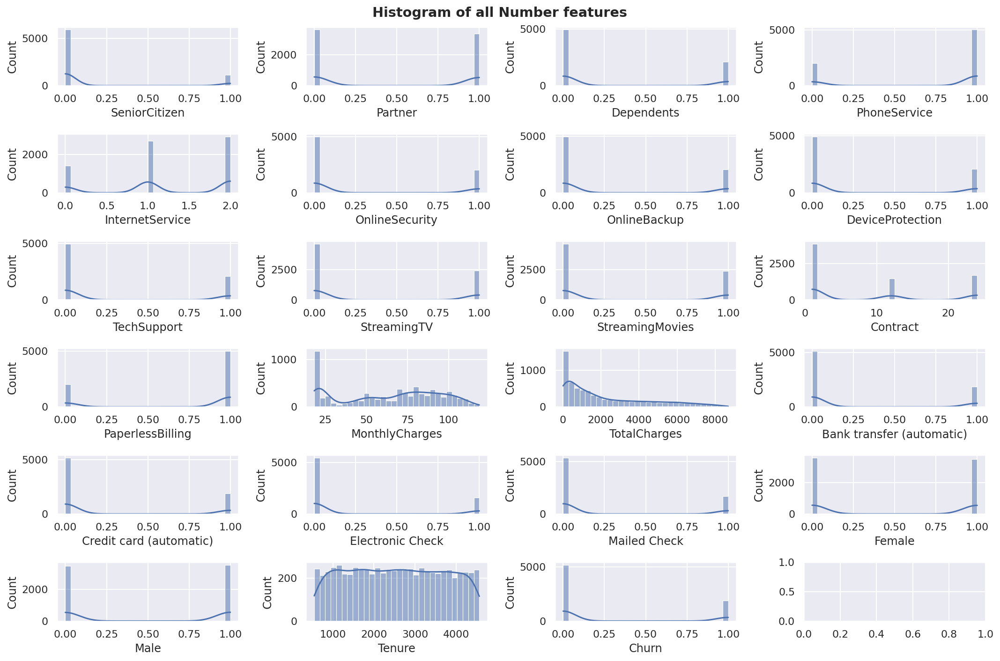

In [86]:
ax = mulitple_function_plots(data=converted_transformer,columns = 4, plot_type="histogram",data_type="number",fig_size=(15,10));

We just finished a transformer. But it is not a pipeline.
Before we continue to create a pipeline. Let's write another transformer that can change our panda dataset to numpy.

***And normalized continuous features.***
<br>
Since, the best fit in every model is a numpy array.

In [ ]:
#------------- transformer for output numpy array for our data set ---------------------

class numerical_transfer(BaseEstimator, TransformerMixin):
    '''numerical_transfer class'''
    
    def __init__(self, transfer_to_number=True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.transfer_to_number = transfer_to_number
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
      # we need to normalized 3 continuous features
      # 1. TotalCharges
      normal_tc = X.pop('TotalCharges')
      normal_tc=(normal_tc-normal_tc.mean())/normal_tc.std()
      # 2. MonthlyCharges
      normal_mc = X.pop('MonthlyCharges')
      normal_mc = (normal_mc-normal_mc.mean())/normal_mc.std()
      # 3. Tenue
      normal_te = X.pop('Tenure')
      normal_te = (normal_te - normal_te.mean())/normal_te.std()
      X = pd.concat([normal_tc, normal_mc, normal_te, X],axis=1)

      # the values of a panda dataframe is all we need.
      if self.transfer_to_number:
        return X.to_numpy()
      else:
        return X

Create a transformer and transform our data.

In [ ]:
attr_adder_and_cleaner = combined_attribute_adder_and_cleaner(data_cleaner=True)
converted_transformer = attr_adder_and_cleaner.transform(raw_data_copy)
num_transfer = numerical_transfer(transfer_to_number=True)
converted_data_num = num_transfer.transform(converted_transformer)

In [ ]:
# Print what we got
converted_data_num

array([[-0.7455539933405015, 0.026650020104510782, 1.7497032336090514,
        ..., 12, 1, 0],
       [-0.7680088385251144, -0.16280703460036836, 1.7497032336090514,
        ..., 1, 0, 0],
       [-0.8833932149108803, 0.3025260822186336, 1.7497032336090514, ...,
        1, 1, 1],
       ...,
       [-0.9663746761923278, -0.4818926004191124, -1.7217842581294396,
        ..., 1, 2, 0],
       [1.0342240944894152, 0.10143569959327892, -1.7226488876417032,
        ..., 24, 2, 0],
       [0.6283384302044833, -0.19272130639587556, -1.7226488876417032,
        ..., 24, 2, 0]], dtype=object)

In [ ]:
# take a look at the first row
converted_data_num[0]

array([-0.7455539933405015, 0.026650020104510782, 1.7497032336090514, 0,
       1, 1, 12, 1, 0], dtype=object)

In [ ]:
# take a look at our new numpy data's info
converted_transformer.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype
---  ------                     --------------  -----
 0   SeniorCitizen              7032 non-null   Int64
 1   Partner                    7032 non-null   int64
 2   Dependents                 7032 non-null   int64
 3   PhoneService               7032 non-null   int64
 4   InternetService            7032 non-null   int64
 5   OnlineSecurity             7032 non-null   int64
 6   OnlineBackup               7032 non-null   int64
 7   DeviceProtection           7032 non-null   int64
 8   TechSupport                7032 non-null   int64
 9   StreamingTV                7032 non-null   int64
 10  StreamingMovies            7032 non-null   int64
 11  Contract                   7032 non-null   int64
 12  PaperlessBilling           7032 non-null   int64
 13  Bank transfer (automatic)  7032 non-null   int64
 14  Credit card (automatic) 

We have everything we need to create a pipeline. <br>

We create 6 different pipelines for our goal.
Details in the following comments.

In [88]:
#############################PIPE LINE###################################################

# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler


# convert_pipeline is for create a whole pipeline but remain the dataFrame structure
convert_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])


# remain_internet_service_option will keep the features about internet service in 3 categories, YES, NO and NO internet service

remain_internet_service_option = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(servies_remainer=True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])



#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('num_transfer', numerical_transfer()),
    ])

# whole_features_remain_pipeline will remain all the features but convert categorical data to numberical values
whole_features_remain_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False, normalization = False))
    ])

# all_features_remain_and_normalized_pipeline will keep all features but normalize continuous features
all_features_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False, normalization = True)), 
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])

# full pipeline to create a prepared dataset in a glance
full_pipeline = Pipeline([
     ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
     ('num_transfer', numerical_transfer()),
])



Let's test our pipeline.


In [89]:
full_pipeline_test = full_pipeline.fit_transform(raw_data_copy)

In [90]:
full_pipeline_test

array([[-0.7455539933405014, 0.026650020104510834, 1.7497032336090512,
        ..., 1, 0, 0],
       [-0.7680088385251143, -0.1628070346003683, 1.7497032336090512,
        ..., 0, 1, 0],
       [-0.8833932149108802, 0.30252608221863364, 1.7497032336090512,
        ..., 0, 1, 1],
       ...,
       [-0.9663746761923276, -0.48189260041911236, -1.7217842581294398,
        ..., 0, 1, 0],
       [1.0342240944894152, 0.10143569959327897, -1.7226488876417034,
        ..., 0, 1, 0],
       [0.6283384302044834, -0.1927213063958755, -1.7226488876417034,
        ..., 0, 1, 0]], dtype=object)

That's exactly what we want. And target value at the last column.

Now, we take another look at convert pipeline.

In [91]:
raw_data_copy = raw_data.copy()

In [92]:
convert_pipeline_test = convert_pipeline.fit_transform(raw_data_copy)

In [95]:
max_print_out(True)
convert_pipeline_test.head().T

,0,1,2,3,4
TotalCharges,-0.75,-0.77,-0.88,-0.46,-0.89
MonthlyCharges,0.03,-0.16,0.30,1.10,0.63
Tenure,1.75,1.75,1.75,1.75,1.75
SeniorCitizen,0,0,0,1,1
Partner,1,0,0,1,1
Dependents,1,0,0,0,0
PhoneService,1,1,1,1,1
InternetService,1,0,1,1,1
OnlineSecurity,0,0,0,0,1
OnlineBackup,0,0,0,0,1


In [ ]:
max_print_out(True)
convert_pipeline_test.describe().T

,count,mean,std,min,25%,50%,75%,max
SeniorCitizen,7032.00,0.16,0.37,0.00,0.00,0.00,0.00,1.00
Partner,7032.00,0.48,0.50,0.00,0.00,0.00,1.00,1.00
Dependents,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
PhoneService,7032.00,0.71,0.45,0.00,0.00,1.00,1.00,1.00
InternetService,7032.00,1.21,0.76,0.00,1.00,1.00,2.00,2.00
OnlineSecurity,7032.00,0.29,0.45,0.00,0.00,0.00,1.00,1.00
OnlineBackup,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
DeviceProtection,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
TechSupport,7032.00,0.30,0.46,0.00,0.00,0.00,1.00,1.00
StreamingTV,7032.00,0.34,0.47,0.00,0.00,0.00,1.00,1.00


This table is not so good anymore. 
Let's create a new descirbe function.

In [122]:
#---------------describe_categorical_features-----------
def describe_categorical_features(data_df, features):
  temp_data = data_df[features[0]].value_counts().to_frame().T # get value counts into frame and transpose the table

  for i in range(len(features) - 1):  # we get 0 from outside already. So start from 1 to len - 1
    A = data_df[features[i+1]].value_counts().to_frame().T
    temp_data = pd.concat([temp_data,A], axis=0)

  temp_data['Total'] = len(data_df) # create a table to show how many instance we have here
  
  return temp_data

In [98]:
feature_list = convert_pipeline_test.columns.to_list()
feature_list

['TotalCharges',
 'MonthlyCharges',
 'Tenure',
 'SeniorCitizen',
 'Partner',
 'Dependents',
 'PhoneService',
 'InternetService',
 'OnlineSecurity',
 'OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies',
 'Contract',
 'PaperlessBilling',
 'Bank transfer (automatic)',
 'Credit card (automatic)',
 'Electronic Check',
 'Mailed Check',
 'Female',
 'Male',
 'Churn']

In [99]:
# remove features are not categorical features
feature_list.remove('TotalCharges')
feature_list.remove('MonthlyCharges')
feature_list.remove('Tenure')

In [125]:
cate_show_table = describe_categorical_features(convert_pipeline_test, feature_list)

This table is showing value counts of each feature.

In [124]:
cate_show_table

,0,1,2,12,24,Total
SeniorCitizen,5890,1142,NaN,NaN,NaN,7032
Partner,3639,3393,NaN,NaN,NaN,7032
Dependents,4933,2099,NaN,NaN,NaN,7032
PhoneService,2025,5007,NaN,NaN,NaN,7032
InternetService,1415,2704,2913.00,NaN,NaN,7032
OnlineSecurity,4995,2037,NaN,NaN,NaN,7032
OnlineBackup,4953,2079,NaN,NaN,NaN,7032
DeviceProtection,4926,2106,NaN,NaN,NaN,7032
TechSupport,4955,2077,NaN,NaN,NaN,7032
StreamingTV,4626,2406,NaN,NaN,NaN,7032


This table is showing the probability of Yes or No (and contract's values) in each features.

In [126]:
cate_show_table.div(len(convert_pipeline_test))

,0,1,2,12,24,Total
SeniorCitizen,0.84,0.16,NaN,NaN,NaN,1.00
Partner,0.52,0.48,NaN,NaN,NaN,1.00
Dependents,0.70,0.30,NaN,NaN,NaN,1.00
PhoneService,0.29,0.71,NaN,NaN,NaN,1.00
InternetService,0.20,0.38,0.41,NaN,NaN,1.00
OnlineSecurity,0.71,0.29,NaN,NaN,NaN,1.00
OnlineBackup,0.70,0.30,NaN,NaN,NaN,1.00
DeviceProtection,0.70,0.30,NaN,NaN,NaN,1.00
TechSupport,0.70,0.30,NaN,NaN,NaN,1.00
StreamingTV,0.66,0.34,NaN,NaN,NaN,1.00


***I specially leave the NaN here. I tested to fill the NaN. But it caused more trouble of viewing this table than NaN has.***

Now, we leave those two tables here.
We will come back to this soon.

Well, we just finished the part of data preparation. And we create two main pipelines to help us do the work in one line.
We have convert_pipeline to do all the dirty work and give us a panda dataframe back.<br>
And we have full_pipeline to do even further -- give us a ***normalized numpy array only on continuous feature, and leave categorical features with what they originally are*** . Then use it to fit the training model directly.

Let's draw a heat map to see what we have done so far.

Let's update our transformer for adding normalization ability.

In [ ]:
raw_data_copy = raw_data.copy()

In [ ]:
def heatmap_draw(data):
    # Correlation between different variables
    corr = data.corr()
    # Set up the matplotlib plot configuration
    f, ax = plt.subplots(figsize=(25, 25))
    # Configure a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    # Draw the heatmap
    sns.heatmap(corr, annot=True, cmap=cmap)
    plt.title("Heatmap correlation among all features")

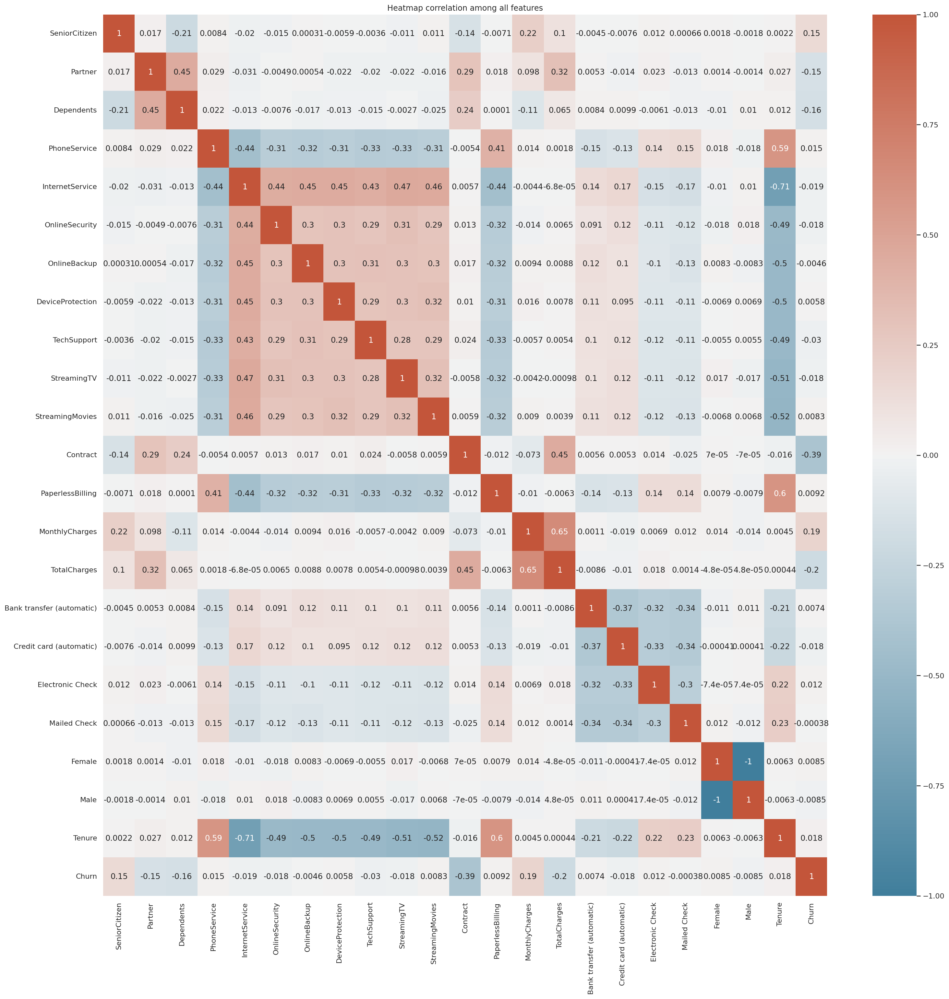

In [ ]:
heatmap_draw(convert_pipeline_test)

We can see in classfication problem, correlation matrix basically is no useful. We don't even have one single column has strong correlation with Churn, our target value.

Hence, instead of correlation matrix, we will use confustion matrix later.

## d. Explore the data set to find patterns in the data (e.g. correlation, trends, etc) and potentially form some hypotheses.: <a class="anchor" name="task1_3"></a>

### d.0 Unitilty Functions

In [ ]:
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

#------------------------draw_confusion_matrix------------------
def draw_confusion_matrix(data_df, features_val): 
  for i in range(len(features_val)):
    # get our features' name
    name = features_val[i]  
    # get our target value
    actual = data_df['Churn'].to_list()
    # get one of our features
    predicted = data_df[features_val[i]].to_list()
    # calculate the confusion matrix
    confusion_matrix = metrics.confusion_matrix(actual, predicted)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels =  [True,False])
    cm_display.plot()
    # matplot setting
    cm_display.ax_.set_xlabel(str(name))
    cm_display.ax_.set_ylabel("Churn")
    cm_display.ax_.set_title("Confusion matrix of Churn vs " + str(name))
    plt.show() 

#------------------------draw_normalized_confusion_matrix------------------
def draw_normalized_confusion_matrix(data_df, features_val, fig_size = (10,7)): 
  # seperate those features into 2 columns
  rows_number = math.ceil(len(features_val)/2.0)
  print("Those features will be plotted in ", rows_number, " rows and 2 columns")
  # print continuous features name
  print(features_val)

  #initialize figure
  fig, axs = plt.subplots(rows_number, 2, figsize=fig_size)
  index = 0
  start = datetime.datetime.now()
  
  # reuse code from assignment 1
  for i in range(rows_number):
    for j in range(2):
        if index < len(features_val):
          name = features_val[index]
          y_true = data_df['Churn'].to_list()
          y_pred = data_df[features_val[index]].to_list()
          x = confusion_matrix(y_true, y_pred)
          x_normed = normalize(x, axis=1, norm='l1')
          sns.heatmap(x_normed, annot=True, fmt='g', ax = axs[i][j]);  #annot=True to annotate cells, ftm='g' to disable scientific notation
          # labels, title and ticks
          axs[i][j].set_xlabel(str(name));axs[i][j].set_ylabel('Churn'); 
          axs[i][j].set_title('Confusion Matrix of Churn vs ' + str(name)); 
          axs[i][j].xaxis.set_ticklabels(['True', 'False']); axs[i][j].yaxis.set_ticklabels(['True', 'False']);
          end = datetime.datetime.now()
          # print info
          print(index+1, ". Finish Rendering :", features_val[index],", used",  
                (end - start).seconds, "millseconds")
          index += 1
        else:
            break

  fig.tight_layout()
  fig.subplots_adjust(top=0.95)

### 0.Plot preparation

First we write  two functions to draw our confusion matrix.

In [ ]:
raw_data_copy = raw_data.copy()
converted_data = convert_pipeline.fit_transform(raw_data_copy)

In [ ]:
converted_data.columns

Index(['SeniorCitizen', 'Partner', 'Dependents', 'PhoneService',
       'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'MonthlyCharges', 'TotalCharges',
       'Bank transfer (automatic)', 'Credit card (automatic)',
       'Electronic Check', 'Mailed Check', 'Female', 'Male', 'Tenure',
       'Churn'],
      dtype='object')

This first one is draw confunsion matrix with its support value.

In [ ]:
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix


#------------------------draw_confusion_matrix------------------
def draw_confusion_matrix(data_df, features_val): 
  for i in range(len(features_val)):
    # get our features' name
    name = features_val[i]  
    # get our target value
    actual = data_df['Churn'].to_list()
    # get one of our features
    predicted = data_df[features_val[i]].to_list()
    # calculate the confusion matrix
    confusion_matrix = metrics.confusion_matrix(actual, predicted)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [True, False])
    cm_display.plot()
    # matplot setting
    cm_display.ax_.set_xlabel(str(name))
    cm_display.ax_.set_ylabel("Churn")
    cm_display.ax_.set_title("Confusion matrix of Churn vs " + str(name))
    plt.show() 

 

The second one is draw confusion matrix with probability in each category.

[Code inspiration Source](https://stackoverflow.com/questions/19233771/sklearn-plot-confusion-matrix-with-labels)

In [ ]:
from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix

def draw_normalized_confusion_matrix(data_df, features_val, fig_size = (10,7)): 
  # seperate those features into 2 columns
  rows_number = math.ceil(len(features_val)/2.0)
  print("Those features will be plotted in ", rows_number, " rows and 2 columns")
  # print continuous features name
  print(features_val)

  #initialize figure
  fig, axs = plt.subplots(rows_number, 2, figsize=fig_size)
  index = 0
  start = datetime.datetime.now()
  
  # reuse code from assignment 1
  for i in range(rows_number):
    for j in range(2):
        if index < len(features_val):
          name = features_val[index]
          # Separate labels and prediction
          y_true = data_df['Churn'].to_list()
          y_pred = data_df[features_val[index]].to_list()
          x = confusion_matrix(y_true, y_pred)
          x_normed = normalize(x, axis=1, norm='l1')
          sns.heatmap(x_normed, annot=True, fmt='g', ax = axs[i][j]);  #annot=True to annotate cells, ftm='g' to disable scientific notation
          # labels, title and ticks
          axs[i][j].set_xlabel(str(name));axs[i][j].set_ylabel('Churn'); 
          axs[i][j].set_title('Confusion Matrix of Churn vs ' + str(name)); 
          axs[i][j].xaxis.set_ticklabels(['True', 'False']); axs[i][j].yaxis.set_ticklabels(['True', 'False']);
          end = datetime.datetime.now()
          # print info
          print(index+1, ". Finish Rendering :", features_val[index],", used",  
                (end - start).seconds, "millseconds")
          index += 1
        else:
            break

  fig.tight_layout()
  fig.subplots_adjust(top=0.95)

Before we analyze anything, we set a baseline of Churn's distribution.
And shows the percentage of Yes/ALL or NO/ALL

In [ ]:
# first we drop the instances have NaN values
analyize_data = raw_data_copy.copy()
Nan_df = analyize_data[analyize_data.isna().any(axis=1)]  
analyize_data = analyize_data.drop(Nan_df.index)

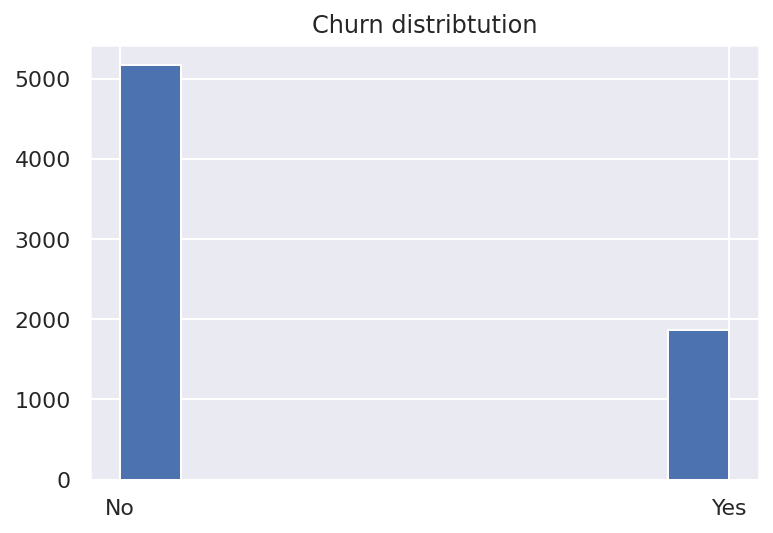

In [ ]:
plt.title("Churn distribtution")
analyize_data['Churn'].hist()

In [ ]:
prob_yes = len(analyize_data[analyize_data['Churn'] == 'Yes']) / len(analyize_data)
print("Prob of Yes in Churn ", prob_yes)

Prob of Yes in Churn  0.26578498293515357


In [ ]:
prob_no =  len(analyize_data[analyize_data['Churn'] == 'No']) / len(analyize_data)
print("Prob of No in Churn ", prob_no)

Prob of No in Churn  0.7342150170648464


Those are very important numbers.
If any of matrix follow those numbers, that means whether we have or not that feature, it makes no difference. Since the Probability of Churn is already there.

### d.i. Customer Account Information:
***Consider the tenure, and contract variables, and then plot graphs and describe your observations.***

First we consider all features that are not phone service details like internet and etc.

And plot confusion matrix of them vs our target value Churn.

***From confusion matrix, what we want is which feature has higher probablity on True-Ture (True positive) or False-False(True negative). That makes them a good feature to predict our target value***

We follow the order of our dataset's columns.

First we plot 4 confusion matrix about customers' personal information and whether they are using Papaerless Billing.

##### ***i.1. SeniorCitizen, Partner, Dependents, PaperlessBilling***

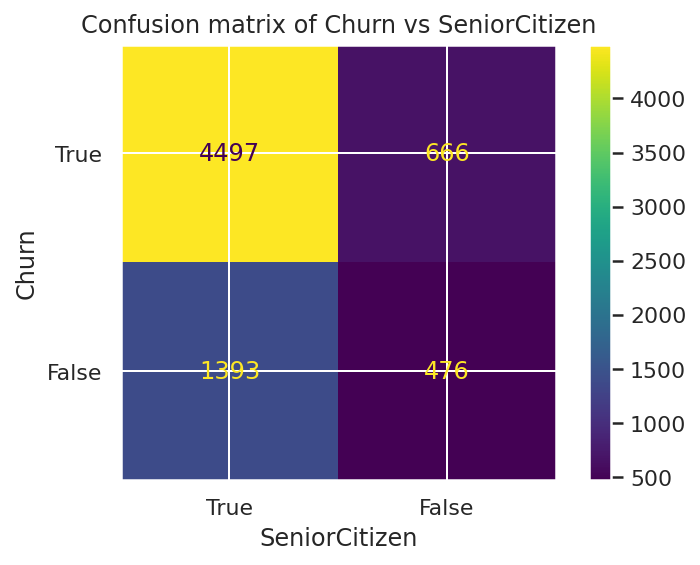

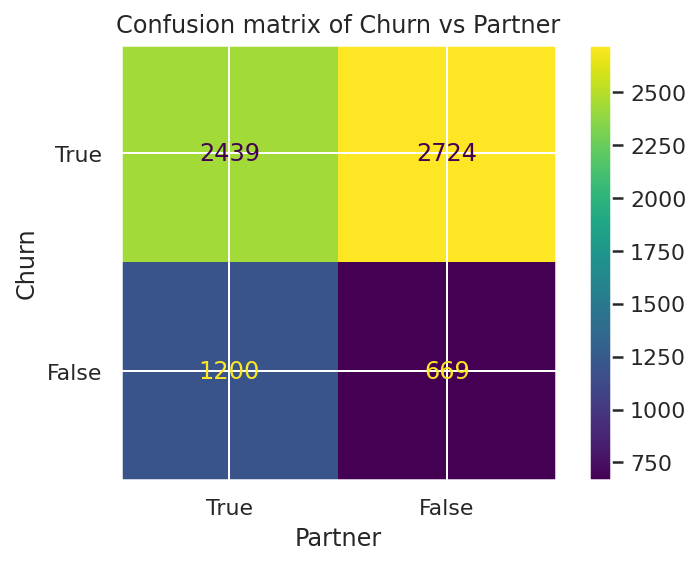

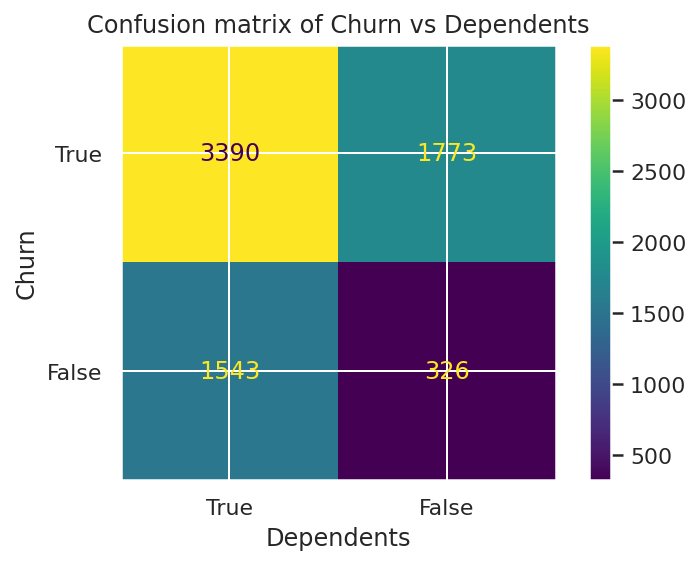

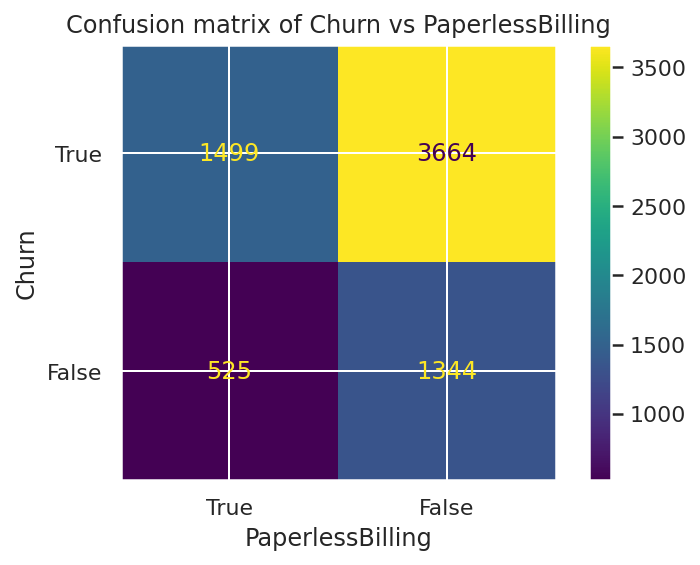

In [ ]:
draw_confusion_matrix(converted_data, ['SeniorCitizen', 'Partner', 'Dependents', 'PaperlessBilling'])

We can see that the graph with supports number can't help us find which one is better quickly.

So, we plot the confusion matrix with probability.

This idea is from my Statistics course, data mining. And the R function [prop.table()](https://www.rdocumentation.org/packages/base/versions/3.6.2/topics/prop.table).

Those features will be plotted in  2  rows and 2 columns
['SeniorCitizen', 'Partner', 'Dependents', 'PaperlessBilling']
1 . Finish Rendering : SeniorCitizen , used 0 millseconds
2 . Finish Rendering : Partner , used 0 millseconds
3 . Finish Rendering : Dependents , used 0 millseconds
4 . Finish Rendering : PaperlessBilling , used 0 millseconds


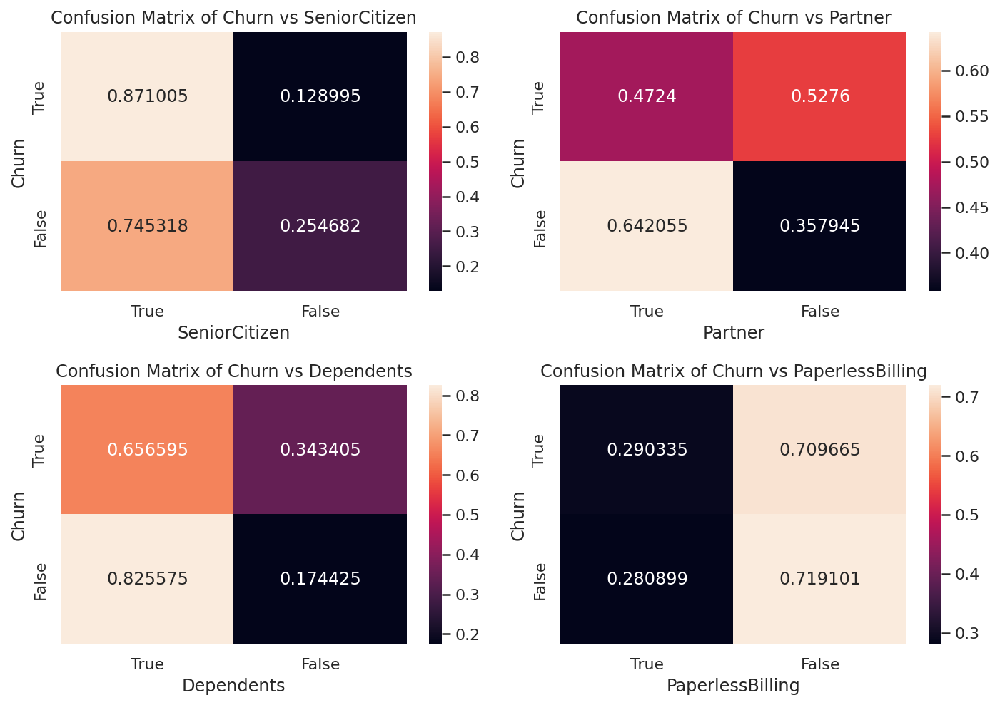

In [ ]:
draw_normalized_confusion_matrix(converted_data, ['SeniorCitizen', 'Partner', 'Dependents', 'PaperlessBilling'])

First, we can see that ***SeniorCitize*** has high scores on predicting True postive value and False positive value. We can use it to predict True values. 

And ***partner*** has ability to detect the false situation.

***Dependents*** have a very good score on predicting False positive, and relatively resonable scores on True positive. 
We can use this feature for predicting True cases in Churn. Which means if a customer has dependents, ***then he/she more likely will not cancel his plan***.



However, about ***Paperless Billing***, we find it has the probablity we got before. The P(YES) and P(No)

In [ ]:
prob_no

0.7342150170648464

In [ ]:
prob_yes

0.26578498293515357

The probability of Paperless Billing's two rows have almost identical probability with Churn's probibiliy of Yes or No, but in oppsite way.
Which means, no matter a customer choose paperless billings or not. It will not affect the distritbution of Churn's at all.
That is if we only take a look at customer has paperlessbilling, this subsets' Churn distribution has identical shape with the total data sets, vice versa.

That makes ***PaperlessBilling*** not quite useful. 

##### ***i.2. StreamingTV, StreamingMovies, Female, Male***

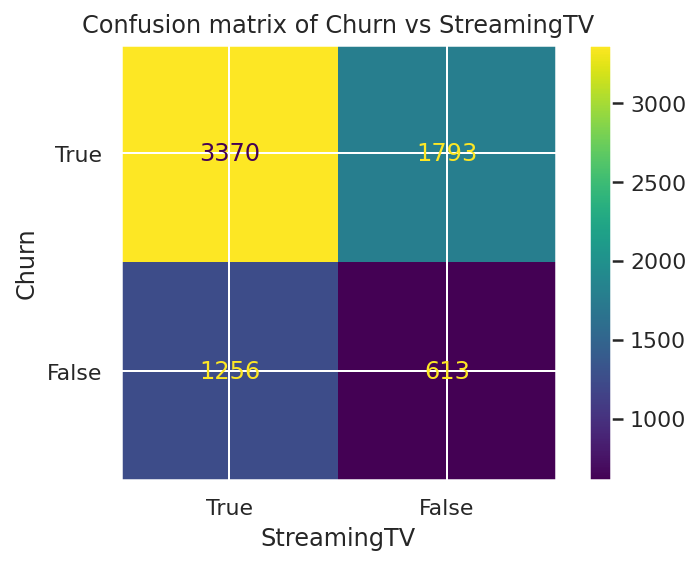

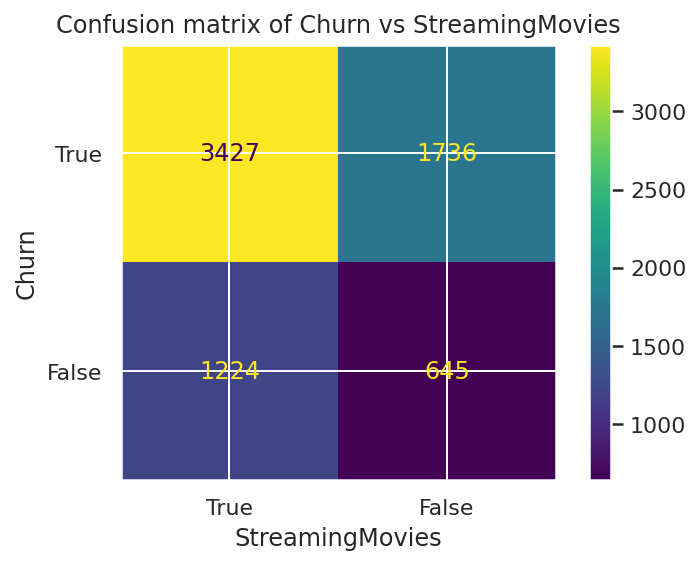

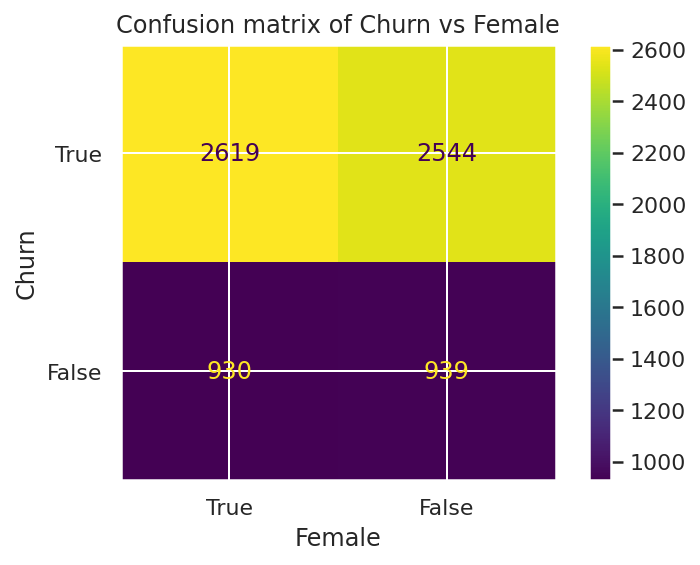

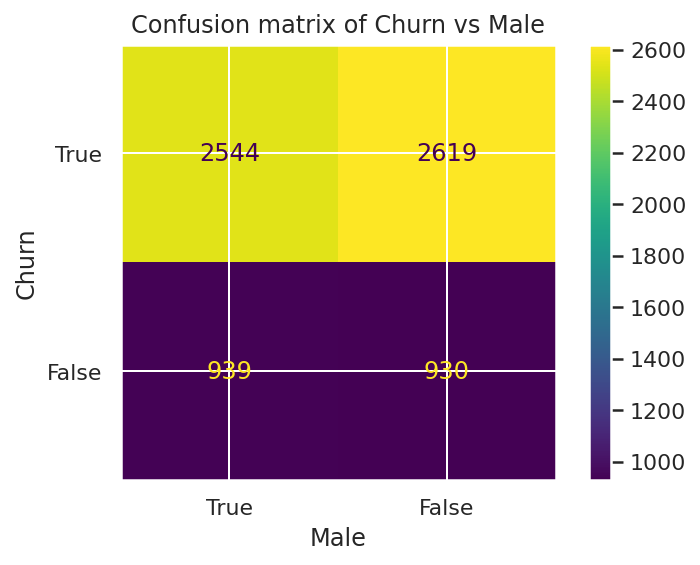

In [ ]:
draw_confusion_matrix(converted_data, [ 'StreamingTV', 'StreamingMovies','Female', 'Male'])

Those features will be plotted in  2  rows and 2 columns
['StreamingTV', 'StreamingMovies', 'Female', 'Male']
1 . Finish Rendering : StreamingTV , used 0 millseconds
2 . Finish Rendering : StreamingMovies , used 0 millseconds
3 . Finish Rendering : Female , used 0 millseconds
4 . Finish Rendering : Male , used 0 millseconds


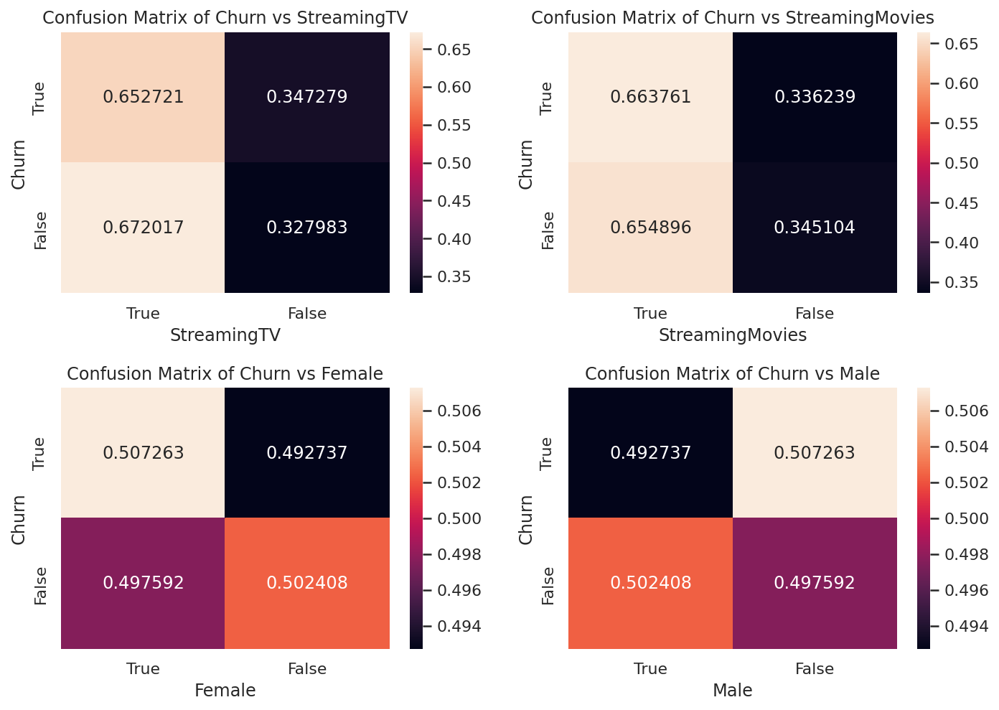

In [ ]:
draw_normalized_confusion_matrix(converted_data, [ 'StreamingTV', 'StreamingMovies','Female', 'Male'])

Be the same way of analysis the previous four features. 
We could say that ***Male, Female*** are not valuable features. Then have similar performance on all category. Which means, whether if a customer is Female or male, this doesn't affect their choice of whether they will cancel their plan.

***StreamingTV, Streaming Movies*** has similar performance on True negative and False Negative with Churn's distribution. That makes them not very useful as well.

##### ***i.3. Mailed Check, Bank transfer (automatic), Credit card (automatic),Electronic Check***

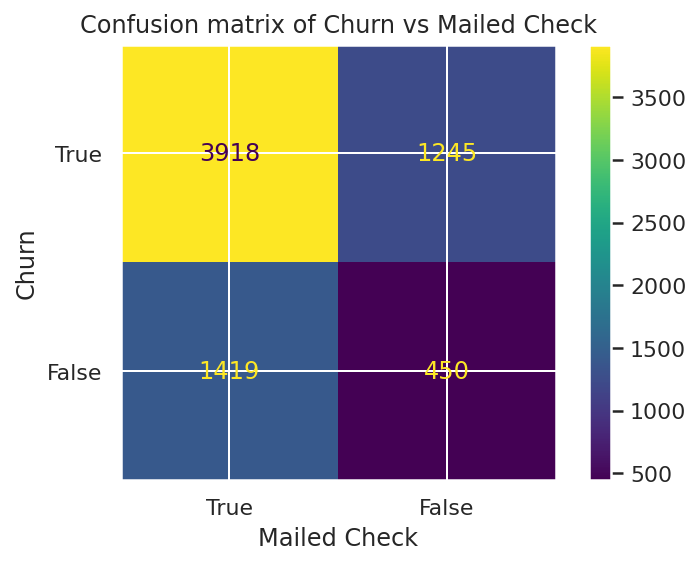

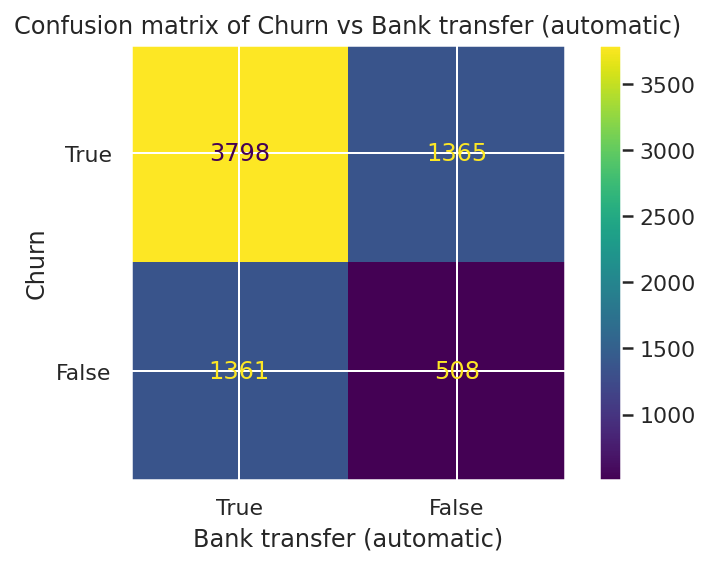

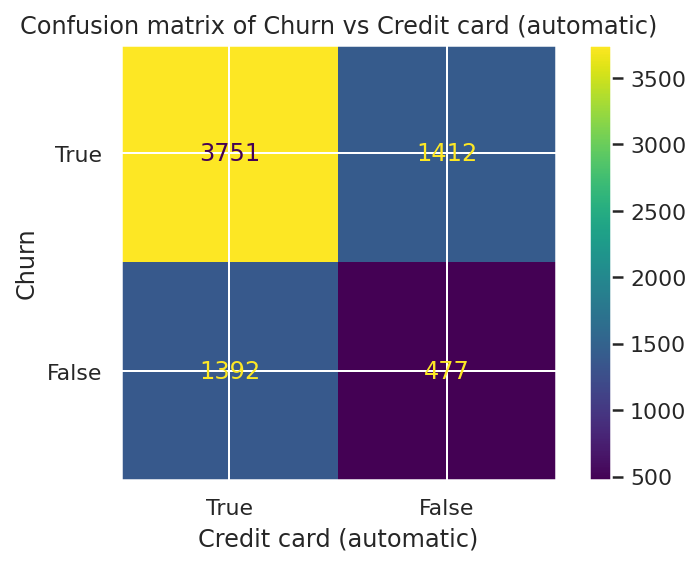

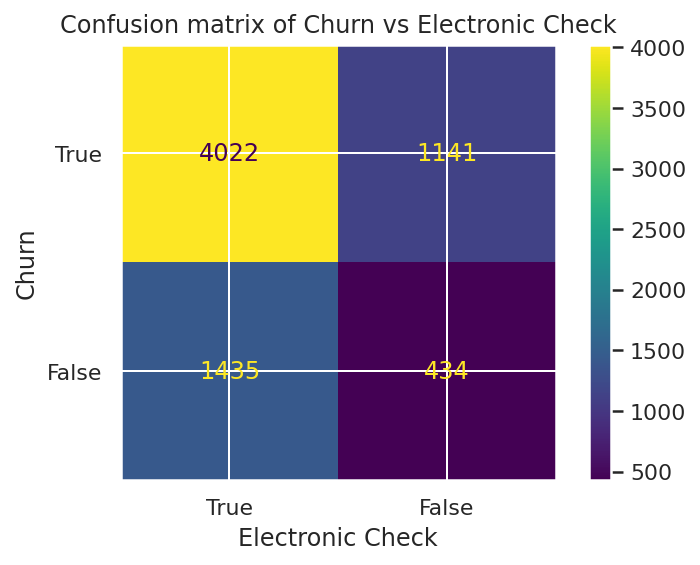

In [ ]:
draw_confusion_matrix(converted_data, [ 'Mailed Check', 'Bank transfer (automatic)', 'Credit card (automatic)','Electronic Check'])

Those features will be plotted in  2  rows and 2 columns
['Mailed Check', 'Bank transfer (automatic)', 'Credit card (automatic)', 'Electronic Check']
1 . Finish Rendering : Mailed Check , used 0 millseconds
2 . Finish Rendering : Bank transfer (automatic) , used 0 millseconds
3 . Finish Rendering : Credit card (automatic) , used 0 millseconds
4 . Finish Rendering : Electronic Check , used 0 millseconds


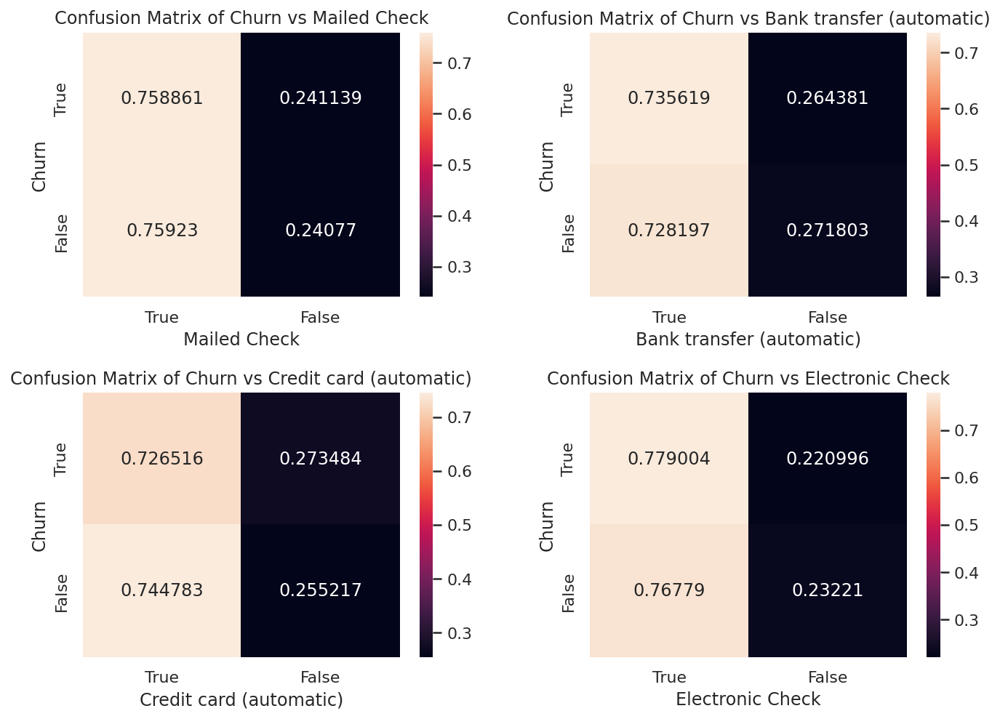

In [ ]:
draw_normalized_confusion_matrix(converted_data, [ 'Mailed Check', 'Bank transfer (automatic)', 'Credit card (automatic)','Electronic Check'])

Again, we see the famous probability of 0.73 vs 0.26.
Although we use one hot enconder to make 4 columns of payment methods. 
They have pretty much similar outcome. 
That is said, those four may not be useful.

Now, it's time to take a look at those four features.

In [ ]:
analyize_data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'PhoneService', 'InternetService', 'OnlineSecurity', 'OnlineBackup',
       'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies',
       'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges',
       'TotalCharges', 'Churn', 'Date'],
      dtype='object')

Get payment method column's data and separate them as one is Churn == Yes and the other is Churn == No.

In [ ]:
Payment_selection_Churn_No = pd.DataFrame(analyize_data[analyize_data['Churn'] == 'No'])
Payment_selection_Churn_No = Payment_selection_Churn_No['PaymentMethod'].value_counts()
Payment_selection_Churn_Yes = pd.DataFrame(analyize_data[analyize_data['Churn'] == 'Yes'])
Payment_selection_Churn_Yes = Payment_selection_Churn_Yes['PaymentMethod'].value_counts()

In [ ]:
new_data = pd.concat([Payment_selection_Churn_Yes, Payment_selection_Churn_No], axis=1)

In [ ]:
new_data.index.name = 'Type'
new_data.columns = ['Yes', 'No']

Text(0.5, 1.0, 'Payment Methods separated by Churn Value')

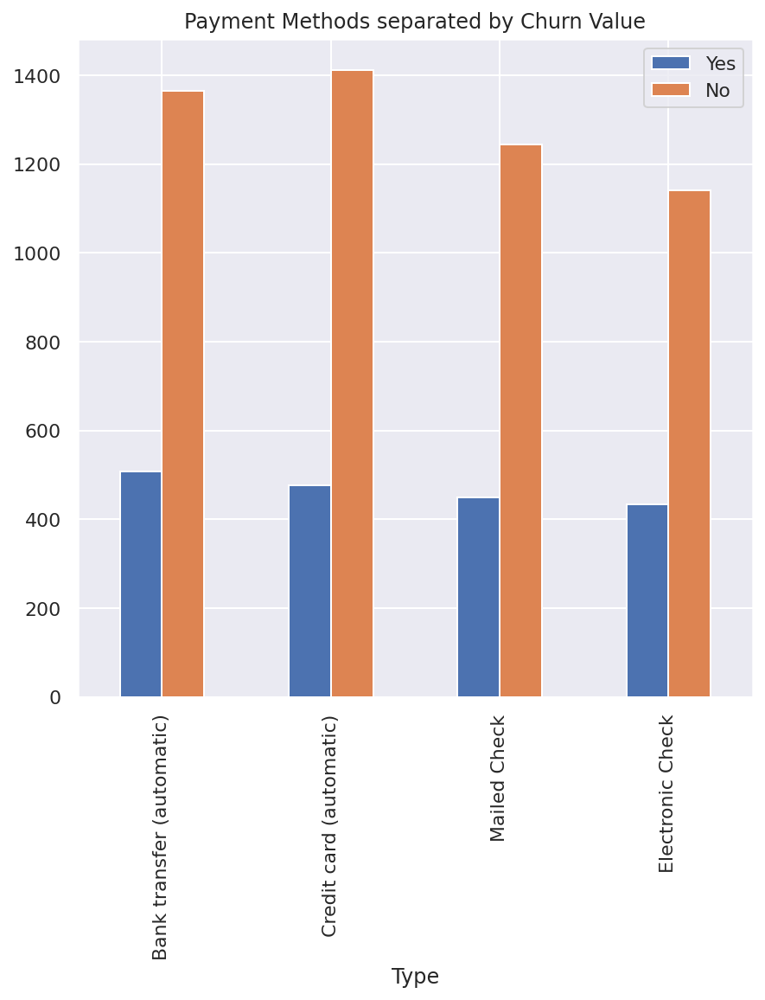

In [ ]:
fig, ax = plt.subplots(figsize = (7,7))
new_data.plot.bar(ax=ax)
plt.title("Payment Methods separated by Churn Value")

We can see that the churn rate of all 4 different types of Payment Methods are quite similar. And the rate is same as Churn rate in total dataset.

Hence, we could say those 4 features are not useful.

##### ***i.4 Now, finally, it's the time to take a look at Tenure***

First we group Tenure by years. And draw a histogram hue by Churn.

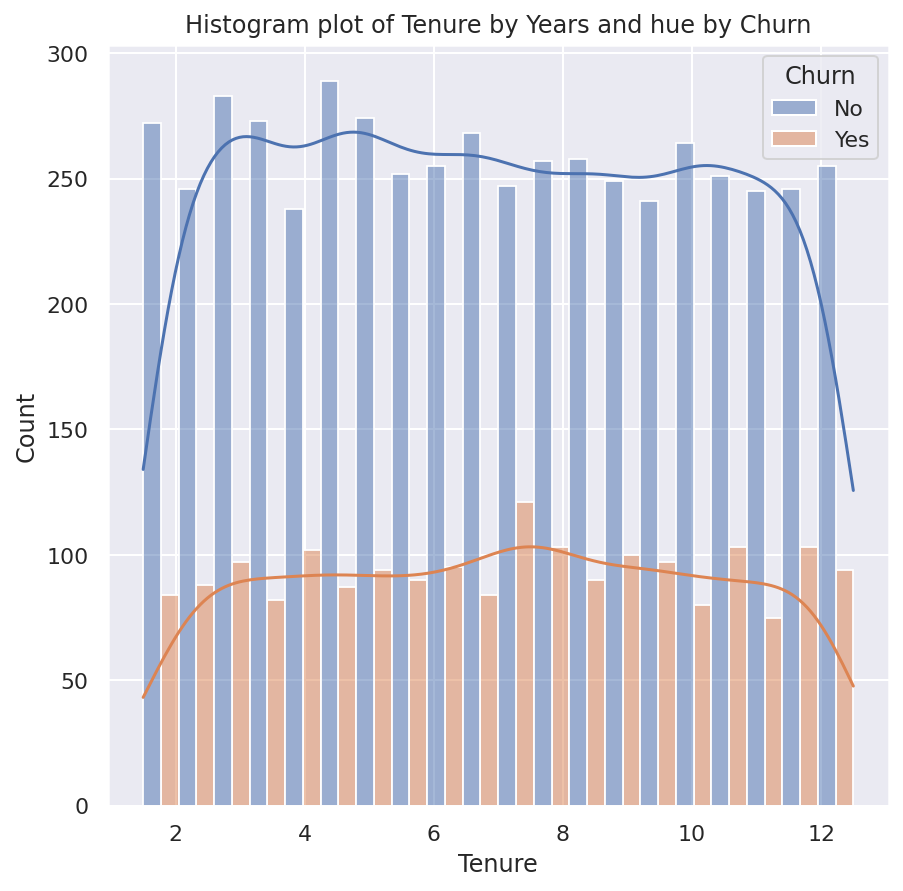

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by Years and hue by Churn')
ax = sns.histplot(x = converted_data['Tenure']/365, hue = converted_data['Churn'],  multiple="dodge", kde=True)
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
ax.legend(handles, ['No','Yes'], title='Churn')

We can see that, the number of customers left are almost the same in every years.
Which means, the new customer has the same churn rate with oldest customers. 
Tenure probably is not a good feature to predict Churn.

##### i.5 ***Now let's see about the feature, TotalCharges***.

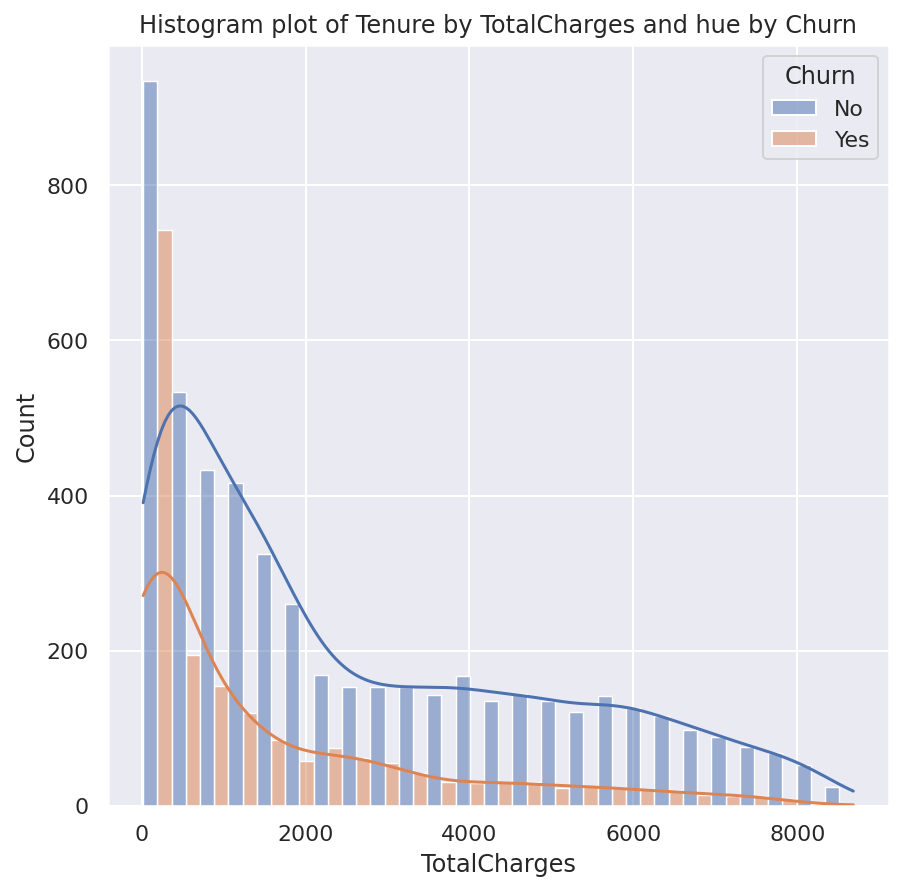

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['TotalCharges'], hue = raw_data_copy['Churn'],  multiple="dodge", kde=True)

We can see that along with total chagres grow, the ratio of Churn Yes / Churn no are become less. 

But we will find another way to plot it.

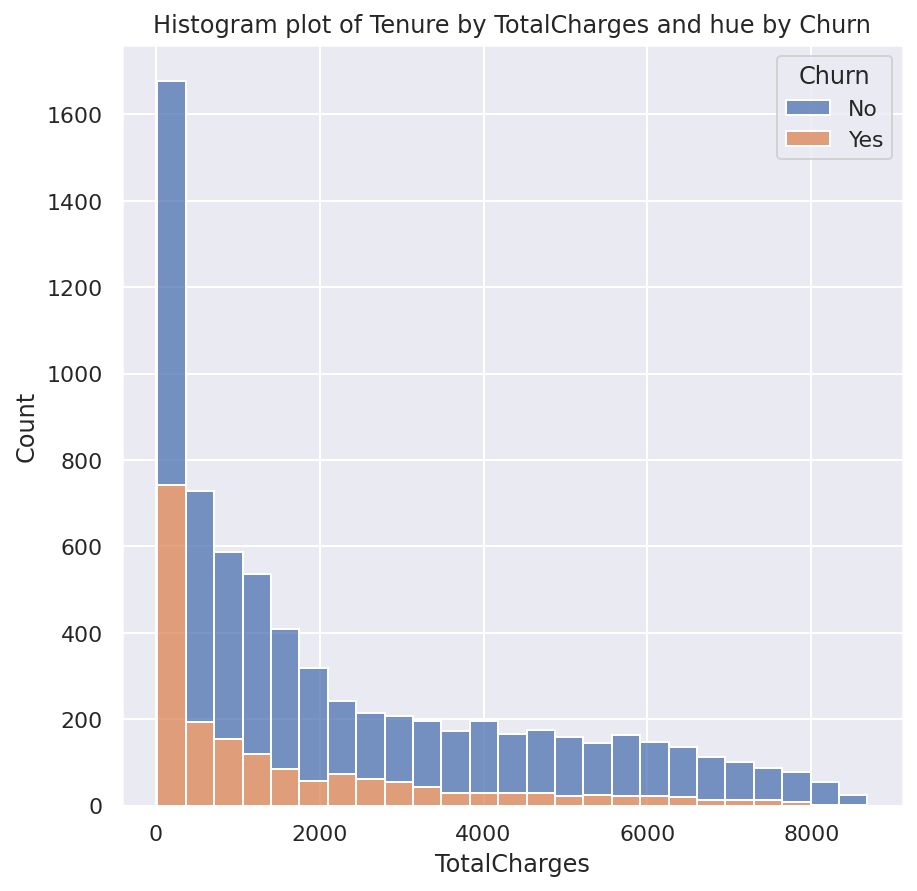

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['TotalCharges'], hue = raw_data_copy['Churn'],  multiple="stack")

When we draw Churn Yes and No into one bar. We can clearly see that the Rate of Churn Yes/Churn No are become smaller when Total Charges increase.

That is a good feature to predict our Churn.

##### ***i.6 MonthlyCharges***

We do the above ploting again.

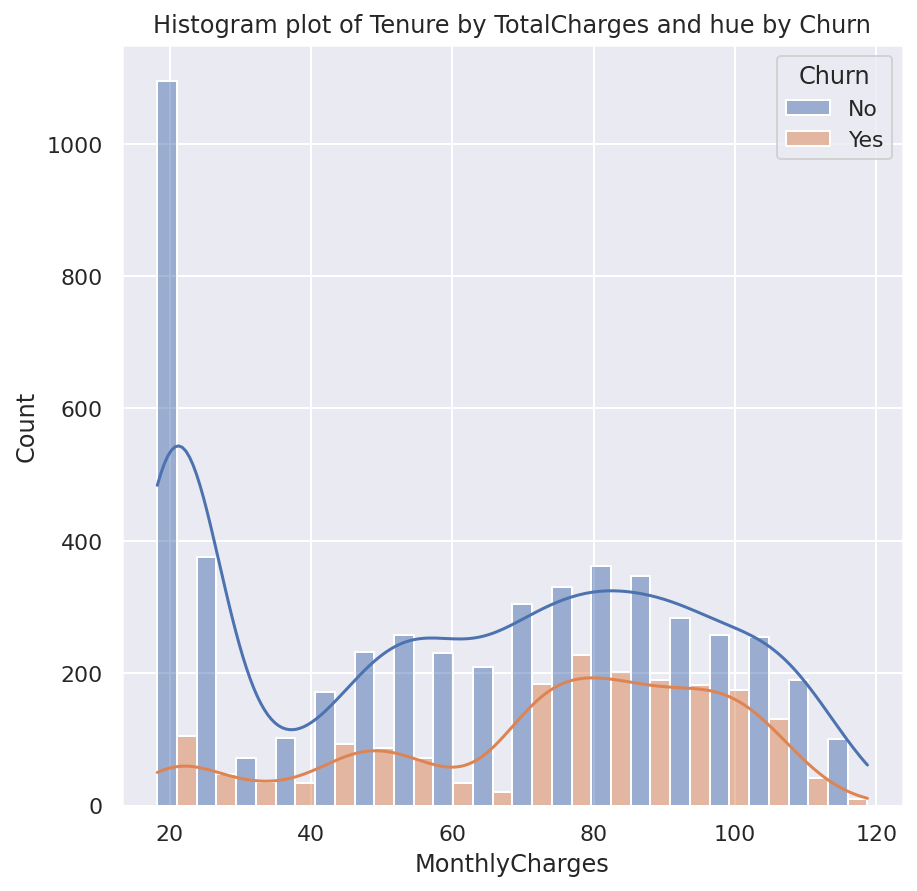

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['MonthlyCharges'], hue = raw_data_copy['Churn'],  multiple="dodge", kde=True)

From the KDE line of our histogram, we can see that the number of Churn Yes are different along with Monthly Charges changes.

We can use this to predict Churn value.

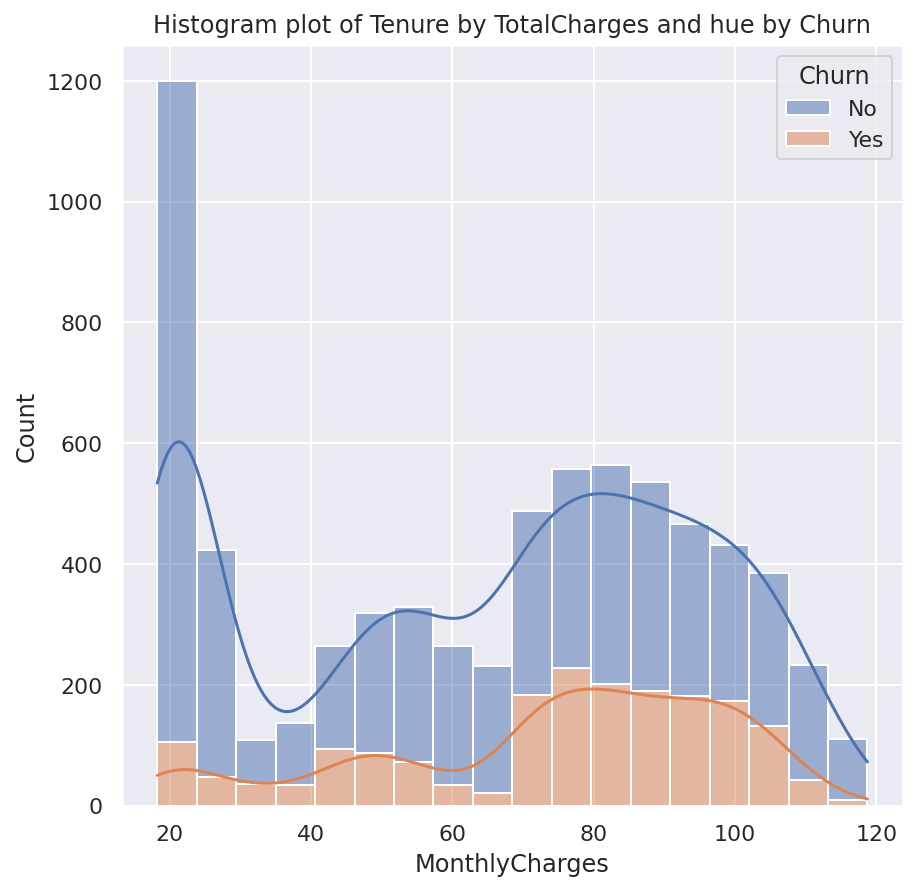

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['MonthlyCharges'], hue = raw_data_copy['Churn'],  multiple="stack", kde=True)

Very gladly, the rate of Yes/No, are also different. It makes it a good feature.

##### i.7 Contract

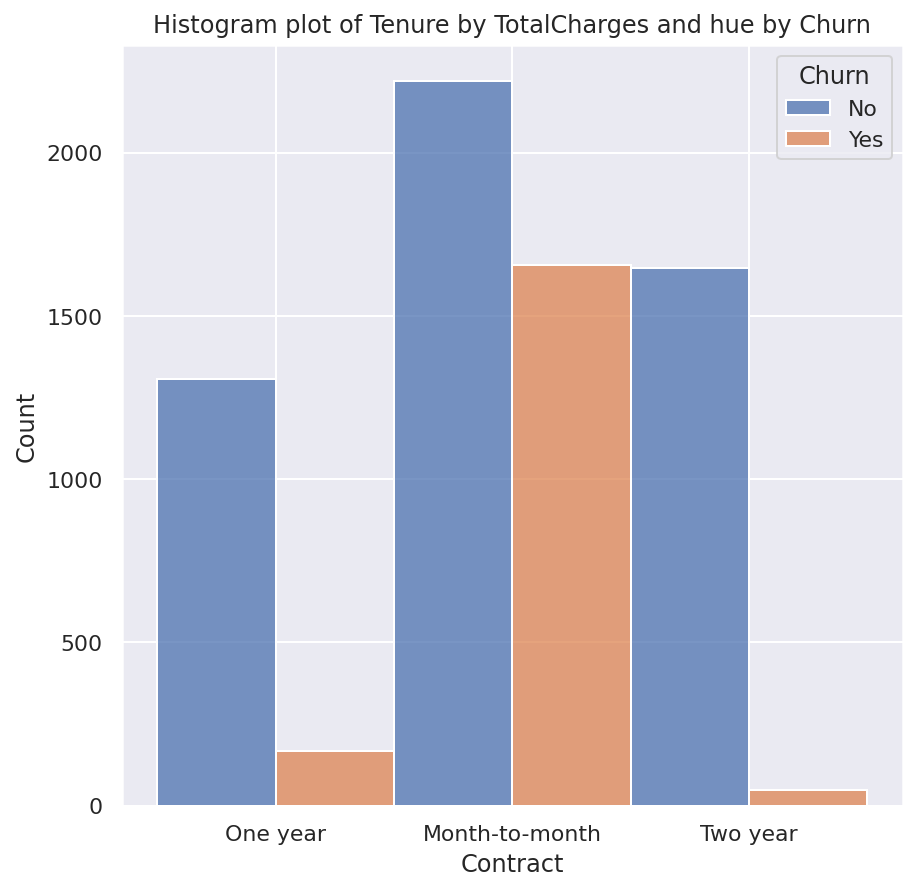

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['Contract'], hue = raw_data_copy['Churn'],  multiple="dodge")

This features is especially good at finding Churn No. The probability of Churn yes in Month-to-Month contract is very high than others.
That means if a customer is using one year or two year contract. 
He/she most likely will not cancel his plan.

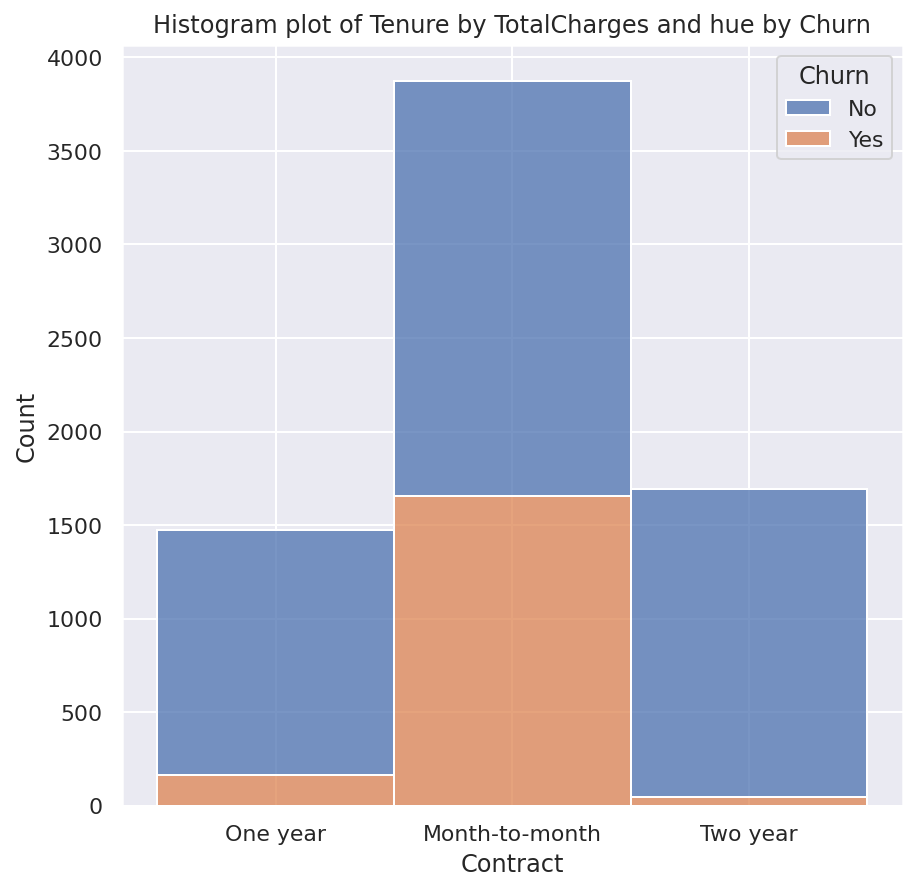

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['Contract'], hue = raw_data_copy['Churn'],  multiple="stack")

### d.ii. Services that each customer has signed up for—phone.
***Multiple lines, internet, online security, online backup, device protection,
tech support, then visualize plots and describe your observations***


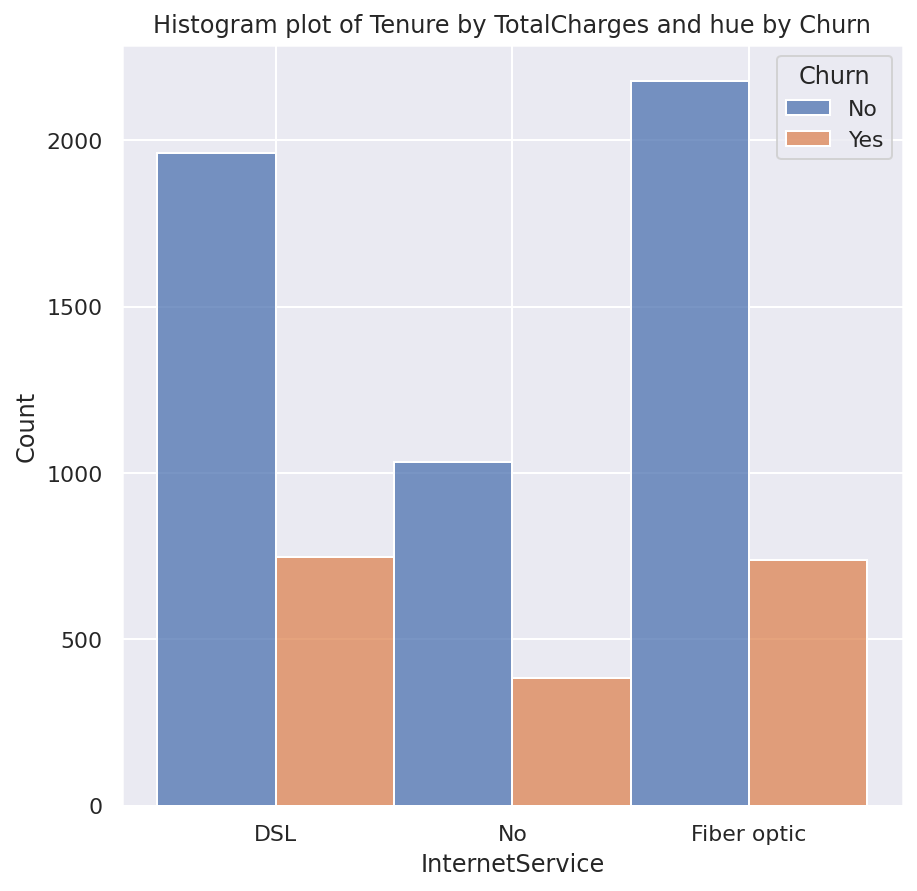

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['InternetService'], hue = raw_data_copy['Churn'],  multiple="dodge")


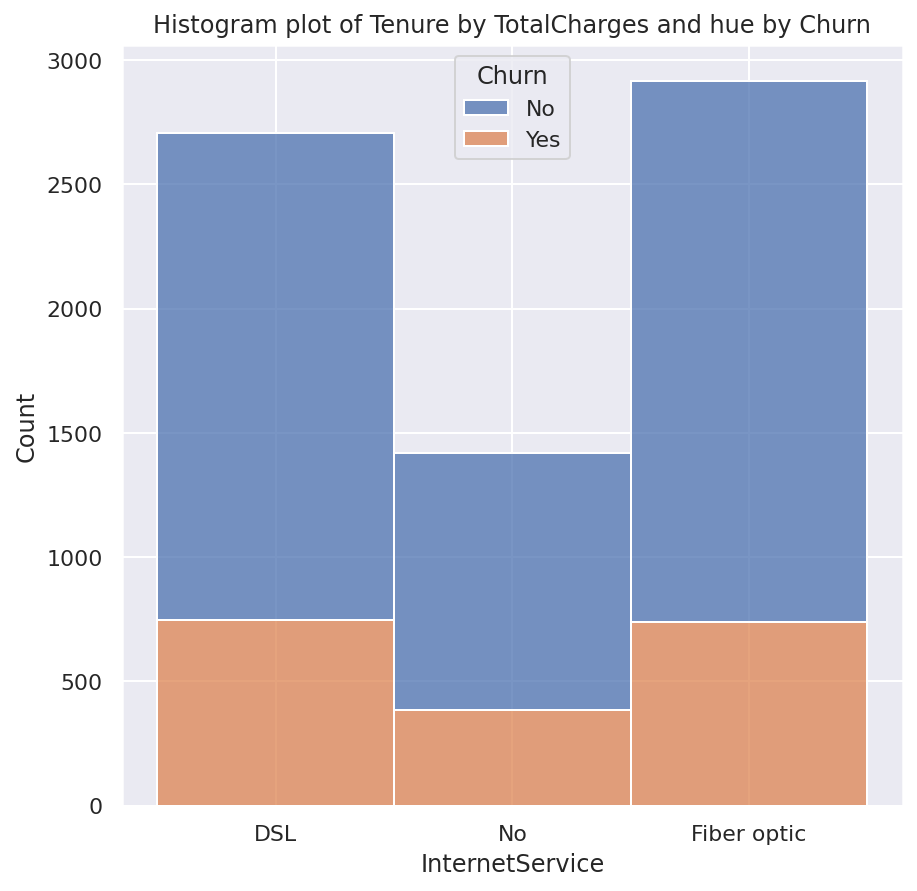

In [ ]:
fig, axs = plt.subplots( figsize=(7,7))
plt.title('Histogram plot of Tenure by TotalCharges and hue by Churn')
ax = sns.histplot(x = raw_data_copy['InternetService'], hue = raw_data_copy['Churn'],  multiple="stack")


We can see that internet service has same rate of Yes/No in each category.
May be not a top list feature to predict our labels.

Those features will be plotted in  2  rows and 2 columns
['TechSupport', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection']
1 . Finish Rendering : TechSupport , used 0 millseconds
2 . Finish Rendering : OnlineSecurity , used 0 millseconds
3 . Finish Rendering : OnlineBackup , used 0 millseconds
4 . Finish Rendering : DeviceProtection , used 0 millseconds


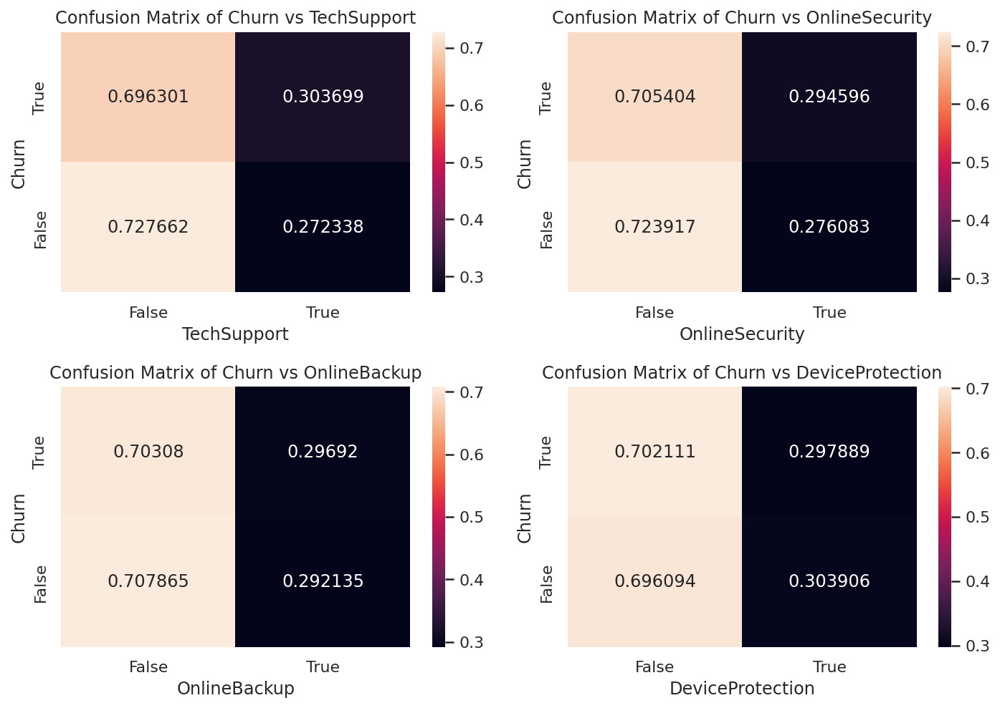

In [ ]:
draw_normalized_confusion_matrix(converted_data, ['TechSupport','OnlineSecurity', 'OnlineBackup', 'DeviceProtection'])  


The 4 services along with Internet Service also has the similary probability of 0.73/0.26, Churn's probability.

We would say that there will not be the top list features to predict our Churn labels.

 # Task 2. Build a baseline model to predict customer churn <a class="anchor" name="task3_top"></a>

## 2.0 Choose target feature as Churn.

The Churn rate or whether a customer will cancel his/her plan is what we need in this task.

## 2.a Supervised Classification task
> 2. Explain what the task you’re solving is (e.g., supervised x unsupervised,
classification x regression x clustering or similarity matching x, etc)

**In assignment, we are solving a supervised Classification problem.<br>**
Our target value Churn only has two values as Yes or No.
And we want to predict this value. That makes us to solve a classification problem. In the meantime, our dataset have target value. Therefore, we are solving a supervised task.

In the summary, we are solving is a supervised classification task.

## 2.b Use a feature selection method to select the features to build a model.

Before we doing the feature selection, we need to generate a test set and train set. We don't want to access the whole data set at the beginning. And we don't want to mass up the test set until we are very confident of our model.

### 2.b.1 Generate test set and train set.

In [140]:
raw_data_copy = raw_data.copy()
converted_data = all_features_remain_and_normalized_pipeline.fit_transform(raw_data_copy).drop('Date',axis=1) # we don't want Date be here

In [141]:
converted_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,Bank transfer (automatic),Credit card (automatic),Electronic Check,Mailed Check,Female,Male,Churn
0,-0.75,0.03,1.75,0,1,1,1,1,0,0,0,0,0,0,12,1,0,0,1,0,1,0,0
1,-0.77,-0.16,1.75,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0,0,1,0,1,0
2,-0.88,0.30,1.75,0,0,0,1,1,0,0,0,0,0,0,1,1,0,1,0,0,0,1,1
3,-0.46,1.10,1.75,1,1,0,1,1,0,0,0,0,0,0,1,1,0,1,0,0,0,1,1
4,-0.89,0.63,1.75,1,1,0,1,1,1,1,0,0,0,0,1,1,0,0,1,0,1,0,1


In [142]:
len(converted_data)

7032

Since, in this stage, we won't use our test set. And this assignment only has one week to finish.
We simplify the following steps by oversampling whole dataset, for selecting useful features.

In [144]:
from sklearn.datasets import make_classification

from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(random_state=0) # random over sampler
X_resampled, y_resampled = ros.fit_resample(converted_data.iloc[:,:-1], converted_data.iloc[:,-1:]) # select features and labels

from collections import Counter
print(sorted(Counter(y_resampled).items()))
sampled_data = pd.concat([X_resampled,y_resampled], axis = 1)

[('Churn', 1)]


In [ ]:
len(X_resampled)

10326

In [146]:
sampled_data.head().T

,0,1,2,3,4
TotalCharges,-0.75,-0.77,-0.88,-0.46,-0.89
MonthlyCharges,0.03,-0.16,0.30,1.10,0.63
Tenure,1.75,1.75,1.75,1.75,1.75
SeniorCitizen,0,0,0,1,1
Partner,1,0,0,1,1
Dependents,1,0,0,0,0
PhoneService,1,1,1,1,1
InternetService,1,0,1,1,1
OnlineSecurity,0,0,0,0,1
OnlineBackup,0,0,0,0,1


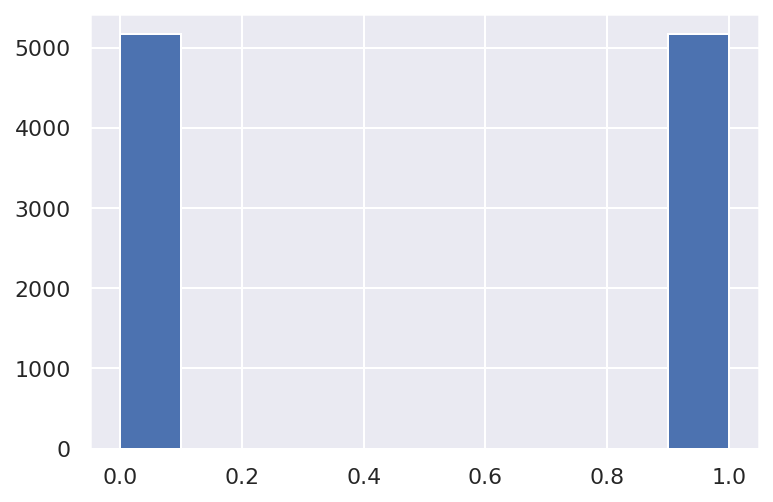

In [ ]:
sampled_data.Churn.hist()

**Create train, and Test set**


Still, we don't split validation set now.
We will do it later.

In [147]:
from sklearn.model_selection import train_test_split
training_data, test_data = train_test_split(sampled_data, test_size=0.3, random_state=42)

In [148]:
# get rid of Object type
training_data = training_data.convert_dtypes()
# showing the index dtype and columns, non-null values and memory usage.
training_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7228 entries, 3169 to 7270
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   TotalCharges               7228 non-null   Float64
 1   MonthlyCharges             7228 non-null   Float64
 2   Tenure                     7228 non-null   Float64
 3   SeniorCitizen              7228 non-null   Int64  
 4   Partner                    7228 non-null   Int64  
 5   Dependents                 7228 non-null   Int64  
 6   PhoneService               7228 non-null   Int64  
 7   InternetService            7228 non-null   Int64  
 8   OnlineSecurity             7228 non-null   Int64  
 9   OnlineBackup               7228 non-null   Int64  
 10  DeviceProtection           7228 non-null   Int64  
 11  TechSupport                7228 non-null   Int64  
 12  StreamingTV                7228 non-null   Int64  
 13  StreamingMovies            7228 non-null   In

Those features will be plotted in  6  rows and  4 columns
Index(['TotalCharges', 'MonthlyCharges', 'Tenure', 'SeniorCitizen', 'Partner',
       'Dependents', 'PhoneService', 'InternetService', 'OnlineSecurity',
       'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV',
       'StreamingMovies', 'Contract', 'PaperlessBilling',
       'Bank transfer (automatic)', 'Credit card (automatic)',
       'Electronic Check', 'Mailed Check', 'Female', 'Male', 'Churn'],
      dtype='object')
1 . Finish Rendering : TotalCharges , used 0 millseconds
2 . Finish Rendering : MonthlyCharges , used 0 millseconds
3 . Finish Rendering : Tenure , used 1 millseconds
4 . Finish Rendering : SeniorCitizen , used 1 millseconds
5 . Finish Rendering : Partner , used 1 millseconds
6 . Finish Rendering : Dependents , used 1 millseconds
7 . Finish Rendering : PhoneService , used 2 millseconds
8 . Finish Rendering : InternetService , used 2 millseconds
9 . Finish Rendering : OnlineSecurity , used 2 millse

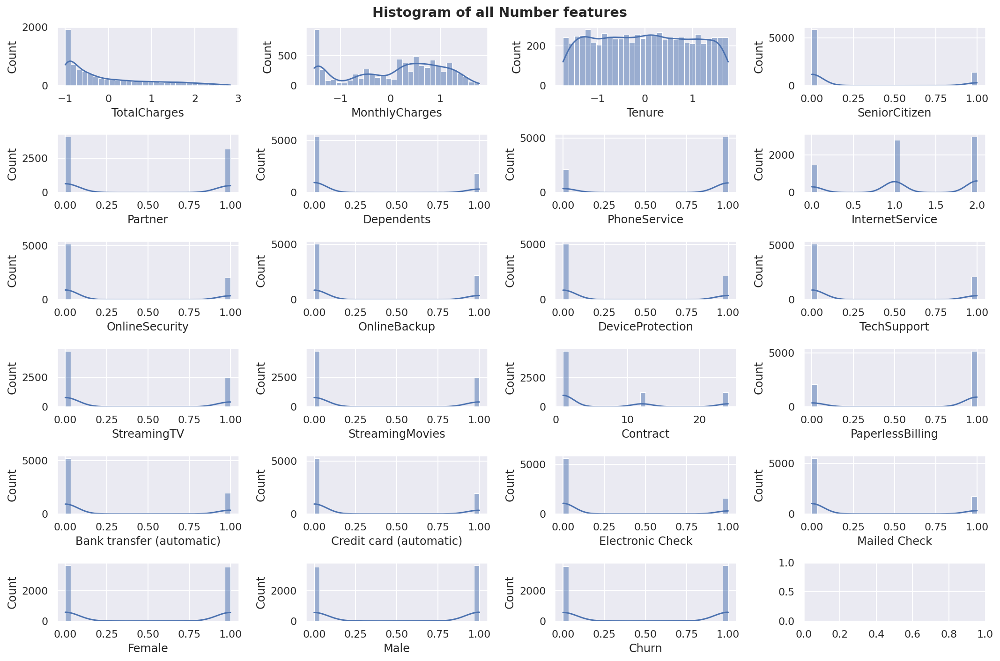

In [151]:
mulitple_function_plots(data=training_data,columns = 4, plot_type='histogram', data_type='number', fig_size = (15,10));

Text(0.5, 1.0, "Training set's Churn distribution")

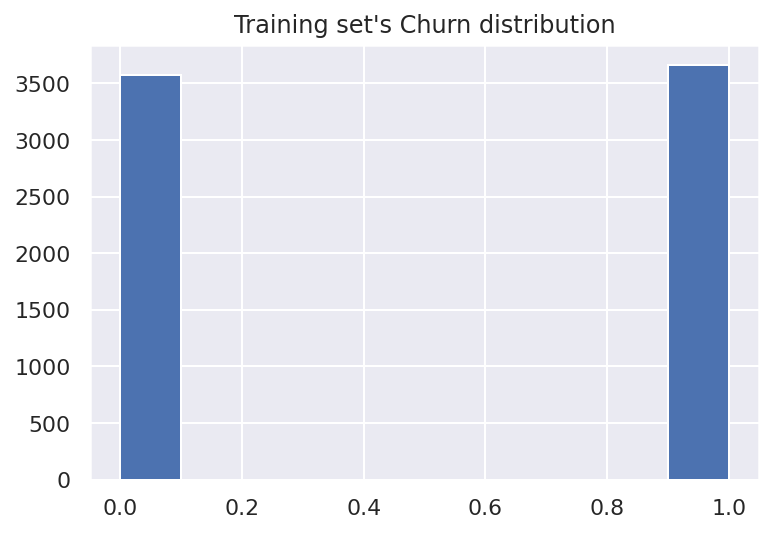

In [ ]:
training_data['Churn'].hist()
plt.title("Training set's Churn distribution")

Done! Now we can do the feature selection.

### 2.b.2 Feature selection

#### 0. Import packages sets:

In [ ]:
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import mutual_info_classif
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import SGDClassifier

#### 2.b.1. We try to use Pearson’s Correlation Coefficient via the f_classification() function.

In [ ]:
# get our data set into features and labels

X_train = training_data.iloc[:,:-1]
y_train = training_data.iloc[:,-1:].values.ravel()
y_train = y_train.astype(int)
X_test = test_data.iloc[:,:-1]

In [ ]:
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
# define feature selection
fs = SelectKBest(score_func=f_classif, k=8)
# apply feature selection
X_selected = fs.fit(X_train, y_train)
# print(X_selected.shape)
feature_support = fs.get_support()
fs_feature = X_train.loc[:,feature_support].columns.tolist()
print('Using f_classification, we got features as \n', fs_feature)

Using f_classification, we got features as 
 ['SeniorCitizen', 'Partner', 'Dependents', 'TechSupport', 'Contract', 'MonthlyCharges', 'TotalCharges', 'Tenure']


If we choose 8 features, those are what we want.

We need something more advance and explainable.
First we should get all our features name.

In [ ]:
features_name = X_train.loc[:,:].columns.tolist();
len(features_name)

22

Let's get back to use f_classification again. But this time I will show their weight which is related to each feature. 

In [ ]:
from sklearn.feature_selection import SelectKBest

# feature selection
def select_features_plot(X_train, y_train, X_test,function):
    # configure to select all features
    fs = SelectKBest(score_func=function, k='all')
    # learn relationship from training data
    fs.fit(X_train, y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    # what are scores for the features

    fig , ax = plt.subplots()

    # print features' name and score
    for i in range(len(fs.scores_)):
        print(f'Feature {i}  {features_name[i]}: { fs.scores_[i]}' )
    # plot the scores
    plt.bar([i for i in range(len(fs.scores_))], fs.scores_)

    plt.xticks(range(22))
    ax.set_xticklabels(features_name, rotation='vertical', fontsize=18)
    plt.xlabel("Feature's index")
    plt.ylabel("Rate of each feature")
    plt.title("F_regression score among all features")
    plt.show()

Feature 0  SeniorCitizen: 193.9232944998988
Feature 1  Partner: 230.54594520977034
Feature 2  Dependents: 298.15452596161083
Feature 3  PhoneService: 1.789856462761592
Feature 4  InternetService: 1.9764827945054406
Feature 5  OnlineSecurity: 1.2621696993939715
Feature 6  OnlineBackup: 0.3874998693586685
Feature 7  DeviceProtection: 0.2001823977729088
Feature 8  TechSupport: 9.444814006040556
Feature 9  StreamingTV: 1.5457423899649132
Feature 10  StreamingMovies: 0.014103844523202912
Feature 11  Contract: 2186.709557963487
Feature 12  PaperlessBilling: 0.8868749746088841
Feature 13  MonthlyCharges: 382.4930142115723
Feature 14  TotalCharges: 417.4994734189772
Feature 15  Bank transfer (automatic): 0.09885450527911768
Feature 16  Credit card (automatic): 1.049252904250824
Feature 17  Electronic Check: 0.5323529676634629
Feature 18  Mailed Check: 0.000703459647835144
Feature 19  Female: 0.08514412328525468
Feature 20  Male: 0.08514412328525468
Feature 21  Tenure: 2.5489832786771025


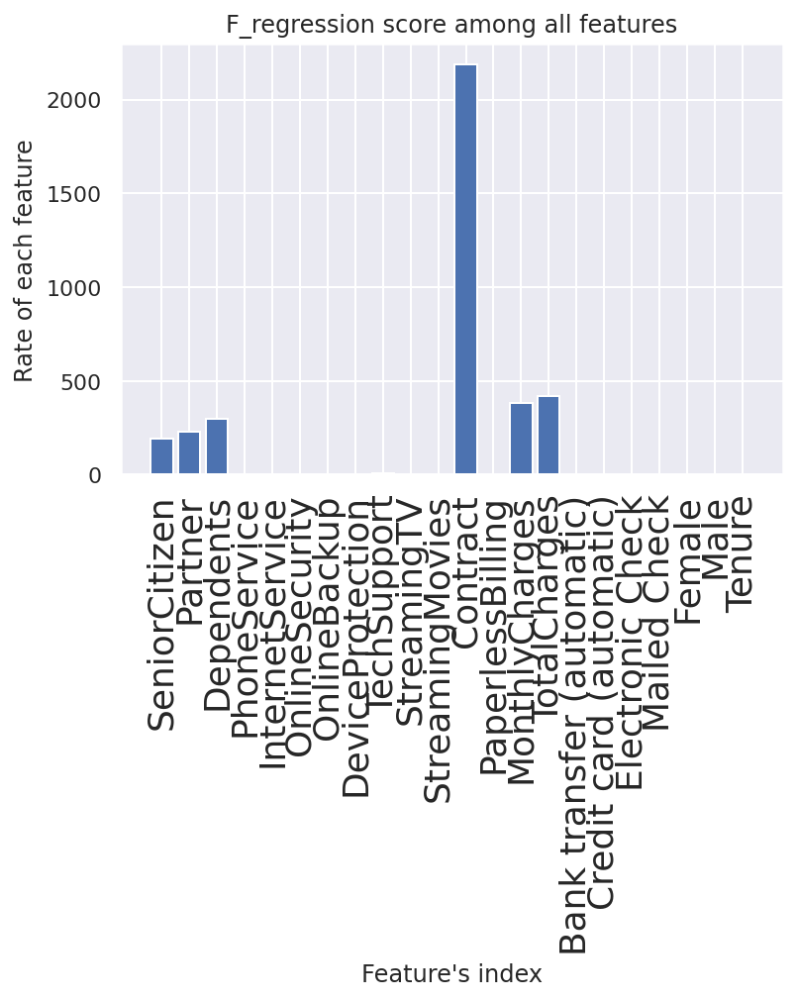

In [ ]:
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

select_features_plot(X_train, y_train,X_test, f_classif)

We can see that we have 6 features are very important.

They are SeniorCitize, Partner, Dependenties, contract, MonthlyCharges, and totaly Charges.

Let's re run the first function and set k = 6.

In [ ]:
from sklearn.datasets import make_classification
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif



# define feature selection
fs = SelectKBest(score_func=f_classif, k=6)
# apply feature selection
X_selected = fs.fit(X_train, y_train)
# print(X_selected.shape)
feature_support = fs.get_support()
fs_feature = X_train.loc[:,feature_support].columns.tolist()
print('Using f_classification, we got features as \n', fs_feature)

Using f_classification, we got features as 
 ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges', 'TotalCharges']


That's exactly what we got from the first part.

Now, we use mutual info classification method to do this again.

Feature 0  SeniorCitizen: 0.02152633226178602
Feature 1  Partner: 0.02248975285633459
Feature 2  Dependents: 0.013400438537808812
Feature 3  PhoneService: 0.0
Feature 4  InternetService: 0.0
Feature 5  OnlineSecurity: 0.0008388288475273953
Feature 6  OnlineBackup: 0.0
Feature 7  DeviceProtection: 0.004462890756037563
Feature 8  TechSupport: 0.0
Feature 9  StreamingTV: 0.004590168404293715
Feature 10  StreamingMovies: 0.00240107023518199
Feature 11  Contract: 0.13545698473652568
Feature 12  PaperlessBilling: 0.0
Feature 13  MonthlyCharges: 0.13617407158089567
Feature 14  TotalCharges: 0.18112209506537202
Feature 15  Bank transfer (automatic): 0.0032078814246148113
Feature 16  Credit card (automatic): 0.0068649654333712284
Feature 17  Electronic Check: 0.006433770653627269
Feature 18  Mailed Check: 0.006545138081253565
Feature 19  Female: 0.001507735496200091
Feature 20  Male: 0.009017924473681216
Feature 21  Tenure: 0.12045334583926981


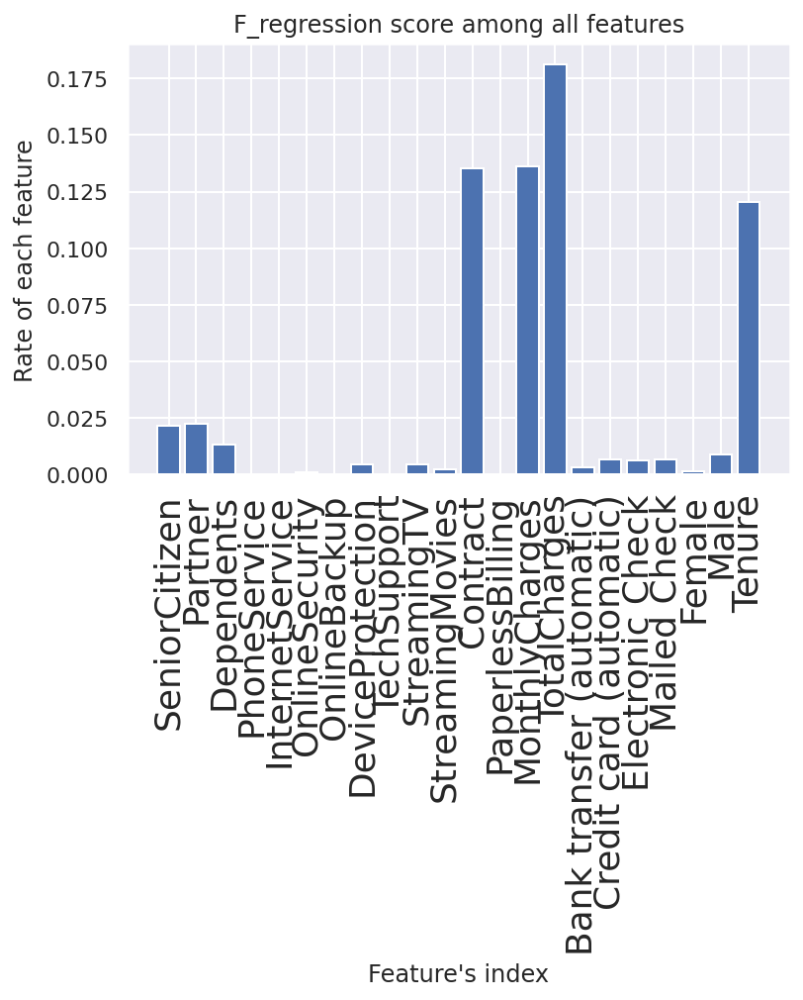

In [ ]:
from sklearn.feature_selection import mutual_info_classif
select_features_plot(X_train, y_train,X_test, mutual_info_classif)

We can see in mutual info classification, we have 7 features are important.

We use the same trick to print them all with k = 7.

In [ ]:
# define feature selection
fs = SelectKBest(score_func=mutual_info_classif, k=7)
# apply feature selection
X_selected = fs.fit(X_train, y_train)
# print(X_selected.shape)
feature_support = fs.get_support()
fs_feature = X_train.loc[:,feature_support].columns.tolist()
print('Using f_classification, we got features as \n', fs_feature)

Using f_classification, we got features as 
 ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges', 'TotalCharges', 'Tenure']


#### 2.b.2 Now let's use model to select feature.

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier
def model_select_features(model,num_feats=11):
    embeded_rf_selector = SelectFromModel(model, max_features=num_feats)
    embeded_rf_selector.fit(X_train, y_train)
    embeded_rf_support = embeded_rf_selector.get_support()
#     print(embeded_rf_support)
    embeded_rf_feature = X_train.loc[:,embeded_rf_support].columns.tolist()
    print(str(len(embeded_rf_feature)), 'selected features as', embeded_rf_feature)

In [ ]:
model_select_features(RandomForestClassifier(n_estimators=100))

4 selected features as ['Contract', 'MonthlyCharges', 'TotalCharges', 'Tenure']


Random Forest algorithm gives us 4 features.

Let's see what will GradientBoostingClassifier do.

In [ ]:
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingClassifier

model_select_features(GradientBoostingClassifier(max_depth=5, n_estimators=120))

4 selected features as ['Contract', 'MonthlyCharges', 'TotalCharges', 'Tenure']


Let's see what will SGD do.

In [ ]:
from sklearn.linear_model import SGDClassifier
model_select_features(SGDClassifier(max_iter=1000, tol=1e-3, penalty=None, eta0=0.1))

2 selected features as ['InternetService', 'Contract']


It gives us Internet Service.

In summary, those features are important ones.

'SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges', 'TotalCharges','Tenure' and 'InternetService'.

Because now, we have a few features are important.

Let's rewrite our pipeline and transformer and add the function of feature selection.

In [ ]:
################################  CLASS  ################################

#------------- transformer for feature selection on our data set ---------------------

class feature_selector(BaseEstimator, TransformerMixin):
    '''feature selctor class'''
    
    def __init__(self, feature_selection = True ): # no *args or **kargs
        # This line seems pretty useless. But sometimes, we want this.
        self.feature_selection = feature_selection
        
    def fit(self, X, y=None):
        return self # nothing else to do

    def transform(self, X):
        X = X.loc[: , ['SeniorCitizen', 'Partner', 'Dependents', 'Contract', 'MonthlyCharges',
                'TotalCharges','Tenure' , 'InternetService', 'Churn']] 
        # select all useful features.
        return X




Add our new transformer into our pipelines.

In [152]:
#############################PIPE LINE###################################################


# Now we build a transformer to get all the above steps
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# convert_pipeline is for create a whole pipeline but remain the dataFrame structure
convert_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
        ('feature_selector', feature_selector(feature_selection = True)),
        ('num_transfer', numerical_transfer(transfer_to_number = False)),
    ])

# remain_internet_service_option will keep the features about internet service in 3 categories, YES, NO and NO internet service
remain_internet_service_option = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(servies_remainer=True)),
        # ('feature_selector', feature_selector(feature_selection = True)),
        # ('num_transfer', numerical_transfer(transfer_to_number = False)),
    ])


#number pipline will transfer all data to numpy array and do normailization
number_pipeline = Pipeline([
        ('feature_selector', feature_selector(feature_selection = True)),
        ('num_transfer', numerical_transfer()),
    ])

# whole_features_remain_pipeline will remain all the features but convert categorical data to numberical values
whole_features_remain_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)),
    ])

# all_features_remain_and_normalized_pipeline will keep all features but normalize continuous features
all_features_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=True)), 
        ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])

# date_remain_and_normalized_pipeline will keep all features and time series feature Date
date_remain_and_normalized_pipeline = Pipeline([
        ('attribs_adder_cleaner', combined_attribute_adder_and_cleaner(data_cleaner=False)), 
        # ('num_transfer', numerical_transfer(transfer_to_number = False))
    ])


Test it. 

In [ ]:
converted_data = convert_pipeline.fit_transform(raw_data_copy)
converted_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
0,-0.75,0.03,1.75,0,1,1,12,1,0
1,-0.77,-0.16,1.75,0,0,0,1,0,0
2,-0.88,0.30,1.75,0,0,0,1,1,1
3,-0.46,1.10,1.75,1,1,0,1,1,1
4,-0.89,0.63,1.75,1,1,0,1,1,1


That's what we want.

## 2.c.1 Select one or more evaluation metrics. Justify your choice.

We learnt from our tutorial, there are 4 types of classification metrics.

Precision, recall and f1-score and accuarcy.

We will mainly use accuarcy here in this assignment. 

$$
Accuracy = \frac{(TP + TN)}{ (TP + FN + FP + TN)}
$$

In most of trials of classification problem, people not only care about the true positive rate but also care about the true negative rate.
And in our case, we want to measure our accuracy not only on predicting whether our customers will cancel their plan, but also will they stay in their service plan. 

The main reason behind this is, we have a heavily unbalanced data set according to our labels. 

If we only care about Percision of True case, then we will have a very high score. Since there much more Churn = Yes case then Churn = no.

$$
Percision = \frac{TP} { (TP + FP) }
$$

And if we only care about Recall of True case, the porportion of actual positives was identified correctly, we will still have very high score. Since our false negative case still not much here by the same reason.

$$
Recall = \frac{TP} { (TP + FN) }
$$


In the other hand, if we are using the Percision or Recall of the False case. The score will still be un reliable, since there aren't many there.


In summary, we use most people doing classification problem used, accuracy.
We simply divide the whole correct predicted cases / total cases.

## 2.c.2 Build a basline model

Before we start to build the model, we need to formalize our test set, validation set and test set. 

Due to that I used Neural network as my final model and we want our datasets to have consistency. 

Hence, I invoked the idea and functions to use dataloader of pytorch to do the data preparation job.


Therefore, at the beginning, we first build a workable dataloader.

> This code is partly from 2022 Homework 2 of the course I learnt for a while, [Machine Learning](https://speech.ee.ntu.edu.tw/~hylee/index.php)  by Lihongyi, National Taiwan University's open course. 

### Data preparation

In this stage we will get what we need in data manner of speaking for training more easily.

#### Import Packages

In [ ]:
# Numerical Operations
import math
import numpy as np

# Reading/Writing Data
import pandas as pd
import os
import csv

# For Progress Bar
from tqdm import tqdm

# Pytorch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split

# For plotting learning curve
from torch.utils.tensorboard import SummaryWriter

# for matplotlib ploting
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure


#### Utility Functions

In [ ]:
# ensure the random seed, that our result won't be really random
def same_seed(seed):
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    # set cuda seed
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
##############
# split dataset
def train_valid_split(data_set, valid_ratio, seed):
    '''Split provided training data into training set and validation set'''
    # split dataset into train, validation set by ratio
    valid_set_size = int(valid_ratio * len(data_set))
    # get the rest of the set
    train_set_size = len(data_set) - valid_set_size
    # random split the set by what we defined before
    train_set, valid_set = random_split(data_set, [train_set_size, valid_set_size], generator=torch.Generator().manual_seed(seed))
    # return the np array for training
    return np.array(train_set), np.array(valid_set)


#### Dataset

In [ ]:
# Dataset class
class Dataset_container(Dataset):
    '''
    x: Features.
    y: Targets, if none, do prediction.
    '''
    def __init__(self, x, y=None):
        if y is None:
            self.y = y # return prediction
        else:
            self.y = torch.LongTensor(y) # get target value
        self.x = torch.FloatTensor(x) # get features

    def __getitem__(self, idx):
        if self.y is None:
            return self.x[idx] # get features
        else:
            return self.x[idx], self.y[idx] # get features and target

    def __len__(self):
        return len(self.x) # return length

#### Feature Selection

In [ ]:
def select_feat(train_data, valid_data, test_data, select_all=True):
    '''Selects useful features to perform regression'''
    # because we are operating on np arrays, we will alter the dataset and assume the last column is our target
    y_train, y_valid, y_test= train_data[:,-1], valid_data[:,-1],test_data[:,-1]
    # any columns before the last column is our features x
    raw_x_train, raw_x_valid, raw_x_test = train_data[:,:-1], valid_data[:,:-1], test_data[:,:-1]
    # Hyperparameter setting
    # select all for selecting all features
    if select_all:
        feat_idx = list(range(raw_x_train.shape[1]))
    else:
        # specific the feature index
        feat_idx = [0,1,2,3,4]
    #return the datasets
    return raw_x_train[:,feat_idx], raw_x_valid[:,feat_idx], raw_x_test[:,feat_idx], y_train, y_valid, y_test

#### Generate Dataset

Let's do some data preparation steps exclusively for baseline and candidate model. 

Although we already split the data before, but re-run those codes will delete all the plots we just did. And this jupyter notebook is working on multiple days. I don't have them in the meomory now.


In the meantime, we already proved that this sequence of functions works. Hence, we just re-generate the data set again and use it in our baseline model and candidate model.
Since we are using the same random seed, the results will be the same.

In [ ]:
raw_data_copy = raw_data.copy()
converted_data = convert_pipeline.fit_transform(raw_data_copy)

# get 150k data from the original dataset
from sklearn.model_selection import train_test_split
training_data, testing_data = train_test_split(converted_data, test_size=0.3, random_state=42)

In [ ]:
converted_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
0,-0.75,0.03,1.75,0,1,1,12,1,0
1,-0.77,-0.16,1.75,0,0,0,1,0,0
2,-0.88,0.30,1.75,0,0,0,1,1,1
3,-0.46,1.10,1.75,1,1,0,1,1,1
4,-0.89,0.63,1.75,1,1,0,1,1,1


We only do oversampling on training set later in dataloader stage.

Now, we only separate training and testing set.
We do split training set into train validation set later in pytorch dataloader.

In [ ]:
print('train set ratio ' , round(len(training_data)/len(converted_data),2))

train set ratio  0.7


In [ ]:
training_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
3948,-1.00,-1.50,-0.21,0,1,1,12,1,0
3397,-0.20,0.56,0.06,1,0,0,1,1,0
1631,1.52,1.14,0.93,0,0,0,12,1,0
4091,2.23,1.19,-0.28,0,1,0,24,1,0
1883,0.58,1.49,0.80,0,0,0,12,0,0


In [ ]:
testing_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
2482,-0.59,-1.14,0.50,0,1,1,12,1,0
6784,-1.00,-1.51,-1.60,0,1,1,1,2,0
6127,1.60,1.35,-1.27,0,0,0,1,2,0
3055,-0.45,0.87,0.22,0,1,1,1,1,1
4102,-0.47,-1.51,-0.29,0,0,1,24,2,0


We will use pytorch to separate training data and validation data.
And do oversampling on training data only.

#### Configuration

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'batch_size': 256,   # since we have a quite large dataset. The batch size should be large too
}

If we want to split train, validation, test with 40%,30%,30%.

We need to split twice. 
First with, train 70% and test 30%.

Then, train with 4/7, and validation 3/7 = 0.42857143.

That is the value we set in config dictionary.

#### DataLoader
Read data from files and set up training, validation, and testing sets.

In [ ]:
# prepara for training data oversampling

from sklearn.datasets import make_classification

from imblearn.over_sampling import RandomOverSampler
from collections import Counter


def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  test_data = model_test.values

  ###################################################################################
  ##################Oversampling on training data only###############################
  # get training data
  train_data = model_train

  # split to trianing set and testing set
  train_data, valid_data = train_test_split(train_data, test_size = config['valid_ratio'], random_state = config['seed'])

  print(f'original train_data with out oversampling size: {train_data.shape}')

  ros = RandomOverSampler(random_state=0) # RandomOverSampler

  X_resampled, y_resampled = ros.fit_resample(train_data.iloc[:,:-1], train_data.iloc[:,-1:]) # get the features and labels

  # get oversampled train data

  train_data = pd.concat([X_resampled,y_resampled], axis = 1) # concate features and labels

  train_data = train_data.astype(float).values
  valid_data = valid_data.astype(float).values
  test_data = test_data.astype(float)
  # fool proof for unsuccessful data preparation stage.

  ##################End of Oversampling on training data#############################
  ###################################################################################


  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Dataset_container(x_train, y_train), \
                                              Dataset_container(x_valid, y_valid), \
                                              Dataset_container(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
train_loader, valid_loader, test_loader = create_data_loader(training_data, testing_data)

original train_data with out oversampling size: (2812, 9)
train_data size: (4120, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8


Let's do some math.

In [ ]:
print("training set ratio" , round(2812 / len(converted_data),2))

training set ratio 0.4


In [ ]:
print("validation set ratio" , round(len(valid_loader.dataset.x) / len(converted_data),2))

validation set ratio 0.3


In [ ]:
print("test set ratio" , round(len(test_loader.dataset.x)  / len(converted_data),2))

test set ratio 0.3


Now, we have the proper set up. However, we did oversample the training set before. It makes train_loader size a little bit bigger.
 It doesn't matter.

Now we have everything we need to build a machine learning model.

In our baselin model, I will chose Random forest regression model.<br>
First, let's retreive our data set to numpy and import Randomforest's packages. 

In [ ]:
# convert tensor to numpy
X_train = train_loader.dataset.x.numpy();X_train 

array([[ 1.191011  ,  0.5534736 ,  1.1885587 , ...,  1.        ,
        12.        ,  0.        ],
       [-0.7027839 , -1.4690635 , -0.56231606, ...,  1.        ,
        12.        ,  2.        ],
       [ 0.59637666, -0.45696405,  0.63346654, ...,  0.        ,
        12.        ,  1.        ],
       ...,
       [ 0.23529041, -0.16280703,  0.07318661, ...,  0.        ,
        12.        ,  2.        ],
       [ 1.8447822 ,  1.600473  , -0.10233318, ...,  0.        ,
        24.        ,  2.        ],
       [-0.774935  ,  0.5152498 ,  1.421144  , ...,  0.        ,
         1.        ,  1.        ]], dtype=float32)

In [ ]:
y_train =train_loader.dataset.y.numpy();y_train

array([0, 0, 0, ..., 1, 1, 1])

In [ ]:
# convert the rest of dataset
X_train = train_loader.dataset.x.numpy()
y_train =train_loader.dataset.y.numpy()
X_valid = valid_loader.dataset.x.numpy()
y_valid = valid_loader.dataset.y.numpy()
X_test = test_loader.dataset.x.numpy()
y_test = test_loader.dataset.y.numpy()

Now we have every dataset in numpy type. And we are ready to train!

## 2.d Perform hyperparameter tuning.
First, we need to create a baseline model before fine tuning the model.
We start by using very few of estimators in Radomforest to see the improvement of our fine tuning.

In [ ]:
from sklearn.ensemble import RandomForestClassifier

forest_cls = RandomForestClassifier(n_estimators = 200, random_state=42,verbose=1)
forest_cls.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 200 out of 200 | elapsed:    0.9s finished


RandomForestClassifier(n_estimators=200, random_state=42, verbose=1)

Okay, we just finished the training part. 
Let's see its score on validation set.

In [ ]:
from sklearn.metrics import f1_score

churn_prediction = forest_cls.predict(X_valid)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 200 out of 200 | elapsed:    0.1s finished


In [ ]:
from sklearn.metrics import accuracy_score
acc = accuracy_score(y_valid, churn_prediction)
print("accuracy score", acc)

accuracy score 0.7663507109004739


round to 0.77 is not bad.

In [ ]:
f1_1 = f1_score(y_valid, churn_prediction)
print("f1 socre", f1_1)

f1 socre 0.5716798592788039


In [ ]:
from sklearn.metrics import recall_score

recall_1 = recall_score(y_valid, churn_prediction)
print("recall score", recall_1)

recall score 0.5793226381461676


In [ ]:
from sklearn.metrics import precision_score

precision_1 = precision_score(y_valid, churn_prediction)
print("precision score", recall_1)

precision score 0.5793226381461676


In [ ]:
from sklearn.metrics import fbeta_score

fbeta_1 = fbeta_score(y_valid, churn_prediction, beta=0.5)
print("fbeta score", recall_1)

fbeta score 0.5793226381461676


In [ ]:
from sklearn.metrics import classification_report

target_names = ['Yes', 'No']

print("Classification report of the first classifier:\n\n",
      classification_report(y_valid, churn_prediction, target_names=target_names))

Classification report of the first classifier:

               precision    recall  f1-score   support

         Yes       0.84      0.84      0.84      1549
          No       0.56      0.58      0.57       561

    accuracy                           0.77      2110
   macro avg       0.70      0.71      0.70      2110
weighted avg       0.77      0.77      0.77      2110



We can see that our naive model has accuracy 0.77

#### 2.d.1 Grid Search
> Part of the codes are from the book [Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow_ Concepts, Tools]

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = [
    # try 12 (4×3) combinations of hyperparameters
    {'n_estimators': [3, 10, 30, 60], 'max_features': [2, 4, 6]},
    # then try 6 (2×3) combinations with bootstrap set as False
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
  ]

forest_class_gr = RandomForestClassifier(random_state=42)
# train across 5 folds, that's a total of (12+6)*5=90 rounds of training 
grid_search = GridSearchCV(forest_class_gr, param_grid, cv=5,
                           return_train_score=True)
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
             param_grid=[{'max_features': [2, 4, 6],
                          'n_estimators': [3, 10, 30, 60]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True)

The best hyperparameter combination found:

In [ ]:
grid_search.best_params_

{'bootstrap': False, 'max_features': 3, 'n_estimators': 10}

In [ ]:
grid_search.best_estimator_

RandomForestClassifier(bootstrap=False, max_features=3, n_estimators=10,
                       random_state=42)

Let's look at the score we just got:

In [ ]:
cvres = grid_search.cv_results_
print("Score of different parameters:")
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(mean_score, params)

Score of different parameters:
0.8599514563106796 {'max_features': 2, 'n_estimators': 3}
0.8966019417475728 {'max_features': 2, 'n_estimators': 10}
0.8992718446601942 {'max_features': 2, 'n_estimators': 30}
0.8995145631067961 {'max_features': 2, 'n_estimators': 60}
0.8648058252427184 {'max_features': 4, 'n_estimators': 3}
0.8968446601941746 {'max_features': 4, 'n_estimators': 10}
0.8949029126213592 {'max_features': 4, 'n_estimators': 30}
0.8975728155339805 {'max_features': 4, 'n_estimators': 60}
0.8616504854368932 {'max_features': 6, 'n_estimators': 3}
0.8951456310679612 {'max_features': 6, 'n_estimators': 10}
0.8900485436893204 {'max_features': 6, 'n_estimators': 30}
0.8922330097087379 {'max_features': 6, 'n_estimators': 60}
0.896359223300971 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
0.9145631067961165 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
0.8978155339805826 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
0.916747572815534 {'bootstrap'

Sorted results of our grid search.

In [ ]:
grid_search_result = zip(cvres["mean_test_score"], cvres["params"])
print("Sorted results of our grid search")
sorted(grid_search_result, reverse=True)

Sorted results of our grid search


[(0.916747572815534,
  {'bootstrap': False, 'max_features': 3, 'n_estimators': 10}),
 (0.9145631067961165,
  {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}),
 (0.912864077669903,
  {'bootstrap': False, 'max_features': 4, 'n_estimators': 10}),
 (0.8995145631067961, {'max_features': 2, 'n_estimators': 60}),
 (0.8992718446601942, {'max_features': 2, 'n_estimators': 30}),
 (0.8978155339805826,
  {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}),
 (0.8975728155339805, {'max_features': 4, 'n_estimators': 60}),
 (0.8973300970873787,
  {'bootstrap': False, 'max_features': 4, 'n_estimators': 3}),
 (0.8968446601941746, {'max_features': 4, 'n_estimators': 10}),
 (0.8966019417475728, {'max_features': 2, 'n_estimators': 10}),
 (0.896359223300971,
  {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}),
 (0.8951456310679612, {'max_features': 6, 'n_estimators': 10}),
 (0.8949029126213592, {'max_features': 4, 'n_estimators': 30}),
 (0.8922330097087379, {'max_features': 6, 

Let's save our grid search results.

In [ ]:
joblib.dump(grid_search, 'grid_search.pkl')

['grid_search.pkl']

Do another test on the hyperparameter we just found.

In [ ]:
target_names = ['Yes', 'No']

# get the model from grid_search directly
forest_cls_gr_best_param = grid_search.best_estimator_
# train our model
forest_cls_gr_best_param.fit(X_train, y_train)
# test it on validation set
prediction_gr_best_param = forest_cls_gr_best_param.predict(X_valid)

print("Classification report of the grid search classifier:\n\n",
      classification_report(y_valid, prediction_gr_best_param, target_names=target_names))


Classification report of the grid search classifier:

               precision    recall  f1-score   support

         Yes       0.82      0.88      0.85      1549
          No       0.58      0.47      0.52       561

    accuracy                           0.77      2110
   macro avg       0.70      0.67      0.68      2110
weighted avg       0.76      0.77      0.76      2110



In [ ]:
print("Classification report of the original classifier:\n\n",
      classification_report(y_valid, churn_prediction, target_names=target_names))

Classification report of the original classifier:

               precision    recall  f1-score   support

         Yes       0.85      0.84      0.84      1549
          No       0.56      0.58      0.57       561

    accuracy                           0.77      2110
   macro avg       0.71      0.71      0.71      2110
weighted avg       0.77      0.77      0.77      2110



Well, I think they are basically the same.

#### 2.d.2 Random Search

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
        'n_estimators': randint(low=1, high=100),
        'max_features': randint(low=1, high=6),
    }

forest_cls_rs = RandomForestClassifier(random_state=42)
rnd_search = RandomizedSearchCV(forest_cls_rs, param_distributions=param_distribs,
                                n_iter=10, cv=5, random_state=42)
rnd_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
                   param_distributions={'max_features': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7fda1ca7ad90>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_frozen object at 0x7fda1ca7a090>},
                   random_state=42)

In [ ]:
rnd_search.best_params_

{'max_features': 3, 'n_estimators': 22}

In [ ]:
joblib.dump(rnd_search, 'rnd_search.pkl')

['rnd_search.pkl']

Best estimator of our random search is:

In [ ]:
rnd_search.best_estimator_

RandomForestClassifier(max_features=3, n_estimators=22, random_state=42)

In [ ]:
cvres_rnd = rnd_search.cv_results_
for mean_score, params in zip(cvres_rnd["mean_test_score"], cvres_rnd["params"]):
    print(mean_score, params)

0.896359223300971 {'max_features': 4, 'n_estimators': 93}
0.9004854368932038 {'max_features': 3, 'n_estimators': 72}
0.8864077669902913 {'max_features': 5, 'n_estimators': 21}
0.8978155339805827 {'max_features': 2, 'n_estimators': 83}
0.899757281553398 {'max_features': 3, 'n_estimators': 75}
0.8944174757281553 {'max_features': 5, 'n_estimators': 24}
0.9016990291262136 {'max_features': 3, 'n_estimators': 22}
0.8478155339805825 {'max_features': 5, 'n_estimators': 2}
0.8949029126213592 {'max_features': 4, 'n_estimators': 30}
0.9004854368932038 {'max_features': 2, 'n_estimators': 64}


Let's test it on validation set.

In [ ]:
# get the model from grid_search directly
forest_cls_rnd_best_param = rnd_search.best_estimator_
# train our model
forest_cls_rnd_best_param.fit(X_train, y_train)
# test it on validation set
prediction_rnd_best_param = forest_cls_rnd_best_param.predict(X_valid)

target_names = ['Yes', 'No']

print("Classification report of the random search classifier:\n\n",
      classification_report(y_valid, prediction_rnd_best_param, target_names=target_names))

Classification report of the random search classifier:

               precision    recall  f1-score   support

         Yes       0.84      0.84      0.84      1549
          No       0.56      0.57      0.57       561

    accuracy                           0.77      2110
   macro avg       0.70      0.70      0.70      2110
weighted avg       0.77      0.77      0.77      2110



In [ ]:
print("Classification report of the grid search classifier:\n\n",
      classification_report(y_valid, prediction_gr_best_param, target_names=target_names))


Classification report of the grid search classifier:

               precision    recall  f1-score   support

         Yes       0.82      0.88      0.85      1549
          No       0.58      0.47      0.52       561

    accuracy                           0.77      2110
   macro avg       0.70      0.67      0.68      2110
weighted avg       0.76      0.77      0.76      2110



We can see that our random search has a better performance than grid search precision, recall of "NO". And they have same accuracy.

Hence, the result of our fine tuning is we choose the hyperparameters as:
> max_features=3, n_estimators=22

In [ ]:
rnd_search.best_estimator_

RandomForestClassifier(max_features=3, n_estimators=22, random_state=42)

## 2.e Train and evaluate your model
Now we can train our model with above hyperparamters and test it on test set.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Train our model
forest_cls_final = RandomForestClassifier(max_features=3, n_estimators=22, random_state=42)
# train our model
forest_cls_final.fit(X_train, y_train)
pred_final_valid = forest_cls_final.predict(X_valid)

target_names = ['Yes', 'No']

print("Classification report of the final classifier on validation set:\n\n",
      classification_report(y_valid, pred_final_valid, target_names=target_names))


Classification report of the final classifier on validation set:

               precision    recall  f1-score   support

         Yes       0.84      0.83      0.84      1549
          No       0.55      0.56      0.55       561

    accuracy                           0.76      2110
   macro avg       0.69      0.70      0.70      2110
weighted avg       0.76      0.76      0.76      2110



In [ ]:
# test it on test set
prediction_final_test = forest_cls_final.predict(X_test)


In [ ]:
f1_1 = f1_score(y_test, prediction_final_test)
print("f1 socre", f1_1)

f1 socre 0.544


In [ ]:
from sklearn.metrics import recall_score

recall_1 = recall_score(y_test, prediction_final_test)
print("recall score", recall_1)

recall score 0.5503597122302158


In [ ]:
from sklearn.metrics import precision_score

precision_1 = precision_score(y_test, prediction_final_test)
print("precision score", recall_1)

precision score 0.5503597122302158


In [ ]:
from sklearn.metrics import fbeta_score

fbeta_1 = fbeta_score(y_test, prediction_final_test, beta=0.5)
print("fbeta score", recall_1)

fbeta score 0.5503597122302158


In [ ]:
target_names = ['Yes', 'No']

print("Classification report of the final classifier on test set:\n\n",
      classification_report(y_test, prediction_final_test, target_names=target_names))

Classification report of the final classifier on test set:

               precision    recall  f1-score   support

         Yes       0.84      0.83      0.83      1554
          No       0.54      0.55      0.54       556

    accuracy                           0.76      2110
   macro avg       0.69      0.69      0.69      2110
weighted avg       0.76      0.76      0.76      2110



We have test accuracy score at 76%

## 2.f How do you make sure not to overfit?

We can draw the learning curve and validation curve of our model to see whether the training score and validation score has departed.

For learning curve:

Since we are using the accuracy evaluation metrics, hence, if the valiation score become very larger and training score still small, then we know our model is overfitted.

We can based on our results to choose our train set size or number of trees in our model.

For validation curve:
Although randomforest algroithm is not very easy to overfitted.
We still can tune the hyperparameters to make sure it will not overfit.
By looking into the validation curve, if along with the grow of number of trees, the train/loss curve has departed from each other. We know that our model become overfitted at that number of trees.


Use these two tools, we can make sure our model will not overfit our data.

## 2.g Plot the learning curve. What can you conclude from this plot?

#### 2.g.1 Learning curve

> A learning curve is a graphical representation of the relationship between how proficient people are at a task and the amount of experience they have. Proficiency (measured on the vertical axis) usually increases with increased experience (the horizontal axis), that is to say, the more someone, groups, companies or industries perform a task, the better their performance at the task.[Wikipedia](https://en.wikipedia.org/wiki/Learning_curve)

We can find out from the LR curve that whether our model is overfitting/underfitting or whether our model could still imporve by more training epoches.
It will help identify our model is good or bad. 


set the model as our best estimator and finding the learning curve with scoring = accuracy. [Sklearn document](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html)

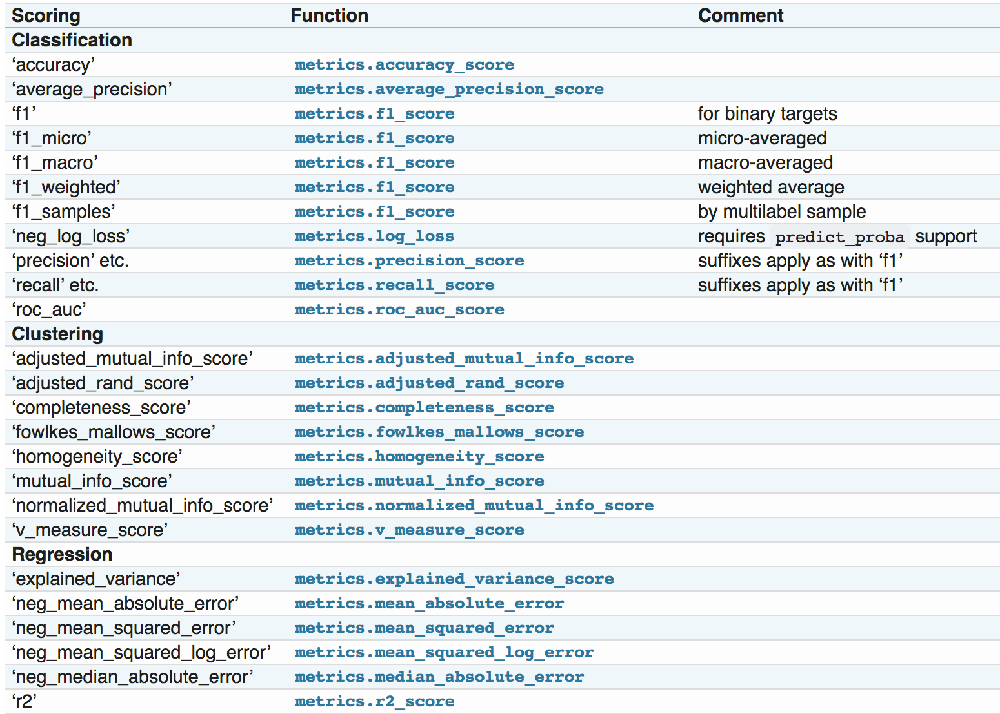

In [ ]:
import sklearn
sorted(sklearn.metrics.SCORERS.keys()) 

['accuracy',
 'adjusted_mutual_info_score',
 'adjusted_rand_score',
 'average_precision',
 'balanced_accuracy',
 'completeness_score',
 'explained_variance',
 'f1',
 'f1_macro',
 'f1_micro',
 'f1_samples',
 'f1_weighted',
 'fowlkes_mallows_score',
 'homogeneity_score',
 'jaccard',
 'jaccard_macro',
 'jaccard_micro',
 'jaccard_samples',
 'jaccard_weighted',
 'max_error',
 'mutual_info_score',
 'neg_brier_score',
 'neg_log_loss',
 'neg_mean_absolute_error',
 'neg_mean_absolute_percentage_error',
 'neg_mean_gamma_deviance',
 'neg_mean_poisson_deviance',
 'neg_mean_squared_error',
 'neg_mean_squared_log_error',
 'neg_median_absolute_error',
 'neg_root_mean_squared_error',
 'normalized_mutual_info_score',
 'precision',
 'precision_macro',
 'precision_micro',
 'precision_samples',
 'precision_weighted',
 'r2',
 'rand_score',
 'recall',
 'recall_macro',
 'recall_micro',
 'recall_samples',
 'recall_weighted',
 'roc_auc',
 'roc_auc_ovo',
 'roc_auc_ovo_weighted',
 'roc_auc_ovr',
 'roc_auc_ovr_we

In [ ]:
from sklearn.model_selection import learning_curve
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import validation_curve

# set the model as our best estimator and finding the learning curve with scoring = accuracy
N, train_lc, val_lc = learning_curve(RandomForestClassifier(max_features=3, n_estimators=22, random_state=42),
                                     X_train, y_train, cv=5,scoring='accuracy',
                                      train_sizes=np.linspace(0.05, 1, 20)) # separate our training size by np.linspace, to 20 pieces

Save our learning curve value to joblib

In [ ]:
joblib.dump(N,'N.pkl')
joblib.dump(train_lc,'train_lc.pkl')
joblib.dump(val_lc,'val_lc.pkl')

['val_lc.pkl']

In [ ]:
N = joblib.load('/content/drive/MyDrive/A1/N.pkl')
train_lc = joblib.load('/content/drive/MyDrive/A1/train_lc.pkl')
val_lc = joblib.load('/content/drive/MyDrive/A1/val_lc.pkl')

Draw the learning curve

In [ ]:
#------------------------learning_curve------------------
def learning_curve(N, train_lc, val_lc):
  # set the figure size
  fig, ax = plt.subplots(figsize=(16, 6))
  # get the training score
  ax.plot(N, np.mean(train_lc, 1), color='blue', label='training score')
  # get the validation score
  ax.plot(N, np.mean(val_lc, 1), color='red', label='validation score')
  # draw the grid line
  ax.hlines(np.mean([train_lc[-1], val_lc[-1]]), N[0], N[-1],
                color='gray', linestyle='dashed')
  # graph setting up
  ax.set_ylim(0.5, 1.2)
  ax.set_xlim(N[0], N[-1])
  ax.set_xlabel('training size')
  ax.set_ylabel('Accuracy')
  ax.set_title("Random forest Accuracy Train/Valid of our final model")
  ax.legend(loc='best')
  fig.show()

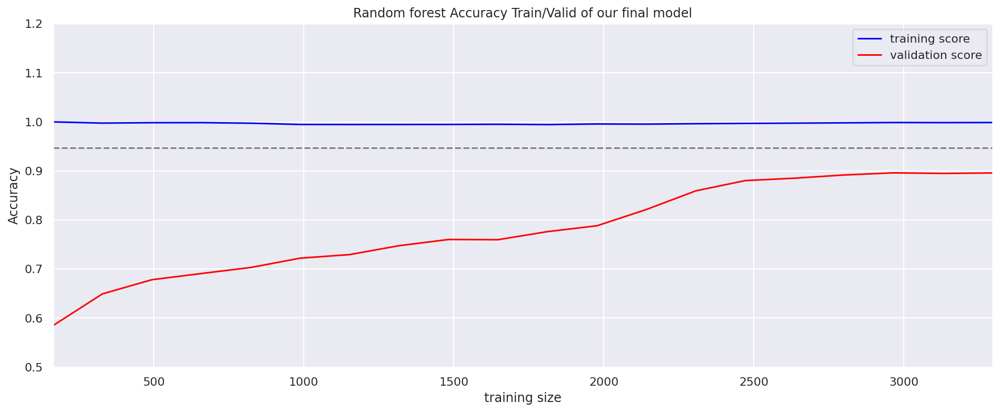

In [ ]:
learning_curve(N, train_lc, val_lc)

#### 2.g.2 Validation curve on different trees:

Although we used random search and grid search for finding the most proper hyperparameters, we still want to know that how many trees is good enough and how our model is influnenced by the different number of trees.
Like what we did in polynomial regression with different degrees.

In this kind of visualization, we can give a intuitive way of showing the chaning of train/valid score by trees number.

This can help up to use a relatively good enough number of trees when we test our model on different dataset. 
Since if we best estimator only has 22 trees, we set our limit to 50 trees in this plot.

In [ ]:
from sklearn.model_selection import validation_curve
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt
import numpy as np

    
n_estimators = np.arange(1, 50) # limit of number of estimators
train_score, val_score = validation_curve(forest_cls_final, X_train, y_train,
                                          param_name='n_estimators', param_range=n_estimators, cv=2
                                          , scoring = 'accuracy')

In [ ]:
joblib.dump(train_score,'est_train_score.pkl')
joblib.dump(val_score,'est_val_score.pkl')

['est_val_score.pkl']

In [ ]:
train_score = joblib.load('/content/drive/MyDrive/A2/est_train_score.pkl')
val_score = joblib.load('/content/drive/MyDrive/A2/est_val_score.pkl')

In [ ]:
#------------------------valid_score_curve------------------

def valid_score_curve(train_score, val_score, n_estimators = np.arange(1, 50)):
  fig, ax = plt.subplots(figsize=(16, 6))
  # get mean of 5 cv of values
  ax.plot(n_estimators, np.median(train_score, 1), color='blue', label='training score')
  ax.plot(n_estimators, np.median(val_score, 1), color='red', label='validation score')
  # matplot setting
  ax.legend(loc='best')
  ax.set_ylim(0.6, 1.2)
  ax.set_xlim(0, 50)
  ax.set_title("Train/Valid ACCURACY loss of different random forest models")
  ax.set_xlabel('number of trees')
  ax.set_ylabel('ACCURACY');
  plt.show()

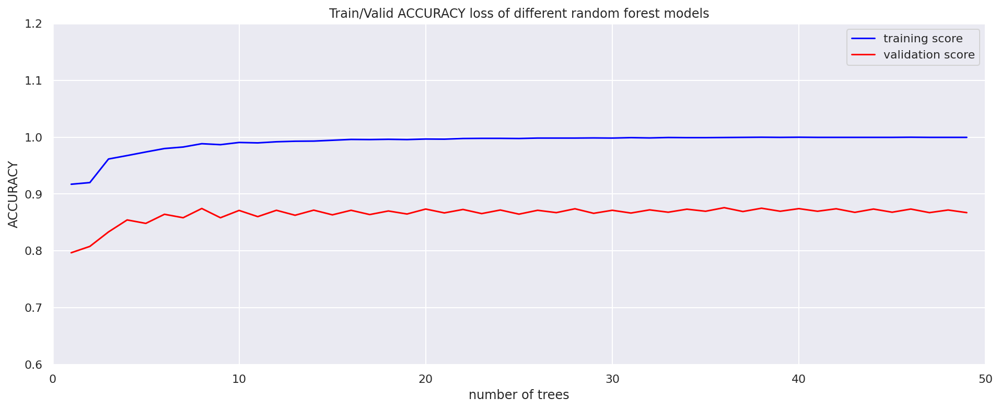

In [ ]:
# draw the validation curve
valid_score_curve(train_score, val_score, n_estimators = np.arange(1, 50))

#### 2.g.3 Confusion matrix of predict value and ground truth value.

Now, we resuse our confusion matrix function to see what's going on of our prediction and Churn value.

In [ ]:
import matplotlib.pyplot as plt
import numpy
from sklearn import metrics

from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix


#------------------------draw_confusion_matrix------------------
def draw_confusion_matrix_testing(y_test, pred): 
  # calculate the confusion matrix
  confusion_matrix = metrics.confusion_matrix(y_test, pred)
  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [True, False])
  cm_display.plot()
  # matplot setting
  cm_display.ax_.set_xlabel("Prediciton")
  cm_display.ax_.set_ylabel("Churn")
  cm_display.ax_.set_title("Confusion matrix of Churn vs prediciton")
  plt.show() 

#------------------------draw_normalized_confusion_matrix------------------
def draw_normalized_confusion_matrix_testing(y_true, y_pred, fig_size = (10,7)): 

  #initialize figure
  fig, axs = plt.subplots(figsize=fig_size)
  x = confusion_matrix(y_true, y_pred)
  x_normed = normalize(x, axis=1, norm='l1')
  sns.heatmap(x_normed, annot=True, fmt='g', ax = axs);  #annot=True to annotate cells, ftm='g' to disable scientific notation
  # labels, title and ticks
  axs.set_xlabel("Prediction");axs.set_ylabel('Churn'); 
  axs.set_title('Confusion Matrix of Churn vs Prediction'); 
  axs.xaxis.set_ticklabels(['True', 'False']); axs.yaxis.set_ticklabels(['True', 'False']);
  fig.tight_layout()
  fig.subplots_adjust(top=0.95)

Let's retrieve our test set's target value and our prediction.

In [ ]:
# Train our model
forest_cls_final = RandomForestClassifier(max_features=3, n_estimators=22, random_state=42,
                      verbose=1)
# train our model
forest_cls_final.fit(X_train, y_train)


# test it on test set
prediction_final = forest_cls_final.predict(X_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  22 out of  22 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  22 out of  22 | elapsed:    0.0s finished


In [ ]:
joblib.dump(forest_cls_final , 'forest_reg_final.pkl')

['forest_reg_final.pkl']

In [ ]:
target_names = ['Yes', 'No']

print("Classification report of the final classifier on test set:\n\n",
      classification_report(y_test, prediction_final, target_names=target_names))


Classification report of the final classifier on test set:

               precision    recall  f1-score   support

         Yes       0.84      0.83      0.83      1554
          No       0.54      0.55      0.54       556

    accuracy                           0.76      2110
   macro avg       0.69      0.69      0.69      2110
weighted avg       0.76      0.76      0.76      2110



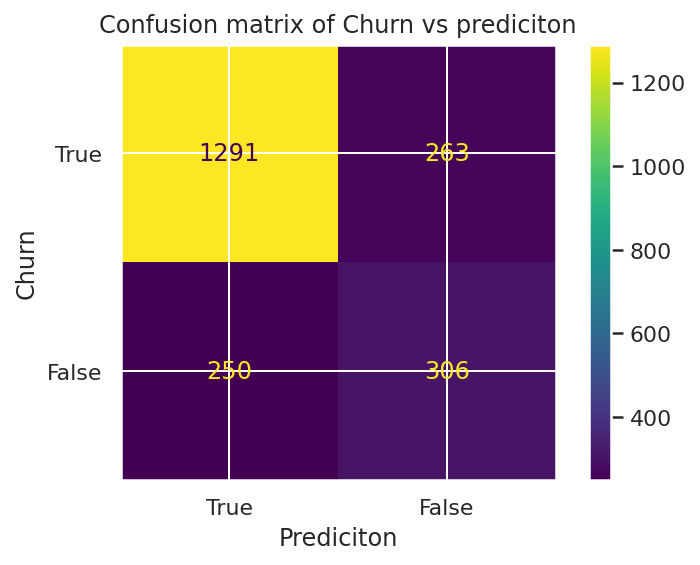

In [ ]:
draw_confusion_matrix_testing(y_test, prediction_final)

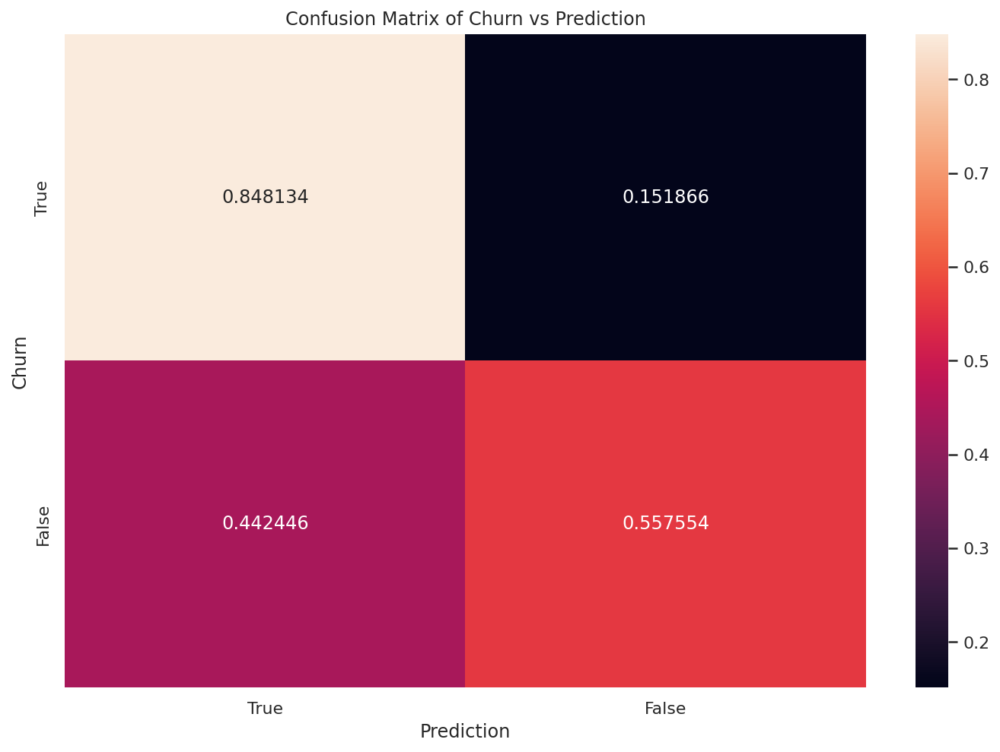

In [ ]:
draw_normalized_confusion_matrix_testing(y_test, prediction_final)

## 2.h Analyze the results

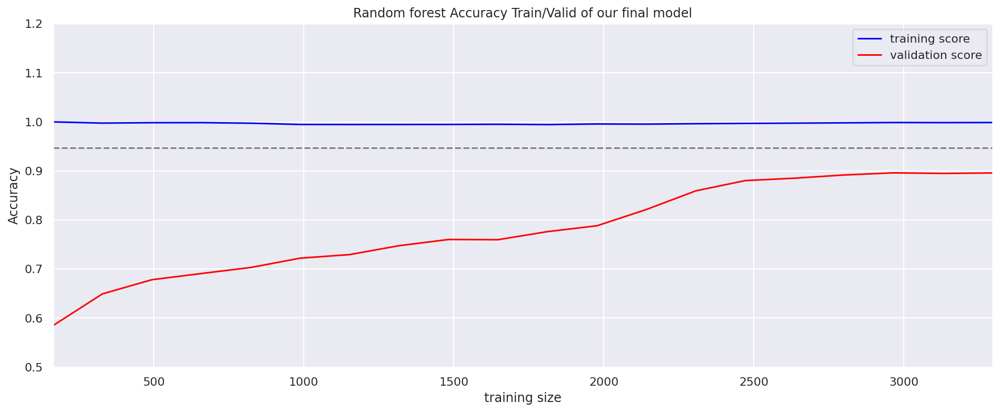

In [ ]:
learning_curve(N, train_lc, val_lc)

We can see that our model is not overfitted in our train set. And it has potential to achieve more accuracy with more data to put in.

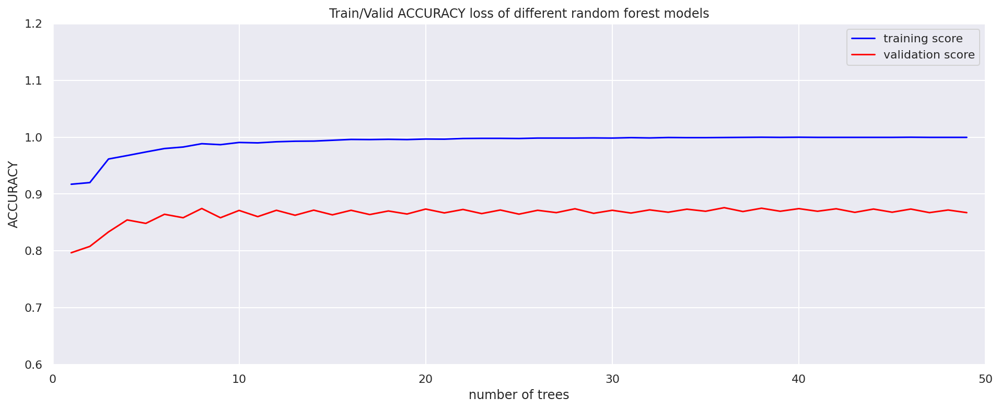

In [ ]:
valid_score_curve(train_score, val_score, n_estimators = np.arange(1, 50))

We can see that when we have 10 or more trees, the performance of our model won't be a big difference. 
We can test it with 11 trees for a more quick results when we are training.

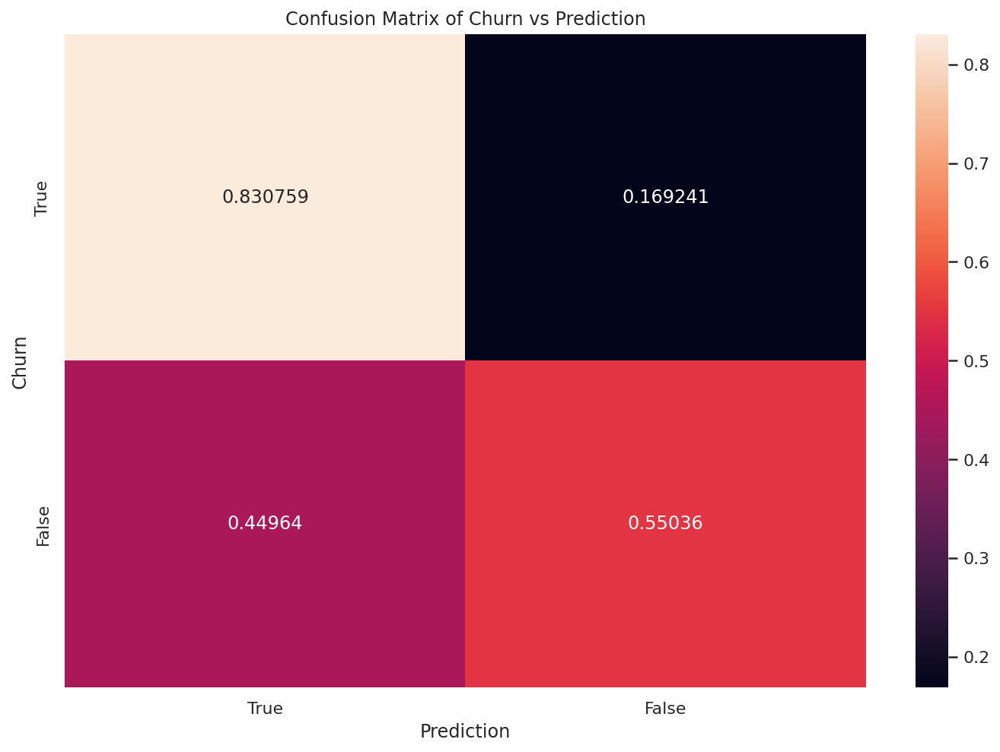

In [ ]:
draw_normalized_confusion_matrix_testing(y_test, prediction_final)

From the Ground truth value vs Prediction confusion matrix, we can see that our model is pretty good at predicting Ture positive values.
Since, there are more Yes in our dataset then No.

However, we want to predict Yes, if a customer will cancel his/her plan, we better get it right before he/she leaves.

# Task 3. Build a NN model to predict customer churn (0.35).
In the section, I will build a Neural Network from scratch.
I tuned this model from May to June, tried dozens of different choices of optimizer, learning rate, network structures, and Loss function.
Well, the results are not quite good I have to say.
Therefore, I put it into the baseline model, since its performance is not good as our candidate model.

### 3.1.0 Create the Neural Network

This code is partly from Homework 1 of the course I learnt for a while, [Machine Learning](https://speech.ee.ntu.edu.tw/~hylee/index.php) by Lihongyi, National Taiwan University's open course.
I modified a lot on the original HW1 codes. (The code is the HW1. It's not the answer of HW1. There isn't any answer you can find online. And the original code only can run a very simple NN model.)

#### Utility Functions

In [ ]:
# ensure the random seed, that our result won't be really random
def same_seed(seed):
    '''Fixes random number generator seeds for reproducibility.'''
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    np.random.seed(seed)
    torch.manual_seed(seed)
    # set cuda seed
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
##############
# split dataset
def train_valid_split(data_set, valid_ratio, seed):
    '''Split provided training data into training set and validation set'''
    # split dataset into train, validation set by ratio
    valid_set_size = int(valid_ratio * len(data_set))
    # get the rest of the set
    train_set_size = len(data_set) - valid_set_size
    # random split the set by what we defined before
    train_set, valid_set = random_split(data_set, [train_set_size, valid_set_size], generator=torch.Generator().manual_seed(seed))
    # return the np array for training
    return np.array(train_set), np.array(valid_set)

#### function of make the neural network prediction
def predict(test_loader, model, device):
    model.eval() # Set your model to evaluation mode.
    preds = []
    for x in tqdm(test_loader): # use tqdm to show the progress
        x = x.to(device)
        with torch.no_grad(): # before do prediction, we need to turn off gradient decent
            pred = model(x)
            preds.append(pred.detach().cpu()) # no need to use GPU for prediction
    preds = torch.cat(preds, dim=0).numpy() # concatenate the results
    return preds

#### Matplotlib Plot function
Well, at the beginning, I used tensorboard to show the plots. It works just fine.
But I need to attach the tensorboard ./run files to this jupyter notebook, which is impossible.
Therefore, this is the alternative way of showing the result.
I will keep the tensorboard solution. But may need the marker to download my record files from my Github. I will put the wget command at the corresponded area.

In [ ]:
def plot_learning_curve(loss_record, title='', type = 'acc' ,  y_start = 0., y_end = 1, ylabel='Accuracy', figsize = (17,10), x_start = 0, x_end = 2000):
    ''' Plot learning curve of your DNN (train & dev loss) '''
    
    accuracy_label = ['train_acc', 'valid_acc']
    loss_label = ['train_loss', 'valid_loss']

    if type == 'acc':
      plot_selection = accuracy_label
    else:
      plot_selection = loss_label

    x_end =  len(loss_record[plot_selection[0]])
    total_steps = len(loss_record[plot_selection[0]]) # get the length of our records
    x_1 = range(total_steps) # get the range of x
    x_2 = x_1[::len(loss_record[plot_selection[0]]) // len(loss_record['valid_acc'])]
    figure(figsize=figsize) # set figsize
    plt.plot(x_1, loss_record[plot_selection[0]], c='tab:red', label='train loss')
    plt.plot(x_2, loss_record[plot_selection[1]], c='tab:cyan', label='validation loss')
    plt.ylim(y_start, y_end) # set limit on x axis
    plt.xlim(x_start, x_end) # set limit on y axis
    plt.xlabel('Training steps')
    plt.ylabel(ylabel)
    plt.title('Learning curve of {}'.format(title))
    plt.legend()
    plt.show()


#### Feature Selection

In [ ]:
def select_feat(train_data, valid_data, test_data, select_all=True):
    '''Selects useful features to perform regression'''
    # because we are operating on np arrays, we will alter the dataset and assume the last column is our target
    y_train, y_valid, y_test= train_data[:,-1], valid_data[:,-1],test_data[:,-1]
    # any columns before the last column is our features x
    raw_x_train, raw_x_valid, raw_x_test = train_data[:,:-1], valid_data[:,:-1], test_data[:,:-1]
    # Hyperparameter setting
    # select all for selecting all features
    if select_all:
        feat_idx = list(range(raw_x_train.shape[1]))
    else:
        # specific the feature index
        feat_idx = [0,1,2,3,4]
    #return the datasets
    return raw_x_train[:,feat_idx], raw_x_valid[:,feat_idx], raw_x_test[:,feat_idx], y_train, y_valid, y_test

#### Dataset

In [ ]:
# Dataset class
class Dataset_container(Dataset):
    '''
    x: Features.
    y: Targets, if none, do prediction.
    '''
    def __init__(self, x, y=None):
        if y is None:
            self.y = y # return prediction
        else:
            self.y = torch.LongTensor(y) # get target value
        self.x = torch.FloatTensor(x) # get features

    def __getitem__(self, idx):
        if self.y is None:
            return self.x[idx] # get features
        else:
            return self.x[idx], self.y[idx] # get features and target

    def __len__(self):
        return len(self.x) # return length

#### Neural Network Model

In [ ]:
class My_Model(nn.Module):
    def __init__(self, input_dim):
        super(My_Model, self).__init__()
        # create the neural network structure
        # deep is better
        # simply a deep and fully connected NN
        # not too many things here to say
        # only tried hundreds of combinations about the number of hidden layers and the number of nodes of a hidden layer
        self.layers = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.ReLU(),
            nn.Linear(16, 32),
            nn.ReLU(),
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(64, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 8),
            nn.ReLU(),
            nn.Linear(8, 2),
        )

    def forward(self, x):
        x = self.layers(x) # call the nn.Sequential function
        x = x.squeeze(1) # (B, 1) -> (B) change 2D tensor to 1D tensor
        return x

#### Training Loop

In [ ]:
def trainer(train_loader, valid_loader,train_dataset, valid_dataset, model, config, device):

    criterion = nn.CrossEntropyLoss() # Define our loss function. By Cross Entropy 
    # Use AdamW this time again
    optimizer = torch.optim.AdamW(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])
    # save our best_acc 
    best_acc = 0.0
    # training parameters
    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0
    # make folder for training model
    if not os.path.isdir('./models'):
        os.mkdir('./models') # Create directory of saving models.

    # this is the result saver for our plot function
    loss_record_plot = {'train_acc': [], 'valid_acc': [], 'train_loss':[], 'valid_loss':[]}      # for recording training loss


    writer = SummaryWriter() # Writer of tensoboard.

    for epoch in range(n_epochs):
        
        # basic settings 
        train_acc = 0.0
        train_loss = 0.0
        val_acc = 0.0
        val_loss = 0.0

        # get features and labels in one batch
        for i, batch in enumerate(tqdm(train_loader)):
          # move features and labels to CPU/GPU
          features, labels = batch
          features = features.to(device)
          labels = labels.to(device)
          
          optimizer.zero_grad()  # before training, we need to clean our saved weights and bias
          outputs = model(features)  # train
          
          loss = criterion(outputs, labels) # get loss by CrossEntropy
          loss.backward() 
          optimizer.step() 
          
                            
          # save training accuracy and loss 

          _, train_pred = torch.max(outputs, 1) # get the index of the class with the highest probability
          train_acc += (train_pred.detach() == labels.detach()).sum().item()
          train_loss += loss.item()
            

          model.eval() # set the model to evaluation mode

        # start validating 

        if len(valid_dataset) > 0: 
          with torch.no_grad(): # tell pytorch don't update gradient.
              # get features and labels from one batch
              for i, batch in enumerate(tqdm(valid_loader)):
                  features, labels = batch
                  features = features.to(device)
                  labels = labels.to(device)
                  outputs = model(features)
                  
                  loss = criterion(outputs, labels) 
                  
                  # save validation accuracy and loss 
                  _, val_pred = torch.max(outputs, 1) 
                  val_acc += (val_pred.cpu() == labels.cpu()).sum().item() # get the index of the class with the highest probability
                  val_loss += loss.item()

              # prompt train/loss information 

              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print('[{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                  epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array

              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1) 
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1) 
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)
              

              # if the model improves, save a checkpoint at this epoch
              if val_acc > best_acc:
                  best_acc = val_acc
                  early_stop_count = 0 # reset early stopping counter

                  torch.save(model.state_dict(), config['save_path'])
                  print('##################################################saving model with acc {:.3f}##############################################################'.format(best_acc/len(valid_dataset)))

              if val_acc < best_acc:
                  early_stop_count += 1 # add one to early stopping counter

              if early_stop_count >= config['early_stop']: # apply early stopping and quit training
                  print('\nModel is not improving, so we halt the training session.')
                  return loss_record_plot
        else:
            ############## Base on the famous theory - Occam's razor, we don't write another function here to simplify this procedure########
            ## "Entities should not be multiplied beyond necessity" ###
            # writing another function inside the training function is not a good idea
            # Although it looks bad, we keep it the structure simple.

            # print last epoch's info
              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print('[{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                  epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array
              
              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1) 
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1) 
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)

    # if not validating, save the last epoch
    if len(valid_dataset) == 0:
        torch.save(model.state_dict(), config['save_path'])
        print('saving model at last epoch')

    return loss_record_plot               

### 3.1.1 Hyperparameter tuning configurations
Config contains hyperparameters for training and the path to save your model.

The following is the key of my model.
I set weight decay has the same value with learning_rate.

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 512,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-3,
    'early_stop': 50,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}

#### DataLoader
Read data from files and set up training, validation, and testing sets.

In order to avoid confusing, let's re-generate our dataloader again.
Since we are using the same random seed, the result will be the same.

In [ ]:
raw_data_copy = raw_data.copy()
converted_data = convert_pipeline.fit_transform(raw_data_copy)


# split data from the original dataset
from sklearn.model_selection import train_test_split
training_data, testing_data = train_test_split(converted_data, test_size=0.3, random_state=42)

testing_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
2482,-0.59,-1.14,0.50,0,1,1,12,1,0
6784,-1.00,-1.51,-1.60,0,1,1,1,2,0
6127,1.60,1.35,-1.27,0,0,0,1,2,0
3055,-0.45,0.87,0.22,0,1,1,1,1,1
4102,-0.47,-1.51,-0.29,0,0,1,24,2,0


In [ ]:
len(training_data)

4922

In [ ]:

same_seed(config['seed'])

train_data, test_data = training_data.values, testing_data.values

train_data = train_data.astype(float)
test_data = test_data.astype(float)


train_data, valid_data = train_valid_split(train_data, config['valid_ratio'], config['seed'])

# Print out the data size.
print(f"""train_data size: {train_data.shape}
valid_data size: {valid_data.shape}
test_data size: {test_data.shape}""")

# Select features
x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])


# Print out the number of features.
print(f'number of features: {x_train.shape[1]}')

train_dataset, valid_dataset, test_dataset = Dataset_container(x_train, y_train), \
                                            Dataset_container(x_valid, y_valid), \
                                            Dataset_container(x_test,y_test)

# Pytorch data loader loads pytorch dataset into batches.
train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)



train_data size: (2813, 9)
valid_data size: (2109, 9)
test_data size: (2110, 9)
number of features: 8


***The thing is that oversampling doesn't work so well in Neural Network. It takes so much space to show the results. I will ignore it in Assignment 2.
For now, Let's just say we don't use oversampling training set on our DNN.***

### 3.1.2 Training Procedure and evaluate

We have everything we need, let's start to train the model.

In [ ]:
!kill 1639

In [ ]:
# load tensorboard
%reload_ext tensorboard
%tensorboard --logdir=./runs/

<IPython.core.display.Javascript object>

In [ ]:
# rm -rf ./runs

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 128,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 150,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}


In [ ]:
model = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
# this is the result saver for our plot function
loss_record_plot = {'train_acc': [], 'valid_acc': [], 'train_loss':[], 'valid_loss':[]}      # for recording training loss

loss_record_plot = trainer(train_loader, valid_loader, train_dataset, valid_dataset, model, config, device);

100%|██████████| 40/40 [00:00<00:00, 1127.82it/s]


[001/2000] Train Acc: 0.266264 Loss: 0.730823 | Val Acc: 0.267425 loss: 0.724585
##################################################saving model with acc 0.267##############################################################


100%|██████████| 40/40 [00:00<00:00, 1103.70it/s]


[002/2000] Train Acc: 0.266264 Loss: 0.719659 | Val Acc: 0.267425 loss: 0.713202


100%|██████████| 40/40 [00:00<00:00, 1117.05it/s]


[003/2000] Train Acc: 0.388553 Loss: 0.700544 | Val Acc: 0.648649 loss: 0.682032
##################################################saving model with acc 0.649##############################################################


100%|██████████| 40/40 [00:00<00:00, 1010.68it/s]


[004/2000] Train Acc: 0.691433 Loss: 0.636771 | Val Acc: 0.732575 loss: 0.581724
##################################################saving model with acc 0.733##############################################################


100%|██████████| 40/40 [00:00<00:00, 1133.10it/s]


[005/2000] Train Acc: 0.733736 Loss: 0.498563 | Val Acc: 0.732575 loss: 0.479341


100%|██████████| 40/40 [00:00<00:00, 863.94it/s]


[006/2000] Train Acc: 0.733736 Loss: 0.472286 | Val Acc: 0.732575 loss: 0.507879


100%|██████████| 40/40 [00:00<00:00, 953.00it/s]


[007/2000] Train Acc: 0.733736 Loss: 0.466676 | Val Acc: 0.732575 loss: 0.490751


100%|██████████| 40/40 [00:00<00:00, 966.83it/s]


[008/2000] Train Acc: 0.733736 Loss: 0.466206 | Val Acc: 0.732575 loss: 0.479407


100%|██████████| 40/40 [00:00<00:00, 1052.63it/s]


[009/2000] Train Acc: 0.733736 Loss: 0.472509 | Val Acc: 0.732575 loss: 0.474000


100%|██████████| 40/40 [00:00<00:00, 1173.03it/s]


[010/2000] Train Acc: 0.733736 Loss: 0.465627 | Val Acc: 0.732575 loss: 0.477044


100%|██████████| 40/40 [00:00<00:00, 1058.57it/s]


[011/2000] Train Acc: 0.733736 Loss: 0.464419 | Val Acc: 0.732575 loss: 0.479164


100%|██████████| 40/40 [00:00<00:00, 876.32it/s]


[012/2000] Train Acc: 0.733736 Loss: 0.464755 | Val Acc: 0.732575 loss: 0.479210


100%|██████████| 40/40 [00:00<00:00, 1032.32it/s]


[013/2000] Train Acc: 0.733736 Loss: 0.460084 | Val Acc: 0.732575 loss: 0.483776


100%|██████████| 40/40 [00:00<00:00, 904.08it/s]


[014/2000] Train Acc: 0.733736 Loss: 0.463794 | Val Acc: 0.732575 loss: 0.471858


100%|██████████| 40/40 [00:00<00:00, 930.49it/s]


[015/2000] Train Acc: 0.733736 Loss: 0.462325 | Val Acc: 0.732575 loss: 0.484158


100%|██████████| 40/40 [00:00<00:00, 1127.31it/s]


[016/2000] Train Acc: 0.733736 Loss: 0.462911 | Val Acc: 0.732575 loss: 0.480905


100%|██████████| 40/40 [00:00<00:00, 1023.36it/s]


[017/2000] Train Acc: 0.733736 Loss: 0.457439 | Val Acc: 0.732575 loss: 0.477861


100%|██████████| 40/40 [00:00<00:00, 1094.25it/s]


[018/2000] Train Acc: 0.733736 Loss: 0.456703 | Val Acc: 0.732575 loss: 0.468744


100%|██████████| 40/40 [00:00<00:00, 947.12it/s]


[019/2000] Train Acc: 0.733736 Loss: 0.455004 | Val Acc: 0.732575 loss: 0.468668


100%|██████████| 40/40 [00:00<00:00, 1095.45it/s]


[020/2000] Train Acc: 0.733736 Loss: 0.457438 | Val Acc: 0.732575 loss: 0.468169


100%|██████████| 40/40 [00:00<00:00, 1038.72it/s]


[021/2000] Train Acc: 0.735869 Loss: 0.456248 | Val Acc: 0.734471 loss: 0.473512
##################################################saving model with acc 0.734##############################################################


100%|██████████| 40/40 [00:00<00:00, 1036.51it/s]


[022/2000] Train Acc: 0.743335 Loss: 0.456561 | Val Acc: 0.743954 loss: 0.468679
##################################################saving model with acc 0.744##############################################################


100%|██████████| 40/40 [00:00<00:00, 721.33it/s]


[023/2000] Train Acc: 0.747245 Loss: 0.455097 | Val Acc: 0.751541 loss: 0.466074
##################################################saving model with acc 0.752##############################################################


100%|██████████| 40/40 [00:00<00:00, 1080.59it/s]


[024/2000] Train Acc: 0.755421 Loss: 0.451113 | Val Acc: 0.757705 loss: 0.466486
##################################################saving model with acc 0.758##############################################################


100%|██████████| 40/40 [00:00<00:00, 908.18it/s]


[025/2000] Train Acc: 0.758265 Loss: 0.448428 | Val Acc: 0.764343 loss: 0.457090
##################################################saving model with acc 0.764##############################################################


100%|██████████| 40/40 [00:00<00:00, 1090.16it/s]


[026/2000] Train Acc: 0.768219 Loss: 0.447034 | Val Acc: 0.773352 loss: 0.464741
##################################################saving model with acc 0.773##############################################################


100%|██████████| 40/40 [00:00<00:00, 1009.04it/s]


[027/2000] Train Acc: 0.773551 Loss: 0.446950 | Val Acc: 0.774775 loss: 0.468001
##################################################saving model with acc 0.775##############################################################


100%|██████████| 40/40 [00:00<00:00, 939.97it/s]


[028/2000] Train Acc: 0.781728 Loss: 0.451877 | Val Acc: 0.774775 loss: 0.457680


100%|██████████| 40/40 [00:00<00:00, 1062.83it/s]


[029/2000] Train Acc: 0.777462 Loss: 0.445679 | Val Acc: 0.775249 loss: 0.459148
##################################################saving model with acc 0.775##############################################################


100%|██████████| 40/40 [00:00<00:00, 1094.94it/s]


[030/2000] Train Acc: 0.781372 Loss: 0.442657 | Val Acc: 0.777146 loss: 0.456231
##################################################saving model with acc 0.777##############################################################


100%|██████████| 40/40 [00:00<00:00, 1047.25it/s]


[031/2000] Train Acc: 0.780306 Loss: 0.439228 | Val Acc: 0.770033 loss: 0.453231


100%|██████████| 40/40 [00:00<00:00, 1125.59it/s]


[032/2000] Train Acc: 0.781372 Loss: 0.435080 | Val Acc: 0.779042 loss: 0.460664
##################################################saving model with acc 0.779##############################################################


100%|██████████| 40/40 [00:00<00:00, 1043.61it/s]


[033/2000] Train Acc: 0.780306 Loss: 0.434540 | Val Acc: 0.781887 loss: 0.457880
##################################################saving model with acc 0.782##############################################################


100%|██████████| 40/40 [00:00<00:00, 1037.93it/s]


[034/2000] Train Acc: 0.779239 Loss: 0.438118 | Val Acc: 0.768137 loss: 0.455676


100%|██████████| 40/40 [00:00<00:00, 964.52it/s]


[035/2000] Train Acc: 0.779950 Loss: 0.434074 | Val Acc: 0.780465 loss: 0.446908


100%|██████████| 40/40 [00:00<00:00, 1184.99it/s]


[036/2000] Train Acc: 0.777817 Loss: 0.436557 | Val Acc: 0.780939 loss: 0.457197


100%|██████████| 40/40 [00:00<00:00, 1014.02it/s]


[037/2000] Train Acc: 0.779950 Loss: 0.430056 | Val Acc: 0.782361 loss: 0.443446
##################################################saving model with acc 0.782##############################################################


100%|██████████| 40/40 [00:00<00:00, 952.33it/s]


[038/2000] Train Acc: 0.782794 Loss: 0.439111 | Val Acc: 0.773826 loss: 0.442836


100%|██████████| 40/40 [00:00<00:00, 904.52it/s]


[039/2000] Train Acc: 0.779950 Loss: 0.426805 | Val Acc: 0.776197 loss: 0.449043


100%|██████████| 40/40 [00:00<00:00, 1005.20it/s]


[040/2000] Train Acc: 0.779239 Loss: 0.429914 | Val Acc: 0.776671 loss: 0.445312


100%|██████████| 40/40 [00:00<00:00, 965.47it/s]


[041/2000] Train Acc: 0.778528 Loss: 0.429025 | Val Acc: 0.772878 loss: 0.450554


100%|██████████| 40/40 [00:00<00:00, 943.73it/s]


[042/2000] Train Acc: 0.779239 Loss: 0.423028 | Val Acc: 0.775249 loss: 0.438623


100%|██████████| 40/40 [00:00<00:00, 1074.24it/s]


[043/2000] Train Acc: 0.781017 Loss: 0.428092 | Val Acc: 0.779042 loss: 0.441402


100%|██████████| 40/40 [00:00<00:00, 1008.94it/s]


[044/2000] Train Acc: 0.783861 Loss: 0.426044 | Val Acc: 0.775723 loss: 0.435757


100%|██████████| 40/40 [00:00<00:00, 1043.77it/s]


[045/2000] Train Acc: 0.781017 Loss: 0.427079 | Val Acc: 0.773826 loss: 0.447235


100%|██████████| 40/40 [00:00<00:00, 925.67it/s]


[046/2000] Train Acc: 0.782083 Loss: 0.422733 | Val Acc: 0.776671 loss: 0.451582


100%|██████████| 40/40 [00:00<00:00, 939.29it/s]


[047/2000] Train Acc: 0.783861 Loss: 0.421422 | Val Acc: 0.775723 loss: 0.433823


100%|██████████| 40/40 [00:00<00:00, 903.80it/s]


[048/2000] Train Acc: 0.782083 Loss: 0.423844 | Val Acc: 0.777146 loss: 0.482153


100%|██████████| 40/40 [00:00<00:00, 944.46it/s]


[049/2000] Train Acc: 0.786349 Loss: 0.429800 | Val Acc: 0.779516 loss: 0.437691


100%|██████████| 40/40 [00:00<00:00, 1038.17it/s]


[050/2000] Train Acc: 0.784927 Loss: 0.417790 | Val Acc: 0.779991 loss: 0.444981


100%|██████████| 40/40 [00:00<00:00, 1244.76it/s]


[051/2000] Train Acc: 0.783505 Loss: 0.423962 | Val Acc: 0.778094 loss: 0.445935


100%|██████████| 40/40 [00:00<00:00, 944.93it/s]


[052/2000] Train Acc: 0.786349 Loss: 0.427480 | Val Acc: 0.780465 loss: 0.443934


100%|██████████| 40/40 [00:00<00:00, 963.29it/s]


[053/2000] Train Acc: 0.788482 Loss: 0.424037 | Val Acc: 0.778094 loss: 0.441008


100%|██████████| 40/40 [00:00<00:00, 1026.27it/s]


[054/2000] Train Acc: 0.788127 Loss: 0.418969 | Val Acc: 0.782361 loss: 0.440376


100%|██████████| 40/40 [00:00<00:00, 1007.19it/s]


[055/2000] Train Acc: 0.787771 Loss: 0.420060 | Val Acc: 0.781887 loss: 0.431628


100%|██████████| 40/40 [00:00<00:00, 1009.76it/s]


[056/2000] Train Acc: 0.786705 Loss: 0.427670 | Val Acc: 0.781413 loss: 0.441754


100%|██████████| 40/40 [00:00<00:00, 982.77it/s]


[057/2000] Train Acc: 0.787416 Loss: 0.415275 | Val Acc: 0.779516 loss: 0.450033


100%|██████████| 40/40 [00:00<00:00, 1105.06it/s]


[058/2000] Train Acc: 0.788482 Loss: 0.422262 | Val Acc: 0.779516 loss: 0.435069


100%|██████████| 40/40 [00:00<00:00, 1057.80it/s]


[059/2000] Train Acc: 0.792392 Loss: 0.419088 | Val Acc: 0.781887 loss: 0.431925


100%|██████████| 40/40 [00:00<00:00, 774.70it/s]


[060/2000] Train Acc: 0.791681 Loss: 0.415910 | Val Acc: 0.777620 loss: 0.447099


100%|██████████| 40/40 [00:00<00:00, 1004.69it/s]


[061/2000] Train Acc: 0.789549 Loss: 0.419774 | Val Acc: 0.781413 loss: 0.440911


100%|██████████| 40/40 [00:00<00:00, 1046.05it/s]


[062/2000] Train Acc: 0.790260 Loss: 0.417052 | Val Acc: 0.779991 loss: 0.450626


100%|██████████| 40/40 [00:00<00:00, 1053.36it/s]


[063/2000] Train Acc: 0.787416 Loss: 0.425162 | Val Acc: 0.781887 loss: 0.441129


100%|██████████| 40/40 [00:00<00:00, 968.41it/s]


[064/2000] Train Acc: 0.789193 Loss: 0.423805 | Val Acc: 0.778568 loss: 0.432148


100%|██████████| 40/40 [00:00<00:00, 1121.16it/s]


[065/2000] Train Acc: 0.782083 Loss: 0.414087 | Val Acc: 0.785680 loss: 0.446298
##################################################saving model with acc 0.786##############################################################


100%|██████████| 40/40 [00:00<00:00, 1032.48it/s]


[066/2000] Train Acc: 0.788838 Loss: 0.412852 | Val Acc: 0.782835 loss: 0.439093


100%|██████████| 40/40 [00:00<00:00, 1115.88it/s]


[067/2000] Train Acc: 0.787416 Loss: 0.418212 | Val Acc: 0.781413 loss: 0.441526


100%|██████████| 40/40 [00:00<00:00, 826.35it/s]


[068/2000] Train Acc: 0.789193 Loss: 0.410504 | Val Acc: 0.782835 loss: 0.466445


100%|██████████| 40/40 [00:00<00:00, 1014.73it/s]


[069/2000] Train Acc: 0.787416 Loss: 0.413546 | Val Acc: 0.781413 loss: 0.435045


100%|██████████| 40/40 [00:00<00:00, 961.87it/s]


[070/2000] Train Acc: 0.791326 Loss: 0.416059 | Val Acc: 0.782361 loss: 0.440220


100%|██████████| 40/40 [00:00<00:00, 1122.60it/s]


[071/2000] Train Acc: 0.789549 Loss: 0.414877 | Val Acc: 0.785206 loss: 0.459065


100%|██████████| 40/40 [00:00<00:00, 1038.86it/s]


[072/2000] Train Acc: 0.792748 Loss: 0.413766 | Val Acc: 0.782361 loss: 0.438805


100%|██████████| 40/40 [00:00<00:00, 888.61it/s]


[073/2000] Train Acc: 0.789549 Loss: 0.410248 | Val Acc: 0.782361 loss: 0.442368


100%|██████████| 40/40 [00:00<00:00, 1026.52it/s]


[074/2000] Train Acc: 0.790970 Loss: 0.414316 | Val Acc: 0.782361 loss: 0.442289


100%|██████████| 40/40 [00:00<00:00, 1066.62it/s]


[075/2000] Train Acc: 0.788482 Loss: 0.412871 | Val Acc: 0.785206 loss: 0.435674


100%|██████████| 40/40 [00:00<00:00, 1054.75it/s]


[076/2000] Train Acc: 0.789549 Loss: 0.417516 | Val Acc: 0.783784 loss: 0.445693


100%|██████████| 40/40 [00:00<00:00, 987.09it/s]


[077/2000] Train Acc: 0.788838 Loss: 0.411538 | Val Acc: 0.786155 loss: 0.437694
##################################################saving model with acc 0.786##############################################################


100%|██████████| 40/40 [00:00<00:00, 1045.63it/s]


[078/2000] Train Acc: 0.793103 Loss: 0.414528 | Val Acc: 0.785680 loss: 0.455791


100%|██████████| 40/40 [00:00<00:00, 699.59it/s]


[079/2000] Train Acc: 0.788127 Loss: 0.414340 | Val Acc: 0.785680 loss: 0.441220


100%|██████████| 40/40 [00:00<00:00, 900.39it/s]


[080/2000] Train Acc: 0.793103 Loss: 0.413587 | Val Acc: 0.786155 loss: 0.430467


100%|██████████| 40/40 [00:00<00:00, 890.46it/s]


[081/2000] Train Acc: 0.789549 Loss: 0.406897 | Val Acc: 0.787103 loss: 0.434801
##################################################saving model with acc 0.787##############################################################


100%|██████████| 40/40 [00:00<00:00, 989.84it/s]


[082/2000] Train Acc: 0.787060 Loss: 0.408115 | Val Acc: 0.785680 loss: 0.444942


100%|██████████| 40/40 [00:00<00:00, 939.45it/s]


[083/2000] Train Acc: 0.789549 Loss: 0.412567 | Val Acc: 0.787103 loss: 0.431333


100%|██████████| 40/40 [00:00<00:00, 1002.32it/s]


[084/2000] Train Acc: 0.792748 Loss: 0.409834 | Val Acc: 0.786629 loss: 0.429635


100%|██████████| 40/40 [00:00<00:00, 918.82it/s]


[085/2000] Train Acc: 0.794525 Loss: 0.411230 | Val Acc: 0.784732 loss: 0.432488


100%|██████████| 40/40 [00:00<00:00, 1085.68it/s]


[086/2000] Train Acc: 0.792748 Loss: 0.415735 | Val Acc: 0.783784 loss: 0.432618


100%|██████████| 40/40 [00:00<00:00, 1004.03it/s]


[087/2000] Train Acc: 0.792748 Loss: 0.411528 | Val Acc: 0.790422 loss: 0.442432
##################################################saving model with acc 0.790##############################################################


100%|██████████| 40/40 [00:00<00:00, 1006.56it/s]


[088/2000] Train Acc: 0.795236 Loss: 0.409533 | Val Acc: 0.783310 loss: 0.440792


100%|██████████| 40/40 [00:00<00:00, 931.93it/s]


[089/2000] Train Acc: 0.795236 Loss: 0.410805 | Val Acc: 0.786629 loss: 0.437035


100%|██████████| 40/40 [00:00<00:00, 872.96it/s]


[090/2000] Train Acc: 0.793459 Loss: 0.412867 | Val Acc: 0.787577 loss: 0.433002


100%|██████████| 40/40 [00:00<00:00, 952.39it/s]


[091/2000] Train Acc: 0.792748 Loss: 0.410487 | Val Acc: 0.783310 loss: 0.427258


100%|██████████| 40/40 [00:00<00:00, 1081.54it/s]


[092/2000] Train Acc: 0.794525 Loss: 0.411503 | Val Acc: 0.783784 loss: 0.427096


100%|██████████| 40/40 [00:00<00:00, 1067.05it/s]


[093/2000] Train Acc: 0.795947 Loss: 0.417706 | Val Acc: 0.786155 loss: 0.426785


100%|██████████| 40/40 [00:00<00:00, 981.95it/s]


[094/2000] Train Acc: 0.794881 Loss: 0.428537 | Val Acc: 0.789474 loss: 0.431626


100%|██████████| 40/40 [00:00<00:00, 922.75it/s]


[095/2000] Train Acc: 0.794170 Loss: 0.411672 | Val Acc: 0.789000 loss: 0.436357


100%|██████████| 40/40 [00:00<00:00, 973.62it/s]


[096/2000] Train Acc: 0.795592 Loss: 0.411082 | Val Acc: 0.790422 loss: 0.427875


100%|██████████| 40/40 [00:00<00:00, 1028.56it/s]


[097/2000] Train Acc: 0.792392 Loss: 0.410249 | Val Acc: 0.788525 loss: 0.433657


100%|██████████| 40/40 [00:00<00:00, 816.41it/s]


[098/2000] Train Acc: 0.795236 Loss: 0.415433 | Val Acc: 0.786155 loss: 0.432524


100%|██████████| 40/40 [00:00<00:00, 1018.31it/s]


[099/2000] Train Acc: 0.793103 Loss: 0.420041 | Val Acc: 0.786629 loss: 0.430953


100%|██████████| 40/40 [00:00<00:00, 937.39it/s]


[100/2000] Train Acc: 0.792037 Loss: 0.407210 | Val Acc: 0.786155 loss: 0.440622


100%|██████████| 40/40 [00:00<00:00, 1014.06it/s]


[101/2000] Train Acc: 0.794881 Loss: 0.409250 | Val Acc: 0.789000 loss: 0.438921


100%|██████████| 40/40 [00:00<00:00, 909.00it/s]


[102/2000] Train Acc: 0.796303 Loss: 0.414269 | Val Acc: 0.786629 loss: 0.447394


100%|██████████| 40/40 [00:00<00:00, 967.63it/s]


[103/2000] Train Acc: 0.795236 Loss: 0.411380 | Val Acc: 0.787577 loss: 0.441306


100%|██████████| 40/40 [00:00<00:00, 989.43it/s]


[104/2000] Train Acc: 0.797725 Loss: 0.412437 | Val Acc: 0.789948 loss: 0.434190


100%|██████████| 40/40 [00:00<00:00, 903.90it/s]


[105/2000] Train Acc: 0.797014 Loss: 0.409395 | Val Acc: 0.789948 loss: 0.431669


100%|██████████| 40/40 [00:00<00:00, 971.30it/s]


[106/2000] Train Acc: 0.794881 Loss: 0.406021 | Val Acc: 0.789000 loss: 0.432676


100%|██████████| 40/40 [00:00<00:00, 969.90it/s]


[107/2000] Train Acc: 0.796303 Loss: 0.416969 | Val Acc: 0.786155 loss: 0.428709


100%|██████████| 40/40 [00:00<00:00, 901.28it/s]


[108/2000] Train Acc: 0.795947 Loss: 0.415442 | Val Acc: 0.789474 loss: 0.427428


100%|██████████| 40/40 [00:00<00:00, 1064.64it/s]


[109/2000] Train Acc: 0.796303 Loss: 0.411012 | Val Acc: 0.789948 loss: 0.428744


100%|██████████| 40/40 [00:00<00:00, 992.15it/s]


[110/2000] Train Acc: 0.793459 Loss: 0.412248 | Val Acc: 0.790896 loss: 0.432607
##################################################saving model with acc 0.791##############################################################


100%|██████████| 40/40 [00:00<00:00, 913.66it/s]


[111/2000] Train Acc: 0.800924 Loss: 0.417847 | Val Acc: 0.788525 loss: 0.431955


100%|██████████| 40/40 [00:00<00:00, 989.30it/s]


[112/2000] Train Acc: 0.799858 Loss: 0.408509 | Val Acc: 0.788051 loss: 0.440122


100%|██████████| 40/40 [00:00<00:00, 749.15it/s]


[113/2000] Train Acc: 0.796303 Loss: 0.407231 | Val Acc: 0.786629 loss: 0.427150


100%|██████████| 40/40 [00:00<00:00, 913.93it/s]


[114/2000] Train Acc: 0.798791 Loss: 0.407731 | Val Acc: 0.789948 loss: 0.433282


100%|██████████| 40/40 [00:00<00:00, 897.16it/s]


[115/2000] Train Acc: 0.796658 Loss: 0.415072 | Val Acc: 0.786629 loss: 0.444285


100%|██████████| 40/40 [00:00<00:00, 1075.86it/s]


[116/2000] Train Acc: 0.798080 Loss: 0.406955 | Val Acc: 0.787103 loss: 0.427844


100%|██████████| 40/40 [00:00<00:00, 967.29it/s]


[117/2000] Train Acc: 0.800569 Loss: 0.408169 | Val Acc: 0.786629 loss: 0.446181


100%|██████████| 40/40 [00:00<00:00, 1017.93it/s]


[118/2000] Train Acc: 0.799502 Loss: 0.409391 | Val Acc: 0.789000 loss: 0.438514


100%|██████████| 40/40 [00:00<00:00, 971.46it/s]


[119/2000] Train Acc: 0.801991 Loss: 0.408244 | Val Acc: 0.788525 loss: 0.433209


100%|██████████| 40/40 [00:00<00:00, 892.60it/s]


[120/2000] Train Acc: 0.797014 Loss: 0.408480 | Val Acc: 0.789474 loss: 0.442878


100%|██████████| 40/40 [00:00<00:00, 1018.00it/s]


[121/2000] Train Acc: 0.800924 Loss: 0.405290 | Val Acc: 0.788525 loss: 0.427187


100%|██████████| 40/40 [00:00<00:00, 1141.80it/s]


[122/2000] Train Acc: 0.799147 Loss: 0.408637 | Val Acc: 0.789000 loss: 0.436997


100%|██████████| 40/40 [00:00<00:00, 941.63it/s]


[123/2000] Train Acc: 0.798436 Loss: 0.403781 | Val Acc: 0.788051 loss: 0.431087


100%|██████████| 40/40 [00:00<00:00, 947.46it/s]


[124/2000] Train Acc: 0.803413 Loss: 0.410066 | Val Acc: 0.789000 loss: 0.433271


100%|██████████| 40/40 [00:00<00:00, 1009.92it/s]


[125/2000] Train Acc: 0.799502 Loss: 0.408324 | Val Acc: 0.788525 loss: 0.426080


100%|██████████| 40/40 [00:00<00:00, 908.06it/s]


[126/2000] Train Acc: 0.798791 Loss: 0.404134 | Val Acc: 0.788051 loss: 0.428869


100%|██████████| 40/40 [00:00<00:00, 990.60it/s]


[127/2000] Train Acc: 0.798791 Loss: 0.406635 | Val Acc: 0.788525 loss: 0.429488


100%|██████████| 40/40 [00:00<00:00, 733.08it/s]


[128/2000] Train Acc: 0.796658 Loss: 0.418423 | Val Acc: 0.790896 loss: 0.443294


100%|██████████| 40/40 [00:00<00:00, 1062.22it/s]


[129/2000] Train Acc: 0.797725 Loss: 0.414528 | Val Acc: 0.789000 loss: 0.441398


100%|██████████| 40/40 [00:00<00:00, 807.96it/s]


[130/2000] Train Acc: 0.796658 Loss: 0.405930 | Val Acc: 0.789474 loss: 0.443017


100%|██████████| 40/40 [00:00<00:00, 862.84it/s]


[131/2000] Train Acc: 0.801635 Loss: 0.403724 | Val Acc: 0.789000 loss: 0.427610


100%|██████████| 40/40 [00:00<00:00, 735.20it/s]


[132/2000] Train Acc: 0.803057 Loss: 0.417892 | Val Acc: 0.789474 loss: 0.437048


100%|██████████| 40/40 [00:00<00:00, 830.09it/s]


[133/2000] Train Acc: 0.800213 Loss: 0.404570 | Val Acc: 0.790422 loss: 0.427838


100%|██████████| 40/40 [00:00<00:00, 813.91it/s]


[134/2000] Train Acc: 0.800213 Loss: 0.405337 | Val Acc: 0.788525 loss: 0.436586


100%|██████████| 40/40 [00:00<00:00, 956.20it/s]


[135/2000] Train Acc: 0.797725 Loss: 0.414928 | Val Acc: 0.789000 loss: 0.434882


100%|██████████| 40/40 [00:00<00:00, 811.89it/s]


[136/2000] Train Acc: 0.802346 Loss: 0.406543 | Val Acc: 0.790422 loss: 0.431509


100%|██████████| 40/40 [00:00<00:00, 1019.27it/s]


[137/2000] Train Acc: 0.798791 Loss: 0.408824 | Val Acc: 0.789948 loss: 0.454197


100%|██████████| 40/40 [00:00<00:00, 1123.12it/s]


[138/2000] Train Acc: 0.800213 Loss: 0.406204 | Val Acc: 0.788525 loss: 0.430700


100%|██████████| 40/40 [00:00<00:00, 997.75it/s]


[139/2000] Train Acc: 0.801635 Loss: 0.413422 | Val Acc: 0.788525 loss: 0.446925


100%|██████████| 40/40 [00:00<00:00, 963.27it/s]


[140/2000] Train Acc: 0.798436 Loss: 0.408626 | Val Acc: 0.792319 loss: 0.429252
##################################################saving model with acc 0.792##############################################################


100%|██████████| 40/40 [00:00<00:00, 1067.23it/s]


[141/2000] Train Acc: 0.800569 Loss: 0.404731 | Val Acc: 0.785680 loss: 0.432621


100%|██████████| 40/40 [00:00<00:00, 1081.70it/s]


[142/2000] Train Acc: 0.800924 Loss: 0.403083 | Val Acc: 0.787103 loss: 0.441667


100%|██████████| 40/40 [00:00<00:00, 924.51it/s]


[143/2000] Train Acc: 0.801635 Loss: 0.403642 | Val Acc: 0.788051 loss: 0.431021


100%|██████████| 40/40 [00:00<00:00, 1003.18it/s]


[144/2000] Train Acc: 0.801280 Loss: 0.403552 | Val Acc: 0.788525 loss: 0.428361


100%|██████████| 40/40 [00:00<00:00, 914.01it/s]


[145/2000] Train Acc: 0.801280 Loss: 0.408529 | Val Acc: 0.786629 loss: 0.441278


100%|██████████| 40/40 [00:00<00:00, 969.05it/s]


[146/2000] Train Acc: 0.803413 Loss: 0.412558 | Val Acc: 0.789474 loss: 0.444228


100%|██████████| 40/40 [00:00<00:00, 795.70it/s]


[147/2000] Train Acc: 0.802346 Loss: 0.403777 | Val Acc: 0.790422 loss: 0.433543


100%|██████████| 40/40 [00:00<00:00, 1050.37it/s]


[148/2000] Train Acc: 0.801280 Loss: 0.408779 | Val Acc: 0.788525 loss: 0.438124


100%|██████████| 40/40 [00:00<00:00, 1016.90it/s]


[149/2000] Train Acc: 0.805546 Loss: 0.404913 | Val Acc: 0.789948 loss: 0.430957


100%|██████████| 40/40 [00:00<00:00, 1024.27it/s]


[150/2000] Train Acc: 0.806257 Loss: 0.411965 | Val Acc: 0.787577 loss: 0.438787


100%|██████████| 40/40 [00:00<00:00, 1029.83it/s]


[151/2000] Train Acc: 0.803413 Loss: 0.409811 | Val Acc: 0.789948 loss: 0.443267


100%|██████████| 40/40 [00:00<00:00, 1047.61it/s]


[152/2000] Train Acc: 0.800924 Loss: 0.409383 | Val Acc: 0.785680 loss: 0.453507


100%|██████████| 40/40 [00:00<00:00, 907.84it/s]


[153/2000] Train Acc: 0.804124 Loss: 0.410068 | Val Acc: 0.786155 loss: 0.479357


100%|██████████| 40/40 [00:00<00:00, 909.73it/s]


[154/2000] Train Acc: 0.803768 Loss: 0.409540 | Val Acc: 0.788051 loss: 0.439448


100%|██████████| 40/40 [00:00<00:00, 907.47it/s]


[155/2000] Train Acc: 0.805546 Loss: 0.403624 | Val Acc: 0.790422 loss: 0.430054


100%|██████████| 40/40 [00:00<00:00, 855.84it/s]


[156/2000] Train Acc: 0.800569 Loss: 0.403314 | Val Acc: 0.789000 loss: 0.434953


100%|██████████| 40/40 [00:00<00:00, 952.33it/s]


[157/2000] Train Acc: 0.806257 Loss: 0.405843 | Val Acc: 0.785680 loss: 0.433478


100%|██████████| 40/40 [00:00<00:00, 907.11it/s]


[158/2000] Train Acc: 0.801991 Loss: 0.410929 | Val Acc: 0.788051 loss: 0.427194


100%|██████████| 40/40 [00:00<00:00, 1088.90it/s]


[159/2000] Train Acc: 0.807323 Loss: 0.408518 | Val Acc: 0.787577 loss: 0.438674


100%|██████████| 40/40 [00:00<00:00, 959.42it/s]


[160/2000] Train Acc: 0.802702 Loss: 0.401936 | Val Acc: 0.789474 loss: 0.442785


100%|██████████| 40/40 [00:00<00:00, 1097.51it/s]


[161/2000] Train Acc: 0.802702 Loss: 0.412238 | Val Acc: 0.785680 loss: 0.434813


100%|██████████| 40/40 [00:00<00:00, 859.96it/s]


[162/2000] Train Acc: 0.805190 Loss: 0.408867 | Val Acc: 0.789474 loss: 0.432861


100%|██████████| 40/40 [00:00<00:00, 988.45it/s]


[163/2000] Train Acc: 0.800569 Loss: 0.403074 | Val Acc: 0.786629 loss: 0.438216


100%|██████████| 40/40 [00:00<00:00, 971.54it/s]


[164/2000] Train Acc: 0.805901 Loss: 0.402689 | Val Acc: 0.789948 loss: 0.426919


100%|██████████| 40/40 [00:00<00:00, 833.73it/s]


[165/2000] Train Acc: 0.806968 Loss: 0.402178 | Val Acc: 0.787103 loss: 0.430408


100%|██████████| 40/40 [00:00<00:00, 1162.75it/s]


[166/2000] Train Acc: 0.805190 Loss: 0.407109 | Val Acc: 0.787103 loss: 0.444775


100%|██████████| 40/40 [00:00<00:00, 833.75it/s]


[167/2000] Train Acc: 0.803768 Loss: 0.417152 | Val Acc: 0.789948 loss: 0.432011


100%|██████████| 40/40 [00:00<00:00, 914.46it/s]


[168/2000] Train Acc: 0.802346 Loss: 0.409800 | Val Acc: 0.790422 loss: 0.428496


100%|██████████| 40/40 [00:00<00:00, 1054.74it/s]


[169/2000] Train Acc: 0.804479 Loss: 0.408630 | Val Acc: 0.790896 loss: 0.454293


100%|██████████| 40/40 [00:00<00:00, 992.70it/s]


[170/2000] Train Acc: 0.804124 Loss: 0.408805 | Val Acc: 0.788525 loss: 0.431836


100%|██████████| 40/40 [00:00<00:00, 922.34it/s]


[171/2000] Train Acc: 0.799502 Loss: 0.407473 | Val Acc: 0.786629 loss: 0.442467


100%|██████████| 40/40 [00:00<00:00, 883.25it/s]


[172/2000] Train Acc: 0.804835 Loss: 0.403797 | Val Acc: 0.786629 loss: 0.427598


100%|██████████| 40/40 [00:00<00:00, 683.76it/s]


[173/2000] Train Acc: 0.802346 Loss: 0.399500 | Val Acc: 0.787577 loss: 0.441201


100%|██████████| 40/40 [00:00<00:00, 951.85it/s]


[174/2000] Train Acc: 0.803768 Loss: 0.400877 | Val Acc: 0.788525 loss: 0.444541


100%|██████████| 40/40 [00:00<00:00, 837.88it/s]


[175/2000] Train Acc: 0.803768 Loss: 0.405291 | Val Acc: 0.789948 loss: 0.437197


100%|██████████| 40/40 [00:00<00:00, 1167.61it/s]


[176/2000] Train Acc: 0.804124 Loss: 0.402419 | Val Acc: 0.790896 loss: 0.445661


100%|██████████| 40/40 [00:00<00:00, 1064.02it/s]


[177/2000] Train Acc: 0.805190 Loss: 0.411359 | Val Acc: 0.787577 loss: 0.433972


100%|██████████| 40/40 [00:00<00:00, 1050.95it/s]


[178/2000] Train Acc: 0.804835 Loss: 0.412002 | Val Acc: 0.788525 loss: 0.438889


100%|██████████| 40/40 [00:00<00:00, 916.48it/s]


[179/2000] Train Acc: 0.806968 Loss: 0.414109 | Val Acc: 0.787577 loss: 0.433547


100%|██████████| 40/40 [00:00<00:00, 1047.08it/s]


[180/2000] Train Acc: 0.804835 Loss: 0.417666 | Val Acc: 0.785680 loss: 0.442778


100%|██████████| 40/40 [00:00<00:00, 847.89it/s]


[181/2000] Train Acc: 0.803768 Loss: 0.411688 | Val Acc: 0.786629 loss: 0.433310


100%|██████████| 40/40 [00:00<00:00, 869.75it/s]


[182/2000] Train Acc: 0.804124 Loss: 0.403764 | Val Acc: 0.787103 loss: 0.435916


100%|██████████| 40/40 [00:00<00:00, 915.68it/s]


[183/2000] Train Acc: 0.805190 Loss: 0.403456 | Val Acc: 0.786155 loss: 0.442658


100%|██████████| 40/40 [00:00<00:00, 823.49it/s]


[184/2000] Train Acc: 0.803413 Loss: 0.402867 | Val Acc: 0.789474 loss: 0.437831


100%|██████████| 40/40 [00:00<00:00, 924.90it/s]


[185/2000] Train Acc: 0.804124 Loss: 0.404880 | Val Acc: 0.787577 loss: 0.427034


100%|██████████| 40/40 [00:00<00:00, 1023.82it/s]


[186/2000] Train Acc: 0.806257 Loss: 0.415937 | Val Acc: 0.785680 loss: 0.447556


100%|██████████| 40/40 [00:00<00:00, 1047.34it/s]


[187/2000] Train Acc: 0.803413 Loss: 0.404291 | Val Acc: 0.787103 loss: 0.432469


100%|██████████| 40/40 [00:00<00:00, 797.08it/s]


[188/2000] Train Acc: 0.804124 Loss: 0.403134 | Val Acc: 0.785680 loss: 0.435922


100%|██████████| 40/40 [00:00<00:00, 934.77it/s]


[189/2000] Train Acc: 0.805190 Loss: 0.408947 | Val Acc: 0.785680 loss: 0.447193


100%|██████████| 40/40 [00:00<00:00, 921.85it/s]


[190/2000] Train Acc: 0.804124 Loss: 0.406321 | Val Acc: 0.786629 loss: 0.438207


100%|██████████| 40/40 [00:00<00:00, 905.73it/s]


[191/2000] Train Acc: 0.804479 Loss: 0.399178 | Val Acc: 0.786155 loss: 0.435586


100%|██████████| 40/40 [00:00<00:00, 907.57it/s]


[192/2000] Train Acc: 0.804479 Loss: 0.401585 | Val Acc: 0.789474 loss: 0.431177


100%|██████████| 40/40 [00:00<00:00, 1022.77it/s]


[193/2000] Train Acc: 0.801635 Loss: 0.403535 | Val Acc: 0.785206 loss: 0.428225


100%|██████████| 40/40 [00:00<00:00, 1160.28it/s]


[194/2000] Train Acc: 0.807323 Loss: 0.402958 | Val Acc: 0.787103 loss: 0.441069


100%|██████████| 40/40 [00:00<00:00, 721.78it/s]


[195/2000] Train Acc: 0.804479 Loss: 0.401321 | Val Acc: 0.787103 loss: 0.430524


100%|██████████| 40/40 [00:00<00:00, 933.76it/s]


[196/2000] Train Acc: 0.805546 Loss: 0.402285 | Val Acc: 0.788051 loss: 0.430041


100%|██████████| 40/40 [00:00<00:00, 1003.73it/s]


[197/2000] Train Acc: 0.805546 Loss: 0.401101 | Val Acc: 0.788525 loss: 0.432563


100%|██████████| 40/40 [00:00<00:00, 820.05it/s]


[198/2000] Train Acc: 0.804835 Loss: 0.402670 | Val Acc: 0.784732 loss: 0.436631


100%|██████████| 40/40 [00:00<00:00, 868.91it/s]


[199/2000] Train Acc: 0.805190 Loss: 0.406238 | Val Acc: 0.784258 loss: 0.449880


100%|██████████| 40/40 [00:00<00:00, 1097.34it/s]


[200/2000] Train Acc: 0.805901 Loss: 0.398619 | Val Acc: 0.784732 loss: 0.435051


100%|██████████| 40/40 [00:00<00:00, 1104.35it/s]


[201/2000] Train Acc: 0.806257 Loss: 0.399074 | Val Acc: 0.786155 loss: 0.445655


100%|██████████| 40/40 [00:00<00:00, 760.22it/s]


[202/2000] Train Acc: 0.803057 Loss: 0.403417 | Val Acc: 0.786155 loss: 0.448212


100%|██████████| 40/40 [00:00<00:00, 932.13it/s]


[203/2000] Train Acc: 0.803413 Loss: 0.404275 | Val Acc: 0.789000 loss: 0.434537


100%|██████████| 40/40 [00:00<00:00, 941.71it/s]


[204/2000] Train Acc: 0.805190 Loss: 0.400537 | Val Acc: 0.791370 loss: 0.431861


100%|██████████| 40/40 [00:00<00:00, 862.60it/s]


[205/2000] Train Acc: 0.806612 Loss: 0.398932 | Val Acc: 0.789000 loss: 0.435896


100%|██████████| 40/40 [00:00<00:00, 820.86it/s]


[206/2000] Train Acc: 0.806968 Loss: 0.402474 | Val Acc: 0.787103 loss: 0.427987


100%|██████████| 40/40 [00:00<00:00, 881.16it/s]


[207/2000] Train Acc: 0.804479 Loss: 0.399435 | Val Acc: 0.788051 loss: 0.437679


100%|██████████| 40/40 [00:00<00:00, 1062.47it/s]


[208/2000] Train Acc: 0.805546 Loss: 0.403560 | Val Acc: 0.789474 loss: 0.430931


100%|██████████| 40/40 [00:00<00:00, 977.66it/s]


[209/2000] Train Acc: 0.803057 Loss: 0.407805 | Val Acc: 0.786629 loss: 0.431679


100%|██████████| 40/40 [00:00<00:00, 939.13it/s]


[210/2000] Train Acc: 0.803413 Loss: 0.407032 | Val Acc: 0.785680 loss: 0.430037


100%|██████████| 40/40 [00:00<00:00, 867.88it/s]


[211/2000] Train Acc: 0.806257 Loss: 0.400915 | Val Acc: 0.787577 loss: 0.432283


100%|██████████| 40/40 [00:00<00:00, 937.60it/s]


[212/2000] Train Acc: 0.807323 Loss: 0.406811 | Val Acc: 0.785680 loss: 0.427033


100%|██████████| 40/40 [00:00<00:00, 627.53it/s]


[213/2000] Train Acc: 0.805901 Loss: 0.405094 | Val Acc: 0.785680 loss: 0.470764


100%|██████████| 40/40 [00:00<00:00, 1013.64it/s]


[214/2000] Train Acc: 0.803413 Loss: 0.406366 | Val Acc: 0.788525 loss: 0.427220


100%|██████████| 40/40 [00:00<00:00, 798.12it/s]


[215/2000] Train Acc: 0.808034 Loss: 0.401664 | Val Acc: 0.786629 loss: 0.440887


100%|██████████| 40/40 [00:00<00:00, 945.69it/s]


[216/2000] Train Acc: 0.808034 Loss: 0.403791 | Val Acc: 0.787103 loss: 0.432457


100%|██████████| 40/40 [00:00<00:00, 975.54it/s]


[217/2000] Train Acc: 0.811234 Loss: 0.401786 | Val Acc: 0.786629 loss: 0.434218


100%|██████████| 40/40 [00:00<00:00, 881.25it/s]


[218/2000] Train Acc: 0.805190 Loss: 0.400188 | Val Acc: 0.788525 loss: 0.437378


100%|██████████| 40/40 [00:00<00:00, 1068.37it/s]


[219/2000] Train Acc: 0.806257 Loss: 0.398575 | Val Acc: 0.788525 loss: 0.433556


100%|██████████| 40/40 [00:00<00:00, 860.51it/s]


[220/2000] Train Acc: 0.804479 Loss: 0.402348 | Val Acc: 0.787103 loss: 0.426895


100%|██████████| 40/40 [00:00<00:00, 941.46it/s]


[221/2000] Train Acc: 0.805546 Loss: 0.411356 | Val Acc: 0.785680 loss: 0.441624


100%|██████████| 40/40 [00:00<00:00, 954.04it/s]


[222/2000] Train Acc: 0.806612 Loss: 0.404268 | Val Acc: 0.788051 loss: 0.430930


100%|██████████| 40/40 [00:00<00:00, 784.91it/s]


[223/2000] Train Acc: 0.805901 Loss: 0.400826 | Val Acc: 0.787103 loss: 0.434796


100%|██████████| 40/40 [00:00<00:00, 895.12it/s]


[224/2000] Train Acc: 0.803768 Loss: 0.402078 | Val Acc: 0.788525 loss: 0.430887


100%|██████████| 40/40 [00:00<00:00, 1009.42it/s]


[225/2000] Train Acc: 0.807679 Loss: 0.401013 | Val Acc: 0.788525 loss: 0.426479


100%|██████████| 40/40 [00:00<00:00, 849.33it/s]


[226/2000] Train Acc: 0.808390 Loss: 0.399299 | Val Acc: 0.787577 loss: 0.453650


100%|██████████| 40/40 [00:00<00:00, 965.90it/s]


[227/2000] Train Acc: 0.807679 Loss: 0.399064 | Val Acc: 0.788525 loss: 0.426769


100%|██████████| 40/40 [00:00<00:00, 867.43it/s]


[228/2000] Train Acc: 0.805901 Loss: 0.407901 | Val Acc: 0.786155 loss: 0.443578


100%|██████████| 40/40 [00:00<00:00, 842.89it/s]


[229/2000] Train Acc: 0.806257 Loss: 0.399865 | Val Acc: 0.788525 loss: 0.436274


100%|██████████| 40/40 [00:00<00:00, 901.63it/s]


[230/2000] Train Acc: 0.805190 Loss: 0.408366 | Val Acc: 0.786629 loss: 0.428979


100%|██████████| 40/40 [00:00<00:00, 794.11it/s]


[231/2000] Train Acc: 0.805546 Loss: 0.399886 | Val Acc: 0.786629 loss: 0.454846


100%|██████████| 40/40 [00:00<00:00, 896.62it/s]


[232/2000] Train Acc: 0.809456 Loss: 0.403914 | Val Acc: 0.785206 loss: 0.444181


100%|██████████| 40/40 [00:00<00:00, 1159.70it/s]


[233/2000] Train Acc: 0.804835 Loss: 0.399813 | Val Acc: 0.784732 loss: 0.432108


100%|██████████| 40/40 [00:00<00:00, 1028.70it/s]


[234/2000] Train Acc: 0.804124 Loss: 0.404851 | Val Acc: 0.787103 loss: 0.432683


100%|██████████| 40/40 [00:00<00:00, 688.75it/s]


[235/2000] Train Acc: 0.808034 Loss: 0.408000 | Val Acc: 0.786155 loss: 0.429725


100%|██████████| 40/40 [00:00<00:00, 1015.96it/s]


[236/2000] Train Acc: 0.806968 Loss: 0.409860 | Val Acc: 0.789000 loss: 0.434470


100%|██████████| 40/40 [00:00<00:00, 1002.27it/s]


[237/2000] Train Acc: 0.809101 Loss: 0.401722 | Val Acc: 0.787577 loss: 0.425975


100%|██████████| 40/40 [00:00<00:00, 616.15it/s]


[238/2000] Train Acc: 0.808745 Loss: 0.407080 | Val Acc: 0.789474 loss: 0.425763


100%|██████████| 40/40 [00:00<00:00, 785.64it/s]


[239/2000] Train Acc: 0.811589 Loss: 0.408327 | Val Acc: 0.787577 loss: 0.438709


100%|██████████| 40/40 [00:00<00:00, 1044.73it/s]


[240/2000] Train Acc: 0.808390 Loss: 0.402402 | Val Acc: 0.789000 loss: 0.435000


100%|██████████| 40/40 [00:00<00:00, 897.16it/s]


[241/2000] Train Acc: 0.809456 Loss: 0.402291 | Val Acc: 0.787577 loss: 0.445191


100%|██████████| 40/40 [00:00<00:00, 664.50it/s]


[242/2000] Train Acc: 0.809456 Loss: 0.403998 | Val Acc: 0.785206 loss: 0.438952


100%|██████████| 40/40 [00:00<00:00, 949.58it/s]


[243/2000] Train Acc: 0.806612 Loss: 0.401374 | Val Acc: 0.792319 loss: 0.444834


100%|██████████| 40/40 [00:00<00:00, 1045.12it/s]


[244/2000] Train Acc: 0.808034 Loss: 0.400875 | Val Acc: 0.789000 loss: 0.433384


100%|██████████| 40/40 [00:00<00:00, 824.40it/s]


[245/2000] Train Acc: 0.805901 Loss: 0.408181 | Val Acc: 0.787577 loss: 0.428301


100%|██████████| 40/40 [00:00<00:00, 803.50it/s]


[246/2000] Train Acc: 0.808745 Loss: 0.403418 | Val Acc: 0.787103 loss: 0.434279


100%|██████████| 40/40 [00:00<00:00, 959.85it/s]


[247/2000] Train Acc: 0.810523 Loss: 0.398886 | Val Acc: 0.788525 loss: 0.456434


100%|██████████| 40/40 [00:00<00:00, 1029.35it/s]


[248/2000] Train Acc: 0.807323 Loss: 0.404470 | Val Acc: 0.786629 loss: 0.430135


100%|██████████| 40/40 [00:00<00:00, 836.67it/s]


[249/2000] Train Acc: 0.808390 Loss: 0.398320 | Val Acc: 0.787103 loss: 0.434754


100%|██████████| 40/40 [00:00<00:00, 869.47it/s]


[250/2000] Train Acc: 0.806968 Loss: 0.397893 | Val Acc: 0.787103 loss: 0.432483


100%|██████████| 40/40 [00:00<00:00, 897.40it/s]


[251/2000] Train Acc: 0.809456 Loss: 0.402627 | Val Acc: 0.787103 loss: 0.439996


100%|██████████| 40/40 [00:00<00:00, 894.36it/s]


[252/2000] Train Acc: 0.810167 Loss: 0.399571 | Val Acc: 0.787103 loss: 0.427624


100%|██████████| 40/40 [00:00<00:00, 939.86it/s]


[253/2000] Train Acc: 0.809101 Loss: 0.403177 | Val Acc: 0.787577 loss: 0.451764


100%|██████████| 40/40 [00:00<00:00, 902.99it/s]


[254/2000] Train Acc: 0.806612 Loss: 0.412382 | Val Acc: 0.784258 loss: 0.454889


100%|██████████| 40/40 [00:00<00:00, 987.71it/s]


[255/2000] Train Acc: 0.808745 Loss: 0.407983 | Val Acc: 0.788525 loss: 0.441481


100%|██████████| 40/40 [00:00<00:00, 807.65it/s]


[256/2000] Train Acc: 0.807323 Loss: 0.398310 | Val Acc: 0.787577 loss: 0.433277


100%|██████████| 40/40 [00:00<00:00, 816.92it/s]


[257/2000] Train Acc: 0.806968 Loss: 0.407764 | Val Acc: 0.786629 loss: 0.445856


100%|██████████| 40/40 [00:00<00:00, 856.58it/s]


[258/2000] Train Acc: 0.810878 Loss: 0.397194 | Val Acc: 0.787103 loss: 0.430472


100%|██████████| 40/40 [00:00<00:00, 788.91it/s]


[259/2000] Train Acc: 0.807679 Loss: 0.396479 | Val Acc: 0.788051 loss: 0.429879


100%|██████████| 40/40 [00:00<00:00, 876.58it/s]


[260/2000] Train Acc: 0.808390 Loss: 0.400369 | Val Acc: 0.787103 loss: 0.442932


100%|██████████| 40/40 [00:00<00:00, 674.15it/s]


[261/2000] Train Acc: 0.809456 Loss: 0.396287 | Val Acc: 0.786629 loss: 0.431385


100%|██████████| 40/40 [00:00<00:00, 694.79it/s]


[262/2000] Train Acc: 0.809101 Loss: 0.399294 | Val Acc: 0.786629 loss: 0.438079


100%|██████████| 40/40 [00:00<00:00, 653.86it/s]


[263/2000] Train Acc: 0.804835 Loss: 0.396765 | Val Acc: 0.789000 loss: 0.440156


100%|██████████| 40/40 [00:00<00:00, 709.96it/s]


[264/2000] Train Acc: 0.806968 Loss: 0.408254 | Val Acc: 0.788051 loss: 0.427316


100%|██████████| 40/40 [00:00<00:00, 637.00it/s]


[265/2000] Train Acc: 0.808034 Loss: 0.402092 | Val Acc: 0.792319 loss: 0.437860


100%|██████████| 40/40 [00:00<00:00, 650.67it/s]


[266/2000] Train Acc: 0.808034 Loss: 0.399488 | Val Acc: 0.788525 loss: 0.444888


100%|██████████| 40/40 [00:00<00:00, 580.52it/s]


[267/2000] Train Acc: 0.807679 Loss: 0.396710 | Val Acc: 0.786155 loss: 0.436253


100%|██████████| 40/40 [00:00<00:00, 712.70it/s]


[268/2000] Train Acc: 0.809812 Loss: 0.406792 | Val Acc: 0.786629 loss: 0.433795


100%|██████████| 40/40 [00:00<00:00, 590.94it/s]


[269/2000] Train Acc: 0.807323 Loss: 0.396942 | Val Acc: 0.787577 loss: 0.434574


100%|██████████| 40/40 [00:00<00:00, 726.84it/s]


[270/2000] Train Acc: 0.809456 Loss: 0.404582 | Val Acc: 0.787103 loss: 0.444829


100%|██████████| 40/40 [00:00<00:00, 841.61it/s]


[271/2000] Train Acc: 0.811234 Loss: 0.404428 | Val Acc: 0.788051 loss: 0.430313


100%|██████████| 40/40 [00:00<00:00, 725.41it/s]


[272/2000] Train Acc: 0.806968 Loss: 0.397009 | Val Acc: 0.786629 loss: 0.451305


100%|██████████| 40/40 [00:00<00:00, 899.36it/s]


[273/2000] Train Acc: 0.806968 Loss: 0.402543 | Val Acc: 0.788525 loss: 0.428377


100%|██████████| 40/40 [00:00<00:00, 1081.88it/s]


[274/2000] Train Acc: 0.809101 Loss: 0.395754 | Val Acc: 0.790896 loss: 0.437284


100%|██████████| 40/40 [00:00<00:00, 976.61it/s]


[275/2000] Train Acc: 0.810167 Loss: 0.404331 | Val Acc: 0.787103 loss: 0.431148


100%|██████████| 40/40 [00:00<00:00, 738.90it/s]


[276/2000] Train Acc: 0.811945 Loss: 0.397899 | Val Acc: 0.789000 loss: 0.439259


100%|██████████| 40/40 [00:00<00:00, 795.44it/s]


[277/2000] Train Acc: 0.808034 Loss: 0.404655 | Val Acc: 0.790422 loss: 0.431709


100%|██████████| 40/40 [00:00<00:00, 858.97it/s]


[278/2000] Train Acc: 0.809456 Loss: 0.399063 | Val Acc: 0.788051 loss: 0.430766


100%|██████████| 40/40 [00:00<00:00, 769.66it/s]


[279/2000] Train Acc: 0.809101 Loss: 0.400727 | Val Acc: 0.787103 loss: 0.436321


100%|██████████| 40/40 [00:00<00:00, 960.60it/s]


[280/2000] Train Acc: 0.811234 Loss: 0.394216 | Val Acc: 0.785680 loss: 0.442531


100%|██████████| 40/40 [00:00<00:00, 842.66it/s]


[281/2000] Train Acc: 0.807679 Loss: 0.395859 | Val Acc: 0.787577 loss: 0.427363


100%|██████████| 40/40 [00:00<00:00, 898.24it/s]


[282/2000] Train Acc: 0.810523 Loss: 0.405757 | Val Acc: 0.788525 loss: 0.440619


100%|██████████| 40/40 [00:00<00:00, 774.85it/s]


[283/2000] Train Acc: 0.812300 Loss: 0.399154 | Val Acc: 0.788051 loss: 0.435230


100%|██████████| 40/40 [00:00<00:00, 841.03it/s]


[284/2000] Train Acc: 0.810523 Loss: 0.398903 | Val Acc: 0.786629 loss: 0.427296


100%|██████████| 40/40 [00:00<00:00, 894.22it/s]


[285/2000] Train Acc: 0.808034 Loss: 0.395194 | Val Acc: 0.788525 loss: 0.426044


100%|██████████| 40/40 [00:00<00:00, 860.31it/s]


[286/2000] Train Acc: 0.809101 Loss: 0.398084 | Val Acc: 0.790896 loss: 0.433040


100%|██████████| 40/40 [00:00<00:00, 918.26it/s]


[287/2000] Train Acc: 0.810523 Loss: 0.403532 | Val Acc: 0.789948 loss: 0.430341


100%|██████████| 40/40 [00:00<00:00, 961.37it/s]


[288/2000] Train Acc: 0.810167 Loss: 0.400700 | Val Acc: 0.788525 loss: 0.439118


100%|██████████| 40/40 [00:00<00:00, 819.01it/s]


[289/2000] Train Acc: 0.808034 Loss: 0.402221 | Val Acc: 0.789000 loss: 0.429991


100%|██████████| 40/40 [00:00<00:00, 784.85it/s]


[290/2000] Train Acc: 0.813722 Loss: 0.400519 | Val Acc: 0.787577 loss: 0.441824


100%|██████████| 40/40 [00:00<00:00, 748.27it/s]


[291/2000] Train Acc: 0.810878 Loss: 0.396578 | Val Acc: 0.788525 loss: 0.430695


100%|██████████| 40/40 [00:00<00:00, 953.32it/s]

[292/2000] Train Acc: 0.810878 Loss: 0.399699 | Val Acc: 0.789474 loss: 0.438848

Model is not improving, so we halt the training session.


In [ ]:
joblib.dump( loss_record_plot, 'loss_plot.pkl')

['loss_plot.pkl']

In [ ]:
def plot_learning_curve(loss_record, title='', type = 'acc' ,  y_start = 0., y_end = 1, ylabel='Accuracy', figsize = (17,10), x_start = 0, x_end = 2000):
    ''' Plot learning curve of your DNN (train & dev loss) '''
    
    accuracy_label = ['train_acc', 'valid_acc']
    loss_label = ['train_loss', 'valid_loss']

    if type == 'acc':
      plot_selection = accuracy_label
    else:
      plot_selection = loss_label

    x_end =  len(loss_record[plot_selection[0]])
    total_steps = len(loss_record[plot_selection[0]]) # get the length of our records
    x_1 = range(total_steps) # get the range of x
    x_2 = x_1[::len(loss_record[plot_selection[0]]) // len(loss_record['valid_acc'])]
    figure(figsize=figsize) # set figsize
    plt.plot(x_1, loss_record[plot_selection[0]], c='tab:red', label = plot_selection[0])
    plt.plot(x_2, loss_record[plot_selection[1]], c='tab:cyan', label = plot_selection[0])
    plt.ylim(y_start, y_end) # set limit on x axis
    plt.xlim(x_start, x_end) # set limit on y axis
    plt.xlabel('Training steps')
    plt.ylabel(ylabel)
    plt.title('Learning curve of {}'.format(title))
    plt.legend()
    plt.show()

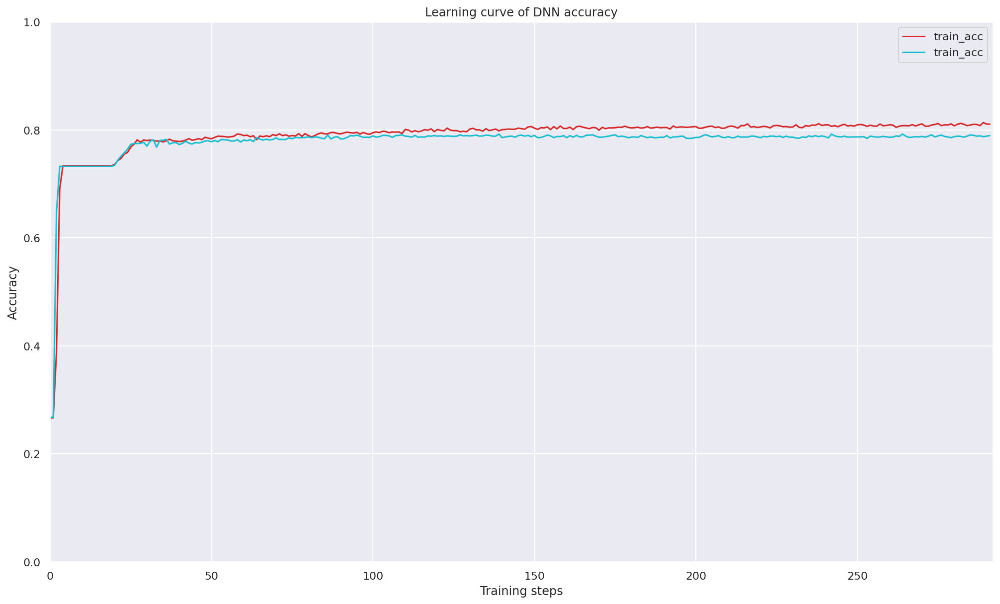

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN accuracy')

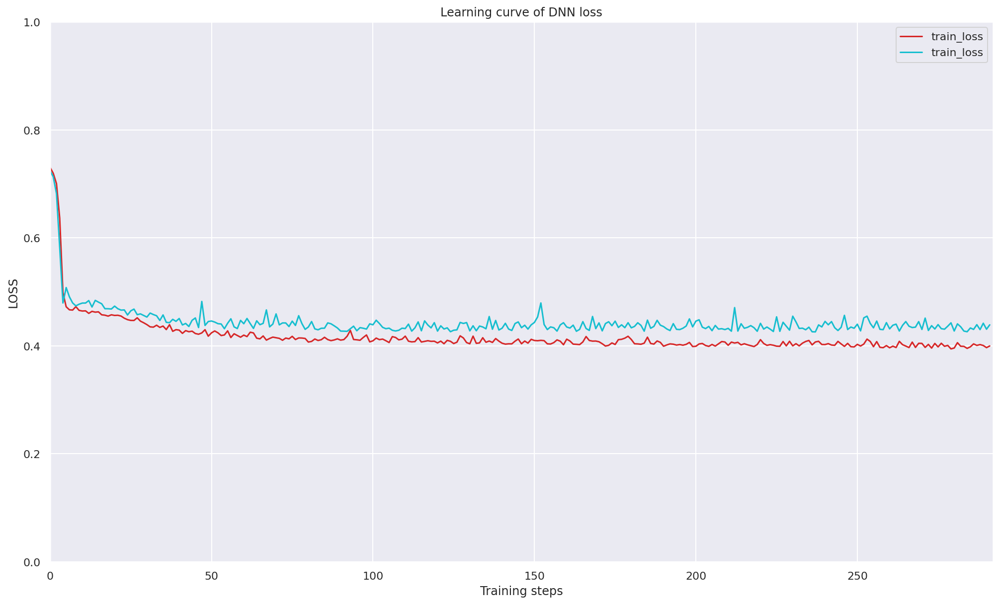

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN loss', type='loss', ylabel='LOSS')

Colab

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive



Now, let's load our best model saved before and test it on our test set.

In [ ]:
criterion = nn.CrossEntropyLoss() # Define our loss function. By MSE

# load our best model
best_model = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
ckpt = torch.load(config['save_path'], map_location='cpu')  # Load your best model and no need to load into GPU, since we won't train it. 
best_model.load_state_dict(ckpt)

# best_model = model


test_acc = 0.0
test_lengths = 0
pred = np.array([], dtype=np.int32)

best_model.eval()
with torch.no_grad():
    for i, batch in enumerate(tqdm(test_loader)):
        features, labels = batch
        features = features.to(device)

        outputs = best_model(features)

        _, test_pred = torch.max(outputs, 1) # get the index of the class with the highest probability
        pred = np.concatenate((pred, test_pred.cpu().numpy()), axis=0)

100%|██████████| 40/40 [00:00<00:00, 1134.98it/s]


In [ ]:
# save our prediction into csv file

with open('prediction.csv', 'w') as f:
    f.write('Id,Class\n')
    for i, y in enumerate(pred):
        f.write('{},{}\n'.format(i, y))

In [ ]:
# save our test dataset's label into csv file

with open('target.csv', 'w') as f:
    f.write('Id,Class\n')
    for i, y in enumerate(test_loader.dataset.y.numpy()):
        f.write('{},{}\n'.format(i, y))

In [ ]:
from sklearn.metrics import classification_report

target_names = ['Yes', 'No']

print("Classification report of the first classifier:\n\n",
      classification_report(test_loader.dataset.y.numpy(), pred, target_names=target_names))

Classification report of the first classifier:

               precision    recall  f1-score   support

         Yes       0.82      0.90      0.86      1554
          No       0.61      0.46      0.53       556

    accuracy                           0.78      2110
   macro avg       0.72      0.68      0.69      2110
weighted avg       0.77      0.78      0.77      2110



### 3.1.3 How do you make sure not to overfit?

In neural network, this problem is very easy to solve. We can just use early stopping to prevent overfit.
> In machine learning, early stopping is a form of regularization used to avoid overfitting when training a learner with an iterative method, such as gradient descent. Such methods update the learner so as to make it better fit the training data with each iteration. Up to a point, this improves the learner's performance on data outside of the training set. Past that point, however, improving the learner's fit to the training data comes at the expense of increased generalization error. Early stopping rules provide guidance as to how many iterations can be run before the learner begins to over-fit. Early stopping rules have been employed in many different machine learning methods, with varying amounts of theoretical foundation. [wikipedia](https://en.wikipedia.org/wiki/Early_stopping)

The following is the part of code in my training loop.
First, we saved our best validation scores and save the model.
When our validation model's best accuracy less than our saved best valid accuracy, we add one on our count. If we get a new best model, we reset our count to 0.
And we set a threshold of how many steps that we will tolerate our model not improving. If the count larget than the threshold. We shut down the training process.

In the meatime, if the model is really overfitting. Our model saved in file was the very beginning model before 200 steps of early stopping.

Hence, when we retrived the model from our file, it is the model that is not overfitted.


***The following codes are not runnable!***

In [ ]:
  # if the model improves, save a checkpoint at this epoch
  if val_acc > best_acc:
      best_acc = val_acc
      early_stop_count = 0 # reset early stopping counter

      torch.save(model.state_dict(), config['save_path'])
      print('##################################################saving model with acc {:.3f}##############################################################'.format(best_acc/len(valid_dataset)))

  if val_acc < best_acc:
      early_stop_count += 1 # add one to early stopping counter

  if early_stop_count >= config['early_stop']: # apply early stopping and quit training
      print('\nModel is not improving, so we halt the training session.')
      return 0

### 3.1.4 Visualize the learning process and/or the knowledge acquired by your model. Explain why you think this is the right visualization.

#### 3.1.4.1 Learning curve
> A learning curve is a graphical representation of the relationship between how proficient people are at a task and the amount of experience they have. Proficiency (measured on the vertical axis) usually increases with increased experience (the horizontal axis), that is to say, the more someone, groups, companies or industries perform a task, the better their performance at the task.[Wikipedia](https://en.wikipedia.org/wiki/Learning_curve)

Using learning curve for DNN is good. Since our model is heavily depended on the epoch iteration times. We can find out from the LR curve that whether our model is overfitting/underfitting or whether our model could still imporve by more training epoches.

##### Tensorborad plotting

Screenshot 1: Whole picture of this time training's plot.

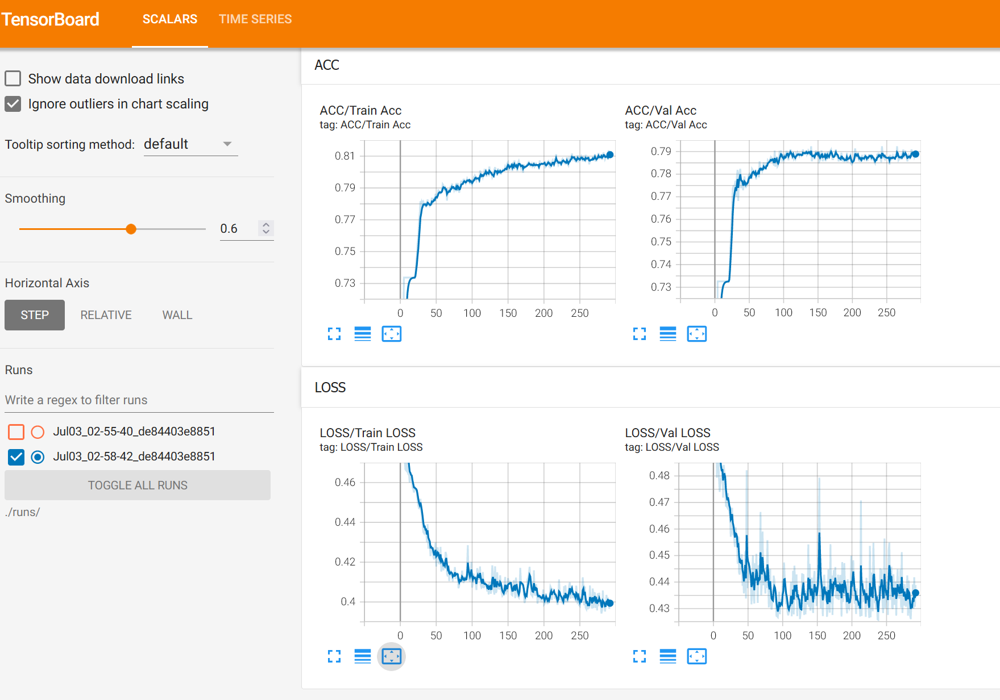

##### matplotlib plotting

In [ ]:
# save our loss_record_plot into jablib file first
import joblib
joblib.dump(loss_record_plot, 'loss_record_plot.pkl')

['loss_record_plot.pkl']

We use the function we defined before to draw the Learning curve

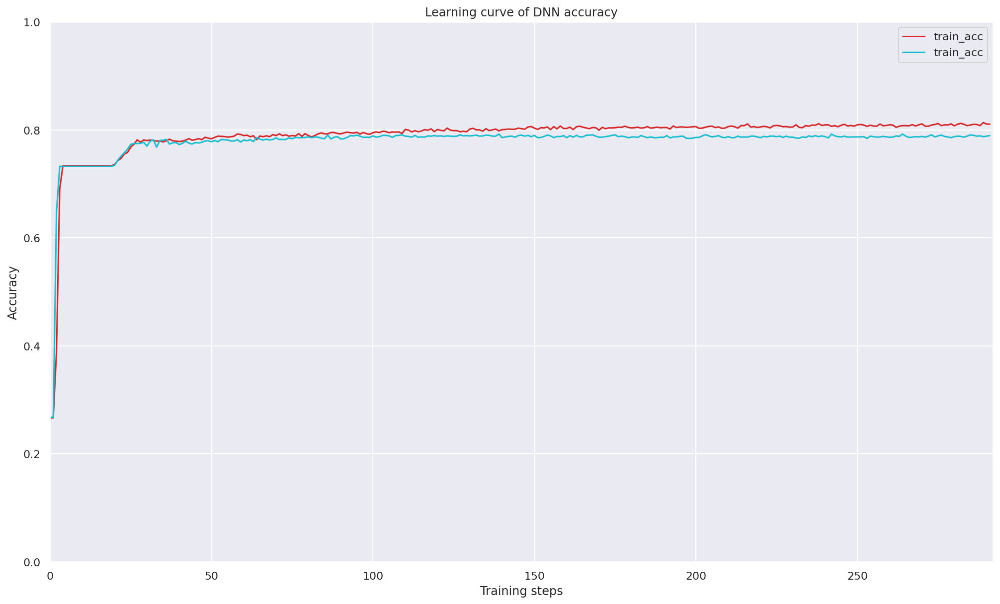

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN accuracy')

Now, we plot the loss graph.

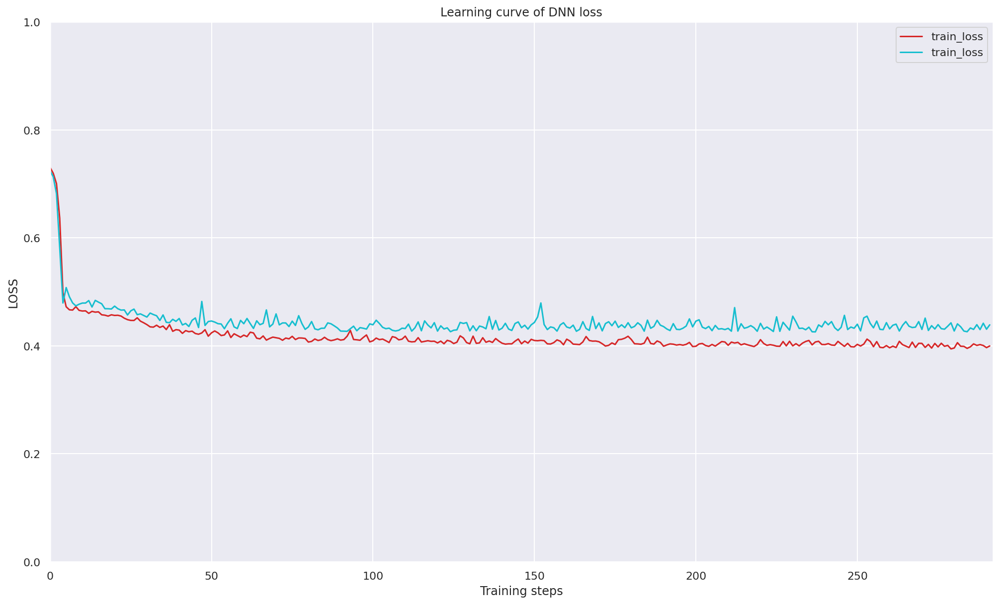

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN loss', type='loss', ylabel='LOSS')

#### 3.1.4.2. Ground truth value vs Prediction confusion matrix

We use confusion matrix to do this part.

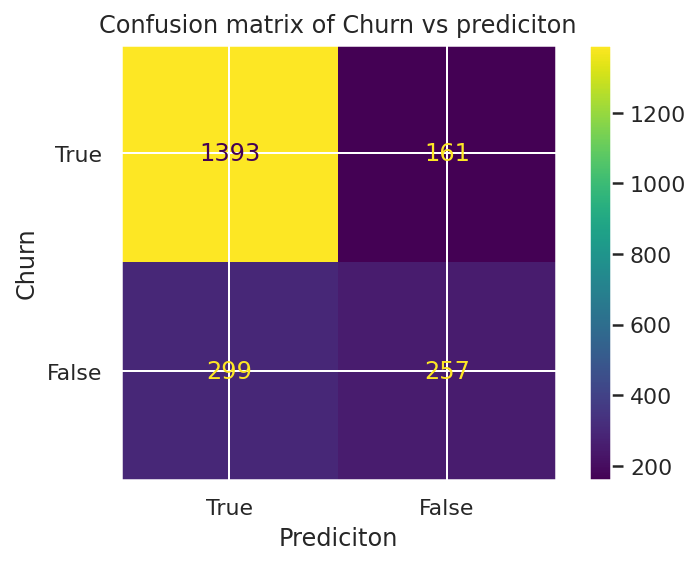

In [ ]:
draw_confusion_matrix_testing(test_loader.dataset.y.numpy(), pred)

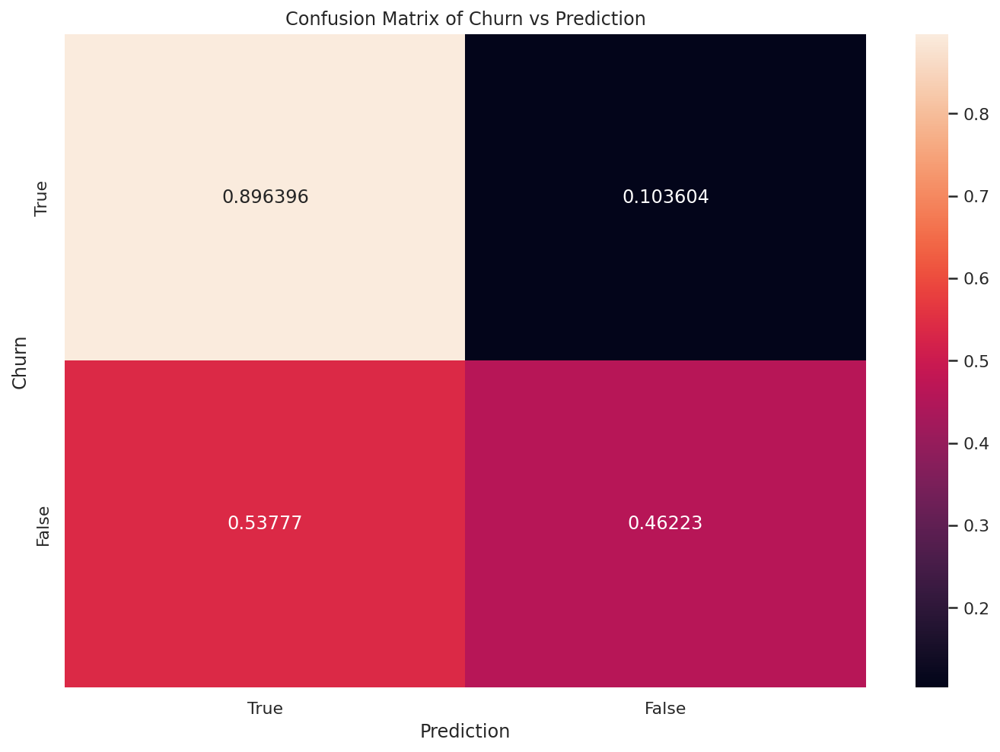

In [ ]:
draw_normalized_confusion_matrix_testing(test_loader.dataset.y.numpy(), pred)

### 3.1.5. Analyze the results

#### 3.1.5.1. First let's analyze the ACCURACY and LOSS of learning curve.

And redraw the ACCURACY and LOSS graph.

##### 1. Learning Accuracy Graph

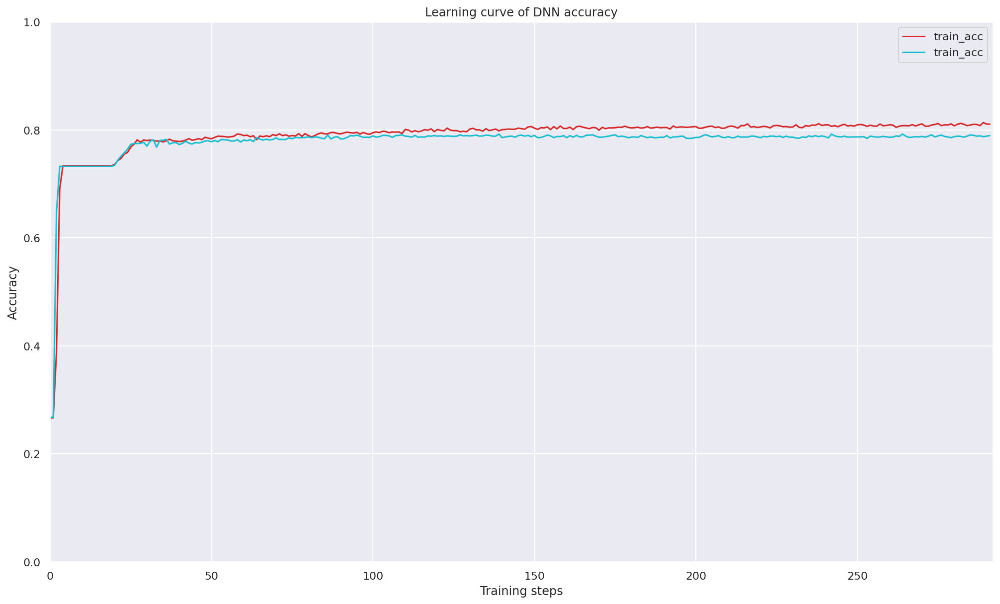

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN accuracy')

We can see that our dataset is really easy and quick to reach its best accuracy, but really bad on improving it. We get nearly 0.78 train and validation accuracy with 40 epoaches. And our early stopping function start to cancel the training at 300 epoches. 

Our DNN is a quick learner, it gets 0.3 accuracy at the begining, but gets approximately 0.75 after a few epoches.

And it reaches a local minimum at epoches 30, and get out of it at No.40. 
After that, it remains the same accuracy around 0.78.


We will take a look at the Accuracy graph later when we don't apply early stopping.

##### 2. Learning Loss graph

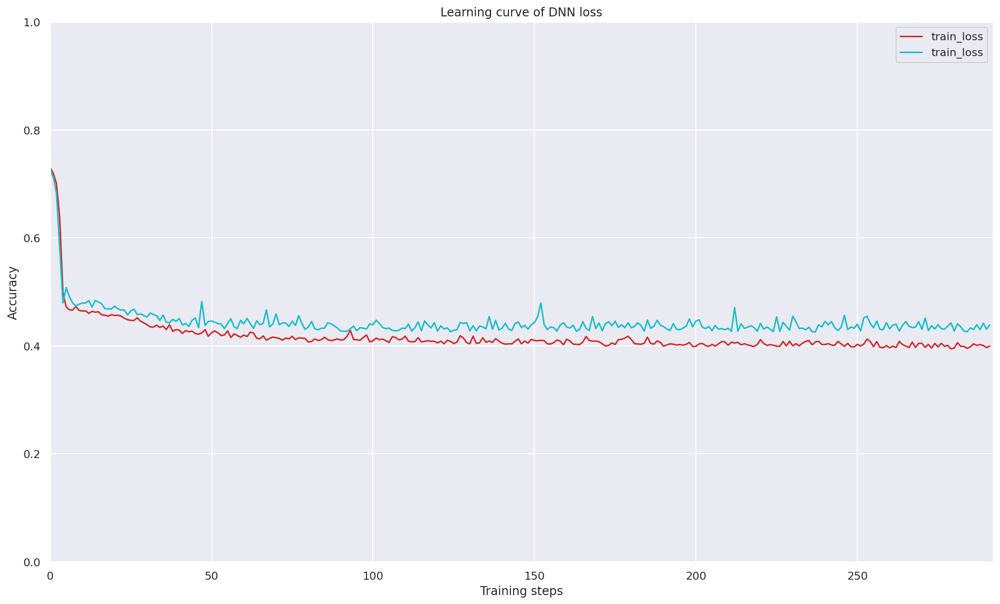

In [ ]:
plot_learning_curve(loss_record_plot, 'DNN loss', type='loss')

We can see that our loss is descenting very quick as well. And because of our fine choosed learning rate, the vibration is not very bad during the whole training process.

And we can see before early stopping steps in, the loss of both training and validation are not imporving much in our DNN model.


Base on those two graphs, we can say that 0.78 accuracy and 0.4 loss is the bset we can get from our DNN model.

##### 3. Confusion matrix

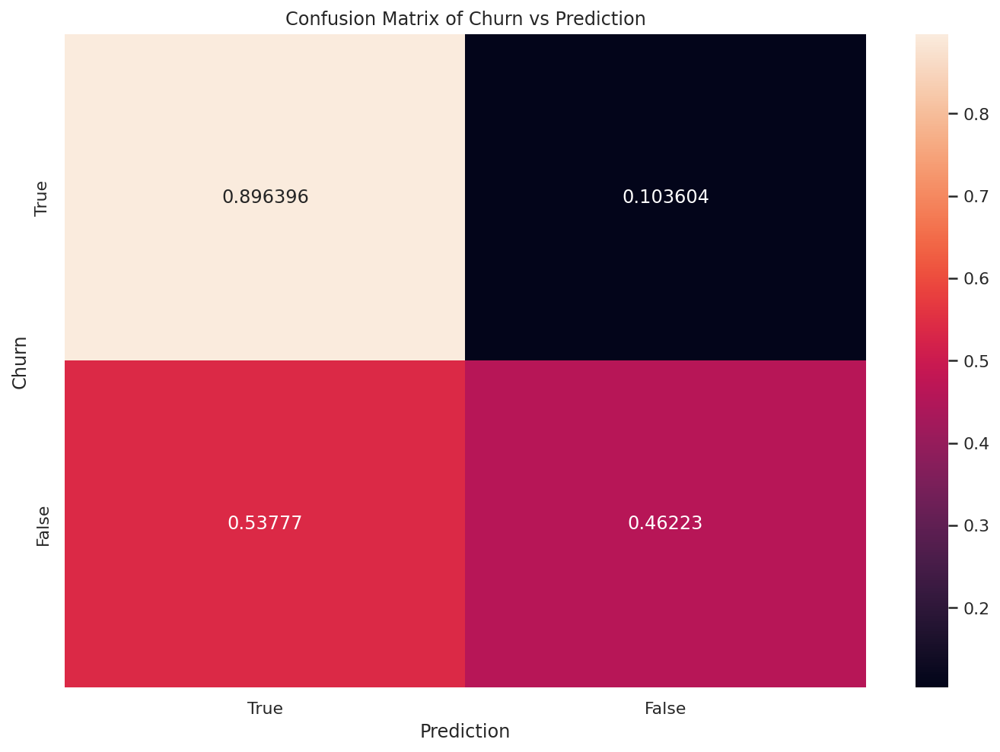

In [ ]:
draw_normalized_confusion_matrix_testing(test_loader.dataset.y.numpy(), pred)

Since our bussiness problem is finding whether a customer will cancel his plan in the future, aka, the Churn value is Yes in our labels. 

Therefore, we would like to say a high accuracy on True positive values' prediction. That is, the rate of TRUE - TRUE in our confusion matrix.

Gladly, we say our True positive prediction with label has  0.896 round to 0.9 percent accuracy. That is a pretty good news. 

We will have 90% accuracy on finding a customer will indeed cancel his plan. 


From above the 3 kinds of visualization, we first confirmed that our model doesn't have a overfitting probelm. And our accuracy on our bussiness target is quite well. And the training steps to get there is quite low.


That makes our DNN a very competitive model.

#### ***3.1.5.2 Before we call it a day. Let's what will happen in 2000 epoaches without early stopping.***

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 128,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 2000,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}

model_no_ES = My_Model(input_dim = train_loader.dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
# this is the result saver for our plot function
loss_record_plot_no_ES = {'train_acc': [], 'valid_acc': [], 'train_loss':[], 'valid_loss':[]}      # for recording training loss

loss_record_plot_no_ES = trainer(train_loader, valid_loader, train_dataset, valid_dataset, model, config, device);

100%|██████████| 40/40 [00:00<00:00, 320.02it/s]


[001/2000] Train Acc: 0.810167 Loss: 0.396989 | Val Acc: 0.787577 loss: 0.435869
##################################################saving model with acc 0.788##############################################################


100%|██████████| 40/40 [00:00<00:00, 333.72it/s]


[002/2000] Train Acc: 0.810167 Loss: 0.402623 | Val Acc: 0.788051 loss: 0.429415
##################################################saving model with acc 0.788##############################################################


100%|██████████| 40/40 [00:00<00:00, 228.95it/s]


[003/2000] Train Acc: 0.811589 Loss: 0.404445 | Val Acc: 0.790896 loss: 0.432715
##################################################saving model with acc 0.791##############################################################


100%|██████████| 40/40 [00:00<00:00, 294.25it/s]


[004/2000] Train Acc: 0.810167 Loss: 0.399953 | Val Acc: 0.789948 loss: 0.432021


100%|██████████| 40/40 [00:00<00:00, 455.80it/s]


[005/2000] Train Acc: 0.810878 Loss: 0.396100 | Val Acc: 0.788051 loss: 0.428678


100%|██████████| 40/40 [00:00<00:00, 550.95it/s]


[006/2000] Train Acc: 0.810523 Loss: 0.396389 | Val Acc: 0.789948 loss: 0.433309


100%|██████████| 40/40 [00:00<00:00, 656.03it/s]


[007/2000] Train Acc: 0.809456 Loss: 0.393949 | Val Acc: 0.790422 loss: 0.464007


100%|██████████| 40/40 [00:00<00:00, 622.15it/s]


[008/2000] Train Acc: 0.809456 Loss: 0.401760 | Val Acc: 0.789948 loss: 0.433280


100%|██████████| 40/40 [00:00<00:00, 577.33it/s]


[009/2000] Train Acc: 0.810167 Loss: 0.398284 | Val Acc: 0.789000 loss: 0.454977


100%|██████████| 40/40 [00:00<00:00, 604.39it/s]


[010/2000] Train Acc: 0.810167 Loss: 0.401881 | Val Acc: 0.789000 loss: 0.436137


100%|██████████| 40/40 [00:00<00:00, 594.19it/s]


[011/2000] Train Acc: 0.813367 Loss: 0.396365 | Val Acc: 0.789948 loss: 0.440809


100%|██████████| 40/40 [00:00<00:00, 619.33it/s]


[012/2000] Train Acc: 0.810523 Loss: 0.397443 | Val Acc: 0.789000 loss: 0.427030


100%|██████████| 40/40 [00:00<00:00, 623.40it/s]


[013/2000] Train Acc: 0.809812 Loss: 0.399718 | Val Acc: 0.789000 loss: 0.434307


100%|██████████| 40/40 [00:00<00:00, 607.92it/s]


[014/2000] Train Acc: 0.811589 Loss: 0.394264 | Val Acc: 0.789948 loss: 0.433523


100%|██████████| 40/40 [00:00<00:00, 600.16it/s]


[015/2000] Train Acc: 0.808745 Loss: 0.394435 | Val Acc: 0.789948 loss: 0.431599


100%|██████████| 40/40 [00:00<00:00, 534.34it/s]


[016/2000] Train Acc: 0.811589 Loss: 0.401368 | Val Acc: 0.791844 loss: 0.441793
##################################################saving model with acc 0.792##############################################################


100%|██████████| 40/40 [00:00<00:00, 464.35it/s]


[017/2000] Train Acc: 0.814788 Loss: 0.394186 | Val Acc: 0.793267 loss: 0.430619
##################################################saving model with acc 0.793##############################################################


100%|██████████| 40/40 [00:00<00:00, 669.55it/s]


[018/2000] Train Acc: 0.812300 Loss: 0.394064 | Val Acc: 0.789948 loss: 0.431020


100%|██████████| 40/40 [00:00<00:00, 520.79it/s]


[019/2000] Train Acc: 0.813722 Loss: 0.397747 | Val Acc: 0.789948 loss: 0.433322


100%|██████████| 40/40 [00:00<00:00, 673.86it/s]


[020/2000] Train Acc: 0.811945 Loss: 0.395530 | Val Acc: 0.789000 loss: 0.427142


100%|██████████| 40/40 [00:00<00:00, 624.09it/s]


[021/2000] Train Acc: 0.810167 Loss: 0.397037 | Val Acc: 0.789000 loss: 0.456961


100%|██████████| 40/40 [00:00<00:00, 662.99it/s]


[022/2000] Train Acc: 0.811945 Loss: 0.395774 | Val Acc: 0.790422 loss: 0.429410


100%|██████████| 40/40 [00:00<00:00, 561.73it/s]


[023/2000] Train Acc: 0.811945 Loss: 0.395323 | Val Acc: 0.789948 loss: 0.439367


100%|██████████| 40/40 [00:00<00:00, 1143.37it/s]


[024/2000] Train Acc: 0.810523 Loss: 0.405876 | Val Acc: 0.789948 loss: 0.428972


100%|██████████| 40/40 [00:00<00:00, 1097.97it/s]


[025/2000] Train Acc: 0.812656 Loss: 0.401123 | Val Acc: 0.790896 loss: 0.430035


100%|██████████| 40/40 [00:00<00:00, 531.91it/s]


[026/2000] Train Acc: 0.812300 Loss: 0.393963 | Val Acc: 0.791370 loss: 0.431553


100%|██████████| 40/40 [00:00<00:00, 600.80it/s]


[027/2000] Train Acc: 0.815144 Loss: 0.399055 | Val Acc: 0.791370 loss: 0.429300


100%|██████████| 40/40 [00:00<00:00, 224.10it/s]


[028/2000] Train Acc: 0.814077 Loss: 0.396456 | Val Acc: 0.785206 loss: 0.435678


100%|██████████| 40/40 [00:00<00:00, 445.98it/s]


[029/2000] Train Acc: 0.811234 Loss: 0.397015 | Val Acc: 0.788525 loss: 0.433998


100%|██████████| 40/40 [00:00<00:00, 1108.48it/s]


[030/2000] Train Acc: 0.816210 Loss: 0.400239 | Val Acc: 0.788051 loss: 0.463094


100%|██████████| 40/40 [00:00<00:00, 644.78it/s]


[031/2000] Train Acc: 0.812300 Loss: 0.392927 | Val Acc: 0.788051 loss: 0.444079


100%|██████████| 40/40 [00:00<00:00, 276.99it/s]


[032/2000] Train Acc: 0.814077 Loss: 0.398530 | Val Acc: 0.788051 loss: 0.430988


100%|██████████| 40/40 [00:00<00:00, 548.46it/s]


[033/2000] Train Acc: 0.814788 Loss: 0.394759 | Val Acc: 0.784258 loss: 0.440337


100%|██████████| 40/40 [00:00<00:00, 712.00it/s]


[034/2000] Train Acc: 0.814077 Loss: 0.401623 | Val Acc: 0.791370 loss: 0.445262


100%|██████████| 40/40 [00:00<00:00, 474.85it/s]


[035/2000] Train Acc: 0.814077 Loss: 0.394954 | Val Acc: 0.788525 loss: 0.430886


100%|██████████| 40/40 [00:00<00:00, 687.36it/s]


[036/2000] Train Acc: 0.813367 Loss: 0.396563 | Val Acc: 0.790422 loss: 0.431384


100%|██████████| 40/40 [00:00<00:00, 1129.09it/s]


[037/2000] Train Acc: 0.814788 Loss: 0.397313 | Val Acc: 0.789474 loss: 0.435517


100%|██████████| 40/40 [00:00<00:00, 1126.49it/s]


[038/2000] Train Acc: 0.815144 Loss: 0.396862 | Val Acc: 0.789000 loss: 0.452609


100%|██████████| 40/40 [00:00<00:00, 1091.58it/s]


[039/2000] Train Acc: 0.807323 Loss: 0.399318 | Val Acc: 0.789474 loss: 0.437195


100%|██████████| 40/40 [00:00<00:00, 491.16it/s]


[040/2000] Train Acc: 0.813722 Loss: 0.396096 | Val Acc: 0.789000 loss: 0.430541


100%|██████████| 40/40 [00:00<00:00, 579.67it/s]


[041/2000] Train Acc: 0.814077 Loss: 0.403846 | Val Acc: 0.792793 loss: 0.437661


100%|██████████| 40/40 [00:00<00:00, 570.89it/s]


[042/2000] Train Acc: 0.813722 Loss: 0.393889 | Val Acc: 0.789000 loss: 0.436791


100%|██████████| 40/40 [00:00<00:00, 1055.39it/s]


[043/2000] Train Acc: 0.813367 Loss: 0.395896 | Val Acc: 0.789000 loss: 0.439169


100%|██████████| 40/40 [00:00<00:00, 1058.07it/s]


[044/2000] Train Acc: 0.810878 Loss: 0.398601 | Val Acc: 0.789000 loss: 0.440431


100%|██████████| 40/40 [00:00<00:00, 1026.51it/s]


[045/2000] Train Acc: 0.816566 Loss: 0.392116 | Val Acc: 0.789000 loss: 0.432562


100%|██████████| 40/40 [00:00<00:00, 532.97it/s]


[046/2000] Train Acc: 0.813722 Loss: 0.392627 | Val Acc: 0.781887 loss: 0.440845


100%|██████████| 40/40 [00:00<00:00, 224.89it/s]


[047/2000] Train Acc: 0.809456 Loss: 0.402940 | Val Acc: 0.789474 loss: 0.429013


100%|██████████| 40/40 [00:00<00:00, 231.08it/s]


[048/2000] Train Acc: 0.814433 Loss: 0.394032 | Val Acc: 0.789948 loss: 0.432780


100%|██████████| 40/40 [00:00<00:00, 267.87it/s]


[049/2000] Train Acc: 0.814077 Loss: 0.394548 | Val Acc: 0.789948 loss: 0.439375


100%|██████████| 40/40 [00:00<00:00, 326.01it/s]


[050/2000] Train Acc: 0.818343 Loss: 0.392614 | Val Acc: 0.791370 loss: 0.432723


100%|██████████| 40/40 [00:00<00:00, 286.52it/s]


[051/2000] Train Acc: 0.813722 Loss: 0.397828 | Val Acc: 0.790896 loss: 0.439613


100%|██████████| 40/40 [00:00<00:00, 289.41it/s]


[052/2000] Train Acc: 0.814433 Loss: 0.392535 | Val Acc: 0.790422 loss: 0.427836


100%|██████████| 40/40 [00:00<00:00, 447.19it/s]


[053/2000] Train Acc: 0.814077 Loss: 0.396236 | Val Acc: 0.785680 loss: 0.431015


100%|██████████| 40/40 [00:00<00:00, 250.97it/s]


[054/2000] Train Acc: 0.813722 Loss: 0.401626 | Val Acc: 0.786629 loss: 0.449710


100%|██████████| 40/40 [00:00<00:00, 340.79it/s]


[055/2000] Train Acc: 0.814788 Loss: 0.394984 | Val Acc: 0.790896 loss: 0.430306


100%|██████████| 40/40 [00:00<00:00, 316.72it/s]


[056/2000] Train Acc: 0.811589 Loss: 0.393405 | Val Acc: 0.787577 loss: 0.445907


100%|██████████| 40/40 [00:00<00:00, 631.17it/s]


[057/2000] Train Acc: 0.814433 Loss: 0.392517 | Val Acc: 0.787577 loss: 0.449119


100%|██████████| 40/40 [00:00<00:00, 617.65it/s]


[058/2000] Train Acc: 0.808745 Loss: 0.398808 | Val Acc: 0.789948 loss: 0.433501


100%|██████████| 40/40 [00:00<00:00, 584.06it/s]


[059/2000] Train Acc: 0.811234 Loss: 0.406058 | Val Acc: 0.790422 loss: 0.431245


100%|██████████| 40/40 [00:00<00:00, 568.96it/s]


[060/2000] Train Acc: 0.811945 Loss: 0.393750 | Val Acc: 0.786629 loss: 0.430654


100%|██████████| 40/40 [00:00<00:00, 534.19it/s]


[061/2000] Train Acc: 0.814788 Loss: 0.392125 | Val Acc: 0.789474 loss: 0.431302


100%|██████████| 40/40 [00:00<00:00, 591.88it/s]


[062/2000] Train Acc: 0.814433 Loss: 0.390630 | Val Acc: 0.787577 loss: 0.434554


100%|██████████| 40/40 [00:00<00:00, 610.84it/s]


[063/2000] Train Acc: 0.815144 Loss: 0.394510 | Val Acc: 0.788051 loss: 0.430266


100%|██████████| 40/40 [00:00<00:00, 440.80it/s]


[064/2000] Train Acc: 0.816566 Loss: 0.396460 | Val Acc: 0.790896 loss: 0.428893


100%|██████████| 40/40 [00:00<00:00, 620.14it/s]


[065/2000] Train Acc: 0.813367 Loss: 0.397581 | Val Acc: 0.787577 loss: 0.428175


100%|██████████| 40/40 [00:00<00:00, 500.43it/s]


[066/2000] Train Acc: 0.816210 Loss: 0.396846 | Val Acc: 0.785680 loss: 0.451949


100%|██████████| 40/40 [00:00<00:00, 571.22it/s]


[067/2000] Train Acc: 0.814433 Loss: 0.400392 | Val Acc: 0.785206 loss: 0.438894


100%|██████████| 40/40 [00:00<00:00, 683.51it/s]


[068/2000] Train Acc: 0.815855 Loss: 0.393185 | Val Acc: 0.787103 loss: 0.436974


100%|██████████| 40/40 [00:00<00:00, 616.38it/s]


[069/2000] Train Acc: 0.812300 Loss: 0.398431 | Val Acc: 0.792319 loss: 0.429021


100%|██████████| 40/40 [00:00<00:00, 648.91it/s]


[070/2000] Train Acc: 0.815855 Loss: 0.392721 | Val Acc: 0.786629 loss: 0.439982


100%|██████████| 40/40 [00:00<00:00, 451.64it/s]


[071/2000] Train Acc: 0.818699 Loss: 0.405321 | Val Acc: 0.787577 loss: 0.453716


100%|██████████| 40/40 [00:00<00:00, 288.26it/s]


[072/2000] Train Acc: 0.811945 Loss: 0.395052 | Val Acc: 0.789948 loss: 0.441338


100%|██████████| 40/40 [00:00<00:00, 565.45it/s]


[073/2000] Train Acc: 0.815144 Loss: 0.391357 | Val Acc: 0.788525 loss: 0.428626


100%|██████████| 40/40 [00:00<00:00, 312.50it/s]


[074/2000] Train Acc: 0.816210 Loss: 0.394361 | Val Acc: 0.780939 loss: 0.450711


100%|██████████| 40/40 [00:00<00:00, 598.09it/s]


[075/2000] Train Acc: 0.816566 Loss: 0.393646 | Val Acc: 0.783784 loss: 0.430834


100%|██████████| 40/40 [00:00<00:00, 596.04it/s]


[076/2000] Train Acc: 0.815855 Loss: 0.392948 | Val Acc: 0.789474 loss: 0.431990


100%|██████████| 40/40 [00:00<00:00, 307.66it/s]


[077/2000] Train Acc: 0.815499 Loss: 0.392892 | Val Acc: 0.790422 loss: 0.439136


100%|██████████| 40/40 [00:00<00:00, 462.58it/s]


[078/2000] Train Acc: 0.815144 Loss: 0.401693 | Val Acc: 0.790896 loss: 0.438188


100%|██████████| 40/40 [00:00<00:00, 390.91it/s]


[079/2000] Train Acc: 0.814077 Loss: 0.399053 | Val Acc: 0.789474 loss: 0.434500


100%|██████████| 40/40 [00:00<00:00, 483.95it/s]


[080/2000] Train Acc: 0.812656 Loss: 0.399705 | Val Acc: 0.788051 loss: 0.428862


100%|██████████| 40/40 [00:00<00:00, 371.18it/s]


[081/2000] Train Acc: 0.814433 Loss: 0.397318 | Val Acc: 0.787103 loss: 0.436303


100%|██████████| 40/40 [00:00<00:00, 298.62it/s]


[082/2000] Train Acc: 0.814077 Loss: 0.398780 | Val Acc: 0.788525 loss: 0.440238


100%|██████████| 40/40 [00:00<00:00, 582.68it/s]


[083/2000] Train Acc: 0.819054 Loss: 0.393160 | Val Acc: 0.791844 loss: 0.431974


100%|██████████| 40/40 [00:00<00:00, 525.95it/s]


[084/2000] Train Acc: 0.813367 Loss: 0.397112 | Val Acc: 0.787103 loss: 0.429999


100%|██████████| 40/40 [00:00<00:00, 543.57it/s]


[085/2000] Train Acc: 0.815855 Loss: 0.393052 | Val Acc: 0.787103 loss: 0.432987


100%|██████████| 40/40 [00:00<00:00, 616.53it/s]


[086/2000] Train Acc: 0.816566 Loss: 0.390030 | Val Acc: 0.788525 loss: 0.438410


100%|██████████| 40/40 [00:00<00:00, 576.31it/s]


[087/2000] Train Acc: 0.815499 Loss: 0.396179 | Val Acc: 0.784732 loss: 0.449074


100%|██████████| 40/40 [00:00<00:00, 512.02it/s]


[088/2000] Train Acc: 0.815855 Loss: 0.390820 | Val Acc: 0.786629 loss: 0.428459


100%|██████████| 40/40 [00:00<00:00, 587.89it/s]


[089/2000] Train Acc: 0.815144 Loss: 0.397115 | Val Acc: 0.786155 loss: 0.443500


100%|██████████| 40/40 [00:00<00:00, 476.13it/s]


[090/2000] Train Acc: 0.812656 Loss: 0.395438 | Val Acc: 0.787103 loss: 0.431785


100%|██████████| 40/40 [00:00<00:00, 582.70it/s]


[091/2000] Train Acc: 0.814433 Loss: 0.394578 | Val Acc: 0.789000 loss: 0.433210


100%|██████████| 40/40 [00:00<00:00, 521.95it/s]


[092/2000] Train Acc: 0.815499 Loss: 0.405524 | Val Acc: 0.788051 loss: 0.437896


100%|██████████| 40/40 [00:00<00:00, 588.78it/s]


[093/2000] Train Acc: 0.820121 Loss: 0.393955 | Val Acc: 0.787577 loss: 0.433632


100%|██████████| 40/40 [00:00<00:00, 563.41it/s]


[094/2000] Train Acc: 0.816566 Loss: 0.396987 | Val Acc: 0.785206 loss: 0.431526


100%|██████████| 40/40 [00:00<00:00, 631.33it/s]


[095/2000] Train Acc: 0.815855 Loss: 0.389665 | Val Acc: 0.789000 loss: 0.434020


100%|██████████| 40/40 [00:00<00:00, 557.50it/s]


[096/2000] Train Acc: 0.816210 Loss: 0.395537 | Val Acc: 0.786629 loss: 0.433179


100%|██████████| 40/40 [00:00<00:00, 605.86it/s]


[097/2000] Train Acc: 0.817632 Loss: 0.411454 | Val Acc: 0.783784 loss: 0.431746


100%|██████████| 40/40 [00:00<00:00, 293.05it/s]


[098/2000] Train Acc: 0.815855 Loss: 0.397929 | Val Acc: 0.787103 loss: 0.439410


100%|██████████| 40/40 [00:00<00:00, 511.91it/s]


[099/2000] Train Acc: 0.816921 Loss: 0.397605 | Val Acc: 0.789000 loss: 0.437295


100%|██████████| 40/40 [00:00<00:00, 683.38it/s]


[100/2000] Train Acc: 0.817632 Loss: 0.402344 | Val Acc: 0.784258 loss: 0.438483


100%|██████████| 40/40 [00:00<00:00, 1006.20it/s]


[101/2000] Train Acc: 0.815144 Loss: 0.398808 | Val Acc: 0.779516 loss: 0.441123


100%|██████████| 40/40 [00:00<00:00, 512.60it/s]


[102/2000] Train Acc: 0.815499 Loss: 0.400284 | Val Acc: 0.784258 loss: 0.436248


100%|██████████| 40/40 [00:00<00:00, 512.82it/s]


[103/2000] Train Acc: 0.814788 Loss: 0.413782 | Val Acc: 0.787103 loss: 0.427323


100%|██████████| 40/40 [00:00<00:00, 595.85it/s]


[104/2000] Train Acc: 0.816566 Loss: 0.397742 | Val Acc: 0.790896 loss: 0.440845


100%|██████████| 40/40 [00:00<00:00, 581.05it/s]


[105/2000] Train Acc: 0.815499 Loss: 0.396539 | Val Acc: 0.785680 loss: 0.433810


100%|██████████| 40/40 [00:00<00:00, 593.18it/s]


[106/2000] Train Acc: 0.813367 Loss: 0.393169 | Val Acc: 0.788525 loss: 0.434600


100%|██████████| 40/40 [00:00<00:00, 548.94it/s]


[107/2000] Train Acc: 0.815855 Loss: 0.397896 | Val Acc: 0.785680 loss: 0.452060


100%|██████████| 40/40 [00:00<00:00, 523.35it/s]


[108/2000] Train Acc: 0.818343 Loss: 0.389286 | Val Acc: 0.784732 loss: 0.442644


100%|██████████| 40/40 [00:00<00:00, 560.84it/s]


[109/2000] Train Acc: 0.815855 Loss: 0.394959 | Val Acc: 0.785680 loss: 0.431650


100%|██████████| 40/40 [00:00<00:00, 556.61it/s]


[110/2000] Train Acc: 0.817277 Loss: 0.392618 | Val Acc: 0.785206 loss: 0.434808


100%|██████████| 40/40 [00:00<00:00, 589.91it/s]


[111/2000] Train Acc: 0.816566 Loss: 0.396078 | Val Acc: 0.787103 loss: 0.439239


100%|██████████| 40/40 [00:00<00:00, 405.89it/s]


[112/2000] Train Acc: 0.815499 Loss: 0.404515 | Val Acc: 0.788051 loss: 0.434807


100%|██████████| 40/40 [00:00<00:00, 610.29it/s]


[113/2000] Train Acc: 0.819054 Loss: 0.388870 | Val Acc: 0.791844 loss: 0.429464


100%|██████████| 40/40 [00:00<00:00, 509.98it/s]


[114/2000] Train Acc: 0.817277 Loss: 0.388171 | Val Acc: 0.785206 loss: 0.437317


100%|██████████| 40/40 [00:00<00:00, 638.67it/s]


[115/2000] Train Acc: 0.818343 Loss: 0.392841 | Val Acc: 0.786155 loss: 0.433455


100%|██████████| 40/40 [00:00<00:00, 560.34it/s]


[116/2000] Train Acc: 0.817277 Loss: 0.391984 | Val Acc: 0.791370 loss: 0.436126


100%|██████████| 40/40 [00:00<00:00, 603.48it/s]


[117/2000] Train Acc: 0.817277 Loss: 0.397585 | Val Acc: 0.793267 loss: 0.427770


100%|██████████| 40/40 [00:00<00:00, 561.04it/s]


[118/2000] Train Acc: 0.817632 Loss: 0.390655 | Val Acc: 0.783310 loss: 0.454657


100%|██████████| 40/40 [00:00<00:00, 579.77it/s]


[119/2000] Train Acc: 0.819410 Loss: 0.401080 | Val Acc: 0.785206 loss: 0.436849


100%|██████████| 40/40 [00:00<00:00, 510.97it/s]


[120/2000] Train Acc: 0.817632 Loss: 0.391517 | Val Acc: 0.785680 loss: 0.452268


100%|██████████| 40/40 [00:00<00:00, 592.11it/s]


[121/2000] Train Acc: 0.814788 Loss: 0.393512 | Val Acc: 0.788051 loss: 0.431965


100%|██████████| 40/40 [00:00<00:00, 591.35it/s]


[122/2000] Train Acc: 0.819410 Loss: 0.394826 | Val Acc: 0.791370 loss: 0.442981


100%|██████████| 40/40 [00:00<00:00, 586.55it/s]


[123/2000] Train Acc: 0.815499 Loss: 0.395122 | Val Acc: 0.786629 loss: 0.439179


100%|██████████| 40/40 [00:00<00:00, 581.87it/s]


[124/2000] Train Acc: 0.817988 Loss: 0.390895 | Val Acc: 0.788525 loss: 0.440287


100%|██████████| 40/40 [00:00<00:00, 609.51it/s]


[125/2000] Train Acc: 0.820832 Loss: 0.392067 | Val Acc: 0.782835 loss: 0.438771


100%|██████████| 40/40 [00:00<00:00, 610.04it/s]


[126/2000] Train Acc: 0.816921 Loss: 0.399731 | Val Acc: 0.787577 loss: 0.445046


100%|██████████| 40/40 [00:00<00:00, 567.43it/s]


[127/2000] Train Acc: 0.819410 Loss: 0.388925 | Val Acc: 0.786629 loss: 0.432845


100%|██████████| 40/40 [00:00<00:00, 611.06it/s]


[128/2000] Train Acc: 0.816210 Loss: 0.395725 | Val Acc: 0.785206 loss: 0.435395


100%|██████████| 40/40 [00:00<00:00, 448.94it/s]


[129/2000] Train Acc: 0.817277 Loss: 0.391324 | Val Acc: 0.790896 loss: 0.436240


100%|██████████| 40/40 [00:00<00:00, 622.58it/s]


[130/2000] Train Acc: 0.820832 Loss: 0.401026 | Val Acc: 0.790896 loss: 0.441600


100%|██████████| 40/40 [00:00<00:00, 575.54it/s]


[131/2000] Train Acc: 0.817988 Loss: 0.387429 | Val Acc: 0.787103 loss: 0.438612


100%|██████████| 40/40 [00:00<00:00, 631.33it/s]


[132/2000] Train Acc: 0.817277 Loss: 0.394444 | Val Acc: 0.786155 loss: 0.428621


100%|██████████| 40/40 [00:00<00:00, 630.19it/s]


[133/2000] Train Acc: 0.818699 Loss: 0.389917 | Val Acc: 0.786155 loss: 0.448512


100%|██████████| 40/40 [00:00<00:00, 582.45it/s]


[134/2000] Train Acc: 0.816921 Loss: 0.391101 | Val Acc: 0.785680 loss: 0.429795


100%|██████████| 40/40 [00:00<00:00, 879.59it/s]


[135/2000] Train Acc: 0.815855 Loss: 0.394083 | Val Acc: 0.785680 loss: 0.440848


100%|██████████| 40/40 [00:00<00:00, 834.83it/s]


[136/2000] Train Acc: 0.817988 Loss: 0.389033 | Val Acc: 0.790896 loss: 0.437724


100%|██████████| 40/40 [00:00<00:00, 769.05it/s]


[137/2000] Train Acc: 0.817632 Loss: 0.395204 | Val Acc: 0.788051 loss: 0.441780


100%|██████████| 40/40 [00:00<00:00, 1083.79it/s]


[138/2000] Train Acc: 0.818343 Loss: 0.397129 | Val Acc: 0.784732 loss: 0.442380


100%|██████████| 40/40 [00:00<00:00, 883.76it/s]


[139/2000] Train Acc: 0.817632 Loss: 0.395287 | Val Acc: 0.787103 loss: 0.434891


100%|██████████| 40/40 [00:00<00:00, 1030.30it/s]


[140/2000] Train Acc: 0.818699 Loss: 0.390136 | Val Acc: 0.791844 loss: 0.436665


100%|██████████| 40/40 [00:00<00:00, 800.12it/s]


[141/2000] Train Acc: 0.816566 Loss: 0.394696 | Val Acc: 0.784732 loss: 0.437088


100%|██████████| 40/40 [00:00<00:00, 845.37it/s]


[142/2000] Train Acc: 0.818343 Loss: 0.392123 | Val Acc: 0.785680 loss: 0.446629


100%|██████████| 40/40 [00:00<00:00, 1046.04it/s]


[143/2000] Train Acc: 0.817632 Loss: 0.394180 | Val Acc: 0.786155 loss: 0.444466


100%|██████████| 40/40 [00:00<00:00, 900.02it/s]


[144/2000] Train Acc: 0.815499 Loss: 0.393906 | Val Acc: 0.790896 loss: 0.442489


100%|██████████| 40/40 [00:00<00:00, 1023.71it/s]


[145/2000] Train Acc: 0.815144 Loss: 0.393164 | Val Acc: 0.784258 loss: 0.437288


100%|██████████| 40/40 [00:00<00:00, 923.58it/s]


[146/2000] Train Acc: 0.818699 Loss: 0.389549 | Val Acc: 0.783784 loss: 0.436548


100%|██████████| 40/40 [00:00<00:00, 1077.95it/s]


[147/2000] Train Acc: 0.817632 Loss: 0.398399 | Val Acc: 0.787103 loss: 0.429895


100%|██████████| 40/40 [00:00<00:00, 889.14it/s]


[148/2000] Train Acc: 0.815855 Loss: 0.397130 | Val Acc: 0.782835 loss: 0.434046


100%|██████████| 40/40 [00:00<00:00, 885.11it/s]


[149/2000] Train Acc: 0.817277 Loss: 0.390405 | Val Acc: 0.782361 loss: 0.450892


100%|██████████| 40/40 [00:00<00:00, 1030.29it/s]


[150/2000] Train Acc: 0.819765 Loss: 0.386141 | Val Acc: 0.786629 loss: 0.437330


100%|██████████| 40/40 [00:00<00:00, 1088.56it/s]


[151/2000] Train Acc: 0.819054 Loss: 0.392596 | Val Acc: 0.790896 loss: 0.433663


100%|██████████| 40/40 [00:00<00:00, 871.57it/s]


[152/2000] Train Acc: 0.817988 Loss: 0.390007 | Val Acc: 0.789948 loss: 0.434696


100%|██████████| 40/40 [00:00<00:00, 936.01it/s]


[153/2000] Train Acc: 0.820476 Loss: 0.391045 | Val Acc: 0.792793 loss: 0.436897


100%|██████████| 40/40 [00:00<00:00, 970.05it/s]


[154/2000] Train Acc: 0.818699 Loss: 0.403176 | Val Acc: 0.785206 loss: 0.437851


100%|██████████| 40/40 [00:00<00:00, 922.66it/s]


[155/2000] Train Acc: 0.817632 Loss: 0.388284 | Val Acc: 0.786629 loss: 0.443355


100%|██████████| 40/40 [00:00<00:00, 1003.58it/s]


[156/2000] Train Acc: 0.818699 Loss: 0.391218 | Val Acc: 0.788051 loss: 0.448714


100%|██████████| 40/40 [00:00<00:00, 1100.67it/s]


[157/2000] Train Acc: 0.820476 Loss: 0.406493 | Val Acc: 0.785206 loss: 0.445674


100%|██████████| 40/40 [00:00<00:00, 992.63it/s]


[158/2000] Train Acc: 0.815144 Loss: 0.396273 | Val Acc: 0.784732 loss: 0.444982


100%|██████████| 40/40 [00:00<00:00, 797.45it/s]


[159/2000] Train Acc: 0.820476 Loss: 0.390297 | Val Acc: 0.788525 loss: 0.443446


100%|██████████| 40/40 [00:00<00:00, 652.86it/s]


[160/2000] Train Acc: 0.817988 Loss: 0.393152 | Val Acc: 0.789474 loss: 0.438076


100%|██████████| 40/40 [00:00<00:00, 891.59it/s]


[161/2000] Train Acc: 0.816210 Loss: 0.394711 | Val Acc: 0.790422 loss: 0.439502


100%|██████████| 40/40 [00:00<00:00, 759.03it/s]


[162/2000] Train Acc: 0.816210 Loss: 0.390167 | Val Acc: 0.785680 loss: 0.440235


100%|██████████| 40/40 [00:00<00:00, 898.46it/s]


[163/2000] Train Acc: 0.819410 Loss: 0.395414 | Val Acc: 0.791370 loss: 0.430605


100%|██████████| 40/40 [00:00<00:00, 939.74it/s]


[164/2000] Train Acc: 0.819054 Loss: 0.392274 | Val Acc: 0.788525 loss: 0.432689


100%|██████████| 40/40 [00:00<00:00, 971.33it/s]


[165/2000] Train Acc: 0.819410 Loss: 0.388562 | Val Acc: 0.786629 loss: 0.442841


100%|██████████| 40/40 [00:00<00:00, 1003.04it/s]


[166/2000] Train Acc: 0.820476 Loss: 0.390332 | Val Acc: 0.785680 loss: 0.435713


100%|██████████| 40/40 [00:00<00:00, 818.36it/s]


[167/2000] Train Acc: 0.819765 Loss: 0.387795 | Val Acc: 0.784732 loss: 0.432255


100%|██████████| 40/40 [00:00<00:00, 909.98it/s]


[168/2000] Train Acc: 0.822254 Loss: 0.390349 | Val Acc: 0.783310 loss: 0.447188


100%|██████████| 40/40 [00:00<00:00, 787.52it/s]


[169/2000] Train Acc: 0.819765 Loss: 0.395520 | Val Acc: 0.785680 loss: 0.446627


100%|██████████| 40/40 [00:00<00:00, 882.30it/s]


[170/2000] Train Acc: 0.820832 Loss: 0.393750 | Val Acc: 0.784732 loss: 0.432549


100%|██████████| 40/40 [00:00<00:00, 724.16it/s]


[171/2000] Train Acc: 0.813011 Loss: 0.395181 | Val Acc: 0.785206 loss: 0.441746


100%|██████████| 40/40 [00:00<00:00, 1026.58it/s]


[172/2000] Train Acc: 0.817277 Loss: 0.392056 | Val Acc: 0.786155 loss: 0.432200


100%|██████████| 40/40 [00:00<00:00, 740.71it/s]


[173/2000] Train Acc: 0.819410 Loss: 0.391571 | Val Acc: 0.784732 loss: 0.439683


100%|██████████| 40/40 [00:00<00:00, 716.90it/s]


[174/2000] Train Acc: 0.816566 Loss: 0.392161 | Val Acc: 0.789948 loss: 0.435202


100%|██████████| 40/40 [00:00<00:00, 746.89it/s]


[175/2000] Train Acc: 0.819054 Loss: 0.399915 | Val Acc: 0.784258 loss: 0.436401


100%|██████████| 40/40 [00:00<00:00, 911.38it/s]


[176/2000] Train Acc: 0.818343 Loss: 0.395051 | Val Acc: 0.784732 loss: 0.455011


100%|██████████| 40/40 [00:00<00:00, 926.30it/s]


[177/2000] Train Acc: 0.815855 Loss: 0.389069 | Val Acc: 0.785206 loss: 0.442546


100%|██████████| 40/40 [00:00<00:00, 855.08it/s]


[178/2000] Train Acc: 0.821187 Loss: 0.387735 | Val Acc: 0.789948 loss: 0.435940


100%|██████████| 40/40 [00:00<00:00, 843.86it/s]


[179/2000] Train Acc: 0.820476 Loss: 0.391107 | Val Acc: 0.784732 loss: 0.454454


100%|██████████| 40/40 [00:00<00:00, 912.21it/s]


[180/2000] Train Acc: 0.817988 Loss: 0.389559 | Val Acc: 0.783310 loss: 0.434000


100%|██████████| 40/40 [00:00<00:00, 924.32it/s]


[181/2000] Train Acc: 0.821543 Loss: 0.393566 | Val Acc: 0.789000 loss: 0.454540


100%|██████████| 40/40 [00:00<00:00, 681.15it/s]


[182/2000] Train Acc: 0.819410 Loss: 0.389725 | Val Acc: 0.782835 loss: 0.451415


100%|██████████| 40/40 [00:00<00:00, 968.18it/s]


[183/2000] Train Acc: 0.820121 Loss: 0.389867 | Val Acc: 0.786629 loss: 0.442758


100%|██████████| 40/40 [00:00<00:00, 892.08it/s]


[184/2000] Train Acc: 0.821187 Loss: 0.387973 | Val Acc: 0.789948 loss: 0.430874


100%|██████████| 40/40 [00:00<00:00, 774.01it/s]


[185/2000] Train Acc: 0.818699 Loss: 0.384045 | Val Acc: 0.787103 loss: 0.432351


100%|██████████| 40/40 [00:00<00:00, 829.01it/s]


[186/2000] Train Acc: 0.822965 Loss: 0.387207 | Val Acc: 0.783310 loss: 0.444987


100%|██████████| 40/40 [00:00<00:00, 904.73it/s]


[187/2000] Train Acc: 0.822609 Loss: 0.390590 | Val Acc: 0.789000 loss: 0.439003


100%|██████████| 40/40 [00:00<00:00, 895.69it/s]


[188/2000] Train Acc: 0.820476 Loss: 0.396493 | Val Acc: 0.785680 loss: 0.445056


100%|██████████| 40/40 [00:00<00:00, 740.32it/s]


[189/2000] Train Acc: 0.819765 Loss: 0.390009 | Val Acc: 0.788525 loss: 0.486285


100%|██████████| 40/40 [00:00<00:00, 902.90it/s]


[190/2000] Train Acc: 0.817632 Loss: 0.390354 | Val Acc: 0.788051 loss: 0.434139


100%|██████████| 40/40 [00:00<00:00, 804.71it/s]


[191/2000] Train Acc: 0.818343 Loss: 0.388217 | Val Acc: 0.782835 loss: 0.433007


100%|██████████| 40/40 [00:00<00:00, 1165.33it/s]


[192/2000] Train Acc: 0.819054 Loss: 0.389450 | Val Acc: 0.778094 loss: 0.440194


100%|██████████| 40/40 [00:00<00:00, 864.32it/s]


[193/2000] Train Acc: 0.822254 Loss: 0.385188 | Val Acc: 0.788051 loss: 0.443483


100%|██████████| 40/40 [00:00<00:00, 923.65it/s]


[194/2000] Train Acc: 0.821543 Loss: 0.385504 | Val Acc: 0.786155 loss: 0.434099


100%|██████████| 40/40 [00:00<00:00, 811.25it/s]


[195/2000] Train Acc: 0.818343 Loss: 0.388555 | Val Acc: 0.789948 loss: 0.430471


100%|██████████| 40/40 [00:00<00:00, 978.82it/s]


[196/2000] Train Acc: 0.813722 Loss: 0.389733 | Val Acc: 0.784258 loss: 0.444830


100%|██████████| 40/40 [00:00<00:00, 974.18it/s]


[197/2000] Train Acc: 0.821543 Loss: 0.392698 | Val Acc: 0.789000 loss: 0.432092


100%|██████████| 40/40 [00:00<00:00, 1008.36it/s]


[198/2000] Train Acc: 0.819410 Loss: 0.386943 | Val Acc: 0.785206 loss: 0.439882


100%|██████████| 40/40 [00:00<00:00, 855.72it/s]


[199/2000] Train Acc: 0.823676 Loss: 0.385567 | Val Acc: 0.785206 loss: 0.431915


100%|██████████| 40/40 [00:00<00:00, 824.24it/s]


[200/2000] Train Acc: 0.820832 Loss: 0.385606 | Val Acc: 0.787103 loss: 0.450895


100%|██████████| 40/40 [00:00<00:00, 1002.05it/s]


[201/2000] Train Acc: 0.820832 Loss: 0.387170 | Val Acc: 0.790896 loss: 0.435943


100%|██████████| 40/40 [00:00<00:00, 953.27it/s]


[202/2000] Train Acc: 0.817988 Loss: 0.386201 | Val Acc: 0.784258 loss: 0.432523


100%|██████████| 40/40 [00:00<00:00, 995.82it/s]


[203/2000] Train Acc: 0.817277 Loss: 0.386797 | Val Acc: 0.785206 loss: 0.434353


100%|██████████| 40/40 [00:00<00:00, 768.00it/s]


[204/2000] Train Acc: 0.820476 Loss: 0.392745 | Val Acc: 0.786155 loss: 0.431451


100%|██████████| 40/40 [00:00<00:00, 908.92it/s]


[205/2000] Train Acc: 0.817632 Loss: 0.389388 | Val Acc: 0.791370 loss: 0.446846


100%|██████████| 40/40 [00:00<00:00, 799.59it/s]


[206/2000] Train Acc: 0.822254 Loss: 0.386641 | Val Acc: 0.788051 loss: 0.436364


100%|██████████| 40/40 [00:00<00:00, 826.58it/s]


[207/2000] Train Acc: 0.822965 Loss: 0.383589 | Val Acc: 0.789474 loss: 0.452292


100%|██████████| 40/40 [00:00<00:00, 908.20it/s]


[208/2000] Train Acc: 0.821187 Loss: 0.386402 | Val Acc: 0.787577 loss: 0.429728


100%|██████████| 40/40 [00:00<00:00, 680.00it/s]


[209/2000] Train Acc: 0.821187 Loss: 0.391106 | Val Acc: 0.789000 loss: 0.435962


100%|██████████| 40/40 [00:00<00:00, 639.89it/s]


[210/2000] Train Acc: 0.819765 Loss: 0.389495 | Val Acc: 0.789000 loss: 0.449508


100%|██████████| 40/40 [00:00<00:00, 595.12it/s]


[211/2000] Train Acc: 0.818343 Loss: 0.389069 | Val Acc: 0.786155 loss: 0.440438


100%|██████████| 40/40 [00:00<00:00, 642.33it/s]


[212/2000] Train Acc: 0.820476 Loss: 0.387731 | Val Acc: 0.789948 loss: 0.433639


100%|██████████| 40/40 [00:00<00:00, 571.17it/s]


[213/2000] Train Acc: 0.818699 Loss: 0.386164 | Val Acc: 0.783310 loss: 0.446111


100%|██████████| 40/40 [00:00<00:00, 298.50it/s]


[214/2000] Train Acc: 0.820476 Loss: 0.387905 | Val Acc: 0.786155 loss: 0.449773


100%|██████████| 40/40 [00:00<00:00, 246.06it/s]


[215/2000] Train Acc: 0.823676 Loss: 0.390684 | Val Acc: 0.782835 loss: 0.442748


100%|██████████| 40/40 [00:00<00:00, 642.87it/s]


[216/2000] Train Acc: 0.819410 Loss: 0.384379 | Val Acc: 0.789474 loss: 0.439428


100%|██████████| 40/40 [00:00<00:00, 619.33it/s]


[217/2000] Train Acc: 0.821543 Loss: 0.399047 | Val Acc: 0.785680 loss: 0.434811


100%|██████████| 40/40 [00:00<00:00, 645.06it/s]


[218/2000] Train Acc: 0.819410 Loss: 0.386173 | Val Acc: 0.789474 loss: 0.439000


100%|██████████| 40/40 [00:00<00:00, 709.41it/s]


[219/2000] Train Acc: 0.821187 Loss: 0.385256 | Val Acc: 0.782835 loss: 0.453743


100%|██████████| 40/40 [00:00<00:00, 281.38it/s]


[220/2000] Train Acc: 0.820476 Loss: 0.389798 | Val Acc: 0.786629 loss: 0.435410


100%|██████████| 40/40 [00:00<00:00, 834.21it/s]


[221/2000] Train Acc: 0.820121 Loss: 0.387958 | Val Acc: 0.785680 loss: 0.430753


100%|██████████| 40/40 [00:00<00:00, 557.54it/s]


[222/2000] Train Acc: 0.819765 Loss: 0.398428 | Val Acc: 0.788051 loss: 0.439427


100%|██████████| 40/40 [00:00<00:00, 450.08it/s]


[223/2000] Train Acc: 0.820121 Loss: 0.382583 | Val Acc: 0.781413 loss: 0.434534


100%|██████████| 40/40 [00:00<00:00, 287.80it/s]


[224/2000] Train Acc: 0.821543 Loss: 0.392331 | Val Acc: 0.788525 loss: 0.445515


100%|██████████| 40/40 [00:00<00:00, 255.20it/s]


[225/2000] Train Acc: 0.823676 Loss: 0.387232 | Val Acc: 0.789948 loss: 0.436043


100%|██████████| 40/40 [00:00<00:00, 314.43it/s]


[226/2000] Train Acc: 0.822965 Loss: 0.391355 | Val Acc: 0.787577 loss: 0.435686


100%|██████████| 40/40 [00:00<00:00, 210.09it/s]


[227/2000] Train Acc: 0.818343 Loss: 0.393868 | Val Acc: 0.789474 loss: 0.436291


100%|██████████| 40/40 [00:00<00:00, 432.25it/s]


[228/2000] Train Acc: 0.820832 Loss: 0.385504 | Val Acc: 0.778568 loss: 0.442880


100%|██████████| 40/40 [00:00<00:00, 190.21it/s]


[229/2000] Train Acc: 0.822609 Loss: 0.391276 | Val Acc: 0.787103 loss: 0.453650


100%|██████████| 40/40 [00:00<00:00, 256.42it/s]


[230/2000] Train Acc: 0.823320 Loss: 0.388313 | Val Acc: 0.782835 loss: 0.448179


100%|██████████| 40/40 [00:00<00:00, 218.40it/s]


[231/2000] Train Acc: 0.822254 Loss: 0.386247 | Val Acc: 0.784258 loss: 0.435937


100%|██████████| 40/40 [00:00<00:00, 271.34it/s]


[232/2000] Train Acc: 0.822254 Loss: 0.404714 | Val Acc: 0.784258 loss: 0.433553


100%|██████████| 40/40 [00:00<00:00, 272.45it/s]


[233/2000] Train Acc: 0.824387 Loss: 0.386104 | Val Acc: 0.788051 loss: 0.434236


100%|██████████| 40/40 [00:00<00:00, 203.73it/s]


[234/2000] Train Acc: 0.817632 Loss: 0.386375 | Val Acc: 0.789474 loss: 0.438261


100%|██████████| 40/40 [00:00<00:00, 267.77it/s]


[235/2000] Train Acc: 0.821543 Loss: 0.387153 | Val Acc: 0.785680 loss: 0.438457


100%|██████████| 40/40 [00:00<00:00, 442.36it/s]


[236/2000] Train Acc: 0.819410 Loss: 0.386550 | Val Acc: 0.787103 loss: 0.441955


100%|██████████| 40/40 [00:00<00:00, 212.65it/s]


[237/2000] Train Acc: 0.821543 Loss: 0.385422 | Val Acc: 0.788525 loss: 0.458839


100%|██████████| 40/40 [00:00<00:00, 327.15it/s]


[238/2000] Train Acc: 0.821543 Loss: 0.393473 | Val Acc: 0.787103 loss: 0.439507


100%|██████████| 40/40 [00:00<00:00, 404.62it/s]


[239/2000] Train Acc: 0.822965 Loss: 0.389462 | Val Acc: 0.783310 loss: 0.437176


100%|██████████| 40/40 [00:00<00:00, 515.68it/s]


[240/2000] Train Acc: 0.821187 Loss: 0.386484 | Val Acc: 0.786155 loss: 0.433925


100%|██████████| 40/40 [00:00<00:00, 858.31it/s]


[241/2000] Train Acc: 0.822254 Loss: 0.387937 | Val Acc: 0.785206 loss: 0.449975


100%|██████████| 40/40 [00:00<00:00, 604.49it/s]


[242/2000] Train Acc: 0.825453 Loss: 0.385591 | Val Acc: 0.786629 loss: 0.436334


100%|██████████| 40/40 [00:00<00:00, 555.60it/s]


[243/2000] Train Acc: 0.823320 Loss: 0.391845 | Val Acc: 0.785680 loss: 0.438212


100%|██████████| 40/40 [00:00<00:00, 429.31it/s]


[244/2000] Train Acc: 0.826164 Loss: 0.388883 | Val Acc: 0.787577 loss: 0.437839


100%|██████████| 40/40 [00:00<00:00, 207.12it/s]


[245/2000] Train Acc: 0.819765 Loss: 0.397404 | Val Acc: 0.783784 loss: 0.436602


100%|██████████| 40/40 [00:00<00:00, 904.23it/s]


[246/2000] Train Acc: 0.819054 Loss: 0.384930 | Val Acc: 0.787103 loss: 0.460862


100%|██████████| 40/40 [00:00<00:00, 753.55it/s]


[247/2000] Train Acc: 0.816566 Loss: 0.389819 | Val Acc: 0.788525 loss: 0.431522


100%|██████████| 40/40 [00:00<00:00, 1034.56it/s]


[248/2000] Train Acc: 0.823320 Loss: 0.381387 | Val Acc: 0.790896 loss: 0.434847


100%|██████████| 40/40 [00:00<00:00, 611.31it/s]


[249/2000] Train Acc: 0.823676 Loss: 0.385717 | Val Acc: 0.789000 loss: 0.436701


100%|██████████| 40/40 [00:00<00:00, 178.21it/s]


[250/2000] Train Acc: 0.822965 Loss: 0.383042 | Val Acc: 0.787577 loss: 0.444813


100%|██████████| 40/40 [00:00<00:00, 460.57it/s]


[251/2000] Train Acc: 0.824387 Loss: 0.386310 | Val Acc: 0.788051 loss: 0.442943


100%|██████████| 40/40 [00:00<00:00, 436.43it/s]


[252/2000] Train Acc: 0.823320 Loss: 0.383423 | Val Acc: 0.790422 loss: 0.436535


100%|██████████| 40/40 [00:00<00:00, 466.80it/s]


[253/2000] Train Acc: 0.821187 Loss: 0.385386 | Val Acc: 0.786629 loss: 0.450272


100%|██████████| 40/40 [00:00<00:00, 514.25it/s]


[254/2000] Train Acc: 0.822609 Loss: 0.381976 | Val Acc: 0.778568 loss: 0.440255


100%|██████████| 40/40 [00:00<00:00, 613.10it/s]


[255/2000] Train Acc: 0.823676 Loss: 0.382950 | Val Acc: 0.788051 loss: 0.447861


100%|██████████| 40/40 [00:00<00:00, 495.57it/s]


[256/2000] Train Acc: 0.822609 Loss: 0.391082 | Val Acc: 0.788525 loss: 0.439494


100%|██████████| 40/40 [00:00<00:00, 606.96it/s]


[257/2000] Train Acc: 0.824031 Loss: 0.391082 | Val Acc: 0.788525 loss: 0.448508


100%|██████████| 40/40 [00:00<00:00, 501.25it/s]


[258/2000] Train Acc: 0.821898 Loss: 0.395292 | Val Acc: 0.782835 loss: 0.439079


100%|██████████| 40/40 [00:00<00:00, 564.39it/s]


[259/2000] Train Acc: 0.821898 Loss: 0.388424 | Val Acc: 0.785680 loss: 0.439648


100%|██████████| 40/40 [00:00<00:00, 521.86it/s]


[260/2000] Train Acc: 0.822254 Loss: 0.383007 | Val Acc: 0.791370 loss: 0.431325


100%|██████████| 40/40 [00:00<00:00, 558.89it/s]


[261/2000] Train Acc: 0.826164 Loss: 0.382888 | Val Acc: 0.786629 loss: 0.431632


100%|██████████| 40/40 [00:00<00:00, 797.51it/s]


[262/2000] Train Acc: 0.822254 Loss: 0.385153 | Val Acc: 0.787103 loss: 0.438394


100%|██████████| 40/40 [00:00<00:00, 492.91it/s]


[263/2000] Train Acc: 0.821543 Loss: 0.385062 | Val Acc: 0.788051 loss: 0.450001


100%|██████████| 40/40 [00:00<00:00, 808.52it/s]


[264/2000] Train Acc: 0.818699 Loss: 0.384930 | Val Acc: 0.787103 loss: 0.448922


100%|██████████| 40/40 [00:00<00:00, 872.69it/s]


[265/2000] Train Acc: 0.824031 Loss: 0.392976 | Val Acc: 0.787577 loss: 0.435413


100%|██████████| 40/40 [00:00<00:00, 918.41it/s]


[266/2000] Train Acc: 0.822254 Loss: 0.385492 | Val Acc: 0.784732 loss: 0.434840


100%|██████████| 40/40 [00:00<00:00, 526.19it/s]


[267/2000] Train Acc: 0.820476 Loss: 0.387586 | Val Acc: 0.781413 loss: 0.450251


100%|██████████| 40/40 [00:00<00:00, 457.28it/s]


[268/2000] Train Acc: 0.823320 Loss: 0.385719 | Val Acc: 0.788525 loss: 0.438035


100%|██████████| 40/40 [00:00<00:00, 531.82it/s]


[269/2000] Train Acc: 0.826520 Loss: 0.387643 | Val Acc: 0.786629 loss: 0.446827


100%|██████████| 40/40 [00:00<00:00, 296.67it/s]


[270/2000] Train Acc: 0.824742 Loss: 0.380131 | Val Acc: 0.779991 loss: 0.450621


100%|██████████| 40/40 [00:00<00:00, 622.89it/s]


[271/2000] Train Acc: 0.821187 Loss: 0.384802 | Val Acc: 0.777620 loss: 0.441226


100%|██████████| 40/40 [00:00<00:00, 614.14it/s]


[272/2000] Train Acc: 0.823676 Loss: 0.386060 | Val Acc: 0.787103 loss: 0.448967


100%|██████████| 40/40 [00:00<00:00, 580.37it/s]


[273/2000] Train Acc: 0.826520 Loss: 0.385833 | Val Acc: 0.789948 loss: 0.432408


100%|██████████| 40/40 [00:00<00:00, 603.30it/s]


[274/2000] Train Acc: 0.819765 Loss: 0.382005 | Val Acc: 0.787103 loss: 0.443475


100%|██████████| 40/40 [00:00<00:00, 504.29it/s]


[275/2000] Train Acc: 0.824031 Loss: 0.381196 | Val Acc: 0.787103 loss: 0.438266


100%|██████████| 40/40 [00:00<00:00, 942.44it/s]


[276/2000] Train Acc: 0.824387 Loss: 0.383899 | Val Acc: 0.782835 loss: 0.438166


100%|██████████| 40/40 [00:00<00:00, 845.61it/s]


[277/2000] Train Acc: 0.821187 Loss: 0.388339 | Val Acc: 0.788525 loss: 0.446837


100%|██████████| 40/40 [00:00<00:00, 501.24it/s]


[278/2000] Train Acc: 0.824031 Loss: 0.394767 | Val Acc: 0.785680 loss: 0.445047


100%|██████████| 40/40 [00:00<00:00, 402.98it/s]


[279/2000] Train Acc: 0.822254 Loss: 0.383346 | Val Acc: 0.788051 loss: 0.434065


100%|██████████| 40/40 [00:00<00:00, 971.87it/s]


[280/2000] Train Acc: 0.826520 Loss: 0.384201 | Val Acc: 0.788051 loss: 0.439467


100%|██████████| 40/40 [00:00<00:00, 980.80it/s]


[281/2000] Train Acc: 0.821187 Loss: 0.384815 | Val Acc: 0.786629 loss: 0.440161


100%|██████████| 40/40 [00:00<00:00, 490.70it/s]


[282/2000] Train Acc: 0.825453 Loss: 0.380280 | Val Acc: 0.785680 loss: 0.457714


100%|██████████| 40/40 [00:00<00:00, 466.31it/s]


[283/2000] Train Acc: 0.826520 Loss: 0.380783 | Val Acc: 0.787577 loss: 0.449250


100%|██████████| 40/40 [00:00<00:00, 538.60it/s]


[284/2000] Train Acc: 0.827231 Loss: 0.383122 | Val Acc: 0.787577 loss: 0.430805


100%|██████████| 40/40 [00:00<00:00, 464.08it/s]


[285/2000] Train Acc: 0.823676 Loss: 0.384224 | Val Acc: 0.787577 loss: 0.438053


100%|██████████| 40/40 [00:00<00:00, 570.85it/s]


[286/2000] Train Acc: 0.822609 Loss: 0.388882 | Val Acc: 0.786155 loss: 0.439591


100%|██████████| 40/40 [00:00<00:00, 305.56it/s]


[287/2000] Train Acc: 0.824031 Loss: 0.383196 | Val Acc: 0.785206 loss: 0.447181


100%|██████████| 40/40 [00:00<00:00, 419.41it/s]


[288/2000] Train Acc: 0.822254 Loss: 0.380337 | Val Acc: 0.787103 loss: 0.434582


100%|██████████| 40/40 [00:00<00:00, 574.08it/s]


[289/2000] Train Acc: 0.824742 Loss: 0.383540 | Val Acc: 0.785680 loss: 0.451759


100%|██████████| 40/40 [00:00<00:00, 604.98it/s]


[290/2000] Train Acc: 0.824742 Loss: 0.381170 | Val Acc: 0.785680 loss: 0.437549


100%|██████████| 40/40 [00:00<00:00, 505.41it/s]


[291/2000] Train Acc: 0.824031 Loss: 0.381551 | Val Acc: 0.788525 loss: 0.435128


100%|██████████| 40/40 [00:00<00:00, 599.40it/s]


[292/2000] Train Acc: 0.826164 Loss: 0.381552 | Val Acc: 0.789474 loss: 0.434574


100%|██████████| 40/40 [00:00<00:00, 591.85it/s]


[293/2000] Train Acc: 0.820121 Loss: 0.394437 | Val Acc: 0.787577 loss: 0.447084


100%|██████████| 40/40 [00:00<00:00, 480.57it/s]


[294/2000] Train Acc: 0.824387 Loss: 0.388511 | Val Acc: 0.787103 loss: 0.465350


100%|██████████| 40/40 [00:00<00:00, 504.01it/s]


[295/2000] Train Acc: 0.824742 Loss: 0.383700 | Val Acc: 0.786629 loss: 0.442531


100%|██████████| 40/40 [00:00<00:00, 506.98it/s]


[296/2000] Train Acc: 0.822254 Loss: 0.388571 | Val Acc: 0.782361 loss: 0.442814


100%|██████████| 40/40 [00:00<00:00, 493.66it/s]


[297/2000] Train Acc: 0.824742 Loss: 0.384496 | Val Acc: 0.783784 loss: 0.443151


100%|██████████| 40/40 [00:00<00:00, 483.90it/s]


[298/2000] Train Acc: 0.828653 Loss: 0.388575 | Val Acc: 0.786155 loss: 0.442241


100%|██████████| 40/40 [00:00<00:00, 587.19it/s]


[299/2000] Train Acc: 0.826875 Loss: 0.381537 | Val Acc: 0.786155 loss: 0.435380


100%|██████████| 40/40 [00:00<00:00, 666.09it/s]


[300/2000] Train Acc: 0.822254 Loss: 0.384041 | Val Acc: 0.786629 loss: 0.435694


100%|██████████| 40/40 [00:00<00:00, 525.70it/s]


[301/2000] Train Acc: 0.822609 Loss: 0.383417 | Val Acc: 0.786629 loss: 0.442600


100%|██████████| 40/40 [00:00<00:00, 509.39it/s]


[302/2000] Train Acc: 0.824031 Loss: 0.378009 | Val Acc: 0.785680 loss: 0.447202


100%|██████████| 40/40 [00:00<00:00, 262.97it/s]


[303/2000] Train Acc: 0.822609 Loss: 0.387485 | Val Acc: 0.787577 loss: 0.437514


100%|██████████| 40/40 [00:00<00:00, 282.02it/s]


[304/2000] Train Acc: 0.828297 Loss: 0.381902 | Val Acc: 0.780465 loss: 0.439944


100%|██████████| 40/40 [00:00<00:00, 202.89it/s]


[305/2000] Train Acc: 0.825453 Loss: 0.390456 | Val Acc: 0.784258 loss: 0.435659


100%|██████████| 40/40 [00:00<00:00, 466.47it/s]


[306/2000] Train Acc: 0.822254 Loss: 0.388339 | Val Acc: 0.779991 loss: 0.443336


100%|██████████| 40/40 [00:00<00:00, 544.83it/s]


[307/2000] Train Acc: 0.821543 Loss: 0.381675 | Val Acc: 0.789000 loss: 0.446764


100%|██████████| 40/40 [00:00<00:00, 602.72it/s]


[308/2000] Train Acc: 0.821187 Loss: 0.383401 | Val Acc: 0.782361 loss: 0.451383


100%|██████████| 40/40 [00:00<00:00, 901.48it/s]


[309/2000] Train Acc: 0.823676 Loss: 0.385623 | Val Acc: 0.787103 loss: 0.442603


100%|██████████| 40/40 [00:00<00:00, 607.04it/s]


[310/2000] Train Acc: 0.823676 Loss: 0.384791 | Val Acc: 0.783784 loss: 0.446921


100%|██████████| 40/40 [00:00<00:00, 405.01it/s]


[311/2000] Train Acc: 0.825453 Loss: 0.386161 | Val Acc: 0.779042 loss: 0.452325


100%|██████████| 40/40 [00:00<00:00, 559.11it/s]


[312/2000] Train Acc: 0.824031 Loss: 0.383778 | Val Acc: 0.785206 loss: 0.445650


100%|██████████| 40/40 [00:00<00:00, 632.39it/s]


[313/2000] Train Acc: 0.826164 Loss: 0.382510 | Val Acc: 0.786155 loss: 0.437306


100%|██████████| 40/40 [00:00<00:00, 886.67it/s]


[314/2000] Train Acc: 0.824031 Loss: 0.399283 | Val Acc: 0.782835 loss: 0.449305


100%|██████████| 40/40 [00:00<00:00, 944.93it/s]


[315/2000] Train Acc: 0.827231 Loss: 0.376965 | Val Acc: 0.787577 loss: 0.438290


100%|██████████| 40/40 [00:00<00:00, 519.99it/s]


[316/2000] Train Acc: 0.825098 Loss: 0.383518 | Val Acc: 0.785680 loss: 0.444426


100%|██████████| 40/40 [00:00<00:00, 500.32it/s]


[317/2000] Train Acc: 0.824387 Loss: 0.380384 | Val Acc: 0.786155 loss: 0.453258


100%|██████████| 40/40 [00:00<00:00, 583.39it/s]


[318/2000] Train Acc: 0.828653 Loss: 0.379026 | Val Acc: 0.783784 loss: 0.440170


100%|██████████| 40/40 [00:00<00:00, 491.54it/s]


[319/2000] Train Acc: 0.823676 Loss: 0.389158 | Val Acc: 0.787103 loss: 0.434122


100%|██████████| 40/40 [00:00<00:00, 481.24it/s]


[320/2000] Train Acc: 0.824387 Loss: 0.380805 | Val Acc: 0.787103 loss: 0.439342


100%|██████████| 40/40 [00:00<00:00, 598.85it/s]


[321/2000] Train Acc: 0.826875 Loss: 0.379193 | Val Acc: 0.786155 loss: 0.458781


100%|██████████| 40/40 [00:00<00:00, 550.70it/s]


[322/2000] Train Acc: 0.825098 Loss: 0.379371 | Val Acc: 0.786155 loss: 0.436122


100%|██████████| 40/40 [00:00<00:00, 619.74it/s]


[323/2000] Train Acc: 0.826164 Loss: 0.380050 | Val Acc: 0.785680 loss: 0.437109


100%|██████████| 40/40 [00:00<00:00, 580.05it/s]


[324/2000] Train Acc: 0.825453 Loss: 0.378757 | Val Acc: 0.779042 loss: 0.440738


100%|██████████| 40/40 [00:00<00:00, 597.11it/s]


[325/2000] Train Acc: 0.829719 Loss: 0.386418 | Val Acc: 0.785206 loss: 0.436122


100%|██████████| 40/40 [00:00<00:00, 638.89it/s]


[326/2000] Train Acc: 0.826164 Loss: 0.380618 | Val Acc: 0.780939 loss: 0.441198


100%|██████████| 40/40 [00:00<00:00, 450.58it/s]


[327/2000] Train Acc: 0.828653 Loss: 0.377177 | Val Acc: 0.785680 loss: 0.446991


100%|██████████| 40/40 [00:00<00:00, 618.89it/s]


[328/2000] Train Acc: 0.829719 Loss: 0.376775 | Val Acc: 0.777146 loss: 0.458249


100%|██████████| 40/40 [00:00<00:00, 562.11it/s]


[329/2000] Train Acc: 0.825453 Loss: 0.383732 | Val Acc: 0.785680 loss: 0.437865


100%|██████████| 40/40 [00:00<00:00, 557.09it/s]


[330/2000] Train Acc: 0.825453 Loss: 0.381291 | Val Acc: 0.787103 loss: 0.466410


100%|██████████| 40/40 [00:00<00:00, 433.07it/s]


[331/2000] Train Acc: 0.823676 Loss: 0.380763 | Val Acc: 0.785680 loss: 0.433801


100%|██████████| 40/40 [00:00<00:00, 194.48it/s]


[332/2000] Train Acc: 0.823676 Loss: 0.383524 | Val Acc: 0.784732 loss: 0.438928


100%|██████████| 40/40 [00:00<00:00, 241.18it/s]


[333/2000] Train Acc: 0.823676 Loss: 0.385972 | Val Acc: 0.787577 loss: 0.436590


100%|██████████| 40/40 [00:00<00:00, 309.68it/s]


[334/2000] Train Acc: 0.825809 Loss: 0.388430 | Val Acc: 0.784732 loss: 0.439597


100%|██████████| 40/40 [00:00<00:00, 425.01it/s]


[335/2000] Train Acc: 0.824742 Loss: 0.381063 | Val Acc: 0.781887 loss: 0.435120


100%|██████████| 40/40 [00:00<00:00, 294.79it/s]


[336/2000] Train Acc: 0.827231 Loss: 0.379432 | Val Acc: 0.785206 loss: 0.451699


100%|██████████| 40/40 [00:00<00:00, 378.25it/s]


[337/2000] Train Acc: 0.829008 Loss: 0.381233 | Val Acc: 0.783784 loss: 0.445208


100%|██████████| 40/40 [00:00<00:00, 221.94it/s]


[338/2000] Train Acc: 0.826875 Loss: 0.385375 | Val Acc: 0.789000 loss: 0.468543


100%|██████████| 40/40 [00:00<00:00, 313.15it/s]


[339/2000] Train Acc: 0.828653 Loss: 0.384951 | Val Acc: 0.783310 loss: 0.447001


100%|██████████| 40/40 [00:00<00:00, 296.77it/s]


[340/2000] Train Acc: 0.825809 Loss: 0.388337 | Val Acc: 0.784732 loss: 0.446689


100%|██████████| 40/40 [00:00<00:00, 267.68it/s]


[341/2000] Train Acc: 0.825809 Loss: 0.391383 | Val Acc: 0.785680 loss: 0.434078


100%|██████████| 40/40 [00:00<00:00, 514.16it/s]


[342/2000] Train Acc: 0.829008 Loss: 0.385664 | Val Acc: 0.784732 loss: 0.436955


100%|██████████| 40/40 [00:00<00:00, 259.24it/s]


[343/2000] Train Acc: 0.826520 Loss: 0.378651 | Val Acc: 0.784732 loss: 0.443692


100%|██████████| 40/40 [00:00<00:00, 494.22it/s]


[344/2000] Train Acc: 0.826164 Loss: 0.387632 | Val Acc: 0.777146 loss: 0.444508


100%|██████████| 40/40 [00:00<00:00, 615.70it/s]


[345/2000] Train Acc: 0.824742 Loss: 0.379437 | Val Acc: 0.784258 loss: 0.455966


100%|██████████| 40/40 [00:00<00:00, 581.79it/s]


[346/2000] Train Acc: 0.828297 Loss: 0.377455 | Val Acc: 0.781887 loss: 0.451817


100%|██████████| 40/40 [00:00<00:00, 600.96it/s]


[347/2000] Train Acc: 0.823676 Loss: 0.380254 | Val Acc: 0.784732 loss: 0.463764


100%|██████████| 40/40 [00:00<00:00, 567.19it/s]


[348/2000] Train Acc: 0.822965 Loss: 0.377932 | Val Acc: 0.785680 loss: 0.439815


100%|██████████| 40/40 [00:00<00:00, 611.04it/s]


[349/2000] Train Acc: 0.822965 Loss: 0.377987 | Val Acc: 0.779042 loss: 0.450415


100%|██████████| 40/40 [00:00<00:00, 565.80it/s]


[350/2000] Train Acc: 0.825453 Loss: 0.396475 | Val Acc: 0.784258 loss: 0.443623


100%|██████████| 40/40 [00:00<00:00, 394.74it/s]


[351/2000] Train Acc: 0.824742 Loss: 0.381874 | Val Acc: 0.784258 loss: 0.448727


100%|██████████| 40/40 [00:00<00:00, 452.62it/s]


[352/2000] Train Acc: 0.824742 Loss: 0.377523 | Val Acc: 0.779991 loss: 0.445003


100%|██████████| 40/40 [00:00<00:00, 655.48it/s]


[353/2000] Train Acc: 0.830075 Loss: 0.375995 | Val Acc: 0.781887 loss: 0.444321


100%|██████████| 40/40 [00:00<00:00, 550.14it/s]


[354/2000] Train Acc: 0.826164 Loss: 0.383286 | Val Acc: 0.786629 loss: 0.438761


100%|██████████| 40/40 [00:00<00:00, 501.35it/s]


[355/2000] Train Acc: 0.826520 Loss: 0.390242 | Val Acc: 0.785680 loss: 0.445952


100%|██████████| 40/40 [00:00<00:00, 460.83it/s]


[356/2000] Train Acc: 0.825453 Loss: 0.390634 | Val Acc: 0.780939 loss: 0.447537


100%|██████████| 40/40 [00:00<00:00, 556.79it/s]


[357/2000] Train Acc: 0.826164 Loss: 0.381116 | Val Acc: 0.783784 loss: 0.467340


100%|██████████| 40/40 [00:00<00:00, 771.05it/s]


[358/2000] Train Acc: 0.829364 Loss: 0.391262 | Val Acc: 0.786629 loss: 0.456527


100%|██████████| 40/40 [00:00<00:00, 514.98it/s]


[359/2000] Train Acc: 0.829364 Loss: 0.380907 | Val Acc: 0.784732 loss: 0.442639


100%|██████████| 40/40 [00:00<00:00, 459.58it/s]


[360/2000] Train Acc: 0.825809 Loss: 0.379712 | Val Acc: 0.784258 loss: 0.450419


100%|██████████| 40/40 [00:00<00:00, 448.30it/s]


[361/2000] Train Acc: 0.828297 Loss: 0.376712 | Val Acc: 0.784732 loss: 0.452163


100%|██████████| 40/40 [00:00<00:00, 509.47it/s]


[362/2000] Train Acc: 0.829008 Loss: 0.378888 | Val Acc: 0.783784 loss: 0.445395


100%|██████████| 40/40 [00:00<00:00, 542.31it/s]


[363/2000] Train Acc: 0.826875 Loss: 0.380468 | Val Acc: 0.784732 loss: 0.472958


100%|██████████| 40/40 [00:00<00:00, 609.27it/s]


[364/2000] Train Acc: 0.826520 Loss: 0.375412 | Val Acc: 0.785680 loss: 0.439693


100%|██████████| 40/40 [00:00<00:00, 491.96it/s]


[365/2000] Train Acc: 0.829719 Loss: 0.375976 | Val Acc: 0.785680 loss: 0.439568


100%|██████████| 40/40 [00:00<00:00, 562.98it/s]


[366/2000] Train Acc: 0.831852 Loss: 0.379065 | Val Acc: 0.782835 loss: 0.438726


100%|██████████| 40/40 [00:00<00:00, 269.24it/s]


[367/2000] Train Acc: 0.830430 Loss: 0.379869 | Val Acc: 0.781887 loss: 0.449855


100%|██████████| 40/40 [00:00<00:00, 295.10it/s]


[368/2000] Train Acc: 0.825098 Loss: 0.377634 | Val Acc: 0.784732 loss: 0.454126


100%|██████████| 40/40 [00:00<00:00, 600.27it/s]


[369/2000] Train Acc: 0.827231 Loss: 0.374213 | Val Acc: 0.785206 loss: 0.449030


100%|██████████| 40/40 [00:00<00:00, 472.64it/s]


[370/2000] Train Acc: 0.826164 Loss: 0.380712 | Val Acc: 0.785206 loss: 0.438741


100%|██████████| 40/40 [00:00<00:00, 591.51it/s]


[371/2000] Train Acc: 0.825453 Loss: 0.379658 | Val Acc: 0.783784 loss: 0.441027


100%|██████████| 40/40 [00:00<00:00, 526.61it/s]


[372/2000] Train Acc: 0.828297 Loss: 0.385597 | Val Acc: 0.784732 loss: 0.443443


100%|██████████| 40/40 [00:00<00:00, 504.04it/s]


[373/2000] Train Acc: 0.828297 Loss: 0.392850 | Val Acc: 0.785680 loss: 0.446117


100%|██████████| 40/40 [00:00<00:00, 565.23it/s]


[374/2000] Train Acc: 0.829364 Loss: 0.374089 | Val Acc: 0.787577 loss: 0.439955


100%|██████████| 40/40 [00:00<00:00, 551.98it/s]


[375/2000] Train Acc: 0.830430 Loss: 0.382563 | Val Acc: 0.786155 loss: 0.440086


100%|██████████| 40/40 [00:00<00:00, 542.68it/s]


[376/2000] Train Acc: 0.828653 Loss: 0.379058 | Val Acc: 0.786155 loss: 0.458192


100%|██████████| 40/40 [00:00<00:00, 564.73it/s]


[377/2000] Train Acc: 0.829364 Loss: 0.376601 | Val Acc: 0.782835 loss: 0.448001


100%|██████████| 40/40 [00:00<00:00, 546.44it/s]


[378/2000] Train Acc: 0.828297 Loss: 0.376079 | Val Acc: 0.785206 loss: 0.461409


100%|██████████| 40/40 [00:00<00:00, 529.80it/s]


[379/2000] Train Acc: 0.829008 Loss: 0.378865 | Val Acc: 0.786629 loss: 0.436103


100%|██████████| 40/40 [00:00<00:00, 584.03it/s]


[380/2000] Train Acc: 0.824742 Loss: 0.381014 | Val Acc: 0.786155 loss: 0.438022


100%|██████████| 40/40 [00:00<00:00, 483.15it/s]


[381/2000] Train Acc: 0.826520 Loss: 0.377597 | Val Acc: 0.781887 loss: 0.454155


100%|██████████| 40/40 [00:00<00:00, 612.64it/s]


[382/2000] Train Acc: 0.829364 Loss: 0.378323 | Val Acc: 0.786629 loss: 0.441697


100%|██████████| 40/40 [00:00<00:00, 478.36it/s]


[383/2000] Train Acc: 0.826875 Loss: 0.381248 | Val Acc: 0.785680 loss: 0.442191


100%|██████████| 40/40 [00:00<00:00, 505.62it/s]


[384/2000] Train Acc: 0.826875 Loss: 0.377116 | Val Acc: 0.779042 loss: 0.456680


100%|██████████| 40/40 [00:00<00:00, 492.14it/s]


[385/2000] Train Acc: 0.830786 Loss: 0.386793 | Val Acc: 0.787103 loss: 0.463804


100%|██████████| 40/40 [00:00<00:00, 513.77it/s]


[386/2000] Train Acc: 0.828297 Loss: 0.380401 | Val Acc: 0.786155 loss: 0.441670


100%|██████████| 40/40 [00:00<00:00, 596.55it/s]


[387/2000] Train Acc: 0.829719 Loss: 0.373395 | Val Acc: 0.782361 loss: 0.466517


100%|██████████| 40/40 [00:00<00:00, 656.49it/s]


[388/2000] Train Acc: 0.829008 Loss: 0.374189 | Val Acc: 0.783310 loss: 0.450824


100%|██████████| 40/40 [00:00<00:00, 474.25it/s]


[389/2000] Train Acc: 0.832208 Loss: 0.375877 | Val Acc: 0.786629 loss: 0.450700


100%|██████████| 40/40 [00:00<00:00, 436.85it/s]


[390/2000] Train Acc: 0.824742 Loss: 0.381034 | Val Acc: 0.786629 loss: 0.439166


100%|██████████| 40/40 [00:00<00:00, 901.15it/s]


[391/2000] Train Acc: 0.826164 Loss: 0.374325 | Val Acc: 0.784258 loss: 0.450990


100%|██████████| 40/40 [00:00<00:00, 917.99it/s]


[392/2000] Train Acc: 0.827586 Loss: 0.376472 | Val Acc: 0.785206 loss: 0.440058


100%|██████████| 40/40 [00:00<00:00, 748.33it/s]


[393/2000] Train Acc: 0.829364 Loss: 0.379536 | Val Acc: 0.783784 loss: 0.447757


100%|██████████| 40/40 [00:00<00:00, 948.96it/s]


[394/2000] Train Acc: 0.832919 Loss: 0.375049 | Val Acc: 0.787577 loss: 0.449479


100%|██████████| 40/40 [00:00<00:00, 856.35it/s]


[395/2000] Train Acc: 0.826875 Loss: 0.382480 | Val Acc: 0.785206 loss: 0.445631


100%|██████████| 40/40 [00:00<00:00, 967.55it/s]


[396/2000] Train Acc: 0.830786 Loss: 0.374739 | Val Acc: 0.784732 loss: 0.479294


100%|██████████| 40/40 [00:00<00:00, 1002.47it/s]


[397/2000] Train Acc: 0.831141 Loss: 0.374160 | Val Acc: 0.785206 loss: 0.447471


100%|██████████| 40/40 [00:00<00:00, 736.46it/s]


[398/2000] Train Acc: 0.829364 Loss: 0.377312 | Val Acc: 0.785206 loss: 0.437356


100%|██████████| 40/40 [00:00<00:00, 1046.77it/s]


[399/2000] Train Acc: 0.828297 Loss: 0.374751 | Val Acc: 0.782835 loss: 0.453481


100%|██████████| 40/40 [00:00<00:00, 635.90it/s]


[400/2000] Train Acc: 0.828653 Loss: 0.380364 | Val Acc: 0.784258 loss: 0.450032


100%|██████████| 40/40 [00:00<00:00, 816.13it/s]


[401/2000] Train Acc: 0.826520 Loss: 0.377497 | Val Acc: 0.782361 loss: 0.444776


100%|██████████| 40/40 [00:00<00:00, 829.24it/s]


[402/2000] Train Acc: 0.831141 Loss: 0.375608 | Val Acc: 0.785206 loss: 0.453431


100%|██████████| 40/40 [00:00<00:00, 855.12it/s]


[403/2000] Train Acc: 0.831852 Loss: 0.381720 | Val Acc: 0.787103 loss: 0.458933


100%|██████████| 40/40 [00:00<00:00, 806.22it/s]


[404/2000] Train Acc: 0.828297 Loss: 0.373578 | Val Acc: 0.779516 loss: 0.450001


100%|██████████| 40/40 [00:00<00:00, 656.75it/s]


[405/2000] Train Acc: 0.830075 Loss: 0.379186 | Val Acc: 0.784258 loss: 0.442707


100%|██████████| 40/40 [00:00<00:00, 801.00it/s]


[406/2000] Train Acc: 0.831497 Loss: 0.372928 | Val Acc: 0.780939 loss: 0.450376


100%|██████████| 40/40 [00:00<00:00, 865.19it/s]


[407/2000] Train Acc: 0.832208 Loss: 0.383216 | Val Acc: 0.787103 loss: 0.437954


100%|██████████| 40/40 [00:00<00:00, 801.46it/s]


[408/2000] Train Acc: 0.826875 Loss: 0.373657 | Val Acc: 0.778094 loss: 0.462937


100%|██████████| 40/40 [00:00<00:00, 737.93it/s]


[409/2000] Train Acc: 0.828653 Loss: 0.382940 | Val Acc: 0.776197 loss: 0.451306


100%|██████████| 40/40 [00:00<00:00, 987.37it/s]


[410/2000] Train Acc: 0.826520 Loss: 0.375849 | Val Acc: 0.786629 loss: 0.453289


100%|██████████| 40/40 [00:00<00:00, 828.64it/s]


[411/2000] Train Acc: 0.830430 Loss: 0.372555 | Val Acc: 0.782361 loss: 0.453900


100%|██████████| 40/40 [00:00<00:00, 704.20it/s]


[412/2000] Train Acc: 0.830430 Loss: 0.380178 | Val Acc: 0.782835 loss: 0.444812


100%|██████████| 40/40 [00:00<00:00, 905.04it/s]


[413/2000] Train Acc: 0.829008 Loss: 0.374278 | Val Acc: 0.783784 loss: 0.452871


100%|██████████| 40/40 [00:00<00:00, 838.06it/s]


[414/2000] Train Acc: 0.830075 Loss: 0.376069 | Val Acc: 0.785680 loss: 0.441812


100%|██████████| 40/40 [00:00<00:00, 804.41it/s]


[415/2000] Train Acc: 0.828653 Loss: 0.376791 | Val Acc: 0.786629 loss: 0.454127


100%|██████████| 40/40 [00:00<00:00, 770.22it/s]


[416/2000] Train Acc: 0.833985 Loss: 0.374991 | Val Acc: 0.787577 loss: 0.458246


100%|██████████| 40/40 [00:00<00:00, 654.02it/s]


[417/2000] Train Acc: 0.831497 Loss: 0.379954 | Val Acc: 0.782361 loss: 0.450676


100%|██████████| 40/40 [00:00<00:00, 937.81it/s]


[418/2000] Train Acc: 0.827942 Loss: 0.385824 | Val Acc: 0.784732 loss: 0.443503


100%|██████████| 40/40 [00:00<00:00, 827.36it/s]


[419/2000] Train Acc: 0.831141 Loss: 0.374849 | Val Acc: 0.782361 loss: 0.471064


100%|██████████| 40/40 [00:00<00:00, 870.28it/s]


[420/2000] Train Acc: 0.829008 Loss: 0.373015 | Val Acc: 0.783784 loss: 0.443928


100%|██████████| 40/40 [00:00<00:00, 851.40it/s]


[421/2000] Train Acc: 0.831141 Loss: 0.373529 | Val Acc: 0.786155 loss: 0.445705


100%|██████████| 40/40 [00:00<00:00, 956.39it/s]


[422/2000] Train Acc: 0.834696 Loss: 0.379021 | Val Acc: 0.786155 loss: 0.451565


100%|██████████| 40/40 [00:00<00:00, 822.20it/s]


[423/2000] Train Acc: 0.832208 Loss: 0.375704 | Val Acc: 0.783784 loss: 0.447339


100%|██████████| 40/40 [00:00<00:00, 821.41it/s]


[424/2000] Train Acc: 0.820476 Loss: 0.376570 | Val Acc: 0.783784 loss: 0.448520


100%|██████████| 40/40 [00:00<00:00, 779.32it/s]


[425/2000] Train Acc: 0.832563 Loss: 0.377012 | Val Acc: 0.787577 loss: 0.449383


100%|██████████| 40/40 [00:00<00:00, 856.68it/s]


[426/2000] Train Acc: 0.831497 Loss: 0.381473 | Val Acc: 0.783784 loss: 0.444089


100%|██████████| 40/40 [00:00<00:00, 850.13it/s]


[427/2000] Train Acc: 0.831141 Loss: 0.373833 | Val Acc: 0.785680 loss: 0.450934


100%|██████████| 40/40 [00:00<00:00, 777.49it/s]


[428/2000] Train Acc: 0.825809 Loss: 0.386283 | Val Acc: 0.783310 loss: 0.450472


100%|██████████| 40/40 [00:00<00:00, 732.37it/s]


[429/2000] Train Acc: 0.832919 Loss: 0.372222 | Val Acc: 0.784732 loss: 0.442998


100%|██████████| 40/40 [00:00<00:00, 729.57it/s]


[430/2000] Train Acc: 0.831497 Loss: 0.373627 | Val Acc: 0.782361 loss: 0.447125


100%|██████████| 40/40 [00:00<00:00, 771.30it/s]


[431/2000] Train Acc: 0.831497 Loss: 0.375171 | Val Acc: 0.782835 loss: 0.446082


100%|██████████| 40/40 [00:00<00:00, 786.88it/s]


[432/2000] Train Acc: 0.832563 Loss: 0.378565 | Val Acc: 0.786629 loss: 0.468129


100%|██████████| 40/40 [00:00<00:00, 765.96it/s]


[433/2000] Train Acc: 0.832208 Loss: 0.372338 | Val Acc: 0.783310 loss: 0.454489


100%|██████████| 40/40 [00:00<00:00, 925.74it/s]


[434/2000] Train Acc: 0.835052 Loss: 0.373266 | Val Acc: 0.784732 loss: 0.465214


100%|██████████| 40/40 [00:00<00:00, 870.95it/s]


[435/2000] Train Acc: 0.833630 Loss: 0.374417 | Val Acc: 0.784258 loss: 0.449625


100%|██████████| 40/40 [00:00<00:00, 836.87it/s]


[436/2000] Train Acc: 0.831497 Loss: 0.370220 | Val Acc: 0.784258 loss: 0.447189


100%|██████████| 40/40 [00:00<00:00, 828.51it/s]


[437/2000] Train Acc: 0.833630 Loss: 0.375953 | Val Acc: 0.783310 loss: 0.453827


100%|██████████| 40/40 [00:00<00:00, 827.47it/s]


[438/2000] Train Acc: 0.834696 Loss: 0.376288 | Val Acc: 0.771930 loss: 0.472936


100%|██████████| 40/40 [00:00<00:00, 814.19it/s]


[439/2000] Train Acc: 0.826520 Loss: 0.380258 | Val Acc: 0.788525 loss: 0.445976


100%|██████████| 40/40 [00:00<00:00, 726.35it/s]


[440/2000] Train Acc: 0.833274 Loss: 0.385710 | Val Acc: 0.783784 loss: 0.462498


100%|██████████| 40/40 [00:00<00:00, 762.51it/s]


[441/2000] Train Acc: 0.833630 Loss: 0.371095 | Val Acc: 0.779516 loss: 0.464395


100%|██████████| 40/40 [00:00<00:00, 725.12it/s]


[442/2000] Train Acc: 0.828297 Loss: 0.378879 | Val Acc: 0.783784 loss: 0.460919


100%|██████████| 40/40 [00:00<00:00, 762.20it/s]


[443/2000] Train Acc: 0.821543 Loss: 0.374038 | Val Acc: 0.786629 loss: 0.462176


100%|██████████| 40/40 [00:00<00:00, 833.39it/s]


[444/2000] Train Acc: 0.833630 Loss: 0.370105 | Val Acc: 0.782835 loss: 0.504706


100%|██████████| 40/40 [00:00<00:00, 761.65it/s]


[445/2000] Train Acc: 0.832563 Loss: 0.374708 | Val Acc: 0.785680 loss: 0.448725


100%|██████████| 40/40 [00:00<00:00, 837.82it/s]


[446/2000] Train Acc: 0.833630 Loss: 0.376248 | Val Acc: 0.779991 loss: 0.451237


100%|██████████| 40/40 [00:00<00:00, 811.41it/s]


[447/2000] Train Acc: 0.832563 Loss: 0.375434 | Val Acc: 0.779516 loss: 0.459390


100%|██████████| 40/40 [00:00<00:00, 790.76it/s]


[448/2000] Train Acc: 0.826875 Loss: 0.375452 | Val Acc: 0.782361 loss: 0.448018


100%|██████████| 40/40 [00:00<00:00, 778.73it/s]


[449/2000] Train Acc: 0.825453 Loss: 0.374056 | Val Acc: 0.784732 loss: 0.461519


100%|██████████| 40/40 [00:00<00:00, 703.82it/s]


[450/2000] Train Acc: 0.835407 Loss: 0.377224 | Val Acc: 0.781887 loss: 0.454319


100%|██████████| 40/40 [00:00<00:00, 672.51it/s]


[451/2000] Train Acc: 0.833985 Loss: 0.371393 | Val Acc: 0.782361 loss: 0.441861


100%|██████████| 40/40 [00:00<00:00, 581.70it/s]


[452/2000] Train Acc: 0.833985 Loss: 0.383151 | Val Acc: 0.781887 loss: 0.454643


100%|██████████| 40/40 [00:00<00:00, 717.71it/s]


[453/2000] Train Acc: 0.831497 Loss: 0.375333 | Val Acc: 0.788051 loss: 0.452925


100%|██████████| 40/40 [00:00<00:00, 805.16it/s]


[454/2000] Train Acc: 0.821898 Loss: 0.378737 | Val Acc: 0.782835 loss: 0.462514


100%|██████████| 40/40 [00:00<00:00, 895.38it/s]


[455/2000] Train Acc: 0.832919 Loss: 0.372071 | Val Acc: 0.785206 loss: 0.448774


100%|██████████| 40/40 [00:00<00:00, 805.10it/s]


[456/2000] Train Acc: 0.832919 Loss: 0.376882 | Val Acc: 0.787577 loss: 0.442710


100%|██████████| 40/40 [00:00<00:00, 807.62it/s]


[457/2000] Train Acc: 0.830430 Loss: 0.374994 | Val Acc: 0.779516 loss: 0.448682


100%|██████████| 40/40 [00:00<00:00, 810.87it/s]


[458/2000] Train Acc: 0.833274 Loss: 0.376836 | Val Acc: 0.783310 loss: 0.447573


100%|██████████| 40/40 [00:00<00:00, 644.85it/s]


[459/2000] Train Acc: 0.834696 Loss: 0.378596 | Val Acc: 0.781413 loss: 0.460858


100%|██████████| 40/40 [00:00<00:00, 830.37it/s]


[460/2000] Train Acc: 0.830786 Loss: 0.371897 | Val Acc: 0.782361 loss: 0.446155


100%|██████████| 40/40 [00:00<00:00, 768.78it/s]


[461/2000] Train Acc: 0.834341 Loss: 0.368390 | Val Acc: 0.781413 loss: 0.470177


100%|██████████| 40/40 [00:00<00:00, 831.08it/s]


[462/2000] Train Acc: 0.831141 Loss: 0.366436 | Val Acc: 0.786155 loss: 0.456588


100%|██████████| 40/40 [00:00<00:00, 755.48it/s]


[463/2000] Train Acc: 0.834696 Loss: 0.371253 | Val Acc: 0.781887 loss: 0.465628


100%|██████████| 40/40 [00:00<00:00, 702.71it/s]


[464/2000] Train Acc: 0.833274 Loss: 0.375563 | Val Acc: 0.782361 loss: 0.461048


100%|██████████| 40/40 [00:00<00:00, 719.25it/s]


[465/2000] Train Acc: 0.830075 Loss: 0.373903 | Val Acc: 0.785206 loss: 0.451587


100%|██████████| 40/40 [00:00<00:00, 841.12it/s]


[466/2000] Train Acc: 0.826875 Loss: 0.371931 | Val Acc: 0.785680 loss: 0.455682


100%|██████████| 40/40 [00:00<00:00, 719.65it/s]


[467/2000] Train Acc: 0.836118 Loss: 0.375879 | Val Acc: 0.782835 loss: 0.453121


100%|██████████| 40/40 [00:00<00:00, 489.90it/s]


[468/2000] Train Acc: 0.831852 Loss: 0.367363 | Val Acc: 0.771456 loss: 0.481451


100%|██████████| 40/40 [00:00<00:00, 691.41it/s]


[469/2000] Train Acc: 0.830075 Loss: 0.377223 | Val Acc: 0.782835 loss: 0.465253


100%|██████████| 40/40 [00:00<00:00, 183.58it/s]


[470/2000] Train Acc: 0.830786 Loss: 0.367959 | Val Acc: 0.780465 loss: 0.450314


100%|██████████| 40/40 [00:00<00:00, 191.99it/s]


[471/2000] Train Acc: 0.835407 Loss: 0.371530 | Val Acc: 0.782361 loss: 0.448502


100%|██████████| 40/40 [00:00<00:00, 285.46it/s]


[472/2000] Train Acc: 0.834341 Loss: 0.372488 | Val Acc: 0.781887 loss: 0.446609


100%|██████████| 40/40 [00:00<00:00, 413.94it/s]


[473/2000] Train Acc: 0.834341 Loss: 0.379464 | Val Acc: 0.784258 loss: 0.450820


100%|██████████| 40/40 [00:00<00:00, 439.77it/s]


[474/2000] Train Acc: 0.835763 Loss: 0.376112 | Val Acc: 0.784732 loss: 0.456190


100%|██████████| 40/40 [00:00<00:00, 279.91it/s]


[475/2000] Train Acc: 0.832919 Loss: 0.370480 | Val Acc: 0.774301 loss: 0.475398


100%|██████████| 40/40 [00:00<00:00, 244.35it/s]


[476/2000] Train Acc: 0.832208 Loss: 0.374100 | Val Acc: 0.781413 loss: 0.453862


100%|██████████| 40/40 [00:00<00:00, 194.90it/s]


[477/2000] Train Acc: 0.831497 Loss: 0.369576 | Val Acc: 0.783310 loss: 0.453068


100%|██████████| 40/40 [00:00<00:00, 195.06it/s]


[478/2000] Train Acc: 0.836118 Loss: 0.374189 | Val Acc: 0.780465 loss: 0.451970


100%|██████████| 40/40 [00:00<00:00, 236.15it/s]


[479/2000] Train Acc: 0.835052 Loss: 0.371752 | Val Acc: 0.783310 loss: 0.456556


100%|██████████| 40/40 [00:00<00:00, 523.60it/s]


[480/2000] Train Acc: 0.835763 Loss: 0.377267 | Val Acc: 0.782835 loss: 0.448769


100%|██████████| 40/40 [00:00<00:00, 328.29it/s]


[481/2000] Train Acc: 0.833985 Loss: 0.373542 | Val Acc: 0.781887 loss: 0.451501


100%|██████████| 40/40 [00:00<00:00, 245.36it/s]


[482/2000] Train Acc: 0.834696 Loss: 0.366755 | Val Acc: 0.785206 loss: 0.445831


100%|██████████| 40/40 [00:00<00:00, 223.77it/s]


[483/2000] Train Acc: 0.830430 Loss: 0.376275 | Val Acc: 0.779991 loss: 0.459782


100%|██████████| 40/40 [00:00<00:00, 474.42it/s]


[484/2000] Train Acc: 0.832919 Loss: 0.370482 | Val Acc: 0.784258 loss: 0.447884


100%|██████████| 40/40 [00:00<00:00, 240.98it/s]


[485/2000] Train Acc: 0.833630 Loss: 0.380079 | Val Acc: 0.782835 loss: 0.462203


100%|██████████| 40/40 [00:00<00:00, 328.01it/s]


[486/2000] Train Acc: 0.835763 Loss: 0.377488 | Val Acc: 0.781413 loss: 0.449166


100%|██████████| 40/40 [00:00<00:00, 274.94it/s]


[487/2000] Train Acc: 0.831852 Loss: 0.380840 | Val Acc: 0.784732 loss: 0.448786


100%|██████████| 40/40 [00:00<00:00, 176.14it/s]


[488/2000] Train Acc: 0.833630 Loss: 0.368006 | Val Acc: 0.779991 loss: 0.456909


100%|██████████| 40/40 [00:00<00:00, 165.32it/s]


[489/2000] Train Acc: 0.836118 Loss: 0.378491 | Val Acc: 0.781413 loss: 0.450836


100%|██████████| 40/40 [00:00<00:00, 346.51it/s]


[490/2000] Train Acc: 0.836829 Loss: 0.377896 | Val Acc: 0.777620 loss: 0.467486


100%|██████████| 40/40 [00:00<00:00, 300.26it/s]


[491/2000] Train Acc: 0.832563 Loss: 0.370864 | Val Acc: 0.781413 loss: 0.457895


100%|██████████| 40/40 [00:00<00:00, 218.02it/s]


[492/2000] Train Acc: 0.832563 Loss: 0.375495 | Val Acc: 0.781887 loss: 0.468762


100%|██████████| 40/40 [00:00<00:00, 293.31it/s]


[493/2000] Train Acc: 0.833630 Loss: 0.369462 | Val Acc: 0.782835 loss: 0.461332


100%|██████████| 40/40 [00:00<00:00, 267.88it/s]


[494/2000] Train Acc: 0.831852 Loss: 0.375077 | Val Acc: 0.783310 loss: 0.457839


100%|██████████| 40/40 [00:00<00:00, 203.18it/s]


[495/2000] Train Acc: 0.837185 Loss: 0.370690 | Val Acc: 0.779991 loss: 0.454637


100%|██████████| 40/40 [00:00<00:00, 300.74it/s]


[496/2000] Train Acc: 0.838606 Loss: 0.368753 | Val Acc: 0.781413 loss: 0.449091


100%|██████████| 40/40 [00:00<00:00, 327.68it/s]


[497/2000] Train Acc: 0.837540 Loss: 0.366183 | Val Acc: 0.781413 loss: 0.449915


100%|██████████| 40/40 [00:00<00:00, 280.37it/s]


[498/2000] Train Acc: 0.832208 Loss: 0.367130 | Val Acc: 0.783310 loss: 0.455629


100%|██████████| 40/40 [00:00<00:00, 304.14it/s]


[499/2000] Train Acc: 0.835763 Loss: 0.368988 | Val Acc: 0.780465 loss: 0.456975


100%|██████████| 40/40 [00:00<00:00, 299.75it/s]


[500/2000] Train Acc: 0.835763 Loss: 0.371223 | Val Acc: 0.784258 loss: 0.453192


100%|██████████| 40/40 [00:00<00:00, 473.44it/s]


[501/2000] Train Acc: 0.834696 Loss: 0.369144 | Val Acc: 0.780939 loss: 0.447722


100%|██████████| 40/40 [00:00<00:00, 509.73it/s]


[502/2000] Train Acc: 0.836474 Loss: 0.374695 | Val Acc: 0.781887 loss: 0.447920


100%|██████████| 40/40 [00:00<00:00, 462.61it/s]


[503/2000] Train Acc: 0.835052 Loss: 0.370017 | Val Acc: 0.781887 loss: 0.446783


100%|██████████| 40/40 [00:00<00:00, 421.51it/s]


[504/2000] Train Acc: 0.832919 Loss: 0.371462 | Val Acc: 0.780939 loss: 0.446987


100%|██████████| 40/40 [00:00<00:00, 415.57it/s]


[505/2000] Train Acc: 0.838962 Loss: 0.366586 | Val Acc: 0.776197 loss: 0.475705


100%|██████████| 40/40 [00:00<00:00, 438.96it/s]


[506/2000] Train Acc: 0.835052 Loss: 0.378445 | Val Acc: 0.780939 loss: 0.447089


100%|██████████| 40/40 [00:00<00:00, 464.16it/s]


[507/2000] Train Acc: 0.836118 Loss: 0.368066 | Val Acc: 0.782835 loss: 0.451998


100%|██████████| 40/40 [00:00<00:00, 569.00it/s]


[508/2000] Train Acc: 0.837185 Loss: 0.367793 | Val Acc: 0.779991 loss: 0.467079


100%|██████████| 40/40 [00:00<00:00, 554.76it/s]


[509/2000] Train Acc: 0.836118 Loss: 0.373058 | Val Acc: 0.783784 loss: 0.472618


100%|██████████| 40/40 [00:00<00:00, 626.00it/s]


[510/2000] Train Acc: 0.835407 Loss: 0.368959 | Val Acc: 0.783310 loss: 0.454078


100%|██████████| 40/40 [00:00<00:00, 470.74it/s]


[511/2000] Train Acc: 0.834696 Loss: 0.368500 | Val Acc: 0.776671 loss: 0.492608


100%|██████████| 40/40 [00:00<00:00, 843.43it/s]


[512/2000] Train Acc: 0.833985 Loss: 0.370628 | Val Acc: 0.784732 loss: 0.450790


100%|██████████| 40/40 [00:00<00:00, 624.08it/s]


[513/2000] Train Acc: 0.832208 Loss: 0.372312 | Val Acc: 0.788051 loss: 0.448064


100%|██████████| 40/40 [00:00<00:00, 492.56it/s]


[514/2000] Train Acc: 0.834341 Loss: 0.376475 | Val Acc: 0.778094 loss: 0.462928


100%|██████████| 40/40 [00:00<00:00, 604.67it/s]


[515/2000] Train Acc: 0.837895 Loss: 0.369041 | Val Acc: 0.782835 loss: 0.450216


100%|██████████| 40/40 [00:00<00:00, 585.07it/s]


[516/2000] Train Acc: 0.835763 Loss: 0.373932 | Val Acc: 0.778094 loss: 0.460566


100%|██████████| 40/40 [00:00<00:00, 477.59it/s]


[517/2000] Train Acc: 0.834341 Loss: 0.365437 | Val Acc: 0.781413 loss: 0.445043


100%|██████████| 40/40 [00:00<00:00, 523.42it/s]


[518/2000] Train Acc: 0.829364 Loss: 0.373857 | Val Acc: 0.781887 loss: 0.446609


100%|██████████| 40/40 [00:00<00:00, 413.92it/s]


[519/2000] Train Acc: 0.835052 Loss: 0.370179 | Val Acc: 0.786155 loss: 0.453426


100%|██████████| 40/40 [00:00<00:00, 438.59it/s]


[520/2000] Train Acc: 0.835407 Loss: 0.376001 | Val Acc: 0.786155 loss: 0.455828


100%|██████████| 40/40 [00:00<00:00, 437.43it/s]


[521/2000] Train Acc: 0.833985 Loss: 0.383258 | Val Acc: 0.781413 loss: 0.450805


100%|██████████| 40/40 [00:00<00:00, 540.69it/s]


[522/2000] Train Acc: 0.837895 Loss: 0.368787 | Val Acc: 0.776671 loss: 0.463277


100%|██████████| 40/40 [00:00<00:00, 500.63it/s]


[523/2000] Train Acc: 0.837895 Loss: 0.364139 | Val Acc: 0.785206 loss: 0.455594


100%|██████████| 40/40 [00:00<00:00, 678.35it/s]


[524/2000] Train Acc: 0.835052 Loss: 0.368958 | Val Acc: 0.780939 loss: 0.452165


100%|██████████| 40/40 [00:00<00:00, 365.30it/s]


[525/2000] Train Acc: 0.836118 Loss: 0.366015 | Val Acc: 0.779991 loss: 0.452133


100%|██████████| 40/40 [00:00<00:00, 546.77it/s]


[526/2000] Train Acc: 0.837895 Loss: 0.373043 | Val Acc: 0.781887 loss: 0.471311


100%|██████████| 40/40 [00:00<00:00, 500.10it/s]


[527/2000] Train Acc: 0.834341 Loss: 0.372751 | Val Acc: 0.781887 loss: 0.447981


100%|██████████| 40/40 [00:00<00:00, 553.75it/s]


[528/2000] Train Acc: 0.836118 Loss: 0.386769 | Val Acc: 0.780465 loss: 0.468362


100%|██████████| 40/40 [00:00<00:00, 491.89it/s]


[529/2000] Train Acc: 0.836118 Loss: 0.372457 | Val Acc: 0.781413 loss: 0.455102


100%|██████████| 40/40 [00:00<00:00, 536.40it/s]


[530/2000] Train Acc: 0.837540 Loss: 0.369526 | Val Acc: 0.783784 loss: 0.458064


100%|██████████| 40/40 [00:00<00:00, 530.78it/s]


[531/2000] Train Acc: 0.835407 Loss: 0.369062 | Val Acc: 0.784258 loss: 0.457136


100%|██████████| 40/40 [00:00<00:00, 420.25it/s]


[532/2000] Train Acc: 0.835407 Loss: 0.372994 | Val Acc: 0.779991 loss: 0.456400


100%|██████████| 40/40 [00:00<00:00, 435.39it/s]


[533/2000] Train Acc: 0.840739 Loss: 0.367007 | Val Acc: 0.780465 loss: 0.462584


100%|██████████| 40/40 [00:00<00:00, 408.71it/s]


[534/2000] Train Acc: 0.838251 Loss: 0.365133 | Val Acc: 0.781887 loss: 0.463864


100%|██████████| 40/40 [00:00<00:00, 478.66it/s]


[535/2000] Train Acc: 0.840384 Loss: 0.366689 | Val Acc: 0.781887 loss: 0.481237


100%|██████████| 40/40 [00:00<00:00, 557.80it/s]


[536/2000] Train Acc: 0.838606 Loss: 0.368526 | Val Acc: 0.780465 loss: 0.454050


100%|██████████| 40/40 [00:00<00:00, 532.85it/s]


[537/2000] Train Acc: 0.838962 Loss: 0.367641 | Val Acc: 0.783310 loss: 0.449675


100%|██████████| 40/40 [00:00<00:00, 468.39it/s]


[538/2000] Train Acc: 0.837540 Loss: 0.365459 | Val Acc: 0.781413 loss: 0.460412


100%|██████████| 40/40 [00:00<00:00, 538.21it/s]


[539/2000] Train Acc: 0.837540 Loss: 0.369887 | Val Acc: 0.784258 loss: 0.465195


100%|██████████| 40/40 [00:00<00:00, 525.71it/s]


[540/2000] Train Acc: 0.832919 Loss: 0.366656 | Val Acc: 0.784732 loss: 0.457632


100%|██████████| 40/40 [00:00<00:00, 495.55it/s]


[541/2000] Train Acc: 0.834341 Loss: 0.372589 | Val Acc: 0.787103 loss: 0.459106


100%|██████████| 40/40 [00:00<00:00, 790.24it/s]


[542/2000] Train Acc: 0.833274 Loss: 0.365420 | Val Acc: 0.782835 loss: 0.471117


100%|██████████| 40/40 [00:00<00:00, 789.58it/s]


[543/2000] Train Acc: 0.835407 Loss: 0.362788 | Val Acc: 0.777620 loss: 0.475691


100%|██████████| 40/40 [00:00<00:00, 495.61it/s]


[544/2000] Train Acc: 0.837185 Loss: 0.365854 | Val Acc: 0.781887 loss: 0.466291


100%|██████████| 40/40 [00:00<00:00, 503.79it/s]


[545/2000] Train Acc: 0.838251 Loss: 0.364687 | Val Acc: 0.780465 loss: 0.456113


100%|██████████| 40/40 [00:00<00:00, 731.85it/s]


[546/2000] Train Acc: 0.836118 Loss: 0.367968 | Val Acc: 0.786629 loss: 0.449628


100%|██████████| 40/40 [00:00<00:00, 704.96it/s]


[547/2000] Train Acc: 0.840028 Loss: 0.371460 | Val Acc: 0.783784 loss: 0.469464


100%|██████████| 40/40 [00:00<00:00, 494.54it/s]


[548/2000] Train Acc: 0.835407 Loss: 0.370126 | Val Acc: 0.773352 loss: 0.479417


100%|██████████| 40/40 [00:00<00:00, 519.65it/s]


[549/2000] Train Acc: 0.836118 Loss: 0.376993 | Val Acc: 0.782835 loss: 0.452270


100%|██████████| 40/40 [00:00<00:00, 479.09it/s]


[550/2000] Train Acc: 0.834341 Loss: 0.366872 | Val Acc: 0.786155 loss: 0.458082


100%|██████████| 40/40 [00:00<00:00, 464.32it/s]


[551/2000] Train Acc: 0.835763 Loss: 0.369086 | Val Acc: 0.781413 loss: 0.450979


100%|██████████| 40/40 [00:00<00:00, 347.90it/s]


[552/2000] Train Acc: 0.836829 Loss: 0.368353 | Val Acc: 0.784258 loss: 0.448814


100%|██████████| 40/40 [00:00<00:00, 396.15it/s]


[553/2000] Train Acc: 0.831141 Loss: 0.367112 | Val Acc: 0.783784 loss: 0.452412


100%|██████████| 40/40 [00:00<00:00, 540.15it/s]


[554/2000] Train Acc: 0.833274 Loss: 0.367864 | Val Acc: 0.781887 loss: 0.474117


100%|██████████| 40/40 [00:00<00:00, 396.80it/s]


[555/2000] Train Acc: 0.840028 Loss: 0.361706 | Val Acc: 0.781413 loss: 0.464156


100%|██████████| 40/40 [00:00<00:00, 478.63it/s]


[556/2000] Train Acc: 0.838251 Loss: 0.364443 | Val Acc: 0.784258 loss: 0.458165


100%|██████████| 40/40 [00:00<00:00, 467.19it/s]


[557/2000] Train Acc: 0.835763 Loss: 0.374668 | Val Acc: 0.780465 loss: 0.456490


100%|██████████| 40/40 [00:00<00:00, 519.05it/s]


[558/2000] Train Acc: 0.837540 Loss: 0.364058 | Val Acc: 0.783310 loss: 0.464182


100%|██████████| 40/40 [00:00<00:00, 438.59it/s]


[559/2000] Train Acc: 0.832563 Loss: 0.372814 | Val Acc: 0.782835 loss: 0.453411


100%|██████████| 40/40 [00:00<00:00, 582.00it/s]


[560/2000] Train Acc: 0.836118 Loss: 0.364669 | Val Acc: 0.782361 loss: 0.455357


100%|██████████| 40/40 [00:00<00:00, 609.45it/s]


[561/2000] Train Acc: 0.836118 Loss: 0.364104 | Val Acc: 0.782835 loss: 0.456477


100%|██████████| 40/40 [00:00<00:00, 486.17it/s]


[562/2000] Train Acc: 0.836474 Loss: 0.365655 | Val Acc: 0.782361 loss: 0.471267


100%|██████████| 40/40 [00:00<00:00, 498.18it/s]


[563/2000] Train Acc: 0.836118 Loss: 0.364545 | Val Acc: 0.779991 loss: 0.496583


100%|██████████| 40/40 [00:00<00:00, 453.27it/s]


[564/2000] Train Acc: 0.837895 Loss: 0.361808 | Val Acc: 0.782361 loss: 0.448734


100%|██████████| 40/40 [00:00<00:00, 550.09it/s]


[565/2000] Train Acc: 0.841095 Loss: 0.373518 | Val Acc: 0.785206 loss: 0.452895


100%|██████████| 40/40 [00:00<00:00, 586.25it/s]


[566/2000] Train Acc: 0.841806 Loss: 0.376356 | Val Acc: 0.781413 loss: 0.455077


100%|██████████| 40/40 [00:00<00:00, 531.03it/s]


[567/2000] Train Acc: 0.836829 Loss: 0.371797 | Val Acc: 0.778568 loss: 0.500287


100%|██████████| 40/40 [00:00<00:00, 597.33it/s]


[568/2000] Train Acc: 0.834341 Loss: 0.366823 | Val Acc: 0.783310 loss: 0.459003


100%|██████████| 40/40 [00:00<00:00, 305.57it/s]


[569/2000] Train Acc: 0.835407 Loss: 0.370554 | Val Acc: 0.784732 loss: 0.469106


100%|██████████| 40/40 [00:00<00:00, 526.24it/s]


[570/2000] Train Acc: 0.840739 Loss: 0.364293 | Val Acc: 0.780465 loss: 0.460486


100%|██████████| 40/40 [00:00<00:00, 543.38it/s]


[571/2000] Train Acc: 0.835763 Loss: 0.363372 | Val Acc: 0.775723 loss: 0.470333


100%|██████████| 40/40 [00:00<00:00, 651.90it/s]


[572/2000] Train Acc: 0.836118 Loss: 0.360585 | Val Acc: 0.783310 loss: 0.461132


100%|██████████| 40/40 [00:00<00:00, 450.82it/s]


[573/2000] Train Acc: 0.839317 Loss: 0.369748 | Val Acc: 0.772878 loss: 0.474776


100%|██████████| 40/40 [00:00<00:00, 467.99it/s]


[574/2000] Train Acc: 0.836118 Loss: 0.365441 | Val Acc: 0.779516 loss: 0.477799


100%|██████████| 40/40 [00:00<00:00, 523.43it/s]


[575/2000] Train Acc: 0.840384 Loss: 0.370958 | Val Acc: 0.781413 loss: 0.462956


100%|██████████| 40/40 [00:00<00:00, 502.46it/s]


[576/2000] Train Acc: 0.840739 Loss: 0.365964 | Val Acc: 0.783784 loss: 0.469069


100%|██████████| 40/40 [00:00<00:00, 549.35it/s]


[577/2000] Train Acc: 0.838606 Loss: 0.366106 | Val Acc: 0.781413 loss: 0.467994


100%|██████████| 40/40 [00:00<00:00, 172.28it/s]


[578/2000] Train Acc: 0.841095 Loss: 0.361538 | Val Acc: 0.783784 loss: 0.456398


100%|██████████| 40/40 [00:00<00:00, 717.94it/s]


[579/2000] Train Acc: 0.838962 Loss: 0.364678 | Val Acc: 0.772878 loss: 0.486542


100%|██████████| 40/40 [00:00<00:00, 686.44it/s]


[580/2000] Train Acc: 0.835052 Loss: 0.366752 | Val Acc: 0.778568 loss: 0.478188


100%|██████████| 40/40 [00:00<00:00, 702.01it/s]


[581/2000] Train Acc: 0.835763 Loss: 0.367158 | Val Acc: 0.783784 loss: 0.465831


100%|██████████| 40/40 [00:00<00:00, 700.52it/s]


[582/2000] Train Acc: 0.838962 Loss: 0.365818 | Val Acc: 0.776197 loss: 0.477012


100%|██████████| 40/40 [00:00<00:00, 787.90it/s]


[583/2000] Train Acc: 0.839673 Loss: 0.367075 | Val Acc: 0.784732 loss: 0.449545


100%|██████████| 40/40 [00:00<00:00, 748.15it/s]


[584/2000] Train Acc: 0.837895 Loss: 0.363514 | Val Acc: 0.782361 loss: 0.454434


100%|██████████| 40/40 [00:00<00:00, 715.38it/s]


[585/2000] Train Acc: 0.838251 Loss: 0.365948 | Val Acc: 0.783310 loss: 0.456686


100%|██████████| 40/40 [00:00<00:00, 699.96it/s]


[586/2000] Train Acc: 0.839673 Loss: 0.365327 | Val Acc: 0.779991 loss: 0.458512


100%|██████████| 40/40 [00:00<00:00, 858.84it/s]


[587/2000] Train Acc: 0.833985 Loss: 0.365237 | Val Acc: 0.785206 loss: 0.460184


100%|██████████| 40/40 [00:00<00:00, 681.68it/s]


[588/2000] Train Acc: 0.833630 Loss: 0.363796 | Val Acc: 0.782835 loss: 0.462913


100%|██████████| 40/40 [00:00<00:00, 589.42it/s]


[589/2000] Train Acc: 0.840739 Loss: 0.360001 | Val Acc: 0.781887 loss: 0.458768


100%|██████████| 40/40 [00:00<00:00, 707.20it/s]


[590/2000] Train Acc: 0.839317 Loss: 0.364575 | Val Acc: 0.781887 loss: 0.464396


100%|██████████| 40/40 [00:00<00:00, 658.75it/s]


[591/2000] Train Acc: 0.837895 Loss: 0.363534 | Val Acc: 0.782361 loss: 0.476278


100%|██████████| 40/40 [00:00<00:00, 627.70it/s]


[592/2000] Train Acc: 0.839317 Loss: 0.360033 | Val Acc: 0.781887 loss: 0.457700


100%|██████████| 40/40 [00:00<00:00, 682.46it/s]


[593/2000] Train Acc: 0.837895 Loss: 0.362627 | Val Acc: 0.774301 loss: 0.459615


100%|██████████| 40/40 [00:00<00:00, 616.12it/s]


[594/2000] Train Acc: 0.837540 Loss: 0.360968 | Val Acc: 0.781887 loss: 0.460084


100%|██████████| 40/40 [00:00<00:00, 624.20it/s]


[595/2000] Train Acc: 0.839317 Loss: 0.365316 | Val Acc: 0.776671 loss: 0.465214


100%|██████████| 40/40 [00:00<00:00, 765.63it/s]


[596/2000] Train Acc: 0.835763 Loss: 0.368133 | Val Acc: 0.784732 loss: 0.454753


100%|██████████| 40/40 [00:00<00:00, 671.11it/s]


[597/2000] Train Acc: 0.841095 Loss: 0.366996 | Val Acc: 0.784258 loss: 0.454687


100%|██████████| 40/40 [00:00<00:00, 708.08it/s]


[598/2000] Train Acc: 0.838962 Loss: 0.359293 | Val Acc: 0.783784 loss: 0.447289


100%|██████████| 40/40 [00:00<00:00, 768.43it/s]


[599/2000] Train Acc: 0.836829 Loss: 0.361727 | Val Acc: 0.782835 loss: 0.467139


100%|██████████| 40/40 [00:00<00:00, 698.71it/s]


[600/2000] Train Acc: 0.840739 Loss: 0.363775 | Val Acc: 0.770982 loss: 0.477839


100%|██████████| 40/40 [00:00<00:00, 648.32it/s]


[601/2000] Train Acc: 0.833274 Loss: 0.364982 | Val Acc: 0.779516 loss: 0.466263


100%|██████████| 40/40 [00:00<00:00, 627.82it/s]


[602/2000] Train Acc: 0.837895 Loss: 0.362097 | Val Acc: 0.782835 loss: 0.461277


100%|██████████| 40/40 [00:00<00:00, 705.57it/s]


[603/2000] Train Acc: 0.838962 Loss: 0.364779 | Val Acc: 0.780939 loss: 0.468883


100%|██████████| 40/40 [00:00<00:00, 758.77it/s]


[604/2000] Train Acc: 0.840739 Loss: 0.371880 | Val Acc: 0.779042 loss: 0.482026


100%|██████████| 40/40 [00:00<00:00, 802.54it/s]


[605/2000] Train Acc: 0.837185 Loss: 0.367359 | Val Acc: 0.779516 loss: 0.463528


100%|██████████| 40/40 [00:00<00:00, 705.19it/s]


[606/2000] Train Acc: 0.841095 Loss: 0.368030 | Val Acc: 0.779516 loss: 0.470555


100%|██████████| 40/40 [00:00<00:00, 657.60it/s]


[607/2000] Train Acc: 0.840384 Loss: 0.365947 | Val Acc: 0.781887 loss: 0.474588


100%|██████████| 40/40 [00:00<00:00, 668.03it/s]


[608/2000] Train Acc: 0.837895 Loss: 0.369323 | Val Acc: 0.783310 loss: 0.477425


100%|██████████| 40/40 [00:00<00:00, 711.14it/s]


[609/2000] Train Acc: 0.838251 Loss: 0.367054 | Val Acc: 0.778094 loss: 0.458731


100%|██████████| 40/40 [00:00<00:00, 738.79it/s]


[610/2000] Train Acc: 0.835407 Loss: 0.363237 | Val Acc: 0.781887 loss: 0.486491


100%|██████████| 40/40 [00:00<00:00, 721.57it/s]


[611/2000] Train Acc: 0.838251 Loss: 0.360323 | Val Acc: 0.782361 loss: 0.464805


100%|██████████| 40/40 [00:00<00:00, 693.29it/s]


[612/2000] Train Acc: 0.841095 Loss: 0.363646 | Val Acc: 0.780939 loss: 0.491668


100%|██████████| 40/40 [00:00<00:00, 695.15it/s]


[613/2000] Train Acc: 0.842517 Loss: 0.362929 | Val Acc: 0.785680 loss: 0.451463


100%|██████████| 40/40 [00:00<00:00, 667.96it/s]


[614/2000] Train Acc: 0.841450 Loss: 0.363649 | Val Acc: 0.783310 loss: 0.460796


100%|██████████| 40/40 [00:00<00:00, 699.81it/s]


[615/2000] Train Acc: 0.841095 Loss: 0.360585 | Val Acc: 0.782361 loss: 0.474980


100%|██████████| 40/40 [00:00<00:00, 667.99it/s]


[616/2000] Train Acc: 0.839317 Loss: 0.361923 | Val Acc: 0.781413 loss: 0.463294


100%|██████████| 40/40 [00:00<00:00, 693.24it/s]


[617/2000] Train Acc: 0.841806 Loss: 0.361896 | Val Acc: 0.776671 loss: 0.472942


100%|██████████| 40/40 [00:00<00:00, 626.44it/s]


[618/2000] Train Acc: 0.832919 Loss: 0.370254 | Val Acc: 0.783310 loss: 0.474502


100%|██████████| 40/40 [00:00<00:00, 634.69it/s]


[619/2000] Train Acc: 0.840384 Loss: 0.368051 | Val Acc: 0.778094 loss: 0.464291


100%|██████████| 40/40 [00:00<00:00, 677.88it/s]


[620/2000] Train Acc: 0.842517 Loss: 0.361480 | Val Acc: 0.780939 loss: 0.469408


100%|██████████| 40/40 [00:00<00:00, 673.57it/s]


[621/2000] Train Acc: 0.841450 Loss: 0.361449 | Val Acc: 0.781887 loss: 0.482997


100%|██████████| 40/40 [00:00<00:00, 780.08it/s]


[622/2000] Train Acc: 0.840028 Loss: 0.371798 | Val Acc: 0.779991 loss: 0.454959


100%|██████████| 40/40 [00:00<00:00, 615.86it/s]


[623/2000] Train Acc: 0.842517 Loss: 0.361820 | Val Acc: 0.782361 loss: 0.456254


100%|██████████| 40/40 [00:00<00:00, 715.79it/s]


[624/2000] Train Acc: 0.841095 Loss: 0.363214 | Val Acc: 0.773826 loss: 0.497359


100%|██████████| 40/40 [00:00<00:00, 739.92it/s]


[625/2000] Train Acc: 0.841450 Loss: 0.363408 | Val Acc: 0.776671 loss: 0.471047


100%|██████████| 40/40 [00:00<00:00, 840.73it/s]


[626/2000] Train Acc: 0.843228 Loss: 0.361458 | Val Acc: 0.776197 loss: 0.464032


100%|██████████| 40/40 [00:00<00:00, 744.41it/s]


[627/2000] Train Acc: 0.840028 Loss: 0.364284 | Val Acc: 0.781413 loss: 0.453748


100%|██████████| 40/40 [00:00<00:00, 671.60it/s]


[628/2000] Train Acc: 0.843228 Loss: 0.358603 | Val Acc: 0.766240 loss: 0.507315


100%|██████████| 40/40 [00:00<00:00, 684.77it/s]


[629/2000] Train Acc: 0.842161 Loss: 0.363166 | Val Acc: 0.778094 loss: 0.470628


100%|██████████| 40/40 [00:00<00:00, 727.78it/s]


[630/2000] Train Acc: 0.845005 Loss: 0.360091 | Val Acc: 0.784258 loss: 0.466910


100%|██████████| 40/40 [00:00<00:00, 586.65it/s]


[631/2000] Train Acc: 0.839317 Loss: 0.359867 | Val Acc: 0.777146 loss: 0.480000


100%|██████████| 40/40 [00:00<00:00, 827.45it/s]


[632/2000] Train Acc: 0.842872 Loss: 0.360263 | Val Acc: 0.782835 loss: 0.478708


100%|██████████| 40/40 [00:00<00:00, 673.95it/s]


[633/2000] Train Acc: 0.840739 Loss: 0.359579 | Val Acc: 0.777146 loss: 0.480047


100%|██████████| 40/40 [00:00<00:00, 777.27it/s]


[634/2000] Train Acc: 0.840028 Loss: 0.362415 | Val Acc: 0.778568 loss: 0.463327


100%|██████████| 40/40 [00:00<00:00, 662.57it/s]


[635/2000] Train Acc: 0.842517 Loss: 0.360332 | Val Acc: 0.779991 loss: 0.481161


100%|██████████| 40/40 [00:00<00:00, 799.68it/s]


[636/2000] Train Acc: 0.837185 Loss: 0.365864 | Val Acc: 0.771456 loss: 0.503336


100%|██████████| 40/40 [00:00<00:00, 616.16it/s]


[637/2000] Train Acc: 0.842161 Loss: 0.359911 | Val Acc: 0.779991 loss: 0.473068


100%|██████████| 40/40 [00:00<00:00, 635.07it/s]


[638/2000] Train Acc: 0.843228 Loss: 0.357953 | Val Acc: 0.772878 loss: 0.479859


100%|██████████| 40/40 [00:00<00:00, 828.69it/s]


[639/2000] Train Acc: 0.840384 Loss: 0.358807 | Val Acc: 0.780939 loss: 0.482842


100%|██████████| 40/40 [00:00<00:00, 760.96it/s]


[640/2000] Train Acc: 0.845361 Loss: 0.361660 | Val Acc: 0.784258 loss: 0.464457


100%|██████████| 40/40 [00:00<00:00, 652.18it/s]


[641/2000] Train Acc: 0.838962 Loss: 0.363439 | Val Acc: 0.774775 loss: 0.472867


100%|██████████| 40/40 [00:00<00:00, 630.52it/s]


[642/2000] Train Acc: 0.839317 Loss: 0.365716 | Val Acc: 0.783784 loss: 0.461988


100%|██████████| 40/40 [00:00<00:00, 714.05it/s]


[643/2000] Train Acc: 0.842517 Loss: 0.358138 | Val Acc: 0.779991 loss: 0.464515


100%|██████████| 40/40 [00:00<00:00, 633.35it/s]


[644/2000] Train Acc: 0.843939 Loss: 0.359325 | Val Acc: 0.772878 loss: 0.484809


100%|██████████| 40/40 [00:00<00:00, 731.72it/s]


[645/2000] Train Acc: 0.843939 Loss: 0.362099 | Val Acc: 0.784258 loss: 0.467073


100%|██████████| 40/40 [00:00<00:00, 686.47it/s]


[646/2000] Train Acc: 0.840028 Loss: 0.361517 | Val Acc: 0.782361 loss: 0.455793


100%|██████████| 40/40 [00:00<00:00, 666.70it/s]


[647/2000] Train Acc: 0.843228 Loss: 0.355362 | Val Acc: 0.780939 loss: 0.482359


100%|██████████| 40/40 [00:00<00:00, 778.03it/s]


[648/2000] Train Acc: 0.840739 Loss: 0.367858 | Val Acc: 0.781413 loss: 0.463737


100%|██████████| 40/40 [00:00<00:00, 764.24it/s]


[649/2000] Train Acc: 0.844294 Loss: 0.366779 | Val Acc: 0.782361 loss: 0.454905


100%|██████████| 40/40 [00:00<00:00, 712.44it/s]


[650/2000] Train Acc: 0.833985 Loss: 0.366761 | Val Acc: 0.781413 loss: 0.468737


100%|██████████| 40/40 [00:00<00:00, 667.64it/s]


[651/2000] Train Acc: 0.843228 Loss: 0.365072 | Val Acc: 0.781887 loss: 0.460408


100%|██████████| 40/40 [00:00<00:00, 659.25it/s]


[652/2000] Train Acc: 0.843583 Loss: 0.356101 | Val Acc: 0.783784 loss: 0.486590


100%|██████████| 40/40 [00:00<00:00, 586.40it/s]


[653/2000] Train Acc: 0.842161 Loss: 0.356221 | Val Acc: 0.782361 loss: 0.453817


100%|██████████| 40/40 [00:00<00:00, 588.14it/s]


[654/2000] Train Acc: 0.842872 Loss: 0.365463 | Val Acc: 0.779042 loss: 0.462196


100%|██████████| 40/40 [00:00<00:00, 641.11it/s]


[655/2000] Train Acc: 0.841450 Loss: 0.359429 | Val Acc: 0.785206 loss: 0.465444


100%|██████████| 40/40 [00:00<00:00, 720.55it/s]


[656/2000] Train Acc: 0.843228 Loss: 0.358955 | Val Acc: 0.779042 loss: 0.463753


100%|██████████| 40/40 [00:00<00:00, 650.64it/s]


[657/2000] Train Acc: 0.843583 Loss: 0.364199 | Val Acc: 0.780939 loss: 0.477749


100%|██████████| 40/40 [00:00<00:00, 696.95it/s]


[658/2000] Train Acc: 0.846072 Loss: 0.356096 | Val Acc: 0.778094 loss: 0.474353


100%|██████████| 40/40 [00:00<00:00, 655.49it/s]


[659/2000] Train Acc: 0.839673 Loss: 0.359312 | Val Acc: 0.784258 loss: 0.462467


100%|██████████| 40/40 [00:00<00:00, 520.31it/s]


[660/2000] Train Acc: 0.838962 Loss: 0.358267 | Val Acc: 0.779042 loss: 0.480469


100%|██████████| 40/40 [00:00<00:00, 705.35it/s]


[661/2000] Train Acc: 0.845361 Loss: 0.364263 | Val Acc: 0.773352 loss: 0.484399


100%|██████████| 40/40 [00:00<00:00, 634.32it/s]


[662/2000] Train Acc: 0.843939 Loss: 0.357667 | Val Acc: 0.777146 loss: 0.463280


100%|██████████| 40/40 [00:00<00:00, 662.96it/s]


[663/2000] Train Acc: 0.844294 Loss: 0.361774 | Val Acc: 0.783784 loss: 0.469680


100%|██████████| 40/40 [00:00<00:00, 731.02it/s]


[664/2000] Train Acc: 0.839317 Loss: 0.358858 | Val Acc: 0.777620 loss: 0.471218


100%|██████████| 40/40 [00:00<00:00, 656.18it/s]


[665/2000] Train Acc: 0.845716 Loss: 0.364033 | Val Acc: 0.773352 loss: 0.469611


100%|██████████| 40/40 [00:00<00:00, 801.12it/s]


[666/2000] Train Acc: 0.844294 Loss: 0.355141 | Val Acc: 0.785680 loss: 0.461882


100%|██████████| 40/40 [00:00<00:00, 754.47it/s]


[667/2000] Train Acc: 0.840739 Loss: 0.363574 | Val Acc: 0.782361 loss: 0.473551


100%|██████████| 40/40 [00:00<00:00, 736.96it/s]


[668/2000] Train Acc: 0.837540 Loss: 0.362196 | Val Acc: 0.782361 loss: 0.480920


100%|██████████| 40/40 [00:00<00:00, 816.65it/s]


[669/2000] Train Acc: 0.845361 Loss: 0.358117 | Val Acc: 0.782361 loss: 0.466227


100%|██████████| 40/40 [00:00<00:00, 639.87it/s]


[670/2000] Train Acc: 0.845361 Loss: 0.359953 | Val Acc: 0.779991 loss: 0.486758


100%|██████████| 40/40 [00:00<00:00, 769.14it/s]


[671/2000] Train Acc: 0.841095 Loss: 0.356460 | Val Acc: 0.779042 loss: 0.474169


100%|██████████| 40/40 [00:00<00:00, 656.18it/s]


[672/2000] Train Acc: 0.843228 Loss: 0.356045 | Val Acc: 0.774301 loss: 0.484559


100%|██████████| 40/40 [00:00<00:00, 661.46it/s]


[673/2000] Train Acc: 0.842517 Loss: 0.365196 | Val Acc: 0.779991 loss: 0.487323


100%|██████████| 40/40 [00:00<00:00, 622.23it/s]


[674/2000] Train Acc: 0.841450 Loss: 0.366197 | Val Acc: 0.784258 loss: 0.461019


100%|██████████| 40/40 [00:00<00:00, 658.59it/s]


[675/2000] Train Acc: 0.845361 Loss: 0.359358 | Val Acc: 0.784258 loss: 0.459709


100%|██████████| 40/40 [00:00<00:00, 729.42it/s]


[676/2000] Train Acc: 0.840384 Loss: 0.366620 | Val Acc: 0.775249 loss: 0.476834


100%|██████████| 40/40 [00:00<00:00, 646.26it/s]


[677/2000] Train Acc: 0.843939 Loss: 0.360807 | Val Acc: 0.784732 loss: 0.468461


100%|██████████| 40/40 [00:00<00:00, 657.02it/s]


[678/2000] Train Acc: 0.842872 Loss: 0.356863 | Val Acc: 0.781887 loss: 0.469845


100%|██████████| 40/40 [00:00<00:00, 775.26it/s]


[679/2000] Train Acc: 0.847494 Loss: 0.360412 | Val Acc: 0.779991 loss: 0.463880


100%|██████████| 40/40 [00:00<00:00, 617.24it/s]


[680/2000] Train Acc: 0.846783 Loss: 0.355461 | Val Acc: 0.781413 loss: 0.471771


100%|██████████| 40/40 [00:00<00:00, 724.00it/s]


[681/2000] Train Acc: 0.842517 Loss: 0.357871 | Val Acc: 0.779991 loss: 0.492711


100%|██████████| 40/40 [00:00<00:00, 990.77it/s]


[682/2000] Train Acc: 0.842517 Loss: 0.357746 | Val Acc: 0.781887 loss: 0.462146


100%|██████████| 40/40 [00:00<00:00, 715.47it/s]


[683/2000] Train Acc: 0.847138 Loss: 0.352391 | Val Acc: 0.778094 loss: 0.469780


100%|██████████| 40/40 [00:00<00:00, 633.84it/s]


[684/2000] Train Acc: 0.846072 Loss: 0.355682 | Val Acc: 0.781887 loss: 0.476020


100%|██████████| 40/40 [00:00<00:00, 618.73it/s]


[685/2000] Train Acc: 0.845716 Loss: 0.357510 | Val Acc: 0.784732 loss: 0.466029


100%|██████████| 40/40 [00:00<00:00, 677.31it/s]


[686/2000] Train Acc: 0.841450 Loss: 0.353626 | Val Acc: 0.774775 loss: 0.485428


100%|██████████| 40/40 [00:00<00:00, 767.49it/s]


[687/2000] Train Acc: 0.846783 Loss: 0.350591 | Val Acc: 0.783310 loss: 0.464968


100%|██████████| 40/40 [00:00<00:00, 652.54it/s]


[688/2000] Train Acc: 0.845716 Loss: 0.354183 | Val Acc: 0.774775 loss: 0.482733


100%|██████████| 40/40 [00:00<00:00, 681.65it/s]


[689/2000] Train Acc: 0.845361 Loss: 0.363861 | Val Acc: 0.780939 loss: 0.466758


100%|██████████| 40/40 [00:00<00:00, 707.54it/s]


[690/2000] Train Acc: 0.841806 Loss: 0.364883 | Val Acc: 0.781887 loss: 0.478054


100%|██████████| 40/40 [00:00<00:00, 605.56it/s]


[691/2000] Train Acc: 0.846427 Loss: 0.353440 | Val Acc: 0.779042 loss: 0.483906


100%|██████████| 40/40 [00:00<00:00, 696.79it/s]


[692/2000] Train Acc: 0.845005 Loss: 0.372784 | Val Acc: 0.776671 loss: 0.491274


100%|██████████| 40/40 [00:00<00:00, 604.69it/s]


[693/2000] Train Acc: 0.846783 Loss: 0.352522 | Val Acc: 0.775723 loss: 0.504108


100%|██████████| 40/40 [00:00<00:00, 635.95it/s]


[694/2000] Train Acc: 0.846783 Loss: 0.361476 | Val Acc: 0.782361 loss: 0.473453


100%|██████████| 40/40 [00:00<00:00, 641.90it/s]


[695/2000] Train Acc: 0.847494 Loss: 0.352640 | Val Acc: 0.768611 loss: 0.506709


100%|██████████| 40/40 [00:00<00:00, 662.90it/s]


[696/2000] Train Acc: 0.846427 Loss: 0.351235 | Val Acc: 0.779042 loss: 0.473353


100%|██████████| 40/40 [00:00<00:00, 589.60it/s]


[697/2000] Train Acc: 0.847494 Loss: 0.362201 | Val Acc: 0.781887 loss: 0.468025


100%|██████████| 40/40 [00:00<00:00, 677.87it/s]


[698/2000] Train Acc: 0.845361 Loss: 0.353858 | Val Acc: 0.778094 loss: 0.470687


100%|██████████| 40/40 [00:00<00:00, 654.79it/s]


[699/2000] Train Acc: 0.844294 Loss: 0.360254 | Val Acc: 0.773352 loss: 0.490997


100%|██████████| 40/40 [00:00<00:00, 630.82it/s]


[700/2000] Train Acc: 0.835052 Loss: 0.365586 | Val Acc: 0.779516 loss: 0.475084


100%|██████████| 40/40 [00:00<00:00, 529.13it/s]


[701/2000] Train Acc: 0.846427 Loss: 0.351238 | Val Acc: 0.781887 loss: 0.466243


100%|██████████| 40/40 [00:00<00:00, 698.33it/s]


[702/2000] Train Acc: 0.843939 Loss: 0.351679 | Val Acc: 0.785206 loss: 0.481165


100%|██████████| 40/40 [00:00<00:00, 697.56it/s]


[703/2000] Train Acc: 0.845005 Loss: 0.351867 | Val Acc: 0.773826 loss: 0.456067


100%|██████████| 40/40 [00:00<00:00, 639.50it/s]


[704/2000] Train Acc: 0.846072 Loss: 0.354701 | Val Acc: 0.770033 loss: 0.486339


100%|██████████| 40/40 [00:00<00:00, 647.47it/s]


[705/2000] Train Acc: 0.847138 Loss: 0.355718 | Val Acc: 0.771930 loss: 0.488629


100%|██████████| 40/40 [00:00<00:00, 695.06it/s]


[706/2000] Train Acc: 0.847138 Loss: 0.352490 | Val Acc: 0.778568 loss: 0.468946


100%|██████████| 40/40 [00:00<00:00, 733.35it/s]


[707/2000] Train Acc: 0.847138 Loss: 0.365036 | Val Acc: 0.776197 loss: 0.477998


100%|██████████| 40/40 [00:00<00:00, 641.92it/s]


[708/2000] Train Acc: 0.843583 Loss: 0.372007 | Val Acc: 0.781413 loss: 0.482423


100%|██████████| 40/40 [00:00<00:00, 520.76it/s]


[709/2000] Train Acc: 0.846427 Loss: 0.353083 | Val Acc: 0.779042 loss: 0.470850


100%|██████████| 40/40 [00:00<00:00, 471.32it/s]


[710/2000] Train Acc: 0.848560 Loss: 0.352326 | Val Acc: 0.770982 loss: 0.499823


100%|██████████| 40/40 [00:00<00:00, 614.89it/s]


[711/2000] Train Acc: 0.844294 Loss: 0.360521 | Val Acc: 0.769085 loss: 0.537080


100%|██████████| 40/40 [00:00<00:00, 550.39it/s]


[712/2000] Train Acc: 0.845361 Loss: 0.359160 | Val Acc: 0.770507 loss: 0.498043


100%|██████████| 40/40 [00:00<00:00, 514.86it/s]


[713/2000] Train Acc: 0.839317 Loss: 0.359962 | Val Acc: 0.770507 loss: 0.502650


100%|██████████| 40/40 [00:00<00:00, 546.16it/s]


[714/2000] Train Acc: 0.847494 Loss: 0.355382 | Val Acc: 0.769085 loss: 0.493288


100%|██████████| 40/40 [00:00<00:00, 677.77it/s]


[715/2000] Train Acc: 0.842872 Loss: 0.353076 | Val Acc: 0.765766 loss: 0.516815


100%|██████████| 40/40 [00:00<00:00, 666.82it/s]


[716/2000] Train Acc: 0.839673 Loss: 0.355497 | Val Acc: 0.777146 loss: 0.477864


100%|██████████| 40/40 [00:00<00:00, 581.74it/s]


[717/2000] Train Acc: 0.844294 Loss: 0.357226 | Val Acc: 0.776671 loss: 0.494667


100%|██████████| 40/40 [00:00<00:00, 700.93it/s]


[718/2000] Train Acc: 0.841806 Loss: 0.370451 | Val Acc: 0.781413 loss: 0.460851


100%|██████████| 40/40 [00:00<00:00, 641.59it/s]


[719/2000] Train Acc: 0.843228 Loss: 0.352883 | Val Acc: 0.781413 loss: 0.471276


100%|██████████| 40/40 [00:00<00:00, 694.30it/s]


[720/2000] Train Acc: 0.846783 Loss: 0.359109 | Val Acc: 0.780939 loss: 0.491647


100%|██████████| 40/40 [00:00<00:00, 751.77it/s]


[721/2000] Train Acc: 0.847138 Loss: 0.351286 | Val Acc: 0.780939 loss: 0.467356


100%|██████████| 40/40 [00:00<00:00, 663.42it/s]


[722/2000] Train Acc: 0.844650 Loss: 0.351933 | Val Acc: 0.775723 loss: 0.472451


100%|██████████| 40/40 [00:00<00:00, 717.19it/s]


[723/2000] Train Acc: 0.845005 Loss: 0.350129 | Val Acc: 0.779042 loss: 0.472940


100%|██████████| 40/40 [00:00<00:00, 697.14it/s]


[724/2000] Train Acc: 0.845716 Loss: 0.356435 | Val Acc: 0.780939 loss: 0.468034


100%|██████████| 40/40 [00:00<00:00, 789.81it/s]


[725/2000] Train Acc: 0.844650 Loss: 0.359992 | Val Acc: 0.781887 loss: 0.465845


100%|██████████| 40/40 [00:00<00:00, 639.32it/s]


[726/2000] Train Acc: 0.848560 Loss: 0.355789 | Val Acc: 0.786155 loss: 0.481703


100%|██████████| 40/40 [00:00<00:00, 685.59it/s]


[727/2000] Train Acc: 0.840739 Loss: 0.360114 | Val Acc: 0.776671 loss: 0.472333


100%|██████████| 40/40 [00:00<00:00, 771.89it/s]


[728/2000] Train Acc: 0.851049 Loss: 0.354031 | Val Acc: 0.781413 loss: 0.507549


100%|██████████| 40/40 [00:00<00:00, 607.02it/s]


[729/2000] Train Acc: 0.846072 Loss: 0.351919 | Val Acc: 0.780465 loss: 0.468069


100%|██████████| 40/40 [00:00<00:00, 669.58it/s]


[730/2000] Train Acc: 0.846427 Loss: 0.357201 | Val Acc: 0.779991 loss: 0.475467


100%|██████████| 40/40 [00:00<00:00, 703.69it/s]


[731/2000] Train Acc: 0.848560 Loss: 0.355456 | Val Acc: 0.782361 loss: 0.465091


100%|██████████| 40/40 [00:00<00:00, 693.11it/s]


[732/2000] Train Acc: 0.846072 Loss: 0.368553 | Val Acc: 0.780939 loss: 0.476376


100%|██████████| 40/40 [00:00<00:00, 652.81it/s]


[733/2000] Train Acc: 0.846427 Loss: 0.361065 | Val Acc: 0.779991 loss: 0.479162


100%|██████████| 40/40 [00:00<00:00, 318.42it/s]


[734/2000] Train Acc: 0.846072 Loss: 0.359200 | Val Acc: 0.781413 loss: 0.487099


100%|██████████| 40/40 [00:00<00:00, 349.81it/s]


[735/2000] Train Acc: 0.845005 Loss: 0.352115 | Val Acc: 0.773352 loss: 0.473371


100%|██████████| 40/40 [00:00<00:00, 762.12it/s]


[736/2000] Train Acc: 0.841095 Loss: 0.350735 | Val Acc: 0.772404 loss: 0.496146


100%|██████████| 40/40 [00:00<00:00, 666.25it/s]


[737/2000] Train Acc: 0.847849 Loss: 0.352912 | Val Acc: 0.777146 loss: 0.477970


100%|██████████| 40/40 [00:00<00:00, 696.11it/s]


[738/2000] Train Acc: 0.846072 Loss: 0.349530 | Val Acc: 0.776671 loss: 0.486374


100%|██████████| 40/40 [00:00<00:00, 722.50it/s]


[739/2000] Train Acc: 0.846427 Loss: 0.351661 | Val Acc: 0.781887 loss: 0.466603


100%|██████████| 40/40 [00:00<00:00, 663.09it/s]


[740/2000] Train Acc: 0.846427 Loss: 0.350400 | Val Acc: 0.778094 loss: 0.490954


100%|██████████| 40/40 [00:00<00:00, 604.28it/s]


[741/2000] Train Acc: 0.848916 Loss: 0.353457 | Val Acc: 0.772404 loss: 0.491041


100%|██████████| 40/40 [00:00<00:00, 703.87it/s]


[742/2000] Train Acc: 0.847849 Loss: 0.349068 | Val Acc: 0.780939 loss: 0.476206


100%|██████████| 40/40 [00:00<00:00, 660.11it/s]


[743/2000] Train Acc: 0.846783 Loss: 0.360297 | Val Acc: 0.779516 loss: 0.486115


100%|██████████| 40/40 [00:00<00:00, 675.31it/s]


[744/2000] Train Acc: 0.841095 Loss: 0.350564 | Val Acc: 0.779516 loss: 0.489844


100%|██████████| 40/40 [00:00<00:00, 574.55it/s]


[745/2000] Train Acc: 0.846072 Loss: 0.355420 | Val Acc: 0.778568 loss: 0.470981


100%|██████████| 40/40 [00:00<00:00, 627.58it/s]


[746/2000] Train Acc: 0.845716 Loss: 0.348071 | Val Acc: 0.777146 loss: 0.491362


100%|██████████| 40/40 [00:00<00:00, 657.77it/s]


[747/2000] Train Acc: 0.849982 Loss: 0.351579 | Val Acc: 0.784732 loss: 0.477355


100%|██████████| 40/40 [00:00<00:00, 709.71it/s]


[748/2000] Train Acc: 0.848916 Loss: 0.350192 | Val Acc: 0.781887 loss: 0.477123


100%|██████████| 40/40 [00:00<00:00, 633.08it/s]


[749/2000] Train Acc: 0.850338 Loss: 0.353099 | Val Acc: 0.779042 loss: 0.493218


100%|██████████| 40/40 [00:00<00:00, 727.81it/s]


[750/2000] Train Acc: 0.852826 Loss: 0.352469 | Val Acc: 0.777146 loss: 0.472465


100%|██████████| 40/40 [00:00<00:00, 665.45it/s]


[751/2000] Train Acc: 0.845716 Loss: 0.349689 | Val Acc: 0.783310 loss: 0.469237


100%|██████████| 40/40 [00:00<00:00, 670.41it/s]


[752/2000] Train Acc: 0.845005 Loss: 0.359804 | Val Acc: 0.777620 loss: 0.475815


100%|██████████| 40/40 [00:00<00:00, 641.74it/s]


[753/2000] Train Acc: 0.847138 Loss: 0.362903 | Val Acc: 0.780465 loss: 0.465470


100%|██████████| 40/40 [00:00<00:00, 688.65it/s]


[754/2000] Train Acc: 0.839317 Loss: 0.362160 | Val Acc: 0.782835 loss: 0.470332


100%|██████████| 40/40 [00:00<00:00, 655.87it/s]


[755/2000] Train Acc: 0.850693 Loss: 0.356710 | Val Acc: 0.781413 loss: 0.474450


100%|██████████| 40/40 [00:00<00:00, 681.47it/s]


[756/2000] Train Acc: 0.851760 Loss: 0.354299 | Val Acc: 0.781413 loss: 0.478898


100%|██████████| 40/40 [00:00<00:00, 662.51it/s]


[757/2000] Train Acc: 0.848916 Loss: 0.353650 | Val Acc: 0.771930 loss: 0.518827


100%|██████████| 40/40 [00:00<00:00, 760.20it/s]


[758/2000] Train Acc: 0.848916 Loss: 0.345710 | Val Acc: 0.780939 loss: 0.475512


100%|██████████| 40/40 [00:00<00:00, 646.29it/s]


[759/2000] Train Acc: 0.851760 Loss: 0.352621 | Val Acc: 0.784258 loss: 0.480593


100%|██████████| 40/40 [00:00<00:00, 660.58it/s]


[760/2000] Train Acc: 0.849982 Loss: 0.354849 | Val Acc: 0.780939 loss: 0.485663


100%|██████████| 40/40 [00:00<00:00, 675.74it/s]


[761/2000] Train Acc: 0.844650 Loss: 0.360007 | Val Acc: 0.782361 loss: 0.506409


100%|██████████| 40/40 [00:00<00:00, 663.73it/s]


[762/2000] Train Acc: 0.842517 Loss: 0.351370 | Val Acc: 0.784258 loss: 0.477658


100%|██████████| 40/40 [00:00<00:00, 646.61it/s]


[763/2000] Train Acc: 0.847138 Loss: 0.347572 | Val Acc: 0.782835 loss: 0.470610


100%|██████████| 40/40 [00:00<00:00, 716.71it/s]


[764/2000] Train Acc: 0.851404 Loss: 0.348769 | Val Acc: 0.782835 loss: 0.483194


100%|██████████| 40/40 [00:00<00:00, 656.54it/s]


[765/2000] Train Acc: 0.849627 Loss: 0.347874 | Val Acc: 0.779516 loss: 0.487036


100%|██████████| 40/40 [00:00<00:00, 693.68it/s]


[766/2000] Train Acc: 0.847849 Loss: 0.351884 | Val Acc: 0.769085 loss: 0.497891


100%|██████████| 40/40 [00:00<00:00, 653.26it/s]


[767/2000] Train Acc: 0.848560 Loss: 0.356015 | Val Acc: 0.779516 loss: 0.494468


100%|██████████| 40/40 [00:00<00:00, 680.92it/s]


[768/2000] Train Acc: 0.847849 Loss: 0.350227 | Val Acc: 0.783310 loss: 0.487558


100%|██████████| 40/40 [00:00<00:00, 613.36it/s]


[769/2000] Train Acc: 0.847494 Loss: 0.351068 | Val Acc: 0.778568 loss: 0.493571


100%|██████████| 40/40 [00:00<00:00, 670.98it/s]


[770/2000] Train Acc: 0.841450 Loss: 0.355189 | Val Acc: 0.780939 loss: 0.494412


100%|██████████| 40/40 [00:00<00:00, 687.27it/s]


[771/2000] Train Acc: 0.846427 Loss: 0.351937 | Val Acc: 0.781887 loss: 0.474434


100%|██████████| 40/40 [00:00<00:00, 672.74it/s]


[772/2000] Train Acc: 0.848916 Loss: 0.346577 | Val Acc: 0.779516 loss: 0.468052


100%|██████████| 40/40 [00:00<00:00, 573.83it/s]


[773/2000] Train Acc: 0.848560 Loss: 0.363264 | Val Acc: 0.772878 loss: 0.465756


100%|██████████| 40/40 [00:00<00:00, 705.30it/s]


[774/2000] Train Acc: 0.848205 Loss: 0.362853 | Val Acc: 0.780465 loss: 0.472655


100%|██████████| 40/40 [00:00<00:00, 652.35it/s]


[775/2000] Train Acc: 0.845361 Loss: 0.349177 | Val Acc: 0.780939 loss: 0.476601


100%|██████████| 40/40 [00:00<00:00, 548.14it/s]


[776/2000] Train Acc: 0.847494 Loss: 0.347991 | Val Acc: 0.772404 loss: 0.503656


100%|██████████| 40/40 [00:00<00:00, 731.12it/s]


[777/2000] Train Acc: 0.847138 Loss: 0.348028 | Val Acc: 0.779991 loss: 0.500470


100%|██████████| 40/40 [00:00<00:00, 740.52it/s]


[778/2000] Train Acc: 0.848916 Loss: 0.351204 | Val Acc: 0.777146 loss: 0.469455


100%|██████████| 40/40 [00:00<00:00, 311.31it/s]


[779/2000] Train Acc: 0.849627 Loss: 0.348804 | Val Acc: 0.780465 loss: 0.476569


100%|██████████| 40/40 [00:00<00:00, 647.09it/s]


[780/2000] Train Acc: 0.849982 Loss: 0.354583 | Val Acc: 0.773352 loss: 0.497467


100%|██████████| 40/40 [00:00<00:00, 643.54it/s]


[781/2000] Train Acc: 0.844650 Loss: 0.358406 | Val Acc: 0.777146 loss: 0.499780


100%|██████████| 40/40 [00:00<00:00, 685.77it/s]


[782/2000] Train Acc: 0.849271 Loss: 0.350094 | Val Acc: 0.781413 loss: 0.500242


100%|██████████| 40/40 [00:00<00:00, 566.92it/s]


[783/2000] Train Acc: 0.847138 Loss: 0.352408 | Val Acc: 0.778094 loss: 0.501689


100%|██████████| 40/40 [00:00<00:00, 739.75it/s]


[784/2000] Train Acc: 0.854604 Loss: 0.349681 | Val Acc: 0.774775 loss: 0.494499


100%|██████████| 40/40 [00:00<00:00, 602.82it/s]


[785/2000] Train Acc: 0.847494 Loss: 0.346203 | Val Acc: 0.781887 loss: 0.529584


100%|██████████| 40/40 [00:00<00:00, 583.56it/s]


[786/2000] Train Acc: 0.851760 Loss: 0.348949 | Val Acc: 0.776671 loss: 0.494530


100%|██████████| 40/40 [00:00<00:00, 654.52it/s]


[787/2000] Train Acc: 0.851760 Loss: 0.357252 | Val Acc: 0.779516 loss: 0.488674


100%|██████████| 40/40 [00:00<00:00, 646.10it/s]


[788/2000] Train Acc: 0.847849 Loss: 0.351635 | Val Acc: 0.770982 loss: 0.503087


100%|██████████| 40/40 [00:00<00:00, 632.47it/s]


[789/2000] Train Acc: 0.847138 Loss: 0.356346 | Val Acc: 0.778568 loss: 0.484284


100%|██████████| 40/40 [00:00<00:00, 661.89it/s]


[790/2000] Train Acc: 0.850693 Loss: 0.347726 | Val Acc: 0.778568 loss: 0.485467


100%|██████████| 40/40 [00:00<00:00, 658.54it/s]


[791/2000] Train Acc: 0.851760 Loss: 0.349609 | Val Acc: 0.774775 loss: 0.490509


100%|██████████| 40/40 [00:00<00:00, 672.40it/s]


[792/2000] Train Acc: 0.851049 Loss: 0.353188 | Val Acc: 0.776197 loss: 0.492443


100%|██████████| 40/40 [00:00<00:00, 714.84it/s]


[793/2000] Train Acc: 0.852115 Loss: 0.348352 | Val Acc: 0.776671 loss: 0.473400


100%|██████████| 40/40 [00:00<00:00, 654.03it/s]


[794/2000] Train Acc: 0.850693 Loss: 0.344383 | Val Acc: 0.780939 loss: 0.543839


100%|██████████| 40/40 [00:00<00:00, 639.67it/s]


[795/2000] Train Acc: 0.852826 Loss: 0.345819 | Val Acc: 0.771930 loss: 0.511090


100%|██████████| 40/40 [00:00<00:00, 654.16it/s]


[796/2000] Train Acc: 0.852826 Loss: 0.347634 | Val Acc: 0.779042 loss: 0.483788


100%|██████████| 40/40 [00:00<00:00, 716.01it/s]


[797/2000] Train Acc: 0.848560 Loss: 0.345879 | Val Acc: 0.776671 loss: 0.502985


100%|██████████| 40/40 [00:00<00:00, 685.32it/s]


[798/2000] Train Acc: 0.852115 Loss: 0.349789 | Val Acc: 0.776671 loss: 0.515943


100%|██████████| 40/40 [00:00<00:00, 629.75it/s]


[799/2000] Train Acc: 0.849627 Loss: 0.354589 | Val Acc: 0.778094 loss: 0.480811


100%|██████████| 40/40 [00:00<00:00, 706.54it/s]


[800/2000] Train Acc: 0.849627 Loss: 0.354916 | Val Acc: 0.779516 loss: 0.494843


100%|██████████| 40/40 [00:00<00:00, 663.03it/s]


[801/2000] Train Acc: 0.851049 Loss: 0.346261 | Val Acc: 0.779991 loss: 0.505097


100%|██████████| 40/40 [00:00<00:00, 642.97it/s]


[802/2000] Train Acc: 0.854959 Loss: 0.343342 | Val Acc: 0.779516 loss: 0.505127


100%|██████████| 40/40 [00:00<00:00, 701.70it/s]


[803/2000] Train Acc: 0.847138 Loss: 0.353271 | Val Acc: 0.775249 loss: 0.517201


100%|██████████| 40/40 [00:00<00:00, 686.71it/s]


[804/2000] Train Acc: 0.853182 Loss: 0.346174 | Val Acc: 0.779042 loss: 0.479430


100%|██████████| 40/40 [00:00<00:00, 663.42it/s]


[805/2000] Train Acc: 0.854248 Loss: 0.354277 | Val Acc: 0.779516 loss: 0.484070


100%|██████████| 40/40 [00:00<00:00, 727.47it/s]


[806/2000] Train Acc: 0.849271 Loss: 0.350180 | Val Acc: 0.777620 loss: 0.508995


100%|██████████| 40/40 [00:00<00:00, 627.15it/s]


[807/2000] Train Acc: 0.850338 Loss: 0.352771 | Val Acc: 0.779516 loss: 0.498727


100%|██████████| 40/40 [00:00<00:00, 655.96it/s]


[808/2000] Train Acc: 0.850338 Loss: 0.348641 | Val Acc: 0.775249 loss: 0.496624


100%|██████████| 40/40 [00:00<00:00, 672.25it/s]


[809/2000] Train Acc: 0.852826 Loss: 0.344642 | Val Acc: 0.781413 loss: 0.482987


100%|██████████| 40/40 [00:00<00:00, 731.96it/s]


[810/2000] Train Acc: 0.848560 Loss: 0.347190 | Val Acc: 0.779991 loss: 0.494207


100%|██████████| 40/40 [00:00<00:00, 685.26it/s]


[811/2000] Train Acc: 0.848205 Loss: 0.344378 | Val Acc: 0.778568 loss: 0.479592


100%|██████████| 40/40 [00:00<00:00, 641.32it/s]


[812/2000] Train Acc: 0.851760 Loss: 0.343096 | Val Acc: 0.779991 loss: 0.490204


100%|██████████| 40/40 [00:00<00:00, 725.25it/s]


[813/2000] Train Acc: 0.849627 Loss: 0.351058 | Val Acc: 0.774775 loss: 0.483419


100%|██████████| 40/40 [00:00<00:00, 658.43it/s]


[814/2000] Train Acc: 0.852115 Loss: 0.347208 | Val Acc: 0.778094 loss: 0.495760


100%|██████████| 40/40 [00:00<00:00, 693.44it/s]


[815/2000] Train Acc: 0.851049 Loss: 0.352043 | Val Acc: 0.778094 loss: 0.489557


100%|██████████| 40/40 [00:00<00:00, 697.91it/s]


[816/2000] Train Acc: 0.843939 Loss: 0.358992 | Val Acc: 0.781887 loss: 0.477803


100%|██████████| 40/40 [00:00<00:00, 648.19it/s]


[817/2000] Train Acc: 0.850338 Loss: 0.351083 | Val Acc: 0.776671 loss: 0.491655


100%|██████████| 40/40 [00:00<00:00, 607.48it/s]


[818/2000] Train Acc: 0.847494 Loss: 0.361072 | Val Acc: 0.771930 loss: 0.498913


100%|██████████| 40/40 [00:00<00:00, 560.09it/s]


[819/2000] Train Acc: 0.851760 Loss: 0.343885 | Val Acc: 0.780465 loss: 0.500031


100%|██████████| 40/40 [00:00<00:00, 704.67it/s]


[820/2000] Train Acc: 0.851404 Loss: 0.346465 | Val Acc: 0.783784 loss: 0.502741


100%|██████████| 40/40 [00:00<00:00, 627.89it/s]


[821/2000] Train Acc: 0.854604 Loss: 0.347891 | Val Acc: 0.772404 loss: 0.510194


100%|██████████| 40/40 [00:00<00:00, 510.88it/s]


[822/2000] Train Acc: 0.851760 Loss: 0.350114 | Val Acc: 0.776671 loss: 0.510473


100%|██████████| 40/40 [00:00<00:00, 627.40it/s]


[823/2000] Train Acc: 0.851404 Loss: 0.346928 | Val Acc: 0.772878 loss: 0.485940


100%|██████████| 40/40 [00:00<00:00, 671.00it/s]


[824/2000] Train Acc: 0.853537 Loss: 0.345104 | Val Acc: 0.766714 loss: 0.527663


100%|██████████| 40/40 [00:00<00:00, 550.38it/s]


[825/2000] Train Acc: 0.850338 Loss: 0.346880 | Val Acc: 0.777146 loss: 0.528651


100%|██████████| 40/40 [00:00<00:00, 702.20it/s]


[826/2000] Train Acc: 0.851404 Loss: 0.342042 | Val Acc: 0.777146 loss: 0.491557


100%|██████████| 40/40 [00:00<00:00, 738.33it/s]


[827/2000] Train Acc: 0.854248 Loss: 0.347238 | Val Acc: 0.776671 loss: 0.490602


100%|██████████| 40/40 [00:00<00:00, 614.73it/s]


[828/2000] Train Acc: 0.856026 Loss: 0.346653 | Val Acc: 0.772878 loss: 0.539940


100%|██████████| 40/40 [00:00<00:00, 632.06it/s]


[829/2000] Train Acc: 0.847494 Loss: 0.345592 | Val Acc: 0.779042 loss: 0.511600


100%|██████████| 40/40 [00:00<00:00, 743.09it/s]


[830/2000] Train Acc: 0.851760 Loss: 0.347532 | Val Acc: 0.779042 loss: 0.507139


100%|██████████| 40/40 [00:00<00:00, 673.42it/s]


[831/2000] Train Acc: 0.851760 Loss: 0.342363 | Val Acc: 0.783784 loss: 0.495042


100%|██████████| 40/40 [00:00<00:00, 695.01it/s]


[832/2000] Train Acc: 0.851760 Loss: 0.347452 | Val Acc: 0.778568 loss: 0.495783


100%|██████████| 40/40 [00:00<00:00, 626.54it/s]


[833/2000] Train Acc: 0.846072 Loss: 0.350879 | Val Acc: 0.775723 loss: 0.490723


100%|██████████| 40/40 [00:00<00:00, 681.69it/s]


[834/2000] Train Acc: 0.853893 Loss: 0.352253 | Val Acc: 0.769559 loss: 0.518021


100%|██████████| 40/40 [00:00<00:00, 589.77it/s]


[835/2000] Train Acc: 0.843228 Loss: 0.355015 | Val Acc: 0.769559 loss: 0.514450


100%|██████████| 40/40 [00:00<00:00, 624.74it/s]


[836/2000] Train Acc: 0.858514 Loss: 0.339864 | Val Acc: 0.768611 loss: 0.525415


100%|██████████| 40/40 [00:00<00:00, 637.19it/s]


[837/2000] Train Acc: 0.855670 Loss: 0.346030 | Val Acc: 0.776671 loss: 0.498030


100%|██████████| 40/40 [00:00<00:00, 676.02it/s]


[838/2000] Train Acc: 0.852471 Loss: 0.358449 | Val Acc: 0.780465 loss: 0.484627


100%|██████████| 40/40 [00:00<00:00, 666.71it/s]


[839/2000] Train Acc: 0.849271 Loss: 0.348365 | Val Acc: 0.771930 loss: 0.488925


100%|██████████| 40/40 [00:00<00:00, 674.65it/s]


[840/2000] Train Acc: 0.855670 Loss: 0.344578 | Val Acc: 0.775723 loss: 0.502259


100%|██████████| 40/40 [00:00<00:00, 673.48it/s]


[841/2000] Train Acc: 0.853537 Loss: 0.353834 | Val Acc: 0.775723 loss: 0.500962


100%|██████████| 40/40 [00:00<00:00, 702.38it/s]


[842/2000] Train Acc: 0.850693 Loss: 0.347774 | Val Acc: 0.770982 loss: 0.528926


100%|██████████| 40/40 [00:00<00:00, 729.71it/s]


[843/2000] Train Acc: 0.854604 Loss: 0.339863 | Val Acc: 0.779516 loss: 0.510043


100%|██████████| 40/40 [00:00<00:00, 640.13it/s]


[844/2000] Train Acc: 0.856026 Loss: 0.343598 | Val Acc: 0.776197 loss: 0.519448


100%|██████████| 40/40 [00:00<00:00, 631.67it/s]


[845/2000] Train Acc: 0.854959 Loss: 0.340806 | Val Acc: 0.779991 loss: 0.500268


100%|██████████| 40/40 [00:00<00:00, 670.04it/s]


[846/2000] Train Acc: 0.851404 Loss: 0.340709 | Val Acc: 0.770507 loss: 0.524841


100%|██████████| 40/40 [00:00<00:00, 723.90it/s]


[847/2000] Train Acc: 0.846072 Loss: 0.348419 | Val Acc: 0.770033 loss: 0.495459


100%|██████████| 40/40 [00:00<00:00, 638.67it/s]


[848/2000] Train Acc: 0.853182 Loss: 0.344018 | Val Acc: 0.777620 loss: 0.495718


100%|██████████| 40/40 [00:00<00:00, 678.71it/s]


[849/2000] Train Acc: 0.851404 Loss: 0.344889 | Val Acc: 0.778568 loss: 0.508653


100%|██████████| 40/40 [00:00<00:00, 703.39it/s]


[850/2000] Train Acc: 0.852115 Loss: 0.345655 | Val Acc: 0.777146 loss: 0.507242


100%|██████████| 40/40 [00:00<00:00, 595.53it/s]


[851/2000] Train Acc: 0.851049 Loss: 0.345735 | Val Acc: 0.772878 loss: 0.522654


100%|██████████| 40/40 [00:00<00:00, 611.10it/s]


[852/2000] Train Acc: 0.853893 Loss: 0.346232 | Val Acc: 0.767662 loss: 0.530050


100%|██████████| 40/40 [00:00<00:00, 639.15it/s]


[853/2000] Train Acc: 0.853893 Loss: 0.357172 | Val Acc: 0.774301 loss: 0.495800


100%|██████████| 40/40 [00:00<00:00, 662.25it/s]


[854/2000] Train Acc: 0.853537 Loss: 0.345385 | Val Acc: 0.776197 loss: 0.502440


100%|██████████| 40/40 [00:00<00:00, 717.64it/s]


[855/2000] Train Acc: 0.853893 Loss: 0.345047 | Val Acc: 0.777146 loss: 0.500155


100%|██████████| 40/40 [00:00<00:00, 705.87it/s]


[856/2000] Train Acc: 0.850693 Loss: 0.340881 | Val Acc: 0.776671 loss: 0.484643


100%|██████████| 40/40 [00:00<00:00, 628.85it/s]


[857/2000] Train Acc: 0.857448 Loss: 0.340824 | Val Acc: 0.772404 loss: 0.497693


100%|██████████| 40/40 [00:00<00:00, 672.09it/s]


[858/2000] Train Acc: 0.855315 Loss: 0.338106 | Val Acc: 0.777620 loss: 0.490832


100%|██████████| 40/40 [00:00<00:00, 705.64it/s]


[859/2000] Train Acc: 0.854604 Loss: 0.354415 | Val Acc: 0.780939 loss: 0.509678


100%|██████████| 40/40 [00:00<00:00, 738.17it/s]


[860/2000] Train Acc: 0.855315 Loss: 0.339999 | Val Acc: 0.779042 loss: 0.519860


100%|██████████| 40/40 [00:00<00:00, 666.24it/s]


[861/2000] Train Acc: 0.857448 Loss: 0.338744 | Val Acc: 0.778568 loss: 0.509241


100%|██████████| 40/40 [00:00<00:00, 666.45it/s]


[862/2000] Train Acc: 0.853537 Loss: 0.340115 | Val Acc: 0.774301 loss: 0.509126


100%|██████████| 40/40 [00:00<00:00, 617.80it/s]


[863/2000] Train Acc: 0.857448 Loss: 0.339352 | Val Acc: 0.777146 loss: 0.496309


100%|██████████| 40/40 [00:00<00:00, 588.66it/s]


[864/2000] Train Acc: 0.849627 Loss: 0.346366 | Val Acc: 0.775249 loss: 0.510063


100%|██████████| 40/40 [00:00<00:00, 643.21it/s]


[865/2000] Train Acc: 0.855670 Loss: 0.343000 | Val Acc: 0.776197 loss: 0.487722


100%|██████████| 40/40 [00:00<00:00, 642.96it/s]


[866/2000] Train Acc: 0.850338 Loss: 0.351482 | Val Acc: 0.772878 loss: 0.498075


100%|██████████| 40/40 [00:00<00:00, 631.78it/s]


[867/2000] Train Acc: 0.855315 Loss: 0.341310 | Val Acc: 0.777146 loss: 0.494181


100%|██████████| 40/40 [00:00<00:00, 688.16it/s]


[868/2000] Train Acc: 0.855315 Loss: 0.349360 | Val Acc: 0.772878 loss: 0.497497


100%|██████████| 40/40 [00:00<00:00, 659.05it/s]


[869/2000] Train Acc: 0.853182 Loss: 0.348522 | Val Acc: 0.771456 loss: 0.511868


100%|██████████| 40/40 [00:00<00:00, 647.27it/s]


[870/2000] Train Acc: 0.856737 Loss: 0.344374 | Val Acc: 0.779991 loss: 0.507687


100%|██████████| 40/40 [00:00<00:00, 662.14it/s]


[871/2000] Train Acc: 0.855315 Loss: 0.342241 | Val Acc: 0.773826 loss: 0.496553


100%|██████████| 40/40 [00:00<00:00, 710.13it/s]


[872/2000] Train Acc: 0.853537 Loss: 0.342503 | Val Acc: 0.768137 loss: 0.509198


100%|██████████| 40/40 [00:00<00:00, 641.79it/s]


[873/2000] Train Acc: 0.848205 Loss: 0.342254 | Val Acc: 0.776671 loss: 0.518408


100%|██████████| 40/40 [00:00<00:00, 643.99it/s]


[874/2000] Train Acc: 0.852471 Loss: 0.342221 | Val Acc: 0.774775 loss: 0.503178


100%|██████████| 40/40 [00:00<00:00, 649.09it/s]


[875/2000] Train Acc: 0.858514 Loss: 0.350423 | Val Acc: 0.779042 loss: 0.499406


100%|██████████| 40/40 [00:00<00:00, 678.41it/s]


[876/2000] Train Acc: 0.855315 Loss: 0.343604 | Val Acc: 0.777146 loss: 0.518350


100%|██████████| 40/40 [00:00<00:00, 694.70it/s]


[877/2000] Train Acc: 0.854604 Loss: 0.342878 | Val Acc: 0.778094 loss: 0.502406


100%|██████████| 40/40 [00:00<00:00, 591.97it/s]


[878/2000] Train Acc: 0.852471 Loss: 0.345719 | Val Acc: 0.769085 loss: 0.544667


100%|██████████| 40/40 [00:00<00:00, 645.83it/s]


[879/2000] Train Acc: 0.854248 Loss: 0.339487 | Val Acc: 0.773826 loss: 0.531172


100%|██████████| 40/40 [00:00<00:00, 646.24it/s]


[880/2000] Train Acc: 0.857092 Loss: 0.350333 | Val Acc: 0.774301 loss: 0.513287


100%|██████████| 40/40 [00:00<00:00, 703.42it/s]


[881/2000] Train Acc: 0.850338 Loss: 0.349258 | Val Acc: 0.776671 loss: 0.519231


100%|██████████| 40/40 [00:00<00:00, 617.37it/s]


[882/2000] Train Acc: 0.852115 Loss: 0.351446 | Val Acc: 0.779042 loss: 0.497473


100%|██████████| 40/40 [00:00<00:00, 641.84it/s]


[883/2000] Train Acc: 0.858159 Loss: 0.342341 | Val Acc: 0.772404 loss: 0.519480


100%|██████████| 40/40 [00:00<00:00, 618.91it/s]


[884/2000] Train Acc: 0.857803 Loss: 0.339024 | Val Acc: 0.772878 loss: 0.545447


100%|██████████| 40/40 [00:00<00:00, 670.89it/s]


[885/2000] Train Acc: 0.856381 Loss: 0.336122 | Val Acc: 0.775249 loss: 0.505003


100%|██████████| 40/40 [00:00<00:00, 565.58it/s]


[886/2000] Train Acc: 0.855670 Loss: 0.340336 | Val Acc: 0.775249 loss: 0.547423


100%|██████████| 40/40 [00:00<00:00, 602.38it/s]


[887/2000] Train Acc: 0.854604 Loss: 0.344477 | Val Acc: 0.773826 loss: 0.512042


100%|██████████| 40/40 [00:00<00:00, 688.71it/s]


[888/2000] Train Acc: 0.847494 Loss: 0.349873 | Val Acc: 0.776671 loss: 0.484826


100%|██████████| 40/40 [00:00<00:00, 674.69it/s]


[889/2000] Train Acc: 0.848560 Loss: 0.343960 | Val Acc: 0.774775 loss: 0.526964


100%|██████████| 40/40 [00:00<00:00, 670.88it/s]


[890/2000] Train Acc: 0.854248 Loss: 0.354656 | Val Acc: 0.779516 loss: 0.519781


100%|██████████| 40/40 [00:00<00:00, 675.26it/s]


[891/2000] Train Acc: 0.858159 Loss: 0.341581 | Val Acc: 0.779991 loss: 0.503096


100%|██████████| 40/40 [00:00<00:00, 613.82it/s]


[892/2000] Train Acc: 0.853893 Loss: 0.337524 | Val Acc: 0.776671 loss: 0.541239


100%|██████████| 40/40 [00:00<00:00, 632.15it/s]


[893/2000] Train Acc: 0.852826 Loss: 0.353741 | Val Acc: 0.776197 loss: 0.504070


100%|██████████| 40/40 [00:00<00:00, 661.72it/s]


[894/2000] Train Acc: 0.859225 Loss: 0.336610 | Val Acc: 0.777620 loss: 0.518693


100%|██████████| 40/40 [00:00<00:00, 689.29it/s]


[895/2000] Train Acc: 0.858514 Loss: 0.339460 | Val Acc: 0.778094 loss: 0.511667


100%|██████████| 40/40 [00:00<00:00, 627.61it/s]


[896/2000] Train Acc: 0.855670 Loss: 0.336582 | Val Acc: 0.771456 loss: 0.528231


100%|██████████| 40/40 [00:00<00:00, 657.97it/s]


[897/2000] Train Acc: 0.858870 Loss: 0.336340 | Val Acc: 0.767188 loss: 0.539848


100%|██████████| 40/40 [00:00<00:00, 656.40it/s]


[898/2000] Train Acc: 0.854604 Loss: 0.346138 | Val Acc: 0.770982 loss: 0.513103


100%|██████████| 40/40 [00:00<00:00, 704.29it/s]


[899/2000] Train Acc: 0.855315 Loss: 0.339565 | Val Acc: 0.766240 loss: 0.548594


100%|██████████| 40/40 [00:00<00:00, 634.95it/s]


[900/2000] Train Acc: 0.851760 Loss: 0.342007 | Val Acc: 0.779042 loss: 0.496480


100%|██████████| 40/40 [00:00<00:00, 656.30it/s]


[901/2000] Train Acc: 0.854248 Loss: 0.344018 | Val Acc: 0.778568 loss: 0.539172


100%|██████████| 40/40 [00:00<00:00, 706.33it/s]


[902/2000] Train Acc: 0.845361 Loss: 0.346993 | Val Acc: 0.776671 loss: 0.504396


100%|██████████| 40/40 [00:00<00:00, 702.98it/s]


[903/2000] Train Acc: 0.856737 Loss: 0.339899 | Val Acc: 0.771930 loss: 0.533814


100%|██████████| 40/40 [00:00<00:00, 585.13it/s]


[904/2000] Train Acc: 0.852471 Loss: 0.348515 | Val Acc: 0.776671 loss: 0.511118


100%|██████████| 40/40 [00:00<00:00, 664.94it/s]


[905/2000] Train Acc: 0.853893 Loss: 0.346486 | Val Acc: 0.778094 loss: 0.512288


100%|██████████| 40/40 [00:00<00:00, 619.60it/s]


[906/2000] Train Acc: 0.851760 Loss: 0.339083 | Val Acc: 0.769085 loss: 0.532809


100%|██████████| 40/40 [00:00<00:00, 627.02it/s]


[907/2000] Train Acc: 0.852115 Loss: 0.338859 | Val Acc: 0.777146 loss: 0.491573


100%|██████████| 40/40 [00:00<00:00, 733.09it/s]


[908/2000] Train Acc: 0.854604 Loss: 0.341626 | Val Acc: 0.779042 loss: 0.491752


100%|██████████| 40/40 [00:00<00:00, 742.50it/s]


[909/2000] Train Acc: 0.850693 Loss: 0.351938 | Val Acc: 0.782835 loss: 0.514383


100%|██████████| 40/40 [00:00<00:00, 714.59it/s]


[910/2000] Train Acc: 0.855670 Loss: 0.338023 | Val Acc: 0.778094 loss: 0.509217


100%|██████████| 40/40 [00:00<00:00, 675.65it/s]


[911/2000] Train Acc: 0.857092 Loss: 0.337634 | Val Acc: 0.770982 loss: 0.551749


100%|██████████| 40/40 [00:00<00:00, 673.94it/s]


[912/2000] Train Acc: 0.851760 Loss: 0.340470 | Val Acc: 0.774775 loss: 0.531464


100%|██████████| 40/40 [00:00<00:00, 647.22it/s]


[913/2000] Train Acc: 0.857092 Loss: 0.341841 | Val Acc: 0.773352 loss: 0.512609


100%|██████████| 40/40 [00:00<00:00, 717.94it/s]


[914/2000] Train Acc: 0.854959 Loss: 0.338025 | Val Acc: 0.766240 loss: 0.523567


100%|██████████| 40/40 [00:00<00:00, 684.32it/s]


[915/2000] Train Acc: 0.858514 Loss: 0.340467 | Val Acc: 0.779042 loss: 0.514046


100%|██████████| 40/40 [00:00<00:00, 646.56it/s]


[916/2000] Train Acc: 0.855315 Loss: 0.337257 | Val Acc: 0.777146 loss: 0.503616


100%|██████████| 40/40 [00:00<00:00, 685.46it/s]


[917/2000] Train Acc: 0.857803 Loss: 0.337568 | Val Acc: 0.771930 loss: 0.503486


100%|██████████| 40/40 [00:00<00:00, 649.27it/s]


[918/2000] Train Acc: 0.858514 Loss: 0.335534 | Val Acc: 0.777146 loss: 0.505165


100%|██████████| 40/40 [00:00<00:00, 708.80it/s]


[919/2000] Train Acc: 0.851049 Loss: 0.338286 | Val Acc: 0.778094 loss: 0.498723


100%|██████████| 40/40 [00:00<00:00, 669.00it/s]


[920/2000] Train Acc: 0.858159 Loss: 0.339685 | Val Acc: 0.763869 loss: 0.541519


100%|██████████| 40/40 [00:00<00:00, 608.58it/s]


[921/2000] Train Acc: 0.853893 Loss: 0.336340 | Val Acc: 0.772878 loss: 0.507965


100%|██████████| 40/40 [00:00<00:00, 641.57it/s]


[922/2000] Train Acc: 0.858514 Loss: 0.342022 | Val Acc: 0.775723 loss: 0.509565


100%|██████████| 40/40 [00:00<00:00, 681.86it/s]


[923/2000] Train Acc: 0.853182 Loss: 0.339416 | Val Acc: 0.775723 loss: 0.508569


100%|██████████| 40/40 [00:00<00:00, 611.14it/s]


[924/2000] Train Acc: 0.847494 Loss: 0.347792 | Val Acc: 0.770507 loss: 0.519488


100%|██████████| 40/40 [00:00<00:00, 639.42it/s]


[925/2000] Train Acc: 0.854604 Loss: 0.343041 | Val Acc: 0.764817 loss: 0.549914


100%|██████████| 40/40 [00:00<00:00, 690.68it/s]


[926/2000] Train Acc: 0.855670 Loss: 0.337223 | Val Acc: 0.772878 loss: 0.555565


100%|██████████| 40/40 [00:00<00:00, 563.06it/s]


[927/2000] Train Acc: 0.854248 Loss: 0.338906 | Val Acc: 0.768611 loss: 0.514370


100%|██████████| 40/40 [00:00<00:00, 636.47it/s]


[928/2000] Train Acc: 0.858159 Loss: 0.337741 | Val Acc: 0.773826 loss: 0.496439


100%|██████████| 40/40 [00:00<00:00, 546.52it/s]


[929/2000] Train Acc: 0.858159 Loss: 0.340737 | Val Acc: 0.779516 loss: 0.501555


100%|██████████| 40/40 [00:00<00:00, 630.69it/s]


[930/2000] Train Acc: 0.858870 Loss: 0.335830 | Val Acc: 0.777146 loss: 0.500178


100%|██████████| 40/40 [00:00<00:00, 509.28it/s]


[931/2000] Train Acc: 0.857803 Loss: 0.340706 | Val Acc: 0.769559 loss: 0.533248


100%|██████████| 40/40 [00:00<00:00, 477.08it/s]


[932/2000] Train Acc: 0.856737 Loss: 0.336850 | Val Acc: 0.778568 loss: 0.506569


100%|██████████| 40/40 [00:00<00:00, 151.56it/s]


[933/2000] Train Acc: 0.860647 Loss: 0.331690 | Val Acc: 0.768611 loss: 0.525721


100%|██████████| 40/40 [00:00<00:00, 256.30it/s]


[934/2000] Train Acc: 0.861002 Loss: 0.340006 | Val Acc: 0.774301 loss: 0.521891


100%|██████████| 40/40 [00:00<00:00, 328.60it/s]


[935/2000] Train Acc: 0.860292 Loss: 0.336873 | Val Acc: 0.772878 loss: 0.504043


100%|██████████| 40/40 [00:00<00:00, 417.52it/s]


[936/2000] Train Acc: 0.857092 Loss: 0.334493 | Val Acc: 0.776197 loss: 0.493093


100%|██████████| 40/40 [00:00<00:00, 400.43it/s]


[937/2000] Train Acc: 0.857448 Loss: 0.333217 | Val Acc: 0.770033 loss: 0.551177


100%|██████████| 40/40 [00:00<00:00, 244.74it/s]


[938/2000] Train Acc: 0.858870 Loss: 0.332543 | Val Acc: 0.776197 loss: 0.542784


100%|██████████| 40/40 [00:00<00:00, 216.88it/s]


[939/2000] Train Acc: 0.856737 Loss: 0.334056 | Val Acc: 0.774301 loss: 0.515595


100%|██████████| 40/40 [00:00<00:00, 671.33it/s]


[940/2000] Train Acc: 0.852471 Loss: 0.342346 | Val Acc: 0.773826 loss: 0.512019


100%|██████████| 40/40 [00:00<00:00, 258.87it/s]


[941/2000] Train Acc: 0.860647 Loss: 0.336107 | Val Acc: 0.775249 loss: 0.505817


100%|██████████| 40/40 [00:00<00:00, 608.30it/s]


[942/2000] Train Acc: 0.860647 Loss: 0.336920 | Val Acc: 0.777620 loss: 0.501096


100%|██████████| 40/40 [00:00<00:00, 458.19it/s]


[943/2000] Train Acc: 0.847849 Loss: 0.350513 | Val Acc: 0.773826 loss: 0.527711


100%|██████████| 40/40 [00:00<00:00, 349.07it/s]


[944/2000] Train Acc: 0.857448 Loss: 0.340975 | Val Acc: 0.779991 loss: 0.501298


100%|██████████| 40/40 [00:00<00:00, 343.72it/s]


[945/2000] Train Acc: 0.853893 Loss: 0.333533 | Val Acc: 0.771456 loss: 0.526626


100%|██████████| 40/40 [00:00<00:00, 494.44it/s]


[946/2000] Train Acc: 0.857092 Loss: 0.330348 | Val Acc: 0.777146 loss: 0.502758


100%|██████████| 40/40 [00:00<00:00, 484.49it/s]


[947/2000] Train Acc: 0.857448 Loss: 0.335647 | Val Acc: 0.774301 loss: 0.528483


100%|██████████| 40/40 [00:00<00:00, 145.74it/s]


[948/2000] Train Acc: 0.858514 Loss: 0.335362 | Val Acc: 0.778568 loss: 0.510756


100%|██████████| 40/40 [00:00<00:00, 276.18it/s]


[949/2000] Train Acc: 0.859581 Loss: 0.332239 | Val Acc: 0.775249 loss: 0.517861


100%|██████████| 40/40 [00:00<00:00, 630.85it/s]


[950/2000] Train Acc: 0.861358 Loss: 0.336747 | Val Acc: 0.775723 loss: 0.519792


100%|██████████| 40/40 [00:00<00:00, 549.39it/s]


[951/2000] Train Acc: 0.859225 Loss: 0.341333 | Val Acc: 0.770982 loss: 0.561832


100%|██████████| 40/40 [00:00<00:00, 205.93it/s]


[952/2000] Train Acc: 0.855315 Loss: 0.339040 | Val Acc: 0.778568 loss: 0.512221


100%|██████████| 40/40 [00:00<00:00, 321.85it/s]


[953/2000] Train Acc: 0.860647 Loss: 0.333338 | Val Acc: 0.781413 loss: 0.527995


100%|██████████| 40/40 [00:00<00:00, 354.55it/s]


[954/2000] Train Acc: 0.860647 Loss: 0.330206 | Val Acc: 0.773352 loss: 0.515142


100%|██████████| 40/40 [00:00<00:00, 437.37it/s]


[955/2000] Train Acc: 0.858514 Loss: 0.334518 | Val Acc: 0.774775 loss: 0.524728


100%|██████████| 40/40 [00:00<00:00, 407.08it/s]


[956/2000] Train Acc: 0.862424 Loss: 0.330281 | Val Acc: 0.768611 loss: 0.545277


100%|██████████| 40/40 [00:00<00:00, 248.04it/s]


[957/2000] Train Acc: 0.855670 Loss: 0.338132 | Val Acc: 0.770982 loss: 0.561124


100%|██████████| 40/40 [00:00<00:00, 430.87it/s]


[958/2000] Train Acc: 0.856026 Loss: 0.344536 | Val Acc: 0.771930 loss: 0.519858


100%|██████████| 40/40 [00:00<00:00, 339.27it/s]


[959/2000] Train Acc: 0.853182 Loss: 0.335524 | Val Acc: 0.771456 loss: 0.553761


100%|██████████| 40/40 [00:00<00:00, 436.56it/s]


[960/2000] Train Acc: 0.857803 Loss: 0.333755 | Val Acc: 0.772878 loss: 0.532459


100%|██████████| 40/40 [00:00<00:00, 510.06it/s]


[961/2000] Train Acc: 0.858870 Loss: 0.332683 | Val Acc: 0.771456 loss: 0.536740


100%|██████████| 40/40 [00:00<00:00, 230.75it/s]


[962/2000] Train Acc: 0.856737 Loss: 0.333545 | Val Acc: 0.773826 loss: 0.525757


100%|██████████| 40/40 [00:00<00:00, 413.65it/s]


[963/2000] Train Acc: 0.858514 Loss: 0.330905 | Val Acc: 0.777146 loss: 0.507513


100%|██████████| 40/40 [00:00<00:00, 408.09it/s]


[964/2000] Train Acc: 0.861713 Loss: 0.336063 | Val Acc: 0.778094 loss: 0.514713


100%|██████████| 40/40 [00:00<00:00, 409.41it/s]


[965/2000] Train Acc: 0.854959 Loss: 0.340185 | Val Acc: 0.773352 loss: 0.547878


100%|██████████| 40/40 [00:00<00:00, 218.84it/s]


[966/2000] Train Acc: 0.854959 Loss: 0.331298 | Val Acc: 0.776197 loss: 0.525781


100%|██████████| 40/40 [00:00<00:00, 334.58it/s]


[967/2000] Train Acc: 0.855315 Loss: 0.333730 | Val Acc: 0.770033 loss: 0.525989


100%|██████████| 40/40 [00:00<00:00, 706.42it/s]


[968/2000] Train Acc: 0.856737 Loss: 0.337122 | Val Acc: 0.778568 loss: 0.533838


100%|██████████| 40/40 [00:00<00:00, 255.17it/s]


[969/2000] Train Acc: 0.857803 Loss: 0.337272 | Val Acc: 0.779042 loss: 0.510931


100%|██████████| 40/40 [00:00<00:00, 722.59it/s]


[970/2000] Train Acc: 0.862069 Loss: 0.328102 | Val Acc: 0.763395 loss: 0.583562


100%|██████████| 40/40 [00:00<00:00, 676.69it/s]


[971/2000] Train Acc: 0.858159 Loss: 0.337632 | Val Acc: 0.773352 loss: 0.539440


100%|██████████| 40/40 [00:00<00:00, 507.12it/s]


[972/2000] Train Acc: 0.854959 Loss: 0.340519 | Val Acc: 0.768611 loss: 0.522215


100%|██████████| 40/40 [00:00<00:00, 318.61it/s]


[973/2000] Train Acc: 0.858159 Loss: 0.333427 | Val Acc: 0.773352 loss: 0.505462


100%|██████████| 40/40 [00:00<00:00, 405.72it/s]


[974/2000] Train Acc: 0.858514 Loss: 0.329221 | Val Acc: 0.770507 loss: 0.560300


100%|██████████| 40/40 [00:00<00:00, 440.51it/s]


[975/2000] Train Acc: 0.858870 Loss: 0.331728 | Val Acc: 0.774301 loss: 0.554874


100%|██████████| 40/40 [00:00<00:00, 497.79it/s]


[976/2000] Train Acc: 0.859936 Loss: 0.333945 | Val Acc: 0.770507 loss: 0.520997


100%|██████████| 40/40 [00:00<00:00, 396.60it/s]


[977/2000] Train Acc: 0.854959 Loss: 0.336005 | Val Acc: 0.768611 loss: 0.542175


100%|██████████| 40/40 [00:00<00:00, 149.95it/s]


[978/2000] Train Acc: 0.856381 Loss: 0.333333 | Val Acc: 0.772404 loss: 0.505373


100%|██████████| 40/40 [00:00<00:00, 206.53it/s]


[979/2000] Train Acc: 0.857803 Loss: 0.333077 | Val Acc: 0.774301 loss: 0.523825


100%|██████████| 40/40 [00:00<00:00, 206.36it/s]


[980/2000] Train Acc: 0.857803 Loss: 0.331188 | Val Acc: 0.775249 loss: 0.509922


100%|██████████| 40/40 [00:00<00:00, 428.52it/s]


[981/2000] Train Acc: 0.862069 Loss: 0.344360 | Val Acc: 0.773826 loss: 0.526163


100%|██████████| 40/40 [00:00<00:00, 332.27it/s]


[982/2000] Train Acc: 0.853893 Loss: 0.339492 | Val Acc: 0.771930 loss: 0.512293


100%|██████████| 40/40 [00:00<00:00, 462.96it/s]


[983/2000] Train Acc: 0.864202 Loss: 0.333296 | Val Acc: 0.774775 loss: 0.543658


100%|██████████| 40/40 [00:00<00:00, 502.02it/s]


[984/2000] Train Acc: 0.858514 Loss: 0.330563 | Val Acc: 0.770507 loss: 0.520449


100%|██████████| 40/40 [00:00<00:00, 450.58it/s]


[985/2000] Train Acc: 0.861713 Loss: 0.330078 | Val Acc: 0.770507 loss: 0.518834


100%|██████████| 40/40 [00:00<00:00, 478.07it/s]


[986/2000] Train Acc: 0.858870 Loss: 0.334556 | Val Acc: 0.770033 loss: 0.534646


100%|██████████| 40/40 [00:00<00:00, 500.43it/s]


[987/2000] Train Acc: 0.857448 Loss: 0.335399 | Val Acc: 0.771930 loss: 0.558710


100%|██████████| 40/40 [00:00<00:00, 279.11it/s]


[988/2000] Train Acc: 0.859581 Loss: 0.327488 | Val Acc: 0.775249 loss: 0.557227


100%|██████████| 40/40 [00:00<00:00, 347.33it/s]


[989/2000] Train Acc: 0.859225 Loss: 0.327938 | Val Acc: 0.771456 loss: 0.534860


100%|██████████| 40/40 [00:00<00:00, 602.62it/s]


[990/2000] Train Acc: 0.862424 Loss: 0.329526 | Val Acc: 0.771456 loss: 0.543823


100%|██████████| 40/40 [00:00<00:00, 376.68it/s]


[991/2000] Train Acc: 0.858514 Loss: 0.333893 | Val Acc: 0.771930 loss: 0.522737


100%|██████████| 40/40 [00:00<00:00, 431.30it/s]


[992/2000] Train Acc: 0.863135 Loss: 0.335671 | Val Acc: 0.776671 loss: 0.526242


100%|██████████| 40/40 [00:00<00:00, 632.60it/s]


[993/2000] Train Acc: 0.856737 Loss: 0.336963 | Val Acc: 0.777146 loss: 0.528745


100%|██████████| 40/40 [00:00<00:00, 434.45it/s]


[994/2000] Train Acc: 0.854604 Loss: 0.339820 | Val Acc: 0.768137 loss: 0.545750


100%|██████████| 40/40 [00:00<00:00, 432.71it/s]


[995/2000] Train Acc: 0.860292 Loss: 0.336100 | Val Acc: 0.776197 loss: 0.522990


100%|██████████| 40/40 [00:00<00:00, 260.21it/s]


[996/2000] Train Acc: 0.856026 Loss: 0.333983 | Val Acc: 0.771456 loss: 0.529604


100%|██████████| 40/40 [00:00<00:00, 688.27it/s]


[997/2000] Train Acc: 0.859936 Loss: 0.340330 | Val Acc: 0.763869 loss: 0.548898


100%|██████████| 40/40 [00:00<00:00, 443.24it/s]


[998/2000] Train Acc: 0.861358 Loss: 0.332942 | Val Acc: 0.773826 loss: 0.536770


100%|██████████| 40/40 [00:00<00:00, 443.37it/s]


[999/2000] Train Acc: 0.855670 Loss: 0.338873 | Val Acc: 0.776671 loss: 0.516186


100%|██████████| 40/40 [00:00<00:00, 416.76it/s]


[1000/2000] Train Acc: 0.858514 Loss: 0.331150 | Val Acc: 0.771456 loss: 0.529861


100%|██████████| 40/40 [00:00<00:00, 401.05it/s]


[1001/2000] Train Acc: 0.865979 Loss: 0.332562 | Val Acc: 0.775723 loss: 0.517088


100%|██████████| 40/40 [00:00<00:00, 141.08it/s]


[1002/2000] Train Acc: 0.857092 Loss: 0.326653 | Val Acc: 0.769559 loss: 0.544677


100%|██████████| 40/40 [00:00<00:00, 281.59it/s]


[1003/2000] Train Acc: 0.861713 Loss: 0.329952 | Val Acc: 0.774775 loss: 0.553400


100%|██████████| 40/40 [00:00<00:00, 558.35it/s]


[1004/2000] Train Acc: 0.853893 Loss: 0.333130 | Val Acc: 0.773352 loss: 0.540824


100%|██████████| 40/40 [00:00<00:00, 629.90it/s]


[1005/2000] Train Acc: 0.856737 Loss: 0.342372 | Val Acc: 0.773352 loss: 0.541064


100%|██████████| 40/40 [00:00<00:00, 306.16it/s]


[1006/2000] Train Acc: 0.858159 Loss: 0.332295 | Val Acc: 0.774301 loss: 0.537840


100%|██████████| 40/40 [00:00<00:00, 396.36it/s]


[1007/2000] Train Acc: 0.859225 Loss: 0.330655 | Val Acc: 0.776197 loss: 0.534336


100%|██████████| 40/40 [00:00<00:00, 270.19it/s]


[1008/2000] Train Acc: 0.860292 Loss: 0.332979 | Val Acc: 0.771930 loss: 0.547747


100%|██████████| 40/40 [00:00<00:00, 445.97it/s]


[1009/2000] Train Acc: 0.855670 Loss: 0.333179 | Val Acc: 0.766240 loss: 0.545391


100%|██████████| 40/40 [00:00<00:00, 243.35it/s]


[1010/2000] Train Acc: 0.857448 Loss: 0.347640 | Val Acc: 0.779516 loss: 0.528160


100%|██████████| 40/40 [00:00<00:00, 462.30it/s]


[1011/2000] Train Acc: 0.858870 Loss: 0.337795 | Val Acc: 0.776197 loss: 0.511274


100%|██████████| 40/40 [00:00<00:00, 623.87it/s]


[1012/2000] Train Acc: 0.861358 Loss: 0.327081 | Val Acc: 0.777146 loss: 0.518175


100%|██████████| 40/40 [00:00<00:00, 464.63it/s]


[1013/2000] Train Acc: 0.862780 Loss: 0.326238 | Val Acc: 0.774301 loss: 0.510961


100%|██████████| 40/40 [00:00<00:00, 497.27it/s]


[1014/2000] Train Acc: 0.863135 Loss: 0.327234 | Val Acc: 0.772878 loss: 0.549375


100%|██████████| 40/40 [00:00<00:00, 276.92it/s]


[1015/2000] Train Acc: 0.863135 Loss: 0.324422 | Val Acc: 0.773352 loss: 0.538270


100%|██████████| 40/40 [00:00<00:00, 551.20it/s]


[1016/2000] Train Acc: 0.860292 Loss: 0.324635 | Val Acc: 0.772878 loss: 0.543800


100%|██████████| 40/40 [00:00<00:00, 583.30it/s]


[1017/2000] Train Acc: 0.863491 Loss: 0.331210 | Val Acc: 0.775249 loss: 0.533274


100%|██████████| 40/40 [00:00<00:00, 429.05it/s]


[1018/2000] Train Acc: 0.862424 Loss: 0.324775 | Val Acc: 0.771930 loss: 0.547549


100%|██████████| 40/40 [00:00<00:00, 176.97it/s]


[1019/2000] Train Acc: 0.856381 Loss: 0.334029 | Val Acc: 0.764343 loss: 0.546264


100%|██████████| 40/40 [00:00<00:00, 540.17it/s]


[1020/2000] Train Acc: 0.858514 Loss: 0.333080 | Val Acc: 0.772878 loss: 0.521976


100%|██████████| 40/40 [00:00<00:00, 495.45it/s]


[1021/2000] Train Acc: 0.858159 Loss: 0.335272 | Val Acc: 0.777146 loss: 0.530686


100%|██████████| 40/40 [00:00<00:00, 483.79it/s]


[1022/2000] Train Acc: 0.861713 Loss: 0.330320 | Val Acc: 0.777146 loss: 0.542436


100%|██████████| 40/40 [00:00<00:00, 291.61it/s]


[1023/2000] Train Acc: 0.860292 Loss: 0.328578 | Val Acc: 0.767662 loss: 0.538973


100%|██████████| 40/40 [00:00<00:00, 405.64it/s]


[1024/2000] Train Acc: 0.859581 Loss: 0.330877 | Val Acc: 0.774301 loss: 0.523859


100%|██████████| 40/40 [00:00<00:00, 409.77it/s]


[1025/2000] Train Acc: 0.856381 Loss: 0.334184 | Val Acc: 0.776671 loss: 0.550437


100%|██████████| 40/40 [00:00<00:00, 409.64it/s]


[1026/2000] Train Acc: 0.858514 Loss: 0.327500 | Val Acc: 0.775249 loss: 0.547819


100%|██████████| 40/40 [00:00<00:00, 609.73it/s]


[1027/2000] Train Acc: 0.858514 Loss: 0.326278 | Val Acc: 0.777620 loss: 0.539901


100%|██████████| 40/40 [00:00<00:00, 592.37it/s]


[1028/2000] Train Acc: 0.858870 Loss: 0.332906 | Val Acc: 0.778568 loss: 0.518014


100%|██████████| 40/40 [00:00<00:00, 399.77it/s]


[1029/2000] Train Acc: 0.860292 Loss: 0.332302 | Val Acc: 0.766714 loss: 0.562472


100%|██████████| 40/40 [00:00<00:00, 489.63it/s]


[1030/2000] Train Acc: 0.864913 Loss: 0.329690 | Val Acc: 0.774775 loss: 0.547260


100%|██████████| 40/40 [00:00<00:00, 501.72it/s]


[1031/2000] Train Acc: 0.861713 Loss: 0.324194 | Val Acc: 0.773352 loss: 0.548883


100%|██████████| 40/40 [00:00<00:00, 429.61it/s]


[1032/2000] Train Acc: 0.861713 Loss: 0.325058 | Val Acc: 0.770507 loss: 0.567355


100%|██████████| 40/40 [00:00<00:00, 298.31it/s]


[1033/2000] Train Acc: 0.859581 Loss: 0.328109 | Val Acc: 0.773352 loss: 0.544888


100%|██████████| 40/40 [00:00<00:00, 346.04it/s]


[1034/2000] Train Acc: 0.864202 Loss: 0.325944 | Val Acc: 0.778094 loss: 0.526668


100%|██████████| 40/40 [00:00<00:00, 623.57it/s]


[1035/2000] Train Acc: 0.861002 Loss: 0.323055 | Val Acc: 0.770507 loss: 0.565202


100%|██████████| 40/40 [00:00<00:00, 685.47it/s]


[1036/2000] Train Acc: 0.863135 Loss: 0.324175 | Val Acc: 0.774301 loss: 0.514781


100%|██████████| 40/40 [00:00<00:00, 734.36it/s]


[1037/2000] Train Acc: 0.852115 Loss: 0.337126 | Val Acc: 0.774775 loss: 0.539210


100%|██████████| 40/40 [00:00<00:00, 676.19it/s]


[1038/2000] Train Acc: 0.862069 Loss: 0.325637 | Val Acc: 0.770033 loss: 0.571156


100%|██████████| 40/40 [00:00<00:00, 609.17it/s]


[1039/2000] Train Acc: 0.864913 Loss: 0.330449 | Val Acc: 0.770982 loss: 0.547797


100%|██████████| 40/40 [00:00<00:00, 641.92it/s]


[1040/2000] Train Acc: 0.860647 Loss: 0.324470 | Val Acc: 0.775723 loss: 0.538433


100%|██████████| 40/40 [00:00<00:00, 579.06it/s]


[1041/2000] Train Acc: 0.861713 Loss: 0.323498 | Val Acc: 0.771930 loss: 0.548171


100%|██████████| 40/40 [00:00<00:00, 620.13it/s]


[1042/2000] Train Acc: 0.860292 Loss: 0.323717 | Val Acc: 0.768137 loss: 0.560721


100%|██████████| 40/40 [00:00<00:00, 628.32it/s]


[1043/2000] Train Acc: 0.858870 Loss: 0.334893 | Val Acc: 0.769559 loss: 0.558338


100%|██████████| 40/40 [00:00<00:00, 680.60it/s]


[1044/2000] Train Acc: 0.861713 Loss: 0.329004 | Val Acc: 0.768137 loss: 0.561376


100%|██████████| 40/40 [00:00<00:00, 542.60it/s]


[1045/2000] Train Acc: 0.858159 Loss: 0.331185 | Val Acc: 0.754860 loss: 0.611854


100%|██████████| 40/40 [00:00<00:00, 658.32it/s]


[1046/2000] Train Acc: 0.858514 Loss: 0.336698 | Val Acc: 0.773352 loss: 0.530223


100%|██████████| 40/40 [00:00<00:00, 669.12it/s]


[1047/2000] Train Acc: 0.861002 Loss: 0.333904 | Val Acc: 0.767662 loss: 0.554192


100%|██████████| 40/40 [00:00<00:00, 635.50it/s]


[1048/2000] Train Acc: 0.862069 Loss: 0.330702 | Val Acc: 0.779042 loss: 0.545866


100%|██████████| 40/40 [00:00<00:00, 626.94it/s]


[1049/2000] Train Acc: 0.861713 Loss: 0.326246 | Val Acc: 0.769559 loss: 0.532389


100%|██████████| 40/40 [00:00<00:00, 666.72it/s]


[1050/2000] Train Acc: 0.864913 Loss: 0.327241 | Val Acc: 0.771456 loss: 0.505764


100%|██████████| 40/40 [00:00<00:00, 614.39it/s]


[1051/2000] Train Acc: 0.863846 Loss: 0.328495 | Val Acc: 0.773352 loss: 0.533621


100%|██████████| 40/40 [00:00<00:00, 701.72it/s]


[1052/2000] Train Acc: 0.865979 Loss: 0.333056 | Val Acc: 0.773352 loss: 0.537051


100%|██████████| 40/40 [00:00<00:00, 651.08it/s]


[1053/2000] Train Acc: 0.862069 Loss: 0.322334 | Val Acc: 0.761972 loss: 0.597441


100%|██████████| 40/40 [00:00<00:00, 620.07it/s]


[1054/2000] Train Acc: 0.859581 Loss: 0.330667 | Val Acc: 0.770507 loss: 0.548580


100%|██████████| 40/40 [00:00<00:00, 690.10it/s]


[1055/2000] Train Acc: 0.858514 Loss: 0.333214 | Val Acc: 0.776197 loss: 0.537602


100%|██████████| 40/40 [00:00<00:00, 731.47it/s]


[1056/2000] Train Acc: 0.863846 Loss: 0.333173 | Val Acc: 0.770982 loss: 0.524743


100%|██████████| 40/40 [00:00<00:00, 663.36it/s]


[1057/2000] Train Acc: 0.860292 Loss: 0.327404 | Val Acc: 0.767188 loss: 0.560306


100%|██████████| 40/40 [00:00<00:00, 692.65it/s]


[1058/2000] Train Acc: 0.862424 Loss: 0.322681 | Val Acc: 0.774301 loss: 0.568726


100%|██████████| 40/40 [00:00<00:00, 730.61it/s]


[1059/2000] Train Acc: 0.864557 Loss: 0.332720 | Val Acc: 0.772878 loss: 0.552212


100%|██████████| 40/40 [00:00<00:00, 654.37it/s]


[1060/2000] Train Acc: 0.860647 Loss: 0.321766 | Val Acc: 0.773352 loss: 0.548015


100%|██████████| 40/40 [00:00<00:00, 681.64it/s]


[1061/2000] Train Acc: 0.858870 Loss: 0.332531 | Val Acc: 0.773352 loss: 0.541688


100%|██████████| 40/40 [00:00<00:00, 698.37it/s]


[1062/2000] Train Acc: 0.868112 Loss: 0.322142 | Val Acc: 0.773352 loss: 0.546800


100%|██████████| 40/40 [00:00<00:00, 625.46it/s]


[1063/2000] Train Acc: 0.862780 Loss: 0.331141 | Val Acc: 0.773352 loss: 0.521314


100%|██████████| 40/40 [00:00<00:00, 636.48it/s]


[1064/2000] Train Acc: 0.867046 Loss: 0.321956 | Val Acc: 0.770507 loss: 0.579162


100%|██████████| 40/40 [00:00<00:00, 696.33it/s]


[1065/2000] Train Acc: 0.863846 Loss: 0.327084 | Val Acc: 0.771456 loss: 0.540542


100%|██████████| 40/40 [00:00<00:00, 685.22it/s]


[1066/2000] Train Acc: 0.865268 Loss: 0.323534 | Val Acc: 0.771930 loss: 0.541400


100%|██████████| 40/40 [00:00<00:00, 714.54it/s]


[1067/2000] Train Acc: 0.869179 Loss: 0.323845 | Val Acc: 0.774301 loss: 0.562381


100%|██████████| 40/40 [00:00<00:00, 682.86it/s]


[1068/2000] Train Acc: 0.861002 Loss: 0.320548 | Val Acc: 0.776197 loss: 0.533070


100%|██████████| 40/40 [00:00<00:00, 652.39it/s]


[1069/2000] Train Acc: 0.865268 Loss: 0.322407 | Val Acc: 0.771456 loss: 0.548383


100%|██████████| 40/40 [00:00<00:00, 657.07it/s]


[1070/2000] Train Acc: 0.861358 Loss: 0.321474 | Val Acc: 0.770507 loss: 0.572419


100%|██████████| 40/40 [00:00<00:00, 637.29it/s]


[1071/2000] Train Acc: 0.860647 Loss: 0.325211 | Val Acc: 0.772878 loss: 0.534188


100%|██████████| 40/40 [00:00<00:00, 610.45it/s]


[1072/2000] Train Acc: 0.861713 Loss: 0.328119 | Val Acc: 0.772878 loss: 0.566707


100%|██████████| 40/40 [00:00<00:00, 655.17it/s]


[1073/2000] Train Acc: 0.864557 Loss: 0.324971 | Val Acc: 0.768137 loss: 0.639655


100%|██████████| 40/40 [00:00<00:00, 611.15it/s]


[1074/2000] Train Acc: 0.856381 Loss: 0.338365 | Val Acc: 0.768611 loss: 0.551189


100%|██████████| 40/40 [00:00<00:00, 728.22it/s]


[1075/2000] Train Acc: 0.853893 Loss: 0.330880 | Val Acc: 0.768611 loss: 0.573871


100%|██████████| 40/40 [00:00<00:00, 652.12it/s]


[1076/2000] Train Acc: 0.862780 Loss: 0.324364 | Val Acc: 0.770507 loss: 0.552638


100%|██████████| 40/40 [00:00<00:00, 679.28it/s]


[1077/2000] Train Acc: 0.866335 Loss: 0.318479 | Val Acc: 0.768137 loss: 0.537659


100%|██████████| 40/40 [00:00<00:00, 633.38it/s]


[1078/2000] Train Acc: 0.865624 Loss: 0.320673 | Val Acc: 0.771930 loss: 0.548856


100%|██████████| 40/40 [00:00<00:00, 651.92it/s]


[1079/2000] Train Acc: 0.863846 Loss: 0.322233 | Val Acc: 0.776671 loss: 0.615491


100%|██████████| 40/40 [00:00<00:00, 573.69it/s]


[1080/2000] Train Acc: 0.863135 Loss: 0.322099 | Val Acc: 0.772878 loss: 0.573077


100%|██████████| 40/40 [00:00<00:00, 669.75it/s]


[1081/2000] Train Acc: 0.863491 Loss: 0.325369 | Val Acc: 0.770507 loss: 0.554526


100%|██████████| 40/40 [00:00<00:00, 679.43it/s]


[1082/2000] Train Acc: 0.863846 Loss: 0.320425 | Val Acc: 0.769559 loss: 0.523277


100%|██████████| 40/40 [00:00<00:00, 506.38it/s]


[1083/2000] Train Acc: 0.865268 Loss: 0.320474 | Val Acc: 0.769085 loss: 0.562109


100%|██████████| 40/40 [00:00<00:00, 653.66it/s]


[1084/2000] Train Acc: 0.865979 Loss: 0.317818 | Val Acc: 0.775249 loss: 0.541910


100%|██████████| 40/40 [00:00<00:00, 714.64it/s]


[1085/2000] Train Acc: 0.867046 Loss: 0.323734 | Val Acc: 0.771456 loss: 0.566583


100%|██████████| 40/40 [00:00<00:00, 666.75it/s]


[1086/2000] Train Acc: 0.864557 Loss: 0.323589 | Val Acc: 0.769559 loss: 0.557222


100%|██████████| 40/40 [00:00<00:00, 588.34it/s]


[1087/2000] Train Acc: 0.866690 Loss: 0.329413 | Val Acc: 0.776197 loss: 0.550212


100%|██████████| 40/40 [00:00<00:00, 641.37it/s]


[1088/2000] Train Acc: 0.864202 Loss: 0.320110 | Val Acc: 0.775249 loss: 0.563975


100%|██████████| 40/40 [00:00<00:00, 703.75it/s]


[1089/2000] Train Acc: 0.864202 Loss: 0.323203 | Val Acc: 0.767188 loss: 0.566175


100%|██████████| 40/40 [00:00<00:00, 640.57it/s]


[1090/2000] Train Acc: 0.864202 Loss: 0.320422 | Val Acc: 0.760076 loss: 0.573702


100%|██████████| 40/40 [00:00<00:00, 662.79it/s]


[1091/2000] Train Acc: 0.867757 Loss: 0.323399 | Val Acc: 0.773826 loss: 0.571670


100%|██████████| 40/40 [00:00<00:00, 650.16it/s]


[1092/2000] Train Acc: 0.856737 Loss: 0.336591 | Val Acc: 0.771456 loss: 0.533176


100%|██████████| 40/40 [00:00<00:00, 653.74it/s]


[1093/2000] Train Acc: 0.867401 Loss: 0.327883 | Val Acc: 0.767662 loss: 0.598056


100%|██████████| 40/40 [00:00<00:00, 666.46it/s]


[1094/2000] Train Acc: 0.864202 Loss: 0.325773 | Val Acc: 0.774775 loss: 0.554657


100%|██████████| 40/40 [00:00<00:00, 727.28it/s]


[1095/2000] Train Acc: 0.867757 Loss: 0.320477 | Val Acc: 0.774301 loss: 0.532711


100%|██████████| 40/40 [00:00<00:00, 727.66it/s]


[1096/2000] Train Acc: 0.868823 Loss: 0.333271 | Val Acc: 0.760076 loss: 0.581767


100%|██████████| 40/40 [00:00<00:00, 682.05it/s]


[1097/2000] Train Acc: 0.862780 Loss: 0.324561 | Val Acc: 0.769559 loss: 0.591449


100%|██████████| 40/40 [00:00<00:00, 650.56it/s]


[1098/2000] Train Acc: 0.863846 Loss: 0.332173 | Val Acc: 0.770033 loss: 0.574369


100%|██████████| 40/40 [00:00<00:00, 648.91it/s]


[1099/2000] Train Acc: 0.867757 Loss: 0.321962 | Val Acc: 0.774301 loss: 0.555979


100%|██████████| 40/40 [00:00<00:00, 707.03it/s]


[1100/2000] Train Acc: 0.865979 Loss: 0.321373 | Val Acc: 0.767188 loss: 0.572446


100%|██████████| 40/40 [00:00<00:00, 643.64it/s]


[1101/2000] Train Acc: 0.863491 Loss: 0.324720 | Val Acc: 0.775249 loss: 0.591539


100%|██████████| 40/40 [00:00<00:00, 739.89it/s]


[1102/2000] Train Acc: 0.861002 Loss: 0.324626 | Val Acc: 0.773352 loss: 0.550366


100%|██████████| 40/40 [00:00<00:00, 638.85it/s]


[1103/2000] Train Acc: 0.864202 Loss: 0.328266 | Val Acc: 0.769559 loss: 0.564198


100%|██████████| 40/40 [00:00<00:00, 651.67it/s]


[1104/2000] Train Acc: 0.866335 Loss: 0.329578 | Val Acc: 0.770507 loss: 0.557956


100%|██████████| 40/40 [00:00<00:00, 610.82it/s]


[1105/2000] Train Acc: 0.867046 Loss: 0.323360 | Val Acc: 0.768611 loss: 0.574326


100%|██████████| 40/40 [00:00<00:00, 686.84it/s]


[1106/2000] Train Acc: 0.866690 Loss: 0.320692 | Val Acc: 0.766240 loss: 0.600319


100%|██████████| 40/40 [00:00<00:00, 692.04it/s]


[1107/2000] Train Acc: 0.866335 Loss: 0.317889 | Val Acc: 0.771930 loss: 0.552012


100%|██████████| 40/40 [00:00<00:00, 673.48it/s]


[1108/2000] Train Acc: 0.867757 Loss: 0.322662 | Val Acc: 0.757705 loss: 0.584107


100%|██████████| 40/40 [00:00<00:00, 581.07it/s]


[1109/2000] Train Acc: 0.860292 Loss: 0.324620 | Val Acc: 0.772878 loss: 0.617003


100%|██████████| 40/40 [00:00<00:00, 664.55it/s]


[1110/2000] Train Acc: 0.864557 Loss: 0.326169 | Val Acc: 0.771456 loss: 0.510262


100%|██████████| 40/40 [00:00<00:00, 639.52it/s]


[1111/2000] Train Acc: 0.859581 Loss: 0.333289 | Val Acc: 0.764817 loss: 0.629616


100%|██████████| 40/40 [00:00<00:00, 641.40it/s]


[1112/2000] Train Acc: 0.866335 Loss: 0.323556 | Val Acc: 0.776671 loss: 0.563009


100%|██████████| 40/40 [00:00<00:00, 649.74it/s]


[1113/2000] Train Acc: 0.861713 Loss: 0.320863 | Val Acc: 0.770033 loss: 0.598410


100%|██████████| 40/40 [00:00<00:00, 717.31it/s]


[1114/2000] Train Acc: 0.864557 Loss: 0.318762 | Val Acc: 0.771456 loss: 0.564592


100%|██████████| 40/40 [00:00<00:00, 659.18it/s]


[1115/2000] Train Acc: 0.866690 Loss: 0.317653 | Val Acc: 0.770507 loss: 0.587496


100%|██████████| 40/40 [00:00<00:00, 545.30it/s]


[1116/2000] Train Acc: 0.866335 Loss: 0.321291 | Val Acc: 0.772404 loss: 0.564888


100%|██████████| 40/40 [00:00<00:00, 724.47it/s]


[1117/2000] Train Acc: 0.864202 Loss: 0.317462 | Val Acc: 0.768611 loss: 0.573162


100%|██████████| 40/40 [00:00<00:00, 637.27it/s]


[1118/2000] Train Acc: 0.866335 Loss: 0.323407 | Val Acc: 0.773352 loss: 0.524682


100%|██████████| 40/40 [00:00<00:00, 730.75it/s]


[1119/2000] Train Acc: 0.865268 Loss: 0.316848 | Val Acc: 0.774301 loss: 0.580779


100%|██████████| 40/40 [00:00<00:00, 617.72it/s]


[1120/2000] Train Acc: 0.864557 Loss: 0.323812 | Val Acc: 0.770033 loss: 0.591511


100%|██████████| 40/40 [00:00<00:00, 600.84it/s]


[1121/2000] Train Acc: 0.861358 Loss: 0.333987 | Val Acc: 0.761498 loss: 0.633984


100%|██████████| 40/40 [00:00<00:00, 547.53it/s]


[1122/2000] Train Acc: 0.867046 Loss: 0.319612 | Val Acc: 0.772404 loss: 0.569569


100%|██████████| 40/40 [00:00<00:00, 674.99it/s]


[1123/2000] Train Acc: 0.864913 Loss: 0.324000 | Val Acc: 0.767188 loss: 0.549589


100%|██████████| 40/40 [00:00<00:00, 538.30it/s]


[1124/2000] Train Acc: 0.862069 Loss: 0.317880 | Val Acc: 0.765766 loss: 0.615118


100%|██████████| 40/40 [00:00<00:00, 629.98it/s]


[1125/2000] Train Acc: 0.864557 Loss: 0.324326 | Val Acc: 0.773352 loss: 0.557453


100%|██████████| 40/40 [00:00<00:00, 646.52it/s]


[1126/2000] Train Acc: 0.867757 Loss: 0.317649 | Val Acc: 0.773352 loss: 0.575949


100%|██████████| 40/40 [00:00<00:00, 702.75it/s]


[1127/2000] Train Acc: 0.870245 Loss: 0.319366 | Val Acc: 0.772878 loss: 0.569214


100%|██████████| 40/40 [00:00<00:00, 683.48it/s]


[1128/2000] Train Acc: 0.864913 Loss: 0.322382 | Val Acc: 0.767188 loss: 0.581976


100%|██████████| 40/40 [00:00<00:00, 679.63it/s]


[1129/2000] Train Acc: 0.865979 Loss: 0.319383 | Val Acc: 0.771930 loss: 0.567812


100%|██████████| 40/40 [00:00<00:00, 573.97it/s]


[1130/2000] Train Acc: 0.861002 Loss: 0.322913 | Val Acc: 0.772878 loss: 0.559356


100%|██████████| 40/40 [00:00<00:00, 616.65it/s]


[1131/2000] Train Acc: 0.869179 Loss: 0.315820 | Val Acc: 0.772404 loss: 0.589910


100%|██████████| 40/40 [00:00<00:00, 664.60it/s]


[1132/2000] Train Acc: 0.869890 Loss: 0.313989 | Val Acc: 0.770507 loss: 0.590394


100%|██████████| 40/40 [00:00<00:00, 657.11it/s]


[1133/2000] Train Acc: 0.868468 Loss: 0.319498 | Val Acc: 0.761972 loss: 0.611830


100%|██████████| 40/40 [00:00<00:00, 667.95it/s]


[1134/2000] Train Acc: 0.863846 Loss: 0.322608 | Val Acc: 0.765292 loss: 0.615346


100%|██████████| 40/40 [00:00<00:00, 665.00it/s]


[1135/2000] Train Acc: 0.863491 Loss: 0.330319 | Val Acc: 0.767188 loss: 0.617294


100%|██████████| 40/40 [00:00<00:00, 679.85it/s]


[1136/2000] Train Acc: 0.862069 Loss: 0.320942 | Val Acc: 0.755808 loss: 0.628667


100%|██████████| 40/40 [00:00<00:00, 662.68it/s]


[1137/2000] Train Acc: 0.865624 Loss: 0.320122 | Val Acc: 0.766240 loss: 0.597888


100%|██████████| 40/40 [00:00<00:00, 656.70it/s]


[1138/2000] Train Acc: 0.868468 Loss: 0.321097 | Val Acc: 0.769559 loss: 0.563525


100%|██████████| 40/40 [00:00<00:00, 640.66it/s]


[1139/2000] Train Acc: 0.867046 Loss: 0.319657 | Val Acc: 0.771456 loss: 0.572604


100%|██████████| 40/40 [00:00<00:00, 681.73it/s]


[1140/2000] Train Acc: 0.867757 Loss: 0.321608 | Val Acc: 0.770982 loss: 0.567283


100%|██████████| 40/40 [00:00<00:00, 704.20it/s]


[1141/2000] Train Acc: 0.870601 Loss: 0.325910 | Val Acc: 0.768611 loss: 0.565812


100%|██████████| 40/40 [00:00<00:00, 631.06it/s]


[1142/2000] Train Acc: 0.868112 Loss: 0.317930 | Val Acc: 0.771930 loss: 0.583454


100%|██████████| 40/40 [00:00<00:00, 642.33it/s]


[1143/2000] Train Acc: 0.869534 Loss: 0.314777 | Val Acc: 0.766714 loss: 0.594877


100%|██████████| 40/40 [00:00<00:00, 635.52it/s]


[1144/2000] Train Acc: 0.869890 Loss: 0.319434 | Val Acc: 0.770033 loss: 0.583931


100%|██████████| 40/40 [00:00<00:00, 658.10it/s]


[1145/2000] Train Acc: 0.867757 Loss: 0.318343 | Val Acc: 0.769559 loss: 0.592283


100%|██████████| 40/40 [00:00<00:00, 717.78it/s]


[1146/2000] Train Acc: 0.869179 Loss: 0.316350 | Val Acc: 0.767188 loss: 0.610293


100%|██████████| 40/40 [00:00<00:00, 673.24it/s]


[1147/2000] Train Acc: 0.866335 Loss: 0.313400 | Val Acc: 0.764343 loss: 0.553217


100%|██████████| 40/40 [00:00<00:00, 626.01it/s]


[1148/2000] Train Acc: 0.866690 Loss: 0.315787 | Val Acc: 0.772404 loss: 0.568861


100%|██████████| 40/40 [00:00<00:00, 645.39it/s]


[1149/2000] Train Acc: 0.866690 Loss: 0.318528 | Val Acc: 0.773826 loss: 0.619030


100%|██████████| 40/40 [00:00<00:00, 594.12it/s]


[1150/2000] Train Acc: 0.866335 Loss: 0.322073 | Val Acc: 0.772404 loss: 0.546607


100%|██████████| 40/40 [00:00<00:00, 709.33it/s]


[1151/2000] Train Acc: 0.870601 Loss: 0.315178 | Val Acc: 0.770982 loss: 0.581681


100%|██████████| 40/40 [00:00<00:00, 538.60it/s]


[1152/2000] Train Acc: 0.867757 Loss: 0.315525 | Val Acc: 0.773352 loss: 0.558597


100%|██████████| 40/40 [00:00<00:00, 611.93it/s]


[1153/2000] Train Acc: 0.867401 Loss: 0.322666 | Val Acc: 0.767662 loss: 0.575616


100%|██████████| 40/40 [00:00<00:00, 654.88it/s]


[1154/2000] Train Acc: 0.866335 Loss: 0.325717 | Val Acc: 0.764817 loss: 0.593025


100%|██████████| 40/40 [00:00<00:00, 659.74it/s]


[1155/2000] Train Acc: 0.867757 Loss: 0.321430 | Val Acc: 0.772878 loss: 0.560552


100%|██████████| 40/40 [00:00<00:00, 679.30it/s]


[1156/2000] Train Acc: 0.854604 Loss: 0.328902 | Val Acc: 0.770982 loss: 0.538707


100%|██████████| 40/40 [00:00<00:00, 664.78it/s]


[1157/2000] Train Acc: 0.864557 Loss: 0.323152 | Val Acc: 0.771456 loss: 0.546606


100%|██████████| 40/40 [00:00<00:00, 688.77it/s]


[1158/2000] Train Acc: 0.867401 Loss: 0.321620 | Val Acc: 0.761972 loss: 0.589036


100%|██████████| 40/40 [00:00<00:00, 688.51it/s]


[1159/2000] Train Acc: 0.866335 Loss: 0.327160 | Val Acc: 0.771456 loss: 0.578262


100%|██████████| 40/40 [00:00<00:00, 684.32it/s]


[1160/2000] Train Acc: 0.869890 Loss: 0.312991 | Val Acc: 0.769559 loss: 0.585356


100%|██████████| 40/40 [00:00<00:00, 679.66it/s]


[1161/2000] Train Acc: 0.861358 Loss: 0.321821 | Val Acc: 0.771456 loss: 0.566203


100%|██████████| 40/40 [00:00<00:00, 620.27it/s]


[1162/2000] Train Acc: 0.865979 Loss: 0.312713 | Val Acc: 0.765292 loss: 0.604132


100%|██████████| 40/40 [00:00<00:00, 706.92it/s]


[1163/2000] Train Acc: 0.868823 Loss: 0.320821 | Val Acc: 0.768611 loss: 0.532439


100%|██████████| 40/40 [00:00<00:00, 697.19it/s]


[1164/2000] Train Acc: 0.865268 Loss: 0.323033 | Val Acc: 0.766240 loss: 0.599508


100%|██████████| 40/40 [00:00<00:00, 624.20it/s]


[1165/2000] Train Acc: 0.864202 Loss: 0.327339 | Val Acc: 0.769559 loss: 0.619717


100%|██████████| 40/40 [00:00<00:00, 635.85it/s]


[1166/2000] Train Acc: 0.868468 Loss: 0.314529 | Val Acc: 0.773352 loss: 0.572270


100%|██████████| 40/40 [00:00<00:00, 646.37it/s]


[1167/2000] Train Acc: 0.869534 Loss: 0.314424 | Val Acc: 0.766240 loss: 0.565771


100%|██████████| 40/40 [00:00<00:00, 614.90it/s]


[1168/2000] Train Acc: 0.864913 Loss: 0.317477 | Val Acc: 0.771456 loss: 0.584478


100%|██████████| 40/40 [00:00<00:00, 701.63it/s]


[1169/2000] Train Acc: 0.867046 Loss: 0.320333 | Val Acc: 0.773352 loss: 0.604800


100%|██████████| 40/40 [00:00<00:00, 660.42it/s]


[1170/2000] Train Acc: 0.868112 Loss: 0.317160 | Val Acc: 0.772878 loss: 0.575048


100%|██████████| 40/40 [00:00<00:00, 694.66it/s]


[1171/2000] Train Acc: 0.868823 Loss: 0.311466 | Val Acc: 0.771930 loss: 0.585271


100%|██████████| 40/40 [00:00<00:00, 658.29it/s]


[1172/2000] Train Acc: 0.868823 Loss: 0.314901 | Val Acc: 0.772404 loss: 0.567045


100%|██████████| 40/40 [00:00<00:00, 677.02it/s]


[1173/2000] Train Acc: 0.869890 Loss: 0.318158 | Val Acc: 0.770507 loss: 0.613073


100%|██████████| 40/40 [00:00<00:00, 619.93it/s]


[1174/2000] Train Acc: 0.867046 Loss: 0.312224 | Val Acc: 0.771456 loss: 0.605800


100%|██████████| 40/40 [00:00<00:00, 695.49it/s]


[1175/2000] Train Acc: 0.868823 Loss: 0.309919 | Val Acc: 0.773826 loss: 0.584759


100%|██████████| 40/40 [00:00<00:00, 640.60it/s]


[1176/2000] Train Acc: 0.868468 Loss: 0.317728 | Val Acc: 0.774301 loss: 0.607748


100%|██████████| 40/40 [00:00<00:00, 639.53it/s]


[1177/2000] Train Acc: 0.865979 Loss: 0.318060 | Val Acc: 0.768611 loss: 0.567084


100%|██████████| 40/40 [00:00<00:00, 617.62it/s]


[1178/2000] Train Acc: 0.871667 Loss: 0.312324 | Val Acc: 0.771456 loss: 0.561348


100%|██████████| 40/40 [00:00<00:00, 601.07it/s]


[1179/2000] Train Acc: 0.868468 Loss: 0.321474 | Val Acc: 0.770033 loss: 0.561767


100%|██████████| 40/40 [00:00<00:00, 675.71it/s]


[1180/2000] Train Acc: 0.870245 Loss: 0.317397 | Val Acc: 0.770033 loss: 0.577040


100%|██████████| 40/40 [00:00<00:00, 622.63it/s]


[1181/2000] Train Acc: 0.870245 Loss: 0.313383 | Val Acc: 0.765766 loss: 0.560919


100%|██████████| 40/40 [00:00<00:00, 639.30it/s]


[1182/2000] Train Acc: 0.872023 Loss: 0.315861 | Val Acc: 0.775249 loss: 0.576162


100%|██████████| 40/40 [00:00<00:00, 687.36it/s]


[1183/2000] Train Acc: 0.869890 Loss: 0.327283 | Val Acc: 0.771930 loss: 0.565143


100%|██████████| 40/40 [00:00<00:00, 633.56it/s]


[1184/2000] Train Acc: 0.867046 Loss: 0.313171 | Val Acc: 0.765292 loss: 0.601894


100%|██████████| 40/40 [00:00<00:00, 635.23it/s]


[1185/2000] Train Acc: 0.868468 Loss: 0.324353 | Val Acc: 0.772878 loss: 0.587875


100%|██████████| 40/40 [00:00<00:00, 630.77it/s]


[1186/2000] Train Acc: 0.867757 Loss: 0.316864 | Val Acc: 0.760550 loss: 0.672640


100%|██████████| 40/40 [00:00<00:00, 714.77it/s]


[1187/2000] Train Acc: 0.861713 Loss: 0.321153 | Val Acc: 0.770982 loss: 0.636532


100%|██████████| 40/40 [00:00<00:00, 695.93it/s]


[1188/2000] Train Acc: 0.868112 Loss: 0.315765 | Val Acc: 0.770982 loss: 0.625810


100%|██████████| 40/40 [00:00<00:00, 692.55it/s]


[1189/2000] Train Acc: 0.864913 Loss: 0.322105 | Val Acc: 0.770507 loss: 0.584129


100%|██████████| 40/40 [00:00<00:00, 648.51it/s]


[1190/2000] Train Acc: 0.861713 Loss: 0.320819 | Val Acc: 0.766240 loss: 0.599737


100%|██████████| 40/40 [00:00<00:00, 680.26it/s]


[1191/2000] Train Acc: 0.865979 Loss: 0.314952 | Val Acc: 0.767188 loss: 0.564508


100%|██████████| 40/40 [00:00<00:00, 674.54it/s]


[1192/2000] Train Acc: 0.870956 Loss: 0.311779 | Val Acc: 0.769559 loss: 0.592443


100%|██████████| 40/40 [00:00<00:00, 673.76it/s]


[1193/2000] Train Acc: 0.873800 Loss: 0.313916 | Val Acc: 0.773352 loss: 0.589581


100%|██████████| 40/40 [00:00<00:00, 617.16it/s]


[1194/2000] Train Acc: 0.869179 Loss: 0.307405 | Val Acc: 0.767662 loss: 0.573727


100%|██████████| 40/40 [00:00<00:00, 708.91it/s]


[1195/2000] Train Acc: 0.867757 Loss: 0.320748 | Val Acc: 0.770033 loss: 0.617230


100%|██████████| 40/40 [00:00<00:00, 643.98it/s]


[1196/2000] Train Acc: 0.870601 Loss: 0.312611 | Val Acc: 0.760076 loss: 0.576703


100%|██████████| 40/40 [00:00<00:00, 655.72it/s]


[1197/2000] Train Acc: 0.862780 Loss: 0.315687 | Val Acc: 0.768137 loss: 0.613389


100%|██████████| 40/40 [00:00<00:00, 610.82it/s]


[1198/2000] Train Acc: 0.871312 Loss: 0.310048 | Val Acc: 0.767188 loss: 0.692202


100%|██████████| 40/40 [00:00<00:00, 599.06it/s]


[1199/2000] Train Acc: 0.867401 Loss: 0.322882 | Val Acc: 0.760076 loss: 0.591219


100%|██████████| 40/40 [00:00<00:00, 709.94it/s]


[1200/2000] Train Acc: 0.857803 Loss: 0.338982 | Val Acc: 0.769559 loss: 0.603606


100%|██████████| 40/40 [00:00<00:00, 684.54it/s]


[1201/2000] Train Acc: 0.871667 Loss: 0.315170 | Val Acc: 0.762921 loss: 0.602981


100%|██████████| 40/40 [00:00<00:00, 663.17it/s]


[1202/2000] Train Acc: 0.872734 Loss: 0.312631 | Val Acc: 0.762447 loss: 0.642821


100%|██████████| 40/40 [00:00<00:00, 660.20it/s]


[1203/2000] Train Acc: 0.866335 Loss: 0.315523 | Val Acc: 0.767662 loss: 0.579786


100%|██████████| 40/40 [00:00<00:00, 633.94it/s]


[1204/2000] Train Acc: 0.863846 Loss: 0.326276 | Val Acc: 0.767662 loss: 0.593282


100%|██████████| 40/40 [00:00<00:00, 657.80it/s]


[1205/2000] Train Acc: 0.865624 Loss: 0.315604 | Val Acc: 0.766240 loss: 0.639884


100%|██████████| 40/40 [00:00<00:00, 687.94it/s]


[1206/2000] Train Acc: 0.862069 Loss: 0.330838 | Val Acc: 0.767662 loss: 0.554064


100%|██████████| 40/40 [00:00<00:00, 660.08it/s]


[1207/2000] Train Acc: 0.865624 Loss: 0.322977 | Val Acc: 0.768611 loss: 0.586740


100%|██████████| 40/40 [00:00<00:00, 665.62it/s]


[1208/2000] Train Acc: 0.871667 Loss: 0.310229 | Val Acc: 0.766240 loss: 0.568610


100%|██████████| 40/40 [00:00<00:00, 732.34it/s]


[1209/2000] Train Acc: 0.870245 Loss: 0.314826 | Val Acc: 0.758179 loss: 0.612034


100%|██████████| 40/40 [00:00<00:00, 607.26it/s]


[1210/2000] Train Acc: 0.871667 Loss: 0.317224 | Val Acc: 0.769085 loss: 0.600943


100%|██████████| 40/40 [00:00<00:00, 616.49it/s]


[1211/2000] Train Acc: 0.870601 Loss: 0.310035 | Val Acc: 0.770507 loss: 0.595701


100%|██████████| 40/40 [00:00<00:00, 687.52it/s]


[1212/2000] Train Acc: 0.869890 Loss: 0.317017 | Val Acc: 0.766240 loss: 0.617308


100%|██████████| 40/40 [00:00<00:00, 696.66it/s]


[1213/2000] Train Acc: 0.868468 Loss: 0.311261 | Val Acc: 0.769085 loss: 0.598539


100%|██████████| 40/40 [00:00<00:00, 662.90it/s]


[1214/2000] Train Acc: 0.872734 Loss: 0.309524 | Val Acc: 0.768137 loss: 0.588321


100%|██████████| 40/40 [00:00<00:00, 637.54it/s]


[1215/2000] Train Acc: 0.871667 Loss: 0.308752 | Val Acc: 0.760550 loss: 0.609681


100%|██████████| 40/40 [00:00<00:00, 537.48it/s]


[1216/2000] Train Acc: 0.870245 Loss: 0.308466 | Val Acc: 0.764817 loss: 0.581744


100%|██████████| 40/40 [00:00<00:00, 670.25it/s]


[1217/2000] Train Acc: 0.872378 Loss: 0.316456 | Val Acc: 0.765766 loss: 0.620919


100%|██████████| 40/40 [00:00<00:00, 667.90it/s]


[1218/2000] Train Acc: 0.865979 Loss: 0.319262 | Val Acc: 0.767188 loss: 0.603378


100%|██████████| 40/40 [00:00<00:00, 624.97it/s]


[1219/2000] Train Acc: 0.867401 Loss: 0.316453 | Val Acc: 0.760076 loss: 0.662268


100%|██████████| 40/40 [00:00<00:00, 601.92it/s]


[1220/2000] Train Acc: 0.868823 Loss: 0.311924 | Val Acc: 0.771930 loss: 0.608918


100%|██████████| 40/40 [00:00<00:00, 553.81it/s]


[1221/2000] Train Acc: 0.871312 Loss: 0.308996 | Val Acc: 0.760076 loss: 0.620214


100%|██████████| 40/40 [00:00<00:00, 623.05it/s]


[1222/2000] Train Acc: 0.867401 Loss: 0.312614 | Val Acc: 0.771930 loss: 0.591537


100%|██████████| 40/40 [00:00<00:00, 689.29it/s]


[1223/2000] Train Acc: 0.866335 Loss: 0.320612 | Val Acc: 0.757705 loss: 0.633463


100%|██████████| 40/40 [00:00<00:00, 708.66it/s]


[1224/2000] Train Acc: 0.863491 Loss: 0.320677 | Val Acc: 0.771930 loss: 0.597624


100%|██████████| 40/40 [00:00<00:00, 636.67it/s]


[1225/2000] Train Acc: 0.871312 Loss: 0.306916 | Val Acc: 0.754860 loss: 0.636569


100%|██████████| 40/40 [00:00<00:00, 632.63it/s]


[1226/2000] Train Acc: 0.870601 Loss: 0.320514 | Val Acc: 0.762447 loss: 0.604337


100%|██████████| 40/40 [00:00<00:00, 669.76it/s]


[1227/2000] Train Acc: 0.873089 Loss: 0.308374 | Val Acc: 0.758653 loss: 0.665635


100%|██████████| 40/40 [00:00<00:00, 608.71it/s]


[1228/2000] Train Acc: 0.869179 Loss: 0.308868 | Val Acc: 0.764343 loss: 0.646972


100%|██████████| 40/40 [00:00<00:00, 654.55it/s]


[1229/2000] Train Acc: 0.868823 Loss: 0.313241 | Val Acc: 0.769559 loss: 0.643766


100%|██████████| 40/40 [00:00<00:00, 694.80it/s]


[1230/2000] Train Acc: 0.868112 Loss: 0.316103 | Val Acc: 0.768137 loss: 0.581565


100%|██████████| 40/40 [00:00<00:00, 646.70it/s]


[1231/2000] Train Acc: 0.873089 Loss: 0.312499 | Val Acc: 0.760550 loss: 0.561365


100%|██████████| 40/40 [00:00<00:00, 758.25it/s]


[1232/2000] Train Acc: 0.865979 Loss: 0.316437 | Val Acc: 0.764343 loss: 0.600291


100%|██████████| 40/40 [00:00<00:00, 681.50it/s]


[1233/2000] Train Acc: 0.870245 Loss: 0.311990 | Val Acc: 0.769559 loss: 0.586246


100%|██████████| 40/40 [00:00<00:00, 594.67it/s]


[1234/2000] Train Acc: 0.869534 Loss: 0.307951 | Val Acc: 0.768611 loss: 0.588292


100%|██████████| 40/40 [00:00<00:00, 621.69it/s]


[1235/2000] Train Acc: 0.872734 Loss: 0.315984 | Val Acc: 0.764343 loss: 0.575785


100%|██████████| 40/40 [00:00<00:00, 623.63it/s]


[1236/2000] Train Acc: 0.873800 Loss: 0.315324 | Val Acc: 0.770507 loss: 0.574279


100%|██████████| 40/40 [00:00<00:00, 640.57it/s]


[1237/2000] Train Acc: 0.865624 Loss: 0.313800 | Val Acc: 0.767662 loss: 0.565162


100%|██████████| 40/40 [00:00<00:00, 644.48it/s]


[1238/2000] Train Acc: 0.869890 Loss: 0.314687 | Val Acc: 0.771456 loss: 0.617865


100%|██████████| 40/40 [00:00<00:00, 659.39it/s]


[1239/2000] Train Acc: 0.873800 Loss: 0.315183 | Val Acc: 0.773826 loss: 0.600020


100%|██████████| 40/40 [00:00<00:00, 646.51it/s]


[1240/2000] Train Acc: 0.868823 Loss: 0.310677 | Val Acc: 0.768611 loss: 0.617265


100%|██████████| 40/40 [00:00<00:00, 636.82it/s]


[1241/2000] Train Acc: 0.868823 Loss: 0.310783 | Val Acc: 0.762447 loss: 0.628468


100%|██████████| 40/40 [00:00<00:00, 660.96it/s]


[1242/2000] Train Acc: 0.866690 Loss: 0.326347 | Val Acc: 0.767662 loss: 0.631828


100%|██████████| 40/40 [00:00<00:00, 568.50it/s]


[1243/2000] Train Acc: 0.869534 Loss: 0.310783 | Val Acc: 0.768611 loss: 0.566058


100%|██████████| 40/40 [00:00<00:00, 661.43it/s]


[1244/2000] Train Acc: 0.872378 Loss: 0.320386 | Val Acc: 0.762447 loss: 0.619801


100%|██████████| 40/40 [00:00<00:00, 700.24it/s]


[1245/2000] Train Acc: 0.868112 Loss: 0.312332 | Val Acc: 0.770033 loss: 0.668902


100%|██████████| 40/40 [00:00<00:00, 638.78it/s]


[1246/2000] Train Acc: 0.874867 Loss: 0.307019 | Val Acc: 0.771930 loss: 0.609908


100%|██████████| 40/40 [00:00<00:00, 641.89it/s]


[1247/2000] Train Acc: 0.873800 Loss: 0.310241 | Val Acc: 0.767662 loss: 0.621457


100%|██████████| 40/40 [00:00<00:00, 637.17it/s]


[1248/2000] Train Acc: 0.869179 Loss: 0.309111 | Val Acc: 0.769085 loss: 0.618198


100%|██████████| 40/40 [00:00<00:00, 705.49it/s]


[1249/2000] Train Acc: 0.868468 Loss: 0.309135 | Val Acc: 0.766240 loss: 0.561617


100%|██████████| 40/40 [00:00<00:00, 624.04it/s]


[1250/2000] Train Acc: 0.862780 Loss: 0.319793 | Val Acc: 0.765292 loss: 0.637020


100%|██████████| 40/40 [00:00<00:00, 633.36it/s]


[1251/2000] Train Acc: 0.874156 Loss: 0.306726 | Val Acc: 0.769085 loss: 0.573928


100%|██████████| 40/40 [00:00<00:00, 571.26it/s]


[1252/2000] Train Acc: 0.874867 Loss: 0.307350 | Val Acc: 0.764817 loss: 0.584884


100%|██████████| 40/40 [00:00<00:00, 569.66it/s]


[1253/2000] Train Acc: 0.871667 Loss: 0.309675 | Val Acc: 0.761972 loss: 0.624576


100%|██████████| 40/40 [00:00<00:00, 665.62it/s]


[1254/2000] Train Acc: 0.874511 Loss: 0.307686 | Val Acc: 0.768137 loss: 0.619038


100%|██████████| 40/40 [00:00<00:00, 652.93it/s]


[1255/2000] Train Acc: 0.876644 Loss: 0.315930 | Val Acc: 0.769085 loss: 0.599565


100%|██████████| 40/40 [00:00<00:00, 688.77it/s]


[1256/2000] Train Acc: 0.873445 Loss: 0.306036 | Val Acc: 0.762921 loss: 0.629593


100%|██████████| 40/40 [00:00<00:00, 669.89it/s]


[1257/2000] Train Acc: 0.875578 Loss: 0.312535 | Val Acc: 0.760076 loss: 0.668813


100%|██████████| 40/40 [00:00<00:00, 693.61it/s]


[1258/2000] Train Acc: 0.868112 Loss: 0.312132 | Val Acc: 0.766240 loss: 0.609118


100%|██████████| 40/40 [00:00<00:00, 689.90it/s]


[1259/2000] Train Acc: 0.868112 Loss: 0.311426 | Val Acc: 0.769085 loss: 0.623908


100%|██████████| 40/40 [00:00<00:00, 648.95it/s]


[1260/2000] Train Acc: 0.870956 Loss: 0.313383 | Val Acc: 0.768137 loss: 0.626799


100%|██████████| 40/40 [00:00<00:00, 683.01it/s]


[1261/2000] Train Acc: 0.871667 Loss: 0.307905 | Val Acc: 0.759602 loss: 0.654046


100%|██████████| 40/40 [00:00<00:00, 722.94it/s]


[1262/2000] Train Acc: 0.872734 Loss: 0.307478 | Val Acc: 0.768611 loss: 0.626109


100%|██████████| 40/40 [00:00<00:00, 755.47it/s]


[1263/2000] Train Acc: 0.862069 Loss: 0.318919 | Val Acc: 0.773352 loss: 0.621801


100%|██████████| 40/40 [00:00<00:00, 656.81it/s]


[1264/2000] Train Acc: 0.872023 Loss: 0.308643 | Val Acc: 0.765292 loss: 0.647990


100%|██████████| 40/40 [00:00<00:00, 697.08it/s]


[1265/2000] Train Acc: 0.871312 Loss: 0.310741 | Val Acc: 0.761024 loss: 0.637175


100%|██████████| 40/40 [00:00<00:00, 674.21it/s]


[1266/2000] Train Acc: 0.877355 Loss: 0.303694 | Val Acc: 0.776197 loss: 0.640555


100%|██████████| 40/40 [00:00<00:00, 633.97it/s]


[1267/2000] Train Acc: 0.871667 Loss: 0.310717 | Val Acc: 0.771456 loss: 0.628471


100%|██████████| 40/40 [00:00<00:00, 698.88it/s]


[1268/2000] Train Acc: 0.874867 Loss: 0.306420 | Val Acc: 0.769085 loss: 0.616387


100%|██████████| 40/40 [00:00<00:00, 639.81it/s]


[1269/2000] Train Acc: 0.872734 Loss: 0.309688 | Val Acc: 0.761024 loss: 0.604770


100%|██████████| 40/40 [00:00<00:00, 668.94it/s]


[1270/2000] Train Acc: 0.873800 Loss: 0.303280 | Val Acc: 0.764343 loss: 0.772600


100%|██████████| 40/40 [00:00<00:00, 667.73it/s]


[1271/2000] Train Acc: 0.872023 Loss: 0.316010 | Val Acc: 0.766240 loss: 0.582275


100%|██████████| 40/40 [00:00<00:00, 726.91it/s]


[1272/2000] Train Acc: 0.864913 Loss: 0.328458 | Val Acc: 0.770033 loss: 0.624348


100%|██████████| 40/40 [00:00<00:00, 713.37it/s]


[1273/2000] Train Acc: 0.864202 Loss: 0.316749 | Val Acc: 0.764817 loss: 0.639219


100%|██████████| 40/40 [00:00<00:00, 587.99it/s]


[1274/2000] Train Acc: 0.869534 Loss: 0.310116 | Val Acc: 0.769559 loss: 0.618149


100%|██████████| 40/40 [00:00<00:00, 694.22it/s]


[1275/2000] Train Acc: 0.872023 Loss: 0.305897 | Val Acc: 0.764817 loss: 0.656437


100%|██████████| 40/40 [00:00<00:00, 679.47it/s]


[1276/2000] Train Acc: 0.871667 Loss: 0.309175 | Val Acc: 0.765766 loss: 0.633161


100%|██████████| 40/40 [00:00<00:00, 731.65it/s]


[1277/2000] Train Acc: 0.874511 Loss: 0.305036 | Val Acc: 0.768611 loss: 0.597870


100%|██████████| 40/40 [00:00<00:00, 616.73it/s]


[1278/2000] Train Acc: 0.873445 Loss: 0.315070 | Val Acc: 0.763395 loss: 0.677511


100%|██████████| 40/40 [00:00<00:00, 693.59it/s]


[1279/2000] Train Acc: 0.873445 Loss: 0.304032 | Val Acc: 0.766714 loss: 0.605897


100%|██████████| 40/40 [00:00<00:00, 596.48it/s]


[1280/2000] Train Acc: 0.874156 Loss: 0.303701 | Val Acc: 0.761498 loss: 0.668902


100%|██████████| 40/40 [00:00<00:00, 606.55it/s]


[1281/2000] Train Acc: 0.874511 Loss: 0.313840 | Val Acc: 0.766714 loss: 0.638431


100%|██████████| 40/40 [00:00<00:00, 645.83it/s]


[1282/2000] Train Acc: 0.869890 Loss: 0.312493 | Val Acc: 0.768137 loss: 0.600402


100%|██████████| 40/40 [00:00<00:00, 671.76it/s]


[1283/2000] Train Acc: 0.872734 Loss: 0.315530 | Val Acc: 0.767188 loss: 0.589063


100%|██████████| 40/40 [00:00<00:00, 681.10it/s]


[1284/2000] Train Acc: 0.871312 Loss: 0.317125 | Val Acc: 0.765766 loss: 0.598598


100%|██████████| 40/40 [00:00<00:00, 707.72it/s]


[1285/2000] Train Acc: 0.876289 Loss: 0.306227 | Val Acc: 0.763395 loss: 0.631189


100%|██████████| 40/40 [00:00<00:00, 690.75it/s]


[1286/2000] Train Acc: 0.870245 Loss: 0.319404 | Val Acc: 0.765766 loss: 0.626763


100%|██████████| 40/40 [00:00<00:00, 598.90it/s]


[1287/2000] Train Acc: 0.876644 Loss: 0.303936 | Val Acc: 0.764343 loss: 0.656056


100%|██████████| 40/40 [00:00<00:00, 480.52it/s]


[1288/2000] Train Acc: 0.877000 Loss: 0.300651 | Val Acc: 0.757231 loss: 0.670056


100%|██████████| 40/40 [00:00<00:00, 613.01it/s]


[1289/2000] Train Acc: 0.878422 Loss: 0.308695 | Val Acc: 0.763869 loss: 0.614656


100%|██████████| 40/40 [00:00<00:00, 677.40it/s]


[1290/2000] Train Acc: 0.863491 Loss: 0.322052 | Val Acc: 0.765292 loss: 0.630623


100%|██████████| 40/40 [00:00<00:00, 708.93it/s]


[1291/2000] Train Acc: 0.868468 Loss: 0.320926 | Val Acc: 0.762921 loss: 0.594812


100%|██████████| 40/40 [00:00<00:00, 687.68it/s]


[1292/2000] Train Acc: 0.867757 Loss: 0.319045 | Val Acc: 0.768137 loss: 0.592444


100%|██████████| 40/40 [00:00<00:00, 650.96it/s]


[1293/2000] Train Acc: 0.871312 Loss: 0.324794 | Val Acc: 0.764343 loss: 0.606622


100%|██████████| 40/40 [00:00<00:00, 654.59it/s]


[1294/2000] Train Acc: 0.869890 Loss: 0.322331 | Val Acc: 0.767662 loss: 0.663718


100%|██████████| 40/40 [00:00<00:00, 539.82it/s]


[1295/2000] Train Acc: 0.867757 Loss: 0.311693 | Val Acc: 0.763869 loss: 0.563805


100%|██████████| 40/40 [00:00<00:00, 545.80it/s]


[1296/2000] Train Acc: 0.872023 Loss: 0.312324 | Val Acc: 0.767662 loss: 0.633322


100%|██████████| 40/40 [00:00<00:00, 652.27it/s]


[1297/2000] Train Acc: 0.873089 Loss: 0.308471 | Val Acc: 0.764343 loss: 0.583074


100%|██████████| 40/40 [00:00<00:00, 644.82it/s]


[1298/2000] Train Acc: 0.874156 Loss: 0.305822 | Val Acc: 0.763395 loss: 0.630564


100%|██████████| 40/40 [00:00<00:00, 482.34it/s]


[1299/2000] Train Acc: 0.877355 Loss: 0.310514 | Val Acc: 0.759128 loss: 0.683529


100%|██████████| 40/40 [00:00<00:00, 700.83it/s]


[1300/2000] Train Acc: 0.875578 Loss: 0.304790 | Val Acc: 0.767188 loss: 0.621275


100%|██████████| 40/40 [00:00<00:00, 652.80it/s]


[1301/2000] Train Acc: 0.875222 Loss: 0.309940 | Val Acc: 0.768611 loss: 0.600071


100%|██████████| 40/40 [00:00<00:00, 705.55it/s]


[1302/2000] Train Acc: 0.878422 Loss: 0.302742 | Val Acc: 0.766714 loss: 0.606877


100%|██████████| 40/40 [00:00<00:00, 616.91it/s]


[1303/2000] Train Acc: 0.863491 Loss: 0.314137 | Val Acc: 0.762921 loss: 0.648954


100%|██████████| 40/40 [00:00<00:00, 705.68it/s]


[1304/2000] Train Acc: 0.874156 Loss: 0.305092 | Val Acc: 0.762921 loss: 0.642825


100%|██████████| 40/40 [00:00<00:00, 573.91it/s]


[1305/2000] Train Acc: 0.874156 Loss: 0.310306 | Val Acc: 0.761024 loss: 0.628793


100%|██████████| 40/40 [00:00<00:00, 673.09it/s]


[1306/2000] Train Acc: 0.850338 Loss: 0.347659 | Val Acc: 0.756283 loss: 0.645294


100%|██████████| 40/40 [00:00<00:00, 644.14it/s]


[1307/2000] Train Acc: 0.870601 Loss: 0.311506 | Val Acc: 0.765766 loss: 0.620674


100%|██████████| 40/40 [00:00<00:00, 673.84it/s]


[1308/2000] Train Acc: 0.874867 Loss: 0.308934 | Val Acc: 0.763869 loss: 0.704630


100%|██████████| 40/40 [00:00<00:00, 630.70it/s]


[1309/2000] Train Acc: 0.873089 Loss: 0.308304 | Val Acc: 0.764817 loss: 0.649650


100%|██████████| 40/40 [00:00<00:00, 689.17it/s]


[1310/2000] Train Acc: 0.872734 Loss: 0.305240 | Val Acc: 0.752489 loss: 0.618247


100%|██████████| 40/40 [00:00<00:00, 613.15it/s]


[1311/2000] Train Acc: 0.875222 Loss: 0.316960 | Val Acc: 0.763869 loss: 0.643791


100%|██████████| 40/40 [00:00<00:00, 690.20it/s]


[1312/2000] Train Acc: 0.880555 Loss: 0.304389 | Val Acc: 0.759602 loss: 0.669937


100%|██████████| 40/40 [00:00<00:00, 650.07it/s]


[1313/2000] Train Acc: 0.875222 Loss: 0.310967 | Val Acc: 0.765766 loss: 0.597802


100%|██████████| 40/40 [00:00<00:00, 674.12it/s]


[1314/2000] Train Acc: 0.873445 Loss: 0.309458 | Val Acc: 0.768137 loss: 0.633426


100%|██████████| 40/40 [00:00<00:00, 641.23it/s]


[1315/2000] Train Acc: 0.874867 Loss: 0.311051 | Val Acc: 0.768137 loss: 0.685845


100%|██████████| 40/40 [00:00<00:00, 473.38it/s]


[1316/2000] Train Acc: 0.872378 Loss: 0.306880 | Val Acc: 0.768611 loss: 0.609468


100%|██████████| 40/40 [00:00<00:00, 634.56it/s]


[1317/2000] Train Acc: 0.874156 Loss: 0.307409 | Val Acc: 0.770033 loss: 0.651954


100%|██████████| 40/40 [00:00<00:00, 656.42it/s]


[1318/2000] Train Acc: 0.873445 Loss: 0.306521 | Val Acc: 0.759128 loss: 0.627625


100%|██████████| 40/40 [00:00<00:00, 645.86it/s]


[1319/2000] Train Acc: 0.876289 Loss: 0.301469 | Val Acc: 0.770033 loss: 0.613672


100%|██████████| 40/40 [00:00<00:00, 715.03it/s]


[1320/2000] Train Acc: 0.879844 Loss: 0.305560 | Val Acc: 0.764343 loss: 0.759190


100%|██████████| 40/40 [00:00<00:00, 672.85it/s]


[1321/2000] Train Acc: 0.880555 Loss: 0.300812 | Val Acc: 0.768137 loss: 0.629421


100%|██████████| 40/40 [00:00<00:00, 726.57it/s]


[1322/2000] Train Acc: 0.879133 Loss: 0.298368 | Val Acc: 0.758653 loss: 0.670511


100%|██████████| 40/40 [00:00<00:00, 704.82it/s]


[1323/2000] Train Acc: 0.872734 Loss: 0.312352 | Val Acc: 0.766240 loss: 0.639527


100%|██████████| 40/40 [00:00<00:00, 724.65it/s]


[1324/2000] Train Acc: 0.876644 Loss: 0.305909 | Val Acc: 0.768611 loss: 0.628583


100%|██████████| 40/40 [00:00<00:00, 662.09it/s]


[1325/2000] Train Acc: 0.873445 Loss: 0.304556 | Val Acc: 0.768137 loss: 0.654575


100%|██████████| 40/40 [00:00<00:00, 719.39it/s]


[1326/2000] Train Acc: 0.874867 Loss: 0.307967 | Val Acc: 0.766714 loss: 0.693566


100%|██████████| 40/40 [00:00<00:00, 584.80it/s]


[1327/2000] Train Acc: 0.874867 Loss: 0.307769 | Val Acc: 0.764817 loss: 0.628953


100%|██████████| 40/40 [00:00<00:00, 685.64it/s]


[1328/2000] Train Acc: 0.875222 Loss: 0.302615 | Val Acc: 0.766714 loss: 0.650938


100%|██████████| 40/40 [00:00<00:00, 682.65it/s]


[1329/2000] Train Acc: 0.877711 Loss: 0.299733 | Val Acc: 0.764343 loss: 0.626344


100%|██████████| 40/40 [00:00<00:00, 585.39it/s]


[1330/2000] Train Acc: 0.880199 Loss: 0.297709 | Val Acc: 0.762447 loss: 0.639775


100%|██████████| 40/40 [00:00<00:00, 740.65it/s]


[1331/2000] Train Acc: 0.877000 Loss: 0.303136 | Val Acc: 0.765292 loss: 0.622302


100%|██████████| 40/40 [00:00<00:00, 653.47it/s]


[1332/2000] Train Acc: 0.877000 Loss: 0.300473 | Val Acc: 0.763869 loss: 0.592702


100%|██████████| 40/40 [00:00<00:00, 719.74it/s]


[1333/2000] Train Acc: 0.874867 Loss: 0.300076 | Val Acc: 0.754860 loss: 0.655193


100%|██████████| 40/40 [00:00<00:00, 649.07it/s]


[1334/2000] Train Acc: 0.875578 Loss: 0.303348 | Val Acc: 0.768137 loss: 0.648281


100%|██████████| 40/40 [00:00<00:00, 672.31it/s]


[1335/2000] Train Acc: 0.876644 Loss: 0.309387 | Val Acc: 0.762447 loss: 0.653185


100%|██████████| 40/40 [00:00<00:00, 626.42it/s]


[1336/2000] Train Acc: 0.875578 Loss: 0.303891 | Val Acc: 0.765766 loss: 0.654701


100%|██████████| 40/40 [00:00<00:00, 647.16it/s]


[1337/2000] Train Acc: 0.877000 Loss: 0.303426 | Val Acc: 0.764817 loss: 0.635814


100%|██████████| 40/40 [00:00<00:00, 599.98it/s]


[1338/2000] Train Acc: 0.878422 Loss: 0.304475 | Val Acc: 0.766714 loss: 0.686115


100%|██████████| 40/40 [00:00<00:00, 668.61it/s]


[1339/2000] Train Acc: 0.875933 Loss: 0.308767 | Val Acc: 0.765292 loss: 0.655718


100%|██████████| 40/40 [00:00<00:00, 696.66it/s]


[1340/2000] Train Acc: 0.875933 Loss: 0.300727 | Val Acc: 0.761024 loss: 0.597368


100%|██████████| 40/40 [00:00<00:00, 698.98it/s]


[1341/2000] Train Acc: 0.870601 Loss: 0.311004 | Val Acc: 0.760076 loss: 0.700335


100%|██████████| 40/40 [00:00<00:00, 718.85it/s]


[1342/2000] Train Acc: 0.871667 Loss: 0.316105 | Val Acc: 0.767662 loss: 0.685462


100%|██████████| 40/40 [00:00<00:00, 649.87it/s]


[1343/2000] Train Acc: 0.868468 Loss: 0.315197 | Val Acc: 0.765766 loss: 0.660243


100%|██████████| 40/40 [00:00<00:00, 654.09it/s]


[1344/2000] Train Acc: 0.878066 Loss: 0.307838 | Val Acc: 0.765766 loss: 0.697003


100%|██████████| 40/40 [00:00<00:00, 701.38it/s]


[1345/2000] Train Acc: 0.876289 Loss: 0.301673 | Val Acc: 0.763869 loss: 0.654840


100%|██████████| 40/40 [00:00<00:00, 698.73it/s]


[1346/2000] Train Acc: 0.876644 Loss: 0.308499 | Val Acc: 0.761972 loss: 0.686658


100%|██████████| 40/40 [00:00<00:00, 746.49it/s]


[1347/2000] Train Acc: 0.876644 Loss: 0.308708 | Val Acc: 0.765766 loss: 0.688684


100%|██████████| 40/40 [00:00<00:00, 725.75it/s]


[1348/2000] Train Acc: 0.878422 Loss: 0.302928 | Val Acc: 0.768137 loss: 0.616649


100%|██████████| 40/40 [00:00<00:00, 693.29it/s]


[1349/2000] Train Acc: 0.878777 Loss: 0.299398 | Val Acc: 0.763869 loss: 0.625684


100%|██████████| 40/40 [00:00<00:00, 706.74it/s]


[1350/2000] Train Acc: 0.875222 Loss: 0.312917 | Val Acc: 0.767188 loss: 0.667384


100%|██████████| 40/40 [00:00<00:00, 658.45it/s]


[1351/2000] Train Acc: 0.872023 Loss: 0.303118 | Val Acc: 0.760076 loss: 0.582197


100%|██████████| 40/40 [00:00<00:00, 658.10it/s]


[1352/2000] Train Acc: 0.870956 Loss: 0.304465 | Val Acc: 0.767662 loss: 0.651771


100%|██████████| 40/40 [00:00<00:00, 637.87it/s]


[1353/2000] Train Acc: 0.878066 Loss: 0.294911 | Val Acc: 0.754860 loss: 0.712999


100%|██████████| 40/40 [00:00<00:00, 594.86it/s]


[1354/2000] Train Acc: 0.874867 Loss: 0.299915 | Val Acc: 0.763869 loss: 0.634992


100%|██████████| 40/40 [00:00<00:00, 614.83it/s]


[1355/2000] Train Acc: 0.881266 Loss: 0.312247 | Val Acc: 0.762921 loss: 0.651321


100%|██████████| 40/40 [00:00<00:00, 699.91it/s]


[1356/2000] Train Acc: 0.868468 Loss: 0.306106 | Val Acc: 0.763869 loss: 0.622305


100%|██████████| 40/40 [00:00<00:00, 699.23it/s]


[1357/2000] Train Acc: 0.872734 Loss: 0.305239 | Val Acc: 0.768137 loss: 0.653999


100%|██████████| 40/40 [00:00<00:00, 682.76it/s]


[1358/2000] Train Acc: 0.868112 Loss: 0.308138 | Val Acc: 0.765766 loss: 0.615311


100%|██████████| 40/40 [00:00<00:00, 647.38it/s]


[1359/2000] Train Acc: 0.878777 Loss: 0.297852 | Val Acc: 0.761498 loss: 0.707701


100%|██████████| 40/40 [00:00<00:00, 658.82it/s]


[1360/2000] Train Acc: 0.872378 Loss: 0.302082 | Val Acc: 0.764343 loss: 0.664547


100%|██████████| 40/40 [00:00<00:00, 663.37it/s]


[1361/2000] Train Acc: 0.875222 Loss: 0.302659 | Val Acc: 0.771930 loss: 0.667635


100%|██████████| 40/40 [00:00<00:00, 720.66it/s]


[1362/2000] Train Acc: 0.870601 Loss: 0.314167 | Val Acc: 0.766714 loss: 0.688287


100%|██████████| 40/40 [00:00<00:00, 621.83it/s]


[1363/2000] Train Acc: 0.871667 Loss: 0.311307 | Val Acc: 0.761972 loss: 0.659716


100%|██████████| 40/40 [00:00<00:00, 679.59it/s]


[1364/2000] Train Acc: 0.875222 Loss: 0.302434 | Val Acc: 0.766714 loss: 0.680609


100%|██████████| 40/40 [00:00<00:00, 656.02it/s]


[1365/2000] Train Acc: 0.879488 Loss: 0.303406 | Val Acc: 0.764817 loss: 0.617336


100%|██████████| 40/40 [00:00<00:00, 653.40it/s]


[1366/2000] Train Acc: 0.873800 Loss: 0.309024 | Val Acc: 0.761498 loss: 0.700969


100%|██████████| 40/40 [00:00<00:00, 643.64it/s]


[1367/2000] Train Acc: 0.869179 Loss: 0.324830 | Val Acc: 0.761024 loss: 0.584501


100%|██████████| 40/40 [00:00<00:00, 642.50it/s]


[1368/2000] Train Acc: 0.872734 Loss: 0.305468 | Val Acc: 0.761972 loss: 0.633691


100%|██████████| 40/40 [00:00<00:00, 669.58it/s]


[1369/2000] Train Acc: 0.869179 Loss: 0.314731 | Val Acc: 0.760550 loss: 0.642753


100%|██████████| 40/40 [00:00<00:00, 718.54it/s]


[1370/2000] Train Acc: 0.874867 Loss: 0.312421 | Val Acc: 0.764817 loss: 0.684151


100%|██████████| 40/40 [00:00<00:00, 776.39it/s]


[1371/2000] Train Acc: 0.871312 Loss: 0.305976 | Val Acc: 0.764343 loss: 0.628933


100%|██████████| 40/40 [00:00<00:00, 672.33it/s]


[1372/2000] Train Acc: 0.876289 Loss: 0.296786 | Val Acc: 0.754386 loss: 0.696228


100%|██████████| 40/40 [00:00<00:00, 691.55it/s]


[1373/2000] Train Acc: 0.880910 Loss: 0.296368 | Val Acc: 0.756283 loss: 0.725637


100%|██████████| 40/40 [00:00<00:00, 613.15it/s]


[1374/2000] Train Acc: 0.874156 Loss: 0.309605 | Val Acc: 0.770033 loss: 0.640106


100%|██████████| 40/40 [00:00<00:00, 630.50it/s]


[1375/2000] Train Acc: 0.877355 Loss: 0.307291 | Val Acc: 0.753912 loss: 0.704008


100%|██████████| 40/40 [00:00<00:00, 657.28it/s]


[1376/2000] Train Acc: 0.878066 Loss: 0.297034 | Val Acc: 0.762447 loss: 0.657684


100%|██████████| 40/40 [00:00<00:00, 684.04it/s]


[1377/2000] Train Acc: 0.880555 Loss: 0.293312 | Val Acc: 0.764343 loss: 0.666632


100%|██████████| 40/40 [00:00<00:00, 658.22it/s]


[1378/2000] Train Acc: 0.882332 Loss: 0.296045 | Val Acc: 0.764343 loss: 0.638654


100%|██████████| 40/40 [00:00<00:00, 630.78it/s]


[1379/2000] Train Acc: 0.878777 Loss: 0.300136 | Val Acc: 0.760550 loss: 0.791283


100%|██████████| 40/40 [00:00<00:00, 596.28it/s]


[1380/2000] Train Acc: 0.878777 Loss: 0.314966 | Val Acc: 0.757705 loss: 0.728898


100%|██████████| 40/40 [00:00<00:00, 655.17it/s]


[1381/2000] Train Acc: 0.878422 Loss: 0.297819 | Val Acc: 0.766714 loss: 0.641173


100%|██████████| 40/40 [00:00<00:00, 678.93it/s]


[1382/2000] Train Acc: 0.879133 Loss: 0.302076 | Val Acc: 0.761972 loss: 0.703159


100%|██████████| 40/40 [00:00<00:00, 648.33it/s]


[1383/2000] Train Acc: 0.879133 Loss: 0.295251 | Val Acc: 0.765292 loss: 0.696366


100%|██████████| 40/40 [00:00<00:00, 700.03it/s]


[1384/2000] Train Acc: 0.882332 Loss: 0.291319 | Val Acc: 0.763869 loss: 0.678379


100%|██████████| 40/40 [00:00<00:00, 625.63it/s]


[1385/2000] Train Acc: 0.879133 Loss: 0.298138 | Val Acc: 0.763395 loss: 0.679815


100%|██████████| 40/40 [00:00<00:00, 617.56it/s]


[1386/2000] Train Acc: 0.880199 Loss: 0.300618 | Val Acc: 0.766240 loss: 0.678820


100%|██████████| 40/40 [00:00<00:00, 718.07it/s]


[1387/2000] Train Acc: 0.876289 Loss: 0.298113 | Val Acc: 0.761972 loss: 0.648612


100%|██████████| 40/40 [00:00<00:00, 728.66it/s]


[1388/2000] Train Acc: 0.879488 Loss: 0.300373 | Val Acc: 0.760076 loss: 0.644629


100%|██████████| 40/40 [00:00<00:00, 643.54it/s]


[1389/2000] Train Acc: 0.878422 Loss: 0.303000 | Val Acc: 0.749644 loss: 0.791521


100%|██████████| 40/40 [00:00<00:00, 634.27it/s]


[1390/2000] Train Acc: 0.874867 Loss: 0.314234 | Val Acc: 0.756283 loss: 0.624403


100%|██████████| 40/40 [00:00<00:00, 677.41it/s]


[1391/2000] Train Acc: 0.879133 Loss: 0.301387 | Val Acc: 0.760550 loss: 0.679568


100%|██████████| 40/40 [00:00<00:00, 696.46it/s]


[1392/2000] Train Acc: 0.868112 Loss: 0.310777 | Val Acc: 0.763395 loss: 0.632041


100%|██████████| 40/40 [00:00<00:00, 580.24it/s]


[1393/2000] Train Acc: 0.873800 Loss: 0.309360 | Val Acc: 0.759128 loss: 0.691903


100%|██████████| 40/40 [00:00<00:00, 663.10it/s]


[1394/2000] Train Acc: 0.876644 Loss: 0.309190 | Val Acc: 0.758179 loss: 0.707287


100%|██████████| 40/40 [00:00<00:00, 697.01it/s]


[1395/2000] Train Acc: 0.868112 Loss: 0.330732 | Val Acc: 0.759602 loss: 0.642948


100%|██████████| 40/40 [00:00<00:00, 645.47it/s]


[1396/2000] Train Acc: 0.827586 Loss: 0.388828 | Val Acc: 0.759128 loss: 0.635745


100%|██████████| 40/40 [00:00<00:00, 698.82it/s]


[1397/2000] Train Acc: 0.860647 Loss: 0.323398 | Val Acc: 0.759602 loss: 0.634915


100%|██████████| 40/40 [00:00<00:00, 660.64it/s]


[1398/2000] Train Acc: 0.872023 Loss: 0.304461 | Val Acc: 0.766240 loss: 0.632140


100%|██████████| 40/40 [00:00<00:00, 526.31it/s]


[1399/2000] Train Acc: 0.878066 Loss: 0.298132 | Val Acc: 0.761024 loss: 0.665825


100%|██████████| 40/40 [00:00<00:00, 610.37it/s]


[1400/2000] Train Acc: 0.881266 Loss: 0.297599 | Val Acc: 0.760550 loss: 0.642028


100%|██████████| 40/40 [00:00<00:00, 658.24it/s]


[1401/2000] Train Acc: 0.878777 Loss: 0.299784 | Val Acc: 0.758653 loss: 0.732179


100%|██████████| 40/40 [00:00<00:00, 650.40it/s]


[1402/2000] Train Acc: 0.876644 Loss: 0.304797 | Val Acc: 0.762921 loss: 0.683255


100%|██████████| 40/40 [00:00<00:00, 638.38it/s]


[1403/2000] Train Acc: 0.879133 Loss: 0.303362 | Val Acc: 0.758179 loss: 0.726079


100%|██████████| 40/40 [00:00<00:00, 586.68it/s]


[1404/2000] Train Acc: 0.870601 Loss: 0.305182 | Val Acc: 0.767188 loss: 0.651189


100%|██████████| 40/40 [00:00<00:00, 658.82it/s]


[1405/2000] Train Acc: 0.876644 Loss: 0.295072 | Val Acc: 0.762921 loss: 0.649329


100%|██████████| 40/40 [00:00<00:00, 640.58it/s]


[1406/2000] Train Acc: 0.881266 Loss: 0.294072 | Val Acc: 0.763869 loss: 0.659676


100%|██████████| 40/40 [00:00<00:00, 674.12it/s]


[1407/2000] Train Acc: 0.880555 Loss: 0.293432 | Val Acc: 0.757705 loss: 0.648075


100%|██████████| 40/40 [00:00<00:00, 683.66it/s]


[1408/2000] Train Acc: 0.879133 Loss: 0.295096 | Val Acc: 0.763395 loss: 0.667158


100%|██████████| 40/40 [00:00<00:00, 629.45it/s]


[1409/2000] Train Acc: 0.881266 Loss: 0.302313 | Val Acc: 0.757705 loss: 0.753038


100%|██████████| 40/40 [00:00<00:00, 684.24it/s]


[1410/2000] Train Acc: 0.878777 Loss: 0.297321 | Val Acc: 0.761024 loss: 0.731185


100%|██████████| 40/40 [00:00<00:00, 602.24it/s]


[1411/2000] Train Acc: 0.881621 Loss: 0.294644 | Val Acc: 0.758179 loss: 0.665562


100%|██████████| 40/40 [00:00<00:00, 649.34it/s]


[1412/2000] Train Acc: 0.880910 Loss: 0.298636 | Val Acc: 0.765292 loss: 0.674805


100%|██████████| 40/40 [00:00<00:00, 637.27it/s]


[1413/2000] Train Acc: 0.878777 Loss: 0.307956 | Val Acc: 0.758179 loss: 0.690848


100%|██████████| 40/40 [00:00<00:00, 695.03it/s]


[1414/2000] Train Acc: 0.884109 Loss: 0.297398 | Val Acc: 0.766240 loss: 0.649994


100%|██████████| 40/40 [00:00<00:00, 640.21it/s]


[1415/2000] Train Acc: 0.875578 Loss: 0.299516 | Val Acc: 0.765766 loss: 0.629899


100%|██████████| 40/40 [00:00<00:00, 690.16it/s]


[1416/2000] Train Acc: 0.879133 Loss: 0.296797 | Val Acc: 0.760076 loss: 0.650917


100%|██████████| 40/40 [00:00<00:00, 732.81it/s]


[1417/2000] Train Acc: 0.875222 Loss: 0.306640 | Val Acc: 0.762921 loss: 0.654064


100%|██████████| 40/40 [00:00<00:00, 602.36it/s]


[1418/2000] Train Acc: 0.877711 Loss: 0.301618 | Val Acc: 0.760550 loss: 0.650165


100%|██████████| 40/40 [00:00<00:00, 620.96it/s]


[1419/2000] Train Acc: 0.877355 Loss: 0.297301 | Val Acc: 0.761972 loss: 0.701371


100%|██████████| 40/40 [00:00<00:00, 675.28it/s]


[1420/2000] Train Acc: 0.882688 Loss: 0.291486 | Val Acc: 0.744429 loss: 0.779470


100%|██████████| 40/40 [00:00<00:00, 613.44it/s]


[1421/2000] Train Acc: 0.880199 Loss: 0.295837 | Val Acc: 0.765292 loss: 0.647559


100%|██████████| 40/40 [00:00<00:00, 696.09it/s]


[1422/2000] Train Acc: 0.884109 Loss: 0.293223 | Val Acc: 0.751541 loss: 0.713716


100%|██████████| 40/40 [00:00<00:00, 624.78it/s]


[1423/2000] Train Acc: 0.882332 Loss: 0.293596 | Val Acc: 0.761498 loss: 0.677157


100%|██████████| 40/40 [00:00<00:00, 639.63it/s]


[1424/2000] Train Acc: 0.878422 Loss: 0.294295 | Val Acc: 0.762447 loss: 0.706380


100%|██████████| 40/40 [00:00<00:00, 716.32it/s]


[1425/2000] Train Acc: 0.877000 Loss: 0.300024 | Val Acc: 0.763869 loss: 0.721028


100%|██████████| 40/40 [00:00<00:00, 708.61it/s]


[1426/2000] Train Acc: 0.879844 Loss: 0.291658 | Val Acc: 0.762921 loss: 0.682701


100%|██████████| 40/40 [00:00<00:00, 627.17it/s]


[1427/2000] Train Acc: 0.883043 Loss: 0.290615 | Val Acc: 0.761498 loss: 0.703899


100%|██████████| 40/40 [00:00<00:00, 692.57it/s]


[1428/2000] Train Acc: 0.881266 Loss: 0.292448 | Val Acc: 0.760550 loss: 0.679603


100%|██████████| 40/40 [00:00<00:00, 558.96it/s]


[1429/2000] Train Acc: 0.879844 Loss: 0.294744 | Val Acc: 0.761024 loss: 0.726654


100%|██████████| 40/40 [00:00<00:00, 637.87it/s]


[1430/2000] Train Acc: 0.876644 Loss: 0.310133 | Val Acc: 0.762447 loss: 0.744734


100%|██████████| 40/40 [00:00<00:00, 690.90it/s]


[1431/2000] Train Acc: 0.881266 Loss: 0.293804 | Val Acc: 0.757231 loss: 0.733577


100%|██████████| 40/40 [00:00<00:00, 673.31it/s]


[1432/2000] Train Acc: 0.879844 Loss: 0.301955 | Val Acc: 0.757231 loss: 0.713725


100%|██████████| 40/40 [00:00<00:00, 662.60it/s]


[1433/2000] Train Acc: 0.882688 Loss: 0.300656 | Val Acc: 0.765292 loss: 0.686792


100%|██████████| 40/40 [00:00<00:00, 657.71it/s]


[1434/2000] Train Acc: 0.880555 Loss: 0.300704 | Val Acc: 0.759128 loss: 0.653263


100%|██████████| 40/40 [00:00<00:00, 725.85it/s]


[1435/2000] Train Acc: 0.880199 Loss: 0.293670 | Val Acc: 0.759602 loss: 0.674742


100%|██████████| 40/40 [00:00<00:00, 671.41it/s]


[1436/2000] Train Acc: 0.879133 Loss: 0.290674 | Val Acc: 0.759128 loss: 0.683848


100%|██████████| 40/40 [00:00<00:00, 696.70it/s]


[1437/2000] Train Acc: 0.873800 Loss: 0.298774 | Val Acc: 0.762921 loss: 0.661784


100%|██████████| 40/40 [00:00<00:00, 701.55it/s]


[1438/2000] Train Acc: 0.878777 Loss: 0.292633 | Val Acc: 0.769559 loss: 0.693264


100%|██████████| 40/40 [00:00<00:00, 641.40it/s]


[1439/2000] Train Acc: 0.878066 Loss: 0.298476 | Val Acc: 0.759128 loss: 0.664963


100%|██████████| 40/40 [00:00<00:00, 598.78it/s]


[1440/2000] Train Acc: 0.880555 Loss: 0.309363 | Val Acc: 0.766240 loss: 0.748140


100%|██████████| 40/40 [00:00<00:00, 668.38it/s]


[1441/2000] Train Acc: 0.874867 Loss: 0.298978 | Val Acc: 0.761972 loss: 0.684306


100%|██████████| 40/40 [00:00<00:00, 647.59it/s]


[1442/2000] Train Acc: 0.878066 Loss: 0.301833 | Val Acc: 0.764343 loss: 0.635404


100%|██████████| 40/40 [00:00<00:00, 648.97it/s]


[1443/2000] Train Acc: 0.864913 Loss: 0.326587 | Val Acc: 0.760076 loss: 0.730736


100%|██████████| 40/40 [00:00<00:00, 668.90it/s]


[1444/2000] Train Acc: 0.878777 Loss: 0.299656 | Val Acc: 0.762921 loss: 0.719771


100%|██████████| 40/40 [00:00<00:00, 694.48it/s]


[1445/2000] Train Acc: 0.881977 Loss: 0.293621 | Val Acc: 0.764817 loss: 0.685044


100%|██████████| 40/40 [00:00<00:00, 673.85it/s]


[1446/2000] Train Acc: 0.884465 Loss: 0.295726 | Val Acc: 0.759128 loss: 0.677949


100%|██████████| 40/40 [00:00<00:00, 631.52it/s]


[1447/2000] Train Acc: 0.880910 Loss: 0.292986 | Val Acc: 0.767188 loss: 0.643185


100%|██████████| 40/40 [00:00<00:00, 728.04it/s]


[1448/2000] Train Acc: 0.876644 Loss: 0.297413 | Val Acc: 0.757231 loss: 0.749069


100%|██████████| 40/40 [00:00<00:00, 639.41it/s]


[1449/2000] Train Acc: 0.880199 Loss: 0.291006 | Val Acc: 0.756757 loss: 0.741366


100%|██████████| 40/40 [00:00<00:00, 703.17it/s]


[1450/2000] Train Acc: 0.875578 Loss: 0.295728 | Val Acc: 0.762447 loss: 0.630070


100%|██████████| 40/40 [00:00<00:00, 657.58it/s]


[1451/2000] Train Acc: 0.882332 Loss: 0.305351 | Val Acc: 0.761024 loss: 0.726903


100%|██████████| 40/40 [00:00<00:00, 644.01it/s]


[1452/2000] Train Acc: 0.879844 Loss: 0.292185 | Val Acc: 0.761024 loss: 0.676475


100%|██████████| 40/40 [00:00<00:00, 709.20it/s]


[1453/2000] Train Acc: 0.881621 Loss: 0.297399 | Val Acc: 0.764817 loss: 0.673165


100%|██████████| 40/40 [00:00<00:00, 697.83it/s]


[1454/2000] Train Acc: 0.882688 Loss: 0.292278 | Val Acc: 0.759602 loss: 0.699673


100%|██████████| 40/40 [00:00<00:00, 650.92it/s]


[1455/2000] Train Acc: 0.883043 Loss: 0.288031 | Val Acc: 0.755808 loss: 0.664116


100%|██████████| 40/40 [00:00<00:00, 661.73it/s]


[1456/2000] Train Acc: 0.881266 Loss: 0.304619 | Val Acc: 0.761024 loss: 0.667866


100%|██████████| 40/40 [00:00<00:00, 685.32it/s]


[1457/2000] Train Acc: 0.882332 Loss: 0.296009 | Val Acc: 0.767662 loss: 0.691871


100%|██████████| 40/40 [00:00<00:00, 648.76it/s]


[1458/2000] Train Acc: 0.879488 Loss: 0.297482 | Val Acc: 0.763869 loss: 0.710022


100%|██████████| 40/40 [00:00<00:00, 634.34it/s]


[1459/2000] Train Acc: 0.873089 Loss: 0.301816 | Val Acc: 0.759128 loss: 0.764095


100%|██████████| 40/40 [00:00<00:00, 660.02it/s]


[1460/2000] Train Acc: 0.880199 Loss: 0.296084 | Val Acc: 0.763395 loss: 0.669626


100%|██████████| 40/40 [00:00<00:00, 630.09it/s]


[1461/2000] Train Acc: 0.880199 Loss: 0.291321 | Val Acc: 0.759602 loss: 0.727175


100%|██████████| 40/40 [00:00<00:00, 733.44it/s]


[1462/2000] Train Acc: 0.884109 Loss: 0.302367 | Val Acc: 0.758653 loss: 0.686837


100%|██████████| 40/40 [00:00<00:00, 681.15it/s]


[1463/2000] Train Acc: 0.876644 Loss: 0.300673 | Val Acc: 0.759602 loss: 0.738910


100%|██████████| 40/40 [00:00<00:00, 673.71it/s]


[1464/2000] Train Acc: 0.877711 Loss: 0.296800 | Val Acc: 0.760550 loss: 0.663983


100%|██████████| 40/40 [00:00<00:00, 682.11it/s]


[1465/2000] Train Acc: 0.883399 Loss: 0.290154 | Val Acc: 0.761972 loss: 0.673255


100%|██████████| 40/40 [00:00<00:00, 667.70it/s]


[1466/2000] Train Acc: 0.886598 Loss: 0.289497 | Val Acc: 0.761972 loss: 0.692645


100%|██████████| 40/40 [00:00<00:00, 709.61it/s]


[1467/2000] Train Acc: 0.880199 Loss: 0.306001 | Val Acc: 0.762921 loss: 0.673011


100%|██████████| 40/40 [00:00<00:00, 691.96it/s]


[1468/2000] Train Acc: 0.879844 Loss: 0.291620 | Val Acc: 0.759128 loss: 0.696815


100%|██████████| 40/40 [00:00<00:00, 492.54it/s]


[1469/2000] Train Acc: 0.881266 Loss: 0.297573 | Val Acc: 0.757231 loss: 0.715413


100%|██████████| 40/40 [00:00<00:00, 713.68it/s]


[1470/2000] Train Acc: 0.885887 Loss: 0.290839 | Val Acc: 0.758653 loss: 0.758505


100%|██████████| 40/40 [00:00<00:00, 681.83it/s]


[1471/2000] Train Acc: 0.881621 Loss: 0.294656 | Val Acc: 0.757705 loss: 0.720079


100%|██████████| 40/40 [00:00<00:00, 645.08it/s]


[1472/2000] Train Acc: 0.879844 Loss: 0.297861 | Val Acc: 0.757705 loss: 0.786383


100%|██████████| 40/40 [00:00<00:00, 720.64it/s]


[1473/2000] Train Acc: 0.881977 Loss: 0.299172 | Val Acc: 0.768137 loss: 0.655202


100%|██████████| 40/40 [00:00<00:00, 698.45it/s]


[1474/2000] Train Acc: 0.879488 Loss: 0.308711 | Val Acc: 0.762447 loss: 0.675934


100%|██████████| 40/40 [00:00<00:00, 664.16it/s]


[1475/2000] Train Acc: 0.874156 Loss: 0.314233 | Val Acc: 0.763395 loss: 0.686029


100%|██████████| 40/40 [00:00<00:00, 721.91it/s]


[1476/2000] Train Acc: 0.879844 Loss: 0.302380 | Val Acc: 0.763395 loss: 0.716525


100%|██████████| 40/40 [00:00<00:00, 708.65it/s]


[1477/2000] Train Acc: 0.878422 Loss: 0.298367 | Val Acc: 0.759128 loss: 0.653902


100%|██████████| 40/40 [00:00<00:00, 749.79it/s]


[1478/2000] Train Acc: 0.882332 Loss: 0.285955 | Val Acc: 0.760550 loss: 0.709351


100%|██████████| 40/40 [00:00<00:00, 680.41it/s]


[1479/2000] Train Acc: 0.881266 Loss: 0.294226 | Val Acc: 0.761972 loss: 0.691376


100%|██████████| 40/40 [00:00<00:00, 551.02it/s]


[1480/2000] Train Acc: 0.881266 Loss: 0.295184 | Val Acc: 0.751541 loss: 0.723133


100%|██████████| 40/40 [00:00<00:00, 703.46it/s]


[1481/2000] Train Acc: 0.880910 Loss: 0.289874 | Val Acc: 0.762447 loss: 0.764788


100%|██████████| 40/40 [00:00<00:00, 725.46it/s]


[1482/2000] Train Acc: 0.881977 Loss: 0.290216 | Val Acc: 0.763395 loss: 0.693180


100%|██████████| 40/40 [00:00<00:00, 642.95it/s]


[1483/2000] Train Acc: 0.886242 Loss: 0.295094 | Val Acc: 0.756283 loss: 0.692297


100%|██████████| 40/40 [00:00<00:00, 630.58it/s]


[1484/2000] Train Acc: 0.882688 Loss: 0.289208 | Val Acc: 0.754386 loss: 0.748178


100%|██████████| 40/40 [00:00<00:00, 677.54it/s]


[1485/2000] Train Acc: 0.884465 Loss: 0.288378 | Val Acc: 0.761498 loss: 0.695760


100%|██████████| 40/40 [00:00<00:00, 732.10it/s]


[1486/2000] Train Acc: 0.880555 Loss: 0.288350 | Val Acc: 0.760076 loss: 0.692635


100%|██████████| 40/40 [00:00<00:00, 598.74it/s]


[1487/2000] Train Acc: 0.882332 Loss: 0.300094 | Val Acc: 0.762447 loss: 0.670878


100%|██████████| 40/40 [00:00<00:00, 624.27it/s]


[1488/2000] Train Acc: 0.884820 Loss: 0.285849 | Val Acc: 0.760076 loss: 0.712528


100%|██████████| 40/40 [00:00<00:00, 638.80it/s]


[1489/2000] Train Acc: 0.880910 Loss: 0.294395 | Val Acc: 0.766240 loss: 0.701902


100%|██████████| 40/40 [00:00<00:00, 567.51it/s]


[1490/2000] Train Acc: 0.877355 Loss: 0.294131 | Val Acc: 0.758179 loss: 0.676921


100%|██████████| 40/40 [00:00<00:00, 703.88it/s]


[1491/2000] Train Acc: 0.885176 Loss: 0.290295 | Val Acc: 0.753912 loss: 0.754151


100%|██████████| 40/40 [00:00<00:00, 739.98it/s]


[1492/2000] Train Acc: 0.881621 Loss: 0.304761 | Val Acc: 0.758179 loss: 0.682378


100%|██████████| 40/40 [00:00<00:00, 707.76it/s]


[1493/2000] Train Acc: 0.879133 Loss: 0.294674 | Val Acc: 0.757705 loss: 0.697624


100%|██████████| 40/40 [00:00<00:00, 639.43it/s]


[1494/2000] Train Acc: 0.877355 Loss: 0.301557 | Val Acc: 0.761498 loss: 0.743601


100%|██████████| 40/40 [00:00<00:00, 557.24it/s]


[1495/2000] Train Acc: 0.883043 Loss: 0.293357 | Val Acc: 0.760550 loss: 0.758039


100%|██████████| 40/40 [00:00<00:00, 651.69it/s]


[1496/2000] Train Acc: 0.883043 Loss: 0.286478 | Val Acc: 0.756757 loss: 0.798791


100%|██████████| 40/40 [00:00<00:00, 675.35it/s]


[1497/2000] Train Acc: 0.879133 Loss: 0.297273 | Val Acc: 0.762921 loss: 0.651587


100%|██████████| 40/40 [00:00<00:00, 669.74it/s]


[1498/2000] Train Acc: 0.879133 Loss: 0.296242 | Val Acc: 0.763869 loss: 0.725964


100%|██████████| 40/40 [00:00<00:00, 609.43it/s]


[1499/2000] Train Acc: 0.883754 Loss: 0.289627 | Val Acc: 0.765766 loss: 0.673315


100%|██████████| 40/40 [00:00<00:00, 625.03it/s]


[1500/2000] Train Acc: 0.884465 Loss: 0.288786 | Val Acc: 0.762921 loss: 0.657455


100%|██████████| 40/40 [00:00<00:00, 676.35it/s]


[1501/2000] Train Acc: 0.879133 Loss: 0.298511 | Val Acc: 0.761024 loss: 0.756422


100%|██████████| 40/40 [00:00<00:00, 636.36it/s]


[1502/2000] Train Acc: 0.883399 Loss: 0.305601 | Val Acc: 0.761498 loss: 0.706120


100%|██████████| 40/40 [00:00<00:00, 664.03it/s]


[1503/2000] Train Acc: 0.873445 Loss: 0.311493 | Val Acc: 0.758653 loss: 0.694141


100%|██████████| 40/40 [00:00<00:00, 640.15it/s]


[1504/2000] Train Acc: 0.879488 Loss: 0.303368 | Val Acc: 0.747748 loss: 0.828928


100%|██████████| 40/40 [00:00<00:00, 691.65it/s]


[1505/2000] Train Acc: 0.881621 Loss: 0.297748 | Val Acc: 0.763395 loss: 0.702150


100%|██████████| 40/40 [00:00<00:00, 675.83it/s]


[1506/2000] Train Acc: 0.878777 Loss: 0.293393 | Val Acc: 0.764817 loss: 0.768106


100%|██████████| 40/40 [00:00<00:00, 619.14it/s]


[1507/2000] Train Acc: 0.879844 Loss: 0.293828 | Val Acc: 0.761972 loss: 0.724870


100%|██████████| 40/40 [00:00<00:00, 632.67it/s]


[1508/2000] Train Acc: 0.884465 Loss: 0.289487 | Val Acc: 0.765292 loss: 0.694226


100%|██████████| 40/40 [00:00<00:00, 739.60it/s]


[1509/2000] Train Acc: 0.882332 Loss: 0.288513 | Val Acc: 0.760550 loss: 0.680528


100%|██████████| 40/40 [00:00<00:00, 646.98it/s]


[1510/2000] Train Acc: 0.883399 Loss: 0.288614 | Val Acc: 0.761024 loss: 0.738114


100%|██████████| 40/40 [00:00<00:00, 685.06it/s]


[1511/2000] Train Acc: 0.885176 Loss: 0.284494 | Val Acc: 0.760550 loss: 0.725197


100%|██████████| 40/40 [00:00<00:00, 712.78it/s]


[1512/2000] Train Acc: 0.881266 Loss: 0.287923 | Val Acc: 0.757231 loss: 0.720549


100%|██████████| 40/40 [00:00<00:00, 649.71it/s]


[1513/2000] Train Acc: 0.882688 Loss: 0.289831 | Val Acc: 0.762921 loss: 0.700800


100%|██████████| 40/40 [00:00<00:00, 621.72it/s]


[1514/2000] Train Acc: 0.882688 Loss: 0.291947 | Val Acc: 0.761024 loss: 0.739378


100%|██████████| 40/40 [00:00<00:00, 585.32it/s]


[1515/2000] Train Acc: 0.883043 Loss: 0.291836 | Val Acc: 0.760550 loss: 0.634893


100%|██████████| 40/40 [00:00<00:00, 631.77it/s]


[1516/2000] Train Acc: 0.880910 Loss: 0.292058 | Val Acc: 0.759602 loss: 0.695039


100%|██████████| 40/40 [00:00<00:00, 615.14it/s]


[1517/2000] Train Acc: 0.882688 Loss: 0.292651 | Val Acc: 0.762447 loss: 0.666405


100%|██████████| 40/40 [00:00<00:00, 675.45it/s]


[1518/2000] Train Acc: 0.880199 Loss: 0.296887 | Val Acc: 0.758653 loss: 0.783716


100%|██████████| 40/40 [00:00<00:00, 676.70it/s]


[1519/2000] Train Acc: 0.883043 Loss: 0.287392 | Val Acc: 0.760550 loss: 0.698378


100%|██████████| 40/40 [00:00<00:00, 577.16it/s]


[1520/2000] Train Acc: 0.884820 Loss: 0.283715 | Val Acc: 0.762447 loss: 0.741774


100%|██████████| 40/40 [00:00<00:00, 657.16it/s]


[1521/2000] Train Acc: 0.880910 Loss: 0.297856 | Val Acc: 0.761972 loss: 0.884055


100%|██████████| 40/40 [00:00<00:00, 723.73it/s]


[1522/2000] Train Acc: 0.849627 Loss: 0.384425 | Val Acc: 0.763869 loss: 0.646568


100%|██████████| 40/40 [00:00<00:00, 703.21it/s]


[1523/2000] Train Acc: 0.851760 Loss: 0.353615 | Val Acc: 0.760550 loss: 0.720041


100%|██████████| 40/40 [00:00<00:00, 730.23it/s]


[1524/2000] Train Acc: 0.876289 Loss: 0.311750 | Val Acc: 0.758179 loss: 0.659526


100%|██████████| 40/40 [00:00<00:00, 666.92it/s]


[1525/2000] Train Acc: 0.878066 Loss: 0.308971 | Val Acc: 0.761498 loss: 0.694422


100%|██████████| 40/40 [00:00<00:00, 591.65it/s]


[1526/2000] Train Acc: 0.880555 Loss: 0.314022 | Val Acc: 0.762921 loss: 0.723679


100%|██████████| 40/40 [00:00<00:00, 668.09it/s]


[1527/2000] Train Acc: 0.881621 Loss: 0.299099 | Val Acc: 0.752015 loss: 0.769468


100%|██████████| 40/40 [00:00<00:00, 567.63it/s]


[1528/2000] Train Acc: 0.883754 Loss: 0.300992 | Val Acc: 0.764343 loss: 0.653933


100%|██████████| 40/40 [00:00<00:00, 748.90it/s]


[1529/2000] Train Acc: 0.883399 Loss: 0.296123 | Val Acc: 0.759602 loss: 0.694640


100%|██████████| 40/40 [00:00<00:00, 570.74it/s]


[1530/2000] Train Acc: 0.885176 Loss: 0.294386 | Val Acc: 0.757705 loss: 0.732999


100%|██████████| 40/40 [00:00<00:00, 668.40it/s]


[1531/2000] Train Acc: 0.883043 Loss: 0.293267 | Val Acc: 0.758653 loss: 0.695997


100%|██████████| 40/40 [00:00<00:00, 677.27it/s]


[1532/2000] Train Acc: 0.887664 Loss: 0.294003 | Val Acc: 0.759602 loss: 0.692771


100%|██████████| 40/40 [00:00<00:00, 732.59it/s]


[1533/2000] Train Acc: 0.880555 Loss: 0.293125 | Val Acc: 0.757705 loss: 0.703234


100%|██████████| 40/40 [00:00<00:00, 710.31it/s]


[1534/2000] Train Acc: 0.881621 Loss: 0.293585 | Val Acc: 0.752489 loss: 0.805941


100%|██████████| 40/40 [00:00<00:00, 604.86it/s]


[1535/2000] Train Acc: 0.887309 Loss: 0.293994 | Val Acc: 0.762447 loss: 0.730035


100%|██████████| 40/40 [00:00<00:00, 677.15it/s]


[1536/2000] Train Acc: 0.886242 Loss: 0.288870 | Val Acc: 0.758653 loss: 0.713329


100%|██████████| 40/40 [00:00<00:00, 716.43it/s]


[1537/2000] Train Acc: 0.886242 Loss: 0.291761 | Val Acc: 0.761972 loss: 0.709821


100%|██████████| 40/40 [00:00<00:00, 700.37it/s]


[1538/2000] Train Acc: 0.884109 Loss: 0.289498 | Val Acc: 0.756283 loss: 0.731389


100%|██████████| 40/40 [00:00<00:00, 604.39it/s]


[1539/2000] Train Acc: 0.888020 Loss: 0.288394 | Val Acc: 0.754860 loss: 0.761669


100%|██████████| 40/40 [00:00<00:00, 670.77it/s]


[1540/2000] Train Acc: 0.881977 Loss: 0.295957 | Val Acc: 0.752963 loss: 0.695473


100%|██████████| 40/40 [00:00<00:00, 708.79it/s]


[1541/2000] Train Acc: 0.885531 Loss: 0.286257 | Val Acc: 0.760550 loss: 0.730262


100%|██████████| 40/40 [00:00<00:00, 603.31it/s]


[1542/2000] Train Acc: 0.888731 Loss: 0.289959 | Val Acc: 0.758653 loss: 0.686407


100%|██████████| 40/40 [00:00<00:00, 718.88it/s]


[1543/2000] Train Acc: 0.883754 Loss: 0.293243 | Val Acc: 0.761972 loss: 0.701148


100%|██████████| 40/40 [00:00<00:00, 681.90it/s]


[1544/2000] Train Acc: 0.882688 Loss: 0.288024 | Val Acc: 0.757231 loss: 0.681735


100%|██████████| 40/40 [00:00<00:00, 661.37it/s]


[1545/2000] Train Acc: 0.883399 Loss: 0.289928 | Val Acc: 0.760550 loss: 0.702419


100%|██████████| 40/40 [00:00<00:00, 706.76it/s]


[1546/2000] Train Acc: 0.885887 Loss: 0.292810 | Val Acc: 0.756757 loss: 0.747519


100%|██████████| 40/40 [00:00<00:00, 716.56it/s]


[1547/2000] Train Acc: 0.881621 Loss: 0.289358 | Val Acc: 0.761498 loss: 0.667258


100%|██████████| 40/40 [00:00<00:00, 685.41it/s]


[1548/2000] Train Acc: 0.882688 Loss: 0.299354 | Val Acc: 0.759128 loss: 0.838043


100%|██████████| 40/40 [00:00<00:00, 659.69it/s]


[1549/2000] Train Acc: 0.874511 Loss: 0.304752 | Val Acc: 0.755334 loss: 0.689437


100%|██████████| 40/40 [00:00<00:00, 669.74it/s]


[1550/2000] Train Acc: 0.879844 Loss: 0.302268 | Val Acc: 0.758653 loss: 0.694006


100%|██████████| 40/40 [00:00<00:00, 576.67it/s]


[1551/2000] Train Acc: 0.883399 Loss: 0.292687 | Val Acc: 0.762921 loss: 0.664770


100%|██████████| 40/40 [00:00<00:00, 649.23it/s]


[1552/2000] Train Acc: 0.885531 Loss: 0.287087 | Val Acc: 0.759128 loss: 0.680716


100%|██████████| 40/40 [00:00<00:00, 625.52it/s]


[1553/2000] Train Acc: 0.881621 Loss: 0.290549 | Val Acc: 0.757231 loss: 0.647841


100%|██████████| 40/40 [00:00<00:00, 653.29it/s]


[1554/2000] Train Acc: 0.875578 Loss: 0.305303 | Val Acc: 0.752489 loss: 0.688557


100%|██████████| 40/40 [00:00<00:00, 576.10it/s]


[1555/2000] Train Acc: 0.883754 Loss: 0.296933 | Val Acc: 0.756757 loss: 0.753293


100%|██████████| 40/40 [00:00<00:00, 611.28it/s]


[1556/2000] Train Acc: 0.883399 Loss: 0.288493 | Val Acc: 0.760076 loss: 0.761821


100%|██████████| 40/40 [00:00<00:00, 651.69it/s]


[1557/2000] Train Acc: 0.888375 Loss: 0.283248 | Val Acc: 0.754386 loss: 0.757214


100%|██████████| 40/40 [00:00<00:00, 599.50it/s]


[1558/2000] Train Acc: 0.880199 Loss: 0.295831 | Val Acc: 0.757231 loss: 0.745611


100%|██████████| 40/40 [00:00<00:00, 655.82it/s]


[1559/2000] Train Acc: 0.888020 Loss: 0.282219 | Val Acc: 0.762447 loss: 0.656470


100%|██████████| 40/40 [00:00<00:00, 702.93it/s]


[1560/2000] Train Acc: 0.886953 Loss: 0.286124 | Val Acc: 0.759128 loss: 0.753057


100%|██████████| 40/40 [00:00<00:00, 664.02it/s]


[1561/2000] Train Acc: 0.886242 Loss: 0.290203 | Val Acc: 0.759602 loss: 0.748833


100%|██████████| 40/40 [00:00<00:00, 676.68it/s]


[1562/2000] Train Acc: 0.881621 Loss: 0.290946 | Val Acc: 0.760550 loss: 0.673397


100%|██████████| 40/40 [00:00<00:00, 685.71it/s]


[1563/2000] Train Acc: 0.886598 Loss: 0.283854 | Val Acc: 0.757705 loss: 0.687826


100%|██████████| 40/40 [00:00<00:00, 657.30it/s]


[1564/2000] Train Acc: 0.883754 Loss: 0.294464 | Val Acc: 0.760076 loss: 0.728786


100%|██████████| 40/40 [00:00<00:00, 698.56it/s]


[1565/2000] Train Acc: 0.887664 Loss: 0.290443 | Val Acc: 0.763869 loss: 0.722021


100%|██████████| 40/40 [00:00<00:00, 658.20it/s]


[1566/2000] Train Acc: 0.883043 Loss: 0.289506 | Val Acc: 0.752963 loss: 0.794651


100%|██████████| 40/40 [00:00<00:00, 656.99it/s]


[1567/2000] Train Acc: 0.886598 Loss: 0.290553 | Val Acc: 0.758179 loss: 0.709548


100%|██████████| 40/40 [00:00<00:00, 646.29it/s]


[1568/2000] Train Acc: 0.884820 Loss: 0.287474 | Val Acc: 0.759602 loss: 0.738184


100%|██████████| 40/40 [00:00<00:00, 649.44it/s]


[1569/2000] Train Acc: 0.889086 Loss: 0.284826 | Val Acc: 0.759602 loss: 0.652937


100%|██████████| 40/40 [00:00<00:00, 648.04it/s]


[1570/2000] Train Acc: 0.881621 Loss: 0.286809 | Val Acc: 0.755334 loss: 0.743919


100%|██████████| 40/40 [00:00<00:00, 684.21it/s]


[1571/2000] Train Acc: 0.881977 Loss: 0.290207 | Val Acc: 0.758653 loss: 0.789556


100%|██████████| 40/40 [00:00<00:00, 607.95it/s]


[1572/2000] Train Acc: 0.885176 Loss: 0.289225 | Val Acc: 0.758653 loss: 0.735808


100%|██████████| 40/40 [00:00<00:00, 495.38it/s]


[1573/2000] Train Acc: 0.887309 Loss: 0.284276 | Val Acc: 0.754386 loss: 0.765404


100%|██████████| 40/40 [00:00<00:00, 666.15it/s]


[1574/2000] Train Acc: 0.880199 Loss: 0.298370 | Val Acc: 0.763869 loss: 0.681611


100%|██████████| 40/40 [00:00<00:00, 644.65it/s]


[1575/2000] Train Acc: 0.879488 Loss: 0.301515 | Val Acc: 0.758179 loss: 0.792981


100%|██████████| 40/40 [00:00<00:00, 628.86it/s]


[1576/2000] Train Acc: 0.887664 Loss: 0.289372 | Val Acc: 0.765766 loss: 0.784852


100%|██████████| 40/40 [00:00<00:00, 612.41it/s]


[1577/2000] Train Acc: 0.883399 Loss: 0.294293 | Val Acc: 0.759602 loss: 0.722531


100%|██████████| 40/40 [00:00<00:00, 655.40it/s]


[1578/2000] Train Acc: 0.890153 Loss: 0.281630 | Val Acc: 0.753438 loss: 0.775651


100%|██████████| 40/40 [00:00<00:00, 645.22it/s]


[1579/2000] Train Acc: 0.884465 Loss: 0.289485 | Val Acc: 0.756283 loss: 0.791475


100%|██████████| 40/40 [00:00<00:00, 714.00it/s]


[1580/2000] Train Acc: 0.885531 Loss: 0.286149 | Val Acc: 0.761024 loss: 0.743458


100%|██████████| 40/40 [00:00<00:00, 546.96it/s]


[1581/2000] Train Acc: 0.889442 Loss: 0.285605 | Val Acc: 0.758653 loss: 0.760610


100%|██████████| 40/40 [00:00<00:00, 653.94it/s]


[1582/2000] Train Acc: 0.884465 Loss: 0.284046 | Val Acc: 0.759602 loss: 0.763580


100%|██████████| 40/40 [00:00<00:00, 605.10it/s]


[1583/2000] Train Acc: 0.885531 Loss: 0.283061 | Val Acc: 0.760076 loss: 0.683312


100%|██████████| 40/40 [00:00<00:00, 677.69it/s]


[1584/2000] Train Acc: 0.884465 Loss: 0.284891 | Val Acc: 0.762447 loss: 0.781965


100%|██████████| 40/40 [00:00<00:00, 634.91it/s]


[1585/2000] Train Acc: 0.884465 Loss: 0.284337 | Val Acc: 0.762447 loss: 0.699280


100%|██████████| 40/40 [00:00<00:00, 576.25it/s]


[1586/2000] Train Acc: 0.885531 Loss: 0.289707 | Val Acc: 0.755808 loss: 0.745909


100%|██████████| 40/40 [00:00<00:00, 677.65it/s]


[1587/2000] Train Acc: 0.885887 Loss: 0.285456 | Val Acc: 0.756757 loss: 0.670540


100%|██████████| 40/40 [00:00<00:00, 630.11it/s]


[1588/2000] Train Acc: 0.883043 Loss: 0.293431 | Val Acc: 0.761498 loss: 0.695007


100%|██████████| 40/40 [00:00<00:00, 541.21it/s]


[1589/2000] Train Acc: 0.885176 Loss: 0.287771 | Val Acc: 0.764343 loss: 0.753734


100%|██████████| 40/40 [00:00<00:00, 738.60it/s]


[1590/2000] Train Acc: 0.880910 Loss: 0.292785 | Val Acc: 0.763395 loss: 0.751523


100%|██████████| 40/40 [00:00<00:00, 689.67it/s]


[1591/2000] Train Acc: 0.884109 Loss: 0.296699 | Val Acc: 0.752963 loss: 0.786598


100%|██████████| 40/40 [00:00<00:00, 663.45it/s]


[1592/2000] Train Acc: 0.888375 Loss: 0.288659 | Val Acc: 0.765292 loss: 0.684559


100%|██████████| 40/40 [00:00<00:00, 709.87it/s]


[1593/2000] Train Acc: 0.883399 Loss: 0.288886 | Val Acc: 0.758179 loss: 0.825575


100%|██████████| 40/40 [00:00<00:00, 625.34it/s]


[1594/2000] Train Acc: 0.872023 Loss: 0.313302 | Val Acc: 0.766714 loss: 0.675737


100%|██████████| 40/40 [00:00<00:00, 701.37it/s]


[1595/2000] Train Acc: 0.878777 Loss: 0.294614 | Val Acc: 0.757231 loss: 0.646156


100%|██████████| 40/40 [00:00<00:00, 713.18it/s]


[1596/2000] Train Acc: 0.879133 Loss: 0.290191 | Val Acc: 0.755334 loss: 0.806893


100%|██████████| 40/40 [00:00<00:00, 685.85it/s]


[1597/2000] Train Acc: 0.884820 Loss: 0.287043 | Val Acc: 0.764817 loss: 0.770559


100%|██████████| 40/40 [00:00<00:00, 664.52it/s]


[1598/2000] Train Acc: 0.883043 Loss: 0.288930 | Val Acc: 0.760076 loss: 0.720199


100%|██████████| 40/40 [00:00<00:00, 689.64it/s]


[1599/2000] Train Acc: 0.880555 Loss: 0.295061 | Val Acc: 0.765292 loss: 0.685098


100%|██████████| 40/40 [00:00<00:00, 704.80it/s]


[1600/2000] Train Acc: 0.882688 Loss: 0.291253 | Val Acc: 0.758179 loss: 0.765811


100%|██████████| 40/40 [00:00<00:00, 645.04it/s]


[1601/2000] Train Acc: 0.879488 Loss: 0.296121 | Val Acc: 0.761972 loss: 0.760204


100%|██████████| 40/40 [00:00<00:00, 698.16it/s]


[1602/2000] Train Acc: 0.880910 Loss: 0.291267 | Val Acc: 0.761498 loss: 0.696836


100%|██████████| 40/40 [00:00<00:00, 679.21it/s]


[1603/2000] Train Acc: 0.886242 Loss: 0.288771 | Val Acc: 0.763395 loss: 0.778431


100%|██████████| 40/40 [00:00<00:00, 691.07it/s]


[1604/2000] Train Acc: 0.883754 Loss: 0.293612 | Val Acc: 0.762447 loss: 0.695067


100%|██████████| 40/40 [00:00<00:00, 748.95it/s]


[1605/2000] Train Acc: 0.883754 Loss: 0.296563 | Val Acc: 0.758653 loss: 0.758152


100%|██████████| 40/40 [00:00<00:00, 720.75it/s]


[1606/2000] Train Acc: 0.885887 Loss: 0.286550 | Val Acc: 0.762921 loss: 0.744537


100%|██████████| 40/40 [00:00<00:00, 718.65it/s]


[1607/2000] Train Acc: 0.888020 Loss: 0.288565 | Val Acc: 0.757705 loss: 0.730925


100%|██████████| 40/40 [00:00<00:00, 693.96it/s]


[1608/2000] Train Acc: 0.884465 Loss: 0.285386 | Val Acc: 0.750593 loss: 0.865140


100%|██████████| 40/40 [00:00<00:00, 712.27it/s]


[1609/2000] Train Acc: 0.874511 Loss: 0.306070 | Val Acc: 0.765292 loss: 0.855622


100%|██████████| 40/40 [00:00<00:00, 750.11it/s]


[1610/2000] Train Acc: 0.885531 Loss: 0.291876 | Val Acc: 0.761972 loss: 0.766507


100%|██████████| 40/40 [00:00<00:00, 614.86it/s]


[1611/2000] Train Acc: 0.888020 Loss: 0.291075 | Val Acc: 0.758653 loss: 0.733578


100%|██████████| 40/40 [00:00<00:00, 665.09it/s]


[1612/2000] Train Acc: 0.882688 Loss: 0.283119 | Val Acc: 0.760076 loss: 0.787485


100%|██████████| 40/40 [00:00<00:00, 671.09it/s]


[1613/2000] Train Acc: 0.885887 Loss: 0.288967 | Val Acc: 0.751067 loss: 0.672269


100%|██████████| 40/40 [00:00<00:00, 692.46it/s]


[1614/2000] Train Acc: 0.880910 Loss: 0.306747 | Val Acc: 0.759128 loss: 0.781810


100%|██████████| 40/40 [00:00<00:00, 678.82it/s]


[1615/2000] Train Acc: 0.887664 Loss: 0.283506 | Val Acc: 0.763869 loss: 0.756194


100%|██████████| 40/40 [00:00<00:00, 719.78it/s]


[1616/2000] Train Acc: 0.884820 Loss: 0.284137 | Val Acc: 0.759128 loss: 0.738017


100%|██████████| 40/40 [00:00<00:00, 732.30it/s]


[1617/2000] Train Acc: 0.883754 Loss: 0.292812 | Val Acc: 0.759602 loss: 0.729977


100%|██████████| 40/40 [00:00<00:00, 697.47it/s]


[1618/2000] Train Acc: 0.884820 Loss: 0.286809 | Val Acc: 0.764343 loss: 0.786787


100%|██████████| 40/40 [00:00<00:00, 630.33it/s]


[1619/2000] Train Acc: 0.883754 Loss: 0.292701 | Val Acc: 0.760076 loss: 0.796521


100%|██████████| 40/40 [00:00<00:00, 570.36it/s]


[1620/2000] Train Acc: 0.886953 Loss: 0.288098 | Val Acc: 0.758179 loss: 0.774232


100%|██████████| 40/40 [00:00<00:00, 707.26it/s]


[1621/2000] Train Acc: 0.889086 Loss: 0.276970 | Val Acc: 0.761972 loss: 0.752758


100%|██████████| 40/40 [00:00<00:00, 703.53it/s]


[1622/2000] Train Acc: 0.887664 Loss: 0.286524 | Val Acc: 0.765292 loss: 0.769659


100%|██████████| 40/40 [00:00<00:00, 669.96it/s]


[1623/2000] Train Acc: 0.889797 Loss: 0.281258 | Val Acc: 0.764343 loss: 0.754003


100%|██████████| 40/40 [00:00<00:00, 602.53it/s]


[1624/2000] Train Acc: 0.888375 Loss: 0.282738 | Val Acc: 0.762447 loss: 0.770916


100%|██████████| 40/40 [00:00<00:00, 633.51it/s]


[1625/2000] Train Acc: 0.883043 Loss: 0.293885 | Val Acc: 0.755808 loss: 0.802571


100%|██████████| 40/40 [00:00<00:00, 670.17it/s]


[1626/2000] Train Acc: 0.888375 Loss: 0.293917 | Val Acc: 0.758179 loss: 0.783759


100%|██████████| 40/40 [00:00<00:00, 669.51it/s]


[1627/2000] Train Acc: 0.881266 Loss: 0.293412 | Val Acc: 0.763869 loss: 0.807172


100%|██████████| 40/40 [00:00<00:00, 689.93it/s]


[1628/2000] Train Acc: 0.886953 Loss: 0.283671 | Val Acc: 0.762921 loss: 0.781201


100%|██████████| 40/40 [00:00<00:00, 691.76it/s]


[1629/2000] Train Acc: 0.881266 Loss: 0.299219 | Val Acc: 0.762921 loss: 0.720876


100%|██████████| 40/40 [00:00<00:00, 605.64it/s]


[1630/2000] Train Acc: 0.881266 Loss: 0.296633 | Val Acc: 0.765292 loss: 0.776487


100%|██████████| 40/40 [00:00<00:00, 668.38it/s]


[1631/2000] Train Acc: 0.880555 Loss: 0.291744 | Val Acc: 0.762447 loss: 0.714083


100%|██████████| 40/40 [00:00<00:00, 614.46it/s]


[1632/2000] Train Acc: 0.889442 Loss: 0.282104 | Val Acc: 0.761024 loss: 0.710710


100%|██████████| 40/40 [00:00<00:00, 713.75it/s]


[1633/2000] Train Acc: 0.886598 Loss: 0.282796 | Val Acc: 0.759602 loss: 0.747997


100%|██████████| 40/40 [00:00<00:00, 747.10it/s]


[1634/2000] Train Acc: 0.886242 Loss: 0.282049 | Val Acc: 0.761972 loss: 0.781473


100%|██████████| 40/40 [00:00<00:00, 588.35it/s]


[1635/2000] Train Acc: 0.888731 Loss: 0.281731 | Val Acc: 0.758653 loss: 0.701712


100%|██████████| 40/40 [00:00<00:00, 719.08it/s]


[1636/2000] Train Acc: 0.877711 Loss: 0.289262 | Val Acc: 0.759128 loss: 0.761760


100%|██████████| 40/40 [00:00<00:00, 678.00it/s]


[1637/2000] Train Acc: 0.888731 Loss: 0.281805 | Val Acc: 0.757231 loss: 0.742701


100%|██████████| 40/40 [00:00<00:00, 654.32it/s]


[1638/2000] Train Acc: 0.890864 Loss: 0.279697 | Val Acc: 0.762921 loss: 0.863077


100%|██████████| 40/40 [00:00<00:00, 626.62it/s]


[1639/2000] Train Acc: 0.890153 Loss: 0.281205 | Val Acc: 0.764817 loss: 0.731470


100%|██████████| 40/40 [00:00<00:00, 643.21it/s]


[1640/2000] Train Acc: 0.884820 Loss: 0.292651 | Val Acc: 0.762447 loss: 0.825246


100%|██████████| 40/40 [00:00<00:00, 659.35it/s]


[1641/2000] Train Acc: 0.889442 Loss: 0.280046 | Val Acc: 0.759128 loss: 0.818908


100%|██████████| 40/40 [00:00<00:00, 785.96it/s]


[1642/2000] Train Acc: 0.886242 Loss: 0.284061 | Val Acc: 0.759602 loss: 0.837309


100%|██████████| 40/40 [00:00<00:00, 647.75it/s]


[1643/2000] Train Acc: 0.886953 Loss: 0.282564 | Val Acc: 0.755808 loss: 0.706866


100%|██████████| 40/40 [00:00<00:00, 677.80it/s]


[1644/2000] Train Acc: 0.886242 Loss: 0.283026 | Val Acc: 0.753912 loss: 0.828567


100%|██████████| 40/40 [00:00<00:00, 696.77it/s]


[1645/2000] Train Acc: 0.885887 Loss: 0.295425 | Val Acc: 0.755334 loss: 0.709498


100%|██████████| 40/40 [00:00<00:00, 700.12it/s]


[1646/2000] Train Acc: 0.887309 Loss: 0.282672 | Val Acc: 0.766714 loss: 0.768812


100%|██████████| 40/40 [00:00<00:00, 738.69it/s]


[1647/2000] Train Acc: 0.869534 Loss: 0.315812 | Val Acc: 0.761024 loss: 0.756803


100%|██████████| 40/40 [00:00<00:00, 583.69it/s]


[1648/2000] Train Acc: 0.885531 Loss: 0.288015 | Val Acc: 0.759128 loss: 0.779800


100%|██████████| 40/40 [00:00<00:00, 684.38it/s]


[1649/2000] Train Acc: 0.887664 Loss: 0.299737 | Val Acc: 0.758179 loss: 0.736748


100%|██████████| 40/40 [00:00<00:00, 653.62it/s]


[1650/2000] Train Acc: 0.887664 Loss: 0.285416 | Val Acc: 0.759128 loss: 0.738336


100%|██████████| 40/40 [00:00<00:00, 666.87it/s]


[1651/2000] Train Acc: 0.880555 Loss: 0.286695 | Val Acc: 0.760550 loss: 0.817014


100%|██████████| 40/40 [00:00<00:00, 712.39it/s]


[1652/2000] Train Acc: 0.885531 Loss: 0.294376 | Val Acc: 0.763395 loss: 0.798332


100%|██████████| 40/40 [00:00<00:00, 646.78it/s]


[1653/2000] Train Acc: 0.889797 Loss: 0.284108 | Val Acc: 0.764343 loss: 0.757627


100%|██████████| 40/40 [00:00<00:00, 679.22it/s]


[1654/2000] Train Acc: 0.888731 Loss: 0.282494 | Val Acc: 0.755808 loss: 0.735042


100%|██████████| 40/40 [00:00<00:00, 736.32it/s]


[1655/2000] Train Acc: 0.888375 Loss: 0.284212 | Val Acc: 0.760550 loss: 0.747452


100%|██████████| 40/40 [00:00<00:00, 654.43it/s]


[1656/2000] Train Acc: 0.878066 Loss: 0.288446 | Val Acc: 0.765292 loss: 0.760332


100%|██████████| 40/40 [00:00<00:00, 731.43it/s]


[1657/2000] Train Acc: 0.886598 Loss: 0.280734 | Val Acc: 0.760550 loss: 0.770044


100%|██████████| 40/40 [00:00<00:00, 691.38it/s]


[1658/2000] Train Acc: 0.885887 Loss: 0.284763 | Val Acc: 0.761498 loss: 0.760673


100%|██████████| 40/40 [00:00<00:00, 729.24it/s]


[1659/2000] Train Acc: 0.885887 Loss: 0.283939 | Val Acc: 0.760076 loss: 0.789034


100%|██████████| 40/40 [00:00<00:00, 600.21it/s]


[1660/2000] Train Acc: 0.887309 Loss: 0.289151 | Val Acc: 0.760076 loss: 0.817800


100%|██████████| 40/40 [00:00<00:00, 622.33it/s]


[1661/2000] Train Acc: 0.882332 Loss: 0.289337 | Val Acc: 0.759602 loss: 0.971874


100%|██████████| 40/40 [00:00<00:00, 730.86it/s]


[1662/2000] Train Acc: 0.883043 Loss: 0.288190 | Val Acc: 0.754386 loss: 0.755165


100%|██████████| 40/40 [00:00<00:00, 662.43it/s]


[1663/2000] Train Acc: 0.880555 Loss: 0.305002 | Val Acc: 0.762447 loss: 0.822617


100%|██████████| 40/40 [00:00<00:00, 671.74it/s]


[1664/2000] Train Acc: 0.887309 Loss: 0.289418 | Val Acc: 0.761972 loss: 0.834620


100%|██████████| 40/40 [00:00<00:00, 684.91it/s]


[1665/2000] Train Acc: 0.883043 Loss: 0.296882 | Val Acc: 0.761498 loss: 0.807892


100%|██████████| 40/40 [00:00<00:00, 647.84it/s]


[1666/2000] Train Acc: 0.885887 Loss: 0.285505 | Val Acc: 0.760550 loss: 0.781290


100%|██████████| 40/40 [00:00<00:00, 594.65it/s]


[1667/2000] Train Acc: 0.887664 Loss: 0.284328 | Val Acc: 0.759128 loss: 0.756019


100%|██████████| 40/40 [00:00<00:00, 731.21it/s]


[1668/2000] Train Acc: 0.893708 Loss: 0.274509 | Val Acc: 0.758179 loss: 0.748866


100%|██████████| 40/40 [00:00<00:00, 584.49it/s]


[1669/2000] Train Acc: 0.888020 Loss: 0.277970 | Val Acc: 0.762921 loss: 0.813938


100%|██████████| 40/40 [00:00<00:00, 615.42it/s]


[1670/2000] Train Acc: 0.887664 Loss: 0.287749 | Val Acc: 0.764343 loss: 0.796064


100%|██████████| 40/40 [00:00<00:00, 684.08it/s]


[1671/2000] Train Acc: 0.888020 Loss: 0.282940 | Val Acc: 0.761498 loss: 0.719513


100%|██████████| 40/40 [00:00<00:00, 723.33it/s]


[1672/2000] Train Acc: 0.889797 Loss: 0.281557 | Val Acc: 0.760076 loss: 0.830635


100%|██████████| 40/40 [00:00<00:00, 611.41it/s]


[1673/2000] Train Acc: 0.886953 Loss: 0.288922 | Val Acc: 0.763395 loss: 0.686848


100%|██████████| 40/40 [00:00<00:00, 696.12it/s]


[1674/2000] Train Acc: 0.879488 Loss: 0.295809 | Val Acc: 0.761972 loss: 0.727146


100%|██████████| 40/40 [00:00<00:00, 670.87it/s]


[1675/2000] Train Acc: 0.890508 Loss: 0.277352 | Val Acc: 0.753912 loss: 0.854317


100%|██████████| 40/40 [00:00<00:00, 671.20it/s]


[1676/2000] Train Acc: 0.890864 Loss: 0.274319 | Val Acc: 0.760076 loss: 0.752952


100%|██████████| 40/40 [00:00<00:00, 716.19it/s]


[1677/2000] Train Acc: 0.884465 Loss: 0.281892 | Val Acc: 0.759602 loss: 0.805137


100%|██████████| 40/40 [00:00<00:00, 734.96it/s]


[1678/2000] Train Acc: 0.887664 Loss: 0.284276 | Val Acc: 0.759602 loss: 0.793901


100%|██████████| 40/40 [00:00<00:00, 684.41it/s]


[1679/2000] Train Acc: 0.888020 Loss: 0.276452 | Val Acc: 0.753912 loss: 0.905072


100%|██████████| 40/40 [00:00<00:00, 687.45it/s]


[1680/2000] Train Acc: 0.890508 Loss: 0.280880 | Val Acc: 0.758653 loss: 0.778575


100%|██████████| 40/40 [00:00<00:00, 622.08it/s]


[1681/2000] Train Acc: 0.887309 Loss: 0.280921 | Val Acc: 0.757231 loss: 0.774365


100%|██████████| 40/40 [00:00<00:00, 737.40it/s]


[1682/2000] Train Acc: 0.886953 Loss: 0.284409 | Val Acc: 0.752015 loss: 0.889244


100%|██████████| 40/40 [00:00<00:00, 741.83it/s]


[1683/2000] Train Acc: 0.864202 Loss: 0.324214 | Val Acc: 0.760076 loss: 0.808819


100%|██████████| 40/40 [00:00<00:00, 712.27it/s]


[1684/2000] Train Acc: 0.880555 Loss: 0.298305 | Val Acc: 0.755334 loss: 0.798965


100%|██████████| 40/40 [00:00<00:00, 702.89it/s]


[1685/2000] Train Acc: 0.882688 Loss: 0.298959 | Val Acc: 0.761972 loss: 0.798500


100%|██████████| 40/40 [00:00<00:00, 645.05it/s]


[1686/2000] Train Acc: 0.888375 Loss: 0.284155 | Val Acc: 0.758653 loss: 0.765988


100%|██████████| 40/40 [00:00<00:00, 574.76it/s]


[1687/2000] Train Acc: 0.889442 Loss: 0.278963 | Val Acc: 0.756757 loss: 0.849322


100%|██████████| 40/40 [00:00<00:00, 727.47it/s]


[1688/2000] Train Acc: 0.888731 Loss: 0.280390 | Val Acc: 0.755808 loss: 0.691855


100%|██████████| 40/40 [00:00<00:00, 734.62it/s]


[1689/2000] Train Acc: 0.886953 Loss: 0.288127 | Val Acc: 0.754386 loss: 0.729305


100%|██████████| 40/40 [00:00<00:00, 716.84it/s]


[1690/2000] Train Acc: 0.885176 Loss: 0.284106 | Val Acc: 0.760550 loss: 0.822907


100%|██████████| 40/40 [00:00<00:00, 692.14it/s]


[1691/2000] Train Acc: 0.888020 Loss: 0.299801 | Val Acc: 0.757705 loss: 0.827898


100%|██████████| 40/40 [00:00<00:00, 688.80it/s]


[1692/2000] Train Acc: 0.885176 Loss: 0.285219 | Val Acc: 0.762447 loss: 0.826326


100%|██████████| 40/40 [00:00<00:00, 623.79it/s]


[1693/2000] Train Acc: 0.884109 Loss: 0.285957 | Val Acc: 0.758653 loss: 0.788773


100%|██████████| 40/40 [00:00<00:00, 665.19it/s]


[1694/2000] Train Acc: 0.886242 Loss: 0.277002 | Val Acc: 0.762447 loss: 0.820789


100%|██████████| 40/40 [00:00<00:00, 686.23it/s]


[1695/2000] Train Acc: 0.886242 Loss: 0.283914 | Val Acc: 0.761972 loss: 0.756833


100%|██████████| 40/40 [00:00<00:00, 664.44it/s]


[1696/2000] Train Acc: 0.890153 Loss: 0.283899 | Val Acc: 0.759602 loss: 0.775213


100%|██████████| 40/40 [00:00<00:00, 563.26it/s]


[1697/2000] Train Acc: 0.886953 Loss: 0.278897 | Val Acc: 0.751541 loss: 0.880560


100%|██████████| 40/40 [00:00<00:00, 612.99it/s]


[1698/2000] Train Acc: 0.889086 Loss: 0.287063 | Val Acc: 0.752963 loss: 0.738280


100%|██████████| 40/40 [00:00<00:00, 669.30it/s]


[1699/2000] Train Acc: 0.887309 Loss: 0.277231 | Val Acc: 0.760550 loss: 0.838625


100%|██████████| 40/40 [00:00<00:00, 639.79it/s]


[1700/2000] Train Acc: 0.887664 Loss: 0.280743 | Val Acc: 0.759602 loss: 0.840110


100%|██████████| 40/40 [00:00<00:00, 706.73it/s]


[1701/2000] Train Acc: 0.887664 Loss: 0.279628 | Val Acc: 0.759602 loss: 0.805385


100%|██████████| 40/40 [00:00<00:00, 551.42it/s]


[1702/2000] Train Acc: 0.882688 Loss: 0.296263 | Val Acc: 0.756283 loss: 0.764815


100%|██████████| 40/40 [00:00<00:00, 673.13it/s]


[1703/2000] Train Acc: 0.891219 Loss: 0.276031 | Val Acc: 0.760550 loss: 0.833872


100%|██████████| 40/40 [00:00<00:00, 593.75it/s]


[1704/2000] Train Acc: 0.888375 Loss: 0.277224 | Val Acc: 0.761498 loss: 0.766687


100%|██████████| 40/40 [00:00<00:00, 705.60it/s]


[1705/2000] Train Acc: 0.887664 Loss: 0.276152 | Val Acc: 0.765766 loss: 0.858095


100%|██████████| 40/40 [00:00<00:00, 761.41it/s]


[1706/2000] Train Acc: 0.883754 Loss: 0.281739 | Val Acc: 0.759128 loss: 0.783631


100%|██████████| 40/40 [00:00<00:00, 608.45it/s]


[1707/2000] Train Acc: 0.890508 Loss: 0.274486 | Val Acc: 0.753912 loss: 0.896388


100%|██████████| 40/40 [00:00<00:00, 736.59it/s]


[1708/2000] Train Acc: 0.889442 Loss: 0.282429 | Val Acc: 0.756283 loss: 0.764290


100%|██████████| 40/40 [00:00<00:00, 709.85it/s]


[1709/2000] Train Acc: 0.883043 Loss: 0.291848 | Val Acc: 0.765766 loss: 0.763645


100%|██████████| 40/40 [00:00<00:00, 684.25it/s]


[1710/2000] Train Acc: 0.888020 Loss: 0.276441 | Val Acc: 0.760550 loss: 0.822391


100%|██████████| 40/40 [00:00<00:00, 656.43it/s]


[1711/2000] Train Acc: 0.889797 Loss: 0.280410 | Val Acc: 0.757231 loss: 0.741212


100%|██████████| 40/40 [00:00<00:00, 648.90it/s]


[1712/2000] Train Acc: 0.879133 Loss: 0.283788 | Val Acc: 0.759128 loss: 0.808468


100%|██████████| 40/40 [00:00<00:00, 695.21it/s]


[1713/2000] Train Acc: 0.889797 Loss: 0.283854 | Val Acc: 0.753438 loss: 0.752341


100%|██████████| 40/40 [00:00<00:00, 668.54it/s]


[1714/2000] Train Acc: 0.888020 Loss: 0.279506 | Val Acc: 0.760076 loss: 0.794454


100%|██████████| 40/40 [00:00<00:00, 725.91it/s]


[1715/2000] Train Acc: 0.887309 Loss: 0.273091 | Val Acc: 0.761972 loss: 0.937403


100%|██████████| 40/40 [00:00<00:00, 725.83it/s]


[1716/2000] Train Acc: 0.890153 Loss: 0.274308 | Val Acc: 0.761972 loss: 0.846867


100%|██████████| 40/40 [00:00<00:00, 669.10it/s]


[1717/2000] Train Acc: 0.888731 Loss: 0.282590 | Val Acc: 0.763395 loss: 0.776841


100%|██████████| 40/40 [00:00<00:00, 662.52it/s]


[1718/2000] Train Acc: 0.881977 Loss: 0.280724 | Val Acc: 0.754386 loss: 0.738661


100%|██████████| 40/40 [00:00<00:00, 700.45it/s]


[1719/2000] Train Acc: 0.884465 Loss: 0.278296 | Val Acc: 0.764343 loss: 0.827936


100%|██████████| 40/40 [00:00<00:00, 650.82it/s]


[1720/2000] Train Acc: 0.890864 Loss: 0.277393 | Val Acc: 0.756757 loss: 0.756197


100%|██████████| 40/40 [00:00<00:00, 682.16it/s]


[1721/2000] Train Acc: 0.886598 Loss: 0.284543 | Val Acc: 0.759602 loss: 0.775745


100%|██████████| 40/40 [00:00<00:00, 688.28it/s]


[1722/2000] Train Acc: 0.886953 Loss: 0.287053 | Val Acc: 0.758653 loss: 0.893836


100%|██████████| 40/40 [00:00<00:00, 683.09it/s]


[1723/2000] Train Acc: 0.890153 Loss: 0.284902 | Val Acc: 0.757231 loss: 0.791679


100%|██████████| 40/40 [00:00<00:00, 731.37it/s]


[1724/2000] Train Acc: 0.890153 Loss: 0.274550 | Val Acc: 0.754386 loss: 0.831083


100%|██████████| 40/40 [00:00<00:00, 616.69it/s]


[1725/2000] Train Acc: 0.889442 Loss: 0.274068 | Val Acc: 0.762447 loss: 0.807405


100%|██████████| 40/40 [00:00<00:00, 605.37it/s]


[1726/2000] Train Acc: 0.883399 Loss: 0.285435 | Val Acc: 0.760550 loss: 0.807932


100%|██████████| 40/40 [00:00<00:00, 667.73it/s]


[1727/2000] Train Acc: 0.881266 Loss: 0.290839 | Val Acc: 0.758653 loss: 0.819912


100%|██████████| 40/40 [00:00<00:00, 717.11it/s]


[1728/2000] Train Acc: 0.889442 Loss: 0.272095 | Val Acc: 0.763395 loss: 0.801778


100%|██████████| 40/40 [00:00<00:00, 648.72it/s]


[1729/2000] Train Acc: 0.888731 Loss: 0.278118 | Val Acc: 0.765766 loss: 0.794455


100%|██████████| 40/40 [00:00<00:00, 663.91it/s]


[1730/2000] Train Acc: 0.884465 Loss: 0.291254 | Val Acc: 0.758653 loss: 0.820845


100%|██████████| 40/40 [00:00<00:00, 657.35it/s]


[1731/2000] Train Acc: 0.886598 Loss: 0.288476 | Val Acc: 0.761024 loss: 0.799192


100%|██████████| 40/40 [00:00<00:00, 607.80it/s]


[1732/2000] Train Acc: 0.887664 Loss: 0.278194 | Val Acc: 0.768611 loss: 0.810146


100%|██████████| 40/40 [00:00<00:00, 663.16it/s]


[1733/2000] Train Acc: 0.891930 Loss: 0.277180 | Val Acc: 0.757231 loss: 0.848106


100%|██████████| 40/40 [00:00<00:00, 720.99it/s]


[1734/2000] Train Acc: 0.884109 Loss: 0.287187 | Val Acc: 0.763869 loss: 0.781179


100%|██████████| 40/40 [00:00<00:00, 681.12it/s]


[1735/2000] Train Acc: 0.886953 Loss: 0.277785 | Val Acc: 0.757705 loss: 0.798769


100%|██████████| 40/40 [00:00<00:00, 681.04it/s]


[1736/2000] Train Acc: 0.890153 Loss: 0.280196 | Val Acc: 0.759128 loss: 0.782650


100%|██████████| 40/40 [00:00<00:00, 669.04it/s]


[1737/2000] Train Acc: 0.889442 Loss: 0.272007 | Val Acc: 0.761498 loss: 0.866718


100%|██████████| 40/40 [00:00<00:00, 688.60it/s]


[1738/2000] Train Acc: 0.886953 Loss: 0.284799 | Val Acc: 0.752489 loss: 0.963730


100%|██████████| 40/40 [00:00<00:00, 718.34it/s]


[1739/2000] Train Acc: 0.882332 Loss: 0.284428 | Val Acc: 0.760076 loss: 0.770544


100%|██████████| 40/40 [00:00<00:00, 688.12it/s]


[1740/2000] Train Acc: 0.891219 Loss: 0.275732 | Val Acc: 0.756283 loss: 0.855908


100%|██████████| 40/40 [00:00<00:00, 747.30it/s]


[1741/2000] Train Acc: 0.884820 Loss: 0.279221 | Val Acc: 0.761972 loss: 0.801498


100%|██████████| 40/40 [00:00<00:00, 690.57it/s]


[1742/2000] Train Acc: 0.892641 Loss: 0.273816 | Val Acc: 0.756757 loss: 0.771925


100%|██████████| 40/40 [00:00<00:00, 745.02it/s]


[1743/2000] Train Acc: 0.885176 Loss: 0.278495 | Val Acc: 0.744903 loss: 0.885289


100%|██████████| 40/40 [00:00<00:00, 657.64it/s]


[1744/2000] Train Acc: 0.889086 Loss: 0.277508 | Val Acc: 0.761024 loss: 0.833103


100%|██████████| 40/40 [00:00<00:00, 697.04it/s]


[1745/2000] Train Acc: 0.889797 Loss: 0.277831 | Val Acc: 0.761498 loss: 0.836015


100%|██████████| 40/40 [00:00<00:00, 661.86it/s]


[1746/2000] Train Acc: 0.877355 Loss: 0.296925 | Val Acc: 0.758653 loss: 0.712886


100%|██████████| 40/40 [00:00<00:00, 700.21it/s]


[1747/2000] Train Acc: 0.889086 Loss: 0.276695 | Val Acc: 0.760550 loss: 0.808687


100%|██████████| 40/40 [00:00<00:00, 695.52it/s]


[1748/2000] Train Acc: 0.891930 Loss: 0.280545 | Val Acc: 0.760076 loss: 0.817303


100%|██████████| 40/40 [00:00<00:00, 685.95it/s]


[1749/2000] Train Acc: 0.888020 Loss: 0.273809 | Val Acc: 0.759128 loss: 0.761176


100%|██████████| 40/40 [00:00<00:00, 626.29it/s]


[1750/2000] Train Acc: 0.893352 Loss: 0.270246 | Val Acc: 0.757231 loss: 0.751169


100%|██████████| 40/40 [00:00<00:00, 653.58it/s]


[1751/2000] Train Acc: 0.889442 Loss: 0.271715 | Val Acc: 0.759128 loss: 0.845049


100%|██████████| 40/40 [00:00<00:00, 593.62it/s]


[1752/2000] Train Acc: 0.885531 Loss: 0.285391 | Val Acc: 0.755808 loss: 0.862508


100%|██████████| 40/40 [00:00<00:00, 753.54it/s]


[1753/2000] Train Acc: 0.890153 Loss: 0.279770 | Val Acc: 0.757705 loss: 0.889933


100%|██████████| 40/40 [00:00<00:00, 657.45it/s]


[1754/2000] Train Acc: 0.890864 Loss: 0.275824 | Val Acc: 0.761024 loss: 0.861065


100%|██████████| 40/40 [00:00<00:00, 611.07it/s]


[1755/2000] Train Acc: 0.892997 Loss: 0.274694 | Val Acc: 0.759602 loss: 0.834731


100%|██████████| 40/40 [00:00<00:00, 675.94it/s]


[1756/2000] Train Acc: 0.890508 Loss: 0.275726 | Val Acc: 0.757231 loss: 0.834388


100%|██████████| 40/40 [00:00<00:00, 719.66it/s]


[1757/2000] Train Acc: 0.888375 Loss: 0.277345 | Val Acc: 0.754386 loss: 0.794434


100%|██████████| 40/40 [00:00<00:00, 657.82it/s]


[1758/2000] Train Acc: 0.882332 Loss: 0.287520 | Val Acc: 0.758179 loss: 0.807005


100%|██████████| 40/40 [00:00<00:00, 708.40it/s]


[1759/2000] Train Acc: 0.896196 Loss: 0.271951 | Val Acc: 0.757231 loss: 0.879777


100%|██████████| 40/40 [00:00<00:00, 701.14it/s]


[1760/2000] Train Acc: 0.890508 Loss: 0.274849 | Val Acc: 0.767662 loss: 0.792776


100%|██████████| 40/40 [00:00<00:00, 717.75it/s]


[1761/2000] Train Acc: 0.889442 Loss: 0.281547 | Val Acc: 0.756283 loss: 0.754501


100%|██████████| 40/40 [00:00<00:00, 635.98it/s]


[1762/2000] Train Acc: 0.872734 Loss: 0.304656 | Val Acc: 0.758653 loss: 0.786082


100%|██████████| 40/40 [00:00<00:00, 751.14it/s]


[1763/2000] Train Acc: 0.883754 Loss: 0.284244 | Val Acc: 0.751067 loss: 0.917501


100%|██████████| 40/40 [00:00<00:00, 682.44it/s]


[1764/2000] Train Acc: 0.884109 Loss: 0.282611 | Val Acc: 0.754386 loss: 0.747472


100%|██████████| 40/40 [00:00<00:00, 717.90it/s]


[1765/2000] Train Acc: 0.883399 Loss: 0.289036 | Val Acc: 0.755334 loss: 0.726735


100%|██████████| 40/40 [00:00<00:00, 723.43it/s]


[1766/2000] Train Acc: 0.894063 Loss: 0.269199 | Val Acc: 0.759602 loss: 0.838279


100%|██████████| 40/40 [00:00<00:00, 687.76it/s]


[1767/2000] Train Acc: 0.889797 Loss: 0.274586 | Val Acc: 0.761024 loss: 0.925958


100%|██████████| 40/40 [00:00<00:00, 739.93it/s]


[1768/2000] Train Acc: 0.891930 Loss: 0.274927 | Val Acc: 0.762447 loss: 0.821219


100%|██████████| 40/40 [00:00<00:00, 669.27it/s]


[1769/2000] Train Acc: 0.893708 Loss: 0.282349 | Val Acc: 0.761024 loss: 0.807475


100%|██████████| 40/40 [00:00<00:00, 655.45it/s]


[1770/2000] Train Acc: 0.892641 Loss: 0.266999 | Val Acc: 0.756283 loss: 0.846865


100%|██████████| 40/40 [00:00<00:00, 594.06it/s]


[1771/2000] Train Acc: 0.889442 Loss: 0.276065 | Val Acc: 0.765766 loss: 0.842955


100%|██████████| 40/40 [00:00<00:00, 739.66it/s]


[1772/2000] Train Acc: 0.888375 Loss: 0.280452 | Val Acc: 0.761498 loss: 0.799672


100%|██████████| 40/40 [00:00<00:00, 729.35it/s]


[1773/2000] Train Acc: 0.891219 Loss: 0.276279 | Val Acc: 0.759128 loss: 0.847161


100%|██████████| 40/40 [00:00<00:00, 734.91it/s]


[1774/2000] Train Acc: 0.890508 Loss: 0.275656 | Val Acc: 0.765292 loss: 0.807307


100%|██████████| 40/40 [00:00<00:00, 575.99it/s]


[1775/2000] Train Acc: 0.887309 Loss: 0.278084 | Val Acc: 0.759128 loss: 0.726157


100%|██████████| 40/40 [00:00<00:00, 658.99it/s]


[1776/2000] Train Acc: 0.891930 Loss: 0.273322 | Val Acc: 0.763395 loss: 0.827421


100%|██████████| 40/40 [00:00<00:00, 663.59it/s]


[1777/2000] Train Acc: 0.887309 Loss: 0.277424 | Val Acc: 0.759128 loss: 0.862053


100%|██████████| 40/40 [00:00<00:00, 710.31it/s]


[1778/2000] Train Acc: 0.890864 Loss: 0.272044 | Val Acc: 0.761972 loss: 0.944544


100%|██████████| 40/40 [00:00<00:00, 723.54it/s]


[1779/2000] Train Acc: 0.891219 Loss: 0.268779 | Val Acc: 0.760550 loss: 0.861087


100%|██████████| 40/40 [00:00<00:00, 609.10it/s]


[1780/2000] Train Acc: 0.889442 Loss: 0.271525 | Val Acc: 0.759128 loss: 0.992394


100%|██████████| 40/40 [00:00<00:00, 698.33it/s]


[1781/2000] Train Acc: 0.888731 Loss: 0.269262 | Val Acc: 0.757231 loss: 0.827896


100%|██████████| 40/40 [00:00<00:00, 688.42it/s]


[1782/2000] Train Acc: 0.893352 Loss: 0.268573 | Val Acc: 0.758653 loss: 0.938638


100%|██████████| 40/40 [00:00<00:00, 683.97it/s]


[1783/2000] Train Acc: 0.894063 Loss: 0.274770 | Val Acc: 0.751067 loss: 0.972736


100%|██████████| 40/40 [00:00<00:00, 740.92it/s]


[1784/2000] Train Acc: 0.890864 Loss: 0.280158 | Val Acc: 0.758653 loss: 0.981234


100%|██████████| 40/40 [00:00<00:00, 712.19it/s]


[1785/2000] Train Acc: 0.887309 Loss: 0.279287 | Val Acc: 0.764343 loss: 0.814311


100%|██████████| 40/40 [00:00<00:00, 667.74it/s]


[1786/2000] Train Acc: 0.888731 Loss: 0.274973 | Val Acc: 0.757705 loss: 0.961770


100%|██████████| 40/40 [00:00<00:00, 634.00it/s]


[1787/2000] Train Acc: 0.886242 Loss: 0.287077 | Val Acc: 0.764817 loss: 0.787194


100%|██████████| 40/40 [00:00<00:00, 666.46it/s]


[1788/2000] Train Acc: 0.890508 Loss: 0.291402 | Val Acc: 0.751541 loss: 0.829362


100%|██████████| 40/40 [00:00<00:00, 725.64it/s]


[1789/2000] Train Acc: 0.891219 Loss: 0.269953 | Val Acc: 0.758653 loss: 0.783464


100%|██████████| 40/40 [00:00<00:00, 656.06it/s]


[1790/2000] Train Acc: 0.892997 Loss: 0.278774 | Val Acc: 0.761498 loss: 0.860368


100%|██████████| 40/40 [00:00<00:00, 695.56it/s]


[1791/2000] Train Acc: 0.889797 Loss: 0.276958 | Val Acc: 0.759602 loss: 0.889526


100%|██████████| 40/40 [00:00<00:00, 708.99it/s]


[1792/2000] Train Acc: 0.893352 Loss: 0.267536 | Val Acc: 0.759602 loss: 0.841952


100%|██████████| 40/40 [00:00<00:00, 554.19it/s]


[1793/2000] Train Acc: 0.892286 Loss: 0.274628 | Val Acc: 0.755334 loss: 0.792250


100%|██████████| 40/40 [00:00<00:00, 650.88it/s]


[1794/2000] Train Acc: 0.889442 Loss: 0.282986 | Val Acc: 0.754860 loss: 0.778734


100%|██████████| 40/40 [00:00<00:00, 587.22it/s]


[1795/2000] Train Acc: 0.854959 Loss: 0.340360 | Val Acc: 0.760550 loss: 0.709850


100%|██████████| 40/40 [00:00<00:00, 682.07it/s]


[1796/2000] Train Acc: 0.880199 Loss: 0.287482 | Val Acc: 0.761972 loss: 0.772138


100%|██████████| 40/40 [00:00<00:00, 658.21it/s]


[1797/2000] Train Acc: 0.890508 Loss: 0.273838 | Val Acc: 0.755334 loss: 0.836165


100%|██████████| 40/40 [00:00<00:00, 632.43it/s]


[1798/2000] Train Acc: 0.894419 Loss: 0.269790 | Val Acc: 0.758653 loss: 0.828641


100%|██████████| 40/40 [00:00<00:00, 678.50it/s]


[1799/2000] Train Acc: 0.888731 Loss: 0.275454 | Val Acc: 0.761024 loss: 0.832865


100%|██████████| 40/40 [00:00<00:00, 613.87it/s]


[1800/2000] Train Acc: 0.891219 Loss: 0.272976 | Val Acc: 0.766714 loss: 0.815799


100%|██████████| 40/40 [00:00<00:00, 632.28it/s]


[1801/2000] Train Acc: 0.889442 Loss: 0.275283 | Val Acc: 0.755334 loss: 0.769011


100%|██████████| 40/40 [00:00<00:00, 675.85it/s]


[1802/2000] Train Acc: 0.891930 Loss: 0.270704 | Val Acc: 0.757231 loss: 0.845788


100%|██████████| 40/40 [00:00<00:00, 707.63it/s]


[1803/2000] Train Acc: 0.891930 Loss: 0.273072 | Val Acc: 0.759128 loss: 0.929640


100%|██████████| 40/40 [00:00<00:00, 633.80it/s]


[1804/2000] Train Acc: 0.884465 Loss: 0.283174 | Val Acc: 0.756283 loss: 0.896150


100%|██████████| 40/40 [00:00<00:00, 539.48it/s]


[1805/2000] Train Acc: 0.889086 Loss: 0.275589 | Val Acc: 0.767188 loss: 0.793363


100%|██████████| 40/40 [00:00<00:00, 718.05it/s]


[1806/2000] Train Acc: 0.888375 Loss: 0.276164 | Val Acc: 0.757705 loss: 0.796232


100%|██████████| 40/40 [00:00<00:00, 679.35it/s]


[1807/2000] Train Acc: 0.888731 Loss: 0.278415 | Val Acc: 0.755808 loss: 0.820499


100%|██████████| 40/40 [00:00<00:00, 654.47it/s]


[1808/2000] Train Acc: 0.891930 Loss: 0.275476 | Val Acc: 0.760550 loss: 0.733731


100%|██████████| 40/40 [00:00<00:00, 660.21it/s]


[1809/2000] Train Acc: 0.894419 Loss: 0.273046 | Val Acc: 0.757705 loss: 0.828167


100%|██████████| 40/40 [00:00<00:00, 576.12it/s]


[1810/2000] Train Acc: 0.886242 Loss: 0.278079 | Val Acc: 0.766714 loss: 0.763014


100%|██████████| 40/40 [00:00<00:00, 697.21it/s]


[1811/2000] Train Acc: 0.894774 Loss: 0.271419 | Val Acc: 0.759128 loss: 0.919834


100%|██████████| 40/40 [00:00<00:00, 699.88it/s]


[1812/2000] Train Acc: 0.893352 Loss: 0.273604 | Val Acc: 0.754860 loss: 0.740966


100%|██████████| 40/40 [00:00<00:00, 559.98it/s]


[1813/2000] Train Acc: 0.885887 Loss: 0.281375 | Val Acc: 0.760550 loss: 0.878821


100%|██████████| 40/40 [00:00<00:00, 723.66it/s]


[1814/2000] Train Acc: 0.886242 Loss: 0.289971 | Val Acc: 0.756283 loss: 0.850758


100%|██████████| 40/40 [00:00<00:00, 679.70it/s]


[1815/2000] Train Acc: 0.888731 Loss: 0.273741 | Val Acc: 0.743006 loss: 0.893361


100%|██████████| 40/40 [00:00<00:00, 672.27it/s]


[1816/2000] Train Acc: 0.888375 Loss: 0.282195 | Val Acc: 0.761498 loss: 0.958933


100%|██████████| 40/40 [00:00<00:00, 615.45it/s]


[1817/2000] Train Acc: 0.890153 Loss: 0.268464 | Val Acc: 0.759128 loss: 0.788609


100%|██████████| 40/40 [00:00<00:00, 708.25it/s]


[1818/2000] Train Acc: 0.895841 Loss: 0.266193 | Val Acc: 0.757705 loss: 0.877564


100%|██████████| 40/40 [00:00<00:00, 702.63it/s]


[1819/2000] Train Acc: 0.893708 Loss: 0.268107 | Val Acc: 0.755334 loss: 0.860900


100%|██████████| 40/40 [00:00<00:00, 680.15it/s]


[1820/2000] Train Acc: 0.896552 Loss: 0.267196 | Val Acc: 0.752015 loss: 0.855834


100%|██████████| 40/40 [00:00<00:00, 563.76it/s]


[1821/2000] Train Acc: 0.892641 Loss: 0.272383 | Val Acc: 0.756283 loss: 0.819627


100%|██████████| 40/40 [00:00<00:00, 731.92it/s]


[1822/2000] Train Acc: 0.885531 Loss: 0.280878 | Val Acc: 0.754860 loss: 0.906424


100%|██████████| 40/40 [00:00<00:00, 677.98it/s]


[1823/2000] Train Acc: 0.893708 Loss: 0.271047 | Val Acc: 0.761024 loss: 0.838870


100%|██████████| 40/40 [00:00<00:00, 711.76it/s]


[1824/2000] Train Acc: 0.892997 Loss: 0.270853 | Val Acc: 0.757705 loss: 0.939410


100%|██████████| 40/40 [00:00<00:00, 578.27it/s]


[1825/2000] Train Acc: 0.884820 Loss: 0.279752 | Val Acc: 0.762447 loss: 0.795808


100%|██████████| 40/40 [00:00<00:00, 645.45it/s]


[1826/2000] Train Acc: 0.891930 Loss: 0.282623 | Val Acc: 0.756283 loss: 0.909079


100%|██████████| 40/40 [00:00<00:00, 752.94it/s]


[1827/2000] Train Acc: 0.885176 Loss: 0.288452 | Val Acc: 0.756757 loss: 0.805539


100%|██████████| 40/40 [00:00<00:00, 710.73it/s]


[1828/2000] Train Acc: 0.890864 Loss: 0.271610 | Val Acc: 0.759128 loss: 0.888809


100%|██████████| 40/40 [00:00<00:00, 683.03it/s]


[1829/2000] Train Acc: 0.889086 Loss: 0.275604 | Val Acc: 0.764817 loss: 0.804241


100%|██████████| 40/40 [00:00<00:00, 688.46it/s]


[1830/2000] Train Acc: 0.893352 Loss: 0.265561 | Val Acc: 0.755808 loss: 0.877095


100%|██████████| 40/40 [00:00<00:00, 632.71it/s]


[1831/2000] Train Acc: 0.893708 Loss: 0.269632 | Val Acc: 0.759602 loss: 0.868100


100%|██████████| 40/40 [00:00<00:00, 690.02it/s]


[1832/2000] Train Acc: 0.891575 Loss: 0.269373 | Val Acc: 0.762921 loss: 0.843122


100%|██████████| 40/40 [00:00<00:00, 540.06it/s]


[1833/2000] Train Acc: 0.895485 Loss: 0.265922 | Val Acc: 0.755334 loss: 0.898474


100%|██████████| 40/40 [00:00<00:00, 656.47it/s]


[1834/2000] Train Acc: 0.891219 Loss: 0.268090 | Val Acc: 0.751067 loss: 0.716468


100%|██████████| 40/40 [00:00<00:00, 700.73it/s]


[1835/2000] Train Acc: 0.884109 Loss: 0.281074 | Val Acc: 0.757231 loss: 0.785126


100%|██████████| 40/40 [00:00<00:00, 706.16it/s]


[1836/2000] Train Acc: 0.890864 Loss: 0.278990 | Val Acc: 0.757231 loss: 0.756570


100%|██████████| 40/40 [00:00<00:00, 704.82it/s]


[1837/2000] Train Acc: 0.885176 Loss: 0.290640 | Val Acc: 0.755808 loss: 0.761422


100%|██████████| 40/40 [00:00<00:00, 660.71it/s]


[1838/2000] Train Acc: 0.887664 Loss: 0.282528 | Val Acc: 0.762447 loss: 0.820186


100%|██████████| 40/40 [00:00<00:00, 703.34it/s]


[1839/2000] Train Acc: 0.891575 Loss: 0.268276 | Val Acc: 0.760076 loss: 0.867844


100%|██████████| 40/40 [00:00<00:00, 717.94it/s]


[1840/2000] Train Acc: 0.891930 Loss: 0.267817 | Val Acc: 0.756283 loss: 0.885765


100%|██████████| 40/40 [00:00<00:00, 729.09it/s]


[1841/2000] Train Acc: 0.896552 Loss: 0.263863 | Val Acc: 0.755808 loss: 0.793940


100%|██████████| 40/40 [00:00<00:00, 730.98it/s]


[1842/2000] Train Acc: 0.890508 Loss: 0.273840 | Val Acc: 0.762447 loss: 0.818843


100%|██████████| 40/40 [00:00<00:00, 667.81it/s]


[1843/2000] Train Acc: 0.888375 Loss: 0.285001 | Val Acc: 0.753912 loss: 0.901206


100%|██████████| 40/40 [00:00<00:00, 665.01it/s]


[1844/2000] Train Acc: 0.892641 Loss: 0.268600 | Val Acc: 0.760076 loss: 0.858348


100%|██████████| 40/40 [00:00<00:00, 691.66it/s]


[1845/2000] Train Acc: 0.897263 Loss: 0.261133 | Val Acc: 0.765292 loss: 0.767638


100%|██████████| 40/40 [00:00<00:00, 642.62it/s]


[1846/2000] Train Acc: 0.894063 Loss: 0.267703 | Val Acc: 0.764343 loss: 0.863457


100%|██████████| 40/40 [00:00<00:00, 651.67it/s]


[1847/2000] Train Acc: 0.893352 Loss: 0.267402 | Val Acc: 0.753438 loss: 0.865055


100%|██████████| 40/40 [00:00<00:00, 668.65it/s]


[1848/2000] Train Acc: 0.896552 Loss: 0.263985 | Val Acc: 0.751541 loss: 0.937759


100%|██████████| 40/40 [00:00<00:00, 734.84it/s]


[1849/2000] Train Acc: 0.894063 Loss: 0.267318 | Val Acc: 0.760076 loss: 0.866375


100%|██████████| 40/40 [00:00<00:00, 662.50it/s]


[1850/2000] Train Acc: 0.892641 Loss: 0.271882 | Val Acc: 0.758653 loss: 0.839756


100%|██████████| 40/40 [00:00<00:00, 656.44it/s]


[1851/2000] Train Acc: 0.887664 Loss: 0.271763 | Val Acc: 0.761972 loss: 0.731316


100%|██████████| 40/40 [00:00<00:00, 703.36it/s]


[1852/2000] Train Acc: 0.890864 Loss: 0.273715 | Val Acc: 0.750119 loss: 0.940364


100%|██████████| 40/40 [00:00<00:00, 707.41it/s]


[1853/2000] Train Acc: 0.892286 Loss: 0.276842 | Val Acc: 0.759128 loss: 0.919268


100%|██████████| 40/40 [00:00<00:00, 608.42it/s]


[1854/2000] Train Acc: 0.893352 Loss: 0.268230 | Val Acc: 0.757705 loss: 0.959864


100%|██████████| 40/40 [00:00<00:00, 591.28it/s]


[1855/2000] Train Acc: 0.893708 Loss: 0.266783 | Val Acc: 0.765766 loss: 0.819040


100%|██████████| 40/40 [00:00<00:00, 553.96it/s]


[1856/2000] Train Acc: 0.893708 Loss: 0.269768 | Val Acc: 0.764343 loss: 0.838523


100%|██████████| 40/40 [00:00<00:00, 658.48it/s]


[1857/2000] Train Acc: 0.891219 Loss: 0.270836 | Val Acc: 0.759128 loss: 0.895208


100%|██████████| 40/40 [00:00<00:00, 688.79it/s]


[1858/2000] Train Acc: 0.892641 Loss: 0.261936 | Val Acc: 0.755808 loss: 0.891179


100%|██████████| 40/40 [00:00<00:00, 718.29it/s]


[1859/2000] Train Acc: 0.897974 Loss: 0.263952 | Val Acc: 0.757231 loss: 0.816774


100%|██████████| 40/40 [00:00<00:00, 624.20it/s]


[1860/2000] Train Acc: 0.889086 Loss: 0.279561 | Val Acc: 0.761024 loss: 0.950358


100%|██████████| 40/40 [00:00<00:00, 662.77it/s]


[1861/2000] Train Acc: 0.891219 Loss: 0.274809 | Val Acc: 0.754860 loss: 0.929927


100%|██████████| 40/40 [00:00<00:00, 702.52it/s]


[1862/2000] Train Acc: 0.891575 Loss: 0.266761 | Val Acc: 0.758179 loss: 0.860051


100%|██████████| 40/40 [00:00<00:00, 696.33it/s]


[1863/2000] Train Acc: 0.887309 Loss: 0.276990 | Val Acc: 0.758653 loss: 0.898000


100%|██████████| 40/40 [00:00<00:00, 692.15it/s]


[1864/2000] Train Acc: 0.889086 Loss: 0.276089 | Val Acc: 0.746799 loss: 0.905476


100%|██████████| 40/40 [00:00<00:00, 594.70it/s]


[1865/2000] Train Acc: 0.894774 Loss: 0.265441 | Val Acc: 0.748696 loss: 0.970181


100%|██████████| 40/40 [00:00<00:00, 661.62it/s]


[1866/2000] Train Acc: 0.897974 Loss: 0.271664 | Val Acc: 0.759128 loss: 0.910929


100%|██████████| 40/40 [00:00<00:00, 672.87it/s]


[1867/2000] Train Acc: 0.879844 Loss: 0.291151 | Val Acc: 0.761972 loss: 0.804154


100%|██████████| 40/40 [00:00<00:00, 667.11it/s]


[1868/2000] Train Acc: 0.893708 Loss: 0.276724 | Val Acc: 0.752963 loss: 0.763519


100%|██████████| 40/40 [00:00<00:00, 678.60it/s]


[1869/2000] Train Acc: 0.890153 Loss: 0.269866 | Val Acc: 0.760076 loss: 0.849794


100%|██████████| 40/40 [00:00<00:00, 640.06it/s]


[1870/2000] Train Acc: 0.892997 Loss: 0.268209 | Val Acc: 0.759128 loss: 0.830351


100%|██████████| 40/40 [00:00<00:00, 666.53it/s]


[1871/2000] Train Acc: 0.898685 Loss: 0.283375 | Val Acc: 0.760076 loss: 0.878700


100%|██████████| 40/40 [00:00<00:00, 581.08it/s]


[1872/2000] Train Acc: 0.893708 Loss: 0.270246 | Val Acc: 0.755334 loss: 0.886073


100%|██████████| 40/40 [00:00<00:00, 694.28it/s]


[1873/2000] Train Acc: 0.899040 Loss: 0.268611 | Val Acc: 0.752015 loss: 0.884000


100%|██████████| 40/40 [00:00<00:00, 700.78it/s]


[1874/2000] Train Acc: 0.892286 Loss: 0.271188 | Val Acc: 0.754860 loss: 0.973572


100%|██████████| 40/40 [00:00<00:00, 713.51it/s]


[1875/2000] Train Acc: 0.891219 Loss: 0.286875 | Val Acc: 0.755808 loss: 0.866262


100%|██████████| 40/40 [00:00<00:00, 617.81it/s]


[1876/2000] Train Acc: 0.895130 Loss: 0.272218 | Val Acc: 0.757231 loss: 0.967227


100%|██████████| 40/40 [00:00<00:00, 636.00it/s]


[1877/2000] Train Acc: 0.896552 Loss: 0.271591 | Val Acc: 0.759128 loss: 0.877466


100%|██████████| 40/40 [00:00<00:00, 735.03it/s]


[1878/2000] Train Acc: 0.895130 Loss: 0.275004 | Val Acc: 0.754860 loss: 0.855620


100%|██████████| 40/40 [00:00<00:00, 617.16it/s]


[1879/2000] Train Acc: 0.894063 Loss: 0.273147 | Val Acc: 0.755334 loss: 0.920348


100%|██████████| 40/40 [00:00<00:00, 716.73it/s]


[1880/2000] Train Acc: 0.889086 Loss: 0.272339 | Val Acc: 0.757705 loss: 0.826595


100%|██████████| 40/40 [00:00<00:00, 635.52it/s]


[1881/2000] Train Acc: 0.895841 Loss: 0.267426 | Val Acc: 0.761498 loss: 0.877812


100%|██████████| 40/40 [00:00<00:00, 621.28it/s]


[1882/2000] Train Acc: 0.894774 Loss: 0.262509 | Val Acc: 0.766240 loss: 0.822438


100%|██████████| 40/40 [00:00<00:00, 585.02it/s]


[1883/2000] Train Acc: 0.892286 Loss: 0.270116 | Val Acc: 0.757705 loss: 0.919544


100%|██████████| 40/40 [00:00<00:00, 708.33it/s]


[1884/2000] Train Acc: 0.896907 Loss: 0.263209 | Val Acc: 0.758179 loss: 0.881928


100%|██████████| 40/40 [00:00<00:00, 655.60it/s]


[1885/2000] Train Acc: 0.893352 Loss: 0.263772 | Val Acc: 0.752015 loss: 0.888810


100%|██████████| 40/40 [00:00<00:00, 740.19it/s]


[1886/2000] Train Acc: 0.895130 Loss: 0.263016 | Val Acc: 0.760550 loss: 0.821279


100%|██████████| 40/40 [00:00<00:00, 596.74it/s]


[1887/2000] Train Acc: 0.895485 Loss: 0.272243 | Val Acc: 0.756283 loss: 0.848069


100%|██████████| 40/40 [00:00<00:00, 584.22it/s]


[1888/2000] Train Acc: 0.895485 Loss: 0.264578 | Val Acc: 0.762447 loss: 0.870124


100%|██████████| 40/40 [00:00<00:00, 697.04it/s]


[1889/2000] Train Acc: 0.894774 Loss: 0.262679 | Val Acc: 0.762447 loss: 0.861832


100%|██████████| 40/40 [00:00<00:00, 486.10it/s]


[1890/2000] Train Acc: 0.895130 Loss: 0.268235 | Val Acc: 0.756283 loss: 0.865940


100%|██████████| 40/40 [00:00<00:00, 609.35it/s]


[1891/2000] Train Acc: 0.892997 Loss: 0.267364 | Val Acc: 0.757231 loss: 0.871564


100%|██████████| 40/40 [00:00<00:00, 651.79it/s]


[1892/2000] Train Acc: 0.895841 Loss: 0.262976 | Val Acc: 0.762447 loss: 0.830261


100%|██████████| 40/40 [00:00<00:00, 626.30it/s]


[1893/2000] Train Acc: 0.894774 Loss: 0.265715 | Val Acc: 0.760550 loss: 0.835422


100%|██████████| 40/40 [00:00<00:00, 682.95it/s]


[1894/2000] Train Acc: 0.895841 Loss: 0.269425 | Val Acc: 0.759128 loss: 0.855946


100%|██████████| 40/40 [00:00<00:00, 713.54it/s]


[1895/2000] Train Acc: 0.891575 Loss: 0.283581 | Val Acc: 0.762447 loss: 0.906708


100%|██████████| 40/40 [00:00<00:00, 459.16it/s]


[1896/2000] Train Acc: 0.887664 Loss: 0.274167 | Val Acc: 0.764343 loss: 0.822246


100%|██████████| 40/40 [00:00<00:00, 514.92it/s]


[1897/2000] Train Acc: 0.884820 Loss: 0.284981 | Val Acc: 0.760076 loss: 1.008432


100%|██████████| 40/40 [00:00<00:00, 709.83it/s]


[1898/2000] Train Acc: 0.895841 Loss: 0.267537 | Val Acc: 0.760550 loss: 0.871213


100%|██████████| 40/40 [00:00<00:00, 675.85it/s]


[1899/2000] Train Acc: 0.891575 Loss: 0.267332 | Val Acc: 0.758653 loss: 0.914481


100%|██████████| 40/40 [00:00<00:00, 644.68it/s]


[1900/2000] Train Acc: 0.893708 Loss: 0.266704 | Val Acc: 0.759602 loss: 0.811322


100%|██████████| 40/40 [00:00<00:00, 745.94it/s]


[1901/2000] Train Acc: 0.894419 Loss: 0.265358 | Val Acc: 0.752963 loss: 0.864429


100%|██████████| 40/40 [00:00<00:00, 719.11it/s]


[1902/2000] Train Acc: 0.896196 Loss: 0.265508 | Val Acc: 0.752489 loss: 0.911893


100%|██████████| 40/40 [00:00<00:00, 698.51it/s]


[1903/2000] Train Acc: 0.894063 Loss: 0.272064 | Val Acc: 0.757705 loss: 1.008391


100%|██████████| 40/40 [00:00<00:00, 492.62it/s]


[1904/2000] Train Acc: 0.894774 Loss: 0.266268 | Val Acc: 0.761024 loss: 0.909357


100%|██████████| 40/40 [00:00<00:00, 709.69it/s]


[1905/2000] Train Acc: 0.893708 Loss: 0.262239 | Val Acc: 0.755808 loss: 0.930086


100%|██████████| 40/40 [00:00<00:00, 463.09it/s]


[1906/2000] Train Acc: 0.897618 Loss: 0.258178 | Val Acc: 0.756757 loss: 0.910510


100%|██████████| 40/40 [00:00<00:00, 724.52it/s]


[1907/2000] Train Acc: 0.893708 Loss: 0.262986 | Val Acc: 0.756757 loss: 0.975372


100%|██████████| 40/40 [00:00<00:00, 703.80it/s]


[1908/2000] Train Acc: 0.891219 Loss: 0.264877 | Val Acc: 0.749644 loss: 0.766489


100%|██████████| 40/40 [00:00<00:00, 672.60it/s]


[1909/2000] Train Acc: 0.891575 Loss: 0.291034 | Val Acc: 0.758179 loss: 0.924355


100%|██████████| 40/40 [00:00<00:00, 682.07it/s]


[1910/2000] Train Acc: 0.892997 Loss: 0.265863 | Val Acc: 0.762447 loss: 0.802860


100%|██████████| 40/40 [00:00<00:00, 695.56it/s]


[1911/2000] Train Acc: 0.896552 Loss: 0.264289 | Val Acc: 0.763395 loss: 0.881443


100%|██████████| 40/40 [00:00<00:00, 677.99it/s]


[1912/2000] Train Acc: 0.899751 Loss: 0.270946 | Val Acc: 0.756283 loss: 0.887103


100%|██████████| 40/40 [00:00<00:00, 725.41it/s]


[1913/2000] Train Acc: 0.891575 Loss: 0.268561 | Val Acc: 0.759128 loss: 0.817777


100%|██████████| 40/40 [00:00<00:00, 722.36it/s]


[1914/2000] Train Acc: 0.895485 Loss: 0.265889 | Val Acc: 0.758653 loss: 0.970792


100%|██████████| 40/40 [00:00<00:00, 743.81it/s]


[1915/2000] Train Acc: 0.896552 Loss: 0.262859 | Val Acc: 0.762447 loss: 0.772725


100%|██████████| 40/40 [00:00<00:00, 659.99it/s]


[1916/2000] Train Acc: 0.891575 Loss: 0.269388 | Val Acc: 0.758653 loss: 0.882068


100%|██████████| 40/40 [00:00<00:00, 701.96it/s]


[1917/2000] Train Acc: 0.897263 Loss: 0.263334 | Val Acc: 0.756283 loss: 0.885266


100%|██████████| 40/40 [00:00<00:00, 662.42it/s]


[1918/2000] Train Acc: 0.896196 Loss: 0.266532 | Val Acc: 0.756757 loss: 0.906042


100%|██████████| 40/40 [00:00<00:00, 708.09it/s]


[1919/2000] Train Acc: 0.883399 Loss: 0.283354 | Val Acc: 0.759602 loss: 0.945640


100%|██████████| 40/40 [00:00<00:00, 660.84it/s]


[1920/2000] Train Acc: 0.896907 Loss: 0.262160 | Val Acc: 0.760550 loss: 0.812138


100%|██████████| 40/40 [00:00<00:00, 727.53it/s]


[1921/2000] Train Acc: 0.889086 Loss: 0.275607 | Val Acc: 0.752489 loss: 1.052993


100%|██████████| 40/40 [00:00<00:00, 748.34it/s]


[1922/2000] Train Acc: 0.891930 Loss: 0.272827 | Val Acc: 0.758653 loss: 0.884069


100%|██████████| 40/40 [00:00<00:00, 718.78it/s]


[1923/2000] Train Acc: 0.891219 Loss: 0.290354 | Val Acc: 0.758179 loss: 0.936337


100%|██████████| 40/40 [00:00<00:00, 645.54it/s]


[1924/2000] Train Acc: 0.892641 Loss: 0.272135 | Val Acc: 0.756283 loss: 0.852531


100%|██████████| 40/40 [00:00<00:00, 653.91it/s]


[1925/2000] Train Acc: 0.894063 Loss: 0.276103 | Val Acc: 0.759128 loss: 0.902254


100%|██████████| 40/40 [00:00<00:00, 711.17it/s]


[1926/2000] Train Acc: 0.896552 Loss: 0.260307 | Val Acc: 0.762447 loss: 0.994538


100%|██████████| 40/40 [00:00<00:00, 669.36it/s]


[1927/2000] Train Acc: 0.897974 Loss: 0.262657 | Val Acc: 0.757705 loss: 0.849545


100%|██████████| 40/40 [00:00<00:00, 655.25it/s]


[1928/2000] Train Acc: 0.896196 Loss: 0.267948 | Val Acc: 0.755808 loss: 0.995519


100%|██████████| 40/40 [00:00<00:00, 578.56it/s]


[1929/2000] Train Acc: 0.893352 Loss: 0.266954 | Val Acc: 0.759602 loss: 0.830710


100%|██████████| 40/40 [00:00<00:00, 603.35it/s]


[1930/2000] Train Acc: 0.898685 Loss: 0.262813 | Val Acc: 0.754860 loss: 0.874497


100%|██████████| 40/40 [00:00<00:00, 711.76it/s]


[1931/2000] Train Acc: 0.896552 Loss: 0.261703 | Val Acc: 0.757231 loss: 0.809234


100%|██████████| 40/40 [00:00<00:00, 616.62it/s]


[1932/2000] Train Acc: 0.895130 Loss: 0.269231 | Val Acc: 0.761498 loss: 0.784658


100%|██████████| 40/40 [00:00<00:00, 717.27it/s]


[1933/2000] Train Acc: 0.887664 Loss: 0.271550 | Val Acc: 0.762447 loss: 0.873694


100%|██████████| 40/40 [00:00<00:00, 616.00it/s]


[1934/2000] Train Acc: 0.895485 Loss: 0.263819 | Val Acc: 0.754860 loss: 0.966130


100%|██████████| 40/40 [00:00<00:00, 564.96it/s]


[1935/2000] Train Acc: 0.896907 Loss: 0.266878 | Val Acc: 0.758653 loss: 0.881687


100%|██████████| 40/40 [00:00<00:00, 684.95it/s]


[1936/2000] Train Acc: 0.898685 Loss: 0.272223 | Val Acc: 0.759602 loss: 0.788695


100%|██████████| 40/40 [00:00<00:00, 674.63it/s]


[1937/2000] Train Acc: 0.886598 Loss: 0.276704 | Val Acc: 0.761498 loss: 0.824938


100%|██████████| 40/40 [00:00<00:00, 589.19it/s]


[1938/2000] Train Acc: 0.898685 Loss: 0.265601 | Val Acc: 0.761498 loss: 0.913669


100%|██████████| 40/40 [00:00<00:00, 593.94it/s]


[1939/2000] Train Acc: 0.894063 Loss: 0.272654 | Val Acc: 0.762921 loss: 0.969547


100%|██████████| 40/40 [00:00<00:00, 703.29it/s]


[1940/2000] Train Acc: 0.888375 Loss: 0.271443 | Val Acc: 0.758179 loss: 0.847310


100%|██████████| 40/40 [00:00<00:00, 656.44it/s]


[1941/2000] Train Acc: 0.896196 Loss: 0.259736 | Val Acc: 0.758179 loss: 0.967407


100%|██████████| 40/40 [00:00<00:00, 629.67it/s]


[1942/2000] Train Acc: 0.896907 Loss: 0.269387 | Val Acc: 0.760550 loss: 0.808251


100%|██████████| 40/40 [00:00<00:00, 667.91it/s]


[1943/2000] Train Acc: 0.891930 Loss: 0.279074 | Val Acc: 0.744903 loss: 1.012701


100%|██████████| 40/40 [00:00<00:00, 605.00it/s]


[1944/2000] Train Acc: 0.892997 Loss: 0.265679 | Val Acc: 0.761498 loss: 0.913662


100%|██████████| 40/40 [00:00<00:00, 607.09it/s]


[1945/2000] Train Acc: 0.895130 Loss: 0.274180 | Val Acc: 0.761972 loss: 0.935600


100%|██████████| 40/40 [00:00<00:00, 699.81it/s]


[1946/2000] Train Acc: 0.898329 Loss: 0.261624 | Val Acc: 0.753438 loss: 0.957883


100%|██████████| 40/40 [00:00<00:00, 658.82it/s]


[1947/2000] Train Acc: 0.900107 Loss: 0.257762 | Val Acc: 0.761498 loss: 0.881134


100%|██████████| 40/40 [00:00<00:00, 701.62it/s]


[1948/2000] Train Acc: 0.896907 Loss: 0.260960 | Val Acc: 0.763395 loss: 0.974854


100%|██████████| 40/40 [00:00<00:00, 711.16it/s]


[1949/2000] Train Acc: 0.902240 Loss: 0.257576 | Val Acc: 0.755808 loss: 0.840459


100%|██████████| 40/40 [00:00<00:00, 547.93it/s]


[1950/2000] Train Acc: 0.898329 Loss: 0.267320 | Val Acc: 0.756757 loss: 0.876655


100%|██████████| 40/40 [00:00<00:00, 658.58it/s]


[1951/2000] Train Acc: 0.888020 Loss: 0.271693 | Val Acc: 0.755334 loss: 0.864067


100%|██████████| 40/40 [00:00<00:00, 712.70it/s]


[1952/2000] Train Acc: 0.898329 Loss: 0.262620 | Val Acc: 0.758653 loss: 0.802240


100%|██████████| 40/40 [00:00<00:00, 718.27it/s]


[1953/2000] Train Acc: 0.895841 Loss: 0.265843 | Val Acc: 0.754386 loss: 0.900386


100%|██████████| 40/40 [00:00<00:00, 698.03it/s]


[1954/2000] Train Acc: 0.892641 Loss: 0.263324 | Val Acc: 0.760550 loss: 0.945667


100%|██████████| 40/40 [00:00<00:00, 686.32it/s]


[1955/2000] Train Acc: 0.899751 Loss: 0.266456 | Val Acc: 0.762447 loss: 0.895788


100%|██████████| 40/40 [00:00<00:00, 569.79it/s]


[1956/2000] Train Acc: 0.896196 Loss: 0.272874 | Val Acc: 0.760076 loss: 0.880670


100%|██████████| 40/40 [00:00<00:00, 690.97it/s]


[1957/2000] Train Acc: 0.883754 Loss: 0.288670 | Val Acc: 0.759128 loss: 1.015023


100%|██████████| 40/40 [00:00<00:00, 672.80it/s]


[1958/2000] Train Acc: 0.891930 Loss: 0.274536 | Val Acc: 0.758179 loss: 0.899512


100%|██████████| 40/40 [00:00<00:00, 749.52it/s]


[1959/2000] Train Acc: 0.894774 Loss: 0.274535 | Val Acc: 0.760550 loss: 0.861220


100%|██████████| 40/40 [00:00<00:00, 689.62it/s]


[1960/2000] Train Acc: 0.890864 Loss: 0.271207 | Val Acc: 0.767662 loss: 0.904841


100%|██████████| 40/40 [00:00<00:00, 506.11it/s]


[1961/2000] Train Acc: 0.897974 Loss: 0.266105 | Val Acc: 0.760550 loss: 0.859243


100%|██████████| 40/40 [00:00<00:00, 696.53it/s]


[1962/2000] Train Acc: 0.895130 Loss: 0.262252 | Val Acc: 0.761024 loss: 0.949857


100%|██████████| 40/40 [00:00<00:00, 702.50it/s]


[1963/2000] Train Acc: 0.887309 Loss: 0.275726 | Val Acc: 0.761024 loss: 0.881827


100%|██████████| 40/40 [00:00<00:00, 716.37it/s]


[1964/2000] Train Acc: 0.886598 Loss: 0.273354 | Val Acc: 0.753912 loss: 0.730324


100%|██████████| 40/40 [00:00<00:00, 638.93it/s]


[1965/2000] Train Acc: 0.891575 Loss: 0.285197 | Val Acc: 0.760076 loss: 1.072200


100%|██████████| 40/40 [00:00<00:00, 614.28it/s]


[1966/2000] Train Acc: 0.895485 Loss: 0.261861 | Val Acc: 0.759602 loss: 0.969690


100%|██████████| 40/40 [00:00<00:00, 666.59it/s]


[1967/2000] Train Acc: 0.896552 Loss: 0.259265 | Val Acc: 0.758653 loss: 0.852101


100%|██████████| 40/40 [00:00<00:00, 638.73it/s]


[1968/2000] Train Acc: 0.900462 Loss: 0.253522 | Val Acc: 0.758179 loss: 0.936175


100%|██████████| 40/40 [00:00<00:00, 644.47it/s]


[1969/2000] Train Acc: 0.897618 Loss: 0.266750 | Val Acc: 0.761024 loss: 0.822999


100%|██████████| 40/40 [00:00<00:00, 763.27it/s]


[1970/2000] Train Acc: 0.895485 Loss: 0.263223 | Val Acc: 0.760076 loss: 0.910064


100%|██████████| 40/40 [00:00<00:00, 651.04it/s]


[1971/2000] Train Acc: 0.896196 Loss: 0.268786 | Val Acc: 0.761024 loss: 0.860807


100%|██████████| 40/40 [00:00<00:00, 659.37it/s]


[1972/2000] Train Acc: 0.896907 Loss: 0.257889 | Val Acc: 0.754860 loss: 1.072892


100%|██████████| 40/40 [00:00<00:00, 691.15it/s]


[1973/2000] Train Acc: 0.896196 Loss: 0.260619 | Val Acc: 0.759602 loss: 1.027020


100%|██████████| 40/40 [00:00<00:00, 693.51it/s]


[1974/2000] Train Acc: 0.896907 Loss: 0.259546 | Val Acc: 0.756757 loss: 0.955847


100%|██████████| 40/40 [00:00<00:00, 698.21it/s]


[1975/2000] Train Acc: 0.896552 Loss: 0.264533 | Val Acc: 0.759128 loss: 0.829074


100%|██████████| 40/40 [00:00<00:00, 637.66it/s]


[1976/2000] Train Acc: 0.894419 Loss: 0.266337 | Val Acc: 0.763869 loss: 0.848326


100%|██████████| 40/40 [00:00<00:00, 678.93it/s]


[1977/2000] Train Acc: 0.895485 Loss: 0.259469 | Val Acc: 0.761498 loss: 0.906203


100%|██████████| 40/40 [00:00<00:00, 627.70it/s]


[1978/2000] Train Acc: 0.900462 Loss: 0.258762 | Val Acc: 0.759602 loss: 0.911051


100%|██████████| 40/40 [00:00<00:00, 647.69it/s]


[1979/2000] Train Acc: 0.895130 Loss: 0.265537 | Val Acc: 0.763869 loss: 0.778220


100%|██████████| 40/40 [00:00<00:00, 656.42it/s]


[1980/2000] Train Acc: 0.894774 Loss: 0.266519 | Val Acc: 0.759128 loss: 0.850326


100%|██████████| 40/40 [00:00<00:00, 690.98it/s]


[1981/2000] Train Acc: 0.899396 Loss: 0.254696 | Val Acc: 0.755334 loss: 0.925015


100%|██████████| 40/40 [00:00<00:00, 556.86it/s]


[1982/2000] Train Acc: 0.898329 Loss: 0.261706 | Val Acc: 0.760550 loss: 0.861620


100%|██████████| 40/40 [00:00<00:00, 728.96it/s]


[1983/2000] Train Acc: 0.896552 Loss: 0.271220 | Val Acc: 0.756283 loss: 1.095791


100%|██████████| 40/40 [00:00<00:00, 707.96it/s]


[1984/2000] Train Acc: 0.896196 Loss: 0.265324 | Val Acc: 0.757705 loss: 0.818675


100%|██████████| 40/40 [00:00<00:00, 752.51it/s]


[1985/2000] Train Acc: 0.889797 Loss: 0.267363 | Val Acc: 0.759128 loss: 0.890028


100%|██████████| 40/40 [00:00<00:00, 657.97it/s]


[1986/2000] Train Acc: 0.901529 Loss: 0.263006 | Val Acc: 0.754860 loss: 1.032073


100%|██████████| 40/40 [00:00<00:00, 739.50it/s]


[1987/2000] Train Acc: 0.898685 Loss: 0.257863 | Val Acc: 0.755334 loss: 0.915937


100%|██████████| 40/40 [00:00<00:00, 708.12it/s]


[1988/2000] Train Acc: 0.899040 Loss: 0.263339 | Val Acc: 0.763869 loss: 0.966385


100%|██████████| 40/40 [00:00<00:00, 747.47it/s]


[1989/2000] Train Acc: 0.897263 Loss: 0.260975 | Val Acc: 0.753912 loss: 0.945204


100%|██████████| 40/40 [00:00<00:00, 670.25it/s]


[1990/2000] Train Acc: 0.898685 Loss: 0.269728 | Val Acc: 0.759128 loss: 0.914900


100%|██████████| 40/40 [00:00<00:00, 670.36it/s]


[1991/2000] Train Acc: 0.901884 Loss: 0.255338 | Val Acc: 0.758179 loss: 1.007628


100%|██████████| 40/40 [00:00<00:00, 618.91it/s]


[1992/2000] Train Acc: 0.898685 Loss: 0.255202 | Val Acc: 0.752489 loss: 0.870443


100%|██████████| 40/40 [00:00<00:00, 506.83it/s]


[1993/2000] Train Acc: 0.893708 Loss: 0.280509 | Val Acc: 0.761024 loss: 0.934760


100%|██████████| 40/40 [00:00<00:00, 676.73it/s]


[1994/2000] Train Acc: 0.894419 Loss: 0.270754 | Val Acc: 0.758653 loss: 0.835877


100%|██████████| 40/40 [00:00<00:00, 562.35it/s]


[1995/2000] Train Acc: 0.895130 Loss: 0.266581 | Val Acc: 0.762921 loss: 0.852478


100%|██████████| 40/40 [00:00<00:00, 657.06it/s]


[1996/2000] Train Acc: 0.896552 Loss: 0.259223 | Val Acc: 0.761024 loss: 0.906722


100%|██████████| 40/40 [00:00<00:00, 669.35it/s]


[1997/2000] Train Acc: 0.897263 Loss: 0.258196 | Val Acc: 0.752489 loss: 1.072839


100%|██████████| 40/40 [00:00<00:00, 650.69it/s]


[1998/2000] Train Acc: 0.891930 Loss: 0.272724 | Val Acc: 0.753912 loss: 1.063130


100%|██████████| 40/40 [00:00<00:00, 618.73it/s]


[1999/2000] Train Acc: 0.892997 Loss: 0.266206 | Val Acc: 0.752963 loss: 0.898098


100%|██████████| 40/40 [00:00<00:00, 714.02it/s]

[2000/2000] Train Acc: 0.898685 Loss: 0.258768 | Val Acc: 0.756757 loss: 1.085979


In [ ]:
joblib.dump(loss_record_plot_no_ES, 'overfitted_loss_record_plot_no_ES.pkl')

['overfitted_loss_record_plot_no_ES.pkl']

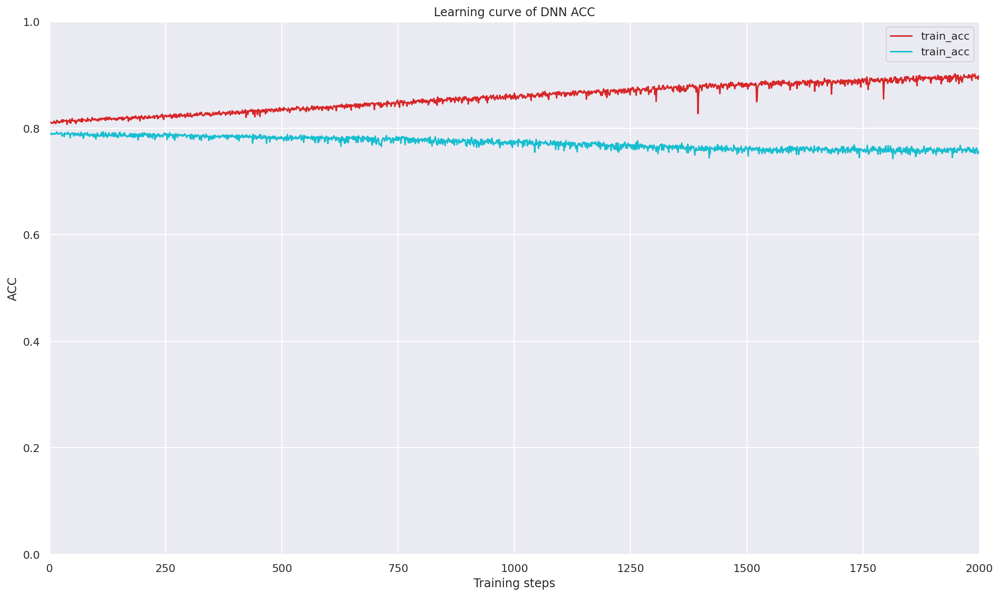

In [ ]:
plot_learning_curve(loss_record_plot_no_ES, 'DNN ACC', type='acc', ylabel='ACC')

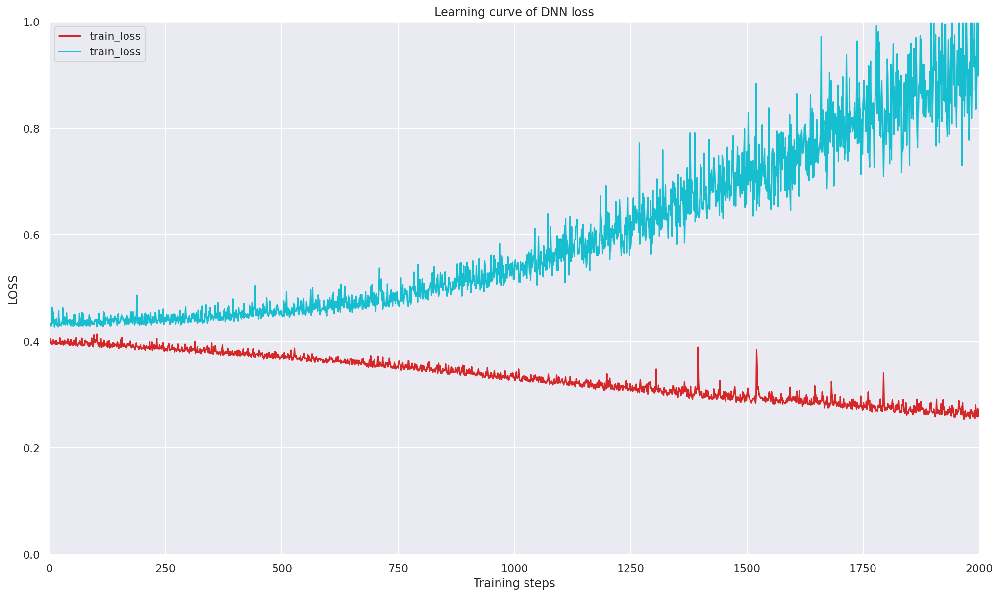

In [ ]:
plot_learning_curve(loss_record_plot_no_ES, 'DNN loss', type='loss', ylabel='LOSS')

**That is Horrible!!**

We can see from the aboving two graphs, if we don't use early stopping techniques. Our model will overfitted start from 400 epoches. 
And it will become much much worse since then!!

Now, we know that our model with early stopping is a good choise.

# 3.2. Compare the two models with a statistical significance test. Use a boxplot to visualize your comparison.

Now we have two different models, we want to test those on different test set.
And get their accuracy scores and f1 scores. Then do the significant test on it. 

First we need to generate a couple of different subdatasets.

### 3.2.1 Generate random sub datasets.

Let's write a function to generate 10 sub datasets randomly, with different random seed.



In [ ]:
raw_data_copy = raw_data.copy()
converted_data = convert_pipeline.fit_transform(raw_data_copy)

##### Use for loop and different random seeds to generate differen subsets

We want every subsets to be different. But we don't want them to be really random.

In [ ]:
def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  train_data, test_data = model_train.values, model_test.values

  # split to trianing set and testing set
  train_data, valid_data = train_test_split(training_data, test_size = config['valid_ratio'], random_state = config['seed'])

  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Dataset_container(x_train, y_train), \
                                              Dataset_container(x_valid, y_valid), \
                                              Dataset_container(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
def create_data_loader(model_train, model_test):
  # Set seed for reproducibility
  same_seed(config['seed'])

  test_data = model_test.values

  ###################################################################################
  ##################Oversampling on training data only###############################
  # get training data
  train_data = model_train

  # split to trianing set and testing set
  train_data, valid_data = train_test_split(training_data, test_size = config['valid_ratio'], random_state = config['seed'])

  # print(f'original train_data with out oversampling size: {train_data.shape}')

  # ros = RandomOverSampler(random_state=0) # RandomOverSampler

  # X_resampled, y_resampled = ros.fit_resample(train_data.iloc[:,:-1], train_data.iloc[:,-1:]) # get the features and labels

  # get oversampled train data

  # train_data = pd.concat([X_resampled,y_resampled], axis = 1) # concate features and labels

  train_data = train_data.astype(float).values
  valid_data = valid_data.astype(float).values
  test_data = test_data.astype(float)
  # fool proof for unsuccessful data preparation stage.

  ##################End of Oversampling on training data#############################
  ###################################################################################


  # Print out the data size.
  print(f"""train_data size: {train_data.shape}
  valid_data size: {valid_data.shape}
  test_data size: {test_data.shape}""")

  # Select features
  x_train, x_valid, x_test, y_train, y_valid, y_test = select_feat(train_data, valid_data, test_data, config['select_all'])

  # Print out the number of features.
  print(f'number of features: {x_train.shape[1]}')

  train_dataset, valid_dataset, test_dataset = Dataset_container(x_train, y_train), \
                                              Dataset_container(x_valid, y_valid), \
                                              Dataset_container(x_test,y_test)

  # Pytorch data loader loads pytorch dataset into batches.
  train_loader = DataLoader(train_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  valid_loader = DataLoader(valid_dataset, batch_size=config['batch_size'], shuffle=True, pin_memory=True)
  test_loader = DataLoader(test_dataset, batch_size=config['batch_size'], shuffle=False, pin_memory=True)
  return train_loader, valid_loader, test_loader


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 128,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 150,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}



In [ ]:
from sklearn.model_selection import train_test_split
import random

train_loader = []
valid_loader = []
test_loader = []
train_loader_NN = []
valid_loader_NN = []

# make sure the seeds are not really random for reproducting resutls

seeds = [218044298, 202077507, 169895152, 229758599,
          36590886, 348821367, 58887816, 178020509, 524236732, 129866998]
         
for i in range(10):
  # use our previous defined function to set all seeds in python
  same_seed(seeds[i]) 
  training_data, testing_data = train_test_split(converted_data, test_size=0.3)
  print("############################   Subsets ", i, "#################################")
  train_loader_temp, valid_loader_temp, test_loader_temp = create_data_loader(training_data, testing_data)
  
  # save our dataloader to our arrays 
  train_loader.append(train_loader_temp)
  valid_loader.append(valid_loader_temp)
  test_loader.append(test_loader_temp)


############################   Subsets  0 #################################
train_data size: (2812, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8
############################   Subsets  1 #################################
train_data size: (2812, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8
############################   Subsets  2 #################################
train_data size: (2812, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8
############################   Subsets  3 #################################
train_data size: (2812, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8
############################   Subsets  4 #################################
train_data size: (2812, 9)
  valid_data size: (2110, 9)
  test_data size: (2110, 9)
number of features: 8
############################   Subsets  5 #################################
train_data siz

Write a small function to see if every subsets are different.

In [ ]:
print("Squared difference between")
for i in range(10):
  for j in range(10):
    if i != j and i < j:
      print("subset No.",i , " with", j )
      print("######################", torch.sum(train_loader[i].dataset.x - train_loader[j].dataset.x).item())

Squared difference between
subset No. 0  with 1
###################### 552.1890258789062
subset No. 0  with 2
###################### 654.3311767578125
subset No. 0  with 3
###################### 473.79718017578125
subset No. 0  with 4
###################### 744.557373046875
subset No. 0  with 5
###################### 242.95208740234375
subset No. 0  with 6
###################### 441.5194091796875
subset No. 0  with 7
###################### 376.82403564453125
subset No. 0  with 8
###################### 713.9107055664062
subset No. 0  with 9
###################### 385.4957580566406
subset No. 1  with 2
###################### 102.14213562011719
subset No. 1  with 3
###################### -78.391845703125
subset No. 1  with 4
###################### 192.368408203125
subset No. 1  with 5
###################### -309.2369384765625
subset No. 1  with 6
###################### -110.66963195800781
subset No. 1  with 7
###################### -175.3649139404297
subset No. 1  with 8
#################

We can see that our small function works just fine.
Every subdatasets are different from each other.


We are ready to train on these sub datasets.

### 3.2.2 Train our random forest model 10 times.

In [ ]:
from sklearn.metrics import accuracy_score


def rf_train_on_multiple_sets(train_loader, test_loader):

  RF_acc_score = []
  RF_prediction = []

  for i in range(10):
  # convert the rest of dataset
    X_train = train_loader[i].dataset.x.numpy();X_train 
    y_train =train_loader[i].dataset.y.numpy();y_train
    X_test = test_loader[i].dataset.x.numpy()
    y_test = test_loader[i].dataset.y.numpy()
    # Train our model
    forest_cls_final = RandomForestClassifier(max_features = 3, n_estimators = 22, random_state=42,
                          verbose=0)
    # train our model
    forest_cls_final.fit(X_train, y_train)
    print("Test set score of No.", i , "subsets")
    # test it on test set
    prediction_final = forest_cls_final.predict(X_test)
    acc_RF = accuracy_score(y_test, prediction_final)

    # append acc
    RF_acc_score.append(acc_RF)
    print("Accuracy is ", round(acc_RF,2) * 100 , "%")
    RF_prediction.append(prediction_final)

  return RF_acc_score, RF_prediction

In [ ]:
RF_acc_score,RF_prediction =  rf_train_on_multiple_sets(train_loader,test_loader)

Test set score of No. 0 subsets
Accuracy is  77.0 %
Test set score of No. 1 subsets
Accuracy is  78.0 %
Test set score of No. 2 subsets
Accuracy is  78.0 %
Test set score of No. 3 subsets
Accuracy is  76.0 %
Test set score of No. 4 subsets
Accuracy is  78.0 %
Test set score of No. 5 subsets
Accuracy is  78.0 %
Test set score of No. 6 subsets
Accuracy is  77.0 %
Test set score of No. 7 subsets
Accuracy is  76.0 %
Test set score of No. 8 subsets
Accuracy is  78.0 %
Test set score of No. 9 subsets
Accuracy is  77.0 %


#### Boxplot of random forest's Accuracy

Text(0, 0.5, 'Accuracy')

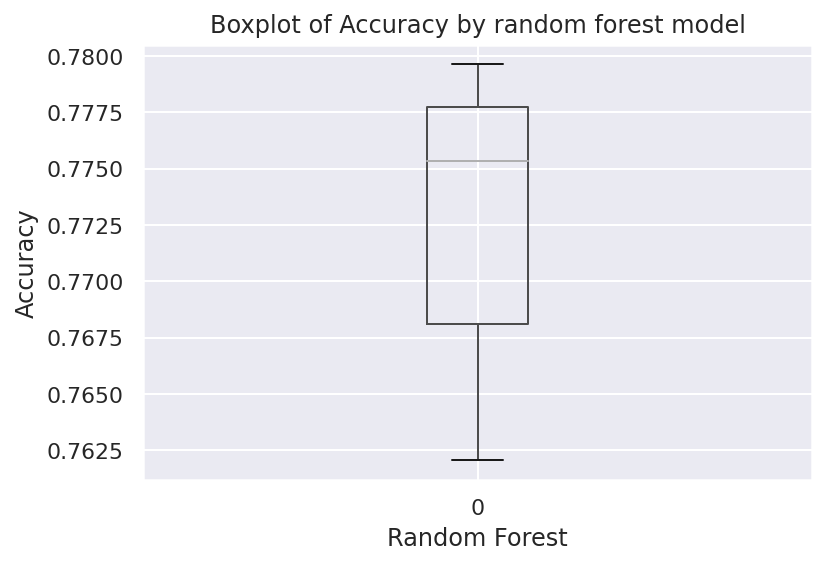

In [ ]:
ACC_RF = pd.DataFrame(RF_acc_score)
ACC_RF.boxplot()
plt.title("Boxplot of Accuracy by random forest model")
plt.xlabel('Random Forest')
plt.ylabel('Accuracy')

### 3.2.3 Train our Neural Network 10 times.


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.42857143,   # validation_size = train_size * valid_ratio
    'n_epochs': 2000,     # Number of epochs. Try 2000 at first
    'batch_size': 128,   # since we have a quite large dataset. The batch size should be large too
    'learning_rate': 1e-4,
    'early_stop': 50,    # If model has not improved for this many consecutive epochs, stop training.
    'save_path': './models/model.ckpt'  # Your model will be saved here.
}


#### slightly modifed trainer for printing which dataset we are training

In [ ]:
def trainer_with_iteration(train_loader, valid_loader,train_dataset, valid_dataset, model, config, device, iteration):

    criterion = nn.CrossEntropyLoss() # Define our loss function. By Cross Entropy
    # Use AdamW this time again
    optimizer = torch.optim.AdamW(model.parameters(), lr=config['learning_rate'],weight_decay=config['learning_rate'])
    # save our best_acc
    best_acc = 0.0
    # training parameters
    n_epochs, best_loss, step, early_stop_count = config['n_epochs'], math.inf, 0, 0
    # make folder for training model
    if not os.path.isdir('./models'):
        os.mkdir('./models') # Create directory of saving models.

    # this is the result saver for our plot function
    loss_record_plot = {'train_acc': [], 'valid_acc': [], 'train_loss':[], 'valid_loss':[]}      # for recording training loss


    writer = SummaryWriter() # Writer of tensoboard.

    for epoch in range(n_epochs):

        # basic settings
        train_acc = 0.0
        train_loss = 0.0
        val_acc = 0.0
        val_loss = 0.0

        # get features and labels in one batch
        for i, batch in enumerate(tqdm(train_loader)):
          # move features and labels to CPU/GPU
          features, labels = batch
          features = features.to(device)
          labels = labels.to(device)

          optimizer.zero_grad()  # before training, we need to clean our saved weights and bias
          outputs = model(features)  # train

          loss = criterion(outputs, labels) # get loss by CrossEntropy
          loss.backward()
          optimizer.step()


          # save training accuracy and loss

          _, train_pred = torch.max(outputs, 1) # get the index of the class with the highest probability
          train_acc += (train_pred.detach() == labels.detach()).sum().item()
          train_loss += loss.item()


          model.eval() # set the model to evaluation mode

        # start validating

        if len(valid_dataset) > 0:
          with torch.no_grad(): # tell pytorch don't update gradient.
              # get features and labels from one batch
              for i, batch in enumerate(tqdm(valid_loader)):
                  features, labels = batch
                  features = features.to(device)
                  labels = labels.to(device)
                  outputs = model(features)

                  loss = criterion(outputs, labels)

                  # save validation accuracy and loss
                  _, val_pred = torch.max(outputs, 1)
                  val_acc += (val_pred.cpu() == labels.cpu()).sum().item() # get the index of the class with the highest probability
                  val_loss += loss.item()

              # prompt train/loss information

              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print(' #### Subset {:03d} ##### [{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                   iteration, epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array

              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1)
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1)
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)


              # if the model improves, save a checkpoint at this epoch
              if val_acc > best_acc:
                  best_acc = val_acc
                  early_stop_count = 0 # reset early stopping counter

                  torch.save(model.state_dict(), config['save_path'])
                  print('##################################################saving model with acc {:.3f}##############################################################'.format(best_acc/len(valid_dataset)))

              if val_acc < best_acc:
                  early_stop_count += 1 # add one to early stopping counter

              if early_stop_count >= config['early_stop']: # apply early stopping and quit training
                  print('\nModel is not improving, so we halt the training session.')
                  return loss_record_plot
        else:
            ############## Base on the famous theory - Occam's razor, we don't write another function here to simplify this procedure########
            ## "Entities should not be multiplied beyond necessity" ###
            # writing another function inside the training function is not a good idea
            # Although it looks bad, we keep it the structure simple.

            # print last epoch's info
              current_train_acc = train_acc/len(train_dataset)
              current_valid_acc = val_acc/len(valid_dataset)
              current_train_loss = train_loss/len(train_loader)
              current_valid_loss = val_loss/len(valid_loader)

              print('#### Subset {:03d} ##### [{:03d}/{:03d}] Train Acc: {:3.6f} Loss: {:3.6f} | Val Acc: {:3.6f} loss: {:3.6f}'.format(
                 iteration ,epoch + 1, n_epochs, current_train_acc, current_train_loss, current_valid_acc, current_valid_loss
              ))

              # matplot records
              loss_record_plot['train_acc'].append(current_train_acc)  # add loss into our extra plot array
              loss_record_plot['valid_acc'].append(current_valid_acc)    # add loss into our extra plot array
              loss_record_plot['train_loss'].append(current_train_loss) # add loss into our extra plot array
              loss_record_plot['valid_loss'].append(current_valid_loss)   # add loss into our extra plot array

              # tensorflow records
              writer.add_scalar('ACC/Train Acc',current_train_acc , epoch + 1)
              writer.add_scalar('ACC/Val Acc',current_valid_acc , epoch + 1)
              writer.add_scalar('LOSS/Train LOSS',current_train_loss , epoch + 1)
              writer.add_scalar('LOSS/Val LOSS',current_valid_loss , epoch + 1)

    # if not validating, save the last epoch
    if len(valid_dataset) == 0:
        torch.save(model.state_dict(), config['save_path'])
        print('saving model at last epoch')

    return loss_record_plot




#### Start training

In [ ]:
model_stack = []
loss_record_plot_stack = []

for i in range(10):
  print("Training on Subsets NO.",i)
  if i != 0:
    del model_temp
  # start to training 
  model_temp = My_Model(input_dim = train_loader[i].dataset.x.shape[1]).to(device) 
  loss_record_plot_temp = trainer_with_iteration(train_loader[i], valid_loader[i],train_loader[i].dataset, valid_loader[i].dataset, model_temp, config, device, i);

  # # load our best model, instead of the potentially overfitted models
  best_model = My_Model(input_dim=train_loader[i].dataset.x.shape[1]).to(device) # put your model and data on the same computation device.
  ckpt = torch.load(config['save_path'], map_location='cpu')  # Load your best model and no need to load into GPU, since we won't train it. 
  best_model.load_state_dict(ckpt)
  # save our best model into our arrays
  model_stack.append(best_model)
  # save our learning curve data
  loss_record_plot_stack.append(loss_record_plot_temp)

Training on Subsets NO. 0


100%|██████████| 17/17 [00:00<00:00, 378.53it/s]


 #### Subset 000 ##### [001/2000] Train Acc: 0.730441 Loss: 0.632788 | Val Acc: 0.737915 loss: 0.627687
##################################################saving model with acc 0.738##############################################################


100%|██████████| 17/17 [00:00<00:00, 280.27it/s]


 #### Subset 000 ##### [002/2000] Train Acc: 0.730441 Loss: 0.628154 | Val Acc: 0.737915 loss: 0.622566


100%|██████████| 17/17 [00:00<00:00, 282.05it/s]


 #### Subset 000 ##### [003/2000] Train Acc: 0.730441 Loss: 0.623449 | Val Acc: 0.737915 loss: 0.618483


100%|██████████| 17/17 [00:00<00:00, 242.26it/s]


 #### Subset 000 ##### [004/2000] Train Acc: 0.730441 Loss: 0.618634 | Val Acc: 0.737915 loss: 0.612532


100%|██████████| 17/17 [00:00<00:00, 168.40it/s]


 #### Subset 000 ##### [005/2000] Train Acc: 0.730441 Loss: 0.611888 | Val Acc: 0.737915 loss: 0.604980


100%|██████████| 17/17 [00:00<00:00, 337.83it/s]


 #### Subset 000 ##### [006/2000] Train Acc: 0.730441 Loss: 0.600333 | Val Acc: 0.737915 loss: 0.588741


100%|██████████| 17/17 [00:00<00:00, 129.01it/s]


 #### Subset 000 ##### [007/2000] Train Acc: 0.730441 Loss: 0.580097 | Val Acc: 0.737915 loss: 0.561676


100%|██████████| 17/17 [00:00<00:00, 318.40it/s]


 #### Subset 000 ##### [008/2000] Train Acc: 0.730441 Loss: 0.550151 | Val Acc: 0.737915 loss: 0.526974


100%|██████████| 17/17 [00:00<00:00, 261.67it/s]


 #### Subset 000 ##### [009/2000] Train Acc: 0.730441 Loss: 0.516685 | Val Acc: 0.737915 loss: 0.496892


100%|██████████| 17/17 [00:00<00:00, 235.95it/s]


 #### Subset 000 ##### [010/2000] Train Acc: 0.730441 Loss: 0.494753 | Val Acc: 0.737915 loss: 0.479039


100%|██████████| 17/17 [00:00<00:00, 149.27it/s]


 #### Subset 000 ##### [011/2000] Train Acc: 0.730441 Loss: 0.485197 | Val Acc: 0.737915 loss: 0.472128


100%|██████████| 17/17 [00:00<00:00, 176.49it/s]


 #### Subset 000 ##### [012/2000] Train Acc: 0.730441 Loss: 0.480082 | Val Acc: 0.737915 loss: 0.468493


100%|██████████| 17/17 [00:00<00:00, 182.54it/s]


 #### Subset 000 ##### [013/2000] Train Acc: 0.730441 Loss: 0.477752 | Val Acc: 0.737915 loss: 0.468395


100%|██████████| 17/17 [00:00<00:00, 184.46it/s]


 #### Subset 000 ##### [014/2000] Train Acc: 0.730441 Loss: 0.476108 | Val Acc: 0.737915 loss: 0.464458


100%|██████████| 17/17 [00:00<00:00, 222.75it/s]


 #### Subset 000 ##### [015/2000] Train Acc: 0.730441 Loss: 0.475009 | Val Acc: 0.737915 loss: 0.461302


100%|██████████| 17/17 [00:00<00:00, 170.08it/s]


 #### Subset 000 ##### [016/2000] Train Acc: 0.730441 Loss: 0.473587 | Val Acc: 0.737915 loss: 0.465322


100%|██████████| 17/17 [00:00<00:00, 227.62it/s]


 #### Subset 000 ##### [017/2000] Train Acc: 0.730441 Loss: 0.472548 | Val Acc: 0.737915 loss: 0.465146


100%|██████████| 17/17 [00:00<00:00, 209.89it/s]


 #### Subset 000 ##### [018/2000] Train Acc: 0.730441 Loss: 0.471563 | Val Acc: 0.737915 loss: 0.459741


100%|██████████| 17/17 [00:00<00:00, 183.78it/s]


 #### Subset 000 ##### [019/2000] Train Acc: 0.730441 Loss: 0.470662 | Val Acc: 0.737915 loss: 0.461745


100%|██████████| 17/17 [00:00<00:00, 208.04it/s]


 #### Subset 000 ##### [020/2000] Train Acc: 0.730441 Loss: 0.469961 | Val Acc: 0.737915 loss: 0.461500


100%|██████████| 17/17 [00:00<00:00, 206.25it/s]


 #### Subset 000 ##### [021/2000] Train Acc: 0.730441 Loss: 0.468991 | Val Acc: 0.737915 loss: 0.459838


100%|██████████| 17/17 [00:00<00:00, 333.37it/s]


 #### Subset 000 ##### [022/2000] Train Acc: 0.730441 Loss: 0.467718 | Val Acc: 0.737915 loss: 0.458794


100%|██████████| 17/17 [00:00<00:00, 374.28it/s]


 #### Subset 000 ##### [023/2000] Train Acc: 0.730441 Loss: 0.466713 | Val Acc: 0.737915 loss: 0.457858


100%|██████████| 17/17 [00:00<00:00, 356.66it/s]


 #### Subset 000 ##### [024/2000] Train Acc: 0.730441 Loss: 0.465787 | Val Acc: 0.737915 loss: 0.455249


100%|██████████| 17/17 [00:00<00:00, 390.38it/s]


 #### Subset 000 ##### [025/2000] Train Acc: 0.730441 Loss: 0.464822 | Val Acc: 0.737915 loss: 0.454128


100%|██████████| 17/17 [00:00<00:00, 387.39it/s]


 #### Subset 000 ##### [026/2000] Train Acc: 0.730441 Loss: 0.463472 | Val Acc: 0.737915 loss: 0.458311


100%|██████████| 17/17 [00:00<00:00, 384.10it/s]


 #### Subset 000 ##### [027/2000] Train Acc: 0.730441 Loss: 0.462700 | Val Acc: 0.737915 loss: 0.453051


100%|██████████| 17/17 [00:00<00:00, 349.27it/s]


 #### Subset 000 ##### [028/2000] Train Acc: 0.730441 Loss: 0.460459 | Val Acc: 0.737915 loss: 0.449724


100%|██████████| 17/17 [00:00<00:00, 384.52it/s]


 #### Subset 000 ##### [029/2000] Train Acc: 0.732575 Loss: 0.458818 | Val Acc: 0.749763 loss: 0.453340
##################################################saving model with acc 0.750##############################################################


100%|██████████| 17/17 [00:00<00:00, 354.04it/s]


 #### Subset 000 ##### [030/2000] Train Acc: 0.761380 Loss: 0.456168 | Val Acc: 0.768246 loss: 0.451293
##################################################saving model with acc 0.768##############################################################


100%|██████████| 17/17 [00:00<00:00, 354.67it/s]


 #### Subset 000 ##### [031/2000] Train Acc: 0.770982 Loss: 0.454397 | Val Acc: 0.772986 loss: 0.446955
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 255.23it/s]


 #### Subset 000 ##### [032/2000] Train Acc: 0.770270 Loss: 0.452675 | Val Acc: 0.773934 loss: 0.449812
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 401.57it/s]


 #### Subset 000 ##### [033/2000] Train Acc: 0.770982 Loss: 0.451061 | Val Acc: 0.774882 loss: 0.449881
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 342.30it/s]


 #### Subset 000 ##### [034/2000] Train Acc: 0.770270 Loss: 0.449502 | Val Acc: 0.776303 loss: 0.443808
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 304.21it/s]


 #### Subset 000 ##### [035/2000] Train Acc: 0.773115 Loss: 0.447513 | Val Acc: 0.773460 loss: 0.444109


100%|██████████| 17/17 [00:00<00:00, 367.93it/s]


 #### Subset 000 ##### [036/2000] Train Acc: 0.773826 Loss: 0.448035 | Val Acc: 0.778199 loss: 0.447795
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 360.09it/s]


 #### Subset 000 ##### [037/2000] Train Acc: 0.771693 Loss: 0.446076 | Val Acc: 0.775829 loss: 0.440950


100%|██████████| 17/17 [00:00<00:00, 326.58it/s]


 #### Subset 000 ##### [038/2000] Train Acc: 0.774538 Loss: 0.444369 | Val Acc: 0.776303 loss: 0.445953


100%|██████████| 17/17 [00:00<00:00, 394.55it/s]


 #### Subset 000 ##### [039/2000] Train Acc: 0.775605 Loss: 0.444731 | Val Acc: 0.777725 loss: 0.445102


100%|██████████| 17/17 [00:00<00:00, 398.55it/s]


 #### Subset 000 ##### [040/2000] Train Acc: 0.774893 Loss: 0.443071 | Val Acc: 0.777725 loss: 0.442008


100%|██████████| 17/17 [00:00<00:00, 368.38it/s]


 #### Subset 000 ##### [041/2000] Train Acc: 0.775605 Loss: 0.442540 | Val Acc: 0.777251 loss: 0.445225


100%|██████████| 17/17 [00:00<00:00, 342.25it/s]


 #### Subset 000 ##### [042/2000] Train Acc: 0.778450 Loss: 0.442368 | Val Acc: 0.781043 loss: 0.439603
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.69it/s]


 #### Subset 000 ##### [043/2000] Train Acc: 0.775960 Loss: 0.441392 | Val Acc: 0.779147 loss: 0.438673


100%|██████████| 17/17 [00:00<00:00, 354.58it/s]


 #### Subset 000 ##### [044/2000] Train Acc: 0.777738 Loss: 0.441876 | Val Acc: 0.782464 loss: 0.445282
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 374.29it/s]


 #### Subset 000 ##### [045/2000] Train Acc: 0.777027 Loss: 0.440589 | Val Acc: 0.781517 loss: 0.441273


100%|██████████| 17/17 [00:00<00:00, 394.99it/s]


 #### Subset 000 ##### [046/2000] Train Acc: 0.779161 Loss: 0.439802 | Val Acc: 0.782464 loss: 0.438970


100%|██████████| 17/17 [00:00<00:00, 368.95it/s]


 #### Subset 000 ##### [047/2000] Train Acc: 0.778805 Loss: 0.439099 | Val Acc: 0.782464 loss: 0.438072


100%|██████████| 17/17 [00:00<00:00, 341.72it/s]


 #### Subset 000 ##### [048/2000] Train Acc: 0.779872 Loss: 0.439130 | Val Acc: 0.782464 loss: 0.436673


100%|██████████| 17/17 [00:00<00:00, 367.72it/s]


 #### Subset 000 ##### [049/2000] Train Acc: 0.779872 Loss: 0.438027 | Val Acc: 0.782464 loss: 0.434704


100%|██████████| 17/17 [00:00<00:00, 614.70it/s]


 #### Subset 000 ##### [050/2000] Train Acc: 0.781650 Loss: 0.437701 | Val Acc: 0.782464 loss: 0.440277


100%|██████████| 17/17 [00:00<00:00, 686.19it/s]


 #### Subset 000 ##### [051/2000] Train Acc: 0.782361 Loss: 0.437568 | Val Acc: 0.782938 loss: 0.434390
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 550.40it/s]


 #### Subset 000 ##### [052/2000] Train Acc: 0.781294 Loss: 0.437716 | Val Acc: 0.782464 loss: 0.435413


100%|██████████| 17/17 [00:00<00:00, 522.97it/s]


 #### Subset 000 ##### [053/2000] Train Acc: 0.785562 Loss: 0.436986 | Val Acc: 0.783412 loss: 0.438849
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 648.00it/s]


 #### Subset 000 ##### [054/2000] Train Acc: 0.783784 Loss: 0.437174 | Val Acc: 0.782938 loss: 0.436855


100%|██████████| 17/17 [00:00<00:00, 534.26it/s]


 #### Subset 000 ##### [055/2000] Train Acc: 0.783784 Loss: 0.435634 | Val Acc: 0.783886 loss: 0.438250
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 578.41it/s]


 #### Subset 000 ##### [056/2000] Train Acc: 0.784851 Loss: 0.435756 | Val Acc: 0.783412 loss: 0.438329


100%|██████████| 17/17 [00:00<00:00, 607.69it/s]


 #### Subset 000 ##### [057/2000] Train Acc: 0.784851 Loss: 0.434859 | Val Acc: 0.782938 loss: 0.438086


100%|██████████| 17/17 [00:00<00:00, 463.03it/s]


 #### Subset 000 ##### [058/2000] Train Acc: 0.785917 Loss: 0.435021 | Val Acc: 0.783886 loss: 0.435318


100%|██████████| 17/17 [00:00<00:00, 543.93it/s]


 #### Subset 000 ##### [059/2000] Train Acc: 0.784495 Loss: 0.435941 | Val Acc: 0.785782 loss: 0.435391
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 474.08it/s]


 #### Subset 000 ##### [060/2000] Train Acc: 0.785562 Loss: 0.434896 | Val Acc: 0.785782 loss: 0.439493


100%|██████████| 17/17 [00:00<00:00, 677.12it/s]


 #### Subset 000 ##### [061/2000] Train Acc: 0.784851 Loss: 0.433792 | Val Acc: 0.787678 loss: 0.433110
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 530.42it/s]


 #### Subset 000 ##### [062/2000] Train Acc: 0.786273 Loss: 0.434471 | Val Acc: 0.787678 loss: 0.435129


100%|██████████| 17/17 [00:00<00:00, 414.67it/s]


 #### Subset 000 ##### [063/2000] Train Acc: 0.788051 Loss: 0.433389 | Val Acc: 0.787204 loss: 0.438259


100%|██████████| 17/17 [00:00<00:00, 505.86it/s]


 #### Subset 000 ##### [064/2000] Train Acc: 0.785206 Loss: 0.433429 | Val Acc: 0.788152 loss: 0.437183
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 680.47it/s]


 #### Subset 000 ##### [065/2000] Train Acc: 0.786984 Loss: 0.433276 | Val Acc: 0.789573 loss: 0.436237
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 588.88it/s]


 #### Subset 000 ##### [066/2000] Train Acc: 0.789118 Loss: 0.432443 | Val Acc: 0.789100 loss: 0.438253


100%|██████████| 17/17 [00:00<00:00, 534.71it/s]


 #### Subset 000 ##### [067/2000] Train Acc: 0.789118 Loss: 0.432184 | Val Acc: 0.790047 loss: 0.435432
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 455.03it/s]


 #### Subset 000 ##### [068/2000] Train Acc: 0.786273 Loss: 0.431977 | Val Acc: 0.789100 loss: 0.431828


100%|██████████| 17/17 [00:00<00:00, 609.74it/s]


 #### Subset 000 ##### [069/2000] Train Acc: 0.788762 Loss: 0.432063 | Val Acc: 0.789100 loss: 0.433133


100%|██████████| 17/17 [00:00<00:00, 592.88it/s]


 #### Subset 000 ##### [070/2000] Train Acc: 0.788762 Loss: 0.431976 | Val Acc: 0.791469 loss: 0.435344
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 406.71it/s]


 #### Subset 000 ##### [071/2000] Train Acc: 0.789474 Loss: 0.431864 | Val Acc: 0.790047 loss: 0.439564


100%|██████████| 17/17 [00:00<00:00, 613.57it/s]


 #### Subset 000 ##### [072/2000] Train Acc: 0.786629 Loss: 0.431485 | Val Acc: 0.789573 loss: 0.434128


100%|██████████| 17/17 [00:00<00:00, 604.15it/s]


 #### Subset 000 ##### [073/2000] Train Acc: 0.788051 Loss: 0.431085 | Val Acc: 0.792417 loss: 0.436102
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 433.57it/s]


 #### Subset 000 ##### [074/2000] Train Acc: 0.788407 Loss: 0.430630 | Val Acc: 0.792417 loss: 0.437891


100%|██████████| 17/17 [00:00<00:00, 621.28it/s]


 #### Subset 000 ##### [075/2000] Train Acc: 0.786984 Loss: 0.431011 | Val Acc: 0.792417 loss: 0.434923


100%|██████████| 17/17 [00:00<00:00, 589.65it/s]


 #### Subset 000 ##### [076/2000] Train Acc: 0.787696 Loss: 0.431228 | Val Acc: 0.792417 loss: 0.437591


100%|██████████| 17/17 [00:00<00:00, 468.34it/s]


 #### Subset 000 ##### [077/2000] Train Acc: 0.788051 Loss: 0.430187 | Val Acc: 0.790047 loss: 0.435102


100%|██████████| 17/17 [00:00<00:00, 599.44it/s]


 #### Subset 000 ##### [078/2000] Train Acc: 0.786273 Loss: 0.430681 | Val Acc: 0.788626 loss: 0.437403


100%|██████████| 17/17 [00:00<00:00, 519.53it/s]


 #### Subset 000 ##### [079/2000] Train Acc: 0.786273 Loss: 0.430167 | Val Acc: 0.791469 loss: 0.432576


100%|██████████| 17/17 [00:00<00:00, 577.23it/s]


 #### Subset 000 ##### [080/2000] Train Acc: 0.788051 Loss: 0.430399 | Val Acc: 0.791943 loss: 0.434764


100%|██████████| 17/17 [00:00<00:00, 473.95it/s]


 #### Subset 000 ##### [081/2000] Train Acc: 0.786984 Loss: 0.429813 | Val Acc: 0.791943 loss: 0.434094


100%|██████████| 17/17 [00:00<00:00, 600.29it/s]


 #### Subset 000 ##### [082/2000] Train Acc: 0.786984 Loss: 0.430979 | Val Acc: 0.793365 loss: 0.433818
##################################################saving model with acc 0.793##############################################################


100%|██████████| 17/17 [00:00<00:00, 573.90it/s]


 #### Subset 000 ##### [083/2000] Train Acc: 0.787340 Loss: 0.429587 | Val Acc: 0.793839 loss: 0.432470
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 630.09it/s]


 #### Subset 000 ##### [084/2000] Train Acc: 0.787696 Loss: 0.429631 | Val Acc: 0.792891 loss: 0.435574


100%|██████████| 17/17 [00:00<00:00, 667.57it/s]


 #### Subset 000 ##### [085/2000] Train Acc: 0.788762 Loss: 0.430128 | Val Acc: 0.790521 loss: 0.431331


100%|██████████| 17/17 [00:00<00:00, 548.16it/s]


 #### Subset 000 ##### [086/2000] Train Acc: 0.789118 Loss: 0.428987 | Val Acc: 0.792417 loss: 0.432041


100%|██████████| 17/17 [00:00<00:00, 506.16it/s]


 #### Subset 000 ##### [087/2000] Train Acc: 0.788407 Loss: 0.428792 | Val Acc: 0.792891 loss: 0.435885


100%|██████████| 17/17 [00:00<00:00, 544.25it/s]


 #### Subset 000 ##### [088/2000] Train Acc: 0.789118 Loss: 0.428938 | Val Acc: 0.792891 loss: 0.434505


100%|██████████| 17/17 [00:00<00:00, 535.86it/s]


 #### Subset 000 ##### [089/2000] Train Acc: 0.787340 Loss: 0.431324 | Val Acc: 0.791943 loss: 0.434500


100%|██████████| 17/17 [00:00<00:00, 573.63it/s]


 #### Subset 000 ##### [090/2000] Train Acc: 0.786984 Loss: 0.428402 | Val Acc: 0.791943 loss: 0.433562


100%|██████████| 17/17 [00:00<00:00, 593.85it/s]


 #### Subset 000 ##### [091/2000] Train Acc: 0.788051 Loss: 0.428667 | Val Acc: 0.791943 loss: 0.434585


100%|██████████| 17/17 [00:00<00:00, 591.97it/s]


 #### Subset 000 ##### [092/2000] Train Acc: 0.787696 Loss: 0.428896 | Val Acc: 0.792417 loss: 0.432600


100%|██████████| 17/17 [00:00<00:00, 616.01it/s]


 #### Subset 000 ##### [093/2000] Train Acc: 0.789118 Loss: 0.428189 | Val Acc: 0.792891 loss: 0.433671


100%|██████████| 17/17 [00:00<00:00, 544.94it/s]


 #### Subset 000 ##### [094/2000] Train Acc: 0.787696 Loss: 0.428109 | Val Acc: 0.792417 loss: 0.432380


100%|██████████| 17/17 [00:00<00:00, 507.95it/s]


 #### Subset 000 ##### [095/2000] Train Acc: 0.790185 Loss: 0.429823 | Val Acc: 0.793365 loss: 0.432026


100%|██████████| 17/17 [00:00<00:00, 396.34it/s]


 #### Subset 000 ##### [096/2000] Train Acc: 0.790896 Loss: 0.428385 | Val Acc: 0.794313 loss: 0.433998
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 330.31it/s]


 #### Subset 000 ##### [097/2000] Train Acc: 0.789829 Loss: 0.427520 | Val Acc: 0.792417 loss: 0.434278


100%|██████████| 17/17 [00:00<00:00, 512.15it/s]


 #### Subset 000 ##### [098/2000] Train Acc: 0.788407 Loss: 0.428945 | Val Acc: 0.794313 loss: 0.432563


100%|██████████| 17/17 [00:00<00:00, 640.97it/s]


 #### Subset 000 ##### [099/2000] Train Acc: 0.792319 Loss: 0.427479 | Val Acc: 0.793365 loss: 0.436285


100%|██████████| 17/17 [00:00<00:00, 541.00it/s]


 #### Subset 000 ##### [100/2000] Train Acc: 0.790896 Loss: 0.427346 | Val Acc: 0.793839 loss: 0.433812


100%|██████████| 17/17 [00:00<00:00, 554.42it/s]


 #### Subset 000 ##### [101/2000] Train Acc: 0.792674 Loss: 0.427603 | Val Acc: 0.794313 loss: 0.434893


100%|██████████| 17/17 [00:00<00:00, 616.67it/s]


 #### Subset 000 ##### [102/2000] Train Acc: 0.789118 Loss: 0.427173 | Val Acc: 0.793365 loss: 0.435989


100%|██████████| 17/17 [00:00<00:00, 589.82it/s]


 #### Subset 000 ##### [103/2000] Train Acc: 0.788762 Loss: 0.426684 | Val Acc: 0.793839 loss: 0.439067


100%|██████████| 17/17 [00:00<00:00, 462.94it/s]


 #### Subset 000 ##### [104/2000] Train Acc: 0.791607 Loss: 0.427398 | Val Acc: 0.792417 loss: 0.430600


100%|██████████| 17/17 [00:00<00:00, 467.68it/s]


 #### Subset 000 ##### [105/2000] Train Acc: 0.790896 Loss: 0.428475 | Val Acc: 0.793365 loss: 0.437158


100%|██████████| 17/17 [00:00<00:00, 500.30it/s]


 #### Subset 000 ##### [106/2000] Train Acc: 0.791607 Loss: 0.428077 | Val Acc: 0.794787 loss: 0.432530
##################################################saving model with acc 0.795##############################################################


100%|██████████| 17/17 [00:00<00:00, 634.31it/s]


 #### Subset 000 ##### [107/2000] Train Acc: 0.789829 Loss: 0.426779 | Val Acc: 0.793839 loss: 0.430761


100%|██████████| 17/17 [00:00<00:00, 446.09it/s]


 #### Subset 000 ##### [108/2000] Train Acc: 0.792674 Loss: 0.426901 | Val Acc: 0.794787 loss: 0.431682


100%|██████████| 17/17 [00:00<00:00, 372.66it/s]


 #### Subset 000 ##### [109/2000] Train Acc: 0.791607 Loss: 0.428745 | Val Acc: 0.795735 loss: 0.433780
##################################################saving model with acc 0.796##############################################################


100%|██████████| 17/17 [00:00<00:00, 579.94it/s]


 #### Subset 000 ##### [110/2000] Train Acc: 0.791963 Loss: 0.426367 | Val Acc: 0.795735 loss: 0.434192


100%|██████████| 17/17 [00:00<00:00, 408.10it/s]


 #### Subset 000 ##### [111/2000] Train Acc: 0.790896 Loss: 0.426327 | Val Acc: 0.794787 loss: 0.432514


100%|██████████| 17/17 [00:00<00:00, 611.20it/s]


 #### Subset 000 ##### [112/2000] Train Acc: 0.793030 Loss: 0.425922 | Val Acc: 0.793839 loss: 0.431173


100%|██████████| 17/17 [00:00<00:00, 392.26it/s]


 #### Subset 000 ##### [113/2000] Train Acc: 0.790896 Loss: 0.426733 | Val Acc: 0.793839 loss: 0.430958


100%|██████████| 17/17 [00:00<00:00, 647.41it/s]


 #### Subset 000 ##### [114/2000] Train Acc: 0.791607 Loss: 0.426686 | Val Acc: 0.795735 loss: 0.433599


100%|██████████| 17/17 [00:00<00:00, 428.17it/s]


 #### Subset 000 ##### [115/2000] Train Acc: 0.791607 Loss: 0.425731 | Val Acc: 0.792891 loss: 0.432054


100%|██████████| 17/17 [00:00<00:00, 556.68it/s]


 #### Subset 000 ##### [116/2000] Train Acc: 0.792674 Loss: 0.425631 | Val Acc: 0.792417 loss: 0.431355


100%|██████████| 17/17 [00:00<00:00, 562.00it/s]


 #### Subset 000 ##### [117/2000] Train Acc: 0.793741 Loss: 0.427005 | Val Acc: 0.796682 loss: 0.436190
##################################################saving model with acc 0.797##############################################################


100%|██████████| 17/17 [00:00<00:00, 464.40it/s]


 #### Subset 000 ##### [118/2000] Train Acc: 0.792674 Loss: 0.425163 | Val Acc: 0.790047 loss: 0.432104


100%|██████████| 17/17 [00:00<00:00, 546.76it/s]


 #### Subset 000 ##### [119/2000] Train Acc: 0.793741 Loss: 0.426021 | Val Acc: 0.793839 loss: 0.433532


100%|██████████| 17/17 [00:00<00:00, 572.51it/s]


 #### Subset 000 ##### [120/2000] Train Acc: 0.796942 Loss: 0.426319 | Val Acc: 0.796209 loss: 0.436053


100%|██████████| 17/17 [00:00<00:00, 471.84it/s]


 #### Subset 000 ##### [121/2000] Train Acc: 0.792319 Loss: 0.425993 | Val Acc: 0.795735 loss: 0.436729


100%|██████████| 17/17 [00:00<00:00, 518.97it/s]


 #### Subset 000 ##### [122/2000] Train Acc: 0.790185 Loss: 0.428143 | Val Acc: 0.793839 loss: 0.426787


100%|██████████| 17/17 [00:00<00:00, 555.68it/s]


 #### Subset 000 ##### [123/2000] Train Acc: 0.791963 Loss: 0.425045 | Val Acc: 0.788152 loss: 0.441937


100%|██████████| 17/17 [00:00<00:00, 578.02it/s]


 #### Subset 000 ##### [124/2000] Train Acc: 0.791963 Loss: 0.426340 | Val Acc: 0.793365 loss: 0.430463


100%|██████████| 17/17 [00:00<00:00, 529.82it/s]


 #### Subset 000 ##### [125/2000] Train Acc: 0.792674 Loss: 0.425285 | Val Acc: 0.790521 loss: 0.430115


100%|██████████| 17/17 [00:00<00:00, 589.32it/s]


 #### Subset 000 ##### [126/2000] Train Acc: 0.793030 Loss: 0.425303 | Val Acc: 0.795735 loss: 0.430126


100%|██████████| 17/17 [00:00<00:00, 520.35it/s]


 #### Subset 000 ##### [127/2000] Train Acc: 0.793385 Loss: 0.425586 | Val Acc: 0.793365 loss: 0.432695


100%|██████████| 17/17 [00:00<00:00, 566.28it/s]


 #### Subset 000 ##### [128/2000] Train Acc: 0.790541 Loss: 0.425070 | Val Acc: 0.792417 loss: 0.430080


100%|██████████| 17/17 [00:00<00:00, 375.27it/s]


 #### Subset 000 ##### [129/2000] Train Acc: 0.794808 Loss: 0.424315 | Val Acc: 0.797630 loss: 0.436472
##################################################saving model with acc 0.798##############################################################


100%|██████████| 17/17 [00:00<00:00, 495.60it/s]


 #### Subset 000 ##### [130/2000] Train Acc: 0.792674 Loss: 0.425820 | Val Acc: 0.796682 loss: 0.429435


100%|██████████| 17/17 [00:00<00:00, 576.15it/s]


 #### Subset 000 ##### [131/2000] Train Acc: 0.793741 Loss: 0.425955 | Val Acc: 0.794787 loss: 0.428617


100%|██████████| 17/17 [00:00<00:00, 534.07it/s]


 #### Subset 000 ##### [132/2000] Train Acc: 0.793385 Loss: 0.424361 | Val Acc: 0.796209 loss: 0.434572


100%|██████████| 17/17 [00:00<00:00, 653.46it/s]


 #### Subset 000 ##### [133/2000] Train Acc: 0.793385 Loss: 0.424520 | Val Acc: 0.796682 loss: 0.433687


100%|██████████| 17/17 [00:00<00:00, 546.16it/s]


 #### Subset 000 ##### [134/2000] Train Acc: 0.792674 Loss: 0.424168 | Val Acc: 0.791469 loss: 0.428752


100%|██████████| 17/17 [00:00<00:00, 606.72it/s]


 #### Subset 000 ##### [135/2000] Train Acc: 0.795164 Loss: 0.423943 | Val Acc: 0.794313 loss: 0.436034


100%|██████████| 17/17 [00:00<00:00, 541.94it/s]


 #### Subset 000 ##### [136/2000] Train Acc: 0.794452 Loss: 0.424093 | Val Acc: 0.796682 loss: 0.433921


100%|██████████| 17/17 [00:00<00:00, 560.53it/s]


 #### Subset 000 ##### [137/2000] Train Acc: 0.791963 Loss: 0.424461 | Val Acc: 0.793365 loss: 0.430511


100%|██████████| 17/17 [00:00<00:00, 519.77it/s]


 #### Subset 000 ##### [138/2000] Train Acc: 0.791963 Loss: 0.424008 | Val Acc: 0.792891 loss: 0.432134


100%|██████████| 17/17 [00:00<00:00, 629.57it/s]


 #### Subset 000 ##### [139/2000] Train Acc: 0.792319 Loss: 0.424581 | Val Acc: 0.794787 loss: 0.432480


100%|██████████| 17/17 [00:00<00:00, 584.60it/s]


 #### Subset 000 ##### [140/2000] Train Acc: 0.793741 Loss: 0.423232 | Val Acc: 0.794313 loss: 0.431055


100%|██████████| 17/17 [00:00<00:00, 514.49it/s]


 #### Subset 000 ##### [141/2000] Train Acc: 0.793385 Loss: 0.423698 | Val Acc: 0.796209 loss: 0.431408


100%|██████████| 17/17 [00:00<00:00, 593.96it/s]


 #### Subset 000 ##### [142/2000] Train Acc: 0.792319 Loss: 0.423514 | Val Acc: 0.794787 loss: 0.433973


100%|██████████| 17/17 [00:00<00:00, 422.25it/s]


 #### Subset 000 ##### [143/2000] Train Acc: 0.796586 Loss: 0.423459 | Val Acc: 0.794787 loss: 0.429796


100%|██████████| 17/17 [00:00<00:00, 565.12it/s]


 #### Subset 000 ##### [144/2000] Train Acc: 0.795164 Loss: 0.423224 | Val Acc: 0.795261 loss: 0.433721


100%|██████████| 17/17 [00:00<00:00, 410.35it/s]


 #### Subset 000 ##### [145/2000] Train Acc: 0.793385 Loss: 0.423490 | Val Acc: 0.793365 loss: 0.433313


100%|██████████| 17/17 [00:00<00:00, 473.92it/s]


 #### Subset 000 ##### [146/2000] Train Acc: 0.794452 Loss: 0.423459 | Val Acc: 0.796209 loss: 0.429914


100%|██████████| 17/17 [00:00<00:00, 657.19it/s]


 #### Subset 000 ##### [147/2000] Train Acc: 0.795519 Loss: 0.423966 | Val Acc: 0.794313 loss: 0.427296


100%|██████████| 17/17 [00:00<00:00, 484.39it/s]


 #### Subset 000 ##### [148/2000] Train Acc: 0.793030 Loss: 0.425086 | Val Acc: 0.795261 loss: 0.432083


100%|██████████| 17/17 [00:00<00:00, 627.35it/s]


 #### Subset 000 ##### [149/2000] Train Acc: 0.795875 Loss: 0.423127 | Val Acc: 0.796209 loss: 0.430376


100%|██████████| 17/17 [00:00<00:00, 567.19it/s]


 #### Subset 000 ##### [150/2000] Train Acc: 0.795875 Loss: 0.422480 | Val Acc: 0.796209 loss: 0.435439


100%|██████████| 17/17 [00:00<00:00, 475.89it/s]


 #### Subset 000 ##### [151/2000] Train Acc: 0.794097 Loss: 0.423277 | Val Acc: 0.795735 loss: 0.429526


100%|██████████| 17/17 [00:00<00:00, 526.54it/s]


 #### Subset 000 ##### [152/2000] Train Acc: 0.791963 Loss: 0.422354 | Val Acc: 0.796682 loss: 0.430326


100%|██████████| 17/17 [00:00<00:00, 440.57it/s]


 #### Subset 000 ##### [153/2000] Train Acc: 0.795164 Loss: 0.422605 | Val Acc: 0.795261 loss: 0.434178


100%|██████████| 17/17 [00:00<00:00, 554.68it/s]


 #### Subset 000 ##### [154/2000] Train Acc: 0.794452 Loss: 0.422060 | Val Acc: 0.794787 loss: 0.429606


100%|██████████| 17/17 [00:00<00:00, 666.18it/s]


 #### Subset 000 ##### [155/2000] Train Acc: 0.794808 Loss: 0.422772 | Val Acc: 0.796209 loss: 0.431065


100%|██████████| 17/17 [00:00<00:00, 361.07it/s]


 #### Subset 000 ##### [156/2000] Train Acc: 0.795875 Loss: 0.421785 | Val Acc: 0.797156 loss: 0.431344


100%|██████████| 17/17 [00:00<00:00, 686.58it/s]


 #### Subset 000 ##### [157/2000] Train Acc: 0.794808 Loss: 0.422106 | Val Acc: 0.795735 loss: 0.433663


100%|██████████| 17/17 [00:00<00:00, 644.19it/s]


 #### Subset 000 ##### [158/2000] Train Acc: 0.795875 Loss: 0.421652 | Val Acc: 0.794787 loss: 0.431229


100%|██████████| 17/17 [00:00<00:00, 575.49it/s]


 #### Subset 000 ##### [159/2000] Train Acc: 0.795519 Loss: 0.421620 | Val Acc: 0.795735 loss: 0.429776


100%|██████████| 17/17 [00:00<00:00, 527.03it/s]


 #### Subset 000 ##### [160/2000] Train Acc: 0.796586 Loss: 0.421616 | Val Acc: 0.796682 loss: 0.432508


100%|██████████| 17/17 [00:00<00:00, 502.07it/s]


 #### Subset 000 ##### [161/2000] Train Acc: 0.795519 Loss: 0.422752 | Val Acc: 0.797156 loss: 0.431424


100%|██████████| 17/17 [00:00<00:00, 427.47it/s]


 #### Subset 000 ##### [162/2000] Train Acc: 0.793741 Loss: 0.421525 | Val Acc: 0.794787 loss: 0.426380


100%|██████████| 17/17 [00:00<00:00, 397.35it/s]


 #### Subset 000 ##### [163/2000] Train Acc: 0.796586 Loss: 0.422231 | Val Acc: 0.794787 loss: 0.428913


100%|██████████| 17/17 [00:00<00:00, 374.66it/s]


 #### Subset 000 ##### [164/2000] Train Acc: 0.794097 Loss: 0.422474 | Val Acc: 0.796682 loss: 0.438236


100%|██████████| 17/17 [00:00<00:00, 583.07it/s]


 #### Subset 000 ##### [165/2000] Train Acc: 0.794452 Loss: 0.421431 | Val Acc: 0.795735 loss: 0.428731


100%|██████████| 17/17 [00:00<00:00, 641.21it/s]


 #### Subset 000 ##### [166/2000] Train Acc: 0.795164 Loss: 0.421396 | Val Acc: 0.794787 loss: 0.427269


100%|██████████| 17/17 [00:00<00:00, 489.49it/s]


 #### Subset 000 ##### [167/2000] Train Acc: 0.795519 Loss: 0.421332 | Val Acc: 0.797156 loss: 0.433854


100%|██████████| 17/17 [00:00<00:00, 501.71it/s]


 #### Subset 000 ##### [168/2000] Train Acc: 0.795519 Loss: 0.422429 | Val Acc: 0.797156 loss: 0.430631


100%|██████████| 17/17 [00:00<00:00, 591.63it/s]


 #### Subset 000 ##### [169/2000] Train Acc: 0.796230 Loss: 0.421164 | Val Acc: 0.795735 loss: 0.432384


100%|██████████| 17/17 [00:00<00:00, 531.94it/s]


 #### Subset 000 ##### [170/2000] Train Acc: 0.794808 Loss: 0.421755 | Val Acc: 0.796682 loss: 0.432358


100%|██████████| 17/17 [00:00<00:00, 481.54it/s]


 #### Subset 000 ##### [171/2000] Train Acc: 0.798364 Loss: 0.421399 | Val Acc: 0.795735 loss: 0.435608


100%|██████████| 17/17 [00:00<00:00, 586.01it/s]


 #### Subset 000 ##### [172/2000] Train Acc: 0.795875 Loss: 0.421182 | Val Acc: 0.796682 loss: 0.432429


100%|██████████| 17/17 [00:00<00:00, 427.82it/s]


 #### Subset 000 ##### [173/2000] Train Acc: 0.795519 Loss: 0.421610 | Val Acc: 0.795735 loss: 0.433061


100%|██████████| 17/17 [00:00<00:00, 545.16it/s]


 #### Subset 000 ##### [174/2000] Train Acc: 0.797297 Loss: 0.421217 | Val Acc: 0.795735 loss: 0.431708


100%|██████████| 17/17 [00:00<00:00, 570.91it/s]


 #### Subset 000 ##### [175/2000] Train Acc: 0.797297 Loss: 0.420554 | Val Acc: 0.796209 loss: 0.427618


100%|██████████| 17/17 [00:00<00:00, 503.40it/s]


 #### Subset 000 ##### [176/2000] Train Acc: 0.793030 Loss: 0.421343 | Val Acc: 0.797156 loss: 0.431485


100%|██████████| 17/17 [00:00<00:00, 455.83it/s]


 #### Subset 000 ##### [177/2000] Train Acc: 0.796586 Loss: 0.421238 | Val Acc: 0.796209 loss: 0.427644


100%|██████████| 17/17 [00:00<00:00, 425.57it/s]


 #### Subset 000 ##### [178/2000] Train Acc: 0.794452 Loss: 0.421247 | Val Acc: 0.797156 loss: 0.431059


100%|██████████| 17/17 [00:00<00:00, 476.79it/s]


 #### Subset 000 ##### [179/2000] Train Acc: 0.795164 Loss: 0.421471 | Val Acc: 0.795735 loss: 0.428525


100%|██████████| 17/17 [00:00<00:00, 461.23it/s]


 #### Subset 000 ##### [180/2000] Train Acc: 0.798364 Loss: 0.420431 | Val Acc: 0.799052 loss: 0.434942
##################################################saving model with acc 0.799##############################################################


100%|██████████| 17/17 [00:00<00:00, 545.56it/s]


 #### Subset 000 ##### [181/2000] Train Acc: 0.792319 Loss: 0.421157 | Val Acc: 0.795261 loss: 0.429473


100%|██████████| 17/17 [00:00<00:00, 599.65it/s]


 #### Subset 000 ##### [182/2000] Train Acc: 0.796230 Loss: 0.420062 | Val Acc: 0.799052 loss: 0.434857


100%|██████████| 17/17 [00:00<00:00, 662.19it/s]


 #### Subset 000 ##### [183/2000] Train Acc: 0.796230 Loss: 0.419819 | Val Acc: 0.795735 loss: 0.430432


100%|██████████| 17/17 [00:00<00:00, 475.36it/s]


 #### Subset 000 ##### [184/2000] Train Acc: 0.792674 Loss: 0.420100 | Val Acc: 0.798578 loss: 0.430005


100%|██████████| 17/17 [00:00<00:00, 391.32it/s]


 #### Subset 000 ##### [185/2000] Train Acc: 0.798720 Loss: 0.419274 | Val Acc: 0.798104 loss: 0.435286


100%|██████████| 17/17 [00:00<00:00, 546.83it/s]


 #### Subset 000 ##### [186/2000] Train Acc: 0.795875 Loss: 0.421333 | Val Acc: 0.798578 loss: 0.430336


100%|██████████| 17/17 [00:00<00:00, 612.53it/s]


 #### Subset 000 ##### [187/2000] Train Acc: 0.795875 Loss: 0.420613 | Val Acc: 0.799526 loss: 0.432915
##################################################saving model with acc 0.800##############################################################


100%|██████████| 17/17 [00:00<00:00, 539.52it/s]


 #### Subset 000 ##### [188/2000] Train Acc: 0.794097 Loss: 0.420879 | Val Acc: 0.798578 loss: 0.433736


100%|██████████| 17/17 [00:00<00:00, 648.36it/s]


 #### Subset 000 ##### [189/2000] Train Acc: 0.798009 Loss: 0.419900 | Val Acc: 0.795261 loss: 0.431453


100%|██████████| 17/17 [00:00<00:00, 575.63it/s]


 #### Subset 000 ##### [190/2000] Train Acc: 0.796942 Loss: 0.421903 | Val Acc: 0.798578 loss: 0.430188


100%|██████████| 17/17 [00:00<00:00, 617.62it/s]


 #### Subset 000 ##### [191/2000] Train Acc: 0.796942 Loss: 0.419887 | Val Acc: 0.797156 loss: 0.431974


100%|██████████| 17/17 [00:00<00:00, 468.29it/s]


 #### Subset 000 ##### [192/2000] Train Acc: 0.798720 Loss: 0.420143 | Val Acc: 0.798578 loss: 0.434144


100%|██████████| 17/17 [00:00<00:00, 540.23it/s]


 #### Subset 000 ##### [193/2000] Train Acc: 0.798364 Loss: 0.418964 | Val Acc: 0.796209 loss: 0.435514


100%|██████████| 17/17 [00:00<00:00, 602.81it/s]


 #### Subset 000 ##### [194/2000] Train Acc: 0.796230 Loss: 0.418813 | Val Acc: 0.799052 loss: 0.428882


100%|██████████| 17/17 [00:00<00:00, 500.18it/s]


 #### Subset 000 ##### [195/2000] Train Acc: 0.793385 Loss: 0.420151 | Val Acc: 0.798578 loss: 0.431985


100%|██████████| 17/17 [00:00<00:00, 488.34it/s]


 #### Subset 000 ##### [196/2000] Train Acc: 0.794808 Loss: 0.418404 | Val Acc: 0.798578 loss: 0.433371


100%|██████████| 17/17 [00:00<00:00, 425.23it/s]


 #### Subset 000 ##### [197/2000] Train Acc: 0.796942 Loss: 0.419186 | Val Acc: 0.796682 loss: 0.430334


100%|██████████| 17/17 [00:00<00:00, 605.25it/s]


 #### Subset 000 ##### [198/2000] Train Acc: 0.799075 Loss: 0.418894 | Val Acc: 0.799052 loss: 0.436232


100%|██████████| 17/17 [00:00<00:00, 499.41it/s]


 #### Subset 000 ##### [199/2000] Train Acc: 0.796942 Loss: 0.419033 | Val Acc: 0.797630 loss: 0.428937


100%|██████████| 17/17 [00:00<00:00, 537.76it/s]


 #### Subset 000 ##### [200/2000] Train Acc: 0.796230 Loss: 0.419549 | Val Acc: 0.798104 loss: 0.429235


100%|██████████| 17/17 [00:00<00:00, 522.23it/s]


 #### Subset 000 ##### [201/2000] Train Acc: 0.798364 Loss: 0.418517 | Val Acc: 0.798104 loss: 0.432945


100%|██████████| 17/17 [00:00<00:00, 339.52it/s]


 #### Subset 000 ##### [202/2000] Train Acc: 0.795519 Loss: 0.419077 | Val Acc: 0.797156 loss: 0.427898


100%|██████████| 17/17 [00:00<00:00, 665.81it/s]


 #### Subset 000 ##### [203/2000] Train Acc: 0.799075 Loss: 0.418129 | Val Acc: 0.799526 loss: 0.428395


100%|██████████| 17/17 [00:00<00:00, 403.51it/s]


 #### Subset 000 ##### [204/2000] Train Acc: 0.797653 Loss: 0.418413 | Val Acc: 0.798578 loss: 0.429261


100%|██████████| 17/17 [00:00<00:00, 474.46it/s]


 #### Subset 000 ##### [205/2000] Train Acc: 0.796942 Loss: 0.418421 | Val Acc: 0.799526 loss: 0.437675


100%|██████████| 17/17 [00:00<00:00, 600.97it/s]


 #### Subset 000 ##### [206/2000] Train Acc: 0.795519 Loss: 0.418355 | Val Acc: 0.798104 loss: 0.431707


100%|██████████| 17/17 [00:00<00:00, 439.97it/s]


 #### Subset 000 ##### [207/2000] Train Acc: 0.796586 Loss: 0.417736 | Val Acc: 0.798104 loss: 0.430532


100%|██████████| 17/17 [00:00<00:00, 507.30it/s]


 #### Subset 000 ##### [208/2000] Train Acc: 0.798720 Loss: 0.417515 | Val Acc: 0.796209 loss: 0.429737


100%|██████████| 17/17 [00:00<00:00, 632.00it/s]


 #### Subset 000 ##### [209/2000] Train Acc: 0.798720 Loss: 0.417678 | Val Acc: 0.796209 loss: 0.428616


100%|██████████| 17/17 [00:00<00:00, 590.01it/s]


 #### Subset 000 ##### [210/2000] Train Acc: 0.797297 Loss: 0.418004 | Val Acc: 0.800000 loss: 0.426638
##################################################saving model with acc 0.800##############################################################


100%|██████████| 17/17 [00:00<00:00, 574.29it/s]


 #### Subset 000 ##### [211/2000] Train Acc: 0.797297 Loss: 0.417464 | Val Acc: 0.798578 loss: 0.434114


100%|██████████| 17/17 [00:00<00:00, 595.03it/s]


 #### Subset 000 ##### [212/2000] Train Acc: 0.797297 Loss: 0.417404 | Val Acc: 0.797630 loss: 0.431599


100%|██████████| 17/17 [00:00<00:00, 491.23it/s]


 #### Subset 000 ##### [213/2000] Train Acc: 0.797297 Loss: 0.417152 | Val Acc: 0.800000 loss: 0.442767


100%|██████████| 17/17 [00:00<00:00, 398.46it/s]


 #### Subset 000 ##### [214/2000] Train Acc: 0.796942 Loss: 0.419690 | Val Acc: 0.797630 loss: 0.429011


100%|██████████| 17/17 [00:00<00:00, 597.53it/s]


 #### Subset 000 ##### [215/2000] Train Acc: 0.795164 Loss: 0.419630 | Val Acc: 0.797630 loss: 0.431739


100%|██████████| 17/17 [00:00<00:00, 566.02it/s]


 #### Subset 000 ##### [216/2000] Train Acc: 0.798364 Loss: 0.417865 | Val Acc: 0.799526 loss: 0.428829


100%|██████████| 17/17 [00:00<00:00, 440.81it/s]


 #### Subset 000 ##### [217/2000] Train Acc: 0.797297 Loss: 0.417375 | Val Acc: 0.800474 loss: 0.430707
##################################################saving model with acc 0.800##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.26it/s]


 #### Subset 000 ##### [218/2000] Train Acc: 0.797653 Loss: 0.417620 | Val Acc: 0.797156 loss: 0.428801


100%|██████████| 17/17 [00:00<00:00, 386.35it/s]


 #### Subset 000 ##### [219/2000] Train Acc: 0.797297 Loss: 0.416831 | Val Acc: 0.797630 loss: 0.427238


100%|██████████| 17/17 [00:00<00:00, 404.91it/s]


 #### Subset 000 ##### [220/2000] Train Acc: 0.798009 Loss: 0.417941 | Val Acc: 0.799052 loss: 0.433507


100%|██████████| 17/17 [00:00<00:00, 547.82it/s]


 #### Subset 000 ##### [221/2000] Train Acc: 0.798720 Loss: 0.417448 | Val Acc: 0.797156 loss: 0.429378


100%|██████████| 17/17 [00:00<00:00, 477.79it/s]


 #### Subset 000 ##### [222/2000] Train Acc: 0.798009 Loss: 0.417425 | Val Acc: 0.800000 loss: 0.428576


100%|██████████| 17/17 [00:00<00:00, 404.72it/s]


 #### Subset 000 ##### [223/2000] Train Acc: 0.796586 Loss: 0.416866 | Val Acc: 0.799526 loss: 0.427828


100%|██████████| 17/17 [00:00<00:00, 490.52it/s]


 #### Subset 000 ##### [224/2000] Train Acc: 0.799075 Loss: 0.416768 | Val Acc: 0.799526 loss: 0.427974


100%|██████████| 17/17 [00:00<00:00, 563.19it/s]


 #### Subset 000 ##### [225/2000] Train Acc: 0.797297 Loss: 0.417145 | Val Acc: 0.798578 loss: 0.431834


100%|██████████| 17/17 [00:00<00:00, 499.98it/s]


 #### Subset 000 ##### [226/2000] Train Acc: 0.798720 Loss: 0.415917 | Val Acc: 0.799052 loss: 0.434859


100%|██████████| 17/17 [00:00<00:00, 537.46it/s]


 #### Subset 000 ##### [227/2000] Train Acc: 0.797653 Loss: 0.416577 | Val Acc: 0.799052 loss: 0.428843


100%|██████████| 17/17 [00:00<00:00, 448.92it/s]


 #### Subset 000 ##### [228/2000] Train Acc: 0.795164 Loss: 0.418330 | Val Acc: 0.798578 loss: 0.432410


100%|██████████| 17/17 [00:00<00:00, 459.18it/s]


 #### Subset 000 ##### [229/2000] Train Acc: 0.799075 Loss: 0.417709 | Val Acc: 0.800000 loss: 0.433133


100%|██████████| 17/17 [00:00<00:00, 441.96it/s]


 #### Subset 000 ##### [230/2000] Train Acc: 0.797297 Loss: 0.416439 | Val Acc: 0.800000 loss: 0.428191


100%|██████████| 17/17 [00:00<00:00, 605.88it/s]


 #### Subset 000 ##### [231/2000] Train Acc: 0.796230 Loss: 0.416356 | Val Acc: 0.800000 loss: 0.429158


100%|██████████| 17/17 [00:00<00:00, 475.52it/s]


 #### Subset 000 ##### [232/2000] Train Acc: 0.799075 Loss: 0.417871 | Val Acc: 0.799526 loss: 0.430552


100%|██████████| 17/17 [00:00<00:00, 486.61it/s]


 #### Subset 000 ##### [233/2000] Train Acc: 0.802276 Loss: 0.417243 | Val Acc: 0.798104 loss: 0.431966


100%|██████████| 17/17 [00:00<00:00, 506.02it/s]


 #### Subset 000 ##### [234/2000] Train Acc: 0.796586 Loss: 0.416115 | Val Acc: 0.797630 loss: 0.434262


100%|██████████| 17/17 [00:00<00:00, 508.46it/s]


 #### Subset 000 ##### [235/2000] Train Acc: 0.799075 Loss: 0.417004 | Val Acc: 0.800948 loss: 0.429197
##################################################saving model with acc 0.801##############################################################


100%|██████████| 17/17 [00:00<00:00, 602.02it/s]


 #### Subset 000 ##### [236/2000] Train Acc: 0.800498 Loss: 0.417014 | Val Acc: 0.801422 loss: 0.431119
##################################################saving model with acc 0.801##############################################################


100%|██████████| 17/17 [00:00<00:00, 365.96it/s]


 #### Subset 000 ##### [237/2000] Train Acc: 0.796586 Loss: 0.415810 | Val Acc: 0.800000 loss: 0.433251


100%|██████████| 17/17 [00:00<00:00, 409.60it/s]


 #### Subset 000 ##### [238/2000] Train Acc: 0.797297 Loss: 0.415782 | Val Acc: 0.796682 loss: 0.431266


100%|██████████| 17/17 [00:00<00:00, 382.50it/s]


 #### Subset 000 ##### [239/2000] Train Acc: 0.797297 Loss: 0.415742 | Val Acc: 0.798104 loss: 0.430006


100%|██████████| 17/17 [00:00<00:00, 597.75it/s]


 #### Subset 000 ##### [240/2000] Train Acc: 0.797297 Loss: 0.415709 | Val Acc: 0.800948 loss: 0.432849


100%|██████████| 17/17 [00:00<00:00, 408.26it/s]


 #### Subset 000 ##### [241/2000] Train Acc: 0.797297 Loss: 0.416868 | Val Acc: 0.800474 loss: 0.429144


100%|██████████| 17/17 [00:00<00:00, 457.98it/s]


 #### Subset 000 ##### [242/2000] Train Acc: 0.800853 Loss: 0.415170 | Val Acc: 0.797630 loss: 0.432454


100%|██████████| 17/17 [00:00<00:00, 462.38it/s]


 #### Subset 000 ##### [243/2000] Train Acc: 0.798720 Loss: 0.415347 | Val Acc: 0.800948 loss: 0.431369


100%|██████████| 17/17 [00:00<00:00, 403.32it/s]


 #### Subset 000 ##### [244/2000] Train Acc: 0.797297 Loss: 0.416890 | Val Acc: 0.799526 loss: 0.425642


100%|██████████| 17/17 [00:00<00:00, 587.69it/s]


 #### Subset 000 ##### [245/2000] Train Acc: 0.798009 Loss: 0.415013 | Val Acc: 0.799052 loss: 0.431441


100%|██████████| 17/17 [00:00<00:00, 419.55it/s]


 #### Subset 000 ##### [246/2000] Train Acc: 0.796586 Loss: 0.415713 | Val Acc: 0.798104 loss: 0.431075


100%|██████████| 17/17 [00:00<00:00, 362.97it/s]


 #### Subset 000 ##### [247/2000] Train Acc: 0.800142 Loss: 0.416458 | Val Acc: 0.799052 loss: 0.430976


100%|██████████| 17/17 [00:00<00:00, 514.54it/s]


 #### Subset 000 ##### [248/2000] Train Acc: 0.800853 Loss: 0.418232 | Val Acc: 0.800474 loss: 0.428724


100%|██████████| 17/17 [00:00<00:00, 408.27it/s]


 #### Subset 000 ##### [249/2000] Train Acc: 0.798364 Loss: 0.415937 | Val Acc: 0.801422 loss: 0.429609


100%|██████████| 17/17 [00:00<00:00, 442.09it/s]


 #### Subset 000 ##### [250/2000] Train Acc: 0.800498 Loss: 0.415211 | Val Acc: 0.800948 loss: 0.439168


100%|██████████| 17/17 [00:00<00:00, 502.54it/s]


 #### Subset 000 ##### [251/2000] Train Acc: 0.799787 Loss: 0.415058 | Val Acc: 0.798578 loss: 0.431028


100%|██████████| 17/17 [00:00<00:00, 467.13it/s]


 #### Subset 000 ##### [252/2000] Train Acc: 0.800853 Loss: 0.416214 | Val Acc: 0.797630 loss: 0.426230


100%|██████████| 17/17 [00:00<00:00, 491.47it/s]


 #### Subset 000 ##### [253/2000] Train Acc: 0.798364 Loss: 0.414919 | Val Acc: 0.799526 loss: 0.435394


100%|██████████| 17/17 [00:00<00:00, 479.61it/s]


 #### Subset 000 ##### [254/2000] Train Acc: 0.798009 Loss: 0.415720 | Val Acc: 0.800000 loss: 0.428816


100%|██████████| 17/17 [00:00<00:00, 389.19it/s]


 #### Subset 000 ##### [255/2000] Train Acc: 0.797653 Loss: 0.414385 | Val Acc: 0.800000 loss: 0.432793


100%|██████████| 17/17 [00:00<00:00, 520.34it/s]


 #### Subset 000 ##### [256/2000] Train Acc: 0.798720 Loss: 0.415094 | Val Acc: 0.800000 loss: 0.430826


100%|██████████| 17/17 [00:00<00:00, 596.84it/s]


 #### Subset 000 ##### [257/2000] Train Acc: 0.799075 Loss: 0.414873 | Val Acc: 0.799526 loss: 0.431004


100%|██████████| 17/17 [00:00<00:00, 551.07it/s]


 #### Subset 000 ##### [258/2000] Train Acc: 0.794808 Loss: 0.415289 | Val Acc: 0.803791 loss: 0.437214
##################################################saving model with acc 0.804##############################################################


100%|██████████| 17/17 [00:00<00:00, 371.81it/s]


 #### Subset 000 ##### [259/2000] Train Acc: 0.798720 Loss: 0.414923 | Val Acc: 0.799052 loss: 0.435012


100%|██████████| 17/17 [00:00<00:00, 449.71it/s]


 #### Subset 000 ##### [260/2000] Train Acc: 0.798720 Loss: 0.413763 | Val Acc: 0.799052 loss: 0.433208


100%|██████████| 17/17 [00:00<00:00, 424.91it/s]


 #### Subset 000 ##### [261/2000] Train Acc: 0.798720 Loss: 0.414609 | Val Acc: 0.800474 loss: 0.432192


100%|██████████| 17/17 [00:00<00:00, 543.59it/s]


 #### Subset 000 ##### [262/2000] Train Acc: 0.798364 Loss: 0.414102 | Val Acc: 0.799526 loss: 0.433102


100%|██████████| 17/17 [00:00<00:00, 539.74it/s]


 #### Subset 000 ##### [263/2000] Train Acc: 0.797297 Loss: 0.414347 | Val Acc: 0.798578 loss: 0.434101


100%|██████████| 17/17 [00:00<00:00, 464.59it/s]


 #### Subset 000 ##### [264/2000] Train Acc: 0.799431 Loss: 0.414361 | Val Acc: 0.799052 loss: 0.431772


100%|██████████| 17/17 [00:00<00:00, 496.56it/s]


 #### Subset 000 ##### [265/2000] Train Acc: 0.800853 Loss: 0.414895 | Val Acc: 0.800000 loss: 0.431997


100%|██████████| 17/17 [00:00<00:00, 464.60it/s]


 #### Subset 000 ##### [266/2000] Train Acc: 0.800853 Loss: 0.414327 | Val Acc: 0.798578 loss: 0.430469


100%|██████████| 17/17 [00:00<00:00, 518.26it/s]


 #### Subset 000 ##### [267/2000] Train Acc: 0.800853 Loss: 0.413961 | Val Acc: 0.800474 loss: 0.431161


100%|██████████| 17/17 [00:00<00:00, 457.96it/s]


 #### Subset 000 ##### [268/2000] Train Acc: 0.799431 Loss: 0.413527 | Val Acc: 0.799052 loss: 0.425914


100%|██████████| 17/17 [00:00<00:00, 422.31it/s]


 #### Subset 000 ##### [269/2000] Train Acc: 0.800853 Loss: 0.414248 | Val Acc: 0.800474 loss: 0.433987


100%|██████████| 17/17 [00:00<00:00, 404.83it/s]


 #### Subset 000 ##### [270/2000] Train Acc: 0.799787 Loss: 0.414234 | Val Acc: 0.799052 loss: 0.426151


100%|██████████| 17/17 [00:00<00:00, 478.62it/s]


 #### Subset 000 ##### [271/2000] Train Acc: 0.800853 Loss: 0.413288 | Val Acc: 0.799052 loss: 0.433309


100%|██████████| 17/17 [00:00<00:00, 450.96it/s]


 #### Subset 000 ##### [272/2000] Train Acc: 0.800498 Loss: 0.413143 | Val Acc: 0.799052 loss: 0.428737


100%|██████████| 17/17 [00:00<00:00, 583.49it/s]


 #### Subset 000 ##### [273/2000] Train Acc: 0.799431 Loss: 0.413108 | Val Acc: 0.799526 loss: 0.430278


100%|██████████| 17/17 [00:00<00:00, 446.00it/s]


 #### Subset 000 ##### [274/2000] Train Acc: 0.801209 Loss: 0.413671 | Val Acc: 0.800000 loss: 0.432444


100%|██████████| 17/17 [00:00<00:00, 482.57it/s]


 #### Subset 000 ##### [275/2000] Train Acc: 0.798720 Loss: 0.414466 | Val Acc: 0.798578 loss: 0.436418


100%|██████████| 17/17 [00:00<00:00, 464.72it/s]


 #### Subset 000 ##### [276/2000] Train Acc: 0.801565 Loss: 0.413384 | Val Acc: 0.800000 loss: 0.434379


100%|██████████| 17/17 [00:00<00:00, 430.51it/s]


 #### Subset 000 ##### [277/2000] Train Acc: 0.800142 Loss: 0.413142 | Val Acc: 0.799526 loss: 0.432283


100%|██████████| 17/17 [00:00<00:00, 572.16it/s]


 #### Subset 000 ##### [278/2000] Train Acc: 0.800853 Loss: 0.413285 | Val Acc: 0.799526 loss: 0.429515


100%|██████████| 17/17 [00:00<00:00, 478.81it/s]


 #### Subset 000 ##### [279/2000] Train Acc: 0.800853 Loss: 0.413306 | Val Acc: 0.799052 loss: 0.433808


100%|██████████| 17/17 [00:00<00:00, 472.12it/s]


 #### Subset 000 ##### [280/2000] Train Acc: 0.802276 Loss: 0.412601 | Val Acc: 0.800948 loss: 0.427421


100%|██████████| 17/17 [00:00<00:00, 510.60it/s]


 #### Subset 000 ##### [281/2000] Train Acc: 0.799075 Loss: 0.412263 | Val Acc: 0.800474 loss: 0.435097


100%|██████████| 17/17 [00:00<00:00, 447.86it/s]


 #### Subset 000 ##### [282/2000] Train Acc: 0.802632 Loss: 0.412558 | Val Acc: 0.798104 loss: 0.429273


100%|██████████| 17/17 [00:00<00:00, 465.59it/s]


 #### Subset 000 ##### [283/2000] Train Acc: 0.801920 Loss: 0.413617 | Val Acc: 0.799526 loss: 0.426892


100%|██████████| 17/17 [00:00<00:00, 439.80it/s]


 #### Subset 000 ##### [284/2000] Train Acc: 0.799075 Loss: 0.413267 | Val Acc: 0.798578 loss: 0.431898


100%|██████████| 17/17 [00:00<00:00, 423.58it/s]


 #### Subset 000 ##### [285/2000] Train Acc: 0.800498 Loss: 0.412904 | Val Acc: 0.801422 loss: 0.434337


100%|██████████| 17/17 [00:00<00:00, 477.97it/s]


 #### Subset 000 ##### [286/2000] Train Acc: 0.802276 Loss: 0.415011 | Val Acc: 0.800000 loss: 0.427014


100%|██████████| 17/17 [00:00<00:00, 455.11it/s]


 #### Subset 000 ##### [287/2000] Train Acc: 0.801565 Loss: 0.412097 | Val Acc: 0.800948 loss: 0.435107


100%|██████████| 17/17 [00:00<00:00, 363.86it/s]


 #### Subset 000 ##### [288/2000] Train Acc: 0.800498 Loss: 0.412395 | Val Acc: 0.799526 loss: 0.428541


100%|██████████| 17/17 [00:00<00:00, 410.27it/s]


 #### Subset 000 ##### [289/2000] Train Acc: 0.802632 Loss: 0.412114 | Val Acc: 0.799526 loss: 0.426982


100%|██████████| 17/17 [00:00<00:00, 386.82it/s]


 #### Subset 000 ##### [290/2000] Train Acc: 0.802632 Loss: 0.412963 | Val Acc: 0.799526 loss: 0.427607


100%|██████████| 17/17 [00:00<00:00, 431.12it/s]


 #### Subset 000 ##### [291/2000] Train Acc: 0.801920 Loss: 0.413357 | Val Acc: 0.800474 loss: 0.431640


100%|██████████| 17/17 [00:00<00:00, 435.40it/s]


 #### Subset 000 ##### [292/2000] Train Acc: 0.805477 Loss: 0.413160 | Val Acc: 0.798578 loss: 0.431657


100%|██████████| 17/17 [00:00<00:00, 472.89it/s]


 #### Subset 000 ##### [293/2000] Train Acc: 0.801209 Loss: 0.412231 | Val Acc: 0.798578 loss: 0.433736


100%|██████████| 17/17 [00:00<00:00, 582.47it/s]


 #### Subset 000 ##### [294/2000] Train Acc: 0.802987 Loss: 0.411898 | Val Acc: 0.801422 loss: 0.434671


100%|██████████| 17/17 [00:00<00:00, 502.90it/s]


 #### Subset 000 ##### [295/2000] Train Acc: 0.803343 Loss: 0.411679 | Val Acc: 0.799526 loss: 0.426462


100%|██████████| 17/17 [00:00<00:00, 573.37it/s]


 #### Subset 000 ##### [296/2000] Train Acc: 0.803343 Loss: 0.411569 | Val Acc: 0.800948 loss: 0.431628


100%|██████████| 17/17 [00:00<00:00, 429.80it/s]


 #### Subset 000 ##### [297/2000] Train Acc: 0.805477 Loss: 0.411353 | Val Acc: 0.798578 loss: 0.431082


100%|██████████| 17/17 [00:00<00:00, 420.29it/s]


 #### Subset 000 ##### [298/2000] Train Acc: 0.802632 Loss: 0.412111 | Val Acc: 0.801896 loss: 0.433892


100%|██████████| 17/17 [00:00<00:00, 383.81it/s]


 #### Subset 000 ##### [299/2000] Train Acc: 0.803343 Loss: 0.412486 | Val Acc: 0.799052 loss: 0.432639


100%|██████████| 17/17 [00:00<00:00, 518.75it/s]


 #### Subset 000 ##### [300/2000] Train Acc: 0.801565 Loss: 0.412013 | Val Acc: 0.800000 loss: 0.428538


100%|██████████| 17/17 [00:00<00:00, 672.06it/s]


 #### Subset 000 ##### [301/2000] Train Acc: 0.804054 Loss: 0.412379 | Val Acc: 0.800474 loss: 0.426018


100%|██████████| 17/17 [00:00<00:00, 368.35it/s]


 #### Subset 000 ##### [302/2000] Train Acc: 0.802987 Loss: 0.411626 | Val Acc: 0.802370 loss: 0.435137


100%|██████████| 17/17 [00:00<00:00, 503.32it/s]


 #### Subset 000 ##### [303/2000] Train Acc: 0.803698 Loss: 0.411765 | Val Acc: 0.799526 loss: 0.430650


100%|██████████| 17/17 [00:00<00:00, 459.84it/s]


 #### Subset 000 ##### [304/2000] Train Acc: 0.802987 Loss: 0.411650 | Val Acc: 0.799052 loss: 0.429429


100%|██████████| 17/17 [00:00<00:00, 512.99it/s]


 #### Subset 000 ##### [305/2000] Train Acc: 0.805477 Loss: 0.410881 | Val Acc: 0.802370 loss: 0.431956


100%|██████████| 17/17 [00:00<00:00, 458.22it/s]


 #### Subset 000 ##### [306/2000] Train Acc: 0.806543 Loss: 0.410713 | Val Acc: 0.799526 loss: 0.427857


100%|██████████| 17/17 [00:00<00:00, 408.52it/s]


 #### Subset 000 ##### [307/2000] Train Acc: 0.804054 Loss: 0.410935 | Val Acc: 0.800000 loss: 0.433088


100%|██████████| 17/17 [00:00<00:00, 397.86it/s]


 #### Subset 000 ##### [308/2000] Train Acc: 0.802276 Loss: 0.411621 | Val Acc: 0.799526 loss: 0.429219


100%|██████████| 17/17 [00:00<00:00, 519.74it/s]


 #### Subset 000 ##### [309/2000] Train Acc: 0.807255 Loss: 0.410315 | Val Acc: 0.800474 loss: 0.433358


100%|██████████| 17/17 [00:00<00:00, 346.92it/s]


 #### Subset 000 ##### [310/2000] Train Acc: 0.804765 Loss: 0.411202 | Val Acc: 0.800000 loss: 0.428046


100%|██████████| 17/17 [00:00<00:00, 415.69it/s]


 #### Subset 000 ##### [311/2000] Train Acc: 0.806899 Loss: 0.410875 | Val Acc: 0.800474 loss: 0.426493


100%|██████████| 17/17 [00:00<00:00, 475.27it/s]


 #### Subset 000 ##### [312/2000] Train Acc: 0.804765 Loss: 0.411470 | Val Acc: 0.799526 loss: 0.441584


100%|██████████| 17/17 [00:00<00:00, 332.93it/s]


 #### Subset 000 ##### [313/2000] Train Acc: 0.807255 Loss: 0.410883 | Val Acc: 0.800474 loss: 0.429026


100%|██████████| 17/17 [00:00<00:00, 387.02it/s]


 #### Subset 000 ##### [314/2000] Train Acc: 0.806543 Loss: 0.410260 | Val Acc: 0.800948 loss: 0.429859


100%|██████████| 17/17 [00:00<00:00, 391.61it/s]


 #### Subset 000 ##### [315/2000] Train Acc: 0.806543 Loss: 0.410246 | Val Acc: 0.800000 loss: 0.429591


100%|██████████| 17/17 [00:00<00:00, 388.22it/s]


 #### Subset 000 ##### [316/2000] Train Acc: 0.808677 Loss: 0.410423 | Val Acc: 0.800948 loss: 0.428450


100%|██████████| 17/17 [00:00<00:00, 578.63it/s]


 #### Subset 000 ##### [317/2000] Train Acc: 0.807610 Loss: 0.410032 | Val Acc: 0.800000 loss: 0.436079


100%|██████████| 17/17 [00:00<00:00, 341.52it/s]


 #### Subset 000 ##### [318/2000] Train Acc: 0.808677 Loss: 0.410121 | Val Acc: 0.800948 loss: 0.430371


100%|██████████| 17/17 [00:00<00:00, 368.75it/s]


 #### Subset 000 ##### [319/2000] Train Acc: 0.808321 Loss: 0.410219 | Val Acc: 0.799526 loss: 0.432880


100%|██████████| 17/17 [00:00<00:00, 430.86it/s]


 #### Subset 000 ##### [320/2000] Train Acc: 0.807255 Loss: 0.410335 | Val Acc: 0.800948 loss: 0.430541


100%|██████████| 17/17 [00:00<00:00, 632.51it/s]


 #### Subset 000 ##### [321/2000] Train Acc: 0.807610 Loss: 0.409792 | Val Acc: 0.800000 loss: 0.427851


100%|██████████| 17/17 [00:00<00:00, 429.77it/s]


 #### Subset 000 ##### [322/2000] Train Acc: 0.810100 Loss: 0.410105 | Val Acc: 0.800000 loss: 0.430440


100%|██████████| 17/17 [00:00<00:00, 325.66it/s]


 #### Subset 000 ##### [323/2000] Train Acc: 0.808677 Loss: 0.409809 | Val Acc: 0.800948 loss: 0.429035


100%|██████████| 17/17 [00:00<00:00, 409.42it/s]


 #### Subset 000 ##### [324/2000] Train Acc: 0.807610 Loss: 0.409772 | Val Acc: 0.799526 loss: 0.430436


100%|██████████| 17/17 [00:00<00:00, 449.33it/s]


 #### Subset 000 ##### [325/2000] Train Acc: 0.807610 Loss: 0.409274 | Val Acc: 0.800000 loss: 0.430162


100%|██████████| 17/17 [00:00<00:00, 529.08it/s]


 #### Subset 000 ##### [326/2000] Train Acc: 0.807255 Loss: 0.410105 | Val Acc: 0.800000 loss: 0.434040


100%|██████████| 17/17 [00:00<00:00, 519.49it/s]


 #### Subset 000 ##### [327/2000] Train Acc: 0.804410 Loss: 0.410433 | Val Acc: 0.798578 loss: 0.435342


100%|██████████| 17/17 [00:00<00:00, 478.67it/s]


 #### Subset 000 ##### [328/2000] Train Acc: 0.807966 Loss: 0.410745 | Val Acc: 0.800948 loss: 0.433306


100%|██████████| 17/17 [00:00<00:00, 481.56it/s]


 #### Subset 000 ##### [329/2000] Train Acc: 0.806188 Loss: 0.411108 | Val Acc: 0.802844 loss: 0.431974


100%|██████████| 17/17 [00:00<00:00, 540.34it/s]


 #### Subset 000 ##### [330/2000] Train Acc: 0.810100 Loss: 0.409091 | Val Acc: 0.801422 loss: 0.429338


100%|██████████| 17/17 [00:00<00:00, 439.94it/s]


 #### Subset 000 ##### [331/2000] Train Acc: 0.808677 Loss: 0.409152 | Val Acc: 0.801422 loss: 0.428102


100%|██████████| 17/17 [00:00<00:00, 396.49it/s]


 #### Subset 000 ##### [332/2000] Train Acc: 0.809033 Loss: 0.410179 | Val Acc: 0.799526 loss: 0.432267


100%|██████████| 17/17 [00:00<00:00, 469.40it/s]


 #### Subset 000 ##### [333/2000] Train Acc: 0.809033 Loss: 0.408854 | Val Acc: 0.800474 loss: 0.428989


100%|██████████| 17/17 [00:00<00:00, 314.62it/s]


 #### Subset 000 ##### [334/2000] Train Acc: 0.805121 Loss: 0.409318 | Val Acc: 0.799052 loss: 0.432234


100%|██████████| 17/17 [00:00<00:00, 423.10it/s]


 #### Subset 000 ##### [335/2000] Train Acc: 0.805121 Loss: 0.409902 | Val Acc: 0.798578 loss: 0.436464


100%|██████████| 17/17 [00:00<00:00, 451.27it/s]


 #### Subset 000 ##### [336/2000] Train Acc: 0.809744 Loss: 0.410440 | Val Acc: 0.797630 loss: 0.437161


100%|██████████| 17/17 [00:00<00:00, 540.22it/s]


 #### Subset 000 ##### [337/2000] Train Acc: 0.810811 Loss: 0.409278 | Val Acc: 0.800948 loss: 0.429615


100%|██████████| 17/17 [00:00<00:00, 460.88it/s]


 #### Subset 000 ##### [338/2000] Train Acc: 0.809744 Loss: 0.408545 | Val Acc: 0.800474 loss: 0.430320


100%|██████████| 17/17 [00:00<00:00, 364.30it/s]


 #### Subset 000 ##### [339/2000] Train Acc: 0.807966 Loss: 0.408294 | Val Acc: 0.797156 loss: 0.435790


100%|██████████| 17/17 [00:00<00:00, 371.45it/s]


 #### Subset 000 ##### [340/2000] Train Acc: 0.810100 Loss: 0.409613 | Val Acc: 0.801896 loss: 0.430337


100%|██████████| 17/17 [00:00<00:00, 479.87it/s]


 #### Subset 000 ##### [341/2000] Train Acc: 0.810100 Loss: 0.408875 | Val Acc: 0.800000 loss: 0.430558


100%|██████████| 17/17 [00:00<00:00, 427.02it/s]


 #### Subset 000 ##### [342/2000] Train Acc: 0.807610 Loss: 0.408884 | Val Acc: 0.796209 loss: 0.436311


100%|██████████| 17/17 [00:00<00:00, 481.10it/s]


 #### Subset 000 ##### [343/2000] Train Acc: 0.808677 Loss: 0.408739 | Val Acc: 0.800948 loss: 0.429502


100%|██████████| 17/17 [00:00<00:00, 482.82it/s]


 #### Subset 000 ##### [344/2000] Train Acc: 0.807255 Loss: 0.408889 | Val Acc: 0.798578 loss: 0.433047


100%|██████████| 17/17 [00:00<00:00, 383.77it/s]


 #### Subset 000 ##### [345/2000] Train Acc: 0.811166 Loss: 0.408173 | Val Acc: 0.800000 loss: 0.428953


100%|██████████| 17/17 [00:00<00:00, 564.04it/s]


 #### Subset 000 ##### [346/2000] Train Acc: 0.806543 Loss: 0.408965 | Val Acc: 0.796682 loss: 0.433659


100%|██████████| 17/17 [00:00<00:00, 380.21it/s]


 #### Subset 000 ##### [347/2000] Train Acc: 0.809388 Loss: 0.409900 | Val Acc: 0.799526 loss: 0.429016


100%|██████████| 17/17 [00:00<00:00, 423.60it/s]


 #### Subset 000 ##### [348/2000] Train Acc: 0.809033 Loss: 0.408828 | Val Acc: 0.795261 loss: 0.436150


100%|██████████| 17/17 [00:00<00:00, 494.37it/s]


 #### Subset 000 ##### [349/2000] Train Acc: 0.810100 Loss: 0.409046 | Val Acc: 0.798104 loss: 0.428515


100%|██████████| 17/17 [00:00<00:00, 481.02it/s]


 #### Subset 000 ##### [350/2000] Train Acc: 0.812233 Loss: 0.407809 | Val Acc: 0.797630 loss: 0.429742


100%|██████████| 17/17 [00:00<00:00, 467.25it/s]


 #### Subset 000 ##### [351/2000] Train Acc: 0.806899 Loss: 0.408291 | Val Acc: 0.796209 loss: 0.435824


100%|██████████| 17/17 [00:00<00:00, 471.07it/s]


 #### Subset 000 ##### [352/2000] Train Acc: 0.809033 Loss: 0.410482 | Val Acc: 0.800948 loss: 0.427455


100%|██████████| 17/17 [00:00<00:00, 506.57it/s]


 #### Subset 000 ##### [353/2000] Train Acc: 0.812945 Loss: 0.407719 | Val Acc: 0.800474 loss: 0.428835


100%|██████████| 17/17 [00:00<00:00, 367.40it/s]


 #### Subset 000 ##### [354/2000] Train Acc: 0.811522 Loss: 0.408029 | Val Acc: 0.801896 loss: 0.431248


100%|██████████| 17/17 [00:00<00:00, 344.35it/s]


 #### Subset 000 ##### [355/2000] Train Acc: 0.807610 Loss: 0.409080 | Val Acc: 0.801896 loss: 0.426403


100%|██████████| 17/17 [00:00<00:00, 425.38it/s]


 #### Subset 000 ##### [356/2000] Train Acc: 0.811166 Loss: 0.408634 | Val Acc: 0.796682 loss: 0.434259


100%|██████████| 17/17 [00:00<00:00, 377.42it/s]


 #### Subset 000 ##### [357/2000] Train Acc: 0.809388 Loss: 0.407729 | Val Acc: 0.799052 loss: 0.429858


100%|██████████| 17/17 [00:00<00:00, 437.89it/s]


 #### Subset 000 ##### [358/2000] Train Acc: 0.812945 Loss: 0.407595 | Val Acc: 0.801422 loss: 0.428064


100%|██████████| 17/17 [00:00<00:00, 496.26it/s]


 #### Subset 000 ##### [359/2000] Train Acc: 0.807966 Loss: 0.407192 | Val Acc: 0.795735 loss: 0.431644


100%|██████████| 17/17 [00:00<00:00, 392.66it/s]


 #### Subset 000 ##### [360/2000] Train Acc: 0.809388 Loss: 0.408518 | Val Acc: 0.797156 loss: 0.438675


100%|██████████| 17/17 [00:00<00:00, 396.44it/s]


 #### Subset 000 ##### [361/2000] Train Acc: 0.807255 Loss: 0.408188 | Val Acc: 0.800000 loss: 0.427247


100%|██████████| 17/17 [00:00<00:00, 421.05it/s]


 #### Subset 000 ##### [362/2000] Train Acc: 0.808321 Loss: 0.407094 | Val Acc: 0.799052 loss: 0.431096


100%|██████████| 17/17 [00:00<00:00, 362.82it/s]


 #### Subset 000 ##### [363/2000] Train Acc: 0.812233 Loss: 0.408012 | Val Acc: 0.799526 loss: 0.432301


100%|██████████| 17/17 [00:00<00:00, 597.30it/s]


 #### Subset 000 ##### [364/2000] Train Acc: 0.803343 Loss: 0.406961 | Val Acc: 0.799052 loss: 0.434215


100%|██████████| 17/17 [00:00<00:00, 534.80it/s]


 #### Subset 000 ##### [365/2000] Train Acc: 0.812945 Loss: 0.407056 | Val Acc: 0.798578 loss: 0.430372


100%|██████████| 17/17 [00:00<00:00, 377.72it/s]


 #### Subset 000 ##### [366/2000] Train Acc: 0.810455 Loss: 0.407716 | Val Acc: 0.799526 loss: 0.431885


100%|██████████| 17/17 [00:00<00:00, 225.20it/s]


 #### Subset 000 ##### [367/2000] Train Acc: 0.808321 Loss: 0.407261 | Val Acc: 0.796682 loss: 0.435322


100%|██████████| 17/17 [00:00<00:00, 392.86it/s]


 #### Subset 000 ##### [368/2000] Train Acc: 0.812589 Loss: 0.406972 | Val Acc: 0.799526 loss: 0.429603


100%|██████████| 17/17 [00:00<00:00, 294.45it/s]


 #### Subset 000 ##### [369/2000] Train Acc: 0.810811 Loss: 0.406163 | Val Acc: 0.795735 loss: 0.439118


100%|██████████| 17/17 [00:00<00:00, 400.50it/s]


 #### Subset 000 ##### [370/2000] Train Acc: 0.810811 Loss: 0.407123 | Val Acc: 0.795735 loss: 0.430978


100%|██████████| 17/17 [00:00<00:00, 263.46it/s]


 #### Subset 000 ##### [371/2000] Train Acc: 0.811166 Loss: 0.407475 | Val Acc: 0.798104 loss: 0.432187


100%|██████████| 17/17 [00:00<00:00, 126.80it/s]


 #### Subset 000 ##### [372/2000] Train Acc: 0.811878 Loss: 0.407235 | Val Acc: 0.800474 loss: 0.429378


100%|██████████| 17/17 [00:00<00:00, 173.84it/s]


 #### Subset 000 ##### [373/2000] Train Acc: 0.812589 Loss: 0.406963 | Val Acc: 0.796209 loss: 0.433026


100%|██████████| 17/17 [00:00<00:00, 181.91it/s]


 #### Subset 000 ##### [374/2000] Train Acc: 0.812589 Loss: 0.406246 | Val Acc: 0.794313 loss: 0.432695


100%|██████████| 17/17 [00:00<00:00, 211.67it/s]


 #### Subset 000 ##### [375/2000] Train Acc: 0.806543 Loss: 0.406819 | Val Acc: 0.795261 loss: 0.432089


100%|██████████| 17/17 [00:00<00:00, 321.26it/s]


 #### Subset 000 ##### [376/2000] Train Acc: 0.809744 Loss: 0.406123 | Val Acc: 0.800474 loss: 0.428448


100%|██████████| 17/17 [00:00<00:00, 256.45it/s]


 #### Subset 000 ##### [377/2000] Train Acc: 0.811878 Loss: 0.407117 | Val Acc: 0.794787 loss: 0.432996


100%|██████████| 17/17 [00:00<00:00, 82.36it/s]


 #### Subset 000 ##### [378/2000] Train Acc: 0.808677 Loss: 0.406616 | Val Acc: 0.797156 loss: 0.437280


100%|██████████| 17/17 [00:00<00:00, 57.88it/s]


 #### Subset 000 ##### [379/2000] Train Acc: 0.813656 Loss: 0.407706 | Val Acc: 0.799526 loss: 0.433268


100%|██████████| 17/17 [00:00<00:00, 57.62it/s]


 #### Subset 000 ##### [380/2000] Train Acc: 0.806899 Loss: 0.406508 | Val Acc: 0.795735 loss: 0.428473


100%|██████████| 17/17 [00:00<00:00, 93.80it/s]


 #### Subset 000 ##### [381/2000] Train Acc: 0.809388 Loss: 0.406152 | Val Acc: 0.797630 loss: 0.433150


100%|██████████| 17/17 [00:00<00:00, 93.99it/s]


 #### Subset 000 ##### [382/2000] Train Acc: 0.814367 Loss: 0.407310 | Val Acc: 0.799052 loss: 0.432422


100%|██████████| 17/17 [00:00<00:00, 227.55it/s]


 #### Subset 000 ##### [383/2000] Train Acc: 0.807255 Loss: 0.405415 | Val Acc: 0.794787 loss: 0.439618


100%|██████████| 17/17 [00:00<00:00, 241.91it/s]


 #### Subset 000 ##### [384/2000] Train Acc: 0.812233 Loss: 0.408830 | Val Acc: 0.796209 loss: 0.435089


100%|██████████| 17/17 [00:00<00:00, 359.94it/s]


 #### Subset 000 ##### [385/2000] Train Acc: 0.809388 Loss: 0.406454 | Val Acc: 0.797630 loss: 0.438277


100%|██████████| 17/17 [00:00<00:00, 288.31it/s]


 #### Subset 000 ##### [386/2000] Train Acc: 0.812589 Loss: 0.406488 | Val Acc: 0.795735 loss: 0.435037


100%|██████████| 17/17 [00:00<00:00, 198.91it/s]


 #### Subset 000 ##### [387/2000] Train Acc: 0.811522 Loss: 0.405546 | Val Acc: 0.800474 loss: 0.430043


100%|██████████| 17/17 [00:00<00:00, 315.04it/s]


 #### Subset 000 ##### [388/2000] Train Acc: 0.806188 Loss: 0.405796 | Val Acc: 0.798104 loss: 0.435793


100%|██████████| 17/17 [00:00<00:00, 198.44it/s]


 #### Subset 000 ##### [389/2000] Train Acc: 0.813656 Loss: 0.405760 | Val Acc: 0.799052 loss: 0.429713


100%|██████████| 17/17 [00:00<00:00, 210.61it/s]


 #### Subset 000 ##### [390/2000] Train Acc: 0.808677 Loss: 0.406805 | Val Acc: 0.799052 loss: 0.429597


100%|██████████| 17/17 [00:00<00:00, 260.50it/s]


 #### Subset 000 ##### [391/2000] Train Acc: 0.809033 Loss: 0.405972 | Val Acc: 0.796682 loss: 0.438486


100%|██████████| 17/17 [00:00<00:00, 364.25it/s]


 #### Subset 000 ##### [392/2000] Train Acc: 0.811166 Loss: 0.405353 | Val Acc: 0.795735 loss: 0.431107


100%|██████████| 17/17 [00:00<00:00, 215.73it/s]


 #### Subset 000 ##### [393/2000] Train Acc: 0.809033 Loss: 0.405932 | Val Acc: 0.797156 loss: 0.428995


100%|██████████| 17/17 [00:00<00:00, 395.57it/s]


 #### Subset 000 ##### [394/2000] Train Acc: 0.812589 Loss: 0.404944 | Val Acc: 0.795261 loss: 0.430378


100%|██████████| 17/17 [00:00<00:00, 278.49it/s]


 #### Subset 000 ##### [395/2000] Train Acc: 0.807610 Loss: 0.405911 | Val Acc: 0.792891 loss: 0.436485


100%|██████████| 17/17 [00:00<00:00, 309.05it/s]


 #### Subset 000 ##### [396/2000] Train Acc: 0.812589 Loss: 0.406705 | Val Acc: 0.797156 loss: 0.433618


100%|██████████| 17/17 [00:00<00:00, 268.35it/s]


 #### Subset 000 ##### [397/2000] Train Acc: 0.809744 Loss: 0.405224 | Val Acc: 0.796209 loss: 0.433787


100%|██████████| 17/17 [00:00<00:00, 246.32it/s]


 #### Subset 000 ##### [398/2000] Train Acc: 0.811522 Loss: 0.405166 | Val Acc: 0.798104 loss: 0.435829


100%|██████████| 17/17 [00:00<00:00, 275.20it/s]


 #### Subset 000 ##### [399/2000] Train Acc: 0.813656 Loss: 0.404277 | Val Acc: 0.799052 loss: 0.430709


100%|██████████| 17/17 [00:00<00:00, 132.25it/s]


 #### Subset 000 ##### [400/2000] Train Acc: 0.809388 Loss: 0.405720 | Val Acc: 0.796682 loss: 0.433260


100%|██████████| 17/17 [00:00<00:00, 216.43it/s]


 #### Subset 000 ##### [401/2000] Train Acc: 0.810811 Loss: 0.404674 | Val Acc: 0.796209 loss: 0.430178


100%|██████████| 17/17 [00:00<00:00, 134.30it/s]


 #### Subset 000 ##### [402/2000] Train Acc: 0.811878 Loss: 0.405422 | Val Acc: 0.799052 loss: 0.432462


100%|██████████| 17/17 [00:00<00:00, 109.81it/s]


 #### Subset 000 ##### [403/2000] Train Acc: 0.807966 Loss: 0.405395 | Val Acc: 0.797630 loss: 0.430432


100%|██████████| 17/17 [00:00<00:00, 158.78it/s]


 #### Subset 000 ##### [404/2000] Train Acc: 0.811522 Loss: 0.404233 | Val Acc: 0.797156 loss: 0.433100


100%|██████████| 17/17 [00:00<00:00, 172.25it/s]


 #### Subset 000 ##### [405/2000] Train Acc: 0.812589 Loss: 0.404521 | Val Acc: 0.798578 loss: 0.440923


100%|██████████| 17/17 [00:00<00:00, 162.81it/s]


 #### Subset 000 ##### [406/2000] Train Acc: 0.812589 Loss: 0.405211 | Val Acc: 0.797156 loss: 0.439149


100%|██████████| 17/17 [00:00<00:00, 183.68it/s]


 #### Subset 000 ##### [407/2000] Train Acc: 0.811878 Loss: 0.404607 | Val Acc: 0.796682 loss: 0.432103


100%|██████████| 17/17 [00:00<00:00, 130.89it/s]


 #### Subset 000 ##### [408/2000] Train Acc: 0.810455 Loss: 0.404263 | Val Acc: 0.797630 loss: 0.431480

Model is not improving, so we halt the training session.
Training on Subsets NO. 1


100%|██████████| 17/17 [00:00<00:00, 101.45it/s]


 #### Subset 001 ##### [001/2000] Train Acc: 0.732219 Loss: 0.628670 | Val Acc: 0.740284 loss: 0.623401
##################################################saving model with acc 0.740##############################################################


100%|██████████| 17/17 [00:00<00:00, 222.75it/s]


 #### Subset 001 ##### [002/2000] Train Acc: 0.732219 Loss: 0.625008 | Val Acc: 0.740284 loss: 0.620526


100%|██████████| 17/17 [00:00<00:00, 206.57it/s]


 #### Subset 001 ##### [003/2000] Train Acc: 0.732219 Loss: 0.621265 | Val Acc: 0.740284 loss: 0.615975


100%|██████████| 17/17 [00:00<00:00, 187.02it/s]


 #### Subset 001 ##### [004/2000] Train Acc: 0.732219 Loss: 0.616544 | Val Acc: 0.740284 loss: 0.611373


100%|██████████| 17/17 [00:00<00:00, 275.40it/s]


 #### Subset 001 ##### [005/2000] Train Acc: 0.732219 Loss: 0.608198 | Val Acc: 0.740284 loss: 0.597467


100%|██████████| 17/17 [00:00<00:00, 274.34it/s]


 #### Subset 001 ##### [006/2000] Train Acc: 0.732219 Loss: 0.589116 | Val Acc: 0.740284 loss: 0.571527


100%|██████████| 17/17 [00:00<00:00, 212.23it/s]


 #### Subset 001 ##### [007/2000] Train Acc: 0.732219 Loss: 0.556855 | Val Acc: 0.740284 loss: 0.530525


100%|██████████| 17/17 [00:00<00:00, 95.18it/s]


 #### Subset 001 ##### [008/2000] Train Acc: 0.732219 Loss: 0.517577 | Val Acc: 0.740284 loss: 0.501958


100%|██████████| 17/17 [00:00<00:00, 300.94it/s]


 #### Subset 001 ##### [009/2000] Train Acc: 0.732219 Loss: 0.494169 | Val Acc: 0.740284 loss: 0.490074


100%|██████████| 17/17 [00:00<00:00, 122.89it/s]


 #### Subset 001 ##### [010/2000] Train Acc: 0.732219 Loss: 0.488216 | Val Acc: 0.740284 loss: 0.489850


100%|██████████| 17/17 [00:00<00:00, 110.04it/s]


 #### Subset 001 ##### [011/2000] Train Acc: 0.732219 Loss: 0.485857 | Val Acc: 0.740284 loss: 0.488421


100%|██████████| 17/17 [00:00<00:00, 177.03it/s]


 #### Subset 001 ##### [012/2000] Train Acc: 0.732219 Loss: 0.483884 | Val Acc: 0.740284 loss: 0.487128


100%|██████████| 17/17 [00:00<00:00, 192.47it/s]


 #### Subset 001 ##### [013/2000] Train Acc: 0.732219 Loss: 0.482256 | Val Acc: 0.740284 loss: 0.490450


100%|██████████| 17/17 [00:00<00:00, 320.19it/s]


 #### Subset 001 ##### [014/2000] Train Acc: 0.732219 Loss: 0.480942 | Val Acc: 0.740284 loss: 0.485007


100%|██████████| 17/17 [00:00<00:00, 156.40it/s]


 #### Subset 001 ##### [015/2000] Train Acc: 0.732219 Loss: 0.479345 | Val Acc: 0.740284 loss: 0.484918


100%|██████████| 17/17 [00:00<00:00, 309.20it/s]


 #### Subset 001 ##### [016/2000] Train Acc: 0.732219 Loss: 0.477995 | Val Acc: 0.740284 loss: 0.486314


100%|██████████| 17/17 [00:00<00:00, 248.54it/s]


 #### Subset 001 ##### [017/2000] Train Acc: 0.732219 Loss: 0.476638 | Val Acc: 0.740284 loss: 0.484231


100%|██████████| 17/17 [00:00<00:00, 232.93it/s]


 #### Subset 001 ##### [018/2000] Train Acc: 0.732219 Loss: 0.474999 | Val Acc: 0.740284 loss: 0.480407


100%|██████████| 17/17 [00:00<00:00, 215.87it/s]


 #### Subset 001 ##### [019/2000] Train Acc: 0.732219 Loss: 0.473049 | Val Acc: 0.740284 loss: 0.479146


100%|██████████| 17/17 [00:00<00:00, 237.42it/s]


 #### Subset 001 ##### [020/2000] Train Acc: 0.732219 Loss: 0.471101 | Val Acc: 0.740284 loss: 0.481735


100%|██████████| 17/17 [00:00<00:00, 347.84it/s]


 #### Subset 001 ##### [021/2000] Train Acc: 0.732219 Loss: 0.469143 | Val Acc: 0.740284 loss: 0.479380


100%|██████████| 17/17 [00:00<00:00, 241.09it/s]


 #### Subset 001 ##### [022/2000] Train Acc: 0.732219 Loss: 0.467112 | Val Acc: 0.740284 loss: 0.476299


100%|██████████| 17/17 [00:00<00:00, 323.97it/s]


 #### Subset 001 ##### [023/2000] Train Acc: 0.732219 Loss: 0.465494 | Val Acc: 0.740284 loss: 0.471720


100%|██████████| 17/17 [00:00<00:00, 363.83it/s]


 #### Subset 001 ##### [024/2000] Train Acc: 0.732219 Loss: 0.464064 | Val Acc: 0.740284 loss: 0.473765


100%|██████████| 17/17 [00:00<00:00, 231.58it/s]


 #### Subset 001 ##### [025/2000] Train Acc: 0.732219 Loss: 0.462713 | Val Acc: 0.740284 loss: 0.475237


100%|██████████| 17/17 [00:00<00:00, 431.19it/s]


 #### Subset 001 ##### [026/2000] Train Acc: 0.732219 Loss: 0.461605 | Val Acc: 0.740284 loss: 0.470536


100%|██████████| 17/17 [00:00<00:00, 334.72it/s]


 #### Subset 001 ##### [027/2000] Train Acc: 0.732219 Loss: 0.461025 | Val Acc: 0.740284 loss: 0.466517


100%|██████████| 17/17 [00:00<00:00, 207.99it/s]


 #### Subset 001 ##### [028/2000] Train Acc: 0.732219 Loss: 0.460068 | Val Acc: 0.740284 loss: 0.471836


100%|██████████| 17/17 [00:00<00:00, 249.66it/s]


 #### Subset 001 ##### [029/2000] Train Acc: 0.732219 Loss: 0.459257 | Val Acc: 0.740284 loss: 0.469256


100%|██████████| 17/17 [00:00<00:00, 313.65it/s]


 #### Subset 001 ##### [030/2000] Train Acc: 0.732219 Loss: 0.458288 | Val Acc: 0.740284 loss: 0.471300


100%|██████████| 17/17 [00:00<00:00, 273.54it/s]


 #### Subset 001 ##### [031/2000] Train Acc: 0.732219 Loss: 0.457165 | Val Acc: 0.740284 loss: 0.465057


100%|██████████| 17/17 [00:00<00:00, 239.83it/s]


 #### Subset 001 ##### [032/2000] Train Acc: 0.732219 Loss: 0.456780 | Val Acc: 0.740284 loss: 0.466970


100%|██████████| 17/17 [00:00<00:00, 375.80it/s]


 #### Subset 001 ##### [033/2000] Train Acc: 0.732219 Loss: 0.456096 | Val Acc: 0.740284 loss: 0.466492


100%|██████████| 17/17 [00:00<00:00, 421.58it/s]


 #### Subset 001 ##### [034/2000] Train Acc: 0.732219 Loss: 0.455505 | Val Acc: 0.740284 loss: 0.469125


100%|██████████| 17/17 [00:00<00:00, 129.68it/s]


 #### Subset 001 ##### [035/2000] Train Acc: 0.732219 Loss: 0.454883 | Val Acc: 0.740284 loss: 0.465837


100%|██████████| 17/17 [00:00<00:00, 97.67it/s]


 #### Subset 001 ##### [036/2000] Train Acc: 0.732219 Loss: 0.454402 | Val Acc: 0.740284 loss: 0.465475


100%|██████████| 17/17 [00:00<00:00, 124.71it/s]


 #### Subset 001 ##### [037/2000] Train Acc: 0.732219 Loss: 0.453978 | Val Acc: 0.740284 loss: 0.468602


100%|██████████| 17/17 [00:00<00:00, 354.94it/s]


 #### Subset 001 ##### [038/2000] Train Acc: 0.732219 Loss: 0.453598 | Val Acc: 0.740284 loss: 0.468978


100%|██████████| 17/17 [00:00<00:00, 341.99it/s]


 #### Subset 001 ##### [039/2000] Train Acc: 0.732219 Loss: 0.453295 | Val Acc: 0.740284 loss: 0.467401


100%|██████████| 17/17 [00:00<00:00, 323.25it/s]


 #### Subset 001 ##### [040/2000] Train Acc: 0.732219 Loss: 0.452395 | Val Acc: 0.740284 loss: 0.467419


100%|██████████| 17/17 [00:00<00:00, 314.35it/s]


 #### Subset 001 ##### [041/2000] Train Acc: 0.732219 Loss: 0.452275 | Val Acc: 0.740284 loss: 0.464984


100%|██████████| 17/17 [00:00<00:00, 274.84it/s]


 #### Subset 001 ##### [042/2000] Train Acc: 0.732219 Loss: 0.452450 | Val Acc: 0.740284 loss: 0.463945


100%|██████████| 17/17 [00:00<00:00, 329.05it/s]


 #### Subset 001 ##### [043/2000] Train Acc: 0.732219 Loss: 0.451983 | Val Acc: 0.740284 loss: 0.461566


100%|██████████| 17/17 [00:00<00:00, 331.97it/s]


 #### Subset 001 ##### [044/2000] Train Acc: 0.732219 Loss: 0.450935 | Val Acc: 0.740284 loss: 0.461781


100%|██████████| 17/17 [00:00<00:00, 352.70it/s]


 #### Subset 001 ##### [045/2000] Train Acc: 0.732219 Loss: 0.451047 | Val Acc: 0.740284 loss: 0.462812


100%|██████████| 17/17 [00:00<00:00, 323.14it/s]


 #### Subset 001 ##### [046/2000] Train Acc: 0.732219 Loss: 0.450149 | Val Acc: 0.740284 loss: 0.466125


100%|██████████| 17/17 [00:00<00:00, 256.42it/s]


 #### Subset 001 ##### [047/2000] Train Acc: 0.732219 Loss: 0.449761 | Val Acc: 0.740284 loss: 0.464001


100%|██████████| 17/17 [00:00<00:00, 296.18it/s]


 #### Subset 001 ##### [048/2000] Train Acc: 0.732219 Loss: 0.449337 | Val Acc: 0.740284 loss: 0.462733


100%|██████████| 17/17 [00:00<00:00, 361.23it/s]


 #### Subset 001 ##### [049/2000] Train Acc: 0.732219 Loss: 0.449189 | Val Acc: 0.740284 loss: 0.461226


100%|██████████| 17/17 [00:00<00:00, 251.01it/s]


 #### Subset 001 ##### [050/2000] Train Acc: 0.732219 Loss: 0.448728 | Val Acc: 0.740284 loss: 0.460162


100%|██████████| 17/17 [00:00<00:00, 289.71it/s]


 #### Subset 001 ##### [051/2000] Train Acc: 0.732219 Loss: 0.448894 | Val Acc: 0.740284 loss: 0.461857


100%|██████████| 17/17 [00:00<00:00, 265.15it/s]


 #### Subset 001 ##### [052/2000] Train Acc: 0.732219 Loss: 0.448763 | Val Acc: 0.740284 loss: 0.460236


100%|██████████| 17/17 [00:00<00:00, 280.40it/s]


 #### Subset 001 ##### [053/2000] Train Acc: 0.732219 Loss: 0.447835 | Val Acc: 0.740284 loss: 0.462104


100%|██████████| 17/17 [00:00<00:00, 218.28it/s]


 #### Subset 001 ##### [054/2000] Train Acc: 0.732219 Loss: 0.447278 | Val Acc: 0.740284 loss: 0.466468


100%|██████████| 17/17 [00:00<00:00, 242.04it/s]


 #### Subset 001 ##### [055/2000] Train Acc: 0.732219 Loss: 0.447712 | Val Acc: 0.740284 loss: 0.461789


100%|██████████| 17/17 [00:00<00:00, 378.26it/s]


 #### Subset 001 ##### [056/2000] Train Acc: 0.732219 Loss: 0.447367 | Val Acc: 0.740284 loss: 0.460595


100%|██████████| 17/17 [00:00<00:00, 207.90it/s]


 #### Subset 001 ##### [057/2000] Train Acc: 0.732219 Loss: 0.446545 | Val Acc: 0.740284 loss: 0.461364


100%|██████████| 17/17 [00:00<00:00, 219.30it/s]


 #### Subset 001 ##### [058/2000] Train Acc: 0.732219 Loss: 0.446838 | Val Acc: 0.740284 loss: 0.459002


100%|██████████| 17/17 [00:00<00:00, 380.90it/s]


 #### Subset 001 ##### [059/2000] Train Acc: 0.732219 Loss: 0.446717 | Val Acc: 0.740284 loss: 0.459841


100%|██████████| 17/17 [00:00<00:00, 271.55it/s]


 #### Subset 001 ##### [060/2000] Train Acc: 0.732219 Loss: 0.445824 | Val Acc: 0.740284 loss: 0.461532


100%|██████████| 17/17 [00:00<00:00, 255.17it/s]


 #### Subset 001 ##### [061/2000] Train Acc: 0.732219 Loss: 0.445751 | Val Acc: 0.740284 loss: 0.459165


100%|██████████| 17/17 [00:00<00:00, 315.47it/s]


 #### Subset 001 ##### [062/2000] Train Acc: 0.732219 Loss: 0.445988 | Val Acc: 0.740284 loss: 0.461006


100%|██████████| 17/17 [00:00<00:00, 333.14it/s]


 #### Subset 001 ##### [063/2000] Train Acc: 0.732219 Loss: 0.445563 | Val Acc: 0.740284 loss: 0.461354


100%|██████████| 17/17 [00:00<00:00, 350.68it/s]


 #### Subset 001 ##### [064/2000] Train Acc: 0.732219 Loss: 0.444779 | Val Acc: 0.740284 loss: 0.458688


100%|██████████| 17/17 [00:00<00:00, 393.02it/s]


 #### Subset 001 ##### [065/2000] Train Acc: 0.732219 Loss: 0.444949 | Val Acc: 0.740284 loss: 0.458998


100%|██████████| 17/17 [00:00<00:00, 378.01it/s]


 #### Subset 001 ##### [066/2000] Train Acc: 0.732219 Loss: 0.444594 | Val Acc: 0.740284 loss: 0.457470


100%|██████████| 17/17 [00:00<00:00, 205.16it/s]


 #### Subset 001 ##### [067/2000] Train Acc: 0.732219 Loss: 0.444079 | Val Acc: 0.740284 loss: 0.464587


100%|██████████| 17/17 [00:00<00:00, 279.95it/s]


 #### Subset 001 ##### [068/2000] Train Acc: 0.732219 Loss: 0.445220 | Val Acc: 0.740284 loss: 0.463166


100%|██████████| 17/17 [00:00<00:00, 291.38it/s]


 #### Subset 001 ##### [069/2000] Train Acc: 0.732219 Loss: 0.443562 | Val Acc: 0.740284 loss: 0.464200


100%|██████████| 17/17 [00:00<00:00, 218.93it/s]


 #### Subset 001 ##### [070/2000] Train Acc: 0.732219 Loss: 0.443251 | Val Acc: 0.740284 loss: 0.461418


100%|██████████| 17/17 [00:00<00:00, 253.43it/s]


 #### Subset 001 ##### [071/2000] Train Acc: 0.732219 Loss: 0.443293 | Val Acc: 0.740284 loss: 0.457645


100%|██████████| 17/17 [00:00<00:00, 322.97it/s]


 #### Subset 001 ##### [072/2000] Train Acc: 0.732219 Loss: 0.443060 | Val Acc: 0.740284 loss: 0.462341


100%|██████████| 17/17 [00:00<00:00, 215.77it/s]


 #### Subset 001 ##### [073/2000] Train Acc: 0.732219 Loss: 0.442752 | Val Acc: 0.740284 loss: 0.461980


100%|██████████| 17/17 [00:00<00:00, 288.26it/s]


 #### Subset 001 ##### [074/2000] Train Acc: 0.732219 Loss: 0.442320 | Val Acc: 0.740284 loss: 0.461545


100%|██████████| 17/17 [00:00<00:00, 275.37it/s]


 #### Subset 001 ##### [075/2000] Train Acc: 0.732219 Loss: 0.442367 | Val Acc: 0.740284 loss: 0.457880


100%|██████████| 17/17 [00:00<00:00, 315.16it/s]


 #### Subset 001 ##### [076/2000] Train Acc: 0.732219 Loss: 0.442652 | Val Acc: 0.740284 loss: 0.458428


100%|██████████| 17/17 [00:00<00:00, 295.30it/s]


 #### Subset 001 ##### [077/2000] Train Acc: 0.732219 Loss: 0.442450 | Val Acc: 0.740284 loss: 0.467448


100%|██████████| 17/17 [00:00<00:00, 253.53it/s]


 #### Subset 001 ##### [078/2000] Train Acc: 0.732219 Loss: 0.441605 | Val Acc: 0.740284 loss: 0.456649


100%|██████████| 17/17 [00:00<00:00, 263.13it/s]


 #### Subset 001 ##### [079/2000] Train Acc: 0.732219 Loss: 0.441209 | Val Acc: 0.740284 loss: 0.457997


100%|██████████| 17/17 [00:00<00:00, 299.18it/s]


 #### Subset 001 ##### [080/2000] Train Acc: 0.732219 Loss: 0.441309 | Val Acc: 0.740284 loss: 0.460412


100%|██████████| 17/17 [00:00<00:00, 223.17it/s]


 #### Subset 001 ##### [081/2000] Train Acc: 0.732219 Loss: 0.440925 | Val Acc: 0.740284 loss: 0.460622


100%|██████████| 17/17 [00:00<00:00, 253.25it/s]


 #### Subset 001 ##### [082/2000] Train Acc: 0.732219 Loss: 0.440694 | Val Acc: 0.740284 loss: 0.465038


100%|██████████| 17/17 [00:00<00:00, 219.70it/s]


 #### Subset 001 ##### [083/2000] Train Acc: 0.732219 Loss: 0.440745 | Val Acc: 0.740284 loss: 0.462598


100%|██████████| 17/17 [00:00<00:00, 278.72it/s]


 #### Subset 001 ##### [084/2000] Train Acc: 0.732219 Loss: 0.440435 | Val Acc: 0.740284 loss: 0.459417


100%|██████████| 17/17 [00:00<00:00, 196.39it/s]


 #### Subset 001 ##### [085/2000] Train Acc: 0.732219 Loss: 0.439846 | Val Acc: 0.740284 loss: 0.462219


100%|██████████| 17/17 [00:00<00:00, 218.81it/s]


 #### Subset 001 ##### [086/2000] Train Acc: 0.732219 Loss: 0.439467 | Val Acc: 0.740284 loss: 0.459120


100%|██████████| 17/17 [00:00<00:00, 404.40it/s]


 #### Subset 001 ##### [087/2000] Train Acc: 0.732219 Loss: 0.439561 | Val Acc: 0.740284 loss: 0.457966


100%|██████████| 17/17 [00:00<00:00, 294.60it/s]


 #### Subset 001 ##### [088/2000] Train Acc: 0.732219 Loss: 0.438948 | Val Acc: 0.740284 loss: 0.457918


100%|██████████| 17/17 [00:00<00:00, 293.78it/s]


 #### Subset 001 ##### [089/2000] Train Acc: 0.732219 Loss: 0.438669 | Val Acc: 0.740284 loss: 0.457744


100%|██████████| 17/17 [00:00<00:00, 265.74it/s]


 #### Subset 001 ##### [090/2000] Train Acc: 0.732219 Loss: 0.438562 | Val Acc: 0.740284 loss: 0.458348


100%|██████████| 17/17 [00:00<00:00, 193.26it/s]


 #### Subset 001 ##### [091/2000] Train Acc: 0.732219 Loss: 0.438283 | Val Acc: 0.740284 loss: 0.458858


100%|██████████| 17/17 [00:00<00:00, 252.11it/s]


 #### Subset 001 ##### [092/2000] Train Acc: 0.732219 Loss: 0.437918 | Val Acc: 0.740284 loss: 0.456672


100%|██████████| 17/17 [00:00<00:00, 262.87it/s]


 #### Subset 001 ##### [093/2000] Train Acc: 0.732219 Loss: 0.437899 | Val Acc: 0.740284 loss: 0.457596


100%|██████████| 17/17 [00:00<00:00, 209.47it/s]


 #### Subset 001 ##### [094/2000] Train Acc: 0.732219 Loss: 0.438864 | Val Acc: 0.740284 loss: 0.463529


100%|██████████| 17/17 [00:00<00:00, 311.44it/s]


 #### Subset 001 ##### [095/2000] Train Acc: 0.766003 Loss: 0.437490 | Val Acc: 0.771090 loss: 0.458186
##################################################saving model with acc 0.771##############################################################


100%|██████████| 17/17 [00:00<00:00, 248.18it/s]


 #### Subset 001 ##### [096/2000] Train Acc: 0.800142 Loss: 0.437234 | Val Acc: 0.769668 loss: 0.459916


100%|██████████| 17/17 [00:00<00:00, 433.57it/s]


 #### Subset 001 ##### [097/2000] Train Acc: 0.799075 Loss: 0.437011 | Val Acc: 0.767773 loss: 0.458777


100%|██████████| 17/17 [00:00<00:00, 299.94it/s]


 #### Subset 001 ##### [098/2000] Train Acc: 0.799787 Loss: 0.437570 | Val Acc: 0.767299 loss: 0.464113


100%|██████████| 17/17 [00:00<00:00, 366.87it/s]


 #### Subset 001 ##### [099/2000] Train Acc: 0.798364 Loss: 0.436588 | Val Acc: 0.771564 loss: 0.456876
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 361.34it/s]


 #### Subset 001 ##### [100/2000] Train Acc: 0.800853 Loss: 0.436782 | Val Acc: 0.766351 loss: 0.465863


100%|██████████| 17/17 [00:00<00:00, 410.69it/s]


 #### Subset 001 ##### [101/2000] Train Acc: 0.795164 Loss: 0.438949 | Val Acc: 0.774408 loss: 0.460922
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 345.41it/s]


 #### Subset 001 ##### [102/2000] Train Acc: 0.803343 Loss: 0.437149 | Val Acc: 0.765403 loss: 0.459197


100%|██████████| 17/17 [00:00<00:00, 317.54it/s]


 #### Subset 001 ##### [103/2000] Train Acc: 0.799431 Loss: 0.436419 | Val Acc: 0.772512 loss: 0.456945


100%|██████████| 17/17 [00:00<00:00, 419.29it/s]


 #### Subset 001 ##### [104/2000] Train Acc: 0.801920 Loss: 0.435676 | Val Acc: 0.767773 loss: 0.460377


100%|██████████| 17/17 [00:00<00:00, 490.54it/s]


 #### Subset 001 ##### [105/2000] Train Acc: 0.800498 Loss: 0.436229 | Val Acc: 0.767299 loss: 0.459725


100%|██████████| 17/17 [00:00<00:00, 347.49it/s]


 #### Subset 001 ##### [106/2000] Train Acc: 0.800142 Loss: 0.435729 | Val Acc: 0.771564 loss: 0.453760


100%|██████████| 17/17 [00:00<00:00, 353.15it/s]


 #### Subset 001 ##### [107/2000] Train Acc: 0.802632 Loss: 0.435441 | Val Acc: 0.769668 loss: 0.463788


100%|██████████| 17/17 [00:00<00:00, 381.34it/s]


 #### Subset 001 ##### [108/2000] Train Acc: 0.801209 Loss: 0.434940 | Val Acc: 0.771090 loss: 0.459775


100%|██████████| 17/17 [00:00<00:00, 361.29it/s]


 #### Subset 001 ##### [109/2000] Train Acc: 0.800853 Loss: 0.434457 | Val Acc: 0.769194 loss: 0.456771


100%|██████████| 17/17 [00:00<00:00, 417.14it/s]


 #### Subset 001 ##### [110/2000] Train Acc: 0.801209 Loss: 0.434361 | Val Acc: 0.772038 loss: 0.458936


100%|██████████| 17/17 [00:00<00:00, 330.53it/s]


 #### Subset 001 ##### [111/2000] Train Acc: 0.802276 Loss: 0.434604 | Val Acc: 0.770616 loss: 0.456507


100%|██████████| 17/17 [00:00<00:00, 404.75it/s]


 #### Subset 001 ##### [112/2000] Train Acc: 0.798720 Loss: 0.434822 | Val Acc: 0.773460 loss: 0.452276


100%|██████████| 17/17 [00:00<00:00, 311.61it/s]


 #### Subset 001 ##### [113/2000] Train Acc: 0.807255 Loss: 0.433681 | Val Acc: 0.769194 loss: 0.457939


100%|██████████| 17/17 [00:00<00:00, 393.42it/s]


 #### Subset 001 ##### [114/2000] Train Acc: 0.799075 Loss: 0.434662 | Val Acc: 0.774408 loss: 0.462549


100%|██████████| 17/17 [00:00<00:00, 352.51it/s]


 #### Subset 001 ##### [115/2000] Train Acc: 0.802632 Loss: 0.435397 | Val Acc: 0.771090 loss: 0.458039


100%|██████████| 17/17 [00:00<00:00, 430.00it/s]


 #### Subset 001 ##### [116/2000] Train Acc: 0.802276 Loss: 0.433207 | Val Acc: 0.771564 loss: 0.458636


100%|██████████| 17/17 [00:00<00:00, 428.97it/s]


 #### Subset 001 ##### [117/2000] Train Acc: 0.803698 Loss: 0.432628 | Val Acc: 0.770616 loss: 0.458563


100%|██████████| 17/17 [00:00<00:00, 380.73it/s]


 #### Subset 001 ##### [118/2000] Train Acc: 0.802987 Loss: 0.432775 | Val Acc: 0.770142 loss: 0.460954


100%|██████████| 17/17 [00:00<00:00, 392.92it/s]


 #### Subset 001 ##### [119/2000] Train Acc: 0.805121 Loss: 0.432175 | Val Acc: 0.772512 loss: 0.459269


100%|██████████| 17/17 [00:00<00:00, 384.89it/s]


 #### Subset 001 ##### [120/2000] Train Acc: 0.803698 Loss: 0.431830 | Val Acc: 0.771564 loss: 0.457931


100%|██████████| 17/17 [00:00<00:00, 396.81it/s]


 #### Subset 001 ##### [121/2000] Train Acc: 0.802632 Loss: 0.432457 | Val Acc: 0.771090 loss: 0.456094


100%|██████████| 17/17 [00:00<00:00, 341.89it/s]


 #### Subset 001 ##### [122/2000] Train Acc: 0.802632 Loss: 0.431505 | Val Acc: 0.773460 loss: 0.459346


100%|██████████| 17/17 [00:00<00:00, 360.70it/s]


 #### Subset 001 ##### [123/2000] Train Acc: 0.804054 Loss: 0.431439 | Val Acc: 0.771564 loss: 0.457984


100%|██████████| 17/17 [00:00<00:00, 349.07it/s]


 #### Subset 001 ##### [124/2000] Train Acc: 0.802276 Loss: 0.431002 | Val Acc: 0.771564 loss: 0.459903


100%|██████████| 17/17 [00:00<00:00, 408.80it/s]


 #### Subset 001 ##### [125/2000] Train Acc: 0.805477 Loss: 0.431013 | Val Acc: 0.768246 loss: 0.459502


100%|██████████| 17/17 [00:00<00:00, 367.97it/s]


 #### Subset 001 ##### [126/2000] Train Acc: 0.802632 Loss: 0.431123 | Val Acc: 0.772986 loss: 0.456477


100%|██████████| 17/17 [00:00<00:00, 402.02it/s]


 #### Subset 001 ##### [127/2000] Train Acc: 0.804410 Loss: 0.430770 | Val Acc: 0.771090 loss: 0.456745


100%|██████████| 17/17 [00:00<00:00, 403.15it/s]


 #### Subset 001 ##### [128/2000] Train Acc: 0.803698 Loss: 0.431173 | Val Acc: 0.768720 loss: 0.459733


100%|██████████| 17/17 [00:00<00:00, 505.09it/s]


 #### Subset 001 ##### [129/2000] Train Acc: 0.802987 Loss: 0.430427 | Val Acc: 0.771090 loss: 0.454055


100%|██████████| 17/17 [00:00<00:00, 408.96it/s]


 #### Subset 001 ##### [130/2000] Train Acc: 0.805121 Loss: 0.430528 | Val Acc: 0.772986 loss: 0.455189


100%|██████████| 17/17 [00:00<00:00, 379.48it/s]


 #### Subset 001 ##### [131/2000] Train Acc: 0.805477 Loss: 0.429678 | Val Acc: 0.769194 loss: 0.460469


100%|██████████| 17/17 [00:00<00:00, 384.06it/s]


 #### Subset 001 ##### [132/2000] Train Acc: 0.805832 Loss: 0.429180 | Val Acc: 0.770616 loss: 0.454954


100%|██████████| 17/17 [00:00<00:00, 427.61it/s]


 #### Subset 001 ##### [133/2000] Train Acc: 0.807966 Loss: 0.428864 | Val Acc: 0.772512 loss: 0.455331


100%|██████████| 17/17 [00:00<00:00, 384.97it/s]


 #### Subset 001 ##### [134/2000] Train Acc: 0.803698 Loss: 0.429645 | Val Acc: 0.770142 loss: 0.456458


100%|██████████| 17/17 [00:00<00:00, 343.43it/s]


 #### Subset 001 ##### [135/2000] Train Acc: 0.806188 Loss: 0.429073 | Val Acc: 0.769194 loss: 0.454768


100%|██████████| 17/17 [00:00<00:00, 314.80it/s]


 #### Subset 001 ##### [136/2000] Train Acc: 0.805477 Loss: 0.428332 | Val Acc: 0.769194 loss: 0.459491


100%|██████████| 17/17 [00:00<00:00, 408.67it/s]


 #### Subset 001 ##### [137/2000] Train Acc: 0.805832 Loss: 0.429831 | Val Acc: 0.772512 loss: 0.458893


100%|██████████| 17/17 [00:00<00:00, 407.46it/s]


 #### Subset 001 ##### [138/2000] Train Acc: 0.805832 Loss: 0.427772 | Val Acc: 0.770142 loss: 0.457594


100%|██████████| 17/17 [00:00<00:00, 416.24it/s]


 #### Subset 001 ##### [139/2000] Train Acc: 0.805121 Loss: 0.428001 | Val Acc: 0.772512 loss: 0.453889


100%|██████████| 17/17 [00:00<00:00, 341.78it/s]


 #### Subset 001 ##### [140/2000] Train Acc: 0.807966 Loss: 0.428555 | Val Acc: 0.769668 loss: 0.457956


100%|██████████| 17/17 [00:00<00:00, 404.65it/s]


 #### Subset 001 ##### [141/2000] Train Acc: 0.809033 Loss: 0.427200 | Val Acc: 0.770142 loss: 0.456986


100%|██████████| 17/17 [00:00<00:00, 216.02it/s]


 #### Subset 001 ##### [142/2000] Train Acc: 0.806543 Loss: 0.427501 | Val Acc: 0.772038 loss: 0.455169


100%|██████████| 17/17 [00:00<00:00, 362.99it/s]


 #### Subset 001 ##### [143/2000] Train Acc: 0.806899 Loss: 0.426593 | Val Acc: 0.770142 loss: 0.457144


100%|██████████| 17/17 [00:00<00:00, 192.35it/s]


 #### Subset 001 ##### [144/2000] Train Acc: 0.805477 Loss: 0.426745 | Val Acc: 0.772038 loss: 0.457632


100%|██████████| 17/17 [00:00<00:00, 116.91it/s]


 #### Subset 001 ##### [145/2000] Train Acc: 0.806899 Loss: 0.426634 | Val Acc: 0.771090 loss: 0.455533


100%|██████████| 17/17 [00:00<00:00, 123.58it/s]


 #### Subset 001 ##### [146/2000] Train Acc: 0.807255 Loss: 0.426162 | Val Acc: 0.768720 loss: 0.461519


100%|██████████| 17/17 [00:00<00:00, 214.16it/s]


 #### Subset 001 ##### [147/2000] Train Acc: 0.806543 Loss: 0.426214 | Val Acc: 0.773460 loss: 0.454163


100%|██████████| 17/17 [00:00<00:00, 330.44it/s]


 #### Subset 001 ##### [148/2000] Train Acc: 0.808321 Loss: 0.426698 | Val Acc: 0.769668 loss: 0.457869


100%|██████████| 17/17 [00:00<00:00, 203.97it/s]


 #### Subset 001 ##### [149/2000] Train Acc: 0.806543 Loss: 0.425900 | Val Acc: 0.770142 loss: 0.455095


100%|██████████| 17/17 [00:00<00:00, 108.53it/s]


 #### Subset 001 ##### [150/2000] Train Acc: 0.807610 Loss: 0.426360 | Val Acc: 0.772512 loss: 0.455362


100%|██████████| 17/17 [00:00<00:00, 147.58it/s]


 #### Subset 001 ##### [151/2000] Train Acc: 0.805832 Loss: 0.425536 | Val Acc: 0.768246 loss: 0.459015


100%|██████████| 17/17 [00:00<00:00, 346.90it/s]


 #### Subset 001 ##### [152/2000] Train Acc: 0.805477 Loss: 0.425035 | Val Acc: 0.772512 loss: 0.458748


100%|██████████| 17/17 [00:00<00:00, 199.05it/s]


 #### Subset 001 ##### [153/2000] Train Acc: 0.808321 Loss: 0.425660 | Val Acc: 0.771564 loss: 0.456424


100%|██████████| 17/17 [00:00<00:00, 192.78it/s]


 #### Subset 001 ##### [154/2000] Train Acc: 0.806543 Loss: 0.425028 | Val Acc: 0.772038 loss: 0.456471


100%|██████████| 17/17 [00:00<00:00, 249.36it/s]


 #### Subset 001 ##### [155/2000] Train Acc: 0.809388 Loss: 0.424542 | Val Acc: 0.769194 loss: 0.455387


100%|██████████| 17/17 [00:00<00:00, 182.26it/s]


 #### Subset 001 ##### [156/2000] Train Acc: 0.807966 Loss: 0.424610 | Val Acc: 0.772512 loss: 0.459325


100%|██████████| 17/17 [00:00<00:00, 248.91it/s]


 #### Subset 001 ##### [157/2000] Train Acc: 0.809388 Loss: 0.424648 | Val Acc: 0.769668 loss: 0.461718


100%|██████████| 17/17 [00:00<00:00, 278.93it/s]


 #### Subset 001 ##### [158/2000] Train Acc: 0.811166 Loss: 0.425833 | Val Acc: 0.768720 loss: 0.461895


100%|██████████| 17/17 [00:00<00:00, 386.65it/s]


 #### Subset 001 ##### [159/2000] Train Acc: 0.807255 Loss: 0.425275 | Val Acc: 0.773934 loss: 0.454551


100%|██████████| 17/17 [00:00<00:00, 115.22it/s]


 #### Subset 001 ##### [160/2000] Train Acc: 0.809744 Loss: 0.425058 | Val Acc: 0.772512 loss: 0.462239


100%|██████████| 17/17 [00:00<00:00, 300.43it/s]


 #### Subset 001 ##### [161/2000] Train Acc: 0.809033 Loss: 0.423711 | Val Acc: 0.768246 loss: 0.460684


100%|██████████| 17/17 [00:00<00:00, 363.92it/s]


 #### Subset 001 ##### [162/2000] Train Acc: 0.810100 Loss: 0.425717 | Val Acc: 0.772038 loss: 0.457713


100%|██████████| 17/17 [00:00<00:00, 208.65it/s]


 #### Subset 001 ##### [163/2000] Train Acc: 0.809388 Loss: 0.425337 | Val Acc: 0.774882 loss: 0.454789
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 241.53it/s]


 #### Subset 001 ##### [164/2000] Train Acc: 0.809744 Loss: 0.424489 | Val Acc: 0.774408 loss: 0.456979


100%|██████████| 17/17 [00:00<00:00, 101.33it/s]


 #### Subset 001 ##### [165/2000] Train Acc: 0.811522 Loss: 0.424298 | Val Acc: 0.773460 loss: 0.457553


100%|██████████| 17/17 [00:00<00:00, 290.63it/s]


 #### Subset 001 ##### [166/2000] Train Acc: 0.808677 Loss: 0.423010 | Val Acc: 0.772038 loss: 0.459475


100%|██████████| 17/17 [00:00<00:00, 246.39it/s]


 #### Subset 001 ##### [167/2000] Train Acc: 0.811166 Loss: 0.422851 | Val Acc: 0.772986 loss: 0.459376


100%|██████████| 17/17 [00:00<00:00, 177.13it/s]


 #### Subset 001 ##### [168/2000] Train Acc: 0.810100 Loss: 0.422821 | Val Acc: 0.770142 loss: 0.461775


100%|██████████| 17/17 [00:00<00:00, 371.54it/s]


 #### Subset 001 ##### [169/2000] Train Acc: 0.807610 Loss: 0.423243 | Val Acc: 0.774882 loss: 0.455665


100%|██████████| 17/17 [00:00<00:00, 141.31it/s]


 #### Subset 001 ##### [170/2000] Train Acc: 0.805121 Loss: 0.424897 | Val Acc: 0.774408 loss: 0.458714


100%|██████████| 17/17 [00:00<00:00, 250.33it/s]


 #### Subset 001 ##### [171/2000] Train Acc: 0.810100 Loss: 0.422805 | Val Acc: 0.771090 loss: 0.457121


100%|██████████| 17/17 [00:00<00:00, 170.22it/s]


 #### Subset 001 ##### [172/2000] Train Acc: 0.809388 Loss: 0.423392 | Val Acc: 0.769668 loss: 0.462296


100%|██████████| 17/17 [00:00<00:00, 246.40it/s]


 #### Subset 001 ##### [173/2000] Train Acc: 0.809388 Loss: 0.424375 | Val Acc: 0.774882 loss: 0.461600


100%|██████████| 17/17 [00:00<00:00, 151.79it/s]


 #### Subset 001 ##### [174/2000] Train Acc: 0.809033 Loss: 0.421621 | Val Acc: 0.769194 loss: 0.458567


100%|██████████| 17/17 [00:00<00:00, 183.49it/s]


 #### Subset 001 ##### [175/2000] Train Acc: 0.810100 Loss: 0.422328 | Val Acc: 0.773460 loss: 0.460014


100%|██████████| 17/17 [00:00<00:00, 344.27it/s]


 #### Subset 001 ##### [176/2000] Train Acc: 0.810455 Loss: 0.421794 | Val Acc: 0.771564 loss: 0.459156


100%|██████████| 17/17 [00:00<00:00, 401.24it/s]


 #### Subset 001 ##### [177/2000] Train Acc: 0.811522 Loss: 0.421263 | Val Acc: 0.774882 loss: 0.456653


100%|██████████| 17/17 [00:00<00:00, 96.87it/s]


 #### Subset 001 ##### [178/2000] Train Acc: 0.812945 Loss: 0.421330 | Val Acc: 0.772986 loss: 0.456745


100%|██████████| 17/17 [00:00<00:00, 229.98it/s]


 #### Subset 001 ##### [179/2000] Train Acc: 0.811878 Loss: 0.421394 | Val Acc: 0.772512 loss: 0.461078


100%|██████████| 17/17 [00:00<00:00, 240.46it/s]


 #### Subset 001 ##### [180/2000] Train Acc: 0.811878 Loss: 0.420860 | Val Acc: 0.774882 loss: 0.456030


100%|██████████| 17/17 [00:00<00:00, 213.57it/s]


 #### Subset 001 ##### [181/2000] Train Acc: 0.812233 Loss: 0.421685 | Val Acc: 0.772986 loss: 0.463622


100%|██████████| 17/17 [00:00<00:00, 216.14it/s]


 #### Subset 001 ##### [182/2000] Train Acc: 0.813656 Loss: 0.420392 | Val Acc: 0.772512 loss: 0.455997


100%|██████████| 17/17 [00:00<00:00, 313.66it/s]


 #### Subset 001 ##### [183/2000] Train Acc: 0.811166 Loss: 0.420863 | Val Acc: 0.772038 loss: 0.456808


100%|██████████| 17/17 [00:00<00:00, 218.68it/s]


 #### Subset 001 ##### [184/2000] Train Acc: 0.811878 Loss: 0.420310 | Val Acc: 0.773460 loss: 0.458750


100%|██████████| 17/17 [00:00<00:00, 235.83it/s]


 #### Subset 001 ##### [185/2000] Train Acc: 0.806899 Loss: 0.421701 | Val Acc: 0.768720 loss: 0.467971


100%|██████████| 17/17 [00:00<00:00, 189.09it/s]


 #### Subset 001 ##### [186/2000] Train Acc: 0.811166 Loss: 0.421798 | Val Acc: 0.773460 loss: 0.457551


100%|██████████| 17/17 [00:00<00:00, 211.18it/s]


 #### Subset 001 ##### [187/2000] Train Acc: 0.812945 Loss: 0.420192 | Val Acc: 0.774882 loss: 0.456714


100%|██████████| 17/17 [00:00<00:00, 255.44it/s]


 #### Subset 001 ##### [188/2000] Train Acc: 0.812589 Loss: 0.419851 | Val Acc: 0.772512 loss: 0.458040


100%|██████████| 17/17 [00:00<00:00, 269.18it/s]


 #### Subset 001 ##### [189/2000] Train Acc: 0.812233 Loss: 0.419341 | Val Acc: 0.773934 loss: 0.458439


100%|██████████| 17/17 [00:00<00:00, 251.59it/s]


 #### Subset 001 ##### [190/2000] Train Acc: 0.812945 Loss: 0.419422 | Val Acc: 0.772512 loss: 0.460466


100%|██████████| 17/17 [00:00<00:00, 217.37it/s]


 #### Subset 001 ##### [191/2000] Train Acc: 0.811878 Loss: 0.419117 | Val Acc: 0.775355 loss: 0.455756
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 263.47it/s]


 #### Subset 001 ##### [192/2000] Train Acc: 0.812945 Loss: 0.419600 | Val Acc: 0.772986 loss: 0.458273


100%|██████████| 17/17 [00:00<00:00, 239.24it/s]


 #### Subset 001 ##### [193/2000] Train Acc: 0.812589 Loss: 0.418976 | Val Acc: 0.772986 loss: 0.458328


100%|██████████| 17/17 [00:00<00:00, 221.21it/s]


 #### Subset 001 ##### [194/2000] Train Acc: 0.812233 Loss: 0.418707 | Val Acc: 0.772986 loss: 0.459992


100%|██████████| 17/17 [00:00<00:00, 254.56it/s]


 #### Subset 001 ##### [195/2000] Train Acc: 0.813300 Loss: 0.418447 | Val Acc: 0.772986 loss: 0.458719


100%|██████████| 17/17 [00:00<00:00, 336.68it/s]


 #### Subset 001 ##### [196/2000] Train Acc: 0.812589 Loss: 0.419004 | Val Acc: 0.774408 loss: 0.461177


100%|██████████| 17/17 [00:00<00:00, 371.05it/s]


 #### Subset 001 ##### [197/2000] Train Acc: 0.807966 Loss: 0.419469 | Val Acc: 0.768720 loss: 0.462639


100%|██████████| 17/17 [00:00<00:00, 325.76it/s]


 #### Subset 001 ##### [198/2000] Train Acc: 0.810100 Loss: 0.418631 | Val Acc: 0.774882 loss: 0.462786


100%|██████████| 17/17 [00:00<00:00, 248.07it/s]


 #### Subset 001 ##### [199/2000] Train Acc: 0.813300 Loss: 0.417770 | Val Acc: 0.772512 loss: 0.462016


100%|██████████| 17/17 [00:00<00:00, 246.56it/s]


 #### Subset 001 ##### [200/2000] Train Acc: 0.812233 Loss: 0.418168 | Val Acc: 0.774882 loss: 0.458631


100%|██████████| 17/17 [00:00<00:00, 341.95it/s]


 #### Subset 001 ##### [201/2000] Train Acc: 0.812589 Loss: 0.417757 | Val Acc: 0.773934 loss: 0.458406


100%|██████████| 17/17 [00:00<00:00, 296.30it/s]


 #### Subset 001 ##### [202/2000] Train Acc: 0.812589 Loss: 0.418201 | Val Acc: 0.772512 loss: 0.461188


100%|██████████| 17/17 [00:00<00:00, 342.55it/s]


 #### Subset 001 ##### [203/2000] Train Acc: 0.808677 Loss: 0.419662 | Val Acc: 0.772986 loss: 0.457344


100%|██████████| 17/17 [00:00<00:00, 298.12it/s]


 #### Subset 001 ##### [204/2000] Train Acc: 0.811522 Loss: 0.417556 | Val Acc: 0.772038 loss: 0.461291


100%|██████████| 17/17 [00:00<00:00, 303.26it/s]


 #### Subset 001 ##### [205/2000] Train Acc: 0.812589 Loss: 0.417345 | Val Acc: 0.770616 loss: 0.461188


100%|██████████| 17/17 [00:00<00:00, 218.75it/s]


 #### Subset 001 ##### [206/2000] Train Acc: 0.812233 Loss: 0.416884 | Val Acc: 0.774882 loss: 0.456371


100%|██████████| 17/17 [00:00<00:00, 212.31it/s]


 #### Subset 001 ##### [207/2000] Train Acc: 0.812589 Loss: 0.416583 | Val Acc: 0.767773 loss: 0.462171


100%|██████████| 17/17 [00:00<00:00, 192.25it/s]


 #### Subset 001 ##### [208/2000] Train Acc: 0.812233 Loss: 0.416280 | Val Acc: 0.773934 loss: 0.458894


100%|██████████| 17/17 [00:00<00:00, 140.38it/s]


 #### Subset 001 ##### [209/2000] Train Acc: 0.813656 Loss: 0.417603 | Val Acc: 0.773460 loss: 0.460067


100%|██████████| 17/17 [00:00<00:00, 281.84it/s]


 #### Subset 001 ##### [210/2000] Train Acc: 0.810811 Loss: 0.417338 | Val Acc: 0.773934 loss: 0.458472


100%|██████████| 17/17 [00:00<00:00, 173.12it/s]


 #### Subset 001 ##### [211/2000] Train Acc: 0.812233 Loss: 0.416204 | Val Acc: 0.772038 loss: 0.460726


100%|██████████| 17/17 [00:00<00:00, 320.78it/s]


 #### Subset 001 ##### [212/2000] Train Acc: 0.813656 Loss: 0.416027 | Val Acc: 0.769194 loss: 0.461915


100%|██████████| 17/17 [00:00<00:00, 213.53it/s]


 #### Subset 001 ##### [213/2000] Train Acc: 0.814723 Loss: 0.415785 | Val Acc: 0.770616 loss: 0.457848


100%|██████████| 17/17 [00:00<00:00, 326.79it/s]


 #### Subset 001 ##### [214/2000] Train Acc: 0.812945 Loss: 0.416150 | Val Acc: 0.769668 loss: 0.462229


100%|██████████| 17/17 [00:00<00:00, 280.06it/s]


 #### Subset 001 ##### [215/2000] Train Acc: 0.812589 Loss: 0.417869 | Val Acc: 0.769668 loss: 0.462598


100%|██████████| 17/17 [00:00<00:00, 271.96it/s]


 #### Subset 001 ##### [216/2000] Train Acc: 0.812945 Loss: 0.415425 | Val Acc: 0.770142 loss: 0.467188


100%|██████████| 17/17 [00:00<00:00, 247.19it/s]


 #### Subset 001 ##### [217/2000] Train Acc: 0.813656 Loss: 0.415822 | Val Acc: 0.771090 loss: 0.460856


100%|██████████| 17/17 [00:00<00:00, 320.25it/s]


 #### Subset 001 ##### [218/2000] Train Acc: 0.814723 Loss: 0.415823 | Val Acc: 0.773934 loss: 0.458981


100%|██████████| 17/17 [00:00<00:00, 201.28it/s]


 #### Subset 001 ##### [219/2000] Train Acc: 0.814011 Loss: 0.414500 | Val Acc: 0.769194 loss: 0.462886


100%|██████████| 17/17 [00:00<00:00, 291.53it/s]


 #### Subset 001 ##### [220/2000] Train Acc: 0.812589 Loss: 0.415610 | Val Acc: 0.772512 loss: 0.460774


100%|██████████| 17/17 [00:00<00:00, 284.20it/s]


 #### Subset 001 ##### [221/2000] Train Acc: 0.813656 Loss: 0.416165 | Val Acc: 0.774408 loss: 0.461246


100%|██████████| 17/17 [00:00<00:00, 205.41it/s]


 #### Subset 001 ##### [222/2000] Train Acc: 0.814011 Loss: 0.415021 | Val Acc: 0.772512 loss: 0.456231


100%|██████████| 17/17 [00:00<00:00, 386.61it/s]


 #### Subset 001 ##### [223/2000] Train Acc: 0.814011 Loss: 0.415142 | Val Acc: 0.772986 loss: 0.461951


100%|██████████| 17/17 [00:00<00:00, 347.97it/s]


 #### Subset 001 ##### [224/2000] Train Acc: 0.814723 Loss: 0.413741 | Val Acc: 0.773934 loss: 0.458422


100%|██████████| 17/17 [00:00<00:00, 203.50it/s]


 #### Subset 001 ##### [225/2000] Train Acc: 0.815789 Loss: 0.413947 | Val Acc: 0.769668 loss: 0.459381


100%|██████████| 17/17 [00:00<00:00, 331.55it/s]


 #### Subset 001 ##### [226/2000] Train Acc: 0.815434 Loss: 0.414204 | Val Acc: 0.770142 loss: 0.462526


100%|██████████| 17/17 [00:00<00:00, 192.69it/s]


 #### Subset 001 ##### [227/2000] Train Acc: 0.813656 Loss: 0.413719 | Val Acc: 0.772986 loss: 0.461164


100%|██████████| 17/17 [00:00<00:00, 192.64it/s]


 #### Subset 001 ##### [228/2000] Train Acc: 0.814723 Loss: 0.413645 | Val Acc: 0.772512 loss: 0.466007


100%|██████████| 17/17 [00:00<00:00, 174.11it/s]


 #### Subset 001 ##### [229/2000] Train Acc: 0.815434 Loss: 0.413335 | Val Acc: 0.772038 loss: 0.465105


100%|██████████| 17/17 [00:00<00:00, 163.54it/s]


 #### Subset 001 ##### [230/2000] Train Acc: 0.816145 Loss: 0.413984 | Val Acc: 0.772038 loss: 0.466154


100%|██████████| 17/17 [00:00<00:00, 304.46it/s]


 #### Subset 001 ##### [231/2000] Train Acc: 0.815789 Loss: 0.414003 | Val Acc: 0.770142 loss: 0.459551


100%|██████████| 17/17 [00:00<00:00, 371.70it/s]


 #### Subset 001 ##### [232/2000] Train Acc: 0.815789 Loss: 0.414248 | Val Acc: 0.770616 loss: 0.466115


100%|██████████| 17/17 [00:00<00:00, 203.69it/s]


 #### Subset 001 ##### [233/2000] Train Acc: 0.815078 Loss: 0.415071 | Val Acc: 0.771564 loss: 0.463944


100%|██████████| 17/17 [00:00<00:00, 224.14it/s]


 #### Subset 001 ##### [234/2000] Train Acc: 0.814011 Loss: 0.412573 | Val Acc: 0.772986 loss: 0.461592


100%|██████████| 17/17 [00:00<00:00, 267.92it/s]


 #### Subset 001 ##### [235/2000] Train Acc: 0.816145 Loss: 0.413942 | Val Acc: 0.772512 loss: 0.463829


100%|██████████| 17/17 [00:00<00:00, 313.41it/s]


 #### Subset 001 ##### [236/2000] Train Acc: 0.814367 Loss: 0.415696 | Val Acc: 0.772986 loss: 0.462424


100%|██████████| 17/17 [00:00<00:00, 347.38it/s]


 #### Subset 001 ##### [237/2000] Train Acc: 0.815789 Loss: 0.414268 | Val Acc: 0.772986 loss: 0.461689


100%|██████████| 17/17 [00:00<00:00, 316.26it/s]


 #### Subset 001 ##### [238/2000] Train Acc: 0.815078 Loss: 0.412151 | Val Acc: 0.773934 loss: 0.459442


100%|██████████| 17/17 [00:00<00:00, 384.51it/s]


 #### Subset 001 ##### [239/2000] Train Acc: 0.815434 Loss: 0.412304 | Val Acc: 0.771090 loss: 0.459507


100%|██████████| 17/17 [00:00<00:00, 249.30it/s]


 #### Subset 001 ##### [240/2000] Train Acc: 0.812589 Loss: 0.413823 | Val Acc: 0.770616 loss: 0.462218


100%|██████████| 17/17 [00:00<00:00, 235.89it/s]


 #### Subset 001 ##### [241/2000] Train Acc: 0.815789 Loss: 0.414579 | Val Acc: 0.772512 loss: 0.459365


100%|██████████| 17/17 [00:00<00:00, 258.67it/s]


 #### Subset 001 ##### [242/2000] Train Acc: 0.816856 Loss: 0.411734 | Val Acc: 0.772512 loss: 0.458157


100%|██████████| 17/17 [00:00<00:00, 329.57it/s]


 #### Subset 001 ##### [243/2000] Train Acc: 0.815078 Loss: 0.411722 | Val Acc: 0.771564 loss: 0.463209


100%|██████████| 17/17 [00:00<00:00, 251.52it/s]


 #### Subset 001 ##### [244/2000] Train Acc: 0.816501 Loss: 0.412862 | Val Acc: 0.774408 loss: 0.470435


100%|██████████| 17/17 [00:00<00:00, 219.46it/s]


 #### Subset 001 ##### [245/2000] Train Acc: 0.815789 Loss: 0.411495 | Val Acc: 0.772038 loss: 0.461216


100%|██████████| 17/17 [00:00<00:00, 272.55it/s]


 #### Subset 001 ##### [246/2000] Train Acc: 0.816501 Loss: 0.411300 | Val Acc: 0.771090 loss: 0.459933


100%|██████████| 17/17 [00:00<00:00, 208.72it/s]


 #### Subset 001 ##### [247/2000] Train Acc: 0.816856 Loss: 0.411025 | Val Acc: 0.773934 loss: 0.461228


100%|██████████| 17/17 [00:00<00:00, 246.47it/s]


 #### Subset 001 ##### [248/2000] Train Acc: 0.812945 Loss: 0.413013 | Val Acc: 0.770616 loss: 0.457214


100%|██████████| 17/17 [00:00<00:00, 244.99it/s]


 #### Subset 001 ##### [249/2000] Train Acc: 0.815078 Loss: 0.410991 | Val Acc: 0.768246 loss: 0.462129


100%|██████████| 17/17 [00:00<00:00, 277.53it/s]


 #### Subset 001 ##### [250/2000] Train Acc: 0.814367 Loss: 0.411111 | Val Acc: 0.774882 loss: 0.460558


100%|██████████| 17/17 [00:00<00:00, 93.68it/s]


 #### Subset 001 ##### [251/2000] Train Acc: 0.815434 Loss: 0.411092 | Val Acc: 0.774408 loss: 0.463529


100%|██████████| 17/17 [00:00<00:00, 97.12it/s] 


 #### Subset 001 ##### [252/2000] Train Acc: 0.813300 Loss: 0.411182 | Val Acc: 0.774882 loss: 0.460115


100%|██████████| 17/17 [00:00<00:00, 121.28it/s]


 #### Subset 001 ##### [253/2000] Train Acc: 0.815078 Loss: 0.410560 | Val Acc: 0.772986 loss: 0.469664


100%|██████████| 17/17 [00:00<00:00, 230.44it/s]


 #### Subset 001 ##### [254/2000] Train Acc: 0.817212 Loss: 0.413265 | Val Acc: 0.773460 loss: 0.460734


100%|██████████| 17/17 [00:00<00:00, 192.05it/s]


 #### Subset 001 ##### [255/2000] Train Acc: 0.815789 Loss: 0.410298 | Val Acc: 0.768720 loss: 0.456975


100%|██████████| 17/17 [00:00<00:00, 278.75it/s]


 #### Subset 001 ##### [256/2000] Train Acc: 0.817923 Loss: 0.411146 | Val Acc: 0.773934 loss: 0.461784


100%|██████████| 17/17 [00:00<00:00, 136.28it/s]


 #### Subset 001 ##### [257/2000] Train Acc: 0.817212 Loss: 0.410866 | Val Acc: 0.772038 loss: 0.464054


100%|██████████| 17/17 [00:00<00:00, 200.95it/s]


 #### Subset 001 ##### [258/2000] Train Acc: 0.818634 Loss: 0.410117 | Val Acc: 0.774882 loss: 0.459561


100%|██████████| 17/17 [00:00<00:00, 142.16it/s]


 #### Subset 001 ##### [259/2000] Train Acc: 0.816856 Loss: 0.409551 | Val Acc: 0.767299 loss: 0.456038


100%|██████████| 17/17 [00:00<00:00, 181.08it/s]


 #### Subset 001 ##### [260/2000] Train Acc: 0.815789 Loss: 0.409628 | Val Acc: 0.771090 loss: 0.458937


100%|██████████| 17/17 [00:00<00:00, 434.90it/s]


 #### Subset 001 ##### [261/2000] Train Acc: 0.817212 Loss: 0.409724 | Val Acc: 0.773460 loss: 0.464103


100%|██████████| 17/17 [00:00<00:00, 360.89it/s]


 #### Subset 001 ##### [262/2000] Train Acc: 0.817212 Loss: 0.410199 | Val Acc: 0.775355 loss: 0.457285


100%|██████████| 17/17 [00:00<00:00, 444.82it/s]


 #### Subset 001 ##### [263/2000] Train Acc: 0.816856 Loss: 0.409014 | Val Acc: 0.773460 loss: 0.463946


100%|██████████| 17/17 [00:00<00:00, 398.68it/s]


 #### Subset 001 ##### [264/2000] Train Acc: 0.816501 Loss: 0.409045 | Val Acc: 0.769668 loss: 0.463883


100%|██████████| 17/17 [00:00<00:00, 380.58it/s]


 #### Subset 001 ##### [265/2000] Train Acc: 0.816145 Loss: 0.409271 | Val Acc: 0.771564 loss: 0.462403


100%|██████████| 17/17 [00:00<00:00, 250.60it/s]


 #### Subset 001 ##### [266/2000] Train Acc: 0.817212 Loss: 0.409460 | Val Acc: 0.773460 loss: 0.461108


100%|██████████| 17/17 [00:00<00:00, 271.36it/s]


 #### Subset 001 ##### [267/2000] Train Acc: 0.816501 Loss: 0.409148 | Val Acc: 0.773460 loss: 0.468452


100%|██████████| 17/17 [00:00<00:00, 369.82it/s]


 #### Subset 001 ##### [268/2000] Train Acc: 0.817923 Loss: 0.410590 | Val Acc: 0.773460 loss: 0.461212


100%|██████████| 17/17 [00:00<00:00, 261.41it/s]


 #### Subset 001 ##### [269/2000] Train Acc: 0.816501 Loss: 0.409327 | Val Acc: 0.771564 loss: 0.464482


100%|██████████| 17/17 [00:00<00:00, 181.72it/s]


 #### Subset 001 ##### [270/2000] Train Acc: 0.816856 Loss: 0.408344 | Val Acc: 0.772512 loss: 0.463518


100%|██████████| 17/17 [00:00<00:00, 171.89it/s]


 #### Subset 001 ##### [271/2000] Train Acc: 0.816501 Loss: 0.408305 | Val Acc: 0.773460 loss: 0.459614


100%|██████████| 17/17 [00:00<00:00, 347.45it/s]


 #### Subset 001 ##### [272/2000] Train Acc: 0.816856 Loss: 0.409009 | Val Acc: 0.773934 loss: 0.466709


100%|██████████| 17/17 [00:00<00:00, 205.16it/s]


 #### Subset 001 ##### [273/2000] Train Acc: 0.816856 Loss: 0.408048 | Val Acc: 0.771090 loss: 0.459074


100%|██████████| 17/17 [00:00<00:00, 90.47it/s] 


 #### Subset 001 ##### [274/2000] Train Acc: 0.817212 Loss: 0.409445 | Val Acc: 0.766351 loss: 0.463678


100%|██████████| 17/17 [00:00<00:00, 214.96it/s]


 #### Subset 001 ##### [275/2000] Train Acc: 0.818634 Loss: 0.408469 | Val Acc: 0.772986 loss: 0.461084


100%|██████████| 17/17 [00:00<00:00, 170.22it/s]


 #### Subset 001 ##### [276/2000] Train Acc: 0.818990 Loss: 0.408080 | Val Acc: 0.772038 loss: 0.462306


100%|██████████| 17/17 [00:00<00:00, 375.23it/s]


 #### Subset 001 ##### [277/2000] Train Acc: 0.820057 Loss: 0.408611 | Val Acc: 0.773460 loss: 0.465648


100%|██████████| 17/17 [00:00<00:00, 359.34it/s]


 #### Subset 001 ##### [278/2000] Train Acc: 0.815434 Loss: 0.410475 | Val Acc: 0.774882 loss: 0.467619


100%|██████████| 17/17 [00:00<00:00, 281.38it/s]


 #### Subset 001 ##### [279/2000] Train Acc: 0.818634 Loss: 0.407265 | Val Acc: 0.771564 loss: 0.465268


100%|██████████| 17/17 [00:00<00:00, 312.83it/s]


 #### Subset 001 ##### [280/2000] Train Acc: 0.816501 Loss: 0.407969 | Val Acc: 0.769668 loss: 0.461885


100%|██████████| 17/17 [00:00<00:00, 314.25it/s]


 #### Subset 001 ##### [281/2000] Train Acc: 0.818634 Loss: 0.408619 | Val Acc: 0.773934 loss: 0.464550


100%|██████████| 17/17 [00:00<00:00, 192.64it/s]


 #### Subset 001 ##### [282/2000] Train Acc: 0.818634 Loss: 0.407181 | Val Acc: 0.772512 loss: 0.458727


100%|██████████| 17/17 [00:00<00:00, 338.88it/s]


 #### Subset 001 ##### [283/2000] Train Acc: 0.817212 Loss: 0.407329 | Val Acc: 0.770616 loss: 0.460854


100%|██████████| 17/17 [00:00<00:00, 197.48it/s]


 #### Subset 001 ##### [284/2000] Train Acc: 0.817212 Loss: 0.407737 | Val Acc: 0.768246 loss: 0.456965


100%|██████████| 17/17 [00:00<00:00, 131.95it/s]


 #### Subset 001 ##### [285/2000] Train Acc: 0.817923 Loss: 0.406518 | Val Acc: 0.772986 loss: 0.466777


100%|██████████| 17/17 [00:00<00:00, 135.49it/s]


 #### Subset 001 ##### [286/2000] Train Acc: 0.820057 Loss: 0.407711 | Val Acc: 0.770616 loss: 0.461918


100%|██████████| 17/17 [00:00<00:00, 127.32it/s]


 #### Subset 001 ##### [287/2000] Train Acc: 0.818634 Loss: 0.407069 | Val Acc: 0.772512 loss: 0.468307


100%|██████████| 17/17 [00:00<00:00, 128.37it/s]


 #### Subset 001 ##### [288/2000] Train Acc: 0.817568 Loss: 0.408481 | Val Acc: 0.772986 loss: 0.465135


100%|██████████| 17/17 [00:00<00:00, 134.34it/s]


 #### Subset 001 ##### [289/2000] Train Acc: 0.816501 Loss: 0.406788 | Val Acc: 0.769668 loss: 0.464993


100%|██████████| 17/17 [00:00<00:00, 134.79it/s]


 #### Subset 001 ##### [290/2000] Train Acc: 0.818990 Loss: 0.406528 | Val Acc: 0.770142 loss: 0.462659


100%|██████████| 17/17 [00:00<00:00, 103.48it/s]


 #### Subset 001 ##### [291/2000] Train Acc: 0.819346 Loss: 0.407117 | Val Acc: 0.769668 loss: 0.458911


100%|██████████| 17/17 [00:00<00:00, 110.80it/s]


 #### Subset 001 ##### [292/2000] Train Acc: 0.818990 Loss: 0.406662 | Val Acc: 0.773460 loss: 0.463188


100%|██████████| 17/17 [00:00<00:00, 145.10it/s]


 #### Subset 001 ##### [293/2000] Train Acc: 0.817923 Loss: 0.406781 | Val Acc: 0.774408 loss: 0.461796


100%|██████████| 17/17 [00:00<00:00, 152.78it/s]


 #### Subset 001 ##### [294/2000] Train Acc: 0.818990 Loss: 0.405836 | Val Acc: 0.772038 loss: 0.462875


100%|██████████| 17/17 [00:00<00:00, 260.50it/s]


 #### Subset 001 ##### [295/2000] Train Acc: 0.816856 Loss: 0.407436 | Val Acc: 0.767299 loss: 0.462389


100%|██████████| 17/17 [00:00<00:00, 247.80it/s]


 #### Subset 001 ##### [296/2000] Train Acc: 0.815434 Loss: 0.406677 | Val Acc: 0.769668 loss: 0.460399


100%|██████████| 17/17 [00:00<00:00, 132.55it/s]


 #### Subset 001 ##### [297/2000] Train Acc: 0.821124 Loss: 0.405455 | Val Acc: 0.773460 loss: 0.468234


100%|██████████| 17/17 [00:00<00:00, 139.97it/s]


 #### Subset 001 ##### [298/2000] Train Acc: 0.817568 Loss: 0.410063 | Val Acc: 0.772512 loss: 0.467215


100%|██████████| 17/17 [00:00<00:00, 150.19it/s]


 #### Subset 001 ##### [299/2000] Train Acc: 0.816856 Loss: 0.407034 | Val Acc: 0.769668 loss: 0.461619


100%|██████████| 17/17 [00:00<00:00, 174.70it/s]


 #### Subset 001 ##### [300/2000] Train Acc: 0.817212 Loss: 0.407062 | Val Acc: 0.766825 loss: 0.463787


100%|██████████| 17/17 [00:00<00:00, 117.87it/s]


 #### Subset 001 ##### [301/2000] Train Acc: 0.815078 Loss: 0.408671 | Val Acc: 0.768720 loss: 0.463131


100%|██████████| 17/17 [00:00<00:00, 133.23it/s]


 #### Subset 001 ##### [302/2000] Train Acc: 0.816501 Loss: 0.408718 | Val Acc: 0.772986 loss: 0.461147


100%|██████████| 17/17 [00:00<00:00, 180.96it/s]


 #### Subset 001 ##### [303/2000] Train Acc: 0.821124 Loss: 0.406438 | Val Acc: 0.772512 loss: 0.461974


100%|██████████| 17/17 [00:00<00:00, 166.62it/s]


 #### Subset 001 ##### [304/2000] Train Acc: 0.818990 Loss: 0.406293 | Val Acc: 0.771564 loss: 0.468885


100%|██████████| 17/17 [00:00<00:00, 117.17it/s]


 #### Subset 001 ##### [305/2000] Train Acc: 0.814367 Loss: 0.410549 | Val Acc: 0.773934 loss: 0.463944


100%|██████████| 17/17 [00:00<00:00, 187.03it/s]


 #### Subset 001 ##### [306/2000] Train Acc: 0.820057 Loss: 0.407725 | Val Acc: 0.767773 loss: 0.464540


100%|██████████| 17/17 [00:00<00:00, 343.61it/s]


 #### Subset 001 ##### [307/2000] Train Acc: 0.818634 Loss: 0.405537 | Val Acc: 0.767773 loss: 0.459412


100%|██████████| 17/17 [00:00<00:00, 252.65it/s]


 #### Subset 001 ##### [308/2000] Train Acc: 0.818279 Loss: 0.406742 | Val Acc: 0.772512 loss: 0.460609


100%|██████████| 17/17 [00:00<00:00, 128.49it/s]


 #### Subset 001 ##### [309/2000] Train Acc: 0.818634 Loss: 0.405895 | Val Acc: 0.771090 loss: 0.459186


100%|██████████| 17/17 [00:00<00:00, 333.42it/s]


 #### Subset 001 ##### [310/2000] Train Acc: 0.817568 Loss: 0.404762 | Val Acc: 0.768720 loss: 0.462133


100%|██████████| 17/17 [00:00<00:00, 189.34it/s]


 #### Subset 001 ##### [311/2000] Train Acc: 0.818634 Loss: 0.405486 | Val Acc: 0.770616 loss: 0.463559


100%|██████████| 17/17 [00:00<00:00, 100.77it/s]


 #### Subset 001 ##### [312/2000] Train Acc: 0.820768 Loss: 0.405241 | Val Acc: 0.771090 loss: 0.466363


100%|██████████| 17/17 [00:00<00:00, 227.18it/s]


 #### Subset 001 ##### [313/2000] Train Acc: 0.819701 Loss: 0.406158 | Val Acc: 0.772038 loss: 0.463662


100%|██████████| 17/17 [00:00<00:00, 142.09it/s]


 #### Subset 001 ##### [314/2000] Train Acc: 0.820057 Loss: 0.405292 | Val Acc: 0.768246 loss: 0.460754


100%|██████████| 17/17 [00:00<00:00, 123.55it/s]


 #### Subset 001 ##### [315/2000] Train Acc: 0.818990 Loss: 0.404712 | Val Acc: 0.767773 loss: 0.462569


100%|██████████| 17/17 [00:00<00:00, 123.42it/s]


 #### Subset 001 ##### [316/2000] Train Acc: 0.818990 Loss: 0.404510 | Val Acc: 0.771564 loss: 0.462882


100%|██████████| 17/17 [00:00<00:00, 280.21it/s]


 #### Subset 001 ##### [317/2000] Train Acc: 0.818279 Loss: 0.404618 | Val Acc: 0.768720 loss: 0.466740


100%|██████████| 17/17 [00:00<00:00, 313.55it/s]


 #### Subset 001 ##### [318/2000] Train Acc: 0.821835 Loss: 0.405257 | Val Acc: 0.772038 loss: 0.463781


100%|██████████| 17/17 [00:00<00:00, 214.20it/s]


 #### Subset 001 ##### [319/2000] Train Acc: 0.822546 Loss: 0.405995 | Val Acc: 0.771090 loss: 0.475564


100%|██████████| 17/17 [00:00<00:00, 199.90it/s]


 #### Subset 001 ##### [320/2000] Train Acc: 0.820057 Loss: 0.406004 | Val Acc: 0.772512 loss: 0.459718


100%|██████████| 17/17 [00:00<00:00, 122.53it/s]


 #### Subset 001 ##### [321/2000] Train Acc: 0.818634 Loss: 0.404786 | Val Acc: 0.769194 loss: 0.459163


100%|██████████| 17/17 [00:00<00:00, 210.86it/s]


 #### Subset 001 ##### [322/2000] Train Acc: 0.819346 Loss: 0.404409 | Val Acc: 0.769668 loss: 0.464777


100%|██████████| 17/17 [00:00<00:00, 308.86it/s]


 #### Subset 001 ##### [323/2000] Train Acc: 0.818990 Loss: 0.403970 | Val Acc: 0.770616 loss: 0.463709


100%|██████████| 17/17 [00:00<00:00, 148.95it/s]


 #### Subset 001 ##### [324/2000] Train Acc: 0.820413 Loss: 0.403756 | Val Acc: 0.768720 loss: 0.462104


100%|██████████| 17/17 [00:00<00:00, 183.08it/s]


 #### Subset 001 ##### [325/2000] Train Acc: 0.818634 Loss: 0.405750 | Val Acc: 0.768246 loss: 0.461898


100%|██████████| 17/17 [00:00<00:00, 258.91it/s]


 #### Subset 001 ##### [326/2000] Train Acc: 0.818634 Loss: 0.405343 | Val Acc: 0.769194 loss: 0.461193


100%|██████████| 17/17 [00:00<00:00, 275.09it/s]


 #### Subset 001 ##### [327/2000] Train Acc: 0.820057 Loss: 0.406954 | Val Acc: 0.771090 loss: 0.465242


100%|██████████| 17/17 [00:00<00:00, 215.30it/s]


 #### Subset 001 ##### [328/2000] Train Acc: 0.819346 Loss: 0.404188 | Val Acc: 0.771090 loss: 0.461277


100%|██████████| 17/17 [00:00<00:00, 211.28it/s]


 #### Subset 001 ##### [329/2000] Train Acc: 0.820057 Loss: 0.404356 | Val Acc: 0.770142 loss: 0.460392


100%|██████████| 17/17 [00:00<00:00, 275.99it/s]


 #### Subset 001 ##### [330/2000] Train Acc: 0.821835 Loss: 0.403091 | Val Acc: 0.768720 loss: 0.461997


100%|██████████| 17/17 [00:00<00:00, 346.05it/s]


 #### Subset 001 ##### [331/2000] Train Acc: 0.818990 Loss: 0.404394 | Val Acc: 0.769668 loss: 0.467265


100%|██████████| 17/17 [00:00<00:00, 240.86it/s]


 #### Subset 001 ##### [332/2000] Train Acc: 0.818279 Loss: 0.404218 | Val Acc: 0.770616 loss: 0.466482


100%|██████████| 17/17 [00:00<00:00, 199.32it/s]


 #### Subset 001 ##### [333/2000] Train Acc: 0.821124 Loss: 0.403452 | Val Acc: 0.770142 loss: 0.463257


100%|██████████| 17/17 [00:00<00:00, 279.48it/s]


 #### Subset 001 ##### [334/2000] Train Acc: 0.818990 Loss: 0.403076 | Val Acc: 0.768246 loss: 0.463370


100%|██████████| 17/17 [00:00<00:00, 355.79it/s]


 #### Subset 001 ##### [335/2000] Train Acc: 0.818634 Loss: 0.403416 | Val Acc: 0.772038 loss: 0.463408


100%|██████████| 17/17 [00:00<00:00, 200.75it/s]


 #### Subset 001 ##### [336/2000] Train Acc: 0.821835 Loss: 0.404100 | Val Acc: 0.769194 loss: 0.467540


100%|██████████| 17/17 [00:00<00:00, 201.03it/s]


 #### Subset 001 ##### [337/2000] Train Acc: 0.821124 Loss: 0.402578 | Val Acc: 0.768720 loss: 0.462321


100%|██████████| 17/17 [00:00<00:00, 207.21it/s]


 #### Subset 001 ##### [338/2000] Train Acc: 0.819346 Loss: 0.404332 | Val Acc: 0.770142 loss: 0.461103


100%|██████████| 17/17 [00:00<00:00, 351.58it/s]


 #### Subset 001 ##### [339/2000] Train Acc: 0.820413 Loss: 0.402534 | Val Acc: 0.769194 loss: 0.463087


100%|██████████| 17/17 [00:00<00:00, 235.91it/s]


 #### Subset 001 ##### [340/2000] Train Acc: 0.818279 Loss: 0.402346 | Val Acc: 0.769668 loss: 0.468660


100%|██████████| 17/17 [00:00<00:00, 258.16it/s]


 #### Subset 001 ##### [341/2000] Train Acc: 0.819701 Loss: 0.402654 | Val Acc: 0.769668 loss: 0.464948


100%|██████████| 17/17 [00:00<00:00, 371.52it/s]


 #### Subset 001 ##### [342/2000] Train Acc: 0.819346 Loss: 0.403199 | Val Acc: 0.766825 loss: 0.466056

Model is not improving, so we halt the training session.
Training on Subsets NO. 2


100%|██████████| 17/17 [00:00<00:00, 275.00it/s]


 #### Subset 002 ##### [001/2000] Train Acc: 0.737198 Loss: 0.624951 | Val Acc: 0.737915 loss: 0.622173
##################################################saving model with acc 0.738##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.38it/s]


 #### Subset 002 ##### [002/2000] Train Acc: 0.737198 Loss: 0.620487 | Val Acc: 0.737915 loss: 0.617262


100%|██████████| 17/17 [00:00<00:00, 326.01it/s]


 #### Subset 002 ##### [003/2000] Train Acc: 0.737198 Loss: 0.615823 | Val Acc: 0.737915 loss: 0.612457


100%|██████████| 17/17 [00:00<00:00, 310.19it/s]


 #### Subset 002 ##### [004/2000] Train Acc: 0.737198 Loss: 0.609399 | Val Acc: 0.737915 loss: 0.604330


100%|██████████| 17/17 [00:00<00:00, 246.50it/s]


 #### Subset 002 ##### [005/2000] Train Acc: 0.737198 Loss: 0.604223 | Val Acc: 0.737915 loss: 0.603692


100%|██████████| 17/17 [00:00<00:00, 198.53it/s]


 #### Subset 002 ##### [006/2000] Train Acc: 0.737198 Loss: 0.600578 | Val Acc: 0.737915 loss: 0.599086


100%|██████████| 17/17 [00:00<00:00, 358.01it/s]


 #### Subset 002 ##### [007/2000] Train Acc: 0.737198 Loss: 0.596653 | Val Acc: 0.737915 loss: 0.593155


100%|██████████| 17/17 [00:00<00:00, 203.58it/s]


 #### Subset 002 ##### [008/2000] Train Acc: 0.737198 Loss: 0.588921 | Val Acc: 0.737915 loss: 0.581344


100%|██████████| 17/17 [00:00<00:00, 294.93it/s]


 #### Subset 002 ##### [009/2000] Train Acc: 0.737198 Loss: 0.571709 | Val Acc: 0.737915 loss: 0.554939


100%|██████████| 17/17 [00:00<00:00, 224.77it/s]


 #### Subset 002 ##### [010/2000] Train Acc: 0.737198 Loss: 0.538034 | Val Acc: 0.737915 loss: 0.517622


100%|██████████| 17/17 [00:00<00:00, 200.75it/s]


 #### Subset 002 ##### [011/2000] Train Acc: 0.737198 Loss: 0.501723 | Val Acc: 0.737915 loss: 0.487697


100%|██████████| 17/17 [00:00<00:00, 246.29it/s]


 #### Subset 002 ##### [012/2000] Train Acc: 0.737198 Loss: 0.486188 | Val Acc: 0.737915 loss: 0.485224


100%|██████████| 17/17 [00:00<00:00, 388.59it/s]


 #### Subset 002 ##### [013/2000] Train Acc: 0.737198 Loss: 0.482314 | Val Acc: 0.737915 loss: 0.481327


100%|██████████| 17/17 [00:00<00:00, 287.33it/s]


 #### Subset 002 ##### [014/2000] Train Acc: 0.737198 Loss: 0.479999 | Val Acc: 0.737915 loss: 0.475372


100%|██████████| 17/17 [00:00<00:00, 212.49it/s]


 #### Subset 002 ##### [015/2000] Train Acc: 0.737198 Loss: 0.478353 | Val Acc: 0.737915 loss: 0.478007


100%|██████████| 17/17 [00:00<00:00, 214.01it/s]


 #### Subset 002 ##### [016/2000] Train Acc: 0.737198 Loss: 0.476925 | Val Acc: 0.737915 loss: 0.476212


100%|██████████| 17/17 [00:00<00:00, 324.32it/s]


 #### Subset 002 ##### [017/2000] Train Acc: 0.737198 Loss: 0.474842 | Val Acc: 0.737915 loss: 0.474619


100%|██████████| 17/17 [00:00<00:00, 257.22it/s]


 #### Subset 002 ##### [018/2000] Train Acc: 0.737198 Loss: 0.473258 | Val Acc: 0.737915 loss: 0.470574


100%|██████████| 17/17 [00:00<00:00, 292.82it/s]


 #### Subset 002 ##### [019/2000] Train Acc: 0.737198 Loss: 0.471340 | Val Acc: 0.737915 loss: 0.472829


100%|██████████| 17/17 [00:00<00:00, 202.27it/s]


 #### Subset 002 ##### [020/2000] Train Acc: 0.737198 Loss: 0.469819 | Val Acc: 0.737915 loss: 0.471206


100%|██████████| 17/17 [00:00<00:00, 168.61it/s]


 #### Subset 002 ##### [021/2000] Train Acc: 0.737198 Loss: 0.467657 | Val Acc: 0.737915 loss: 0.470362


100%|██████████| 17/17 [00:00<00:00, 216.12it/s]


 #### Subset 002 ##### [022/2000] Train Acc: 0.737198 Loss: 0.465359 | Val Acc: 0.737915 loss: 0.471335


100%|██████████| 17/17 [00:00<00:00, 365.01it/s]


 #### Subset 002 ##### [023/2000] Train Acc: 0.737198 Loss: 0.463468 | Val Acc: 0.737915 loss: 0.465427


100%|██████████| 17/17 [00:00<00:00, 177.87it/s]


 #### Subset 002 ##### [024/2000] Train Acc: 0.739331 Loss: 0.461370 | Val Acc: 0.752133 loss: 0.460896
##################################################saving model with acc 0.752##############################################################


100%|██████████| 17/17 [00:00<00:00, 257.49it/s]


 #### Subset 002 ##### [025/2000] Train Acc: 0.766714 Loss: 0.459284 | Val Acc: 0.766825 loss: 0.458908
##################################################saving model with acc 0.767##############################################################


100%|██████████| 17/17 [00:00<00:00, 358.88it/s]


 #### Subset 002 ##### [026/2000] Train Acc: 0.778094 Loss: 0.457189 | Val Acc: 0.769668 loss: 0.459302
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 403.78it/s]


 #### Subset 002 ##### [027/2000] Train Acc: 0.780939 Loss: 0.455543 | Val Acc: 0.773934 loss: 0.456419
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 378.99it/s]


 #### Subset 002 ##### [028/2000] Train Acc: 0.782006 Loss: 0.453724 | Val Acc: 0.769194 loss: 0.455570


100%|██████████| 17/17 [00:00<00:00, 233.46it/s]


 #### Subset 002 ##### [029/2000] Train Acc: 0.782361 Loss: 0.452476 | Val Acc: 0.771564 loss: 0.459636


100%|██████████| 17/17 [00:00<00:00, 192.73it/s]


 #### Subset 002 ##### [030/2000] Train Acc: 0.784495 Loss: 0.450871 | Val Acc: 0.769194 loss: 0.450274


100%|██████████| 17/17 [00:00<00:00, 205.37it/s]


 #### Subset 002 ##### [031/2000] Train Acc: 0.785917 Loss: 0.449904 | Val Acc: 0.767299 loss: 0.457438


100%|██████████| 17/17 [00:00<00:00, 241.25it/s]


 #### Subset 002 ##### [032/2000] Train Acc: 0.784139 Loss: 0.448965 | Val Acc: 0.770142 loss: 0.453358


100%|██████████| 17/17 [00:00<00:00, 383.41it/s]


 #### Subset 002 ##### [033/2000] Train Acc: 0.786273 Loss: 0.447806 | Val Acc: 0.769194 loss: 0.458253


100%|██████████| 17/17 [00:00<00:00, 149.42it/s]


 #### Subset 002 ##### [034/2000] Train Acc: 0.787340 Loss: 0.447323 | Val Acc: 0.770142 loss: 0.452399


100%|██████████| 17/17 [00:00<00:00, 216.25it/s]


 #### Subset 002 ##### [035/2000] Train Acc: 0.788407 Loss: 0.446754 | Val Acc: 0.771564 loss: 0.453918


100%|██████████| 17/17 [00:00<00:00, 190.21it/s]


 #### Subset 002 ##### [036/2000] Train Acc: 0.786273 Loss: 0.445850 | Val Acc: 0.770142 loss: 0.450902


100%|██████████| 17/17 [00:00<00:00, 269.69it/s]


 #### Subset 002 ##### [037/2000] Train Acc: 0.787340 Loss: 0.445645 | Val Acc: 0.771564 loss: 0.449221


100%|██████████| 17/17 [00:00<00:00, 216.74it/s]


 #### Subset 002 ##### [038/2000] Train Acc: 0.788407 Loss: 0.445091 | Val Acc: 0.769668 loss: 0.453356


100%|██████████| 17/17 [00:00<00:00, 357.63it/s]


 #### Subset 002 ##### [039/2000] Train Acc: 0.786984 Loss: 0.444763 | Val Acc: 0.770616 loss: 0.450884


100%|██████████| 17/17 [00:00<00:00, 211.14it/s]


 #### Subset 002 ##### [040/2000] Train Acc: 0.786984 Loss: 0.444110 | Val Acc: 0.768720 loss: 0.452126


100%|██████████| 17/17 [00:00<00:00, 250.35it/s]


 #### Subset 002 ##### [041/2000] Train Acc: 0.789829 Loss: 0.443782 | Val Acc: 0.770616 loss: 0.454302


100%|██████████| 17/17 [00:00<00:00, 155.63it/s]


 #### Subset 002 ##### [042/2000] Train Acc: 0.791252 Loss: 0.443245 | Val Acc: 0.770616 loss: 0.457521


100%|██████████| 17/17 [00:00<00:00, 307.78it/s]


 #### Subset 002 ##### [043/2000] Train Acc: 0.792674 Loss: 0.442838 | Val Acc: 0.772512 loss: 0.450809


100%|██████████| 17/17 [00:00<00:00, 214.64it/s]


 #### Subset 002 ##### [044/2000] Train Acc: 0.791963 Loss: 0.443018 | Val Acc: 0.770616 loss: 0.456014


100%|██████████| 17/17 [00:00<00:00, 225.97it/s]


 #### Subset 002 ##### [045/2000] Train Acc: 0.792674 Loss: 0.442148 | Val Acc: 0.772986 loss: 0.452230


100%|██████████| 17/17 [00:00<00:00, 234.17it/s]


 #### Subset 002 ##### [046/2000] Train Acc: 0.789474 Loss: 0.442136 | Val Acc: 0.772038 loss: 0.449143


100%|██████████| 17/17 [00:00<00:00, 184.39it/s]


 #### Subset 002 ##### [047/2000] Train Acc: 0.792319 Loss: 0.441966 | Val Acc: 0.771564 loss: 0.448002


100%|██████████| 17/17 [00:00<00:00, 303.10it/s]


 #### Subset 002 ##### [048/2000] Train Acc: 0.790896 Loss: 0.442187 | Val Acc: 0.777725 loss: 0.451266
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 296.49it/s]


 #### Subset 002 ##### [049/2000] Train Acc: 0.793741 Loss: 0.440840 | Val Acc: 0.773460 loss: 0.449558


100%|██████████| 17/17 [00:00<00:00, 299.91it/s]


 #### Subset 002 ##### [050/2000] Train Acc: 0.793385 Loss: 0.440877 | Val Acc: 0.773460 loss: 0.448136


100%|██████████| 17/17 [00:00<00:00, 275.89it/s]


 #### Subset 002 ##### [051/2000] Train Acc: 0.792319 Loss: 0.440850 | Val Acc: 0.773934 loss: 0.449675


100%|██████████| 17/17 [00:00<00:00, 263.26it/s]


 #### Subset 002 ##### [052/2000] Train Acc: 0.792319 Loss: 0.440807 | Val Acc: 0.774882 loss: 0.451597


100%|██████████| 17/17 [00:00<00:00, 171.10it/s]


 #### Subset 002 ##### [053/2000] Train Acc: 0.794452 Loss: 0.440216 | Val Acc: 0.774408 loss: 0.455088


100%|██████████| 17/17 [00:00<00:00, 299.17it/s]


 #### Subset 002 ##### [054/2000] Train Acc: 0.792319 Loss: 0.439959 | Val Acc: 0.775829 loss: 0.449023


100%|██████████| 17/17 [00:00<00:00, 376.42it/s]


 #### Subset 002 ##### [055/2000] Train Acc: 0.793741 Loss: 0.439563 | Val Acc: 0.774408 loss: 0.450205


100%|██████████| 17/17 [00:00<00:00, 227.64it/s]


 #### Subset 002 ##### [056/2000] Train Acc: 0.794097 Loss: 0.440058 | Val Acc: 0.777251 loss: 0.449586


100%|██████████| 17/17 [00:00<00:00, 221.41it/s]


 #### Subset 002 ##### [057/2000] Train Acc: 0.792674 Loss: 0.440384 | Val Acc: 0.774882 loss: 0.452706


100%|██████████| 17/17 [00:00<00:00, 175.04it/s]


 #### Subset 002 ##### [058/2000] Train Acc: 0.791963 Loss: 0.439749 | Val Acc: 0.779621 loss: 0.448771
##################################################saving model with acc 0.780##############################################################


100%|██████████| 17/17 [00:00<00:00, 269.05it/s]


 #### Subset 002 ##### [059/2000] Train Acc: 0.793385 Loss: 0.439599 | Val Acc: 0.779621 loss: 0.448999


100%|██████████| 17/17 [00:00<00:00, 359.80it/s]


 #### Subset 002 ##### [060/2000] Train Acc: 0.791607 Loss: 0.438961 | Val Acc: 0.781991 loss: 0.446331
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 239.12it/s]


 #### Subset 002 ##### [061/2000] Train Acc: 0.795164 Loss: 0.438747 | Val Acc: 0.781517 loss: 0.446206


100%|██████████| 17/17 [00:00<00:00, 300.73it/s]


 #### Subset 002 ##### [062/2000] Train Acc: 0.793030 Loss: 0.438689 | Val Acc: 0.781043 loss: 0.453338


100%|██████████| 17/17 [00:00<00:00, 277.28it/s]


 #### Subset 002 ##### [063/2000] Train Acc: 0.795519 Loss: 0.438283 | Val Acc: 0.778673 loss: 0.452893


100%|██████████| 17/17 [00:00<00:00, 389.14it/s]


 #### Subset 002 ##### [064/2000] Train Acc: 0.793741 Loss: 0.438134 | Val Acc: 0.777725 loss: 0.450439


100%|██████████| 17/17 [00:00<00:00, 210.38it/s]


 #### Subset 002 ##### [065/2000] Train Acc: 0.794097 Loss: 0.438051 | Val Acc: 0.776777 loss: 0.445054


100%|██████████| 17/17 [00:00<00:00, 258.54it/s]


 #### Subset 002 ##### [066/2000] Train Acc: 0.794097 Loss: 0.437919 | Val Acc: 0.782464 loss: 0.446199
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 179.17it/s]


 #### Subset 002 ##### [067/2000] Train Acc: 0.795164 Loss: 0.437675 | Val Acc: 0.782464 loss: 0.447549


100%|██████████| 17/17 [00:00<00:00, 139.20it/s]


 #### Subset 002 ##### [068/2000] Train Acc: 0.793030 Loss: 0.437788 | Val Acc: 0.781043 loss: 0.447778


100%|██████████| 17/17 [00:00<00:00, 294.33it/s]


 #### Subset 002 ##### [069/2000] Train Acc: 0.793030 Loss: 0.437294 | Val Acc: 0.782938 loss: 0.450946
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 288.31it/s]


 #### Subset 002 ##### [070/2000] Train Acc: 0.794097 Loss: 0.437164 | Val Acc: 0.781517 loss: 0.454263


100%|██████████| 17/17 [00:00<00:00, 300.73it/s]


 #### Subset 002 ##### [071/2000] Train Acc: 0.793741 Loss: 0.437233 | Val Acc: 0.781043 loss: 0.447229


100%|██████████| 17/17 [00:00<00:00, 339.51it/s]


 #### Subset 002 ##### [072/2000] Train Acc: 0.794097 Loss: 0.436601 | Val Acc: 0.782938 loss: 0.448032


100%|██████████| 17/17 [00:00<00:00, 205.80it/s]


 #### Subset 002 ##### [073/2000] Train Acc: 0.793741 Loss: 0.436710 | Val Acc: 0.774408 loss: 0.450094


100%|██████████| 17/17 [00:00<00:00, 262.38it/s]


 #### Subset 002 ##### [074/2000] Train Acc: 0.794097 Loss: 0.436958 | Val Acc: 0.785308 loss: 0.448502
##################################################saving model with acc 0.785##############################################################


100%|██████████| 17/17 [00:00<00:00, 194.09it/s]


 #### Subset 002 ##### [075/2000] Train Acc: 0.796230 Loss: 0.436464 | Val Acc: 0.772512 loss: 0.446642


100%|██████████| 17/17 [00:00<00:00, 323.73it/s]


 #### Subset 002 ##### [076/2000] Train Acc: 0.793030 Loss: 0.436794 | Val Acc: 0.786256 loss: 0.446890
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 307.47it/s]


 #### Subset 002 ##### [077/2000] Train Acc: 0.796230 Loss: 0.434935 | Val Acc: 0.777251 loss: 0.445849


100%|██████████| 17/17 [00:00<00:00, 342.14it/s]


 #### Subset 002 ##### [078/2000] Train Acc: 0.797297 Loss: 0.435327 | Val Acc: 0.781043 loss: 0.448481


100%|██████████| 17/17 [00:00<00:00, 380.71it/s]


 #### Subset 002 ##### [079/2000] Train Acc: 0.793741 Loss: 0.435022 | Val Acc: 0.784360 loss: 0.446804


100%|██████████| 17/17 [00:00<00:00, 402.52it/s]


 #### Subset 002 ##### [080/2000] Train Acc: 0.793385 Loss: 0.434597 | Val Acc: 0.781517 loss: 0.445363


100%|██████████| 17/17 [00:00<00:00, 198.04it/s]


 #### Subset 002 ##### [081/2000] Train Acc: 0.794808 Loss: 0.433889 | Val Acc: 0.783412 loss: 0.447408


100%|██████████| 17/17 [00:00<00:00, 206.73it/s]


 #### Subset 002 ##### [082/2000] Train Acc: 0.796586 Loss: 0.433799 | Val Acc: 0.781991 loss: 0.447978


100%|██████████| 17/17 [00:00<00:00, 349.40it/s]


 #### Subset 002 ##### [083/2000] Train Acc: 0.796586 Loss: 0.433793 | Val Acc: 0.782464 loss: 0.442722


100%|██████████| 17/17 [00:00<00:00, 242.81it/s]


 #### Subset 002 ##### [084/2000] Train Acc: 0.796230 Loss: 0.434014 | Val Acc: 0.784834 loss: 0.445346


100%|██████████| 17/17 [00:00<00:00, 408.37it/s]


 #### Subset 002 ##### [085/2000] Train Acc: 0.797297 Loss: 0.432948 | Val Acc: 0.787204 loss: 0.445343
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 365.62it/s]


 #### Subset 002 ##### [086/2000] Train Acc: 0.798364 Loss: 0.432698 | Val Acc: 0.783412 loss: 0.445043


100%|██████████| 17/17 [00:00<00:00, 379.14it/s]


 #### Subset 002 ##### [087/2000] Train Acc: 0.796586 Loss: 0.433408 | Val Acc: 0.773934 loss: 0.446656


100%|██████████| 17/17 [00:00<00:00, 365.05it/s]


 #### Subset 002 ##### [088/2000] Train Acc: 0.796230 Loss: 0.432306 | Val Acc: 0.783886 loss: 0.447195


100%|██████████| 17/17 [00:00<00:00, 415.72it/s]


 #### Subset 002 ##### [089/2000] Train Acc: 0.797297 Loss: 0.432082 | Val Acc: 0.788152 loss: 0.443949
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 329.50it/s]


 #### Subset 002 ##### [090/2000] Train Acc: 0.796586 Loss: 0.432494 | Val Acc: 0.787678 loss: 0.444314


100%|██████████| 17/17 [00:00<00:00, 370.05it/s]


 #### Subset 002 ##### [091/2000] Train Acc: 0.795875 Loss: 0.432198 | Val Acc: 0.783886 loss: 0.444468


100%|██████████| 17/17 [00:00<00:00, 414.96it/s]


 #### Subset 002 ##### [092/2000] Train Acc: 0.799431 Loss: 0.435437 | Val Acc: 0.787678 loss: 0.444459


100%|██████████| 17/17 [00:00<00:00, 423.80it/s]


 #### Subset 002 ##### [093/2000] Train Acc: 0.795875 Loss: 0.432237 | Val Acc: 0.784360 loss: 0.444729


100%|██████████| 17/17 [00:00<00:00, 402.30it/s]


 #### Subset 002 ##### [094/2000] Train Acc: 0.796942 Loss: 0.434830 | Val Acc: 0.781043 loss: 0.446625


100%|██████████| 17/17 [00:00<00:00, 413.49it/s]


 #### Subset 002 ##### [095/2000] Train Acc: 0.793741 Loss: 0.432869 | Val Acc: 0.781517 loss: 0.444249


100%|██████████| 17/17 [00:00<00:00, 374.03it/s]


 #### Subset 002 ##### [096/2000] Train Acc: 0.793030 Loss: 0.433956 | Val Acc: 0.782938 loss: 0.445040


100%|██████████| 17/17 [00:00<00:00, 393.04it/s]


 #### Subset 002 ##### [097/2000] Train Acc: 0.795164 Loss: 0.431211 | Val Acc: 0.784834 loss: 0.442401


100%|██████████| 17/17 [00:00<00:00, 356.60it/s]


 #### Subset 002 ##### [098/2000] Train Acc: 0.793385 Loss: 0.432204 | Val Acc: 0.781043 loss: 0.443854


100%|██████████| 17/17 [00:00<00:00, 292.56it/s]


 #### Subset 002 ##### [099/2000] Train Acc: 0.794097 Loss: 0.431271 | Val Acc: 0.787204 loss: 0.445565


100%|██████████| 17/17 [00:00<00:00, 425.27it/s]


 #### Subset 002 ##### [100/2000] Train Acc: 0.796586 Loss: 0.430565 | Val Acc: 0.787678 loss: 0.443019


100%|██████████| 17/17 [00:00<00:00, 363.46it/s]


 #### Subset 002 ##### [101/2000] Train Acc: 0.794808 Loss: 0.431289 | Val Acc: 0.785782 loss: 0.443010


100%|██████████| 17/17 [00:00<00:00, 376.73it/s]


 #### Subset 002 ##### [102/2000] Train Acc: 0.797653 Loss: 0.430362 | Val Acc: 0.782938 loss: 0.444429


100%|██████████| 17/17 [00:00<00:00, 398.35it/s]


 #### Subset 002 ##### [103/2000] Train Acc: 0.794452 Loss: 0.431287 | Val Acc: 0.782464 loss: 0.445311


100%|██████████| 17/17 [00:00<00:00, 379.37it/s]


 #### Subset 002 ##### [104/2000] Train Acc: 0.795875 Loss: 0.430395 | Val Acc: 0.787678 loss: 0.445828


100%|██████████| 17/17 [00:00<00:00, 341.97it/s]


 #### Subset 002 ##### [105/2000] Train Acc: 0.796230 Loss: 0.430033 | Val Acc: 0.787204 loss: 0.442336


100%|██████████| 17/17 [00:00<00:00, 381.57it/s]


 #### Subset 002 ##### [106/2000] Train Acc: 0.795875 Loss: 0.430967 | Val Acc: 0.787678 loss: 0.444963


100%|██████████| 17/17 [00:00<00:00, 395.03it/s]


 #### Subset 002 ##### [107/2000] Train Acc: 0.796942 Loss: 0.430018 | Val Acc: 0.787204 loss: 0.445094


100%|██████████| 17/17 [00:00<00:00, 334.67it/s]


 #### Subset 002 ##### [108/2000] Train Acc: 0.798009 Loss: 0.430182 | Val Acc: 0.787678 loss: 0.445732


100%|██████████| 17/17 [00:00<00:00, 362.83it/s]


 #### Subset 002 ##### [109/2000] Train Acc: 0.796586 Loss: 0.429873 | Val Acc: 0.783886 loss: 0.441275


100%|██████████| 17/17 [00:00<00:00, 371.40it/s]


 #### Subset 002 ##### [110/2000] Train Acc: 0.795519 Loss: 0.429402 | Val Acc: 0.786730 loss: 0.442519


100%|██████████| 17/17 [00:00<00:00, 326.83it/s]


 #### Subset 002 ##### [111/2000] Train Acc: 0.795875 Loss: 0.430380 | Val Acc: 0.786256 loss: 0.443094


100%|██████████| 17/17 [00:00<00:00, 349.35it/s]


 #### Subset 002 ##### [112/2000] Train Acc: 0.796942 Loss: 0.429484 | Val Acc: 0.787678 loss: 0.444533


100%|██████████| 17/17 [00:00<00:00, 414.44it/s]


 #### Subset 002 ##### [113/2000] Train Acc: 0.796230 Loss: 0.430295 | Val Acc: 0.783886 loss: 0.441651


100%|██████████| 17/17 [00:00<00:00, 361.35it/s]


 #### Subset 002 ##### [114/2000] Train Acc: 0.798009 Loss: 0.430728 | Val Acc: 0.786730 loss: 0.444055


100%|██████████| 17/17 [00:00<00:00, 360.75it/s]


 #### Subset 002 ##### [115/2000] Train Acc: 0.797297 Loss: 0.429916 | Val Acc: 0.788626 loss: 0.443183
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 457.22it/s]


 #### Subset 002 ##### [116/2000] Train Acc: 0.796230 Loss: 0.430099 | Val Acc: 0.788152 loss: 0.443155


100%|██████████| 17/17 [00:00<00:00, 432.21it/s]


 #### Subset 002 ##### [117/2000] Train Acc: 0.800142 Loss: 0.429577 | Val Acc: 0.782464 loss: 0.446650


100%|██████████| 17/17 [00:00<00:00, 336.52it/s]


 #### Subset 002 ##### [118/2000] Train Acc: 0.798364 Loss: 0.429765 | Val Acc: 0.790047 loss: 0.442316
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 374.94it/s]


 #### Subset 002 ##### [119/2000] Train Acc: 0.798720 Loss: 0.430342 | Val Acc: 0.789573 loss: 0.442999


100%|██████████| 17/17 [00:00<00:00, 365.79it/s]


 #### Subset 002 ##### [120/2000] Train Acc: 0.799075 Loss: 0.429503 | Val Acc: 0.785782 loss: 0.440227


100%|██████████| 17/17 [00:00<00:00, 341.49it/s]


 #### Subset 002 ##### [121/2000] Train Acc: 0.799431 Loss: 0.429520 | Val Acc: 0.782464 loss: 0.443177


100%|██████████| 17/17 [00:00<00:00, 353.74it/s]


 #### Subset 002 ##### [122/2000] Train Acc: 0.798364 Loss: 0.429473 | Val Acc: 0.788626 loss: 0.442192


100%|██████████| 17/17 [00:00<00:00, 424.63it/s]


 #### Subset 002 ##### [123/2000] Train Acc: 0.798720 Loss: 0.429213 | Val Acc: 0.785782 loss: 0.445949


100%|██████████| 17/17 [00:00<00:00, 368.08it/s]


 #### Subset 002 ##### [124/2000] Train Acc: 0.798009 Loss: 0.429170 | Val Acc: 0.785308 loss: 0.445431


100%|██████████| 17/17 [00:00<00:00, 367.77it/s]


 #### Subset 002 ##### [125/2000] Train Acc: 0.797297 Loss: 0.429142 | Val Acc: 0.786256 loss: 0.443357


100%|██████████| 17/17 [00:00<00:00, 366.45it/s]


 #### Subset 002 ##### [126/2000] Train Acc: 0.798009 Loss: 0.428891 | Val Acc: 0.785782 loss: 0.445177


100%|██████████| 17/17 [00:00<00:00, 422.34it/s]


 #### Subset 002 ##### [127/2000] Train Acc: 0.800142 Loss: 0.429461 | Val Acc: 0.787678 loss: 0.442357


100%|██████████| 17/17 [00:00<00:00, 342.26it/s]


 #### Subset 002 ##### [128/2000] Train Acc: 0.797297 Loss: 0.429129 | Val Acc: 0.788626 loss: 0.444722


100%|██████████| 17/17 [00:00<00:00, 346.99it/s]


 #### Subset 002 ##### [129/2000] Train Acc: 0.796586 Loss: 0.431086 | Val Acc: 0.788626 loss: 0.441975


100%|██████████| 17/17 [00:00<00:00, 374.62it/s]


 #### Subset 002 ##### [130/2000] Train Acc: 0.800142 Loss: 0.428844 | Val Acc: 0.788626 loss: 0.440599


100%|██████████| 17/17 [00:00<00:00, 362.44it/s]


 #### Subset 002 ##### [131/2000] Train Acc: 0.798364 Loss: 0.428984 | Val Acc: 0.790047 loss: 0.444892


100%|██████████| 17/17 [00:00<00:00, 363.10it/s]


 #### Subset 002 ##### [132/2000] Train Acc: 0.798720 Loss: 0.428946 | Val Acc: 0.785782 loss: 0.446666


100%|██████████| 17/17 [00:00<00:00, 347.43it/s]


 #### Subset 002 ##### [133/2000] Train Acc: 0.798009 Loss: 0.431459 | Val Acc: 0.788152 loss: 0.444272


100%|██████████| 17/17 [00:00<00:00, 338.61it/s]


 #### Subset 002 ##### [134/2000] Train Acc: 0.798720 Loss: 0.430439 | Val Acc: 0.788626 loss: 0.451507


100%|██████████| 17/17 [00:00<00:00, 338.35it/s]


 #### Subset 002 ##### [135/2000] Train Acc: 0.798364 Loss: 0.429305 | Val Acc: 0.783886 loss: 0.447687


100%|██████████| 17/17 [00:00<00:00, 378.76it/s]


 #### Subset 002 ##### [136/2000] Train Acc: 0.800498 Loss: 0.429634 | Val Acc: 0.782464 loss: 0.447847


100%|██████████| 17/17 [00:00<00:00, 374.34it/s]


 #### Subset 002 ##### [137/2000] Train Acc: 0.798009 Loss: 0.428849 | Val Acc: 0.788152 loss: 0.446564


100%|██████████| 17/17 [00:00<00:00, 373.67it/s]


 #### Subset 002 ##### [138/2000] Train Acc: 0.798009 Loss: 0.430011 | Val Acc: 0.788152 loss: 0.443620


100%|██████████| 17/17 [00:00<00:00, 351.15it/s]


 #### Subset 002 ##### [139/2000] Train Acc: 0.800498 Loss: 0.428416 | Val Acc: 0.785308 loss: 0.442421


100%|██████████| 17/17 [00:00<00:00, 392.75it/s]


 #### Subset 002 ##### [140/2000] Train Acc: 0.796942 Loss: 0.428979 | Val Acc: 0.782464 loss: 0.446035


100%|██████████| 17/17 [00:00<00:00, 364.78it/s]


 #### Subset 002 ##### [141/2000] Train Acc: 0.799075 Loss: 0.428566 | Val Acc: 0.785308 loss: 0.442717


100%|██████████| 17/17 [00:00<00:00, 362.07it/s]


 #### Subset 002 ##### [142/2000] Train Acc: 0.799075 Loss: 0.428442 | Val Acc: 0.788626 loss: 0.442366


100%|██████████| 17/17 [00:00<00:00, 392.58it/s]


 #### Subset 002 ##### [143/2000] Train Acc: 0.798720 Loss: 0.428987 | Val Acc: 0.788152 loss: 0.444235


100%|██████████| 17/17 [00:00<00:00, 362.93it/s]


 #### Subset 002 ##### [144/2000] Train Acc: 0.800142 Loss: 0.429090 | Val Acc: 0.787204 loss: 0.442257


100%|██████████| 17/17 [00:00<00:00, 355.67it/s]


 #### Subset 002 ##### [145/2000] Train Acc: 0.803343 Loss: 0.427748 | Val Acc: 0.783886 loss: 0.446851


100%|██████████| 17/17 [00:00<00:00, 361.96it/s]


 #### Subset 002 ##### [146/2000] Train Acc: 0.800142 Loss: 0.427804 | Val Acc: 0.786730 loss: 0.444295


100%|██████████| 17/17 [00:00<00:00, 302.65it/s]


 #### Subset 002 ##### [147/2000] Train Acc: 0.799787 Loss: 0.427547 | Val Acc: 0.784360 loss: 0.444853


100%|██████████| 17/17 [00:00<00:00, 348.11it/s]


 #### Subset 002 ##### [148/2000] Train Acc: 0.797653 Loss: 0.428730 | Val Acc: 0.784834 loss: 0.441957


100%|██████████| 17/17 [00:00<00:00, 404.38it/s]


 #### Subset 002 ##### [149/2000] Train Acc: 0.798364 Loss: 0.428599 | Val Acc: 0.787204 loss: 0.440919


100%|██████████| 17/17 [00:00<00:00, 356.66it/s]


 #### Subset 002 ##### [150/2000] Train Acc: 0.799787 Loss: 0.427775 | Val Acc: 0.788152 loss: 0.444999


100%|██████████| 17/17 [00:00<00:00, 380.58it/s]


 #### Subset 002 ##### [151/2000] Train Acc: 0.798364 Loss: 0.427471 | Val Acc: 0.788626 loss: 0.441913


100%|██████████| 17/17 [00:00<00:00, 371.08it/s]


 #### Subset 002 ##### [152/2000] Train Acc: 0.799787 Loss: 0.427535 | Val Acc: 0.785782 loss: 0.442020


100%|██████████| 17/17 [00:00<00:00, 271.97it/s]


 #### Subset 002 ##### [153/2000] Train Acc: 0.801565 Loss: 0.427480 | Val Acc: 0.785308 loss: 0.443636


100%|██████████| 17/17 [00:00<00:00, 363.67it/s]


 #### Subset 002 ##### [154/2000] Train Acc: 0.800853 Loss: 0.427068 | Val Acc: 0.785308 loss: 0.439677


100%|██████████| 17/17 [00:00<00:00, 332.61it/s]


 #### Subset 002 ##### [155/2000] Train Acc: 0.800853 Loss: 0.427174 | Val Acc: 0.788152 loss: 0.440694


100%|██████████| 17/17 [00:00<00:00, 360.71it/s]


 #### Subset 002 ##### [156/2000] Train Acc: 0.802276 Loss: 0.427220 | Val Acc: 0.784360 loss: 0.442478


100%|██████████| 17/17 [00:00<00:00, 434.70it/s]


 #### Subset 002 ##### [157/2000] Train Acc: 0.800498 Loss: 0.427018 | Val Acc: 0.785308 loss: 0.443128


100%|██████████| 17/17 [00:00<00:00, 381.06it/s]


 #### Subset 002 ##### [158/2000] Train Acc: 0.802632 Loss: 0.427517 | Val Acc: 0.787204 loss: 0.440611


100%|██████████| 17/17 [00:00<00:00, 390.27it/s]


 #### Subset 002 ##### [159/2000] Train Acc: 0.800142 Loss: 0.428002 | Val Acc: 0.788152 loss: 0.439517


100%|██████████| 17/17 [00:00<00:00, 426.60it/s]


 #### Subset 002 ##### [160/2000] Train Acc: 0.800498 Loss: 0.427017 | Val Acc: 0.784834 loss: 0.441339


100%|██████████| 17/17 [00:00<00:00, 370.27it/s]


 #### Subset 002 ##### [161/2000] Train Acc: 0.800142 Loss: 0.429460 | Val Acc: 0.783412 loss: 0.447776


100%|██████████| 17/17 [00:00<00:00, 348.19it/s]


 #### Subset 002 ##### [162/2000] Train Acc: 0.798720 Loss: 0.428342 | Val Acc: 0.782938 loss: 0.444753


100%|██████████| 17/17 [00:00<00:00, 383.43it/s]


 #### Subset 002 ##### [163/2000] Train Acc: 0.803698 Loss: 0.428022 | Val Acc: 0.785308 loss: 0.443745


100%|██████████| 17/17 [00:00<00:00, 369.09it/s]


 #### Subset 002 ##### [164/2000] Train Acc: 0.801920 Loss: 0.426758 | Val Acc: 0.787204 loss: 0.440782


100%|██████████| 17/17 [00:00<00:00, 332.16it/s]


 #### Subset 002 ##### [165/2000] Train Acc: 0.800498 Loss: 0.427111 | Val Acc: 0.783886 loss: 0.443762


100%|██████████| 17/17 [00:00<00:00, 401.03it/s]


 #### Subset 002 ##### [166/2000] Train Acc: 0.801565 Loss: 0.426269 | Val Acc: 0.786730 loss: 0.443811


100%|██████████| 17/17 [00:00<00:00, 368.81it/s]


 #### Subset 002 ##### [167/2000] Train Acc: 0.802276 Loss: 0.426391 | Val Acc: 0.784360 loss: 0.441941


100%|██████████| 17/17 [00:00<00:00, 362.42it/s]


 #### Subset 002 ##### [168/2000] Train Acc: 0.802987 Loss: 0.426658 | Val Acc: 0.787678 loss: 0.442470


100%|██████████| 17/17 [00:00<00:00, 313.76it/s]


 #### Subset 002 ##### [169/2000] Train Acc: 0.801209 Loss: 0.426593 | Val Acc: 0.786730 loss: 0.442893


100%|██████████| 17/17 [00:00<00:00, 396.25it/s]


 #### Subset 002 ##### [170/2000] Train Acc: 0.803343 Loss: 0.426552 | Val Acc: 0.788626 loss: 0.445765


100%|██████████| 17/17 [00:00<00:00, 326.89it/s]


 #### Subset 002 ##### [171/2000] Train Acc: 0.802632 Loss: 0.426218 | Val Acc: 0.785308 loss: 0.441867


100%|██████████| 17/17 [00:00<00:00, 401.88it/s]


 #### Subset 002 ##### [172/2000] Train Acc: 0.802632 Loss: 0.426951 | Val Acc: 0.783412 loss: 0.440545


100%|██████████| 17/17 [00:00<00:00, 377.51it/s]


 #### Subset 002 ##### [173/2000] Train Acc: 0.803698 Loss: 0.426159 | Val Acc: 0.785308 loss: 0.440837


100%|██████████| 17/17 [00:00<00:00, 341.79it/s]


 #### Subset 002 ##### [174/2000] Train Acc: 0.801565 Loss: 0.426010 | Val Acc: 0.789573 loss: 0.444909


100%|██████████| 17/17 [00:00<00:00, 418.03it/s]


 #### Subset 002 ##### [175/2000] Train Acc: 0.803698 Loss: 0.428491 | Val Acc: 0.784360 loss: 0.444471


100%|██████████| 17/17 [00:00<00:00, 421.08it/s]


 #### Subset 002 ##### [176/2000] Train Acc: 0.801920 Loss: 0.426034 | Val Acc: 0.783412 loss: 0.441214


100%|██████████| 17/17 [00:00<00:00, 434.67it/s]


 #### Subset 002 ##### [177/2000] Train Acc: 0.801920 Loss: 0.426399 | Val Acc: 0.787204 loss: 0.441958


100%|██████████| 17/17 [00:00<00:00, 309.60it/s]


 #### Subset 002 ##### [178/2000] Train Acc: 0.804054 Loss: 0.425817 | Val Acc: 0.784360 loss: 0.448382


100%|██████████| 17/17 [00:00<00:00, 333.29it/s]


 #### Subset 002 ##### [179/2000] Train Acc: 0.800498 Loss: 0.427264 | Val Acc: 0.783412 loss: 0.444594


100%|██████████| 17/17 [00:00<00:00, 343.22it/s]


 #### Subset 002 ##### [180/2000] Train Acc: 0.801920 Loss: 0.427497 | Val Acc: 0.784360 loss: 0.445276


100%|██████████| 17/17 [00:00<00:00, 368.15it/s]


 #### Subset 002 ##### [181/2000] Train Acc: 0.801920 Loss: 0.426538 | Val Acc: 0.783412 loss: 0.442378


100%|██████████| 17/17 [00:00<00:00, 324.32it/s]


 #### Subset 002 ##### [182/2000] Train Acc: 0.802632 Loss: 0.426522 | Val Acc: 0.783412 loss: 0.444266


100%|██████████| 17/17 [00:00<00:00, 379.06it/s]


 #### Subset 002 ##### [183/2000] Train Acc: 0.802276 Loss: 0.425554 | Val Acc: 0.784360 loss: 0.439930


100%|██████████| 17/17 [00:00<00:00, 396.20it/s]


 #### Subset 002 ##### [184/2000] Train Acc: 0.802987 Loss: 0.425696 | Val Acc: 0.783886 loss: 0.442530


100%|██████████| 17/17 [00:00<00:00, 397.48it/s]


 #### Subset 002 ##### [185/2000] Train Acc: 0.803343 Loss: 0.425229 | Val Acc: 0.783412 loss: 0.440947


100%|██████████| 17/17 [00:00<00:00, 374.35it/s]


 #### Subset 002 ##### [186/2000] Train Acc: 0.804054 Loss: 0.425403 | Val Acc: 0.790521 loss: 0.439904
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.34it/s]


 #### Subset 002 ##### [187/2000] Train Acc: 0.804765 Loss: 0.425234 | Val Acc: 0.782938 loss: 0.441780


100%|██████████| 17/17 [00:00<00:00, 385.50it/s]


 #### Subset 002 ##### [188/2000] Train Acc: 0.803343 Loss: 0.425420 | Val Acc: 0.783412 loss: 0.443745


100%|██████████| 17/17 [00:00<00:00, 437.98it/s]


 #### Subset 002 ##### [189/2000] Train Acc: 0.802987 Loss: 0.426805 | Val Acc: 0.784360 loss: 0.441753


100%|██████████| 17/17 [00:00<00:00, 424.01it/s]


 #### Subset 002 ##### [190/2000] Train Acc: 0.800853 Loss: 0.425191 | Val Acc: 0.790521 loss: 0.442550


100%|██████████| 17/17 [00:00<00:00, 431.47it/s]


 #### Subset 002 ##### [191/2000] Train Acc: 0.801565 Loss: 0.425307 | Val Acc: 0.784360 loss: 0.442212


100%|██████████| 17/17 [00:00<00:00, 358.53it/s]


 #### Subset 002 ##### [192/2000] Train Acc: 0.800853 Loss: 0.425782 | Val Acc: 0.784834 loss: 0.441560


100%|██████████| 17/17 [00:00<00:00, 426.85it/s]


 #### Subset 002 ##### [193/2000] Train Acc: 0.803698 Loss: 0.424981 | Val Acc: 0.785308 loss: 0.442961


100%|██████████| 17/17 [00:00<00:00, 375.55it/s]


 #### Subset 002 ##### [194/2000] Train Acc: 0.802987 Loss: 0.425356 | Val Acc: 0.789573 loss: 0.440435


100%|██████████| 17/17 [00:00<00:00, 389.84it/s]


 #### Subset 002 ##### [195/2000] Train Acc: 0.803343 Loss: 0.425937 | Val Acc: 0.785308 loss: 0.438165


100%|██████████| 17/17 [00:00<00:00, 433.30it/s]


 #### Subset 002 ##### [196/2000] Train Acc: 0.804054 Loss: 0.424481 | Val Acc: 0.783886 loss: 0.440730


100%|██████████| 17/17 [00:00<00:00, 426.01it/s]


 #### Subset 002 ##### [197/2000] Train Acc: 0.805832 Loss: 0.424927 | Val Acc: 0.790047 loss: 0.441573


100%|██████████| 17/17 [00:00<00:00, 436.27it/s]


 #### Subset 002 ##### [198/2000] Train Acc: 0.801565 Loss: 0.424506 | Val Acc: 0.788152 loss: 0.441548


100%|██████████| 17/17 [00:00<00:00, 390.17it/s]


 #### Subset 002 ##### [199/2000] Train Acc: 0.802632 Loss: 0.424957 | Val Acc: 0.788626 loss: 0.442636


100%|██████████| 17/17 [00:00<00:00, 395.70it/s]


 #### Subset 002 ##### [200/2000] Train Acc: 0.804765 Loss: 0.424703 | Val Acc: 0.791469 loss: 0.438962
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 349.37it/s]


 #### Subset 002 ##### [201/2000] Train Acc: 0.801920 Loss: 0.425273 | Val Acc: 0.789573 loss: 0.443196


100%|██████████| 17/17 [00:00<00:00, 388.34it/s]


 #### Subset 002 ##### [202/2000] Train Acc: 0.799431 Loss: 0.427398 | Val Acc: 0.783886 loss: 0.440658


100%|██████████| 17/17 [00:00<00:00, 365.06it/s]


 #### Subset 002 ##### [203/2000] Train Acc: 0.803343 Loss: 0.424673 | Val Acc: 0.784834 loss: 0.442196


100%|██████████| 17/17 [00:00<00:00, 423.09it/s]


 #### Subset 002 ##### [204/2000] Train Acc: 0.803343 Loss: 0.423881 | Val Acc: 0.784834 loss: 0.439560


100%|██████████| 17/17 [00:00<00:00, 346.70it/s]


 #### Subset 002 ##### [205/2000] Train Acc: 0.799787 Loss: 0.424788 | Val Acc: 0.792417 loss: 0.440631
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.19it/s]


 #### Subset 002 ##### [206/2000] Train Acc: 0.802276 Loss: 0.423692 | Val Acc: 0.783886 loss: 0.441984


100%|██████████| 17/17 [00:00<00:00, 351.83it/s]


 #### Subset 002 ##### [207/2000] Train Acc: 0.802632 Loss: 0.424673 | Val Acc: 0.789100 loss: 0.440673


100%|██████████| 17/17 [00:00<00:00, 427.62it/s]


 #### Subset 002 ##### [208/2000] Train Acc: 0.802632 Loss: 0.423858 | Val Acc: 0.783412 loss: 0.441825


100%|██████████| 17/17 [00:00<00:00, 379.63it/s]


 #### Subset 002 ##### [209/2000] Train Acc: 0.801920 Loss: 0.423924 | Val Acc: 0.790047 loss: 0.441702


100%|██████████| 17/17 [00:00<00:00, 383.11it/s]


 #### Subset 002 ##### [210/2000] Train Acc: 0.802276 Loss: 0.424813 | Val Acc: 0.787678 loss: 0.447447


100%|██████████| 17/17 [00:00<00:00, 399.00it/s]


 #### Subset 002 ##### [211/2000] Train Acc: 0.804054 Loss: 0.423721 | Val Acc: 0.783412 loss: 0.440328


100%|██████████| 17/17 [00:00<00:00, 357.94it/s]


 #### Subset 002 ##### [212/2000] Train Acc: 0.800853 Loss: 0.425650 | Val Acc: 0.792417 loss: 0.443705


100%|██████████| 17/17 [00:00<00:00, 382.13it/s]


 #### Subset 002 ##### [213/2000] Train Acc: 0.802632 Loss: 0.423161 | Val Acc: 0.783412 loss: 0.438025


100%|██████████| 17/17 [00:00<00:00, 396.43it/s]


 #### Subset 002 ##### [214/2000] Train Acc: 0.800498 Loss: 0.424796 | Val Acc: 0.790995 loss: 0.444961


100%|██████████| 17/17 [00:00<00:00, 399.60it/s]


 #### Subset 002 ##### [215/2000] Train Acc: 0.802987 Loss: 0.424623 | Val Acc: 0.792417 loss: 0.442283


100%|██████████| 17/17 [00:00<00:00, 355.39it/s]


 #### Subset 002 ##### [216/2000] Train Acc: 0.801565 Loss: 0.423222 | Val Acc: 0.785782 loss: 0.441024


100%|██████████| 17/17 [00:00<00:00, 354.32it/s]


 #### Subset 002 ##### [217/2000] Train Acc: 0.805121 Loss: 0.423190 | Val Acc: 0.789100 loss: 0.440540


100%|██████████| 17/17 [00:00<00:00, 343.46it/s]


 #### Subset 002 ##### [218/2000] Train Acc: 0.803343 Loss: 0.423037 | Val Acc: 0.789573 loss: 0.442651


100%|██████████| 17/17 [00:00<00:00, 343.99it/s]


 #### Subset 002 ##### [219/2000] Train Acc: 0.802987 Loss: 0.423055 | Val Acc: 0.784834 loss: 0.442259


100%|██████████| 17/17 [00:00<00:00, 331.79it/s]


 #### Subset 002 ##### [220/2000] Train Acc: 0.802276 Loss: 0.423828 | Val Acc: 0.785308 loss: 0.441676


100%|██████████| 17/17 [00:00<00:00, 360.17it/s]


 #### Subset 002 ##### [221/2000] Train Acc: 0.802276 Loss: 0.423599 | Val Acc: 0.786256 loss: 0.442017


100%|██████████| 17/17 [00:00<00:00, 364.77it/s]


 #### Subset 002 ##### [222/2000] Train Acc: 0.804765 Loss: 0.425905 | Val Acc: 0.786256 loss: 0.439366


100%|██████████| 17/17 [00:00<00:00, 331.19it/s]


 #### Subset 002 ##### [223/2000] Train Acc: 0.802632 Loss: 0.423962 | Val Acc: 0.786730 loss: 0.442499


100%|██████████| 17/17 [00:00<00:00, 385.38it/s]


 #### Subset 002 ##### [224/2000] Train Acc: 0.802276 Loss: 0.423530 | Val Acc: 0.785782 loss: 0.444613


100%|██████████| 17/17 [00:00<00:00, 388.61it/s]


 #### Subset 002 ##### [225/2000] Train Acc: 0.803698 Loss: 0.423200 | Val Acc: 0.787678 loss: 0.440011


100%|██████████| 17/17 [00:00<00:00, 394.54it/s]


 #### Subset 002 ##### [226/2000] Train Acc: 0.803698 Loss: 0.423174 | Val Acc: 0.790521 loss: 0.443876


100%|██████████| 17/17 [00:00<00:00, 378.29it/s]


 #### Subset 002 ##### [227/2000] Train Acc: 0.803698 Loss: 0.422584 | Val Acc: 0.790995 loss: 0.438694


100%|██████████| 17/17 [00:00<00:00, 336.01it/s]


 #### Subset 002 ##### [228/2000] Train Acc: 0.805121 Loss: 0.422503 | Val Acc: 0.787204 loss: 0.439540


100%|██████████| 17/17 [00:00<00:00, 358.51it/s]


 #### Subset 002 ##### [229/2000] Train Acc: 0.800498 Loss: 0.423204 | Val Acc: 0.790995 loss: 0.441360


100%|██████████| 17/17 [00:00<00:00, 370.43it/s]


 #### Subset 002 ##### [230/2000] Train Acc: 0.801920 Loss: 0.423965 | Val Acc: 0.790521 loss: 0.438121


100%|██████████| 17/17 [00:00<00:00, 364.74it/s]


 #### Subset 002 ##### [231/2000] Train Acc: 0.802632 Loss: 0.423451 | Val Acc: 0.786730 loss: 0.441133


100%|██████████| 17/17 [00:00<00:00, 365.75it/s]


 #### Subset 002 ##### [232/2000] Train Acc: 0.804410 Loss: 0.422724 | Val Acc: 0.789100 loss: 0.440862


100%|██████████| 17/17 [00:00<00:00, 352.11it/s]


 #### Subset 002 ##### [233/2000] Train Acc: 0.802276 Loss: 0.422176 | Val Acc: 0.791469 loss: 0.438882


100%|██████████| 17/17 [00:00<00:00, 401.18it/s]


 #### Subset 002 ##### [234/2000] Train Acc: 0.802987 Loss: 0.422564 | Val Acc: 0.789100 loss: 0.446533


100%|██████████| 17/17 [00:00<00:00, 109.59it/s]


 #### Subset 002 ##### [235/2000] Train Acc: 0.802276 Loss: 0.423523 | Val Acc: 0.783886 loss: 0.444504


100%|██████████| 17/17 [00:00<00:00, 81.04it/s]


 #### Subset 002 ##### [236/2000] Train Acc: 0.801565 Loss: 0.423552 | Val Acc: 0.787678 loss: 0.443842


100%|██████████| 17/17 [00:00<00:00, 100.61it/s]


 #### Subset 002 ##### [237/2000] Train Acc: 0.804410 Loss: 0.423640 | Val Acc: 0.787204 loss: 0.441616


100%|██████████| 17/17 [00:00<00:00, 341.23it/s]


 #### Subset 002 ##### [238/2000] Train Acc: 0.803698 Loss: 0.422359 | Val Acc: 0.791469 loss: 0.437349


100%|██████████| 17/17 [00:00<00:00, 385.00it/s]


 #### Subset 002 ##### [239/2000] Train Acc: 0.804054 Loss: 0.422672 | Val Acc: 0.791469 loss: 0.440102


100%|██████████| 17/17 [00:00<00:00, 363.06it/s]


 #### Subset 002 ##### [240/2000] Train Acc: 0.803698 Loss: 0.422586 | Val Acc: 0.791469 loss: 0.440327


100%|██████████| 17/17 [00:00<00:00, 359.59it/s]


 #### Subset 002 ##### [241/2000] Train Acc: 0.802987 Loss: 0.422241 | Val Acc: 0.790047 loss: 0.443457


100%|██████████| 17/17 [00:00<00:00, 435.75it/s]


 #### Subset 002 ##### [242/2000] Train Acc: 0.804765 Loss: 0.421623 | Val Acc: 0.784360 loss: 0.444256


100%|██████████| 17/17 [00:00<00:00, 447.21it/s]


 #### Subset 002 ##### [243/2000] Train Acc: 0.802632 Loss: 0.423598 | Val Acc: 0.789573 loss: 0.439489


100%|██████████| 17/17 [00:00<00:00, 412.45it/s]


 #### Subset 002 ##### [244/2000] Train Acc: 0.804410 Loss: 0.421259 | Val Acc: 0.790995 loss: 0.435588


100%|██████████| 17/17 [00:00<00:00, 424.35it/s]


 #### Subset 002 ##### [245/2000] Train Acc: 0.800142 Loss: 0.423961 | Val Acc: 0.789573 loss: 0.443550


100%|██████████| 17/17 [00:00<00:00, 414.55it/s]


 #### Subset 002 ##### [246/2000] Train Acc: 0.805832 Loss: 0.423057 | Val Acc: 0.790047 loss: 0.441443


100%|██████████| 17/17 [00:00<00:00, 403.14it/s]


 #### Subset 002 ##### [247/2000] Train Acc: 0.802276 Loss: 0.422006 | Val Acc: 0.791469 loss: 0.439827


100%|██████████| 17/17 [00:00<00:00, 422.50it/s]


 #### Subset 002 ##### [248/2000] Train Acc: 0.803343 Loss: 0.420980 | Val Acc: 0.787204 loss: 0.439776


100%|██████████| 17/17 [00:00<00:00, 347.55it/s]


 #### Subset 002 ##### [249/2000] Train Acc: 0.803698 Loss: 0.422604 | Val Acc: 0.789573 loss: 0.440913


100%|██████████| 17/17 [00:00<00:00, 351.77it/s]


 #### Subset 002 ##### [250/2000] Train Acc: 0.802632 Loss: 0.421508 | Val Acc: 0.787204 loss: 0.439663


100%|██████████| 17/17 [00:00<00:00, 362.23it/s]


 #### Subset 002 ##### [251/2000] Train Acc: 0.804410 Loss: 0.421012 | Val Acc: 0.790047 loss: 0.441551


100%|██████████| 17/17 [00:00<00:00, 429.01it/s]


 #### Subset 002 ##### [252/2000] Train Acc: 0.803698 Loss: 0.421438 | Val Acc: 0.790047 loss: 0.442816


100%|██████████| 17/17 [00:00<00:00, 347.46it/s]


 #### Subset 002 ##### [253/2000] Train Acc: 0.802632 Loss: 0.421272 | Val Acc: 0.790521 loss: 0.440207


100%|██████████| 17/17 [00:00<00:00, 364.94it/s]


 #### Subset 002 ##### [254/2000] Train Acc: 0.803343 Loss: 0.421052 | Val Acc: 0.790047 loss: 0.441774


100%|██████████| 17/17 [00:00<00:00, 364.04it/s]


 #### Subset 002 ##### [255/2000] Train Acc: 0.803343 Loss: 0.421667 | Val Acc: 0.788152 loss: 0.441294


100%|██████████| 17/17 [00:00<00:00, 384.55it/s]


 #### Subset 002 ##### [256/2000] Train Acc: 0.805832 Loss: 0.423965 | Val Acc: 0.786256 loss: 0.445348


100%|██████████| 17/17 [00:00<00:00, 346.87it/s]


 #### Subset 002 ##### [257/2000] Train Acc: 0.804054 Loss: 0.421610 | Val Acc: 0.789100 loss: 0.437140


100%|██████████| 17/17 [00:00<00:00, 347.96it/s]


 #### Subset 002 ##### [258/2000] Train Acc: 0.803343 Loss: 0.421517 | Val Acc: 0.784834 loss: 0.446107


100%|██████████| 17/17 [00:00<00:00, 339.88it/s]


 #### Subset 002 ##### [259/2000] Train Acc: 0.807255 Loss: 0.421115 | Val Acc: 0.790047 loss: 0.438382


100%|██████████| 17/17 [00:00<00:00, 407.71it/s]


 #### Subset 002 ##### [260/2000] Train Acc: 0.803698 Loss: 0.420706 | Val Acc: 0.789573 loss: 0.436823


100%|██████████| 17/17 [00:00<00:00, 354.91it/s]


 #### Subset 002 ##### [261/2000] Train Acc: 0.800853 Loss: 0.420623 | Val Acc: 0.790995 loss: 0.440742


100%|██████████| 17/17 [00:00<00:00, 347.91it/s]


 #### Subset 002 ##### [262/2000] Train Acc: 0.804410 Loss: 0.424443 | Val Acc: 0.789100 loss: 0.438707


100%|██████████| 17/17 [00:00<00:00, 374.10it/s]


 #### Subset 002 ##### [263/2000] Train Acc: 0.802987 Loss: 0.423506 | Val Acc: 0.789100 loss: 0.440096


100%|██████████| 17/17 [00:00<00:00, 428.95it/s]


 #### Subset 002 ##### [264/2000] Train Acc: 0.805832 Loss: 0.422107 | Val Acc: 0.784360 loss: 0.443847


100%|██████████| 17/17 [00:00<00:00, 375.16it/s]


 #### Subset 002 ##### [265/2000] Train Acc: 0.802987 Loss: 0.421420 | Val Acc: 0.788626 loss: 0.441577


100%|██████████| 17/17 [00:00<00:00, 361.22it/s]


 #### Subset 002 ##### [266/2000] Train Acc: 0.805477 Loss: 0.421042 | Val Acc: 0.788626 loss: 0.444098


100%|██████████| 17/17 [00:00<00:00, 388.10it/s]


 #### Subset 002 ##### [267/2000] Train Acc: 0.804054 Loss: 0.420646 | Val Acc: 0.789573 loss: 0.437324


100%|██████████| 17/17 [00:00<00:00, 362.29it/s]


 #### Subset 002 ##### [268/2000] Train Acc: 0.803343 Loss: 0.421225 | Val Acc: 0.789573 loss: 0.437661


100%|██████████| 17/17 [00:00<00:00, 361.16it/s]


 #### Subset 002 ##### [269/2000] Train Acc: 0.806543 Loss: 0.420156 | Val Acc: 0.789100 loss: 0.442119


100%|██████████| 17/17 [00:00<00:00, 352.32it/s]


 #### Subset 002 ##### [270/2000] Train Acc: 0.807255 Loss: 0.420497 | Val Acc: 0.789100 loss: 0.443062


100%|██████████| 17/17 [00:00<00:00, 326.07it/s]


 #### Subset 002 ##### [271/2000] Train Acc: 0.802632 Loss: 0.421348 | Val Acc: 0.788152 loss: 0.437021


100%|██████████| 17/17 [00:00<00:00, 417.73it/s]


 #### Subset 002 ##### [272/2000] Train Acc: 0.804410 Loss: 0.420316 | Val Acc: 0.789100 loss: 0.442610


100%|██████████| 17/17 [00:00<00:00, 374.23it/s]


 #### Subset 002 ##### [273/2000] Train Acc: 0.805121 Loss: 0.419805 | Val Acc: 0.790995 loss: 0.439862


100%|██████████| 17/17 [00:00<00:00, 369.53it/s]


 #### Subset 002 ##### [274/2000] Train Acc: 0.805832 Loss: 0.419776 | Val Acc: 0.789100 loss: 0.441099


100%|██████████| 17/17 [00:00<00:00, 355.35it/s]


 #### Subset 002 ##### [275/2000] Train Acc: 0.802987 Loss: 0.420927 | Val Acc: 0.787204 loss: 0.444101


100%|██████████| 17/17 [00:00<00:00, 395.09it/s]


 #### Subset 002 ##### [276/2000] Train Acc: 0.804765 Loss: 0.421410 | Val Acc: 0.790995 loss: 0.441662


100%|██████████| 17/17 [00:00<00:00, 395.54it/s]


 #### Subset 002 ##### [277/2000] Train Acc: 0.803698 Loss: 0.420114 | Val Acc: 0.788626 loss: 0.441771


100%|██████████| 17/17 [00:00<00:00, 392.46it/s]


 #### Subset 002 ##### [278/2000] Train Acc: 0.805477 Loss: 0.420171 | Val Acc: 0.789100 loss: 0.440270


100%|██████████| 17/17 [00:00<00:00, 424.97it/s]


 #### Subset 002 ##### [279/2000] Train Acc: 0.804054 Loss: 0.418683 | Val Acc: 0.791943 loss: 0.437248


100%|██████████| 17/17 [00:00<00:00, 397.48it/s]


 #### Subset 002 ##### [280/2000] Train Acc: 0.806188 Loss: 0.419521 | Val Acc: 0.790047 loss: 0.442468


100%|██████████| 17/17 [00:00<00:00, 413.70it/s]


 #### Subset 002 ##### [281/2000] Train Acc: 0.806188 Loss: 0.419692 | Val Acc: 0.789573 loss: 0.439611


100%|██████████| 17/17 [00:00<00:00, 408.44it/s]


 #### Subset 002 ##### [282/2000] Train Acc: 0.807966 Loss: 0.419565 | Val Acc: 0.788626 loss: 0.441550


100%|██████████| 17/17 [00:00<00:00, 411.27it/s]


 #### Subset 002 ##### [283/2000] Train Acc: 0.807610 Loss: 0.419645 | Val Acc: 0.788152 loss: 0.440455


100%|██████████| 17/17 [00:00<00:00, 387.87it/s]


 #### Subset 002 ##### [284/2000] Train Acc: 0.804765 Loss: 0.419366 | Val Acc: 0.790047 loss: 0.443721


100%|██████████| 17/17 [00:00<00:00, 353.93it/s]


 #### Subset 002 ##### [285/2000] Train Acc: 0.805832 Loss: 0.418823 | Val Acc: 0.789573 loss: 0.438878


100%|██████████| 17/17 [00:00<00:00, 385.61it/s]


 #### Subset 002 ##### [286/2000] Train Acc: 0.806188 Loss: 0.419059 | Val Acc: 0.790047 loss: 0.437062


100%|██████████| 17/17 [00:00<00:00, 317.89it/s]


 #### Subset 002 ##### [287/2000] Train Acc: 0.806899 Loss: 0.419119 | Val Acc: 0.790047 loss: 0.437237


100%|██████████| 17/17 [00:00<00:00, 386.67it/s]


 #### Subset 002 ##### [288/2000] Train Acc: 0.806188 Loss: 0.418576 | Val Acc: 0.790047 loss: 0.442629


100%|██████████| 17/17 [00:00<00:00, 363.94it/s]


 #### Subset 002 ##### [289/2000] Train Acc: 0.805121 Loss: 0.420629 | Val Acc: 0.789573 loss: 0.441246


100%|██████████| 17/17 [00:00<00:00, 380.96it/s]


 #### Subset 002 ##### [290/2000] Train Acc: 0.803698 Loss: 0.419982 | Val Acc: 0.787678 loss: 0.443265


100%|██████████| 17/17 [00:00<00:00, 373.30it/s]


 #### Subset 002 ##### [291/2000] Train Acc: 0.806188 Loss: 0.419758 | Val Acc: 0.790047 loss: 0.439365


100%|██████████| 17/17 [00:00<00:00, 402.85it/s]


 #### Subset 002 ##### [292/2000] Train Acc: 0.803698 Loss: 0.418713 | Val Acc: 0.790521 loss: 0.441393


100%|██████████| 17/17 [00:00<00:00, 431.68it/s]


 #### Subset 002 ##### [293/2000] Train Acc: 0.803698 Loss: 0.419276 | Val Acc: 0.791943 loss: 0.437987


100%|██████████| 17/17 [00:00<00:00, 325.75it/s]


 #### Subset 002 ##### [294/2000] Train Acc: 0.806188 Loss: 0.421014 | Val Acc: 0.787204 loss: 0.439877


100%|██████████| 17/17 [00:00<00:00, 377.76it/s]


 #### Subset 002 ##### [295/2000] Train Acc: 0.804054 Loss: 0.420950 | Val Acc: 0.782464 loss: 0.440966


100%|██████████| 17/17 [00:00<00:00, 335.08it/s]


 #### Subset 002 ##### [296/2000] Train Acc: 0.809033 Loss: 0.419650 | Val Acc: 0.789100 loss: 0.441180


100%|██████████| 17/17 [00:00<00:00, 356.09it/s]


 #### Subset 002 ##### [297/2000] Train Acc: 0.806899 Loss: 0.418779 | Val Acc: 0.790047 loss: 0.441258


100%|██████████| 17/17 [00:00<00:00, 365.25it/s]


 #### Subset 002 ##### [298/2000] Train Acc: 0.805121 Loss: 0.418205 | Val Acc: 0.790047 loss: 0.434385


100%|██████████| 17/17 [00:00<00:00, 423.84it/s]


 #### Subset 002 ##### [299/2000] Train Acc: 0.808677 Loss: 0.418443 | Val Acc: 0.790047 loss: 0.440436


100%|██████████| 17/17 [00:00<00:00, 385.20it/s]


 #### Subset 002 ##### [300/2000] Train Acc: 0.805477 Loss: 0.418177 | Val Acc: 0.790047 loss: 0.442703


100%|██████████| 17/17 [00:00<00:00, 299.38it/s]


 #### Subset 002 ##### [301/2000] Train Acc: 0.805121 Loss: 0.418429 | Val Acc: 0.790047 loss: 0.441007


100%|██████████| 17/17 [00:00<00:00, 382.31it/s]


 #### Subset 002 ##### [302/2000] Train Acc: 0.803343 Loss: 0.418464 | Val Acc: 0.790047 loss: 0.439802


100%|██████████| 17/17 [00:00<00:00, 426.50it/s]


 #### Subset 002 ##### [303/2000] Train Acc: 0.805121 Loss: 0.418499 | Val Acc: 0.790047 loss: 0.440635


100%|██████████| 17/17 [00:00<00:00, 415.53it/s]


 #### Subset 002 ##### [304/2000] Train Acc: 0.805477 Loss: 0.417768 | Val Acc: 0.790521 loss: 0.437629


100%|██████████| 17/17 [00:00<00:00, 374.75it/s]


 #### Subset 002 ##### [305/2000] Train Acc: 0.806543 Loss: 0.417511 | Val Acc: 0.790047 loss: 0.437524


100%|██████████| 17/17 [00:00<00:00, 338.49it/s]


 #### Subset 002 ##### [306/2000] Train Acc: 0.807966 Loss: 0.417825 | Val Acc: 0.790521 loss: 0.442255


100%|██████████| 17/17 [00:00<00:00, 346.07it/s]


 #### Subset 002 ##### [307/2000] Train Acc: 0.805477 Loss: 0.417687 | Val Acc: 0.790047 loss: 0.439434


100%|██████████| 17/17 [00:00<00:00, 372.97it/s]


 #### Subset 002 ##### [308/2000] Train Acc: 0.806188 Loss: 0.420117 | Val Acc: 0.790521 loss: 0.439133


100%|██████████| 17/17 [00:00<00:00, 411.87it/s]


 #### Subset 002 ##### [309/2000] Train Acc: 0.808321 Loss: 0.417883 | Val Acc: 0.790521 loss: 0.439400


100%|██████████| 17/17 [00:00<00:00, 377.40it/s]


 #### Subset 002 ##### [310/2000] Train Acc: 0.805477 Loss: 0.417289 | Val Acc: 0.788626 loss: 0.440858


100%|██████████| 17/17 [00:00<00:00, 327.59it/s]


 #### Subset 002 ##### [311/2000] Train Acc: 0.809744 Loss: 0.418031 | Val Acc: 0.790047 loss: 0.439796


100%|██████████| 17/17 [00:00<00:00, 377.63it/s]


 #### Subset 002 ##### [312/2000] Train Acc: 0.807610 Loss: 0.417752 | Val Acc: 0.790047 loss: 0.436927


100%|██████████| 17/17 [00:00<00:00, 381.69it/s]


 #### Subset 002 ##### [313/2000] Train Acc: 0.806543 Loss: 0.417544 | Val Acc: 0.789573 loss: 0.439545


100%|██████████| 17/17 [00:00<00:00, 427.02it/s]


 #### Subset 002 ##### [314/2000] Train Acc: 0.807966 Loss: 0.417536 | Val Acc: 0.789100 loss: 0.441036


100%|██████████| 17/17 [00:00<00:00, 384.47it/s]


 #### Subset 002 ##### [315/2000] Train Acc: 0.806188 Loss: 0.417263 | Val Acc: 0.790521 loss: 0.442930


100%|██████████| 17/17 [00:00<00:00, 371.61it/s]


 #### Subset 002 ##### [316/2000] Train Acc: 0.807255 Loss: 0.416889 | Val Acc: 0.789573 loss: 0.439513


100%|██████████| 17/17 [00:00<00:00, 381.89it/s]


 #### Subset 002 ##### [317/2000] Train Acc: 0.807255 Loss: 0.418409 | Val Acc: 0.790521 loss: 0.437289


100%|██████████| 17/17 [00:00<00:00, 368.40it/s]


 #### Subset 002 ##### [318/2000] Train Acc: 0.805477 Loss: 0.418737 | Val Acc: 0.789573 loss: 0.438632


100%|██████████| 17/17 [00:00<00:00, 397.68it/s]


 #### Subset 002 ##### [319/2000] Train Acc: 0.804765 Loss: 0.418318 | Val Acc: 0.789573 loss: 0.442410


100%|██████████| 17/17 [00:00<00:00, 396.11it/s]


 #### Subset 002 ##### [320/2000] Train Acc: 0.807966 Loss: 0.417822 | Val Acc: 0.789573 loss: 0.438245


100%|██████████| 17/17 [00:00<00:00, 382.89it/s]


 #### Subset 002 ##### [321/2000] Train Acc: 0.803698 Loss: 0.417677 | Val Acc: 0.789100 loss: 0.439092


100%|██████████| 17/17 [00:00<00:00, 417.83it/s]


 #### Subset 002 ##### [322/2000] Train Acc: 0.807255 Loss: 0.417686 | Val Acc: 0.789573 loss: 0.442046


100%|██████████| 17/17 [00:00<00:00, 348.39it/s]


 #### Subset 002 ##### [323/2000] Train Acc: 0.809388 Loss: 0.418244 | Val Acc: 0.788626 loss: 0.437609


100%|██████████| 17/17 [00:00<00:00, 440.70it/s]


 #### Subset 002 ##### [324/2000] Train Acc: 0.805121 Loss: 0.418772 | Val Acc: 0.790047 loss: 0.439091


100%|██████████| 17/17 [00:00<00:00, 359.49it/s]


 #### Subset 002 ##### [325/2000] Train Acc: 0.807966 Loss: 0.417929 | Val Acc: 0.790047 loss: 0.442251


100%|██████████| 17/17 [00:00<00:00, 386.01it/s]


 #### Subset 002 ##### [326/2000] Train Acc: 0.807966 Loss: 0.419870 | Val Acc: 0.790047 loss: 0.439563


100%|██████████| 17/17 [00:00<00:00, 402.96it/s]


 #### Subset 002 ##### [327/2000] Train Acc: 0.809033 Loss: 0.417254 | Val Acc: 0.789573 loss: 0.440925


100%|██████████| 17/17 [00:00<00:00, 337.92it/s]


 #### Subset 002 ##### [328/2000] Train Acc: 0.809744 Loss: 0.417287 | Val Acc: 0.789573 loss: 0.438326


100%|██████████| 17/17 [00:00<00:00, 367.66it/s]


 #### Subset 002 ##### [329/2000] Train Acc: 0.807966 Loss: 0.417216 | Val Acc: 0.788152 loss: 0.439072


100%|██████████| 17/17 [00:00<00:00, 396.56it/s]


 #### Subset 002 ##### [330/2000] Train Acc: 0.807610 Loss: 0.416438 | Val Acc: 0.790521 loss: 0.439625


100%|██████████| 17/17 [00:00<00:00, 369.11it/s]


 #### Subset 002 ##### [331/2000] Train Acc: 0.807610 Loss: 0.416417 | Val Acc: 0.790521 loss: 0.440580


100%|██████████| 17/17 [00:00<00:00, 416.86it/s]


 #### Subset 002 ##### [332/2000] Train Acc: 0.807966 Loss: 0.417120 | Val Acc: 0.789100 loss: 0.443077


100%|██████████| 17/17 [00:00<00:00, 415.31it/s]


 #### Subset 002 ##### [333/2000] Train Acc: 0.810811 Loss: 0.416834 | Val Acc: 0.789573 loss: 0.440042


100%|██████████| 17/17 [00:00<00:00, 374.63it/s]


 #### Subset 002 ##### [334/2000] Train Acc: 0.807966 Loss: 0.416596 | Val Acc: 0.789100 loss: 0.445219


100%|██████████| 17/17 [00:00<00:00, 389.06it/s]


 #### Subset 002 ##### [335/2000] Train Acc: 0.807255 Loss: 0.416926 | Val Acc: 0.790995 loss: 0.440836


100%|██████████| 17/17 [00:00<00:00, 402.80it/s]


 #### Subset 002 ##### [336/2000] Train Acc: 0.806188 Loss: 0.416101 | Val Acc: 0.789100 loss: 0.440966


100%|██████████| 17/17 [00:00<00:00, 343.47it/s]


 #### Subset 002 ##### [337/2000] Train Acc: 0.806543 Loss: 0.416445 | Val Acc: 0.786730 loss: 0.444222


100%|██████████| 17/17 [00:00<00:00, 357.12it/s]


 #### Subset 002 ##### [338/2000] Train Acc: 0.806188 Loss: 0.419333 | Val Acc: 0.791469 loss: 0.439629


100%|██████████| 17/17 [00:00<00:00, 402.50it/s]


 #### Subset 002 ##### [339/2000] Train Acc: 0.805121 Loss: 0.418621 | Val Acc: 0.790995 loss: 0.443411


100%|██████████| 17/17 [00:00<00:00, 320.00it/s]


 #### Subset 002 ##### [340/2000] Train Acc: 0.806543 Loss: 0.416594 | Val Acc: 0.791469 loss: 0.441142


100%|██████████| 17/17 [00:00<00:00, 417.67it/s]


 #### Subset 002 ##### [341/2000] Train Acc: 0.808677 Loss: 0.416125 | Val Acc: 0.790047 loss: 0.440293


100%|██████████| 17/17 [00:00<00:00, 387.82it/s]


 #### Subset 002 ##### [342/2000] Train Acc: 0.809033 Loss: 0.416060 | Val Acc: 0.789100 loss: 0.441823


100%|██████████| 17/17 [00:00<00:00, 392.33it/s]


 #### Subset 002 ##### [343/2000] Train Acc: 0.808321 Loss: 0.415622 | Val Acc: 0.788626 loss: 0.441957


100%|██████████| 17/17 [00:00<00:00, 365.65it/s]


 #### Subset 002 ##### [344/2000] Train Acc: 0.808677 Loss: 0.417082 | Val Acc: 0.790995 loss: 0.444963


100%|██████████| 17/17 [00:00<00:00, 378.82it/s]


 #### Subset 002 ##### [345/2000] Train Acc: 0.807610 Loss: 0.416816 | Val Acc: 0.788626 loss: 0.443623


100%|██████████| 17/17 [00:00<00:00, 406.65it/s]


 #### Subset 002 ##### [346/2000] Train Acc: 0.806899 Loss: 0.415686 | Val Acc: 0.788626 loss: 0.438949


100%|██████████| 17/17 [00:00<00:00, 424.24it/s]


 #### Subset 002 ##### [347/2000] Train Acc: 0.807255 Loss: 0.416316 | Val Acc: 0.790047 loss: 0.442071


100%|██████████| 17/17 [00:00<00:00, 367.47it/s]


 #### Subset 002 ##### [348/2000] Train Acc: 0.808321 Loss: 0.417674 | Val Acc: 0.789100 loss: 0.440571


100%|██████████| 17/17 [00:00<00:00, 352.71it/s]


 #### Subset 002 ##### [349/2000] Train Acc: 0.810455 Loss: 0.417615 | Val Acc: 0.789573 loss: 0.439043


100%|██████████| 17/17 [00:00<00:00, 332.64it/s]


 #### Subset 002 ##### [350/2000] Train Acc: 0.807966 Loss: 0.417972 | Val Acc: 0.788626 loss: 0.439142


100%|██████████| 17/17 [00:00<00:00, 384.52it/s]


 #### Subset 002 ##### [351/2000] Train Acc: 0.808677 Loss: 0.418613 | Val Acc: 0.789573 loss: 0.442438


100%|██████████| 17/17 [00:00<00:00, 321.95it/s]


 #### Subset 002 ##### [352/2000] Train Acc: 0.808321 Loss: 0.416581 | Val Acc: 0.789573 loss: 0.440332


100%|██████████| 17/17 [00:00<00:00, 450.29it/s]


 #### Subset 002 ##### [353/2000] Train Acc: 0.809744 Loss: 0.415837 | Val Acc: 0.792891 loss: 0.440535
##################################################saving model with acc 0.793##############################################################


100%|██████████| 17/17 [00:00<00:00, 327.47it/s]


 #### Subset 002 ##### [354/2000] Train Acc: 0.809388 Loss: 0.416456 | Val Acc: 0.789100 loss: 0.442938


100%|██████████| 17/17 [00:00<00:00, 368.69it/s]


 #### Subset 002 ##### [355/2000] Train Acc: 0.806899 Loss: 0.416381 | Val Acc: 0.786256 loss: 0.442521


100%|██████████| 17/17 [00:00<00:00, 358.64it/s]


 #### Subset 002 ##### [356/2000] Train Acc: 0.809388 Loss: 0.418365 | Val Acc: 0.789573 loss: 0.442084


100%|██████████| 17/17 [00:00<00:00, 387.74it/s]


 #### Subset 002 ##### [357/2000] Train Acc: 0.807255 Loss: 0.415808 | Val Acc: 0.789573 loss: 0.437961


100%|██████████| 17/17 [00:00<00:00, 359.83it/s]


 #### Subset 002 ##### [358/2000] Train Acc: 0.809033 Loss: 0.416298 | Val Acc: 0.789100 loss: 0.442019


100%|██████████| 17/17 [00:00<00:00, 396.69it/s]


 #### Subset 002 ##### [359/2000] Train Acc: 0.808677 Loss: 0.416064 | Val Acc: 0.790047 loss: 0.441944


100%|██████████| 17/17 [00:00<00:00, 419.52it/s]


 #### Subset 002 ##### [360/2000] Train Acc: 0.808321 Loss: 0.415920 | Val Acc: 0.789100 loss: 0.443028


100%|██████████| 17/17 [00:00<00:00, 461.33it/s]


 #### Subset 002 ##### [361/2000] Train Acc: 0.809388 Loss: 0.416197 | Val Acc: 0.789573 loss: 0.445926


100%|██████████| 17/17 [00:00<00:00, 260.73it/s]


 #### Subset 002 ##### [362/2000] Train Acc: 0.806899 Loss: 0.415426 | Val Acc: 0.790521 loss: 0.437784


100%|██████████| 17/17 [00:00<00:00, 412.96it/s]


 #### Subset 002 ##### [363/2000] Train Acc: 0.810455 Loss: 0.417288 | Val Acc: 0.791943 loss: 0.443588


100%|██████████| 17/17 [00:00<00:00, 283.07it/s]


 #### Subset 002 ##### [364/2000] Train Acc: 0.809744 Loss: 0.416469 | Val Acc: 0.790995 loss: 0.440631


100%|██████████| 17/17 [00:00<00:00, 398.94it/s]


 #### Subset 002 ##### [365/2000] Train Acc: 0.807966 Loss: 0.417353 | Val Acc: 0.790521 loss: 0.441634


100%|██████████| 17/17 [00:00<00:00, 410.44it/s]


 #### Subset 002 ##### [366/2000] Train Acc: 0.811166 Loss: 0.415876 | Val Acc: 0.788626 loss: 0.446149


100%|██████████| 17/17 [00:00<00:00, 269.20it/s]


 #### Subset 002 ##### [367/2000] Train Acc: 0.809388 Loss: 0.416735 | Val Acc: 0.789573 loss: 0.438822


100%|██████████| 17/17 [00:00<00:00, 340.45it/s]


 #### Subset 002 ##### [368/2000] Train Acc: 0.806188 Loss: 0.416062 | Val Acc: 0.789100 loss: 0.442855


100%|██████████| 17/17 [00:00<00:00, 235.37it/s]


 #### Subset 002 ##### [369/2000] Train Acc: 0.805832 Loss: 0.416752 | Val Acc: 0.790047 loss: 0.436120


100%|██████████| 17/17 [00:00<00:00, 367.85it/s]


 #### Subset 002 ##### [370/2000] Train Acc: 0.808677 Loss: 0.415085 | Val Acc: 0.789573 loss: 0.440403


100%|██████████| 17/17 [00:00<00:00, 381.68it/s]


 #### Subset 002 ##### [371/2000] Train Acc: 0.810100 Loss: 0.414906 | Val Acc: 0.788626 loss: 0.442250


100%|██████████| 17/17 [00:00<00:00, 348.27it/s]


 #### Subset 002 ##### [372/2000] Train Acc: 0.808321 Loss: 0.416890 | Val Acc: 0.790047 loss: 0.440976


100%|██████████| 17/17 [00:00<00:00, 427.62it/s]


 #### Subset 002 ##### [373/2000] Train Acc: 0.809744 Loss: 0.415966 | Val Acc: 0.790047 loss: 0.441396


100%|██████████| 17/17 [00:00<00:00, 283.19it/s]


 #### Subset 002 ##### [374/2000] Train Acc: 0.809033 Loss: 0.415043 | Val Acc: 0.789573 loss: 0.444273


100%|██████████| 17/17 [00:00<00:00, 239.93it/s]


 #### Subset 002 ##### [375/2000] Train Acc: 0.809033 Loss: 0.414372 | Val Acc: 0.790521 loss: 0.439329


100%|██████████| 17/17 [00:00<00:00, 402.64it/s]


 #### Subset 002 ##### [376/2000] Train Acc: 0.809744 Loss: 0.415181 | Val Acc: 0.789100 loss: 0.439171


100%|██████████| 17/17 [00:00<00:00, 397.72it/s]


 #### Subset 002 ##### [377/2000] Train Acc: 0.808321 Loss: 0.415158 | Val Acc: 0.790047 loss: 0.437699


100%|██████████| 17/17 [00:00<00:00, 363.88it/s]


 #### Subset 002 ##### [378/2000] Train Acc: 0.809033 Loss: 0.414674 | Val Acc: 0.790521 loss: 0.440465


100%|██████████| 17/17 [00:00<00:00, 414.74it/s]


 #### Subset 002 ##### [379/2000] Train Acc: 0.811522 Loss: 0.414767 | Val Acc: 0.790047 loss: 0.439482


100%|██████████| 17/17 [00:00<00:00, 367.08it/s]


 #### Subset 002 ##### [380/2000] Train Acc: 0.809033 Loss: 0.414126 | Val Acc: 0.790521 loss: 0.442016


100%|██████████| 17/17 [00:00<00:00, 427.78it/s]


 #### Subset 002 ##### [381/2000] Train Acc: 0.809744 Loss: 0.414962 | Val Acc: 0.790995 loss: 0.438142


100%|██████████| 17/17 [00:00<00:00, 419.25it/s]


 #### Subset 002 ##### [382/2000] Train Acc: 0.807255 Loss: 0.414882 | Val Acc: 0.790047 loss: 0.441629


100%|██████████| 17/17 [00:00<00:00, 424.60it/s]


 #### Subset 002 ##### [383/2000] Train Acc: 0.809033 Loss: 0.414528 | Val Acc: 0.790995 loss: 0.442310


100%|██████████| 17/17 [00:00<00:00, 427.97it/s]


 #### Subset 002 ##### [384/2000] Train Acc: 0.807966 Loss: 0.415344 | Val Acc: 0.791469 loss: 0.440605


100%|██████████| 17/17 [00:00<00:00, 359.93it/s]


 #### Subset 002 ##### [385/2000] Train Acc: 0.809744 Loss: 0.415220 | Val Acc: 0.790995 loss: 0.445952


100%|██████████| 17/17 [00:00<00:00, 437.09it/s]


 #### Subset 002 ##### [386/2000] Train Acc: 0.808677 Loss: 0.414279 | Val Acc: 0.789100 loss: 0.438780


100%|██████████| 17/17 [00:00<00:00, 253.85it/s]


 #### Subset 002 ##### [387/2000] Train Acc: 0.809033 Loss: 0.414728 | Val Acc: 0.788626 loss: 0.441224


100%|██████████| 17/17 [00:00<00:00, 437.05it/s]


 #### Subset 002 ##### [388/2000] Train Acc: 0.807966 Loss: 0.414512 | Val Acc: 0.790047 loss: 0.444885


100%|██████████| 17/17 [00:00<00:00, 392.97it/s]


 #### Subset 002 ##### [389/2000] Train Acc: 0.807255 Loss: 0.415290 | Val Acc: 0.790521 loss: 0.439730


100%|██████████| 17/17 [00:00<00:00, 412.19it/s]


 #### Subset 002 ##### [390/2000] Train Acc: 0.809744 Loss: 0.415285 | Val Acc: 0.788152 loss: 0.444376


100%|██████████| 17/17 [00:00<00:00, 391.87it/s]


 #### Subset 002 ##### [391/2000] Train Acc: 0.807255 Loss: 0.414922 | Val Acc: 0.789100 loss: 0.436460


100%|██████████| 17/17 [00:00<00:00, 442.46it/s]


 #### Subset 002 ##### [392/2000] Train Acc: 0.807966 Loss: 0.414571 | Val Acc: 0.790995 loss: 0.439170


100%|██████████| 17/17 [00:00<00:00, 342.57it/s]


 #### Subset 002 ##### [393/2000] Train Acc: 0.807610 Loss: 0.414824 | Val Acc: 0.789573 loss: 0.437992


100%|██████████| 17/17 [00:00<00:00, 387.72it/s]


 #### Subset 002 ##### [394/2000] Train Acc: 0.809388 Loss: 0.415007 | Val Acc: 0.789573 loss: 0.439921


100%|██████████| 17/17 [00:00<00:00, 373.86it/s]


 #### Subset 002 ##### [395/2000] Train Acc: 0.809388 Loss: 0.414169 | Val Acc: 0.791469 loss: 0.440272


100%|██████████| 17/17 [00:00<00:00, 391.30it/s]


 #### Subset 002 ##### [396/2000] Train Acc: 0.806543 Loss: 0.414702 | Val Acc: 0.789100 loss: 0.445033


100%|██████████| 17/17 [00:00<00:00, 376.68it/s]


 #### Subset 002 ##### [397/2000] Train Acc: 0.810100 Loss: 0.413809 | Val Acc: 0.790521 loss: 0.437814


100%|██████████| 17/17 [00:00<00:00, 427.25it/s]


 #### Subset 002 ##### [398/2000] Train Acc: 0.809388 Loss: 0.413803 | Val Acc: 0.790995 loss: 0.438188


100%|██████████| 17/17 [00:00<00:00, 371.22it/s]


 #### Subset 002 ##### [399/2000] Train Acc: 0.808677 Loss: 0.415237 | Val Acc: 0.790047 loss: 0.441777


100%|██████████| 17/17 [00:00<00:00, 435.16it/s]


 #### Subset 002 ##### [400/2000] Train Acc: 0.810811 Loss: 0.414302 | Val Acc: 0.788626 loss: 0.445256


100%|██████████| 17/17 [00:00<00:00, 393.37it/s]


 #### Subset 002 ##### [401/2000] Train Acc: 0.807610 Loss: 0.414233 | Val Acc: 0.790047 loss: 0.440157


100%|██████████| 17/17 [00:00<00:00, 301.39it/s]


 #### Subset 002 ##### [402/2000] Train Acc: 0.807610 Loss: 0.414316 | Val Acc: 0.790995 loss: 0.441918


100%|██████████| 17/17 [00:00<00:00, 407.10it/s]


 #### Subset 002 ##### [403/2000] Train Acc: 0.809744 Loss: 0.413855 | Val Acc: 0.790521 loss: 0.441412


100%|██████████| 17/17 [00:00<00:00, 441.94it/s]


 #### Subset 002 ##### [404/2000] Train Acc: 0.810455 Loss: 0.413282 | Val Acc: 0.790521 loss: 0.436945


100%|██████████| 17/17 [00:00<00:00, 424.45it/s]


 #### Subset 002 ##### [405/2000] Train Acc: 0.809033 Loss: 0.415442 | Val Acc: 0.790521 loss: 0.449209


100%|██████████| 17/17 [00:00<00:00, 417.66it/s]


 #### Subset 002 ##### [406/2000] Train Acc: 0.807966 Loss: 0.416798 | Val Acc: 0.791469 loss: 0.439336


100%|██████████| 17/17 [00:00<00:00, 293.12it/s]


 #### Subset 002 ##### [407/2000] Train Acc: 0.810455 Loss: 0.413397 | Val Acc: 0.790047 loss: 0.439573


100%|██████████| 17/17 [00:00<00:00, 329.15it/s]


 #### Subset 002 ##### [408/2000] Train Acc: 0.810100 Loss: 0.413654 | Val Acc: 0.788152 loss: 0.443579


100%|██████████| 17/17 [00:00<00:00, 366.93it/s]


 #### Subset 002 ##### [409/2000] Train Acc: 0.807610 Loss: 0.415206 | Val Acc: 0.790521 loss: 0.444918


100%|██████████| 17/17 [00:00<00:00, 360.08it/s]


 #### Subset 002 ##### [410/2000] Train Acc: 0.809033 Loss: 0.413410 | Val Acc: 0.790995 loss: 0.439041


100%|██████████| 17/17 [00:00<00:00, 375.91it/s]


 #### Subset 002 ##### [411/2000] Train Acc: 0.810811 Loss: 0.414461 | Val Acc: 0.790521 loss: 0.439929


100%|██████████| 17/17 [00:00<00:00, 396.12it/s]


 #### Subset 002 ##### [412/2000] Train Acc: 0.810455 Loss: 0.413723 | Val Acc: 0.790995 loss: 0.439083


100%|██████████| 17/17 [00:00<00:00, 342.87it/s]


 #### Subset 002 ##### [413/2000] Train Acc: 0.807610 Loss: 0.413521 | Val Acc: 0.790047 loss: 0.439818


100%|██████████| 17/17 [00:00<00:00, 415.36it/s]


 #### Subset 002 ##### [414/2000] Train Acc: 0.810455 Loss: 0.413023 | Val Acc: 0.788626 loss: 0.447425


100%|██████████| 17/17 [00:00<00:00, 367.89it/s]


 #### Subset 002 ##### [415/2000] Train Acc: 0.809744 Loss: 0.415451 | Val Acc: 0.789573 loss: 0.440313


100%|██████████| 17/17 [00:00<00:00, 427.97it/s]


 #### Subset 002 ##### [416/2000] Train Acc: 0.809033 Loss: 0.413280 | Val Acc: 0.792417 loss: 0.442887


100%|██████████| 17/17 [00:00<00:00, 413.62it/s]


 #### Subset 002 ##### [417/2000] Train Acc: 0.810100 Loss: 0.412871 | Val Acc: 0.790995 loss: 0.440616


100%|██████████| 17/17 [00:00<00:00, 372.87it/s]


 #### Subset 002 ##### [418/2000] Train Acc: 0.809744 Loss: 0.413431 | Val Acc: 0.789573 loss: 0.437009


100%|██████████| 17/17 [00:00<00:00, 428.24it/s]


 #### Subset 002 ##### [419/2000] Train Acc: 0.809744 Loss: 0.413137 | Val Acc: 0.790995 loss: 0.440197


100%|██████████| 17/17 [00:00<00:00, 437.25it/s]


 #### Subset 002 ##### [420/2000] Train Acc: 0.808677 Loss: 0.413210 | Val Acc: 0.791469 loss: 0.443234


100%|██████████| 17/17 [00:00<00:00, 424.01it/s]


 #### Subset 002 ##### [421/2000] Train Acc: 0.810455 Loss: 0.412980 | Val Acc: 0.789573 loss: 0.442466


100%|██████████| 17/17 [00:00<00:00, 427.81it/s]


 #### Subset 002 ##### [422/2000] Train Acc: 0.806543 Loss: 0.416179 | Val Acc: 0.784834 loss: 0.446645


100%|██████████| 17/17 [00:00<00:00, 413.79it/s]


 #### Subset 002 ##### [423/2000] Train Acc: 0.812589 Loss: 0.414150 | Val Acc: 0.791469 loss: 0.442685


100%|██████████| 17/17 [00:00<00:00, 359.74it/s]


 #### Subset 002 ##### [424/2000] Train Acc: 0.807610 Loss: 0.413662 | Val Acc: 0.790047 loss: 0.440810


100%|██████████| 17/17 [00:00<00:00, 321.28it/s]


 #### Subset 002 ##### [425/2000] Train Acc: 0.808321 Loss: 0.413758 | Val Acc: 0.788152 loss: 0.441297


100%|██████████| 17/17 [00:00<00:00, 364.20it/s]


 #### Subset 002 ##### [426/2000] Train Acc: 0.809744 Loss: 0.413111 | Val Acc: 0.789100 loss: 0.436131


100%|██████████| 17/17 [00:00<00:00, 396.60it/s]


 #### Subset 002 ##### [427/2000] Train Acc: 0.811878 Loss: 0.413006 | Val Acc: 0.790521 loss: 0.441036


100%|██████████| 17/17 [00:00<00:00, 417.06it/s]


 #### Subset 002 ##### [428/2000] Train Acc: 0.810455 Loss: 0.412540 | Val Acc: 0.788626 loss: 0.443890


100%|██████████| 17/17 [00:00<00:00, 358.52it/s]


 #### Subset 002 ##### [429/2000] Train Acc: 0.810100 Loss: 0.412749 | Val Acc: 0.790995 loss: 0.438394


100%|██████████| 17/17 [00:00<00:00, 369.45it/s]


 #### Subset 002 ##### [430/2000] Train Acc: 0.811878 Loss: 0.413423 | Val Acc: 0.789100 loss: 0.441821


100%|██████████| 17/17 [00:00<00:00, 414.99it/s]


 #### Subset 002 ##### [431/2000] Train Acc: 0.809744 Loss: 0.412814 | Val Acc: 0.790995 loss: 0.442868


100%|██████████| 17/17 [00:00<00:00, 444.13it/s]


 #### Subset 002 ##### [432/2000] Train Acc: 0.809388 Loss: 0.412244 | Val Acc: 0.783886 loss: 0.443251


100%|██████████| 17/17 [00:00<00:00, 418.62it/s]


 #### Subset 002 ##### [433/2000] Train Acc: 0.809388 Loss: 0.415387 | Val Acc: 0.788626 loss: 0.437971


100%|██████████| 17/17 [00:00<00:00, 341.35it/s]


 #### Subset 002 ##### [434/2000] Train Acc: 0.808677 Loss: 0.413833 | Val Acc: 0.788626 loss: 0.439734


100%|██████████| 17/17 [00:00<00:00, 377.34it/s]


 #### Subset 002 ##### [435/2000] Train Acc: 0.812233 Loss: 0.412892 | Val Acc: 0.787678 loss: 0.438780


100%|██████████| 17/17 [00:00<00:00, 432.14it/s]


 #### Subset 002 ##### [436/2000] Train Acc: 0.807966 Loss: 0.413029 | Val Acc: 0.790047 loss: 0.439384


100%|██████████| 17/17 [00:00<00:00, 388.64it/s]


 #### Subset 002 ##### [437/2000] Train Acc: 0.810455 Loss: 0.412181 | Val Acc: 0.790995 loss: 0.440822


100%|██████████| 17/17 [00:00<00:00, 408.99it/s]


 #### Subset 002 ##### [438/2000] Train Acc: 0.810455 Loss: 0.412633 | Val Acc: 0.790047 loss: 0.441955


100%|██████████| 17/17 [00:00<00:00, 426.26it/s]


 #### Subset 002 ##### [439/2000] Train Acc: 0.808677 Loss: 0.413628 | Val Acc: 0.790521 loss: 0.447427


100%|██████████| 17/17 [00:00<00:00, 438.71it/s]


 #### Subset 002 ##### [440/2000] Train Acc: 0.810100 Loss: 0.413609 | Val Acc: 0.789573 loss: 0.440385


100%|██████████| 17/17 [00:00<00:00, 433.01it/s]


 #### Subset 002 ##### [441/2000] Train Acc: 0.810455 Loss: 0.411898 | Val Acc: 0.790995 loss: 0.442105


100%|██████████| 17/17 [00:00<00:00, 353.89it/s]


 #### Subset 002 ##### [442/2000] Train Acc: 0.811166 Loss: 0.412044 | Val Acc: 0.791469 loss: 0.440820


100%|██████████| 17/17 [00:00<00:00, 364.43it/s]


 #### Subset 002 ##### [443/2000] Train Acc: 0.808677 Loss: 0.415092 | Val Acc: 0.790047 loss: 0.439276


100%|██████████| 17/17 [00:00<00:00, 358.29it/s]


 #### Subset 002 ##### [444/2000] Train Acc: 0.809388 Loss: 0.412629 | Val Acc: 0.790521 loss: 0.440164


100%|██████████| 17/17 [00:00<00:00, 340.61it/s]


 #### Subset 002 ##### [445/2000] Train Acc: 0.811166 Loss: 0.412540 | Val Acc: 0.791469 loss: 0.444231


100%|██████████| 17/17 [00:00<00:00, 360.25it/s]


 #### Subset 002 ##### [446/2000] Train Acc: 0.810455 Loss: 0.412348 | Val Acc: 0.790995 loss: 0.435842


100%|██████████| 17/17 [00:00<00:00, 413.78it/s]


 #### Subset 002 ##### [447/2000] Train Acc: 0.808321 Loss: 0.413426 | Val Acc: 0.789573 loss: 0.438161


100%|██████████| 17/17 [00:00<00:00, 357.24it/s]


 #### Subset 002 ##### [448/2000] Train Acc: 0.812589 Loss: 0.411974 | Val Acc: 0.789573 loss: 0.439355


100%|██████████| 17/17 [00:00<00:00, 372.32it/s]


 #### Subset 002 ##### [449/2000] Train Acc: 0.811166 Loss: 0.411883 | Val Acc: 0.789573 loss: 0.438544


100%|██████████| 17/17 [00:00<00:00, 403.41it/s]


 #### Subset 002 ##### [450/2000] Train Acc: 0.810455 Loss: 0.411842 | Val Acc: 0.791943 loss: 0.444636


100%|██████████| 17/17 [00:00<00:00, 423.30it/s]


 #### Subset 002 ##### [451/2000] Train Acc: 0.810455 Loss: 0.411231 | Val Acc: 0.784834 loss: 0.442358


100%|██████████| 17/17 [00:00<00:00, 417.54it/s]


 #### Subset 002 ##### [452/2000] Train Acc: 0.812945 Loss: 0.413344 | Val Acc: 0.789573 loss: 0.440474


100%|██████████| 17/17 [00:00<00:00, 298.68it/s]


 #### Subset 002 ##### [453/2000] Train Acc: 0.809744 Loss: 0.413254 | Val Acc: 0.791469 loss: 0.444205


100%|██████████| 17/17 [00:00<00:00, 417.25it/s]


 #### Subset 002 ##### [454/2000] Train Acc: 0.810455 Loss: 0.411993 | Val Acc: 0.790047 loss: 0.439340


100%|██████████| 17/17 [00:00<00:00, 351.64it/s]


 #### Subset 002 ##### [455/2000] Train Acc: 0.810100 Loss: 0.412748 | Val Acc: 0.787678 loss: 0.442599


100%|██████████| 17/17 [00:00<00:00, 359.23it/s]


 #### Subset 002 ##### [456/2000] Train Acc: 0.809033 Loss: 0.412831 | Val Acc: 0.790047 loss: 0.443057


100%|██████████| 17/17 [00:00<00:00, 420.23it/s]


 #### Subset 002 ##### [457/2000] Train Acc: 0.810100 Loss: 0.412243 | Val Acc: 0.790047 loss: 0.439417


100%|██████████| 17/17 [00:00<00:00, 376.58it/s]


 #### Subset 002 ##### [458/2000] Train Acc: 0.810455 Loss: 0.411324 | Val Acc: 0.789100 loss: 0.443228


100%|██████████| 17/17 [00:00<00:00, 403.83it/s]


 #### Subset 002 ##### [459/2000] Train Acc: 0.805832 Loss: 0.416423 | Val Acc: 0.790521 loss: 0.448963


100%|██████████| 17/17 [00:00<00:00, 367.52it/s]


 #### Subset 002 ##### [460/2000] Train Acc: 0.810811 Loss: 0.411827 | Val Acc: 0.789100 loss: 0.438882


100%|██████████| 17/17 [00:00<00:00, 337.15it/s]


 #### Subset 002 ##### [461/2000] Train Acc: 0.812233 Loss: 0.411536 | Val Acc: 0.789573 loss: 0.437143


100%|██████████| 17/17 [00:00<00:00, 335.37it/s]


 #### Subset 002 ##### [462/2000] Train Acc: 0.809744 Loss: 0.411728 | Val Acc: 0.788626 loss: 0.439920


100%|██████████| 17/17 [00:00<00:00, 366.70it/s]


 #### Subset 002 ##### [463/2000] Train Acc: 0.810100 Loss: 0.412117 | Val Acc: 0.790047 loss: 0.439595


100%|██████████| 17/17 [00:00<00:00, 401.73it/s]


 #### Subset 002 ##### [464/2000] Train Acc: 0.810100 Loss: 0.412533 | Val Acc: 0.791469 loss: 0.447379


100%|██████████| 17/17 [00:00<00:00, 391.79it/s]


 #### Subset 002 ##### [465/2000] Train Acc: 0.809744 Loss: 0.413133 | Val Acc: 0.789573 loss: 0.439819


100%|██████████| 17/17 [00:00<00:00, 406.95it/s]


 #### Subset 002 ##### [466/2000] Train Acc: 0.811166 Loss: 0.411942 | Val Acc: 0.788626 loss: 0.439924


100%|██████████| 17/17 [00:00<00:00, 352.20it/s]


 #### Subset 002 ##### [467/2000] Train Acc: 0.811166 Loss: 0.412892 | Val Acc: 0.792417 loss: 0.448315


100%|██████████| 17/17 [00:00<00:00, 397.68it/s]


 #### Subset 002 ##### [468/2000] Train Acc: 0.812233 Loss: 0.412778 | Val Acc: 0.786730 loss: 0.439062


100%|██████████| 17/17 [00:00<00:00, 413.98it/s]


 #### Subset 002 ##### [469/2000] Train Acc: 0.812589 Loss: 0.410304 | Val Acc: 0.790521 loss: 0.438461


100%|██████████| 17/17 [00:00<00:00, 405.25it/s]


 #### Subset 002 ##### [470/2000] Train Acc: 0.811166 Loss: 0.411416 | Val Acc: 0.790047 loss: 0.442497


100%|██████████| 17/17 [00:00<00:00, 381.57it/s]


 #### Subset 002 ##### [471/2000] Train Acc: 0.813656 Loss: 0.410617 | Val Acc: 0.788626 loss: 0.436325


100%|██████████| 17/17 [00:00<00:00, 321.77it/s]


 #### Subset 002 ##### [472/2000] Train Acc: 0.811166 Loss: 0.411321 | Val Acc: 0.790995 loss: 0.439292


100%|██████████| 17/17 [00:00<00:00, 213.90it/s]


 #### Subset 002 ##### [473/2000] Train Acc: 0.811878 Loss: 0.411105 | Val Acc: 0.790995 loss: 0.444511


100%|██████████| 17/17 [00:00<00:00, 138.93it/s]


 #### Subset 002 ##### [474/2000] Train Acc: 0.811166 Loss: 0.411443 | Val Acc: 0.790995 loss: 0.442932


100%|██████████| 17/17 [00:00<00:00, 117.25it/s]


 #### Subset 002 ##### [475/2000] Train Acc: 0.811522 Loss: 0.410941 | Val Acc: 0.786256 loss: 0.442500


100%|██████████| 17/17 [00:00<00:00, 253.69it/s]


 #### Subset 002 ##### [476/2000] Train Acc: 0.811878 Loss: 0.411568 | Val Acc: 0.789573 loss: 0.440103


100%|██████████| 17/17 [00:00<00:00, 136.22it/s]


 #### Subset 002 ##### [477/2000] Train Acc: 0.812589 Loss: 0.410893 | Val Acc: 0.788152 loss: 0.443004


100%|██████████| 17/17 [00:00<00:00, 212.04it/s]


 #### Subset 002 ##### [478/2000] Train Acc: 0.813656 Loss: 0.410775 | Val Acc: 0.790995 loss: 0.443846


100%|██████████| 17/17 [00:00<00:00, 262.78it/s]


 #### Subset 002 ##### [479/2000] Train Acc: 0.809744 Loss: 0.411757 | Val Acc: 0.789573 loss: 0.437689


100%|██████████| 17/17 [00:00<00:00, 76.50it/s]


 #### Subset 002 ##### [480/2000] Train Acc: 0.810100 Loss: 0.410429 | Val Acc: 0.789573 loss: 0.443298


100%|██████████| 17/17 [00:00<00:00, 145.68it/s]


 #### Subset 002 ##### [481/2000] Train Acc: 0.810811 Loss: 0.411452 | Val Acc: 0.792417 loss: 0.442352


100%|██████████| 17/17 [00:00<00:00, 107.07it/s]


 #### Subset 002 ##### [482/2000] Train Acc: 0.811166 Loss: 0.409748 | Val Acc: 0.788626 loss: 0.440970


100%|██████████| 17/17 [00:00<00:00, 319.01it/s]


 #### Subset 002 ##### [483/2000] Train Acc: 0.812589 Loss: 0.411655 | Val Acc: 0.788152 loss: 0.442198


100%|██████████| 17/17 [00:00<00:00, 193.41it/s]


 #### Subset 002 ##### [484/2000] Train Acc: 0.812945 Loss: 0.410884 | Val Acc: 0.789100 loss: 0.438784


100%|██████████| 17/17 [00:00<00:00, 190.98it/s]


 #### Subset 002 ##### [485/2000] Train Acc: 0.812945 Loss: 0.410626 | Val Acc: 0.790521 loss: 0.440029


100%|██████████| 17/17 [00:00<00:00, 195.04it/s]


 #### Subset 002 ##### [486/2000] Train Acc: 0.812945 Loss: 0.410443 | Val Acc: 0.788152 loss: 0.439713


100%|██████████| 17/17 [00:00<00:00, 196.36it/s]


 #### Subset 002 ##### [487/2000] Train Acc: 0.812945 Loss: 0.410474 | Val Acc: 0.789100 loss: 0.439349


100%|██████████| 17/17 [00:00<00:00, 268.48it/s]


 #### Subset 002 ##### [488/2000] Train Acc: 0.815434 Loss: 0.410093 | Val Acc: 0.789100 loss: 0.444325


100%|██████████| 17/17 [00:00<00:00, 394.28it/s]


 #### Subset 002 ##### [489/2000] Train Acc: 0.812589 Loss: 0.410629 | Val Acc: 0.789573 loss: 0.441762


100%|██████████| 17/17 [00:00<00:00, 197.48it/s]


 #### Subset 002 ##### [490/2000] Train Acc: 0.812945 Loss: 0.411037 | Val Acc: 0.788152 loss: 0.442011


100%|██████████| 17/17 [00:00<00:00, 294.15it/s]


 #### Subset 002 ##### [491/2000] Train Acc: 0.810100 Loss: 0.411846 | Val Acc: 0.788626 loss: 0.442035


100%|██████████| 17/17 [00:00<00:00, 155.46it/s]


 #### Subset 002 ##### [492/2000] Train Acc: 0.810455 Loss: 0.411527 | Val Acc: 0.788626 loss: 0.439600


100%|██████████| 17/17 [00:00<00:00, 319.19it/s]


 #### Subset 002 ##### [493/2000] Train Acc: 0.812945 Loss: 0.410346 | Val Acc: 0.793839 loss: 0.446740
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 268.13it/s]


 #### Subset 002 ##### [494/2000] Train Acc: 0.812233 Loss: 0.409670 | Val Acc: 0.788626 loss: 0.443348


100%|██████████| 17/17 [00:00<00:00, 176.05it/s]


 #### Subset 002 ##### [495/2000] Train Acc: 0.813300 Loss: 0.410982 | Val Acc: 0.786730 loss: 0.443556


100%|██████████| 17/17 [00:00<00:00, 69.16it/s]


 #### Subset 002 ##### [496/2000] Train Acc: 0.809744 Loss: 0.411015 | Val Acc: 0.784360 loss: 0.443639


100%|██████████| 17/17 [00:00<00:00, 74.41it/s]


 #### Subset 002 ##### [497/2000] Train Acc: 0.814367 Loss: 0.410453 | Val Acc: 0.788152 loss: 0.445376


100%|██████████| 17/17 [00:00<00:00, 120.27it/s]


 #### Subset 002 ##### [498/2000] Train Acc: 0.813656 Loss: 0.410061 | Val Acc: 0.788152 loss: 0.438480


100%|██████████| 17/17 [00:00<00:00, 71.14it/s]


 #### Subset 002 ##### [499/2000] Train Acc: 0.812589 Loss: 0.410438 | Val Acc: 0.790521 loss: 0.440239


100%|██████████| 17/17 [00:00<00:00, 124.58it/s]


 #### Subset 002 ##### [500/2000] Train Acc: 0.813656 Loss: 0.414662 | Val Acc: 0.791943 loss: 0.441547


100%|██████████| 17/17 [00:00<00:00, 260.08it/s]


 #### Subset 002 ##### [501/2000] Train Acc: 0.812945 Loss: 0.409760 | Val Acc: 0.790995 loss: 0.439831


100%|██████████| 17/17 [00:00<00:00, 122.05it/s]


 #### Subset 002 ##### [502/2000] Train Acc: 0.812945 Loss: 0.409956 | Val Acc: 0.794313 loss: 0.442816
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 85.35it/s]


 #### Subset 002 ##### [503/2000] Train Acc: 0.810455 Loss: 0.409619 | Val Acc: 0.788626 loss: 0.440962


100%|██████████| 17/17 [00:00<00:00, 97.80it/s] 


 #### Subset 002 ##### [504/2000] Train Acc: 0.814011 Loss: 0.409611 | Val Acc: 0.788626 loss: 0.439155


100%|██████████| 17/17 [00:00<00:00, 124.55it/s]


 #### Subset 002 ##### [505/2000] Train Acc: 0.815078 Loss: 0.409893 | Val Acc: 0.789100 loss: 0.439467


100%|██████████| 17/17 [00:00<00:00, 75.96it/s]


 #### Subset 002 ##### [506/2000] Train Acc: 0.814011 Loss: 0.408973 | Val Acc: 0.789573 loss: 0.444094


100%|██████████| 17/17 [00:00<00:00, 100.14it/s]


 #### Subset 002 ##### [507/2000] Train Acc: 0.814011 Loss: 0.409335 | Val Acc: 0.790047 loss: 0.444698


100%|██████████| 17/17 [00:00<00:00, 188.48it/s]


 #### Subset 002 ##### [508/2000] Train Acc: 0.812945 Loss: 0.408908 | Val Acc: 0.789573 loss: 0.442555


100%|██████████| 17/17 [00:00<00:00, 117.59it/s]


 #### Subset 002 ##### [509/2000] Train Acc: 0.815434 Loss: 0.409533 | Val Acc: 0.784834 loss: 0.442907


100%|██████████| 17/17 [00:00<00:00, 119.04it/s]


 #### Subset 002 ##### [510/2000] Train Acc: 0.812589 Loss: 0.412405 | Val Acc: 0.784834 loss: 0.445980


100%|██████████| 17/17 [00:00<00:00, 140.81it/s]


 #### Subset 002 ##### [511/2000] Train Acc: 0.815434 Loss: 0.410209 | Val Acc: 0.788626 loss: 0.443894


100%|██████████| 17/17 [00:00<00:00, 130.17it/s]


 #### Subset 002 ##### [512/2000] Train Acc: 0.812589 Loss: 0.410358 | Val Acc: 0.786730 loss: 0.442101


100%|██████████| 17/17 [00:00<00:00, 81.83it/s] 


 #### Subset 002 ##### [513/2000] Train Acc: 0.815078 Loss: 0.408788 | Val Acc: 0.789573 loss: 0.443101


100%|██████████| 17/17 [00:00<00:00, 71.83it/s]


 #### Subset 002 ##### [514/2000] Train Acc: 0.812945 Loss: 0.410682 | Val Acc: 0.791943 loss: 0.443655


100%|██████████| 17/17 [00:00<00:00, 115.32it/s]


 #### Subset 002 ##### [515/2000] Train Acc: 0.815789 Loss: 0.409695 | Val Acc: 0.791469 loss: 0.447394


100%|██████████| 17/17 [00:00<00:00, 77.95it/s]


 #### Subset 002 ##### [516/2000] Train Acc: 0.815789 Loss: 0.409765 | Val Acc: 0.792417 loss: 0.450954


100%|██████████| 17/17 [00:00<00:00, 232.96it/s]


 #### Subset 002 ##### [517/2000] Train Acc: 0.814011 Loss: 0.410205 | Val Acc: 0.789573 loss: 0.438126


100%|██████████| 17/17 [00:00<00:00, 96.14it/s]


 #### Subset 002 ##### [518/2000] Train Acc: 0.814723 Loss: 0.408056 | Val Acc: 0.790047 loss: 0.446638


100%|██████████| 17/17 [00:00<00:00, 286.09it/s]


 #### Subset 002 ##### [519/2000] Train Acc: 0.815078 Loss: 0.410405 | Val Acc: 0.791469 loss: 0.444227


100%|██████████| 17/17 [00:00<00:00, 176.22it/s]


 #### Subset 002 ##### [520/2000] Train Acc: 0.813300 Loss: 0.410725 | Val Acc: 0.791469 loss: 0.442982


100%|██████████| 17/17 [00:00<00:00, 178.84it/s]


 #### Subset 002 ##### [521/2000] Train Acc: 0.814367 Loss: 0.408567 | Val Acc: 0.790521 loss: 0.444763


100%|██████████| 17/17 [00:00<00:00, 151.58it/s]


 #### Subset 002 ##### [522/2000] Train Acc: 0.815789 Loss: 0.407987 | Val Acc: 0.786256 loss: 0.444393


100%|██████████| 17/17 [00:00<00:00, 128.41it/s]


 #### Subset 002 ##### [523/2000] Train Acc: 0.814723 Loss: 0.410845 | Val Acc: 0.787204 loss: 0.443879


100%|██████████| 17/17 [00:00<00:00, 284.70it/s]


 #### Subset 002 ##### [524/2000] Train Acc: 0.814011 Loss: 0.408862 | Val Acc: 0.791469 loss: 0.440302


100%|██████████| 17/17 [00:00<00:00, 115.50it/s]


 #### Subset 002 ##### [525/2000] Train Acc: 0.815078 Loss: 0.409079 | Val Acc: 0.791469 loss: 0.441507


100%|██████████| 17/17 [00:00<00:00, 68.94it/s]


 #### Subset 002 ##### [526/2000] Train Acc: 0.814011 Loss: 0.409265 | Val Acc: 0.791469 loss: 0.447369


100%|██████████| 17/17 [00:00<00:00, 81.03it/s]


 #### Subset 002 ##### [527/2000] Train Acc: 0.815434 Loss: 0.410016 | Val Acc: 0.791469 loss: 0.442146


100%|██████████| 17/17 [00:00<00:00, 125.55it/s]


 #### Subset 002 ##### [528/2000] Train Acc: 0.816145 Loss: 0.408048 | Val Acc: 0.791469 loss: 0.445792


100%|██████████| 17/17 [00:00<00:00, 142.25it/s]


 #### Subset 002 ##### [529/2000] Train Acc: 0.815789 Loss: 0.407356 | Val Acc: 0.784834 loss: 0.444810


100%|██████████| 17/17 [00:00<00:00, 237.33it/s]


 #### Subset 002 ##### [530/2000] Train Acc: 0.815078 Loss: 0.411190 | Val Acc: 0.786730 loss: 0.445013


100%|██████████| 17/17 [00:00<00:00, 147.71it/s]


 #### Subset 002 ##### [531/2000] Train Acc: 0.813656 Loss: 0.408788 | Val Acc: 0.787678 loss: 0.440353


100%|██████████| 17/17 [00:00<00:00, 128.43it/s]


 #### Subset 002 ##### [532/2000] Train Acc: 0.813656 Loss: 0.408855 | Val Acc: 0.787204 loss: 0.441009


100%|██████████| 17/17 [00:00<00:00, 115.32it/s]


 #### Subset 002 ##### [533/2000] Train Acc: 0.816501 Loss: 0.409393 | Val Acc: 0.789100 loss: 0.441885


100%|██████████| 17/17 [00:00<00:00, 191.58it/s]


 #### Subset 002 ##### [534/2000] Train Acc: 0.814367 Loss: 0.410137 | Val Acc: 0.791469 loss: 0.440893


100%|██████████| 17/17 [00:00<00:00, 180.43it/s]


 #### Subset 002 ##### [535/2000] Train Acc: 0.814723 Loss: 0.408027 | Val Acc: 0.790047 loss: 0.435135


100%|██████████| 17/17 [00:00<00:00, 184.32it/s]


 #### Subset 002 ##### [536/2000] Train Acc: 0.815789 Loss: 0.407741 | Val Acc: 0.790995 loss: 0.443351


100%|██████████| 17/17 [00:00<00:00, 123.28it/s]


 #### Subset 002 ##### [537/2000] Train Acc: 0.817212 Loss: 0.408155 | Val Acc: 0.792417 loss: 0.442755


100%|██████████| 17/17 [00:00<00:00, 119.90it/s]


 #### Subset 002 ##### [538/2000] Train Acc: 0.816145 Loss: 0.407299 | Val Acc: 0.790521 loss: 0.441129


100%|██████████| 17/17 [00:00<00:00, 154.34it/s]


 #### Subset 002 ##### [539/2000] Train Acc: 0.814367 Loss: 0.408216 | Val Acc: 0.790995 loss: 0.439366


100%|██████████| 17/17 [00:00<00:00, 174.85it/s]


 #### Subset 002 ##### [540/2000] Train Acc: 0.817568 Loss: 0.408859 | Val Acc: 0.789100 loss: 0.448676


100%|██████████| 17/17 [00:00<00:00, 365.79it/s]


 #### Subset 002 ##### [541/2000] Train Acc: 0.816145 Loss: 0.407975 | Val Acc: 0.792891 loss: 0.444070


100%|██████████| 17/17 [00:00<00:00, 372.05it/s]


 #### Subset 002 ##### [542/2000] Train Acc: 0.816501 Loss: 0.407433 | Val Acc: 0.792891 loss: 0.442077


100%|██████████| 17/17 [00:00<00:00, 176.82it/s]


 #### Subset 002 ##### [543/2000] Train Acc: 0.818279 Loss: 0.407482 | Val Acc: 0.792891 loss: 0.441339


100%|██████████| 17/17 [00:00<00:00, 211.99it/s]


 #### Subset 002 ##### [544/2000] Train Acc: 0.816145 Loss: 0.407227 | Val Acc: 0.789100 loss: 0.442476


100%|██████████| 17/17 [00:00<00:00, 358.66it/s]


 #### Subset 002 ##### [545/2000] Train Acc: 0.815789 Loss: 0.409458 | Val Acc: 0.788152 loss: 0.442499


100%|██████████| 17/17 [00:00<00:00, 284.98it/s]


 #### Subset 002 ##### [546/2000] Train Acc: 0.813300 Loss: 0.409532 | Val Acc: 0.785308 loss: 0.446295


100%|██████████| 17/17 [00:00<00:00, 187.41it/s]


 #### Subset 002 ##### [547/2000] Train Acc: 0.811522 Loss: 0.408700 | Val Acc: 0.786256 loss: 0.441743


100%|██████████| 17/17 [00:00<00:00, 219.60it/s]


 #### Subset 002 ##### [548/2000] Train Acc: 0.815078 Loss: 0.408528 | Val Acc: 0.790521 loss: 0.441433


100%|██████████| 17/17 [00:00<00:00, 310.50it/s]


 #### Subset 002 ##### [549/2000] Train Acc: 0.818634 Loss: 0.407102 | Val Acc: 0.790521 loss: 0.445185


100%|██████████| 17/17 [00:00<00:00, 310.05it/s]


 #### Subset 002 ##### [550/2000] Train Acc: 0.815789 Loss: 0.408246 | Val Acc: 0.791469 loss: 0.437923


100%|██████████| 17/17 [00:00<00:00, 288.01it/s]


 #### Subset 002 ##### [551/2000] Train Acc: 0.815078 Loss: 0.408611 | Val Acc: 0.786256 loss: 0.442501


100%|██████████| 17/17 [00:00<00:00, 166.24it/s]


 #### Subset 002 ##### [552/2000] Train Acc: 0.816856 Loss: 0.406231 | Val Acc: 0.790995 loss: 0.441318


100%|██████████| 17/17 [00:00<00:00, 87.35it/s] 


 #### Subset 002 ##### [553/2000] Train Acc: 0.818279 Loss: 0.407281 | Val Acc: 0.791943 loss: 0.442947


100%|██████████| 17/17 [00:00<00:00, 189.67it/s]


 #### Subset 002 ##### [554/2000] Train Acc: 0.816856 Loss: 0.406683 | Val Acc: 0.790047 loss: 0.445821


100%|██████████| 17/17 [00:00<00:00, 336.42it/s]


 #### Subset 002 ##### [555/2000] Train Acc: 0.813656 Loss: 0.407889 | Val Acc: 0.789573 loss: 0.445580


100%|██████████| 17/17 [00:00<00:00, 176.89it/s]


 #### Subset 002 ##### [556/2000] Train Acc: 0.817212 Loss: 0.408620 | Val Acc: 0.785308 loss: 0.441200


100%|██████████| 17/17 [00:00<00:00, 304.45it/s]


 #### Subset 002 ##### [557/2000] Train Acc: 0.820057 Loss: 0.406363 | Val Acc: 0.792891 loss: 0.444253


100%|██████████| 17/17 [00:00<00:00, 188.18it/s]


 #### Subset 002 ##### [558/2000] Train Acc: 0.815078 Loss: 0.406369 | Val Acc: 0.787678 loss: 0.447309


100%|██████████| 17/17 [00:00<00:00, 315.52it/s]


 #### Subset 002 ##### [559/2000] Train Acc: 0.818634 Loss: 0.407574 | Val Acc: 0.790521 loss: 0.446435


100%|██████████| 17/17 [00:00<00:00, 256.61it/s]


 #### Subset 002 ##### [560/2000] Train Acc: 0.816501 Loss: 0.407385 | Val Acc: 0.790995 loss: 0.446743


100%|██████████| 17/17 [00:00<00:00, 242.26it/s]


 #### Subset 002 ##### [561/2000] Train Acc: 0.817568 Loss: 0.406054 | Val Acc: 0.790047 loss: 0.445071


100%|██████████| 17/17 [00:00<00:00, 219.50it/s]


 #### Subset 002 ##### [562/2000] Train Acc: 0.815434 Loss: 0.406243 | Val Acc: 0.789100 loss: 0.444735


100%|██████████| 17/17 [00:00<00:00, 183.27it/s]


 #### Subset 002 ##### [563/2000] Train Acc: 0.819346 Loss: 0.406304 | Val Acc: 0.791943 loss: 0.444896


100%|██████████| 17/17 [00:00<00:00, 246.18it/s]


 #### Subset 002 ##### [564/2000] Train Acc: 0.817568 Loss: 0.406486 | Val Acc: 0.791469 loss: 0.443349


100%|██████████| 17/17 [00:00<00:00, 172.98it/s]


 #### Subset 002 ##### [565/2000] Train Acc: 0.821124 Loss: 0.406561 | Val Acc: 0.785308 loss: 0.444439


100%|██████████| 17/17 [00:00<00:00, 269.97it/s]


 #### Subset 002 ##### [566/2000] Train Acc: 0.817923 Loss: 0.405565 | Val Acc: 0.790521 loss: 0.444113


100%|██████████| 17/17 [00:00<00:00, 221.26it/s]


 #### Subset 002 ##### [567/2000] Train Acc: 0.817568 Loss: 0.405344 | Val Acc: 0.786256 loss: 0.443749


100%|██████████| 17/17 [00:00<00:00, 285.84it/s]


 #### Subset 002 ##### [568/2000] Train Acc: 0.818279 Loss: 0.406838 | Val Acc: 0.785308 loss: 0.446439


100%|██████████| 17/17 [00:00<00:00, 333.81it/s]


 #### Subset 002 ##### [569/2000] Train Acc: 0.818279 Loss: 0.407137 | Val Acc: 0.789573 loss: 0.443509


100%|██████████| 17/17 [00:00<00:00, 322.64it/s]


 #### Subset 002 ##### [570/2000] Train Acc: 0.818634 Loss: 0.404926 | Val Acc: 0.784834 loss: 0.445540


100%|██████████| 17/17 [00:00<00:00, 216.97it/s]


 #### Subset 002 ##### [571/2000] Train Acc: 0.822546 Loss: 0.406679 | Val Acc: 0.791943 loss: 0.445026


100%|██████████| 17/17 [00:00<00:00, 299.16it/s]


 #### Subset 002 ##### [572/2000] Train Acc: 0.818990 Loss: 0.405065 | Val Acc: 0.789573 loss: 0.443151


100%|██████████| 17/17 [00:00<00:00, 249.61it/s]


 #### Subset 002 ##### [573/2000] Train Acc: 0.817923 Loss: 0.405280 | Val Acc: 0.791469 loss: 0.442645


100%|██████████| 17/17 [00:00<00:00, 125.30it/s]


 #### Subset 002 ##### [574/2000] Train Acc: 0.817568 Loss: 0.406625 | Val Acc: 0.790521 loss: 0.451597


100%|██████████| 17/17 [00:00<00:00, 182.04it/s]


 #### Subset 002 ##### [575/2000] Train Acc: 0.822546 Loss: 0.406217 | Val Acc: 0.791469 loss: 0.442603


100%|██████████| 17/17 [00:00<00:00, 194.53it/s]


 #### Subset 002 ##### [576/2000] Train Acc: 0.816501 Loss: 0.406644 | Val Acc: 0.791943 loss: 0.439670


100%|██████████| 17/17 [00:00<00:00, 120.78it/s]


 #### Subset 002 ##### [577/2000] Train Acc: 0.818279 Loss: 0.404735 | Val Acc: 0.788152 loss: 0.444571


100%|██████████| 17/17 [00:00<00:00, 213.29it/s]


 #### Subset 002 ##### [578/2000] Train Acc: 0.818279 Loss: 0.407321 | Val Acc: 0.782464 loss: 0.450015


100%|██████████| 17/17 [00:00<00:00, 142.39it/s]


 #### Subset 002 ##### [579/2000] Train Acc: 0.818990 Loss: 0.404643 | Val Acc: 0.790047 loss: 0.447113


100%|██████████| 17/17 [00:00<00:00, 110.26it/s]


 #### Subset 002 ##### [580/2000] Train Acc: 0.818634 Loss: 0.407096 | Val Acc: 0.789100 loss: 0.450658


100%|██████████| 17/17 [00:00<00:00, 423.22it/s]


 #### Subset 002 ##### [581/2000] Train Acc: 0.821835 Loss: 0.405152 | Val Acc: 0.789100 loss: 0.447598


100%|██████████| 17/17 [00:00<00:00, 205.11it/s]


 #### Subset 002 ##### [582/2000] Train Acc: 0.822902 Loss: 0.405304 | Val Acc: 0.790995 loss: 0.445295


100%|██████████| 17/17 [00:00<00:00, 190.60it/s]


 #### Subset 002 ##### [583/2000] Train Acc: 0.818279 Loss: 0.405318 | Val Acc: 0.791469 loss: 0.444142


100%|██████████| 17/17 [00:00<00:00, 133.53it/s]


 #### Subset 002 ##### [584/2000] Train Acc: 0.823257 Loss: 0.404936 | Val Acc: 0.789100 loss: 0.448568


100%|██████████| 17/17 [00:00<00:00, 313.26it/s]


 #### Subset 002 ##### [585/2000] Train Acc: 0.817212 Loss: 0.406486 | Val Acc: 0.790995 loss: 0.448948


100%|██████████| 17/17 [00:00<00:00, 282.33it/s]


 #### Subset 002 ##### [586/2000] Train Acc: 0.823257 Loss: 0.404832 | Val Acc: 0.790521 loss: 0.446914


100%|██████████| 17/17 [00:00<00:00, 143.89it/s]


 #### Subset 002 ##### [587/2000] Train Acc: 0.818990 Loss: 0.405933 | Val Acc: 0.788626 loss: 0.449642


100%|██████████| 17/17 [00:00<00:00, 277.89it/s]


 #### Subset 002 ##### [588/2000] Train Acc: 0.824324 Loss: 0.404755 | Val Acc: 0.789573 loss: 0.442253


100%|██████████| 17/17 [00:00<00:00, 200.68it/s]


 #### Subset 002 ##### [589/2000] Train Acc: 0.816856 Loss: 0.405271 | Val Acc: 0.783886 loss: 0.446836


100%|██████████| 17/17 [00:00<00:00, 195.28it/s]


 #### Subset 002 ##### [590/2000] Train Acc: 0.821479 Loss: 0.403605 | Val Acc: 0.789573 loss: 0.443832


100%|██████████| 17/17 [00:00<00:00, 196.92it/s]


 #### Subset 002 ##### [591/2000] Train Acc: 0.822902 Loss: 0.404947 | Val Acc: 0.784834 loss: 0.445041


100%|██████████| 17/17 [00:00<00:00, 125.92it/s]


 #### Subset 002 ##### [592/2000] Train Acc: 0.819701 Loss: 0.406928 | Val Acc: 0.786256 loss: 0.447226


100%|██████████| 17/17 [00:00<00:00, 192.18it/s]


 #### Subset 002 ##### [593/2000] Train Acc: 0.819346 Loss: 0.404358 | Val Acc: 0.786730 loss: 0.447209


100%|██████████| 17/17 [00:00<00:00, 195.16it/s]


 #### Subset 002 ##### [594/2000] Train Acc: 0.819701 Loss: 0.404688 | Val Acc: 0.789100 loss: 0.449500


100%|██████████| 17/17 [00:00<00:00, 251.46it/s]


 #### Subset 002 ##### [595/2000] Train Acc: 0.823257 Loss: 0.403396 | Val Acc: 0.786730 loss: 0.441885


100%|██████████| 17/17 [00:00<00:00, 321.92it/s]


 #### Subset 002 ##### [596/2000] Train Acc: 0.822902 Loss: 0.405156 | Val Acc: 0.790995 loss: 0.442738


100%|██████████| 17/17 [00:00<00:00, 328.42it/s]


 #### Subset 002 ##### [597/2000] Train Acc: 0.821124 Loss: 0.403333 | Val Acc: 0.788152 loss: 0.442900


100%|██████████| 17/17 [00:00<00:00, 267.30it/s]


 #### Subset 002 ##### [598/2000] Train Acc: 0.819346 Loss: 0.403196 | Val Acc: 0.786256 loss: 0.445249


100%|██████████| 17/17 [00:00<00:00, 221.87it/s]


 #### Subset 002 ##### [599/2000] Train Acc: 0.821124 Loss: 0.404618 | Val Acc: 0.783886 loss: 0.445099


100%|██████████| 17/17 [00:00<00:00, 198.26it/s]


 #### Subset 002 ##### [600/2000] Train Acc: 0.817568 Loss: 0.405333 | Val Acc: 0.783412 loss: 0.441156


100%|██████████| 17/17 [00:00<00:00, 169.09it/s]


 #### Subset 002 ##### [601/2000] Train Acc: 0.820413 Loss: 0.403284 | Val Acc: 0.789573 loss: 0.444893


100%|██████████| 17/17 [00:00<00:00, 242.26it/s]


 #### Subset 002 ##### [602/2000] Train Acc: 0.823257 Loss: 0.402736 | Val Acc: 0.790995 loss: 0.443533


100%|██████████| 17/17 [00:00<00:00, 133.19it/s]


 #### Subset 002 ##### [603/2000] Train Acc: 0.819346 Loss: 0.403848 | Val Acc: 0.784834 loss: 0.448268


100%|██████████| 17/17 [00:00<00:00, 240.76it/s]


 #### Subset 002 ##### [604/2000] Train Acc: 0.814011 Loss: 0.405247 | Val Acc: 0.779621 loss: 0.448696


100%|██████████| 17/17 [00:00<00:00, 195.10it/s]


 #### Subset 002 ##### [605/2000] Train Acc: 0.818634 Loss: 0.405472 | Val Acc: 0.786256 loss: 0.444175


100%|██████████| 17/17 [00:00<00:00, 183.28it/s]


 #### Subset 002 ##### [606/2000] Train Acc: 0.822902 Loss: 0.402423 | Val Acc: 0.789573 loss: 0.447190


100%|██████████| 17/17 [00:00<00:00, 215.99it/s]


 #### Subset 002 ##### [607/2000] Train Acc: 0.822546 Loss: 0.402717 | Val Acc: 0.789100 loss: 0.441908


100%|██████████| 17/17 [00:00<00:00, 202.56it/s]


 #### Subset 002 ##### [608/2000] Train Acc: 0.821479 Loss: 0.402945 | Val Acc: 0.786256 loss: 0.444942


100%|██████████| 17/17 [00:00<00:00, 149.90it/s]


 #### Subset 002 ##### [609/2000] Train Acc: 0.822191 Loss: 0.402119 | Val Acc: 0.789573 loss: 0.446242


100%|██████████| 17/17 [00:00<00:00, 217.10it/s]


 #### Subset 002 ##### [610/2000] Train Acc: 0.824324 Loss: 0.402648 | Val Acc: 0.789100 loss: 0.447862


100%|██████████| 17/17 [00:00<00:00, 216.37it/s]


 #### Subset 002 ##### [611/2000] Train Acc: 0.822191 Loss: 0.402822 | Val Acc: 0.784834 loss: 0.443884


100%|██████████| 17/17 [00:00<00:00, 243.94it/s]


 #### Subset 002 ##### [612/2000] Train Acc: 0.821835 Loss: 0.403766 | Val Acc: 0.790047 loss: 0.446535


100%|██████████| 17/17 [00:00<00:00, 230.74it/s]


 #### Subset 002 ##### [613/2000] Train Acc: 0.818279 Loss: 0.403673 | Val Acc: 0.788626 loss: 0.449208


100%|██████████| 17/17 [00:00<00:00, 132.30it/s]


 #### Subset 002 ##### [614/2000] Train Acc: 0.819346 Loss: 0.403225 | Val Acc: 0.783886 loss: 0.442348


100%|██████████| 17/17 [00:00<00:00, 202.31it/s]


 #### Subset 002 ##### [615/2000] Train Acc: 0.817212 Loss: 0.402797 | Val Acc: 0.787204 loss: 0.453568


100%|██████████| 17/17 [00:00<00:00, 342.75it/s]


 #### Subset 002 ##### [616/2000] Train Acc: 0.820413 Loss: 0.402126 | Val Acc: 0.789100 loss: 0.447426


100%|██████████| 17/17 [00:00<00:00, 180.89it/s]


 #### Subset 002 ##### [617/2000] Train Acc: 0.822902 Loss: 0.402397 | Val Acc: 0.788626 loss: 0.445058


100%|██████████| 17/17 [00:00<00:00, 337.04it/s]


 #### Subset 002 ##### [618/2000] Train Acc: 0.824324 Loss: 0.401830 | Val Acc: 0.788152 loss: 0.447097


100%|██████████| 17/17 [00:00<00:00, 111.55it/s]


 #### Subset 002 ##### [619/2000] Train Acc: 0.821835 Loss: 0.401880 | Val Acc: 0.790047 loss: 0.445055


100%|██████████| 17/17 [00:00<00:00, 117.22it/s]


 #### Subset 002 ##### [620/2000] Train Acc: 0.824680 Loss: 0.401927 | Val Acc: 0.789100 loss: 0.446271


100%|██████████| 17/17 [00:00<00:00, 316.64it/s]


 #### Subset 002 ##### [621/2000] Train Acc: 0.823613 Loss: 0.402082 | Val Acc: 0.787204 loss: 0.449420


100%|██████████| 17/17 [00:00<00:00, 147.65it/s]


 #### Subset 002 ##### [622/2000] Train Acc: 0.820768 Loss: 0.401602 | Val Acc: 0.788626 loss: 0.455323


100%|██████████| 17/17 [00:00<00:00, 172.02it/s]


 #### Subset 002 ##### [623/2000] Train Acc: 0.821835 Loss: 0.402129 | Val Acc: 0.789573 loss: 0.449482


100%|██████████| 17/17 [00:00<00:00, 149.76it/s]


 #### Subset 002 ##### [624/2000] Train Acc: 0.822902 Loss: 0.402297 | Val Acc: 0.788626 loss: 0.443269


100%|██████████| 17/17 [00:00<00:00, 327.03it/s]


 #### Subset 002 ##### [625/2000] Train Acc: 0.823969 Loss: 0.401826 | Val Acc: 0.787204 loss: 0.444805


100%|██████████| 17/17 [00:00<00:00, 147.12it/s]


 #### Subset 002 ##### [626/2000] Train Acc: 0.823613 Loss: 0.401677 | Val Acc: 0.788152 loss: 0.446677


100%|██████████| 17/17 [00:00<00:00, 331.29it/s]


 #### Subset 002 ##### [627/2000] Train Acc: 0.824680 Loss: 0.401081 | Val Acc: 0.788152 loss: 0.446771


100%|██████████| 17/17 [00:00<00:00, 211.51it/s]


 #### Subset 002 ##### [628/2000] Train Acc: 0.823969 Loss: 0.401417 | Val Acc: 0.786730 loss: 0.445509


100%|██████████| 17/17 [00:00<00:00, 203.28it/s]


 #### Subset 002 ##### [629/2000] Train Acc: 0.822902 Loss: 0.401261 | Val Acc: 0.788152 loss: 0.449614


100%|██████████| 17/17 [00:00<00:00, 149.29it/s]


 #### Subset 002 ##### [630/2000] Train Acc: 0.822902 Loss: 0.402646 | Val Acc: 0.786256 loss: 0.443984


100%|██████████| 17/17 [00:00<00:00, 258.12it/s]


 #### Subset 002 ##### [631/2000] Train Acc: 0.817212 Loss: 0.404327 | Val Acc: 0.789573 loss: 0.447708


100%|██████████| 17/17 [00:00<00:00, 324.82it/s]


 #### Subset 002 ##### [632/2000] Train Acc: 0.822191 Loss: 0.404655 | Val Acc: 0.789100 loss: 0.447362


100%|██████████| 17/17 [00:00<00:00, 148.45it/s]


 #### Subset 002 ##### [633/2000] Train Acc: 0.822546 Loss: 0.401647 | Val Acc: 0.785782 loss: 0.448312


100%|██████████| 17/17 [00:00<00:00, 188.32it/s]


 #### Subset 002 ##### [634/2000] Train Acc: 0.823257 Loss: 0.401615 | Val Acc: 0.787678 loss: 0.448104


100%|██████████| 17/17 [00:00<00:00, 175.15it/s]


 #### Subset 002 ##### [635/2000] Train Acc: 0.825391 Loss: 0.401005 | Val Acc: 0.786256 loss: 0.447074


100%|██████████| 17/17 [00:00<00:00, 216.09it/s]


 #### Subset 002 ##### [636/2000] Train Acc: 0.824680 Loss: 0.401886 | Val Acc: 0.786256 loss: 0.445811


100%|██████████| 17/17 [00:00<00:00, 123.00it/s]


 #### Subset 002 ##### [637/2000] Train Acc: 0.823969 Loss: 0.400770 | Val Acc: 0.786730 loss: 0.448743


100%|██████████| 17/17 [00:00<00:00, 174.08it/s]


 #### Subset 002 ##### [638/2000] Train Acc: 0.823969 Loss: 0.401099 | Val Acc: 0.785782 loss: 0.447474


100%|██████████| 17/17 [00:00<00:00, 226.38it/s]


 #### Subset 002 ##### [639/2000] Train Acc: 0.822546 Loss: 0.400245 | Val Acc: 0.788152 loss: 0.452752


100%|██████████| 17/17 [00:00<00:00, 375.06it/s]


 #### Subset 002 ##### [640/2000] Train Acc: 0.822191 Loss: 0.403086 | Val Acc: 0.790995 loss: 0.451508


100%|██████████| 17/17 [00:00<00:00, 235.59it/s]


 #### Subset 002 ##### [641/2000] Train Acc: 0.820768 Loss: 0.402192 | Val Acc: 0.787678 loss: 0.445742


100%|██████████| 17/17 [00:00<00:00, 230.68it/s]


 #### Subset 002 ##### [642/2000] Train Acc: 0.826814 Loss: 0.400642 | Val Acc: 0.783412 loss: 0.450757


100%|██████████| 17/17 [00:00<00:00, 256.23it/s]


 #### Subset 002 ##### [643/2000] Train Acc: 0.823257 Loss: 0.400101 | Val Acc: 0.780095 loss: 0.447418


100%|██████████| 17/17 [00:00<00:00, 206.40it/s]


 #### Subset 002 ##### [644/2000] Train Acc: 0.815789 Loss: 0.405216 | Val Acc: 0.778673 loss: 0.456386


100%|██████████| 17/17 [00:00<00:00, 185.63it/s]


 #### Subset 002 ##### [645/2000] Train Acc: 0.820057 Loss: 0.402100 | Val Acc: 0.786730 loss: 0.445729


100%|██████████| 17/17 [00:00<00:00, 189.40it/s]


 #### Subset 002 ##### [646/2000] Train Acc: 0.825036 Loss: 0.400273 | Val Acc: 0.786730 loss: 0.447491


100%|██████████| 17/17 [00:00<00:00, 245.21it/s]


 #### Subset 002 ##### [647/2000] Train Acc: 0.823257 Loss: 0.400604 | Val Acc: 0.786730 loss: 0.447851


100%|██████████| 17/17 [00:00<00:00, 374.65it/s]


 #### Subset 002 ##### [648/2000] Train Acc: 0.825747 Loss: 0.400989 | Val Acc: 0.780095 loss: 0.451426


100%|██████████| 17/17 [00:00<00:00, 232.27it/s]


 #### Subset 002 ##### [649/2000] Train Acc: 0.821479 Loss: 0.402740 | Val Acc: 0.784360 loss: 0.448247


100%|██████████| 17/17 [00:00<00:00, 325.65it/s]


 #### Subset 002 ##### [650/2000] Train Acc: 0.821124 Loss: 0.402280 | Val Acc: 0.784834 loss: 0.446023


100%|██████████| 17/17 [00:00<00:00, 177.41it/s]


 #### Subset 002 ##### [651/2000] Train Acc: 0.824680 Loss: 0.399475 | Val Acc: 0.789100 loss: 0.454871


100%|██████████| 17/17 [00:00<00:00, 254.83it/s]


 #### Subset 002 ##### [652/2000] Train Acc: 0.821835 Loss: 0.399856 | Val Acc: 0.787204 loss: 0.448645

Model is not improving, so we halt the training session.
Training on Subsets NO. 3


100%|██████████| 17/17 [00:00<00:00, 179.43it/s]


 #### Subset 003 ##### [001/2000] Train Acc: 0.738976 Loss: 0.658672 | Val Acc: 0.741232 loss: 0.656794
##################################################saving model with acc 0.741##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.27it/s]


 #### Subset 003 ##### [002/2000] Train Acc: 0.738976 Loss: 0.655808 | Val Acc: 0.741232 loss: 0.654132


100%|██████████| 17/17 [00:00<00:00, 196.27it/s]


 #### Subset 003 ##### [003/2000] Train Acc: 0.738976 Loss: 0.653144 | Val Acc: 0.741232 loss: 0.650983


100%|██████████| 17/17 [00:00<00:00, 356.66it/s]


 #### Subset 003 ##### [004/2000] Train Acc: 0.738976 Loss: 0.650088 | Val Acc: 0.741232 loss: 0.647922


100%|██████████| 17/17 [00:00<00:00, 235.63it/s]


 #### Subset 003 ##### [005/2000] Train Acc: 0.738976 Loss: 0.646353 | Val Acc: 0.741232 loss: 0.643850


100%|██████████| 17/17 [00:00<00:00, 200.39it/s]


 #### Subset 003 ##### [006/2000] Train Acc: 0.738976 Loss: 0.641157 | Val Acc: 0.741232 loss: 0.637664


100%|██████████| 17/17 [00:00<00:00, 384.68it/s]


 #### Subset 003 ##### [007/2000] Train Acc: 0.738976 Loss: 0.632167 | Val Acc: 0.741232 loss: 0.623871


100%|██████████| 17/17 [00:00<00:00, 131.56it/s]


 #### Subset 003 ##### [008/2000] Train Acc: 0.738976 Loss: 0.614059 | Val Acc: 0.741232 loss: 0.597435


100%|██████████| 17/17 [00:00<00:00, 262.00it/s]


 #### Subset 003 ##### [009/2000] Train Acc: 0.738976 Loss: 0.582641 | Val Acc: 0.741232 loss: 0.559049


100%|██████████| 17/17 [00:00<00:00, 218.55it/s]


 #### Subset 003 ##### [010/2000] Train Acc: 0.738976 Loss: 0.540296 | Val Acc: 0.741232 loss: 0.511422


100%|██████████| 17/17 [00:00<00:00, 105.90it/s]


 #### Subset 003 ##### [011/2000] Train Acc: 0.738976 Loss: 0.501526 | Val Acc: 0.741232 loss: 0.484240


100%|██████████| 17/17 [00:00<00:00, 262.50it/s]


 #### Subset 003 ##### [012/2000] Train Acc: 0.738976 Loss: 0.484270 | Val Acc: 0.741232 loss: 0.474860


100%|██████████| 17/17 [00:00<00:00, 114.91it/s]


 #### Subset 003 ##### [013/2000] Train Acc: 0.738976 Loss: 0.480179 | Val Acc: 0.741232 loss: 0.472574


100%|██████████| 17/17 [00:00<00:00, 272.06it/s]


 #### Subset 003 ##### [014/2000] Train Acc: 0.738976 Loss: 0.477815 | Val Acc: 0.741232 loss: 0.472040


100%|██████████| 17/17 [00:00<00:00, 381.26it/s]


 #### Subset 003 ##### [015/2000] Train Acc: 0.738976 Loss: 0.475662 | Val Acc: 0.741232 loss: 0.468892


100%|██████████| 17/17 [00:00<00:00, 139.81it/s]


 #### Subset 003 ##### [016/2000] Train Acc: 0.738976 Loss: 0.473811 | Val Acc: 0.741232 loss: 0.465475


100%|██████████| 17/17 [00:00<00:00, 128.91it/s]


 #### Subset 003 ##### [017/2000] Train Acc: 0.738976 Loss: 0.471897 | Val Acc: 0.741232 loss: 0.465368


100%|██████████| 17/17 [00:00<00:00, 121.56it/s]


 #### Subset 003 ##### [018/2000] Train Acc: 0.738976 Loss: 0.470279 | Val Acc: 0.741232 loss: 0.466004


100%|██████████| 17/17 [00:00<00:00, 289.39it/s]


 #### Subset 003 ##### [019/2000] Train Acc: 0.738976 Loss: 0.468871 | Val Acc: 0.741232 loss: 0.461379


100%|██████████| 17/17 [00:00<00:00, 214.51it/s]


 #### Subset 003 ##### [020/2000] Train Acc: 0.738976 Loss: 0.467494 | Val Acc: 0.741232 loss: 0.466256


100%|██████████| 17/17 [00:00<00:00, 147.60it/s]


 #### Subset 003 ##### [021/2000] Train Acc: 0.738976 Loss: 0.466158 | Val Acc: 0.741232 loss: 0.461220


100%|██████████| 17/17 [00:00<00:00, 348.19it/s]


 #### Subset 003 ##### [022/2000] Train Acc: 0.738976 Loss: 0.464199 | Val Acc: 0.741232 loss: 0.459489


100%|██████████| 17/17 [00:00<00:00, 298.49it/s]


 #### Subset 003 ##### [023/2000] Train Acc: 0.738976 Loss: 0.462675 | Val Acc: 0.741232 loss: 0.460324


100%|██████████| 17/17 [00:00<00:00, 202.25it/s]


 #### Subset 003 ##### [024/2000] Train Acc: 0.738976 Loss: 0.460944 | Val Acc: 0.741232 loss: 0.458108


100%|██████████| 17/17 [00:00<00:00, 140.54it/s]


 #### Subset 003 ##### [025/2000] Train Acc: 0.738976 Loss: 0.459342 | Val Acc: 0.741232 loss: 0.459130


100%|██████████| 17/17 [00:00<00:00, 314.15it/s]


 #### Subset 003 ##### [026/2000] Train Acc: 0.738976 Loss: 0.457930 | Val Acc: 0.741232 loss: 0.458744


100%|██████████| 17/17 [00:00<00:00, 345.99it/s]


 #### Subset 003 ##### [027/2000] Train Acc: 0.738976 Loss: 0.456650 | Val Acc: 0.741232 loss: 0.460204


100%|██████████| 17/17 [00:00<00:00, 369.85it/s]


 #### Subset 003 ##### [028/2000] Train Acc: 0.738976 Loss: 0.455860 | Val Acc: 0.741232 loss: 0.456788


100%|██████████| 17/17 [00:00<00:00, 209.88it/s]


 #### Subset 003 ##### [029/2000] Train Acc: 0.738976 Loss: 0.455069 | Val Acc: 0.741232 loss: 0.451822


100%|██████████| 17/17 [00:00<00:00, 206.90it/s]


 #### Subset 003 ##### [030/2000] Train Acc: 0.738976 Loss: 0.453905 | Val Acc: 0.741232 loss: 0.453238


100%|██████████| 17/17 [00:00<00:00, 201.14it/s]


 #### Subset 003 ##### [031/2000] Train Acc: 0.738976 Loss: 0.453068 | Val Acc: 0.741232 loss: 0.452758


100%|██████████| 17/17 [00:00<00:00, 224.84it/s]


 #### Subset 003 ##### [032/2000] Train Acc: 0.738976 Loss: 0.452299 | Val Acc: 0.741232 loss: 0.453758


100%|██████████| 17/17 [00:00<00:00, 197.58it/s]


 #### Subset 003 ##### [033/2000] Train Acc: 0.738976 Loss: 0.451429 | Val Acc: 0.741232 loss: 0.455040


100%|██████████| 17/17 [00:00<00:00, 312.00it/s]


 #### Subset 003 ##### [034/2000] Train Acc: 0.738976 Loss: 0.450768 | Val Acc: 0.741232 loss: 0.455044


100%|██████████| 17/17 [00:00<00:00, 159.89it/s]


 #### Subset 003 ##### [035/2000] Train Acc: 0.738976 Loss: 0.449868 | Val Acc: 0.741232 loss: 0.452907


100%|██████████| 17/17 [00:00<00:00, 175.95it/s]


 #### Subset 003 ##### [036/2000] Train Acc: 0.738976 Loss: 0.449117 | Val Acc: 0.741232 loss: 0.453630


100%|██████████| 17/17 [00:00<00:00, 121.82it/s]


 #### Subset 003 ##### [037/2000] Train Acc: 0.738976 Loss: 0.448460 | Val Acc: 0.741232 loss: 0.453024


100%|██████████| 17/17 [00:00<00:00, 103.84it/s]


 #### Subset 003 ##### [038/2000] Train Acc: 0.738976 Loss: 0.447729 | Val Acc: 0.741232 loss: 0.453557


100%|██████████| 17/17 [00:00<00:00, 117.66it/s]


 #### Subset 003 ##### [039/2000] Train Acc: 0.738976 Loss: 0.447497 | Val Acc: 0.741232 loss: 0.453188


100%|██████████| 17/17 [00:00<00:00, 125.08it/s]


 #### Subset 003 ##### [040/2000] Train Acc: 0.738976 Loss: 0.446771 | Val Acc: 0.741232 loss: 0.451427


100%|██████████| 17/17 [00:00<00:00, 224.33it/s]


 #### Subset 003 ##### [041/2000] Train Acc: 0.738976 Loss: 0.446322 | Val Acc: 0.741232 loss: 0.449159


100%|██████████| 17/17 [00:00<00:00, 189.25it/s]


 #### Subset 003 ##### [042/2000] Train Acc: 0.738976 Loss: 0.445512 | Val Acc: 0.742180 loss: 0.448761
##################################################saving model with acc 0.742##############################################################


100%|██████████| 17/17 [00:00<00:00, 123.03it/s]


 #### Subset 003 ##### [043/2000] Train Acc: 0.748222 Loss: 0.444857 | Val Acc: 0.757820 loss: 0.448834
##################################################saving model with acc 0.758##############################################################


100%|██████████| 17/17 [00:00<00:00, 381.11it/s]


 #### Subset 003 ##### [044/2000] Train Acc: 0.770270 Loss: 0.444459 | Val Acc: 0.760664 loss: 0.449393
##################################################saving model with acc 0.761##############################################################


100%|██████████| 17/17 [00:00<00:00, 376.53it/s]


 #### Subset 003 ##### [045/2000] Train Acc: 0.778094 Loss: 0.443791 | Val Acc: 0.766351 loss: 0.450433
##################################################saving model with acc 0.766##############################################################


100%|██████████| 17/17 [00:00<00:00, 182.59it/s]


 #### Subset 003 ##### [046/2000] Train Acc: 0.777027 Loss: 0.443113 | Val Acc: 0.768246 loss: 0.451647
##################################################saving model with acc 0.768##############################################################


100%|██████████| 17/17 [00:00<00:00, 127.02it/s]


 #### Subset 003 ##### [047/2000] Train Acc: 0.780939 Loss: 0.442267 | Val Acc: 0.768720 loss: 0.448706
##################################################saving model with acc 0.769##############################################################


100%|██████████| 17/17 [00:00<00:00, 282.69it/s]


 #### Subset 003 ##### [048/2000] Train Acc: 0.783073 Loss: 0.440900 | Val Acc: 0.765877 loss: 0.450983


100%|██████████| 17/17 [00:00<00:00, 385.43it/s]


 #### Subset 003 ##### [049/2000] Train Acc: 0.782006 Loss: 0.439414 | Val Acc: 0.767299 loss: 0.448646


100%|██████████| 17/17 [00:00<00:00, 112.95it/s]


 #### Subset 003 ##### [050/2000] Train Acc: 0.781650 Loss: 0.438348 | Val Acc: 0.769194 loss: 0.448861
##################################################saving model with acc 0.769##############################################################


100%|██████████| 17/17 [00:00<00:00, 286.07it/s]


 #### Subset 003 ##### [051/2000] Train Acc: 0.780228 Loss: 0.438416 | Val Acc: 0.769194 loss: 0.444242


100%|██████████| 17/17 [00:00<00:00, 236.93it/s]


 #### Subset 003 ##### [052/2000] Train Acc: 0.779872 Loss: 0.436843 | Val Acc: 0.769194 loss: 0.443764


100%|██████████| 17/17 [00:00<00:00, 201.56it/s]


 #### Subset 003 ##### [053/2000] Train Acc: 0.779872 Loss: 0.436153 | Val Acc: 0.770142 loss: 0.445786
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 202.23it/s]


 #### Subset 003 ##### [054/2000] Train Acc: 0.781294 Loss: 0.435515 | Val Acc: 0.771090 loss: 0.443225
##################################################saving model with acc 0.771##############################################################


100%|██████████| 17/17 [00:00<00:00, 358.92it/s]


 #### Subset 003 ##### [055/2000] Train Acc: 0.781294 Loss: 0.435212 | Val Acc: 0.772986 loss: 0.443834
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 297.48it/s]


 #### Subset 003 ##### [056/2000] Train Acc: 0.782361 Loss: 0.434691 | Val Acc: 0.772986 loss: 0.445355


100%|██████████| 17/17 [00:00<00:00, 251.19it/s]


 #### Subset 003 ##### [057/2000] Train Acc: 0.783428 Loss: 0.433986 | Val Acc: 0.773934 loss: 0.445294
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 314.80it/s]


 #### Subset 003 ##### [058/2000] Train Acc: 0.783784 Loss: 0.433545 | Val Acc: 0.773460 loss: 0.439689


100%|██████████| 17/17 [00:00<00:00, 183.97it/s]


 #### Subset 003 ##### [059/2000] Train Acc: 0.784139 Loss: 0.432995 | Val Acc: 0.772512 loss: 0.443358


100%|██████████| 17/17 [00:00<00:00, 357.26it/s]


 #### Subset 003 ##### [060/2000] Train Acc: 0.785206 Loss: 0.432065 | Val Acc: 0.773934 loss: 0.439547


100%|██████████| 17/17 [00:00<00:00, 187.48it/s]


 #### Subset 003 ##### [061/2000] Train Acc: 0.785206 Loss: 0.431866 | Val Acc: 0.773460 loss: 0.440471


100%|██████████| 17/17 [00:00<00:00, 149.52it/s]


 #### Subset 003 ##### [062/2000] Train Acc: 0.784851 Loss: 0.431250 | Val Acc: 0.774408 loss: 0.442128
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 136.73it/s]


 #### Subset 003 ##### [063/2000] Train Acc: 0.786273 Loss: 0.430819 | Val Acc: 0.773934 loss: 0.440041


100%|██████████| 17/17 [00:00<00:00, 107.68it/s]


 #### Subset 003 ##### [064/2000] Train Acc: 0.785917 Loss: 0.430914 | Val Acc: 0.774882 loss: 0.440800
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 108.59it/s]


 #### Subset 003 ##### [065/2000] Train Acc: 0.786984 Loss: 0.430721 | Val Acc: 0.775355 loss: 0.441699
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 101.57it/s]


 #### Subset 003 ##### [066/2000] Train Acc: 0.786629 Loss: 0.430433 | Val Acc: 0.775829 loss: 0.442671
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 164.81it/s]


 #### Subset 003 ##### [067/2000] Train Acc: 0.788407 Loss: 0.429187 | Val Acc: 0.775355 loss: 0.442904


100%|██████████| 17/17 [00:00<00:00, 129.50it/s]


 #### Subset 003 ##### [068/2000] Train Acc: 0.788051 Loss: 0.428852 | Val Acc: 0.776303 loss: 0.447082
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 161.08it/s]


 #### Subset 003 ##### [069/2000] Train Acc: 0.789474 Loss: 0.428459 | Val Acc: 0.777725 loss: 0.438863
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 133.32it/s]


 #### Subset 003 ##### [070/2000] Train Acc: 0.789474 Loss: 0.428176 | Val Acc: 0.778199 loss: 0.436765
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 118.68it/s]


 #### Subset 003 ##### [071/2000] Train Acc: 0.789474 Loss: 0.428157 | Val Acc: 0.775829 loss: 0.437870


100%|██████████| 17/17 [00:00<00:00, 176.69it/s]


 #### Subset 003 ##### [072/2000] Train Acc: 0.790896 Loss: 0.427847 | Val Acc: 0.777251 loss: 0.438834


100%|██████████| 17/17 [00:00<00:00, 132.21it/s]


 #### Subset 003 ##### [073/2000] Train Acc: 0.789118 Loss: 0.427230 | Val Acc: 0.779147 loss: 0.439577
##################################################saving model with acc 0.779##############################################################


100%|██████████| 17/17 [00:00<00:00, 228.15it/s]


 #### Subset 003 ##### [074/2000] Train Acc: 0.791607 Loss: 0.426433 | Val Acc: 0.778199 loss: 0.437433


100%|██████████| 17/17 [00:00<00:00, 169.61it/s]


 #### Subset 003 ##### [075/2000] Train Acc: 0.791963 Loss: 0.426258 | Val Acc: 0.778673 loss: 0.437256


100%|██████████| 17/17 [00:00<00:00, 92.34it/s]


 #### Subset 003 ##### [076/2000] Train Acc: 0.792319 Loss: 0.426109 | Val Acc: 0.780095 loss: 0.437262
##################################################saving model with acc 0.780##############################################################


100%|██████████| 17/17 [00:00<00:00, 123.92it/s]


 #### Subset 003 ##### [077/2000] Train Acc: 0.793741 Loss: 0.425455 | Val Acc: 0.780569 loss: 0.442314
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 105.45it/s]


 #### Subset 003 ##### [078/2000] Train Acc: 0.793741 Loss: 0.425925 | Val Acc: 0.782938 loss: 0.436303
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 110.86it/s]


 #### Subset 003 ##### [079/2000] Train Acc: 0.793030 Loss: 0.425286 | Val Acc: 0.781991 loss: 0.440489


100%|██████████| 17/17 [00:00<00:00, 99.80it/s]


 #### Subset 003 ##### [080/2000] Train Acc: 0.794808 Loss: 0.424804 | Val Acc: 0.783412 loss: 0.437699
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 117.89it/s]


 #### Subset 003 ##### [081/2000] Train Acc: 0.793741 Loss: 0.424786 | Val Acc: 0.783886 loss: 0.436449
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 230.60it/s]


 #### Subset 003 ##### [082/2000] Train Acc: 0.794452 Loss: 0.424572 | Val Acc: 0.782938 loss: 0.433876


100%|██████████| 17/17 [00:00<00:00, 213.72it/s]


 #### Subset 003 ##### [083/2000] Train Acc: 0.795875 Loss: 0.424351 | Val Acc: 0.781517 loss: 0.436705


100%|██████████| 17/17 [00:00<00:00, 386.16it/s]


 #### Subset 003 ##### [084/2000] Train Acc: 0.794808 Loss: 0.424079 | Val Acc: 0.783412 loss: 0.439309


100%|██████████| 17/17 [00:00<00:00, 100.45it/s]


 #### Subset 003 ##### [085/2000] Train Acc: 0.795519 Loss: 0.423997 | Val Acc: 0.785782 loss: 0.440025
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 278.75it/s]


 #### Subset 003 ##### [086/2000] Train Acc: 0.793030 Loss: 0.423682 | Val Acc: 0.783886 loss: 0.435475


100%|██████████| 17/17 [00:00<00:00, 96.33it/s]


 #### Subset 003 ##### [087/2000] Train Acc: 0.796586 Loss: 0.423364 | Val Acc: 0.784360 loss: 0.437305


100%|██████████| 17/17 [00:00<00:00, 118.34it/s]


 #### Subset 003 ##### [088/2000] Train Acc: 0.793385 Loss: 0.423449 | Val Acc: 0.782938 loss: 0.436565


100%|██████████| 17/17 [00:00<00:00, 107.61it/s]


 #### Subset 003 ##### [089/2000] Train Acc: 0.796230 Loss: 0.422915 | Val Acc: 0.785308 loss: 0.435769


100%|██████████| 17/17 [00:00<00:00, 110.79it/s]


 #### Subset 003 ##### [090/2000] Train Acc: 0.797297 Loss: 0.423074 | Val Acc: 0.782938 loss: 0.437132


100%|██████████| 17/17 [00:00<00:00, 128.47it/s]


 #### Subset 003 ##### [091/2000] Train Acc: 0.797297 Loss: 0.422651 | Val Acc: 0.783886 loss: 0.439624


100%|██████████| 17/17 [00:00<00:00, 164.63it/s]


 #### Subset 003 ##### [092/2000] Train Acc: 0.796586 Loss: 0.422985 | Val Acc: 0.782464 loss: 0.432987


100%|██████████| 17/17 [00:00<00:00, 78.80it/s]


 #### Subset 003 ##### [093/2000] Train Acc: 0.795519 Loss: 0.423229 | Val Acc: 0.782464 loss: 0.438050


100%|██████████| 17/17 [00:00<00:00, 174.11it/s]


 #### Subset 003 ##### [094/2000] Train Acc: 0.795519 Loss: 0.422333 | Val Acc: 0.783886 loss: 0.435631


100%|██████████| 17/17 [00:00<00:00, 84.63it/s] 


 #### Subset 003 ##### [095/2000] Train Acc: 0.798009 Loss: 0.422132 | Val Acc: 0.783412 loss: 0.435322


100%|██████████| 17/17 [00:00<00:00, 264.28it/s]


 #### Subset 003 ##### [096/2000] Train Acc: 0.793741 Loss: 0.422874 | Val Acc: 0.781991 loss: 0.434739


100%|██████████| 17/17 [00:00<00:00, 131.67it/s]


 #### Subset 003 ##### [097/2000] Train Acc: 0.796586 Loss: 0.422772 | Val Acc: 0.785308 loss: 0.435650


100%|██████████| 17/17 [00:00<00:00, 106.63it/s]


 #### Subset 003 ##### [098/2000] Train Acc: 0.795875 Loss: 0.422677 | Val Acc: 0.782938 loss: 0.434570


100%|██████████| 17/17 [00:00<00:00, 298.88it/s]


 #### Subset 003 ##### [099/2000] Train Acc: 0.795519 Loss: 0.422354 | Val Acc: 0.783412 loss: 0.437477


100%|██████████| 17/17 [00:00<00:00, 88.49it/s]


 #### Subset 003 ##### [100/2000] Train Acc: 0.798364 Loss: 0.421751 | Val Acc: 0.783886 loss: 0.433660


100%|██████████| 17/17 [00:00<00:00, 113.01it/s]


 #### Subset 003 ##### [101/2000] Train Acc: 0.795875 Loss: 0.421220 | Val Acc: 0.784834 loss: 0.438004


100%|██████████| 17/17 [00:00<00:00, 104.47it/s]


 #### Subset 003 ##### [102/2000] Train Acc: 0.795519 Loss: 0.421393 | Val Acc: 0.783412 loss: 0.435685


100%|██████████| 17/17 [00:00<00:00, 163.44it/s]


 #### Subset 003 ##### [103/2000] Train Acc: 0.794452 Loss: 0.421352 | Val Acc: 0.785782 loss: 0.439841


100%|██████████| 17/17 [00:00<00:00, 231.43it/s]


 #### Subset 003 ##### [104/2000] Train Acc: 0.796942 Loss: 0.421156 | Val Acc: 0.785308 loss: 0.438856


100%|██████████| 17/17 [00:00<00:00, 134.53it/s]


 #### Subset 003 ##### [105/2000] Train Acc: 0.796586 Loss: 0.421841 | Val Acc: 0.784360 loss: 0.435812


100%|██████████| 17/17 [00:00<00:00, 60.37it/s]


 #### Subset 003 ##### [106/2000] Train Acc: 0.796942 Loss: 0.420879 | Val Acc: 0.786256 loss: 0.431961
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 66.33it/s]


 #### Subset 003 ##### [107/2000] Train Acc: 0.796230 Loss: 0.421760 | Val Acc: 0.784834 loss: 0.435479


100%|██████████| 17/17 [00:00<00:00, 56.03it/s]


 #### Subset 003 ##### [108/2000] Train Acc: 0.796586 Loss: 0.421113 | Val Acc: 0.783886 loss: 0.435341


100%|██████████| 17/17 [00:00<00:00, 132.81it/s]


 #### Subset 003 ##### [109/2000] Train Acc: 0.795875 Loss: 0.421271 | Val Acc: 0.784834 loss: 0.436229


100%|██████████| 17/17 [00:00<00:00, 84.59it/s]


 #### Subset 003 ##### [110/2000] Train Acc: 0.798009 Loss: 0.420841 | Val Acc: 0.785782 loss: 0.439715


100%|██████████| 17/17 [00:00<00:00, 187.94it/s]


 #### Subset 003 ##### [111/2000] Train Acc: 0.797653 Loss: 0.420457 | Val Acc: 0.786256 loss: 0.436145


100%|██████████| 17/17 [00:00<00:00, 323.15it/s]


 #### Subset 003 ##### [112/2000] Train Acc: 0.798009 Loss: 0.420949 | Val Acc: 0.785782 loss: 0.435747


100%|██████████| 17/17 [00:00<00:00, 190.39it/s]


 #### Subset 003 ##### [113/2000] Train Acc: 0.796230 Loss: 0.420806 | Val Acc: 0.782938 loss: 0.434422


100%|██████████| 17/17 [00:00<00:00, 145.41it/s]


 #### Subset 003 ##### [114/2000] Train Acc: 0.796942 Loss: 0.420686 | Val Acc: 0.787678 loss: 0.435292
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 182.31it/s]


 #### Subset 003 ##### [115/2000] Train Acc: 0.796586 Loss: 0.420701 | Val Acc: 0.785308 loss: 0.435472


100%|██████████| 17/17 [00:00<00:00, 294.98it/s]


 #### Subset 003 ##### [116/2000] Train Acc: 0.797653 Loss: 0.420086 | Val Acc: 0.784834 loss: 0.433885


100%|██████████| 17/17 [00:00<00:00, 293.72it/s]


 #### Subset 003 ##### [117/2000] Train Acc: 0.796586 Loss: 0.420338 | Val Acc: 0.786730 loss: 0.435846


100%|██████████| 17/17 [00:00<00:00, 363.14it/s]


 #### Subset 003 ##### [118/2000] Train Acc: 0.798364 Loss: 0.421070 | Val Acc: 0.784834 loss: 0.434780


100%|██████████| 17/17 [00:00<00:00, 299.76it/s]


 #### Subset 003 ##### [119/2000] Train Acc: 0.797297 Loss: 0.420518 | Val Acc: 0.783886 loss: 0.435213


100%|██████████| 17/17 [00:00<00:00, 316.64it/s]


 #### Subset 003 ##### [120/2000] Train Acc: 0.794452 Loss: 0.421136 | Val Acc: 0.788626 loss: 0.437845
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 204.49it/s]


 #### Subset 003 ##### [121/2000] Train Acc: 0.798364 Loss: 0.419579 | Val Acc: 0.784360 loss: 0.432815


100%|██████████| 17/17 [00:00<00:00, 328.62it/s]


 #### Subset 003 ##### [122/2000] Train Acc: 0.796586 Loss: 0.420023 | Val Acc: 0.786730 loss: 0.437666


100%|██████████| 17/17 [00:00<00:00, 328.90it/s]


 #### Subset 003 ##### [123/2000] Train Acc: 0.794808 Loss: 0.419626 | Val Acc: 0.787204 loss: 0.436494


100%|██████████| 17/17 [00:00<00:00, 163.43it/s]


 #### Subset 003 ##### [124/2000] Train Acc: 0.799431 Loss: 0.419771 | Val Acc: 0.787204 loss: 0.434859


100%|██████████| 17/17 [00:00<00:00, 217.67it/s]


 #### Subset 003 ##### [125/2000] Train Acc: 0.798009 Loss: 0.419926 | Val Acc: 0.787204 loss: 0.433349


100%|██████████| 17/17 [00:00<00:00, 192.50it/s]


 #### Subset 003 ##### [126/2000] Train Acc: 0.795875 Loss: 0.420940 | Val Acc: 0.788152 loss: 0.436231


100%|██████████| 17/17 [00:00<00:00, 146.13it/s]


 #### Subset 003 ##### [127/2000] Train Acc: 0.797297 Loss: 0.420032 | Val Acc: 0.784834 loss: 0.435186


100%|██████████| 17/17 [00:00<00:00, 58.11it/s]


 #### Subset 003 ##### [128/2000] Train Acc: 0.797653 Loss: 0.419632 | Val Acc: 0.787678 loss: 0.438601


100%|██████████| 17/17 [00:00<00:00, 132.54it/s]


 #### Subset 003 ##### [129/2000] Train Acc: 0.797653 Loss: 0.419091 | Val Acc: 0.785782 loss: 0.439875


100%|██████████| 17/17 [00:00<00:00, 192.93it/s]


 #### Subset 003 ##### [130/2000] Train Acc: 0.795164 Loss: 0.420740 | Val Acc: 0.788152 loss: 0.438252


100%|██████████| 17/17 [00:00<00:00, 145.26it/s]


 #### Subset 003 ##### [131/2000] Train Acc: 0.795519 Loss: 0.419530 | Val Acc: 0.785308 loss: 0.434121


100%|██████████| 17/17 [00:00<00:00, 264.53it/s]


 #### Subset 003 ##### [132/2000] Train Acc: 0.797297 Loss: 0.419426 | Val Acc: 0.786256 loss: 0.431604


100%|██████████| 17/17 [00:00<00:00, 333.07it/s]


 #### Subset 003 ##### [133/2000] Train Acc: 0.796230 Loss: 0.419400 | Val Acc: 0.785782 loss: 0.435573


100%|██████████| 17/17 [00:00<00:00, 121.58it/s]


 #### Subset 003 ##### [134/2000] Train Acc: 0.796942 Loss: 0.418954 | Val Acc: 0.785782 loss: 0.432629


100%|██████████| 17/17 [00:00<00:00, 289.87it/s]


 #### Subset 003 ##### [135/2000] Train Acc: 0.798009 Loss: 0.419333 | Val Acc: 0.787678 loss: 0.433607


100%|██████████| 17/17 [00:00<00:00, 178.45it/s]


 #### Subset 003 ##### [136/2000] Train Acc: 0.798720 Loss: 0.418790 | Val Acc: 0.785308 loss: 0.436913


100%|██████████| 17/17 [00:00<00:00, 225.84it/s]


 #### Subset 003 ##### [137/2000] Train Acc: 0.796586 Loss: 0.418971 | Val Acc: 0.785782 loss: 0.435035


100%|██████████| 17/17 [00:00<00:00, 136.53it/s]


 #### Subset 003 ##### [138/2000] Train Acc: 0.796586 Loss: 0.418965 | Val Acc: 0.785782 loss: 0.433678


100%|██████████| 17/17 [00:00<00:00, 119.91it/s]


 #### Subset 003 ##### [139/2000] Train Acc: 0.797653 Loss: 0.419185 | Val Acc: 0.786256 loss: 0.435433


100%|██████████| 17/17 [00:00<00:00, 169.77it/s]


 #### Subset 003 ##### [140/2000] Train Acc: 0.795875 Loss: 0.418692 | Val Acc: 0.787204 loss: 0.434830


100%|██████████| 17/17 [00:00<00:00, 123.08it/s]


 #### Subset 003 ##### [141/2000] Train Acc: 0.797297 Loss: 0.418917 | Val Acc: 0.787678 loss: 0.435499


100%|██████████| 17/17 [00:00<00:00, 308.91it/s]


 #### Subset 003 ##### [142/2000] Train Acc: 0.797297 Loss: 0.418764 | Val Acc: 0.786730 loss: 0.432642


100%|██████████| 17/17 [00:00<00:00, 251.22it/s]


 #### Subset 003 ##### [143/2000] Train Acc: 0.793741 Loss: 0.419446 | Val Acc: 0.785782 loss: 0.434498


100%|██████████| 17/17 [00:00<00:00, 216.24it/s]


 #### Subset 003 ##### [144/2000] Train Acc: 0.798720 Loss: 0.418773 | Val Acc: 0.785782 loss: 0.430123


100%|██████████| 17/17 [00:00<00:00, 93.35it/s]


 #### Subset 003 ##### [145/2000] Train Acc: 0.795875 Loss: 0.418885 | Val Acc: 0.787204 loss: 0.435514


100%|██████████| 17/17 [00:00<00:00, 111.71it/s]


 #### Subset 003 ##### [146/2000] Train Acc: 0.797653 Loss: 0.418639 | Val Acc: 0.785782 loss: 0.436310


100%|██████████| 17/17 [00:00<00:00, 167.07it/s]


 #### Subset 003 ##### [147/2000] Train Acc: 0.797653 Loss: 0.418406 | Val Acc: 0.788152 loss: 0.433975


100%|██████████| 17/17 [00:00<00:00, 200.37it/s]


 #### Subset 003 ##### [148/2000] Train Acc: 0.795875 Loss: 0.418772 | Val Acc: 0.785782 loss: 0.435661


100%|██████████| 17/17 [00:00<00:00, 208.00it/s]


 #### Subset 003 ##### [149/2000] Train Acc: 0.796586 Loss: 0.419677 | Val Acc: 0.787678 loss: 0.432850


100%|██████████| 17/17 [00:00<00:00, 338.02it/s]


 #### Subset 003 ##### [150/2000] Train Acc: 0.799075 Loss: 0.418370 | Val Acc: 0.787204 loss: 0.433514


100%|██████████| 17/17 [00:00<00:00, 160.52it/s]


 #### Subset 003 ##### [151/2000] Train Acc: 0.798364 Loss: 0.418433 | Val Acc: 0.786256 loss: 0.436156


100%|██████████| 17/17 [00:00<00:00, 127.74it/s]


 #### Subset 003 ##### [152/2000] Train Acc: 0.797297 Loss: 0.418374 | Val Acc: 0.787678 loss: 0.432826


100%|██████████| 17/17 [00:00<00:00, 147.61it/s]


 #### Subset 003 ##### [153/2000] Train Acc: 0.798009 Loss: 0.418083 | Val Acc: 0.787204 loss: 0.432142


100%|██████████| 17/17 [00:00<00:00, 140.29it/s]


 #### Subset 003 ##### [154/2000] Train Acc: 0.798009 Loss: 0.417824 | Val Acc: 0.786730 loss: 0.435962


100%|██████████| 17/17 [00:00<00:00, 160.75it/s]


 #### Subset 003 ##### [155/2000] Train Acc: 0.798720 Loss: 0.417918 | Val Acc: 0.785782 loss: 0.433773


100%|██████████| 17/17 [00:00<00:00, 119.68it/s]


 #### Subset 003 ##### [156/2000] Train Acc: 0.796586 Loss: 0.418096 | Val Acc: 0.787204 loss: 0.434812


100%|██████████| 17/17 [00:00<00:00, 99.63it/s] 


 #### Subset 003 ##### [157/2000] Train Acc: 0.797653 Loss: 0.418014 | Val Acc: 0.786730 loss: 0.431639


100%|██████████| 17/17 [00:00<00:00, 388.99it/s]


 #### Subset 003 ##### [158/2000] Train Acc: 0.799787 Loss: 0.418032 | Val Acc: 0.786256 loss: 0.436186


100%|██████████| 17/17 [00:00<00:00, 100.03it/s]


 #### Subset 003 ##### [159/2000] Train Acc: 0.799431 Loss: 0.417842 | Val Acc: 0.787204 loss: 0.436199


100%|██████████| 17/17 [00:00<00:00, 174.69it/s]


 #### Subset 003 ##### [160/2000] Train Acc: 0.799075 Loss: 0.417959 | Val Acc: 0.786256 loss: 0.437317


100%|██████████| 17/17 [00:00<00:00, 181.69it/s]


 #### Subset 003 ##### [161/2000] Train Acc: 0.798364 Loss: 0.418216 | Val Acc: 0.786730 loss: 0.437734


100%|██████████| 17/17 [00:00<00:00, 122.04it/s]


 #### Subset 003 ##### [162/2000] Train Acc: 0.798720 Loss: 0.417750 | Val Acc: 0.786730 loss: 0.435914


100%|██████████| 17/17 [00:00<00:00, 189.76it/s]


 #### Subset 003 ##### [163/2000] Train Acc: 0.798364 Loss: 0.417789 | Val Acc: 0.786730 loss: 0.437125


100%|██████████| 17/17 [00:00<00:00, 258.38it/s]


 #### Subset 003 ##### [164/2000] Train Acc: 0.799431 Loss: 0.417224 | Val Acc: 0.786256 loss: 0.432185


100%|██████████| 17/17 [00:00<00:00, 189.28it/s]


 #### Subset 003 ##### [165/2000] Train Acc: 0.799431 Loss: 0.417848 | Val Acc: 0.786730 loss: 0.438432


100%|██████████| 17/17 [00:00<00:00, 133.62it/s]


 #### Subset 003 ##### [166/2000] Train Acc: 0.799431 Loss: 0.417572 | Val Acc: 0.787204 loss: 0.436555


100%|██████████| 17/17 [00:00<00:00, 123.57it/s]


 #### Subset 003 ##### [167/2000] Train Acc: 0.799431 Loss: 0.417291 | Val Acc: 0.786730 loss: 0.434728


100%|██████████| 17/17 [00:00<00:00, 133.25it/s]


 #### Subset 003 ##### [168/2000] Train Acc: 0.800142 Loss: 0.417384 | Val Acc: 0.786730 loss: 0.436172


100%|██████████| 17/17 [00:00<00:00, 144.43it/s]


 #### Subset 003 ##### [169/2000] Train Acc: 0.799075 Loss: 0.417044 | Val Acc: 0.787678 loss: 0.434549


100%|██████████| 17/17 [00:00<00:00, 97.67it/s]


 #### Subset 003 ##### [170/2000] Train Acc: 0.800142 Loss: 0.417202 | Val Acc: 0.787204 loss: 0.434257


100%|██████████| 17/17 [00:00<00:00, 169.57it/s]


 #### Subset 003 ##### [171/2000] Train Acc: 0.799431 Loss: 0.417089 | Val Acc: 0.786256 loss: 0.435949


100%|██████████| 17/17 [00:00<00:00, 127.45it/s]


 #### Subset 003 ##### [172/2000] Train Acc: 0.800142 Loss: 0.417062 | Val Acc: 0.788152 loss: 0.434942


100%|██████████| 17/17 [00:00<00:00, 169.73it/s]


 #### Subset 003 ##### [173/2000] Train Acc: 0.799787 Loss: 0.416925 | Val Acc: 0.788152 loss: 0.437761


100%|██████████| 17/17 [00:00<00:00, 113.63it/s]


 #### Subset 003 ##### [174/2000] Train Acc: 0.799075 Loss: 0.417090 | Val Acc: 0.787678 loss: 0.433770


100%|██████████| 17/17 [00:00<00:00, 318.69it/s]


 #### Subset 003 ##### [175/2000] Train Acc: 0.799431 Loss: 0.417712 | Val Acc: 0.785308 loss: 0.437729


100%|██████████| 17/17 [00:00<00:00, 135.14it/s]


 #### Subset 003 ##### [176/2000] Train Acc: 0.800142 Loss: 0.417285 | Val Acc: 0.787204 loss: 0.432173


100%|██████████| 17/17 [00:00<00:00, 95.55it/s] 


 #### Subset 003 ##### [177/2000] Train Acc: 0.798009 Loss: 0.417482 | Val Acc: 0.787204 loss: 0.432610


100%|██████████| 17/17 [00:00<00:00, 124.99it/s]


 #### Subset 003 ##### [178/2000] Train Acc: 0.800853 Loss: 0.416786 | Val Acc: 0.788626 loss: 0.436542


100%|██████████| 17/17 [00:00<00:00, 104.16it/s]


 #### Subset 003 ##### [179/2000] Train Acc: 0.800498 Loss: 0.416819 | Val Acc: 0.788152 loss: 0.437830


100%|██████████| 17/17 [00:00<00:00, 159.74it/s]


 #### Subset 003 ##### [180/2000] Train Acc: 0.799787 Loss: 0.417588 | Val Acc: 0.787678 loss: 0.433988


100%|██████████| 17/17 [00:00<00:00, 135.76it/s]


 #### Subset 003 ##### [181/2000] Train Acc: 0.799431 Loss: 0.416714 | Val Acc: 0.787678 loss: 0.432352


100%|██████████| 17/17 [00:00<00:00, 122.76it/s]


 #### Subset 003 ##### [182/2000] Train Acc: 0.800498 Loss: 0.416487 | Val Acc: 0.787678 loss: 0.436795


100%|██████████| 17/17 [00:00<00:00, 114.89it/s]


 #### Subset 003 ##### [183/2000] Train Acc: 0.801209 Loss: 0.416231 | Val Acc: 0.787678 loss: 0.434884


100%|██████████| 17/17 [00:00<00:00, 100.88it/s]


 #### Subset 003 ##### [184/2000] Train Acc: 0.800142 Loss: 0.416254 | Val Acc: 0.787678 loss: 0.435852


100%|██████████| 17/17 [00:00<00:00, 95.07it/s]


 #### Subset 003 ##### [185/2000] Train Acc: 0.800498 Loss: 0.416417 | Val Acc: 0.787678 loss: 0.436867


100%|██████████| 17/17 [00:00<00:00, 113.17it/s]


 #### Subset 003 ##### [186/2000] Train Acc: 0.800853 Loss: 0.416253 | Val Acc: 0.788152 loss: 0.432376


100%|██████████| 17/17 [00:00<00:00, 120.52it/s]


 #### Subset 003 ##### [187/2000] Train Acc: 0.798009 Loss: 0.416691 | Val Acc: 0.788626 loss: 0.434683


100%|██████████| 17/17 [00:00<00:00, 271.05it/s]


 #### Subset 003 ##### [188/2000] Train Acc: 0.800853 Loss: 0.416444 | Val Acc: 0.787204 loss: 0.435006


100%|██████████| 17/17 [00:00<00:00, 118.72it/s]


 #### Subset 003 ##### [189/2000] Train Acc: 0.801565 Loss: 0.416111 | Val Acc: 0.788626 loss: 0.432179


100%|██████████| 17/17 [00:00<00:00, 203.27it/s]


 #### Subset 003 ##### [190/2000] Train Acc: 0.799075 Loss: 0.416424 | Val Acc: 0.788152 loss: 0.435911


100%|██████████| 17/17 [00:00<00:00, 131.88it/s]


 #### Subset 003 ##### [191/2000] Train Acc: 0.800853 Loss: 0.416527 | Val Acc: 0.786730 loss: 0.435244


100%|██████████| 17/17 [00:00<00:00, 172.79it/s]


 #### Subset 003 ##### [192/2000] Train Acc: 0.798720 Loss: 0.416536 | Val Acc: 0.787204 loss: 0.435559


100%|██████████| 17/17 [00:00<00:00, 172.29it/s]


 #### Subset 003 ##### [193/2000] Train Acc: 0.799787 Loss: 0.415920 | Val Acc: 0.788152 loss: 0.432475


100%|██████████| 17/17 [00:00<00:00, 184.75it/s]


 #### Subset 003 ##### [194/2000] Train Acc: 0.800498 Loss: 0.416244 | Val Acc: 0.786256 loss: 0.436177


100%|██████████| 17/17 [00:00<00:00, 223.50it/s]


 #### Subset 003 ##### [195/2000] Train Acc: 0.801209 Loss: 0.416024 | Val Acc: 0.788152 loss: 0.433365


100%|██████████| 17/17 [00:00<00:00, 124.23it/s]


 #### Subset 003 ##### [196/2000] Train Acc: 0.800142 Loss: 0.417006 | Val Acc: 0.786730 loss: 0.436672


100%|██████████| 17/17 [00:00<00:00, 202.32it/s]


 #### Subset 003 ##### [197/2000] Train Acc: 0.800498 Loss: 0.415780 | Val Acc: 0.788152 loss: 0.433597


100%|██████████| 17/17 [00:00<00:00, 392.61it/s]


 #### Subset 003 ##### [198/2000] Train Acc: 0.799431 Loss: 0.415949 | Val Acc: 0.787678 loss: 0.434694


100%|██████████| 17/17 [00:00<00:00, 377.10it/s]


 #### Subset 003 ##### [199/2000] Train Acc: 0.799787 Loss: 0.416529 | Val Acc: 0.786730 loss: 0.437596


100%|██████████| 17/17 [00:00<00:00, 369.55it/s]


 #### Subset 003 ##### [200/2000] Train Acc: 0.800498 Loss: 0.415478 | Val Acc: 0.787204 loss: 0.434675


100%|██████████| 17/17 [00:00<00:00, 358.45it/s]


 #### Subset 003 ##### [201/2000] Train Acc: 0.799075 Loss: 0.415947 | Val Acc: 0.787204 loss: 0.434850


100%|██████████| 17/17 [00:00<00:00, 138.69it/s]


 #### Subset 003 ##### [202/2000] Train Acc: 0.799431 Loss: 0.415960 | Val Acc: 0.787678 loss: 0.433185


100%|██████████| 17/17 [00:00<00:00, 153.94it/s]


 #### Subset 003 ##### [203/2000] Train Acc: 0.799431 Loss: 0.415630 | Val Acc: 0.787678 loss: 0.435436


100%|██████████| 17/17 [00:00<00:00, 184.32it/s]


 #### Subset 003 ##### [204/2000] Train Acc: 0.799431 Loss: 0.416128 | Val Acc: 0.787678 loss: 0.436582


100%|██████████| 17/17 [00:00<00:00, 213.11it/s]


 #### Subset 003 ##### [205/2000] Train Acc: 0.800498 Loss: 0.415510 | Val Acc: 0.787678 loss: 0.432362


100%|██████████| 17/17 [00:00<00:00, 233.61it/s]


 #### Subset 003 ##### [206/2000] Train Acc: 0.800142 Loss: 0.415740 | Val Acc: 0.788152 loss: 0.435311


100%|██████████| 17/17 [00:00<00:00, 169.62it/s]


 #### Subset 003 ##### [207/2000] Train Acc: 0.800142 Loss: 0.415188 | Val Acc: 0.786256 loss: 0.431962


100%|██████████| 17/17 [00:00<00:00, 286.86it/s]


 #### Subset 003 ##### [208/2000] Train Acc: 0.799431 Loss: 0.416131 | Val Acc: 0.788626 loss: 0.437557


100%|██████████| 17/17 [00:00<00:00, 146.29it/s]


 #### Subset 003 ##### [209/2000] Train Acc: 0.800498 Loss: 0.415479 | Val Acc: 0.787678 loss: 0.435665


100%|██████████| 17/17 [00:00<00:00, 390.22it/s]


 #### Subset 003 ##### [210/2000] Train Acc: 0.799787 Loss: 0.415709 | Val Acc: 0.786730 loss: 0.437603


100%|██████████| 17/17 [00:00<00:00, 158.75it/s]


 #### Subset 003 ##### [211/2000] Train Acc: 0.800498 Loss: 0.415455 | Val Acc: 0.786730 loss: 0.437720


100%|██████████| 17/17 [00:00<00:00, 181.50it/s]


 #### Subset 003 ##### [212/2000] Train Acc: 0.800853 Loss: 0.415155 | Val Acc: 0.788626 loss: 0.441616


100%|██████████| 17/17 [00:00<00:00, 173.71it/s]


 #### Subset 003 ##### [213/2000] Train Acc: 0.799787 Loss: 0.415349 | Val Acc: 0.786730 loss: 0.436067


100%|██████████| 17/17 [00:00<00:00, 169.21it/s]


 #### Subset 003 ##### [214/2000] Train Acc: 0.801565 Loss: 0.415713 | Val Acc: 0.788626 loss: 0.431976


100%|██████████| 17/17 [00:00<00:00, 168.61it/s]


 #### Subset 003 ##### [215/2000] Train Acc: 0.801565 Loss: 0.415344 | Val Acc: 0.784360 loss: 0.433895


100%|██████████| 17/17 [00:00<00:00, 152.59it/s]


 #### Subset 003 ##### [216/2000] Train Acc: 0.801209 Loss: 0.415391 | Val Acc: 0.788626 loss: 0.437801


100%|██████████| 17/17 [00:00<00:00, 197.94it/s]


 #### Subset 003 ##### [217/2000] Train Acc: 0.798720 Loss: 0.415815 | Val Acc: 0.786256 loss: 0.433502


100%|██████████| 17/17 [00:00<00:00, 219.96it/s]


 #### Subset 003 ##### [218/2000] Train Acc: 0.799787 Loss: 0.415490 | Val Acc: 0.786256 loss: 0.433788


100%|██████████| 17/17 [00:00<00:00, 189.49it/s]


 #### Subset 003 ##### [219/2000] Train Acc: 0.800142 Loss: 0.415183 | Val Acc: 0.788626 loss: 0.432002


100%|██████████| 17/17 [00:00<00:00, 124.75it/s]


 #### Subset 003 ##### [220/2000] Train Acc: 0.799431 Loss: 0.414982 | Val Acc: 0.787204 loss: 0.432947


100%|██████████| 17/17 [00:00<00:00, 176.00it/s]


 #### Subset 003 ##### [221/2000] Train Acc: 0.800498 Loss: 0.415080 | Val Acc: 0.787678 loss: 0.436998


100%|██████████| 17/17 [00:00<00:00, 169.87it/s]


 #### Subset 003 ##### [222/2000] Train Acc: 0.800498 Loss: 0.415933 | Val Acc: 0.786730 loss: 0.433837


100%|██████████| 17/17 [00:00<00:00, 66.88it/s]


 #### Subset 003 ##### [223/2000] Train Acc: 0.800142 Loss: 0.415295 | Val Acc: 0.785782 loss: 0.429804


100%|██████████| 17/17 [00:00<00:00, 55.76it/s]


 #### Subset 003 ##### [224/2000] Train Acc: 0.800498 Loss: 0.415469 | Val Acc: 0.786256 loss: 0.437668


100%|██████████| 17/17 [00:00<00:00, 70.48it/s]


 #### Subset 003 ##### [225/2000] Train Acc: 0.800498 Loss: 0.414831 | Val Acc: 0.786256 loss: 0.436623


100%|██████████| 17/17 [00:00<00:00, 115.22it/s]


 #### Subset 003 ##### [226/2000] Train Acc: 0.800498 Loss: 0.414581 | Val Acc: 0.787204 loss: 0.433706


100%|██████████| 17/17 [00:00<00:00, 132.94it/s]


 #### Subset 003 ##### [227/2000] Train Acc: 0.799431 Loss: 0.415041 | Val Acc: 0.787204 loss: 0.438889


100%|██████████| 17/17 [00:00<00:00, 151.30it/s]


 #### Subset 003 ##### [228/2000] Train Acc: 0.800498 Loss: 0.414701 | Val Acc: 0.786256 loss: 0.432171


100%|██████████| 17/17 [00:00<00:00, 104.49it/s]


 #### Subset 003 ##### [229/2000] Train Acc: 0.800498 Loss: 0.414560 | Val Acc: 0.786256 loss: 0.434686


100%|██████████| 17/17 [00:00<00:00, 178.70it/s]


 #### Subset 003 ##### [230/2000] Train Acc: 0.800142 Loss: 0.414921 | Val Acc: 0.788626 loss: 0.432760


100%|██████████| 17/17 [00:00<00:00, 143.32it/s]


 #### Subset 003 ##### [231/2000] Train Acc: 0.799431 Loss: 0.414965 | Val Acc: 0.788152 loss: 0.434265


100%|██████████| 17/17 [00:00<00:00, 149.98it/s]


 #### Subset 003 ##### [232/2000] Train Acc: 0.802276 Loss: 0.415068 | Val Acc: 0.786256 loss: 0.438361


100%|██████████| 17/17 [00:00<00:00, 108.17it/s]


 #### Subset 003 ##### [233/2000] Train Acc: 0.799431 Loss: 0.414692 | Val Acc: 0.784834 loss: 0.433609


100%|██████████| 17/17 [00:00<00:00, 93.38it/s]


 #### Subset 003 ##### [234/2000] Train Acc: 0.800498 Loss: 0.415218 | Val Acc: 0.789100 loss: 0.435961
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 95.02it/s] 


 #### Subset 003 ##### [235/2000] Train Acc: 0.799787 Loss: 0.414923 | Val Acc: 0.786730 loss: 0.435408


100%|██████████| 17/17 [00:00<00:00, 114.92it/s]


 #### Subset 003 ##### [236/2000] Train Acc: 0.801565 Loss: 0.414411 | Val Acc: 0.786730 loss: 0.435142


100%|██████████| 17/17 [00:00<00:00, 107.20it/s]


 #### Subset 003 ##### [237/2000] Train Acc: 0.800853 Loss: 0.414622 | Val Acc: 0.785782 loss: 0.434265


100%|██████████| 17/17 [00:00<00:00, 125.79it/s]


 #### Subset 003 ##### [238/2000] Train Acc: 0.801565 Loss: 0.414388 | Val Acc: 0.784834 loss: 0.433133


100%|██████████| 17/17 [00:00<00:00, 107.75it/s]


 #### Subset 003 ##### [239/2000] Train Acc: 0.800853 Loss: 0.414418 | Val Acc: 0.785308 loss: 0.434792


100%|██████████| 17/17 [00:00<00:00, 129.18it/s]


 #### Subset 003 ##### [240/2000] Train Acc: 0.800853 Loss: 0.414184 | Val Acc: 0.786256 loss: 0.433686


100%|██████████| 17/17 [00:00<00:00, 80.03it/s]


 #### Subset 003 ##### [241/2000] Train Acc: 0.800498 Loss: 0.414811 | Val Acc: 0.787678 loss: 0.434451


100%|██████████| 17/17 [00:00<00:00, 131.66it/s]


 #### Subset 003 ##### [242/2000] Train Acc: 0.801565 Loss: 0.414256 | Val Acc: 0.784360 loss: 0.430122


100%|██████████| 17/17 [00:00<00:00, 58.00it/s]


 #### Subset 003 ##### [243/2000] Train Acc: 0.800853 Loss: 0.414068 | Val Acc: 0.786730 loss: 0.435608


100%|██████████| 17/17 [00:00<00:00, 76.14it/s]


 #### Subset 003 ##### [244/2000] Train Acc: 0.801565 Loss: 0.414152 | Val Acc: 0.784360 loss: 0.435849


100%|██████████| 17/17 [00:00<00:00, 107.84it/s]


 #### Subset 003 ##### [245/2000] Train Acc: 0.800853 Loss: 0.414231 | Val Acc: 0.785308 loss: 0.434299


100%|██████████| 17/17 [00:00<00:00, 128.36it/s]


 #### Subset 003 ##### [246/2000] Train Acc: 0.800853 Loss: 0.414421 | Val Acc: 0.785782 loss: 0.431481


100%|██████████| 17/17 [00:00<00:00, 255.91it/s]


 #### Subset 003 ##### [247/2000] Train Acc: 0.800853 Loss: 0.414286 | Val Acc: 0.786730 loss: 0.433664


100%|██████████| 17/17 [00:00<00:00, 303.53it/s]


 #### Subset 003 ##### [248/2000] Train Acc: 0.801209 Loss: 0.414432 | Val Acc: 0.786256 loss: 0.437021


100%|██████████| 17/17 [00:00<00:00, 281.59it/s]


 #### Subset 003 ##### [249/2000] Train Acc: 0.801565 Loss: 0.414053 | Val Acc: 0.788152 loss: 0.436011


100%|██████████| 17/17 [00:00<00:00, 198.71it/s]


 #### Subset 003 ##### [250/2000] Train Acc: 0.801565 Loss: 0.414119 | Val Acc: 0.784360 loss: 0.432910


100%|██████████| 17/17 [00:00<00:00, 198.52it/s]


 #### Subset 003 ##### [251/2000] Train Acc: 0.800853 Loss: 0.414061 | Val Acc: 0.787204 loss: 0.438346


100%|██████████| 17/17 [00:00<00:00, 149.14it/s]


 #### Subset 003 ##### [252/2000] Train Acc: 0.801920 Loss: 0.414606 | Val Acc: 0.784834 loss: 0.432126


100%|██████████| 17/17 [00:00<00:00, 211.91it/s]


 #### Subset 003 ##### [253/2000] Train Acc: 0.801920 Loss: 0.413882 | Val Acc: 0.785308 loss: 0.433260


100%|██████████| 17/17 [00:00<00:00, 325.93it/s]


 #### Subset 003 ##### [254/2000] Train Acc: 0.801920 Loss: 0.414000 | Val Acc: 0.787204 loss: 0.439006


100%|██████████| 17/17 [00:00<00:00, 373.34it/s]


 #### Subset 003 ##### [255/2000] Train Acc: 0.798720 Loss: 0.414098 | Val Acc: 0.784834 loss: 0.435518


100%|██████████| 17/17 [00:00<00:00, 284.32it/s]


 #### Subset 003 ##### [256/2000] Train Acc: 0.800853 Loss: 0.414006 | Val Acc: 0.787678 loss: 0.437993


100%|██████████| 17/17 [00:00<00:00, 387.47it/s]


 #### Subset 003 ##### [257/2000] Train Acc: 0.800142 Loss: 0.414470 | Val Acc: 0.783412 loss: 0.439098


100%|██████████| 17/17 [00:00<00:00, 199.03it/s]


 #### Subset 003 ##### [258/2000] Train Acc: 0.801565 Loss: 0.413575 | Val Acc: 0.787204 loss: 0.435280


100%|██████████| 17/17 [00:00<00:00, 238.58it/s]


 #### Subset 003 ##### [259/2000] Train Acc: 0.802276 Loss: 0.413427 | Val Acc: 0.785308 loss: 0.433513


100%|██████████| 17/17 [00:00<00:00, 323.95it/s]


 #### Subset 003 ##### [260/2000] Train Acc: 0.802632 Loss: 0.413463 | Val Acc: 0.783886 loss: 0.438305


100%|██████████| 17/17 [00:00<00:00, 229.12it/s]


 #### Subset 003 ##### [261/2000] Train Acc: 0.801565 Loss: 0.413380 | Val Acc: 0.785308 loss: 0.435632


100%|██████████| 17/17 [00:00<00:00, 235.08it/s]


 #### Subset 003 ##### [262/2000] Train Acc: 0.801565 Loss: 0.413632 | Val Acc: 0.784834 loss: 0.435042


100%|██████████| 17/17 [00:00<00:00, 200.73it/s]


 #### Subset 003 ##### [263/2000] Train Acc: 0.799787 Loss: 0.413179 | Val Acc: 0.788152 loss: 0.436808


100%|██████████| 17/17 [00:00<00:00, 264.90it/s]


 #### Subset 003 ##### [264/2000] Train Acc: 0.801920 Loss: 0.413507 | Val Acc: 0.784834 loss: 0.436975


100%|██████████| 17/17 [00:00<00:00, 200.19it/s]


 #### Subset 003 ##### [265/2000] Train Acc: 0.803343 Loss: 0.412975 | Val Acc: 0.785308 loss: 0.431440


100%|██████████| 17/17 [00:00<00:00, 232.23it/s]


 #### Subset 003 ##### [266/2000] Train Acc: 0.802276 Loss: 0.413322 | Val Acc: 0.785782 loss: 0.437550


100%|██████████| 17/17 [00:00<00:00, 209.00it/s]


 #### Subset 003 ##### [267/2000] Train Acc: 0.802276 Loss: 0.413247 | Val Acc: 0.784834 loss: 0.433386


100%|██████████| 17/17 [00:00<00:00, 296.30it/s]


 #### Subset 003 ##### [268/2000] Train Acc: 0.802276 Loss: 0.412699 | Val Acc: 0.785782 loss: 0.434014


100%|██████████| 17/17 [00:00<00:00, 299.16it/s]


 #### Subset 003 ##### [269/2000] Train Acc: 0.803698 Loss: 0.413230 | Val Acc: 0.785308 loss: 0.435200


100%|██████████| 17/17 [00:00<00:00, 307.52it/s]


 #### Subset 003 ##### [270/2000] Train Acc: 0.803698 Loss: 0.412904 | Val Acc: 0.784360 loss: 0.430153


100%|██████████| 17/17 [00:00<00:00, 338.69it/s]


 #### Subset 003 ##### [271/2000] Train Acc: 0.799787 Loss: 0.413588 | Val Acc: 0.784360 loss: 0.438111


100%|██████████| 17/17 [00:00<00:00, 330.41it/s]


 #### Subset 003 ##### [272/2000] Train Acc: 0.804054 Loss: 0.413200 | Val Acc: 0.788626 loss: 0.432907


100%|██████████| 17/17 [00:00<00:00, 420.48it/s]


 #### Subset 003 ##### [273/2000] Train Acc: 0.801565 Loss: 0.413093 | Val Acc: 0.784834 loss: 0.436412


100%|██████████| 17/17 [00:00<00:00, 246.25it/s]


 #### Subset 003 ##### [274/2000] Train Acc: 0.802987 Loss: 0.412760 | Val Acc: 0.784834 loss: 0.430737


100%|██████████| 17/17 [00:00<00:00, 208.43it/s]


 #### Subset 003 ##### [275/2000] Train Acc: 0.804410 Loss: 0.412512 | Val Acc: 0.785308 loss: 0.434668


100%|██████████| 17/17 [00:00<00:00, 352.99it/s]


 #### Subset 003 ##### [276/2000] Train Acc: 0.804410 Loss: 0.412636 | Val Acc: 0.784834 loss: 0.433373


100%|██████████| 17/17 [00:00<00:00, 183.21it/s]


 #### Subset 003 ##### [277/2000] Train Acc: 0.803698 Loss: 0.412404 | Val Acc: 0.784360 loss: 0.431295


100%|██████████| 17/17 [00:00<00:00, 171.59it/s]


 #### Subset 003 ##### [278/2000] Train Acc: 0.805477 Loss: 0.412341 | Val Acc: 0.783886 loss: 0.432808


100%|██████████| 17/17 [00:00<00:00, 241.37it/s]


 #### Subset 003 ##### [279/2000] Train Acc: 0.804410 Loss: 0.412534 | Val Acc: 0.784360 loss: 0.433761


100%|██████████| 17/17 [00:00<00:00, 311.20it/s]


 #### Subset 003 ##### [280/2000] Train Acc: 0.801565 Loss: 0.413143 | Val Acc: 0.784834 loss: 0.435199


100%|██████████| 17/17 [00:00<00:00, 257.83it/s]


 #### Subset 003 ##### [281/2000] Train Acc: 0.803343 Loss: 0.412483 | Val Acc: 0.784834 loss: 0.434277


100%|██████████| 17/17 [00:00<00:00, 216.11it/s]


 #### Subset 003 ##### [282/2000] Train Acc: 0.802276 Loss: 0.412602 | Val Acc: 0.785308 loss: 0.437210


100%|██████████| 17/17 [00:00<00:00, 192.12it/s]


 #### Subset 003 ##### [283/2000] Train Acc: 0.803343 Loss: 0.413011 | Val Acc: 0.783886 loss: 0.434753


100%|██████████| 17/17 [00:00<00:00, 148.21it/s]


 #### Subset 003 ##### [284/2000] Train Acc: 0.803343 Loss: 0.412506 | Val Acc: 0.784834 loss: 0.431930


100%|██████████| 17/17 [00:00<00:00, 204.20it/s]


 #### Subset 003 ##### [285/2000] Train Acc: 0.802276 Loss: 0.412274 | Val Acc: 0.784834 loss: 0.436965


100%|██████████| 17/17 [00:00<00:00, 205.72it/s]


 #### Subset 003 ##### [286/2000] Train Acc: 0.802987 Loss: 0.412538 | Val Acc: 0.783412 loss: 0.437436


100%|██████████| 17/17 [00:00<00:00, 280.20it/s]


 #### Subset 003 ##### [287/2000] Train Acc: 0.804054 Loss: 0.412006 | Val Acc: 0.786730 loss: 0.434992


100%|██████████| 17/17 [00:00<00:00, 273.39it/s]


 #### Subset 003 ##### [288/2000] Train Acc: 0.804765 Loss: 0.412163 | Val Acc: 0.783412 loss: 0.434229


100%|██████████| 17/17 [00:00<00:00, 131.24it/s]


 #### Subset 003 ##### [289/2000] Train Acc: 0.805832 Loss: 0.412320 | Val Acc: 0.783412 loss: 0.435839


100%|██████████| 17/17 [00:00<00:00, 211.65it/s]


 #### Subset 003 ##### [290/2000] Train Acc: 0.804054 Loss: 0.411829 | Val Acc: 0.785308 loss: 0.434004


100%|██████████| 17/17 [00:00<00:00, 125.03it/s]


 #### Subset 003 ##### [291/2000] Train Acc: 0.804765 Loss: 0.412191 | Val Acc: 0.787678 loss: 0.433038


100%|██████████| 17/17 [00:00<00:00, 194.14it/s]


 #### Subset 003 ##### [292/2000] Train Acc: 0.804410 Loss: 0.411924 | Val Acc: 0.783412 loss: 0.437757


100%|██████████| 17/17 [00:00<00:00, 124.92it/s]


 #### Subset 003 ##### [293/2000] Train Acc: 0.803698 Loss: 0.411803 | Val Acc: 0.784360 loss: 0.434144


100%|██████████| 17/17 [00:00<00:00, 121.15it/s]


 #### Subset 003 ##### [294/2000] Train Acc: 0.804765 Loss: 0.411912 | Val Acc: 0.783412 loss: 0.437889


100%|██████████| 17/17 [00:00<00:00, 174.87it/s]


 #### Subset 003 ##### [295/2000] Train Acc: 0.804765 Loss: 0.411643 | Val Acc: 0.786256 loss: 0.435516


100%|██████████| 17/17 [00:00<00:00, 150.76it/s]


 #### Subset 003 ##### [296/2000] Train Acc: 0.804765 Loss: 0.411695 | Val Acc: 0.784834 loss: 0.432674


100%|██████████| 17/17 [00:00<00:00, 169.91it/s]


 #### Subset 003 ##### [297/2000] Train Acc: 0.804410 Loss: 0.411958 | Val Acc: 0.787678 loss: 0.433917


100%|██████████| 17/17 [00:00<00:00, 114.43it/s]


 #### Subset 003 ##### [298/2000] Train Acc: 0.802632 Loss: 0.411372 | Val Acc: 0.785308 loss: 0.437539


100%|██████████| 17/17 [00:00<00:00, 130.54it/s]


 #### Subset 003 ##### [299/2000] Train Acc: 0.802987 Loss: 0.411772 | Val Acc: 0.787204 loss: 0.432251


100%|██████████| 17/17 [00:00<00:00, 113.98it/s]


 #### Subset 003 ##### [300/2000] Train Acc: 0.803343 Loss: 0.412232 | Val Acc: 0.783886 loss: 0.434080


100%|██████████| 17/17 [00:00<00:00, 90.26it/s]


 #### Subset 003 ##### [301/2000] Train Acc: 0.804054 Loss: 0.411423 | Val Acc: 0.785782 loss: 0.435257


100%|██████████| 17/17 [00:00<00:00, 256.51it/s]


 #### Subset 003 ##### [302/2000] Train Acc: 0.804765 Loss: 0.411179 | Val Acc: 0.784360 loss: 0.430565


100%|██████████| 17/17 [00:00<00:00, 130.97it/s]


 #### Subset 003 ##### [303/2000] Train Acc: 0.805832 Loss: 0.411220 | Val Acc: 0.785308 loss: 0.439322


100%|██████████| 17/17 [00:00<00:00, 139.02it/s]


 #### Subset 003 ##### [304/2000] Train Acc: 0.803343 Loss: 0.411685 | Val Acc: 0.784360 loss: 0.434087


100%|██████████| 17/17 [00:00<00:00, 293.52it/s]


 #### Subset 003 ##### [305/2000] Train Acc: 0.804765 Loss: 0.411605 | Val Acc: 0.783886 loss: 0.437798


100%|██████████| 17/17 [00:00<00:00, 185.06it/s]


 #### Subset 003 ##### [306/2000] Train Acc: 0.804410 Loss: 0.411530 | Val Acc: 0.784834 loss: 0.435518


100%|██████████| 17/17 [00:00<00:00, 98.37it/s]


 #### Subset 003 ##### [307/2000] Train Acc: 0.804410 Loss: 0.411334 | Val Acc: 0.785308 loss: 0.432752


100%|██████████| 17/17 [00:00<00:00, 343.45it/s]


 #### Subset 003 ##### [308/2000] Train Acc: 0.805477 Loss: 0.411150 | Val Acc: 0.784360 loss: 0.436669


100%|██████████| 17/17 [00:00<00:00, 168.86it/s]


 #### Subset 003 ##### [309/2000] Train Acc: 0.805832 Loss: 0.410805 | Val Acc: 0.788152 loss: 0.432445


100%|██████████| 17/17 [00:00<00:00, 132.03it/s]


 #### Subset 003 ##### [310/2000] Train Acc: 0.806899 Loss: 0.410782 | Val Acc: 0.784360 loss: 0.432720


100%|██████████| 17/17 [00:00<00:00, 141.16it/s]


 #### Subset 003 ##### [311/2000] Train Acc: 0.806899 Loss: 0.410810 | Val Acc: 0.785308 loss: 0.433723


100%|██████████| 17/17 [00:00<00:00, 196.44it/s]


 #### Subset 003 ##### [312/2000] Train Acc: 0.806188 Loss: 0.410533 | Val Acc: 0.784834 loss: 0.432528


100%|██████████| 17/17 [00:00<00:00, 175.60it/s]


 #### Subset 003 ##### [313/2000] Train Acc: 0.805121 Loss: 0.410726 | Val Acc: 0.785782 loss: 0.434136


100%|██████████| 17/17 [00:00<00:00, 136.20it/s]


 #### Subset 003 ##### [314/2000] Train Acc: 0.805832 Loss: 0.410992 | Val Acc: 0.786256 loss: 0.433643


100%|██████████| 17/17 [00:00<00:00, 171.86it/s]


 #### Subset 003 ##### [315/2000] Train Acc: 0.805477 Loss: 0.410846 | Val Acc: 0.785782 loss: 0.437043


100%|██████████| 17/17 [00:00<00:00, 188.17it/s]


 #### Subset 003 ##### [316/2000] Train Acc: 0.804410 Loss: 0.411183 | Val Acc: 0.783886 loss: 0.440305


100%|██████████| 17/17 [00:00<00:00, 328.14it/s]


 #### Subset 003 ##### [317/2000] Train Acc: 0.805477 Loss: 0.411230 | Val Acc: 0.785308 loss: 0.433357


100%|██████████| 17/17 [00:00<00:00, 288.01it/s]


 #### Subset 003 ##### [318/2000] Train Acc: 0.805121 Loss: 0.410638 | Val Acc: 0.786730 loss: 0.433068


100%|██████████| 17/17 [00:00<00:00, 300.91it/s]


 #### Subset 003 ##### [319/2000] Train Acc: 0.803698 Loss: 0.411540 | Val Acc: 0.786256 loss: 0.432794


100%|██████████| 17/17 [00:00<00:00, 239.25it/s]


 #### Subset 003 ##### [320/2000] Train Acc: 0.805477 Loss: 0.410699 | Val Acc: 0.785308 loss: 0.433503


100%|██████████| 17/17 [00:00<00:00, 349.45it/s]


 #### Subset 003 ##### [321/2000] Train Acc: 0.804410 Loss: 0.410667 | Val Acc: 0.788152 loss: 0.434794


100%|██████████| 17/17 [00:00<00:00, 187.92it/s]


 #### Subset 003 ##### [322/2000] Train Acc: 0.804765 Loss: 0.410230 | Val Acc: 0.785308 loss: 0.434766


100%|██████████| 17/17 [00:00<00:00, 267.32it/s]


 #### Subset 003 ##### [323/2000] Train Acc: 0.806543 Loss: 0.410165 | Val Acc: 0.786730 loss: 0.435462


100%|██████████| 17/17 [00:00<00:00, 180.22it/s]


 #### Subset 003 ##### [324/2000] Train Acc: 0.805477 Loss: 0.410324 | Val Acc: 0.784834 loss: 0.434651


100%|██████████| 17/17 [00:00<00:00, 150.56it/s]


 #### Subset 003 ##### [325/2000] Train Acc: 0.807255 Loss: 0.409934 | Val Acc: 0.789573 loss: 0.436509
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 343.37it/s]


 #### Subset 003 ##### [326/2000] Train Acc: 0.805121 Loss: 0.410353 | Val Acc: 0.787678 loss: 0.438622


100%|██████████| 17/17 [00:00<00:00, 377.04it/s]


 #### Subset 003 ##### [327/2000] Train Acc: 0.806899 Loss: 0.410604 | Val Acc: 0.784834 loss: 0.435008


100%|██████████| 17/17 [00:00<00:00, 181.43it/s]


 #### Subset 003 ##### [328/2000] Train Acc: 0.805832 Loss: 0.410413 | Val Acc: 0.786256 loss: 0.432898


100%|██████████| 17/17 [00:00<00:00, 300.18it/s]


 #### Subset 003 ##### [329/2000] Train Acc: 0.805121 Loss: 0.410487 | Val Acc: 0.785308 loss: 0.439189


100%|██████████| 17/17 [00:00<00:00, 318.15it/s]


 #### Subset 003 ##### [330/2000] Train Acc: 0.804054 Loss: 0.410607 | Val Acc: 0.785782 loss: 0.432637


100%|██████████| 17/17 [00:00<00:00, 183.02it/s]


 #### Subset 003 ##### [331/2000] Train Acc: 0.805477 Loss: 0.410141 | Val Acc: 0.786256 loss: 0.434664


100%|██████████| 17/17 [00:00<00:00, 193.91it/s]


 #### Subset 003 ##### [332/2000] Train Acc: 0.805121 Loss: 0.409728 | Val Acc: 0.785782 loss: 0.433801


100%|██████████| 17/17 [00:00<00:00, 256.44it/s]


 #### Subset 003 ##### [333/2000] Train Acc: 0.805832 Loss: 0.409791 | Val Acc: 0.786730 loss: 0.434221


100%|██████████| 17/17 [00:00<00:00, 361.90it/s]


 #### Subset 003 ##### [334/2000] Train Acc: 0.806188 Loss: 0.410048 | Val Acc: 0.786730 loss: 0.433223


100%|██████████| 17/17 [00:00<00:00, 47.93it/s]


 #### Subset 003 ##### [335/2000] Train Acc: 0.804410 Loss: 0.410354 | Val Acc: 0.785308 loss: 0.436464


100%|██████████| 17/17 [00:00<00:00, 58.45it/s]


 #### Subset 003 ##### [336/2000] Train Acc: 0.805121 Loss: 0.410380 | Val Acc: 0.787204 loss: 0.438092


100%|██████████| 17/17 [00:00<00:00, 143.64it/s]


 #### Subset 003 ##### [337/2000] Train Acc: 0.804054 Loss: 0.409742 | Val Acc: 0.789100 loss: 0.434862


100%|██████████| 17/17 [00:00<00:00, 264.36it/s]


 #### Subset 003 ##### [338/2000] Train Acc: 0.806188 Loss: 0.410244 | Val Acc: 0.788152 loss: 0.441064


100%|██████████| 17/17 [00:00<00:00, 193.98it/s]


 #### Subset 003 ##### [339/2000] Train Acc: 0.806188 Loss: 0.409781 | Val Acc: 0.785782 loss: 0.436009


100%|██████████| 17/17 [00:00<00:00, 309.56it/s]


 #### Subset 003 ##### [340/2000] Train Acc: 0.805832 Loss: 0.409399 | Val Acc: 0.788626 loss: 0.435408


100%|██████████| 17/17 [00:00<00:00, 217.87it/s]


 #### Subset 003 ##### [341/2000] Train Acc: 0.804054 Loss: 0.410155 | Val Acc: 0.790521 loss: 0.432007
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 412.94it/s]


 #### Subset 003 ##### [342/2000] Train Acc: 0.804765 Loss: 0.410182 | Val Acc: 0.788626 loss: 0.434032


100%|██████████| 17/17 [00:00<00:00, 270.50it/s]


 #### Subset 003 ##### [343/2000] Train Acc: 0.806188 Loss: 0.409591 | Val Acc: 0.786730 loss: 0.437595


100%|██████████| 17/17 [00:00<00:00, 328.91it/s]


 #### Subset 003 ##### [344/2000] Train Acc: 0.806899 Loss: 0.409042 | Val Acc: 0.787204 loss: 0.434552


100%|██████████| 17/17 [00:00<00:00, 372.10it/s]


 #### Subset 003 ##### [345/2000] Train Acc: 0.805832 Loss: 0.410188 | Val Acc: 0.790047 loss: 0.434240


100%|██████████| 17/17 [00:00<00:00, 190.25it/s]


 #### Subset 003 ##### [346/2000] Train Acc: 0.802632 Loss: 0.410144 | Val Acc: 0.787204 loss: 0.432677


100%|██████████| 17/17 [00:00<00:00, 328.55it/s]


 #### Subset 003 ##### [347/2000] Train Acc: 0.805477 Loss: 0.409135 | Val Acc: 0.790047 loss: 0.436636


100%|██████████| 17/17 [00:00<00:00, 238.48it/s]


 #### Subset 003 ##### [348/2000] Train Acc: 0.805477 Loss: 0.409178 | Val Acc: 0.789573 loss: 0.434279


100%|██████████| 17/17 [00:00<00:00, 319.94it/s]


 #### Subset 003 ##### [349/2000] Train Acc: 0.805832 Loss: 0.409213 | Val Acc: 0.787204 loss: 0.434986


100%|██████████| 17/17 [00:00<00:00, 174.05it/s]


 #### Subset 003 ##### [350/2000] Train Acc: 0.804765 Loss: 0.409671 | Val Acc: 0.787678 loss: 0.434995


100%|██████████| 17/17 [00:00<00:00, 325.97it/s]


 #### Subset 003 ##### [351/2000] Train Acc: 0.803343 Loss: 0.409756 | Val Acc: 0.789573 loss: 0.434456


100%|██████████| 17/17 [00:00<00:00, 188.16it/s]


 #### Subset 003 ##### [352/2000] Train Acc: 0.804410 Loss: 0.409229 | Val Acc: 0.789573 loss: 0.431209


100%|██████████| 17/17 [00:00<00:00, 176.66it/s]


 #### Subset 003 ##### [353/2000] Train Acc: 0.805832 Loss: 0.409833 | Val Acc: 0.786256 loss: 0.431414


100%|██████████| 17/17 [00:00<00:00, 226.46it/s]


 #### Subset 003 ##### [354/2000] Train Acc: 0.804765 Loss: 0.409241 | Val Acc: 0.786730 loss: 0.436226


100%|██████████| 17/17 [00:00<00:00, 187.43it/s]


 #### Subset 003 ##### [355/2000] Train Acc: 0.804410 Loss: 0.409254 | Val Acc: 0.789573 loss: 0.431523


100%|██████████| 17/17 [00:00<00:00, 339.23it/s]


 #### Subset 003 ##### [356/2000] Train Acc: 0.807255 Loss: 0.408908 | Val Acc: 0.787678 loss: 0.435831


100%|██████████| 17/17 [00:00<00:00, 162.01it/s]


 #### Subset 003 ##### [357/2000] Train Acc: 0.805121 Loss: 0.408474 | Val Acc: 0.786730 loss: 0.437427


100%|██████████| 17/17 [00:00<00:00, 180.72it/s]


 #### Subset 003 ##### [358/2000] Train Acc: 0.805121 Loss: 0.408939 | Val Acc: 0.786256 loss: 0.433715


100%|██████████| 17/17 [00:00<00:00, 370.42it/s]


 #### Subset 003 ##### [359/2000] Train Acc: 0.805477 Loss: 0.409903 | Val Acc: 0.789573 loss: 0.431681


100%|██████████| 17/17 [00:00<00:00, 123.83it/s]


 #### Subset 003 ##### [360/2000] Train Acc: 0.806188 Loss: 0.408572 | Val Acc: 0.787204 loss: 0.434615


100%|██████████| 17/17 [00:00<00:00, 208.93it/s]


 #### Subset 003 ##### [361/2000] Train Acc: 0.803698 Loss: 0.409189 | Val Acc: 0.788152 loss: 0.435546


100%|██████████| 17/17 [00:00<00:00, 186.39it/s]


 #### Subset 003 ##### [362/2000] Train Acc: 0.805477 Loss: 0.408388 | Val Acc: 0.789573 loss: 0.434605


100%|██████████| 17/17 [00:00<00:00, 201.29it/s]


 #### Subset 003 ##### [363/2000] Train Acc: 0.807966 Loss: 0.409316 | Val Acc: 0.788626 loss: 0.438499


100%|██████████| 17/17 [00:00<00:00, 142.87it/s]


 #### Subset 003 ##### [364/2000] Train Acc: 0.806188 Loss: 0.408936 | Val Acc: 0.790047 loss: 0.436122


100%|██████████| 17/17 [00:00<00:00, 152.69it/s]


 #### Subset 003 ##### [365/2000] Train Acc: 0.805477 Loss: 0.409076 | Val Acc: 0.787204 loss: 0.440870


100%|██████████| 17/17 [00:00<00:00, 179.88it/s]


 #### Subset 003 ##### [366/2000] Train Acc: 0.805477 Loss: 0.408203 | Val Acc: 0.788626 loss: 0.434953


100%|██████████| 17/17 [00:00<00:00, 154.52it/s]


 #### Subset 003 ##### [367/2000] Train Acc: 0.805832 Loss: 0.408084 | Val Acc: 0.789573 loss: 0.437694


100%|██████████| 17/17 [00:00<00:00, 194.06it/s]


 #### Subset 003 ##### [368/2000] Train Acc: 0.805477 Loss: 0.408137 | Val Acc: 0.790521 loss: 0.434689


100%|██████████| 17/17 [00:00<00:00, 205.73it/s]


 #### Subset 003 ##### [369/2000] Train Acc: 0.807610 Loss: 0.408338 | Val Acc: 0.788152 loss: 0.437264


100%|██████████| 17/17 [00:00<00:00, 231.44it/s]


 #### Subset 003 ##### [370/2000] Train Acc: 0.805477 Loss: 0.408337 | Val Acc: 0.790047 loss: 0.439623


100%|██████████| 17/17 [00:00<00:00, 249.80it/s]


 #### Subset 003 ##### [371/2000] Train Acc: 0.805832 Loss: 0.408523 | Val Acc: 0.789100 loss: 0.434842


100%|██████████| 17/17 [00:00<00:00, 399.28it/s]


 #### Subset 003 ##### [372/2000] Train Acc: 0.804765 Loss: 0.407924 | Val Acc: 0.788626 loss: 0.432200


100%|██████████| 17/17 [00:00<00:00, 182.73it/s]


 #### Subset 003 ##### [373/2000] Train Acc: 0.804410 Loss: 0.408035 | Val Acc: 0.789573 loss: 0.437920


100%|██████████| 17/17 [00:00<00:00, 186.02it/s]


 #### Subset 003 ##### [374/2000] Train Acc: 0.807610 Loss: 0.408273 | Val Acc: 0.789573 loss: 0.433171


100%|██████████| 17/17 [00:00<00:00, 351.28it/s]


 #### Subset 003 ##### [375/2000] Train Acc: 0.805832 Loss: 0.408136 | Val Acc: 0.790047 loss: 0.433750


100%|██████████| 17/17 [00:00<00:00, 186.92it/s]


 #### Subset 003 ##### [376/2000] Train Acc: 0.806188 Loss: 0.408211 | Val Acc: 0.790521 loss: 0.433828


100%|██████████| 17/17 [00:00<00:00, 410.14it/s]


 #### Subset 003 ##### [377/2000] Train Acc: 0.805832 Loss: 0.407639 | Val Acc: 0.790047 loss: 0.435309


100%|██████████| 17/17 [00:00<00:00, 324.78it/s]


 #### Subset 003 ##### [378/2000] Train Acc: 0.806899 Loss: 0.407596 | Val Acc: 0.790995 loss: 0.430956
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 184.24it/s]


 #### Subset 003 ##### [379/2000] Train Acc: 0.805832 Loss: 0.408476 | Val Acc: 0.790995 loss: 0.430569


100%|██████████| 17/17 [00:00<00:00, 255.71it/s]


 #### Subset 003 ##### [380/2000] Train Acc: 0.804765 Loss: 0.407556 | Val Acc: 0.789100 loss: 0.439316


100%|██████████| 17/17 [00:00<00:00, 151.54it/s]


 #### Subset 003 ##### [381/2000] Train Acc: 0.806188 Loss: 0.407829 | Val Acc: 0.790047 loss: 0.433734


100%|██████████| 17/17 [00:00<00:00, 239.35it/s]


 #### Subset 003 ##### [382/2000] Train Acc: 0.805477 Loss: 0.407806 | Val Acc: 0.788626 loss: 0.432868


100%|██████████| 17/17 [00:00<00:00, 184.18it/s]


 #### Subset 003 ##### [383/2000] Train Acc: 0.807255 Loss: 0.409239 | Val Acc: 0.790521 loss: 0.435603


100%|██████████| 17/17 [00:00<00:00, 283.90it/s]


 #### Subset 003 ##### [384/2000] Train Acc: 0.805121 Loss: 0.408759 | Val Acc: 0.789573 loss: 0.433760


100%|██████████| 17/17 [00:00<00:00, 152.83it/s]


 #### Subset 003 ##### [385/2000] Train Acc: 0.808677 Loss: 0.407998 | Val Acc: 0.789100 loss: 0.433886


100%|██████████| 17/17 [00:00<00:00, 238.37it/s]


 #### Subset 003 ##### [386/2000] Train Acc: 0.808321 Loss: 0.407133 | Val Acc: 0.789573 loss: 0.434852


100%|██████████| 17/17 [00:00<00:00, 222.33it/s]


 #### Subset 003 ##### [387/2000] Train Acc: 0.806899 Loss: 0.406984 | Val Acc: 0.789573 loss: 0.437021


100%|██████████| 17/17 [00:00<00:00, 134.15it/s]


 #### Subset 003 ##### [388/2000] Train Acc: 0.807610 Loss: 0.407981 | Val Acc: 0.789100 loss: 0.434566


100%|██████████| 17/17 [00:00<00:00, 187.45it/s]


 #### Subset 003 ##### [389/2000] Train Acc: 0.806543 Loss: 0.407967 | Val Acc: 0.789573 loss: 0.434518


100%|██████████| 17/17 [00:00<00:00, 229.88it/s]


 #### Subset 003 ##### [390/2000] Train Acc: 0.804410 Loss: 0.407304 | Val Acc: 0.789573 loss: 0.432474


100%|██████████| 17/17 [00:00<00:00, 417.34it/s]


 #### Subset 003 ##### [391/2000] Train Acc: 0.806543 Loss: 0.407972 | Val Acc: 0.790047 loss: 0.435096


100%|██████████| 17/17 [00:00<00:00, 302.48it/s]


 #### Subset 003 ##### [392/2000] Train Acc: 0.807966 Loss: 0.407393 | Val Acc: 0.790521 loss: 0.433127


100%|██████████| 17/17 [00:00<00:00, 297.69it/s]


 #### Subset 003 ##### [393/2000] Train Acc: 0.809033 Loss: 0.407559 | Val Acc: 0.790995 loss: 0.431730


100%|██████████| 17/17 [00:00<00:00, 254.70it/s]


 #### Subset 003 ##### [394/2000] Train Acc: 0.807610 Loss: 0.407009 | Val Acc: 0.791469 loss: 0.433663
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 363.16it/s]


 #### Subset 003 ##### [395/2000] Train Acc: 0.809033 Loss: 0.407276 | Val Acc: 0.790047 loss: 0.433716


100%|██████████| 17/17 [00:00<00:00, 226.71it/s]


 #### Subset 003 ##### [396/2000] Train Acc: 0.806188 Loss: 0.408677 | Val Acc: 0.790521 loss: 0.434164


100%|██████████| 17/17 [00:00<00:00, 185.29it/s]


 #### Subset 003 ##### [397/2000] Train Acc: 0.807255 Loss: 0.407571 | Val Acc: 0.790521 loss: 0.433583


100%|██████████| 17/17 [00:00<00:00, 365.54it/s]


 #### Subset 003 ##### [398/2000] Train Acc: 0.806899 Loss: 0.407766 | Val Acc: 0.790995 loss: 0.435840


100%|██████████| 17/17 [00:00<00:00, 190.07it/s]


 #### Subset 003 ##### [399/2000] Train Acc: 0.808321 Loss: 0.406284 | Val Acc: 0.790995 loss: 0.440490


100%|██████████| 17/17 [00:00<00:00, 142.03it/s]


 #### Subset 003 ##### [400/2000] Train Acc: 0.808321 Loss: 0.406992 | Val Acc: 0.790047 loss: 0.438768


100%|██████████| 17/17 [00:00<00:00, 214.15it/s]


 #### Subset 003 ##### [401/2000] Train Acc: 0.809388 Loss: 0.406409 | Val Acc: 0.790521 loss: 0.435089


100%|██████████| 17/17 [00:00<00:00, 156.97it/s]


 #### Subset 003 ##### [402/2000] Train Acc: 0.809033 Loss: 0.406367 | Val Acc: 0.790521 loss: 0.433518


100%|██████████| 17/17 [00:00<00:00, 280.49it/s]


 #### Subset 003 ##### [403/2000] Train Acc: 0.808321 Loss: 0.406432 | Val Acc: 0.790995 loss: 0.432106


100%|██████████| 17/17 [00:00<00:00, 286.49it/s]


 #### Subset 003 ##### [404/2000] Train Acc: 0.806899 Loss: 0.407960 | Val Acc: 0.791943 loss: 0.433659
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 201.21it/s]


 #### Subset 003 ##### [405/2000] Train Acc: 0.807610 Loss: 0.406840 | Val Acc: 0.790521 loss: 0.430614


100%|██████████| 17/17 [00:00<00:00, 355.52it/s]


 #### Subset 003 ##### [406/2000] Train Acc: 0.806188 Loss: 0.406290 | Val Acc: 0.790995 loss: 0.433303


100%|██████████| 17/17 [00:00<00:00, 192.24it/s]


 #### Subset 003 ##### [407/2000] Train Acc: 0.808677 Loss: 0.406554 | Val Acc: 0.790521 loss: 0.440835


100%|██████████| 17/17 [00:00<00:00, 378.61it/s]


 #### Subset 003 ##### [408/2000] Train Acc: 0.807255 Loss: 0.406519 | Val Acc: 0.790995 loss: 0.436003


100%|██████████| 17/17 [00:00<00:00, 192.71it/s]


 #### Subset 003 ##### [409/2000] Train Acc: 0.808321 Loss: 0.406600 | Val Acc: 0.791469 loss: 0.436852


100%|██████████| 17/17 [00:00<00:00, 129.83it/s]


 #### Subset 003 ##### [410/2000] Train Acc: 0.807255 Loss: 0.406408 | Val Acc: 0.790047 loss: 0.437101


100%|██████████| 17/17 [00:00<00:00, 122.19it/s]


 #### Subset 003 ##### [411/2000] Train Acc: 0.809388 Loss: 0.406044 | Val Acc: 0.789573 loss: 0.436414


100%|██████████| 17/17 [00:00<00:00, 288.99it/s]


 #### Subset 003 ##### [412/2000] Train Acc: 0.807255 Loss: 0.405905 | Val Acc: 0.790995 loss: 0.434408


100%|██████████| 17/17 [00:00<00:00, 372.78it/s]


 #### Subset 003 ##### [413/2000] Train Acc: 0.811166 Loss: 0.405805 | Val Acc: 0.789573 loss: 0.441322


100%|██████████| 17/17 [00:00<00:00, 401.65it/s]


 #### Subset 003 ##### [414/2000] Train Acc: 0.809388 Loss: 0.407430 | Val Acc: 0.790047 loss: 0.441854


100%|██████████| 17/17 [00:00<00:00, 316.09it/s]


 #### Subset 003 ##### [415/2000] Train Acc: 0.806188 Loss: 0.406429 | Val Acc: 0.790995 loss: 0.434448


100%|██████████| 17/17 [00:00<00:00, 331.22it/s]


 #### Subset 003 ##### [416/2000] Train Acc: 0.806543 Loss: 0.406189 | Val Acc: 0.790521 loss: 0.436468


100%|██████████| 17/17 [00:00<00:00, 424.90it/s]


 #### Subset 003 ##### [417/2000] Train Acc: 0.809033 Loss: 0.405984 | Val Acc: 0.790521 loss: 0.434338


100%|██████████| 17/17 [00:00<00:00, 402.78it/s]


 #### Subset 003 ##### [418/2000] Train Acc: 0.807966 Loss: 0.405645 | Val Acc: 0.790047 loss: 0.436526


100%|██████████| 17/17 [00:00<00:00, 341.96it/s]


 #### Subset 003 ##### [419/2000] Train Acc: 0.802987 Loss: 0.407362 | Val Acc: 0.788626 loss: 0.437507


100%|██████████| 17/17 [00:00<00:00, 385.02it/s]


 #### Subset 003 ##### [420/2000] Train Acc: 0.806543 Loss: 0.405849 | Val Acc: 0.790521 loss: 0.436142


100%|██████████| 17/17 [00:00<00:00, 352.00it/s]


 #### Subset 003 ##### [421/2000] Train Acc: 0.807255 Loss: 0.405694 | Val Acc: 0.790047 loss: 0.435370


100%|██████████| 17/17 [00:00<00:00, 426.42it/s]


 #### Subset 003 ##### [422/2000] Train Acc: 0.809388 Loss: 0.406558 | Val Acc: 0.790995 loss: 0.433355


100%|██████████| 17/17 [00:00<00:00, 366.26it/s]


 #### Subset 003 ##### [423/2000] Train Acc: 0.807255 Loss: 0.405565 | Val Acc: 0.790995 loss: 0.431785


100%|██████████| 17/17 [00:00<00:00, 380.23it/s]


 #### Subset 003 ##### [424/2000] Train Acc: 0.808321 Loss: 0.406606 | Val Acc: 0.791943 loss: 0.436349


100%|██████████| 17/17 [00:00<00:00, 345.36it/s]


 #### Subset 003 ##### [425/2000] Train Acc: 0.806543 Loss: 0.406306 | Val Acc: 0.790047 loss: 0.433503


100%|██████████| 17/17 [00:00<00:00, 303.03it/s]


 #### Subset 003 ##### [426/2000] Train Acc: 0.809744 Loss: 0.405571 | Val Acc: 0.789573 loss: 0.437911


100%|██████████| 17/17 [00:00<00:00, 288.01it/s]


 #### Subset 003 ##### [427/2000] Train Acc: 0.807966 Loss: 0.405405 | Val Acc: 0.790521 loss: 0.432516


100%|██████████| 17/17 [00:00<00:00, 390.21it/s]


 #### Subset 003 ##### [428/2000] Train Acc: 0.809744 Loss: 0.405247 | Val Acc: 0.790521 loss: 0.437166


100%|██████████| 17/17 [00:00<00:00, 459.62it/s]


 #### Subset 003 ##### [429/2000] Train Acc: 0.808321 Loss: 0.405410 | Val Acc: 0.790521 loss: 0.438977


100%|██████████| 17/17 [00:00<00:00, 426.78it/s]


 #### Subset 003 ##### [430/2000] Train Acc: 0.808321 Loss: 0.405122 | Val Acc: 0.790521 loss: 0.441060


100%|██████████| 17/17 [00:00<00:00, 371.84it/s]


 #### Subset 003 ##### [431/2000] Train Acc: 0.809744 Loss: 0.405205 | Val Acc: 0.790047 loss: 0.435668


100%|██████████| 17/17 [00:00<00:00, 348.72it/s]


 #### Subset 003 ##### [432/2000] Train Acc: 0.810100 Loss: 0.405214 | Val Acc: 0.790047 loss: 0.436589


100%|██████████| 17/17 [00:00<00:00, 340.11it/s]


 #### Subset 003 ##### [433/2000] Train Acc: 0.809388 Loss: 0.405959 | Val Acc: 0.790995 loss: 0.434182


100%|██████████| 17/17 [00:00<00:00, 430.36it/s]


 #### Subset 003 ##### [434/2000] Train Acc: 0.807255 Loss: 0.406155 | Val Acc: 0.790995 loss: 0.435991


100%|██████████| 17/17 [00:00<00:00, 406.73it/s]


 #### Subset 003 ##### [435/2000] Train Acc: 0.808321 Loss: 0.405544 | Val Acc: 0.789573 loss: 0.436426


100%|██████████| 17/17 [00:00<00:00, 390.52it/s]


 #### Subset 003 ##### [436/2000] Train Acc: 0.807610 Loss: 0.405338 | Val Acc: 0.790047 loss: 0.431479


100%|██████████| 17/17 [00:00<00:00, 353.08it/s]


 #### Subset 003 ##### [437/2000] Train Acc: 0.808321 Loss: 0.405169 | Val Acc: 0.789573 loss: 0.436543


100%|██████████| 17/17 [00:00<00:00, 408.43it/s]


 #### Subset 003 ##### [438/2000] Train Acc: 0.808677 Loss: 0.405046 | Val Acc: 0.789100 loss: 0.437693


100%|██████████| 17/17 [00:00<00:00, 368.33it/s]


 #### Subset 003 ##### [439/2000] Train Acc: 0.809033 Loss: 0.404986 | Val Acc: 0.790047 loss: 0.437719


100%|██████████| 17/17 [00:00<00:00, 373.17it/s]


 #### Subset 003 ##### [440/2000] Train Acc: 0.808321 Loss: 0.404695 | Val Acc: 0.791469 loss: 0.435017


100%|██████████| 17/17 [00:00<00:00, 410.56it/s]


 #### Subset 003 ##### [441/2000] Train Acc: 0.810100 Loss: 0.405176 | Val Acc: 0.790521 loss: 0.437191


100%|██████████| 17/17 [00:00<00:00, 378.17it/s]


 #### Subset 003 ##### [442/2000] Train Acc: 0.807966 Loss: 0.404723 | Val Acc: 0.790995 loss: 0.436119


100%|██████████| 17/17 [00:00<00:00, 332.59it/s]


 #### Subset 003 ##### [443/2000] Train Acc: 0.807610 Loss: 0.405158 | Val Acc: 0.790521 loss: 0.441470


100%|██████████| 17/17 [00:00<00:00, 415.66it/s]


 #### Subset 003 ##### [444/2000] Train Acc: 0.807966 Loss: 0.405006 | Val Acc: 0.791469 loss: 0.435134


100%|██████████| 17/17 [00:00<00:00, 408.74it/s]


 #### Subset 003 ##### [445/2000] Train Acc: 0.810100 Loss: 0.404483 | Val Acc: 0.788626 loss: 0.437422


100%|██████████| 17/17 [00:00<00:00, 371.76it/s]


 #### Subset 003 ##### [446/2000] Train Acc: 0.810100 Loss: 0.404217 | Val Acc: 0.791469 loss: 0.434454


100%|██████████| 17/17 [00:00<00:00, 362.90it/s]


 #### Subset 003 ##### [447/2000] Train Acc: 0.809033 Loss: 0.404471 | Val Acc: 0.789573 loss: 0.435973


100%|██████████| 17/17 [00:00<00:00, 419.03it/s]


 #### Subset 003 ##### [448/2000] Train Acc: 0.809033 Loss: 0.404780 | Val Acc: 0.790047 loss: 0.435609


100%|██████████| 17/17 [00:00<00:00, 380.16it/s]


 #### Subset 003 ##### [449/2000] Train Acc: 0.807966 Loss: 0.404828 | Val Acc: 0.790521 loss: 0.433642


100%|██████████| 17/17 [00:00<00:00, 395.27it/s]


 #### Subset 003 ##### [450/2000] Train Acc: 0.809744 Loss: 0.405197 | Val Acc: 0.790047 loss: 0.432530


100%|██████████| 17/17 [00:00<00:00, 438.72it/s]


 #### Subset 003 ##### [451/2000] Train Acc: 0.806543 Loss: 0.404317 | Val Acc: 0.790521 loss: 0.436362


100%|██████████| 17/17 [00:00<00:00, 409.63it/s]


 #### Subset 003 ##### [452/2000] Train Acc: 0.806899 Loss: 0.405123 | Val Acc: 0.790047 loss: 0.439911


100%|██████████| 17/17 [00:00<00:00, 401.23it/s]


 #### Subset 003 ##### [453/2000] Train Acc: 0.810811 Loss: 0.404055 | Val Acc: 0.790521 loss: 0.440348


100%|██████████| 17/17 [00:00<00:00, 411.82it/s]


 #### Subset 003 ##### [454/2000] Train Acc: 0.809388 Loss: 0.404150 | Val Acc: 0.790521 loss: 0.436084


100%|██████████| 17/17 [00:00<00:00, 411.42it/s]


 #### Subset 003 ##### [455/2000] Train Acc: 0.808321 Loss: 0.404135 | Val Acc: 0.790521 loss: 0.439647


100%|██████████| 17/17 [00:00<00:00, 350.22it/s]


 #### Subset 003 ##### [456/2000] Train Acc: 0.807966 Loss: 0.404304 | Val Acc: 0.790995 loss: 0.433864


100%|██████████| 17/17 [00:00<00:00, 392.48it/s]


 #### Subset 003 ##### [457/2000] Train Acc: 0.808321 Loss: 0.404723 | Val Acc: 0.790995 loss: 0.434133


100%|██████████| 17/17 [00:00<00:00, 334.69it/s]


 #### Subset 003 ##### [458/2000] Train Acc: 0.809033 Loss: 0.403868 | Val Acc: 0.789100 loss: 0.434946


100%|██████████| 17/17 [00:00<00:00, 356.58it/s]


 #### Subset 003 ##### [459/2000] Train Acc: 0.809388 Loss: 0.404279 | Val Acc: 0.789100 loss: 0.442914


100%|██████████| 17/17 [00:00<00:00, 384.89it/s]


 #### Subset 003 ##### [460/2000] Train Acc: 0.810811 Loss: 0.403988 | Val Acc: 0.790521 loss: 0.434031


100%|██████████| 17/17 [00:00<00:00, 383.64it/s]


 #### Subset 003 ##### [461/2000] Train Acc: 0.806899 Loss: 0.404894 | Val Acc: 0.791469 loss: 0.437033


100%|██████████| 17/17 [00:00<00:00, 347.11it/s]


 #### Subset 003 ##### [462/2000] Train Acc: 0.807966 Loss: 0.404420 | Val Acc: 0.790521 loss: 0.436974


100%|██████████| 17/17 [00:00<00:00, 383.38it/s]


 #### Subset 003 ##### [463/2000] Train Acc: 0.810455 Loss: 0.404490 | Val Acc: 0.789573 loss: 0.437821


100%|██████████| 17/17 [00:00<00:00, 337.13it/s]


 #### Subset 003 ##### [464/2000] Train Acc: 0.807966 Loss: 0.404142 | Val Acc: 0.790995 loss: 0.437177


100%|██████████| 17/17 [00:00<00:00, 369.13it/s]


 #### Subset 003 ##### [465/2000] Train Acc: 0.810100 Loss: 0.404575 | Val Acc: 0.789573 loss: 0.440950


100%|██████████| 17/17 [00:00<00:00, 412.29it/s]


 #### Subset 003 ##### [466/2000] Train Acc: 0.810455 Loss: 0.403957 | Val Acc: 0.789100 loss: 0.437833


100%|██████████| 17/17 [00:00<00:00, 411.92it/s]


 #### Subset 003 ##### [467/2000] Train Acc: 0.811166 Loss: 0.403592 | Val Acc: 0.790995 loss: 0.440774


100%|██████████| 17/17 [00:00<00:00, 414.45it/s]


 #### Subset 003 ##### [468/2000] Train Acc: 0.809744 Loss: 0.403444 | Val Acc: 0.789573 loss: 0.434211


100%|██████████| 17/17 [00:00<00:00, 429.29it/s]


 #### Subset 003 ##### [469/2000] Train Acc: 0.810100 Loss: 0.403922 | Val Acc: 0.791469 loss: 0.437764


100%|██████████| 17/17 [00:00<00:00, 402.55it/s]


 #### Subset 003 ##### [470/2000] Train Acc: 0.810455 Loss: 0.403577 | Val Acc: 0.788626 loss: 0.436713


100%|██████████| 17/17 [00:00<00:00, 380.36it/s]


 #### Subset 003 ##### [471/2000] Train Acc: 0.809388 Loss: 0.403333 | Val Acc: 0.791943 loss: 0.435733


100%|██████████| 17/17 [00:00<00:00, 456.22it/s]


 #### Subset 003 ##### [472/2000] Train Acc: 0.810811 Loss: 0.403772 | Val Acc: 0.790047 loss: 0.437709


100%|██████████| 17/17 [00:00<00:00, 415.56it/s]


 #### Subset 003 ##### [473/2000] Train Acc: 0.808321 Loss: 0.403936 | Val Acc: 0.789573 loss: 0.434320


100%|██████████| 17/17 [00:00<00:00, 390.42it/s]


 #### Subset 003 ##### [474/2000] Train Acc: 0.810811 Loss: 0.403458 | Val Acc: 0.789573 loss: 0.440139


100%|██████████| 17/17 [00:00<00:00, 386.67it/s]


 #### Subset 003 ##### [475/2000] Train Acc: 0.807610 Loss: 0.403879 | Val Acc: 0.789573 loss: 0.441040


100%|██████████| 17/17 [00:00<00:00, 365.52it/s]


 #### Subset 003 ##### [476/2000] Train Acc: 0.809744 Loss: 0.403584 | Val Acc: 0.790995 loss: 0.438012


100%|██████████| 17/17 [00:00<00:00, 379.85it/s]


 #### Subset 003 ##### [477/2000] Train Acc: 0.807255 Loss: 0.404679 | Val Acc: 0.790047 loss: 0.437104


100%|██████████| 17/17 [00:00<00:00, 359.51it/s]


 #### Subset 003 ##### [478/2000] Train Acc: 0.809388 Loss: 0.404512 | Val Acc: 0.791469 loss: 0.441811


100%|██████████| 17/17 [00:00<00:00, 333.00it/s]


 #### Subset 003 ##### [479/2000] Train Acc: 0.808677 Loss: 0.403630 | Val Acc: 0.787678 loss: 0.434332


100%|██████████| 17/17 [00:00<00:00, 395.47it/s]


 #### Subset 003 ##### [480/2000] Train Acc: 0.808677 Loss: 0.403975 | Val Acc: 0.790521 loss: 0.442473


100%|██████████| 17/17 [00:00<00:00, 425.36it/s]


 #### Subset 003 ##### [481/2000] Train Acc: 0.811522 Loss: 0.403409 | Val Acc: 0.790047 loss: 0.439159


100%|██████████| 17/17 [00:00<00:00, 415.79it/s]


 #### Subset 003 ##### [482/2000] Train Acc: 0.807255 Loss: 0.403805 | Val Acc: 0.790995 loss: 0.440313


100%|██████████| 17/17 [00:00<00:00, 402.48it/s]


 #### Subset 003 ##### [483/2000] Train Acc: 0.807966 Loss: 0.403372 | Val Acc: 0.790521 loss: 0.440592


100%|██████████| 17/17 [00:00<00:00, 410.31it/s]


 #### Subset 003 ##### [484/2000] Train Acc: 0.807966 Loss: 0.403718 | Val Acc: 0.790995 loss: 0.441307


100%|██████████| 17/17 [00:00<00:00, 430.96it/s]


 #### Subset 003 ##### [485/2000] Train Acc: 0.807255 Loss: 0.403741 | Val Acc: 0.789573 loss: 0.436679


100%|██████████| 17/17 [00:00<00:00, 444.36it/s]


 #### Subset 003 ##### [486/2000] Train Acc: 0.809744 Loss: 0.402400 | Val Acc: 0.788626 loss: 0.435691


100%|██████████| 17/17 [00:00<00:00, 305.82it/s]


 #### Subset 003 ##### [487/2000] Train Acc: 0.809388 Loss: 0.403663 | Val Acc: 0.790521 loss: 0.435587


100%|██████████| 17/17 [00:00<00:00, 333.98it/s]


 #### Subset 003 ##### [488/2000] Train Acc: 0.809744 Loss: 0.402761 | Val Acc: 0.789573 loss: 0.442806


100%|██████████| 17/17 [00:00<00:00, 380.14it/s]


 #### Subset 003 ##### [489/2000] Train Acc: 0.808677 Loss: 0.402857 | Val Acc: 0.787204 loss: 0.434069


100%|██████████| 17/17 [00:00<00:00, 419.88it/s]


 #### Subset 003 ##### [490/2000] Train Acc: 0.806899 Loss: 0.404231 | Val Acc: 0.791469 loss: 0.435687


100%|██████████| 17/17 [00:00<00:00, 364.05it/s]


 #### Subset 003 ##### [491/2000] Train Acc: 0.809744 Loss: 0.402951 | Val Acc: 0.792417 loss: 0.441707
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 396.89it/s]


 #### Subset 003 ##### [492/2000] Train Acc: 0.810100 Loss: 0.402524 | Val Acc: 0.789100 loss: 0.438616


100%|██████████| 17/17 [00:00<00:00, 394.92it/s]


 #### Subset 003 ##### [493/2000] Train Acc: 0.809744 Loss: 0.403791 | Val Acc: 0.789100 loss: 0.433860


100%|██████████| 17/17 [00:00<00:00, 402.94it/s]


 #### Subset 003 ##### [494/2000] Train Acc: 0.806543 Loss: 0.402892 | Val Acc: 0.790521 loss: 0.438501


100%|██████████| 17/17 [00:00<00:00, 341.17it/s]


 #### Subset 003 ##### [495/2000] Train Acc: 0.810100 Loss: 0.403972 | Val Acc: 0.789573 loss: 0.434521


100%|██████████| 17/17 [00:00<00:00, 397.19it/s]


 #### Subset 003 ##### [496/2000] Train Acc: 0.811522 Loss: 0.402341 | Val Acc: 0.791469 loss: 0.439731


100%|██████████| 17/17 [00:00<00:00, 317.01it/s]


 #### Subset 003 ##### [497/2000] Train Acc: 0.811878 Loss: 0.401853 | Val Acc: 0.788626 loss: 0.440568


100%|██████████| 17/17 [00:00<00:00, 369.92it/s]


 #### Subset 003 ##### [498/2000] Train Acc: 0.809388 Loss: 0.402851 | Val Acc: 0.790521 loss: 0.441011


100%|██████████| 17/17 [00:00<00:00, 348.97it/s]


 #### Subset 003 ##### [499/2000] Train Acc: 0.812589 Loss: 0.402719 | Val Acc: 0.790995 loss: 0.437405


100%|██████████| 17/17 [00:00<00:00, 402.10it/s]


 #### Subset 003 ##### [500/2000] Train Acc: 0.810100 Loss: 0.403739 | Val Acc: 0.786256 loss: 0.434278


100%|██████████| 17/17 [00:00<00:00, 350.10it/s]


 #### Subset 003 ##### [501/2000] Train Acc: 0.809388 Loss: 0.402450 | Val Acc: 0.790521 loss: 0.434116


100%|██████████| 17/17 [00:00<00:00, 390.05it/s]


 #### Subset 003 ##### [502/2000] Train Acc: 0.808321 Loss: 0.402544 | Val Acc: 0.790521 loss: 0.439686


100%|██████████| 17/17 [00:00<00:00, 406.25it/s]


 #### Subset 003 ##### [503/2000] Train Acc: 0.810100 Loss: 0.402605 | Val Acc: 0.790521 loss: 0.440782


100%|██████████| 17/17 [00:00<00:00, 434.39it/s]


 #### Subset 003 ##### [504/2000] Train Acc: 0.810100 Loss: 0.401977 | Val Acc: 0.790995 loss: 0.436569


100%|██████████| 17/17 [00:00<00:00, 356.68it/s]


 #### Subset 003 ##### [505/2000] Train Acc: 0.810100 Loss: 0.401848 | Val Acc: 0.789100 loss: 0.441428


100%|██████████| 17/17 [00:00<00:00, 389.92it/s]


 #### Subset 003 ##### [506/2000] Train Acc: 0.808677 Loss: 0.401888 | Val Acc: 0.788626 loss: 0.436781


100%|██████████| 17/17 [00:00<00:00, 378.40it/s]


 #### Subset 003 ##### [507/2000] Train Acc: 0.812589 Loss: 0.401963 | Val Acc: 0.791943 loss: 0.440964


100%|██████████| 17/17 [00:00<00:00, 445.03it/s]


 #### Subset 003 ##### [508/2000] Train Acc: 0.809388 Loss: 0.402148 | Val Acc: 0.791469 loss: 0.440384


100%|██████████| 17/17 [00:00<00:00, 386.94it/s]


 #### Subset 003 ##### [509/2000] Train Acc: 0.810455 Loss: 0.401949 | Val Acc: 0.790521 loss: 0.439723


100%|██████████| 17/17 [00:00<00:00, 352.07it/s]


 #### Subset 003 ##### [510/2000] Train Acc: 0.810455 Loss: 0.402714 | Val Acc: 0.787204 loss: 0.435075


100%|██████████| 17/17 [00:00<00:00, 311.38it/s]


 #### Subset 003 ##### [511/2000] Train Acc: 0.807255 Loss: 0.402192 | Val Acc: 0.787678 loss: 0.436311


100%|██████████| 17/17 [00:00<00:00, 416.46it/s]


 #### Subset 003 ##### [512/2000] Train Acc: 0.809744 Loss: 0.402865 | Val Acc: 0.789100 loss: 0.445324


100%|██████████| 17/17 [00:00<00:00, 397.37it/s]


 #### Subset 003 ##### [513/2000] Train Acc: 0.810100 Loss: 0.401969 | Val Acc: 0.790521 loss: 0.442054


100%|██████████| 17/17 [00:00<00:00, 431.25it/s]


 #### Subset 003 ##### [514/2000] Train Acc: 0.810455 Loss: 0.402056 | Val Acc: 0.790995 loss: 0.435879


100%|██████████| 17/17 [00:00<00:00, 369.23it/s]


 #### Subset 003 ##### [515/2000] Train Acc: 0.811878 Loss: 0.401470 | Val Acc: 0.789573 loss: 0.445130


100%|██████████| 17/17 [00:00<00:00, 432.64it/s]


 #### Subset 003 ##### [516/2000] Train Acc: 0.808677 Loss: 0.402222 | Val Acc: 0.788152 loss: 0.432558


100%|██████████| 17/17 [00:00<00:00, 431.04it/s]


 #### Subset 003 ##### [517/2000] Train Acc: 0.811166 Loss: 0.402309 | Val Acc: 0.790995 loss: 0.439572


100%|██████████| 17/17 [00:00<00:00, 340.96it/s]


 #### Subset 003 ##### [518/2000] Train Acc: 0.810455 Loss: 0.401167 | Val Acc: 0.790521 loss: 0.433841


100%|██████████| 17/17 [00:00<00:00, 397.01it/s]


 #### Subset 003 ##### [519/2000] Train Acc: 0.811522 Loss: 0.401345 | Val Acc: 0.789573 loss: 0.442975


100%|██████████| 17/17 [00:00<00:00, 366.28it/s]


 #### Subset 003 ##### [520/2000] Train Acc: 0.811878 Loss: 0.401201 | Val Acc: 0.788626 loss: 0.438166


100%|██████████| 17/17 [00:00<00:00, 414.04it/s]


 #### Subset 003 ##### [521/2000] Train Acc: 0.809744 Loss: 0.402215 | Val Acc: 0.788152 loss: 0.438376


100%|██████████| 17/17 [00:00<00:00, 375.19it/s]


 #### Subset 003 ##### [522/2000] Train Acc: 0.812589 Loss: 0.401002 | Val Acc: 0.789573 loss: 0.436469


100%|██████████| 17/17 [00:00<00:00, 420.34it/s]


 #### Subset 003 ##### [523/2000] Train Acc: 0.812233 Loss: 0.401482 | Val Acc: 0.788626 loss: 0.442423


100%|██████████| 17/17 [00:00<00:00, 301.00it/s]


 #### Subset 003 ##### [524/2000] Train Acc: 0.810455 Loss: 0.400773 | Val Acc: 0.788152 loss: 0.439496


100%|██████████| 17/17 [00:00<00:00, 414.34it/s]


 #### Subset 003 ##### [525/2000] Train Acc: 0.811878 Loss: 0.401025 | Val Acc: 0.789573 loss: 0.439893


100%|██████████| 17/17 [00:00<00:00, 356.58it/s]


 #### Subset 003 ##### [526/2000] Train Acc: 0.811522 Loss: 0.401195 | Val Acc: 0.788626 loss: 0.440487


100%|██████████| 17/17 [00:00<00:00, 435.10it/s]


 #### Subset 003 ##### [527/2000] Train Acc: 0.814367 Loss: 0.401253 | Val Acc: 0.789573 loss: 0.442161


100%|██████████| 17/17 [00:00<00:00, 404.66it/s]


 #### Subset 003 ##### [528/2000] Train Acc: 0.810811 Loss: 0.401084 | Val Acc: 0.789100 loss: 0.441675


100%|██████████| 17/17 [00:00<00:00, 408.52it/s]


 #### Subset 003 ##### [529/2000] Train Acc: 0.812589 Loss: 0.400536 | Val Acc: 0.789100 loss: 0.442975


100%|██████████| 17/17 [00:00<00:00, 399.51it/s]


 #### Subset 003 ##### [530/2000] Train Acc: 0.810455 Loss: 0.401797 | Val Acc: 0.788626 loss: 0.441131


100%|██████████| 17/17 [00:00<00:00, 407.88it/s]


 #### Subset 003 ##### [531/2000] Train Acc: 0.812945 Loss: 0.401402 | Val Acc: 0.789100 loss: 0.438180


100%|██████████| 17/17 [00:00<00:00, 407.76it/s]


 #### Subset 003 ##### [532/2000] Train Acc: 0.813300 Loss: 0.400649 | Val Acc: 0.788626 loss: 0.437582


100%|██████████| 17/17 [00:00<00:00, 344.93it/s]


 #### Subset 003 ##### [533/2000] Train Acc: 0.814011 Loss: 0.400454 | Val Acc: 0.788626 loss: 0.439730


100%|██████████| 17/17 [00:00<00:00, 425.91it/s]


 #### Subset 003 ##### [534/2000] Train Acc: 0.811166 Loss: 0.400625 | Val Acc: 0.787204 loss: 0.438249


100%|██████████| 17/17 [00:00<00:00, 390.56it/s]


 #### Subset 003 ##### [535/2000] Train Acc: 0.814723 Loss: 0.400041 | Val Acc: 0.788626 loss: 0.437622


100%|██████████| 17/17 [00:00<00:00, 312.03it/s]


 #### Subset 003 ##### [536/2000] Train Acc: 0.814367 Loss: 0.399761 | Val Acc: 0.789100 loss: 0.438980


100%|██████████| 17/17 [00:00<00:00, 411.35it/s]


 #### Subset 003 ##### [537/2000] Train Acc: 0.812945 Loss: 0.400174 | Val Acc: 0.789573 loss: 0.440533


100%|██████████| 17/17 [00:00<00:00, 395.05it/s]


 #### Subset 003 ##### [538/2000] Train Acc: 0.812945 Loss: 0.399842 | Val Acc: 0.789100 loss: 0.439838


100%|██████████| 17/17 [00:00<00:00, 380.68it/s]


 #### Subset 003 ##### [539/2000] Train Acc: 0.809388 Loss: 0.401949 | Val Acc: 0.787678 loss: 0.441101


100%|██████████| 17/17 [00:00<00:00, 400.09it/s]


 #### Subset 003 ##### [540/2000] Train Acc: 0.814011 Loss: 0.400880 | Val Acc: 0.787204 loss: 0.439020


100%|██████████| 17/17 [00:00<00:00, 362.45it/s]


 #### Subset 003 ##### [541/2000] Train Acc: 0.812945 Loss: 0.400553 | Val Acc: 0.789100 loss: 0.440557


100%|██████████| 17/17 [00:00<00:00, 417.40it/s]


 #### Subset 003 ##### [542/2000] Train Acc: 0.812233 Loss: 0.401386 | Val Acc: 0.787678 loss: 0.438155


100%|██████████| 17/17 [00:00<00:00, 401.60it/s]


 #### Subset 003 ##### [543/2000] Train Acc: 0.812945 Loss: 0.399658 | Val Acc: 0.789573 loss: 0.439853


100%|██████████| 17/17 [00:00<00:00, 390.70it/s]


 #### Subset 003 ##### [544/2000] Train Acc: 0.813656 Loss: 0.399334 | Val Acc: 0.788152 loss: 0.441207


100%|██████████| 17/17 [00:00<00:00, 359.15it/s]


 #### Subset 003 ##### [545/2000] Train Acc: 0.812945 Loss: 0.399869 | Val Acc: 0.788626 loss: 0.436424


100%|██████████| 17/17 [00:00<00:00, 373.44it/s]


 #### Subset 003 ##### [546/2000] Train Acc: 0.812233 Loss: 0.400086 | Val Acc: 0.791469 loss: 0.446410


100%|██████████| 17/17 [00:00<00:00, 413.79it/s]


 #### Subset 003 ##### [547/2000] Train Acc: 0.813300 Loss: 0.400205 | Val Acc: 0.789100 loss: 0.437783


100%|██████████| 17/17 [00:00<00:00, 391.20it/s]


 #### Subset 003 ##### [548/2000] Train Acc: 0.813656 Loss: 0.399250 | Val Acc: 0.788626 loss: 0.437197


100%|██████████| 17/17 [00:00<00:00, 394.73it/s]


 #### Subset 003 ##### [549/2000] Train Acc: 0.814367 Loss: 0.398467 | Val Acc: 0.789573 loss: 0.438167


100%|██████████| 17/17 [00:00<00:00, 193.23it/s]


 #### Subset 003 ##### [550/2000] Train Acc: 0.811166 Loss: 0.399537 | Val Acc: 0.789100 loss: 0.445108


100%|██████████| 17/17 [00:00<00:00, 390.41it/s]


 #### Subset 003 ##### [551/2000] Train Acc: 0.813656 Loss: 0.398980 | Val Acc: 0.788152 loss: 0.437859


100%|██████████| 17/17 [00:00<00:00, 442.01it/s]


 #### Subset 003 ##### [552/2000] Train Acc: 0.813300 Loss: 0.399470 | Val Acc: 0.788152 loss: 0.437783


100%|██████████| 17/17 [00:00<00:00, 335.89it/s]


 #### Subset 003 ##### [553/2000] Train Acc: 0.812589 Loss: 0.398917 | Val Acc: 0.790521 loss: 0.439753


100%|██████████| 17/17 [00:00<00:00, 298.75it/s]


 #### Subset 003 ##### [554/2000] Train Acc: 0.812945 Loss: 0.398987 | Val Acc: 0.788152 loss: 0.443053


100%|██████████| 17/17 [00:00<00:00, 428.49it/s]


 #### Subset 003 ##### [555/2000] Train Acc: 0.815078 Loss: 0.398622 | Val Acc: 0.788152 loss: 0.443367


100%|██████████| 17/17 [00:00<00:00, 325.31it/s]


 #### Subset 003 ##### [556/2000] Train Acc: 0.813656 Loss: 0.397767 | Val Acc: 0.788626 loss: 0.439230


100%|██████████| 17/17 [00:00<00:00, 370.23it/s]


 #### Subset 003 ##### [557/2000] Train Acc: 0.814367 Loss: 0.397580 | Val Acc: 0.787204 loss: 0.437248


100%|██████████| 17/17 [00:00<00:00, 379.26it/s]


 #### Subset 003 ##### [558/2000] Train Acc: 0.810455 Loss: 0.399650 | Val Acc: 0.788152 loss: 0.443223


100%|██████████| 17/17 [00:00<00:00, 379.99it/s]


 #### Subset 003 ##### [559/2000] Train Acc: 0.812589 Loss: 0.398973 | Val Acc: 0.787678 loss: 0.441468


100%|██████████| 17/17 [00:00<00:00, 351.02it/s]


 #### Subset 003 ##### [560/2000] Train Acc: 0.814011 Loss: 0.397984 | Val Acc: 0.788152 loss: 0.440363


100%|██████████| 17/17 [00:00<00:00, 386.72it/s]


 #### Subset 003 ##### [561/2000] Train Acc: 0.812233 Loss: 0.399379 | Val Acc: 0.788626 loss: 0.443887


100%|██████████| 17/17 [00:00<00:00, 397.78it/s]


 #### Subset 003 ##### [562/2000] Train Acc: 0.814367 Loss: 0.398547 | Val Acc: 0.788626 loss: 0.438563


100%|██████████| 17/17 [00:00<00:00, 401.58it/s]


 #### Subset 003 ##### [563/2000] Train Acc: 0.815078 Loss: 0.397721 | Val Acc: 0.787678 loss: 0.443180


100%|██████████| 17/17 [00:00<00:00, 354.05it/s]


 #### Subset 003 ##### [564/2000] Train Acc: 0.815434 Loss: 0.397429 | Val Acc: 0.788626 loss: 0.443775


100%|██████████| 17/17 [00:00<00:00, 416.55it/s]


 #### Subset 003 ##### [565/2000] Train Acc: 0.810811 Loss: 0.397544 | Val Acc: 0.787678 loss: 0.442731


100%|██████████| 17/17 [00:00<00:00, 422.59it/s]


 #### Subset 003 ##### [566/2000] Train Acc: 0.814367 Loss: 0.397542 | Val Acc: 0.789100 loss: 0.447663


100%|██████████| 17/17 [00:00<00:00, 383.54it/s]


 #### Subset 003 ##### [567/2000] Train Acc: 0.811166 Loss: 0.398216 | Val Acc: 0.788152 loss: 0.444427


100%|██████████| 17/17 [00:00<00:00, 331.76it/s]


 #### Subset 003 ##### [568/2000] Train Acc: 0.813656 Loss: 0.398410 | Val Acc: 0.789100 loss: 0.443371


100%|██████████| 17/17 [00:00<00:00, 387.89it/s]


 #### Subset 003 ##### [569/2000] Train Acc: 0.813300 Loss: 0.397463 | Val Acc: 0.789100 loss: 0.440397


100%|██████████| 17/17 [00:00<00:00, 395.28it/s]


 #### Subset 003 ##### [570/2000] Train Acc: 0.812589 Loss: 0.397852 | Val Acc: 0.789573 loss: 0.444646


100%|██████████| 17/17 [00:00<00:00, 375.50it/s]


 #### Subset 003 ##### [571/2000] Train Acc: 0.815078 Loss: 0.397537 | Val Acc: 0.789100 loss: 0.437688


100%|██████████| 17/17 [00:00<00:00, 319.67it/s]


 #### Subset 003 ##### [572/2000] Train Acc: 0.814723 Loss: 0.397089 | Val Acc: 0.787204 loss: 0.442667


100%|██████████| 17/17 [00:00<00:00, 316.98it/s]


 #### Subset 003 ##### [573/2000] Train Acc: 0.814723 Loss: 0.396705 | Val Acc: 0.788626 loss: 0.445868


100%|██████████| 17/17 [00:00<00:00, 328.93it/s]


 #### Subset 003 ##### [574/2000] Train Acc: 0.814367 Loss: 0.396325 | Val Acc: 0.786256 loss: 0.445136


100%|██████████| 17/17 [00:00<00:00, 376.24it/s]


 #### Subset 003 ##### [575/2000] Train Acc: 0.812589 Loss: 0.397868 | Val Acc: 0.790047 loss: 0.437895


100%|██████████| 17/17 [00:00<00:00, 375.83it/s]


 #### Subset 003 ##### [576/2000] Train Acc: 0.815078 Loss: 0.397237 | Val Acc: 0.788626 loss: 0.444962


100%|██████████| 17/17 [00:00<00:00, 327.51it/s]


 #### Subset 003 ##### [577/2000] Train Acc: 0.812233 Loss: 0.397218 | Val Acc: 0.790521 loss: 0.441815


100%|██████████| 17/17 [00:00<00:00, 360.60it/s]


 #### Subset 003 ##### [578/2000] Train Acc: 0.815434 Loss: 0.397770 | Val Acc: 0.789573 loss: 0.444359


100%|██████████| 17/17 [00:00<00:00, 374.52it/s]


 #### Subset 003 ##### [579/2000] Train Acc: 0.812945 Loss: 0.397001 | Val Acc: 0.788626 loss: 0.439940


100%|██████████| 17/17 [00:00<00:00, 402.87it/s]


 #### Subset 003 ##### [580/2000] Train Acc: 0.815434 Loss: 0.396950 | Val Acc: 0.788626 loss: 0.445719


100%|██████████| 17/17 [00:00<00:00, 306.76it/s]


 #### Subset 003 ##### [581/2000] Train Acc: 0.815434 Loss: 0.396874 | Val Acc: 0.789100 loss: 0.438023


100%|██████████| 17/17 [00:00<00:00, 395.75it/s]


 #### Subset 003 ##### [582/2000] Train Acc: 0.812945 Loss: 0.396037 | Val Acc: 0.788626 loss: 0.440691


100%|██████████| 17/17 [00:00<00:00, 381.18it/s]


 #### Subset 003 ##### [583/2000] Train Acc: 0.813300 Loss: 0.398016 | Val Acc: 0.788152 loss: 0.446076


100%|██████████| 17/17 [00:00<00:00, 404.96it/s]


 #### Subset 003 ##### [584/2000] Train Acc: 0.814723 Loss: 0.396601 | Val Acc: 0.789573 loss: 0.439271


100%|██████████| 17/17 [00:00<00:00, 375.40it/s]


 #### Subset 003 ##### [585/2000] Train Acc: 0.814367 Loss: 0.396396 | Val Acc: 0.790047 loss: 0.438891


100%|██████████| 17/17 [00:00<00:00, 399.02it/s]


 #### Subset 003 ##### [586/2000] Train Acc: 0.816145 Loss: 0.396054 | Val Acc: 0.789573 loss: 0.441317


100%|██████████| 17/17 [00:00<00:00, 361.59it/s]


 #### Subset 003 ##### [587/2000] Train Acc: 0.816145 Loss: 0.395529 | Val Acc: 0.789100 loss: 0.442767


100%|██████████| 17/17 [00:00<00:00, 385.72it/s]


 #### Subset 003 ##### [588/2000] Train Acc: 0.815078 Loss: 0.395355 | Val Acc: 0.790047 loss: 0.445530


100%|██████████| 17/17 [00:00<00:00, 411.57it/s]


 #### Subset 003 ##### [589/2000] Train Acc: 0.809388 Loss: 0.397117 | Val Acc: 0.790047 loss: 0.447440


100%|██████████| 17/17 [00:00<00:00, 367.03it/s]


 #### Subset 003 ##### [590/2000] Train Acc: 0.816856 Loss: 0.395728 | Val Acc: 0.789100 loss: 0.447862


100%|██████████| 17/17 [00:00<00:00, 401.31it/s]


 #### Subset 003 ##### [591/2000] Train Acc: 0.814367 Loss: 0.395268 | Val Acc: 0.790995 loss: 0.447082


100%|██████████| 17/17 [00:00<00:00, 387.92it/s]


 #### Subset 003 ##### [592/2000] Train Acc: 0.817212 Loss: 0.395179 | Val Acc: 0.789100 loss: 0.441294


100%|██████████| 17/17 [00:00<00:00, 372.52it/s]


 #### Subset 003 ##### [593/2000] Train Acc: 0.815434 Loss: 0.395590 | Val Acc: 0.790521 loss: 0.449097


100%|██████████| 17/17 [00:00<00:00, 325.80it/s]


 #### Subset 003 ##### [594/2000] Train Acc: 0.815434 Loss: 0.395951 | Val Acc: 0.789100 loss: 0.448803


100%|██████████| 17/17 [00:00<00:00, 423.52it/s]


 #### Subset 003 ##### [595/2000] Train Acc: 0.811522 Loss: 0.397288 | Val Acc: 0.791469 loss: 0.451448


100%|██████████| 17/17 [00:00<00:00, 385.05it/s]


 #### Subset 003 ##### [596/2000] Train Acc: 0.816145 Loss: 0.395631 | Val Acc: 0.790047 loss: 0.445472


100%|██████████| 17/17 [00:00<00:00, 317.86it/s]


 #### Subset 003 ##### [597/2000] Train Acc: 0.814723 Loss: 0.394802 | Val Acc: 0.789100 loss: 0.442168


100%|██████████| 17/17 [00:00<00:00, 276.79it/s]


 #### Subset 003 ##### [598/2000] Train Acc: 0.815434 Loss: 0.396130 | Val Acc: 0.787678 loss: 0.443716


100%|██████████| 17/17 [00:00<00:00, 421.68it/s]


 #### Subset 003 ##### [599/2000] Train Acc: 0.815789 Loss: 0.395542 | Val Acc: 0.789573 loss: 0.443845


100%|██████████| 17/17 [00:00<00:00, 442.57it/s]


 #### Subset 003 ##### [600/2000] Train Acc: 0.816856 Loss: 0.395164 | Val Acc: 0.788152 loss: 0.445401


100%|██████████| 17/17 [00:00<00:00, 422.80it/s]


 #### Subset 003 ##### [601/2000] Train Acc: 0.815789 Loss: 0.394364 | Val Acc: 0.789573 loss: 0.446407


100%|██████████| 17/17 [00:00<00:00, 423.84it/s]


 #### Subset 003 ##### [602/2000] Train Acc: 0.817923 Loss: 0.394956 | Val Acc: 0.787678 loss: 0.446749


100%|██████████| 17/17 [00:00<00:00, 437.70it/s]


 #### Subset 003 ##### [603/2000] Train Acc: 0.815789 Loss: 0.395155 | Val Acc: 0.790995 loss: 0.452896


100%|██████████| 17/17 [00:00<00:00, 418.02it/s]


 #### Subset 003 ##### [604/2000] Train Acc: 0.817212 Loss: 0.394012 | Val Acc: 0.791469 loss: 0.448553


100%|██████████| 17/17 [00:00<00:00, 286.18it/s]


 #### Subset 003 ##### [605/2000] Train Acc: 0.813656 Loss: 0.396566 | Val Acc: 0.789573 loss: 0.445477


100%|██████████| 17/17 [00:00<00:00, 353.87it/s]


 #### Subset 003 ##### [606/2000] Train Acc: 0.819701 Loss: 0.394209 | Val Acc: 0.790047 loss: 0.455874


100%|██████████| 17/17 [00:00<00:00, 343.65it/s]


 #### Subset 003 ##### [607/2000] Train Acc: 0.817568 Loss: 0.394399 | Val Acc: 0.787678 loss: 0.444397


100%|██████████| 17/17 [00:00<00:00, 388.14it/s]


 #### Subset 003 ##### [608/2000] Train Acc: 0.817568 Loss: 0.393811 | Val Acc: 0.789573 loss: 0.445183


100%|██████████| 17/17 [00:00<00:00, 407.29it/s]


 #### Subset 003 ##### [609/2000] Train Acc: 0.817212 Loss: 0.394316 | Val Acc: 0.788626 loss: 0.444571


100%|██████████| 17/17 [00:00<00:00, 387.44it/s]


 #### Subset 003 ##### [610/2000] Train Acc: 0.818279 Loss: 0.393805 | Val Acc: 0.789100 loss: 0.444167


100%|██████████| 17/17 [00:00<00:00, 414.57it/s]


 #### Subset 003 ##### [611/2000] Train Acc: 0.815789 Loss: 0.393713 | Val Acc: 0.790047 loss: 0.445788


100%|██████████| 17/17 [00:00<00:00, 401.02it/s]


 #### Subset 003 ##### [612/2000] Train Acc: 0.814011 Loss: 0.394710 | Val Acc: 0.786256 loss: 0.440442


100%|██████████| 17/17 [00:00<00:00, 429.21it/s]


 #### Subset 003 ##### [613/2000] Train Acc: 0.814011 Loss: 0.393068 | Val Acc: 0.788626 loss: 0.447056


100%|██████████| 17/17 [00:00<00:00, 362.35it/s]


 #### Subset 003 ##### [614/2000] Train Acc: 0.816501 Loss: 0.392917 | Val Acc: 0.789100 loss: 0.443145


100%|██████████| 17/17 [00:00<00:00, 381.53it/s]


 #### Subset 003 ##### [615/2000] Train Acc: 0.818990 Loss: 0.393448 | Val Acc: 0.788626 loss: 0.447501


100%|██████████| 17/17 [00:00<00:00, 286.52it/s]


 #### Subset 003 ##### [616/2000] Train Acc: 0.816501 Loss: 0.393276 | Val Acc: 0.788626 loss: 0.447658


100%|██████████| 17/17 [00:00<00:00, 375.64it/s]


 #### Subset 003 ##### [617/2000] Train Acc: 0.815078 Loss: 0.393408 | Val Acc: 0.787204 loss: 0.446976


100%|██████████| 17/17 [00:00<00:00, 408.26it/s]


 #### Subset 003 ##### [618/2000] Train Acc: 0.820057 Loss: 0.392840 | Val Acc: 0.788152 loss: 0.446029


100%|██████████| 17/17 [00:00<00:00, 417.59it/s]


 #### Subset 003 ##### [619/2000] Train Acc: 0.814723 Loss: 0.393067 | Val Acc: 0.790521 loss: 0.450331


100%|██████████| 17/17 [00:00<00:00, 389.77it/s]


 #### Subset 003 ##### [620/2000] Train Acc: 0.816856 Loss: 0.392338 | Val Acc: 0.790995 loss: 0.453120


100%|██████████| 17/17 [00:00<00:00, 404.22it/s]


 #### Subset 003 ##### [621/2000] Train Acc: 0.816501 Loss: 0.393509 | Val Acc: 0.793365 loss: 0.459928
##################################################saving model with acc 0.793##############################################################


100%|██████████| 17/17 [00:00<00:00, 353.95it/s]


 #### Subset 003 ##### [622/2000] Train Acc: 0.814367 Loss: 0.397030 | Val Acc: 0.792891 loss: 0.448579


100%|██████████| 17/17 [00:00<00:00, 425.90it/s]


 #### Subset 003 ##### [623/2000] Train Acc: 0.816501 Loss: 0.394665 | Val Acc: 0.790995 loss: 0.450098


100%|██████████| 17/17 [00:00<00:00, 311.84it/s]


 #### Subset 003 ##### [624/2000] Train Acc: 0.815789 Loss: 0.393048 | Val Acc: 0.791943 loss: 0.450683


100%|██████████| 17/17 [00:00<00:00, 336.03it/s]


 #### Subset 003 ##### [625/2000] Train Acc: 0.817923 Loss: 0.392524 | Val Acc: 0.788626 loss: 0.449868


100%|██████████| 17/17 [00:00<00:00, 308.39it/s]


 #### Subset 003 ##### [626/2000] Train Acc: 0.816145 Loss: 0.392720 | Val Acc: 0.790047 loss: 0.453111


100%|██████████| 17/17 [00:00<00:00, 430.85it/s]


 #### Subset 003 ##### [627/2000] Train Acc: 0.817923 Loss: 0.392094 | Val Acc: 0.787678 loss: 0.450045


100%|██████████| 17/17 [00:00<00:00, 419.10it/s]


 #### Subset 003 ##### [628/2000] Train Acc: 0.819701 Loss: 0.392194 | Val Acc: 0.788152 loss: 0.446227


100%|██████████| 17/17 [00:00<00:00, 336.99it/s]


 #### Subset 003 ##### [629/2000] Train Acc: 0.818279 Loss: 0.391768 | Val Acc: 0.788626 loss: 0.446666


100%|██████████| 17/17 [00:00<00:00, 303.30it/s]


 #### Subset 003 ##### [630/2000] Train Acc: 0.820057 Loss: 0.391542 | Val Acc: 0.788152 loss: 0.447332


100%|██████████| 17/17 [00:00<00:00, 383.83it/s]


 #### Subset 003 ##### [631/2000] Train Acc: 0.818634 Loss: 0.390436 | Val Acc: 0.790047 loss: 0.454988


100%|██████████| 17/17 [00:00<00:00, 389.18it/s]


 #### Subset 003 ##### [632/2000] Train Acc: 0.817923 Loss: 0.391384 | Val Acc: 0.788152 loss: 0.448857


100%|██████████| 17/17 [00:00<00:00, 312.28it/s]


 #### Subset 003 ##### [633/2000] Train Acc: 0.818990 Loss: 0.391259 | Val Acc: 0.789573 loss: 0.448073


100%|██████████| 17/17 [00:00<00:00, 358.92it/s]


 #### Subset 003 ##### [634/2000] Train Acc: 0.818279 Loss: 0.391227 | Val Acc: 0.790521 loss: 0.451288


100%|██████████| 17/17 [00:00<00:00, 380.77it/s]


 #### Subset 003 ##### [635/2000] Train Acc: 0.818990 Loss: 0.390552 | Val Acc: 0.788626 loss: 0.450240


100%|██████████| 17/17 [00:00<00:00, 389.62it/s]


 #### Subset 003 ##### [636/2000] Train Acc: 0.821479 Loss: 0.389990 | Val Acc: 0.788152 loss: 0.449620


100%|██████████| 17/17 [00:00<00:00, 360.40it/s]


 #### Subset 003 ##### [637/2000] Train Acc: 0.819346 Loss: 0.390077 | Val Acc: 0.791469 loss: 0.450888


100%|██████████| 17/17 [00:00<00:00, 395.64it/s]


 #### Subset 003 ##### [638/2000] Train Acc: 0.817212 Loss: 0.392090 | Val Acc: 0.790047 loss: 0.452561


100%|██████████| 17/17 [00:00<00:00, 358.57it/s]


 #### Subset 003 ##### [639/2000] Train Acc: 0.818279 Loss: 0.389697 | Val Acc: 0.787678 loss: 0.444627


100%|██████████| 17/17 [00:00<00:00, 377.54it/s]


 #### Subset 003 ##### [640/2000] Train Acc: 0.819701 Loss: 0.392576 | Val Acc: 0.786730 loss: 0.446447


100%|██████████| 17/17 [00:00<00:00, 418.13it/s]


 #### Subset 003 ##### [641/2000] Train Acc: 0.818990 Loss: 0.390452 | Val Acc: 0.787678 loss: 0.449139


100%|██████████| 17/17 [00:00<00:00, 381.93it/s]


 #### Subset 003 ##### [642/2000] Train Acc: 0.821124 Loss: 0.389430 | Val Acc: 0.790047 loss: 0.451216


100%|██████████| 17/17 [00:00<00:00, 383.51it/s]


 #### Subset 003 ##### [643/2000] Train Acc: 0.821124 Loss: 0.389647 | Val Acc: 0.787678 loss: 0.455042


100%|██████████| 17/17 [00:00<00:00, 410.80it/s]


 #### Subset 003 ##### [644/2000] Train Acc: 0.820413 Loss: 0.388661 | Val Acc: 0.788152 loss: 0.454964


100%|██████████| 17/17 [00:00<00:00, 385.19it/s]


 #### Subset 003 ##### [645/2000] Train Acc: 0.818990 Loss: 0.389517 | Val Acc: 0.789100 loss: 0.454409


100%|██████████| 17/17 [00:00<00:00, 399.21it/s]


 #### Subset 003 ##### [646/2000] Train Acc: 0.820057 Loss: 0.388914 | Val Acc: 0.785782 loss: 0.449762


100%|██████████| 17/17 [00:00<00:00, 357.91it/s]


 #### Subset 003 ##### [647/2000] Train Acc: 0.821124 Loss: 0.389318 | Val Acc: 0.787204 loss: 0.456095


100%|██████████| 17/17 [00:00<00:00, 336.55it/s]


 #### Subset 003 ##### [648/2000] Train Acc: 0.820057 Loss: 0.388996 | Val Acc: 0.790047 loss: 0.456327


100%|██████████| 17/17 [00:00<00:00, 377.57it/s]


 #### Subset 003 ##### [649/2000] Train Acc: 0.821479 Loss: 0.389873 | Val Acc: 0.786730 loss: 0.451913


100%|██████████| 17/17 [00:00<00:00, 437.61it/s]


 #### Subset 003 ##### [650/2000] Train Acc: 0.821124 Loss: 0.389693 | Val Acc: 0.790521 loss: 0.455809


100%|██████████| 17/17 [00:00<00:00, 416.41it/s]


 #### Subset 003 ##### [651/2000] Train Acc: 0.820057 Loss: 0.390073 | Val Acc: 0.789573 loss: 0.453459


100%|██████████| 17/17 [00:00<00:00, 393.97it/s]


 #### Subset 003 ##### [652/2000] Train Acc: 0.823257 Loss: 0.388855 | Val Acc: 0.787678 loss: 0.457094


100%|██████████| 17/17 [00:00<00:00, 428.07it/s]


 #### Subset 003 ##### [653/2000] Train Acc: 0.820768 Loss: 0.388800 | Val Acc: 0.786730 loss: 0.445466


100%|██████████| 17/17 [00:00<00:00, 379.61it/s]


 #### Subset 003 ##### [654/2000] Train Acc: 0.820057 Loss: 0.388308 | Val Acc: 0.787678 loss: 0.449689


100%|██████████| 17/17 [00:00<00:00, 294.99it/s]


 #### Subset 003 ##### [655/2000] Train Acc: 0.821479 Loss: 0.388078 | Val Acc: 0.787204 loss: 0.450421


100%|██████████| 17/17 [00:00<00:00, 325.14it/s]


 #### Subset 003 ##### [656/2000] Train Acc: 0.820413 Loss: 0.389384 | Val Acc: 0.788626 loss: 0.455489


100%|██████████| 17/17 [00:00<00:00, 425.25it/s]


 #### Subset 003 ##### [657/2000] Train Acc: 0.821124 Loss: 0.387488 | Val Acc: 0.788626 loss: 0.456021


100%|██████████| 17/17 [00:00<00:00, 387.18it/s]


 #### Subset 003 ##### [658/2000] Train Acc: 0.821835 Loss: 0.387004 | Val Acc: 0.788626 loss: 0.454492


100%|██████████| 17/17 [00:00<00:00, 428.28it/s]


 #### Subset 003 ##### [659/2000] Train Acc: 0.820413 Loss: 0.388372 | Val Acc: 0.786256 loss: 0.451567


100%|██████████| 17/17 [00:00<00:00, 328.14it/s]


 #### Subset 003 ##### [660/2000] Train Acc: 0.816856 Loss: 0.390945 | Val Acc: 0.787678 loss: 0.450621


100%|██████████| 17/17 [00:00<00:00, 348.15it/s]


 #### Subset 003 ##### [661/2000] Train Acc: 0.820768 Loss: 0.387944 | Val Acc: 0.788152 loss: 0.446498


100%|██████████| 17/17 [00:00<00:00, 316.68it/s]


 #### Subset 003 ##### [662/2000] Train Acc: 0.821835 Loss: 0.388828 | Val Acc: 0.787204 loss: 0.448972


100%|██████████| 17/17 [00:00<00:00, 416.85it/s]


 #### Subset 003 ##### [663/2000] Train Acc: 0.820413 Loss: 0.387986 | Val Acc: 0.787678 loss: 0.446773


100%|██████████| 17/17 [00:00<00:00, 425.54it/s]


 #### Subset 003 ##### [664/2000] Train Acc: 0.821124 Loss: 0.388117 | Val Acc: 0.786730 loss: 0.456717


100%|██████████| 17/17 [00:00<00:00, 387.33it/s]


 #### Subset 003 ##### [665/2000] Train Acc: 0.821479 Loss: 0.386252 | Val Acc: 0.787678 loss: 0.454787


100%|██████████| 17/17 [00:00<00:00, 440.00it/s]


 #### Subset 003 ##### [666/2000] Train Acc: 0.820413 Loss: 0.386876 | Val Acc: 0.788626 loss: 0.453675


100%|██████████| 17/17 [00:00<00:00, 438.64it/s]


 #### Subset 003 ##### [667/2000] Train Acc: 0.822191 Loss: 0.386474 | Val Acc: 0.790995 loss: 0.453873


100%|██████████| 17/17 [00:00<00:00, 337.38it/s]


 #### Subset 003 ##### [668/2000] Train Acc: 0.821835 Loss: 0.386821 | Val Acc: 0.792417 loss: 0.456658


100%|██████████| 17/17 [00:00<00:00, 333.97it/s]


 #### Subset 003 ##### [669/2000] Train Acc: 0.818990 Loss: 0.387885 | Val Acc: 0.791469 loss: 0.456513


100%|██████████| 17/17 [00:00<00:00, 407.20it/s]


 #### Subset 003 ##### [670/2000] Train Acc: 0.821479 Loss: 0.386743 | Val Acc: 0.789100 loss: 0.451195


100%|██████████| 17/17 [00:00<00:00, 301.07it/s]


 #### Subset 003 ##### [671/2000] Train Acc: 0.821124 Loss: 0.386900 | Val Acc: 0.787204 loss: 0.446432


100%|██████████| 17/17 [00:00<00:00, 294.58it/s]


 #### Subset 003 ##### [672/2000] Train Acc: 0.821479 Loss: 0.387218 | Val Acc: 0.790047 loss: 0.454354


100%|██████████| 17/17 [00:00<00:00, 406.16it/s]


 #### Subset 003 ##### [673/2000] Train Acc: 0.821835 Loss: 0.385690 | Val Acc: 0.790521 loss: 0.455565


100%|██████████| 17/17 [00:00<00:00, 434.70it/s]


 #### Subset 003 ##### [674/2000] Train Acc: 0.822902 Loss: 0.385878 | Val Acc: 0.787204 loss: 0.454574


100%|██████████| 17/17 [00:00<00:00, 412.73it/s]


 #### Subset 003 ##### [675/2000] Train Acc: 0.823257 Loss: 0.385569 | Val Acc: 0.787678 loss: 0.455542


100%|██████████| 17/17 [00:00<00:00, 396.35it/s]


 #### Subset 003 ##### [676/2000] Train Acc: 0.822546 Loss: 0.385316 | Val Acc: 0.787678 loss: 0.455815


100%|██████████| 17/17 [00:00<00:00, 367.20it/s]


 #### Subset 003 ##### [677/2000] Train Acc: 0.821124 Loss: 0.385611 | Val Acc: 0.786730 loss: 0.454197


100%|██████████| 17/17 [00:00<00:00, 423.90it/s]


 #### Subset 003 ##### [678/2000] Train Acc: 0.822546 Loss: 0.386208 | Val Acc: 0.786256 loss: 0.456622


100%|██████████| 17/17 [00:00<00:00, 441.96it/s]


 #### Subset 003 ##### [679/2000] Train Acc: 0.821835 Loss: 0.385807 | Val Acc: 0.788152 loss: 0.456375


100%|██████████| 17/17 [00:00<00:00, 402.89it/s]


 #### Subset 003 ##### [680/2000] Train Acc: 0.820768 Loss: 0.385901 | Val Acc: 0.790047 loss: 0.458377


100%|██████████| 17/17 [00:00<00:00, 283.23it/s]


 #### Subset 003 ##### [681/2000] Train Acc: 0.822191 Loss: 0.384732 | Val Acc: 0.791469 loss: 0.468695


100%|██████████| 17/17 [00:00<00:00, 417.17it/s]


 #### Subset 003 ##### [682/2000] Train Acc: 0.822191 Loss: 0.385998 | Val Acc: 0.790521 loss: 0.456272


100%|██████████| 17/17 [00:00<00:00, 404.00it/s]


 #### Subset 003 ##### [683/2000] Train Acc: 0.821479 Loss: 0.385147 | Val Acc: 0.790995 loss: 0.451638


100%|██████████| 17/17 [00:00<00:00, 390.93it/s]


 #### Subset 003 ##### [684/2000] Train Acc: 0.823257 Loss: 0.384315 | Val Acc: 0.787204 loss: 0.455660


100%|██████████| 17/17 [00:00<00:00, 368.51it/s]


 #### Subset 003 ##### [685/2000] Train Acc: 0.823969 Loss: 0.384336 | Val Acc: 0.790047 loss: 0.459081


100%|██████████| 17/17 [00:00<00:00, 413.57it/s]


 #### Subset 003 ##### [686/2000] Train Acc: 0.822191 Loss: 0.384630 | Val Acc: 0.786730 loss: 0.452746


100%|██████████| 17/17 [00:00<00:00, 356.09it/s]


 #### Subset 003 ##### [687/2000] Train Acc: 0.819701 Loss: 0.384897 | Val Acc: 0.786256 loss: 0.457310


100%|██████████| 17/17 [00:00<00:00, 377.00it/s]


 #### Subset 003 ##### [688/2000] Train Acc: 0.821124 Loss: 0.386525 | Val Acc: 0.786256 loss: 0.451310


100%|██████████| 17/17 [00:00<00:00, 399.24it/s]


 #### Subset 003 ##### [689/2000] Train Acc: 0.821479 Loss: 0.384889 | Val Acc: 0.790995 loss: 0.463714


100%|██████████| 17/17 [00:00<00:00, 417.50it/s]


 #### Subset 003 ##### [690/2000] Train Acc: 0.822902 Loss: 0.383450 | Val Acc: 0.790995 loss: 0.457366


100%|██████████| 17/17 [00:00<00:00, 399.82it/s]


 #### Subset 003 ##### [691/2000] Train Acc: 0.823969 Loss: 0.383659 | Val Acc: 0.788626 loss: 0.455937


100%|██████████| 17/17 [00:00<00:00, 412.76it/s]


 #### Subset 003 ##### [692/2000] Train Acc: 0.822191 Loss: 0.384878 | Val Acc: 0.791469 loss: 0.464926


100%|██████████| 17/17 [00:00<00:00, 390.73it/s]


 #### Subset 003 ##### [693/2000] Train Acc: 0.821124 Loss: 0.384308 | Val Acc: 0.787204 loss: 0.459730


100%|██████████| 17/17 [00:00<00:00, 419.25it/s]


 #### Subset 003 ##### [694/2000] Train Acc: 0.823257 Loss: 0.383388 | Val Acc: 0.788152 loss: 0.455706


100%|██████████| 17/17 [00:00<00:00, 451.49it/s]


 #### Subset 003 ##### [695/2000] Train Acc: 0.822902 Loss: 0.383002 | Val Acc: 0.788626 loss: 0.456120


100%|██████████| 17/17 [00:00<00:00, 337.87it/s]


 #### Subset 003 ##### [696/2000] Train Acc: 0.823257 Loss: 0.383056 | Val Acc: 0.785308 loss: 0.460556


100%|██████████| 17/17 [00:00<00:00, 435.79it/s]


 #### Subset 003 ##### [697/2000] Train Acc: 0.821835 Loss: 0.384194 | Val Acc: 0.790995 loss: 0.462595


100%|██████████| 17/17 [00:00<00:00, 407.00it/s]


 #### Subset 003 ##### [698/2000] Train Acc: 0.819701 Loss: 0.385594 | Val Acc: 0.786256 loss: 0.455660


100%|██████████| 17/17 [00:00<00:00, 361.28it/s]


 #### Subset 003 ##### [699/2000] Train Acc: 0.821835 Loss: 0.383598 | Val Acc: 0.786730 loss: 0.459537


100%|██████████| 17/17 [00:00<00:00, 345.26it/s]


 #### Subset 003 ##### [700/2000] Train Acc: 0.824680 Loss: 0.382920 | Val Acc: 0.787204 loss: 0.454760


100%|██████████| 17/17 [00:00<00:00, 314.92it/s]


 #### Subset 003 ##### [701/2000] Train Acc: 0.823257 Loss: 0.383184 | Val Acc: 0.787678 loss: 0.463638


100%|██████████| 17/17 [00:00<00:00, 354.98it/s]


 #### Subset 003 ##### [702/2000] Train Acc: 0.826102 Loss: 0.382997 | Val Acc: 0.786256 loss: 0.456786


100%|██████████| 17/17 [00:00<00:00, 417.27it/s]


 #### Subset 003 ##### [703/2000] Train Acc: 0.823613 Loss: 0.382283 | Val Acc: 0.787678 loss: 0.455794


100%|██████████| 17/17 [00:00<00:00, 401.90it/s]


 #### Subset 003 ##### [704/2000] Train Acc: 0.824324 Loss: 0.383190 | Val Acc: 0.788626 loss: 0.456388


100%|██████████| 17/17 [00:00<00:00, 356.06it/s]


 #### Subset 003 ##### [705/2000] Train Acc: 0.824680 Loss: 0.382694 | Val Acc: 0.786730 loss: 0.457221


100%|██████████| 17/17 [00:00<00:00, 380.23it/s]


 #### Subset 003 ##### [706/2000] Train Acc: 0.823613 Loss: 0.382824 | Val Acc: 0.790047 loss: 0.458616


100%|██████████| 17/17 [00:00<00:00, 437.20it/s]


 #### Subset 003 ##### [707/2000] Train Acc: 0.824324 Loss: 0.381416 | Val Acc: 0.785782 loss: 0.456577


100%|██████████| 17/17 [00:00<00:00, 422.46it/s]


 #### Subset 003 ##### [708/2000] Train Acc: 0.825747 Loss: 0.382546 | Val Acc: 0.790047 loss: 0.456032


100%|██████████| 17/17 [00:00<00:00, 316.06it/s]


 #### Subset 003 ##### [709/2000] Train Acc: 0.824680 Loss: 0.383058 | Val Acc: 0.787678 loss: 0.456494


100%|██████████| 17/17 [00:00<00:00, 432.95it/s]


 #### Subset 003 ##### [710/2000] Train Acc: 0.822546 Loss: 0.382573 | Val Acc: 0.790521 loss: 0.462379


100%|██████████| 17/17 [00:00<00:00, 325.42it/s]


 #### Subset 003 ##### [711/2000] Train Acc: 0.822902 Loss: 0.381429 | Val Acc: 0.788152 loss: 0.453562


100%|██████████| 17/17 [00:00<00:00, 437.51it/s]


 #### Subset 003 ##### [712/2000] Train Acc: 0.825747 Loss: 0.382007 | Val Acc: 0.790047 loss: 0.457509


100%|██████████| 17/17 [00:00<00:00, 353.44it/s]


 #### Subset 003 ##### [713/2000] Train Acc: 0.825391 Loss: 0.381181 | Val Acc: 0.787678 loss: 0.464482


100%|██████████| 17/17 [00:00<00:00, 362.08it/s]


 #### Subset 003 ##### [714/2000] Train Acc: 0.823613 Loss: 0.381985 | Val Acc: 0.786256 loss: 0.457419


100%|██████████| 17/17 [00:00<00:00, 288.18it/s]


 #### Subset 003 ##### [715/2000] Train Acc: 0.825391 Loss: 0.381229 | Val Acc: 0.789100 loss: 0.460668


100%|██████████| 17/17 [00:00<00:00, 437.77it/s]


 #### Subset 003 ##### [716/2000] Train Acc: 0.822191 Loss: 0.382711 | Val Acc: 0.790995 loss: 0.469676


100%|██████████| 17/17 [00:00<00:00, 392.94it/s]


 #### Subset 003 ##### [717/2000] Train Acc: 0.822191 Loss: 0.381497 | Val Acc: 0.786256 loss: 0.454103


100%|██████████| 17/17 [00:00<00:00, 391.19it/s]


 #### Subset 003 ##### [718/2000] Train Acc: 0.822191 Loss: 0.382766 | Val Acc: 0.787678 loss: 0.456612


100%|██████████| 17/17 [00:00<00:00, 443.91it/s]


 #### Subset 003 ##### [719/2000] Train Acc: 0.827525 Loss: 0.380394 | Val Acc: 0.788626 loss: 0.461520


100%|██████████| 17/17 [00:00<00:00, 370.62it/s]


 #### Subset 003 ##### [720/2000] Train Acc: 0.826102 Loss: 0.380325 | Val Acc: 0.788152 loss: 0.461700


100%|██████████| 17/17 [00:00<00:00, 283.98it/s]


 #### Subset 003 ##### [721/2000] Train Acc: 0.827169 Loss: 0.380260 | Val Acc: 0.786256 loss: 0.459019


100%|██████████| 17/17 [00:00<00:00, 344.26it/s]


 #### Subset 003 ##### [722/2000] Train Acc: 0.827881 Loss: 0.379849 | Val Acc: 0.788626 loss: 0.464628


100%|██████████| 17/17 [00:00<00:00, 401.31it/s]


 #### Subset 003 ##### [723/2000] Train Acc: 0.825391 Loss: 0.380319 | Val Acc: 0.786730 loss: 0.462328


100%|██████████| 17/17 [00:00<00:00, 449.52it/s]


 #### Subset 003 ##### [724/2000] Train Acc: 0.822546 Loss: 0.382545 | Val Acc: 0.784360 loss: 0.459240


100%|██████████| 17/17 [00:00<00:00, 427.57it/s]


 #### Subset 003 ##### [725/2000] Train Acc: 0.823969 Loss: 0.382639 | Val Acc: 0.790521 loss: 0.464911


100%|██████████| 17/17 [00:00<00:00, 363.54it/s]


 #### Subset 003 ##### [726/2000] Train Acc: 0.824324 Loss: 0.382092 | Val Acc: 0.789100 loss: 0.473299


100%|██████████| 17/17 [00:00<00:00, 419.11it/s]


 #### Subset 003 ##### [727/2000] Train Acc: 0.818990 Loss: 0.384123 | Val Acc: 0.786730 loss: 0.463840


100%|██████████| 17/17 [00:00<00:00, 422.85it/s]


 #### Subset 003 ##### [728/2000] Train Acc: 0.823969 Loss: 0.381444 | Val Acc: 0.784834 loss: 0.459169


100%|██████████| 17/17 [00:00<00:00, 358.52it/s]


 #### Subset 003 ##### [729/2000] Train Acc: 0.827525 Loss: 0.381441 | Val Acc: 0.787204 loss: 0.470877


100%|██████████| 17/17 [00:00<00:00, 313.74it/s]


 #### Subset 003 ##### [730/2000] Train Acc: 0.828592 Loss: 0.379340 | Val Acc: 0.788152 loss: 0.462930


100%|██████████| 17/17 [00:00<00:00, 320.46it/s]


 #### Subset 003 ##### [731/2000] Train Acc: 0.829303 Loss: 0.379870 | Val Acc: 0.785782 loss: 0.462672


100%|██████████| 17/17 [00:00<00:00, 436.39it/s]


 #### Subset 003 ##### [732/2000] Train Acc: 0.828947 Loss: 0.378783 | Val Acc: 0.787678 loss: 0.463478


100%|██████████| 17/17 [00:00<00:00, 370.43it/s]


 #### Subset 003 ##### [733/2000] Train Acc: 0.827881 Loss: 0.379278 | Val Acc: 0.790047 loss: 0.465091


100%|██████████| 17/17 [00:00<00:00, 309.82it/s]


 #### Subset 003 ##### [734/2000] Train Acc: 0.828947 Loss: 0.380032 | Val Acc: 0.788626 loss: 0.465784


100%|██████████| 17/17 [00:00<00:00, 400.19it/s]


 #### Subset 003 ##### [735/2000] Train Acc: 0.829303 Loss: 0.378973 | Val Acc: 0.784360 loss: 0.461421


100%|██████████| 17/17 [00:00<00:00, 408.71it/s]


 #### Subset 003 ##### [736/2000] Train Acc: 0.822546 Loss: 0.381570 | Val Acc: 0.783412 loss: 0.455901


100%|██████████| 17/17 [00:00<00:00, 389.40it/s]


 #### Subset 003 ##### [737/2000] Train Acc: 0.827169 Loss: 0.379598 | Val Acc: 0.785308 loss: 0.468574


100%|██████████| 17/17 [00:00<00:00, 347.66it/s]


 #### Subset 003 ##### [738/2000] Train Acc: 0.824680 Loss: 0.379402 | Val Acc: 0.790047 loss: 0.471430


100%|██████████| 17/17 [00:00<00:00, 384.38it/s]


 #### Subset 003 ##### [739/2000] Train Acc: 0.827881 Loss: 0.379299 | Val Acc: 0.784834 loss: 0.466980


100%|██████████| 17/17 [00:00<00:00, 371.25it/s]


 #### Subset 003 ##### [740/2000] Train Acc: 0.827525 Loss: 0.379974 | Val Acc: 0.784360 loss: 0.458478


100%|██████████| 17/17 [00:00<00:00, 374.23it/s]


 #### Subset 003 ##### [741/2000] Train Acc: 0.827525 Loss: 0.379342 | Val Acc: 0.784834 loss: 0.464366


100%|██████████| 17/17 [00:00<00:00, 412.69it/s]


 #### Subset 003 ##### [742/2000] Train Acc: 0.830014 Loss: 0.378209 | Val Acc: 0.784360 loss: 0.459464


100%|██████████| 17/17 [00:00<00:00, 392.39it/s]


 #### Subset 003 ##### [743/2000] Train Acc: 0.831081 Loss: 0.377549 | Val Acc: 0.787678 loss: 0.468525


100%|██████████| 17/17 [00:00<00:00, 413.11it/s]


 #### Subset 003 ##### [744/2000] Train Acc: 0.829303 Loss: 0.378027 | Val Acc: 0.786730 loss: 0.468932


100%|██████████| 17/17 [00:00<00:00, 433.62it/s]


 #### Subset 003 ##### [745/2000] Train Acc: 0.828236 Loss: 0.379170 | Val Acc: 0.785782 loss: 0.467362


100%|██████████| 17/17 [00:00<00:00, 406.71it/s]


 #### Subset 003 ##### [746/2000] Train Acc: 0.827881 Loss: 0.379433 | Val Acc: 0.785308 loss: 0.465777


100%|██████████| 17/17 [00:00<00:00, 414.01it/s]


 #### Subset 003 ##### [747/2000] Train Acc: 0.828236 Loss: 0.377833 | Val Acc: 0.783886 loss: 0.465330


100%|██████████| 17/17 [00:00<00:00, 424.66it/s]


 #### Subset 003 ##### [748/2000] Train Acc: 0.831437 Loss: 0.377920 | Val Acc: 0.784834 loss: 0.465058


100%|██████████| 17/17 [00:00<00:00, 443.03it/s]


 #### Subset 003 ##### [749/2000] Train Acc: 0.828236 Loss: 0.377501 | Val Acc: 0.783886 loss: 0.463828


100%|██████████| 17/17 [00:00<00:00, 361.97it/s]


 #### Subset 003 ##### [750/2000] Train Acc: 0.826102 Loss: 0.379396 | Val Acc: 0.783412 loss: 0.459770


100%|██████████| 17/17 [00:00<00:00, 410.66it/s]


 #### Subset 003 ##### [751/2000] Train Acc: 0.827881 Loss: 0.379876 | Val Acc: 0.784834 loss: 0.460826


100%|██████████| 17/17 [00:00<00:00, 395.46it/s]


 #### Subset 003 ##### [752/2000] Train Acc: 0.827881 Loss: 0.378346 | Val Acc: 0.782464 loss: 0.462620


100%|██████████| 17/17 [00:00<00:00, 295.60it/s]


 #### Subset 003 ##### [753/2000] Train Acc: 0.828947 Loss: 0.377652 | Val Acc: 0.788152 loss: 0.471269


100%|██████████| 17/17 [00:00<00:00, 444.38it/s]


 #### Subset 003 ##### [754/2000] Train Acc: 0.828592 Loss: 0.378691 | Val Acc: 0.782938 loss: 0.470483


100%|██████████| 17/17 [00:00<00:00, 355.53it/s]


 #### Subset 003 ##### [755/2000] Train Acc: 0.828236 Loss: 0.377101 | Val Acc: 0.786730 loss: 0.475011


100%|██████████| 17/17 [00:00<00:00, 406.51it/s]


 #### Subset 003 ##### [756/2000] Train Acc: 0.828592 Loss: 0.377492 | Val Acc: 0.786730 loss: 0.473358


100%|██████████| 17/17 [00:00<00:00, 375.47it/s]


 #### Subset 003 ##### [757/2000] Train Acc: 0.831437 Loss: 0.376537 | Val Acc: 0.786256 loss: 0.471649


100%|██████████| 17/17 [00:00<00:00, 300.42it/s]


 #### Subset 003 ##### [758/2000] Train Acc: 0.830014 Loss: 0.377375 | Val Acc: 0.784360 loss: 0.465969


100%|██████████| 17/17 [00:00<00:00, 408.02it/s]


 #### Subset 003 ##### [759/2000] Train Acc: 0.830370 Loss: 0.377366 | Val Acc: 0.783886 loss: 0.464957


100%|██████████| 17/17 [00:00<00:00, 427.52it/s]


 #### Subset 003 ##### [760/2000] Train Acc: 0.831081 Loss: 0.376624 | Val Acc: 0.785782 loss: 0.469697


100%|██████████| 17/17 [00:00<00:00, 411.62it/s]


 #### Subset 003 ##### [761/2000] Train Acc: 0.832148 Loss: 0.376228 | Val Acc: 0.785782 loss: 0.463981


100%|██████████| 17/17 [00:00<00:00, 392.54it/s]


 #### Subset 003 ##### [762/2000] Train Acc: 0.824324 Loss: 0.381343 | Val Acc: 0.782464 loss: 0.468199


100%|██████████| 17/17 [00:00<00:00, 381.40it/s]


 #### Subset 003 ##### [763/2000] Train Acc: 0.827525 Loss: 0.378875 | Val Acc: 0.782464 loss: 0.468330


100%|██████████| 17/17 [00:00<00:00, 437.23it/s]


 #### Subset 003 ##### [764/2000] Train Acc: 0.827525 Loss: 0.378802 | Val Acc: 0.786256 loss: 0.475335


100%|██████████| 17/17 [00:00<00:00, 306.80it/s]


 #### Subset 003 ##### [765/2000] Train Acc: 0.828947 Loss: 0.377824 | Val Acc: 0.784834 loss: 0.463893


100%|██████████| 17/17 [00:00<00:00, 335.18it/s]


 #### Subset 003 ##### [766/2000] Train Acc: 0.830014 Loss: 0.376733 | Val Acc: 0.786256 loss: 0.476342


100%|██████████| 17/17 [00:00<00:00, 430.69it/s]


 #### Subset 003 ##### [767/2000] Train Acc: 0.826458 Loss: 0.378065 | Val Acc: 0.784360 loss: 0.470208


100%|██████████| 17/17 [00:00<00:00, 392.93it/s]


 #### Subset 003 ##### [768/2000] Train Acc: 0.831081 Loss: 0.376105 | Val Acc: 0.783412 loss: 0.466307


100%|██████████| 17/17 [00:00<00:00, 425.77it/s]


 #### Subset 003 ##### [769/2000] Train Acc: 0.831081 Loss: 0.376676 | Val Acc: 0.785782 loss: 0.472841


100%|██████████| 17/17 [00:00<00:00, 308.61it/s]


 #### Subset 003 ##### [770/2000] Train Acc: 0.830014 Loss: 0.376367 | Val Acc: 0.787204 loss: 0.466918


100%|██████████| 17/17 [00:00<00:00, 361.60it/s]


 #### Subset 003 ##### [771/2000] Train Acc: 0.830725 Loss: 0.375960 | Val Acc: 0.782938 loss: 0.467208

Model is not improving, so we halt the training session.
Training on Subsets NO. 4


100%|██████████| 17/17 [00:00<00:00, 379.17it/s]


 #### Subset 004 ##### [001/2000] Train Acc: 0.267425 Loss: 0.888485 | Val Acc: 0.263981 loss: 0.885758
##################################################saving model with acc 0.264##############################################################


100%|██████████| 17/17 [00:00<00:00, 426.07it/s]


 #### Subset 004 ##### [002/2000] Train Acc: 0.267425 Loss: 0.880494 | Val Acc: 0.263981 loss: 0.878378


100%|██████████| 17/17 [00:00<00:00, 341.01it/s]


 #### Subset 004 ##### [003/2000] Train Acc: 0.267425 Loss: 0.870738 | Val Acc: 0.263981 loss: 0.867137


100%|██████████| 17/17 [00:00<00:00, 385.67it/s]


 #### Subset 004 ##### [004/2000] Train Acc: 0.267425 Loss: 0.856402 | Val Acc: 0.263981 loss: 0.849966


100%|██████████| 17/17 [00:00<00:00, 380.90it/s]


 #### Subset 004 ##### [005/2000] Train Acc: 0.267425 Loss: 0.842139 | Val Acc: 0.263981 loss: 0.838106


100%|██████████| 17/17 [00:00<00:00, 351.51it/s]


 #### Subset 004 ##### [006/2000] Train Acc: 0.267425 Loss: 0.828065 | Val Acc: 0.263981 loss: 0.821435


100%|██████████| 17/17 [00:00<00:00, 384.85it/s]


 #### Subset 004 ##### [007/2000] Train Acc: 0.267425 Loss: 0.806938 | Val Acc: 0.263981 loss: 0.792147


100%|██████████| 17/17 [00:00<00:00, 365.69it/s]


 #### Subset 004 ##### [008/2000] Train Acc: 0.291963 Loss: 0.764352 | Val Acc: 0.487678 loss: 0.732218
##################################################saving model with acc 0.488##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.60it/s]


 #### Subset 004 ##### [009/2000] Train Acc: 0.554410 Loss: 0.681153 | Val Acc: 0.652133 loss: 0.622019
##################################################saving model with acc 0.652##############################################################


100%|██████████| 17/17 [00:00<00:00, 380.54it/s]


 #### Subset 004 ##### [010/2000] Train Acc: 0.653272 Loss: 0.564618 | Val Acc: 0.652607 loss: 0.514317
##################################################saving model with acc 0.653##############################################################


100%|██████████| 17/17 [00:00<00:00, 393.92it/s]


 #### Subset 004 ##### [011/2000] Train Acc: 0.710882 Loss: 0.495409 | Val Acc: 0.751659 loss: 0.478321
##################################################saving model with acc 0.752##############################################################


100%|██████████| 17/17 [00:00<00:00, 292.63it/s]


 #### Subset 004 ##### [012/2000] Train Acc: 0.737909 Loss: 0.481090 | Val Acc: 0.744076 loss: 0.473601


100%|██████████| 17/17 [00:00<00:00, 377.97it/s]


 #### Subset 004 ##### [013/2000] Train Acc: 0.736486 Loss: 0.479218 | Val Acc: 0.746445 loss: 0.471257


100%|██████████| 17/17 [00:00<00:00, 302.11it/s]


 #### Subset 004 ##### [014/2000] Train Acc: 0.738265 Loss: 0.477827 | Val Acc: 0.744550 loss: 0.471758


100%|██████████| 17/17 [00:00<00:00, 431.93it/s]


 #### Subset 004 ##### [015/2000] Train Acc: 0.736842 Loss: 0.476599 | Val Acc: 0.743602 loss: 0.470948


100%|██████████| 17/17 [00:00<00:00, 350.64it/s]


 #### Subset 004 ##### [016/2000] Train Acc: 0.735775 Loss: 0.475563 | Val Acc: 0.743128 loss: 0.468729


100%|██████████| 17/17 [00:00<00:00, 389.39it/s]


 #### Subset 004 ##### [017/2000] Train Acc: 0.736131 Loss: 0.474499 | Val Acc: 0.743128 loss: 0.466310


100%|██████████| 17/17 [00:00<00:00, 383.03it/s]


 #### Subset 004 ##### [018/2000] Train Acc: 0.735420 Loss: 0.473488 | Val Acc: 0.743128 loss: 0.469042


100%|██████████| 17/17 [00:00<00:00, 397.41it/s]


 #### Subset 004 ##### [019/2000] Train Acc: 0.736842 Loss: 0.472723 | Val Acc: 0.747393 loss: 0.466618


100%|██████████| 17/17 [00:00<00:00, 310.86it/s]


 #### Subset 004 ##### [020/2000] Train Acc: 0.737198 Loss: 0.471803 | Val Acc: 0.747393 loss: 0.467009


100%|██████████| 17/17 [00:00<00:00, 410.55it/s]


 #### Subset 004 ##### [021/2000] Train Acc: 0.737198 Loss: 0.470789 | Val Acc: 0.749289 loss: 0.466975


100%|██████████| 17/17 [00:00<00:00, 377.73it/s]


 #### Subset 004 ##### [022/2000] Train Acc: 0.737553 Loss: 0.469953 | Val Acc: 0.749289 loss: 0.464621


100%|██████████| 17/17 [00:00<00:00, 413.71it/s]


 #### Subset 004 ##### [023/2000] Train Acc: 0.739331 Loss: 0.469471 | Val Acc: 0.750237 loss: 0.462679


100%|██████████| 17/17 [00:00<00:00, 414.41it/s]


 #### Subset 004 ##### [024/2000] Train Acc: 0.741465 Loss: 0.467897 | Val Acc: 0.752607 loss: 0.461419
##################################################saving model with acc 0.753##############################################################


100%|██████████| 17/17 [00:00<00:00, 356.31it/s]


 #### Subset 004 ##### [025/2000] Train Acc: 0.743954 Loss: 0.466787 | Val Acc: 0.752133 loss: 0.460795


100%|██████████| 17/17 [00:00<00:00, 439.33it/s]


 #### Subset 004 ##### [026/2000] Train Acc: 0.747866 Loss: 0.465955 | Val Acc: 0.755450 loss: 0.461685
##################################################saving model with acc 0.755##############################################################


100%|██████████| 17/17 [00:00<00:00, 430.19it/s]


 #### Subset 004 ##### [027/2000] Train Acc: 0.746444 Loss: 0.464834 | Val Acc: 0.754976 loss: 0.458537


100%|██████████| 17/17 [00:00<00:00, 389.82it/s]


 #### Subset 004 ##### [028/2000] Train Acc: 0.755690 Loss: 0.463394 | Val Acc: 0.761611 loss: 0.458113
##################################################saving model with acc 0.762##############################################################


100%|██████████| 17/17 [00:00<00:00, 448.92it/s]


 #### Subset 004 ##### [029/2000] Train Acc: 0.758890 Loss: 0.462269 | Val Acc: 0.761611 loss: 0.455630


100%|██████████| 17/17 [00:00<00:00, 395.10it/s]


 #### Subset 004 ##### [030/2000] Train Acc: 0.763514 Loss: 0.461074 | Val Acc: 0.772038 loss: 0.454935
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 424.56it/s]


 #### Subset 004 ##### [031/2000] Train Acc: 0.765292 Loss: 0.459189 | Val Acc: 0.773460 loss: 0.452281
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 382.15it/s]


 #### Subset 004 ##### [032/2000] Train Acc: 0.768492 Loss: 0.457838 | Val Acc: 0.775829 loss: 0.451010
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 407.38it/s]


 #### Subset 004 ##### [033/2000] Train Acc: 0.774182 Loss: 0.456186 | Val Acc: 0.777725 loss: 0.448958
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.23it/s]


 #### Subset 004 ##### [034/2000] Train Acc: 0.773115 Loss: 0.454891 | Val Acc: 0.779621 loss: 0.448434
##################################################saving model with acc 0.780##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.13it/s]


 #### Subset 004 ##### [035/2000] Train Acc: 0.775249 Loss: 0.453501 | Val Acc: 0.780569 loss: 0.450662
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 409.63it/s]


 #### Subset 004 ##### [036/2000] Train Acc: 0.775960 Loss: 0.452069 | Val Acc: 0.780095 loss: 0.445573


100%|██████████| 17/17 [00:00<00:00, 360.61it/s]


 #### Subset 004 ##### [037/2000] Train Acc: 0.775960 Loss: 0.450725 | Val Acc: 0.780095 loss: 0.442403


100%|██████████| 17/17 [00:00<00:00, 420.40it/s]


 #### Subset 004 ##### [038/2000] Train Acc: 0.777027 Loss: 0.449613 | Val Acc: 0.779147 loss: 0.443559


100%|██████████| 17/17 [00:00<00:00, 392.30it/s]


 #### Subset 004 ##### [039/2000] Train Acc: 0.777027 Loss: 0.448448 | Val Acc: 0.780095 loss: 0.440652


100%|██████████| 17/17 [00:00<00:00, 428.77it/s]


 #### Subset 004 ##### [040/2000] Train Acc: 0.775960 Loss: 0.447565 | Val Acc: 0.780095 loss: 0.439306


100%|██████████| 17/17 [00:00<00:00, 374.27it/s]


 #### Subset 004 ##### [041/2000] Train Acc: 0.776316 Loss: 0.446315 | Val Acc: 0.782938 loss: 0.443612
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 382.75it/s]


 #### Subset 004 ##### [042/2000] Train Acc: 0.777027 Loss: 0.445972 | Val Acc: 0.782938 loss: 0.439363


100%|██████████| 17/17 [00:00<00:00, 351.75it/s]


 #### Subset 004 ##### [043/2000] Train Acc: 0.775960 Loss: 0.445013 | Val Acc: 0.781517 loss: 0.444890


100%|██████████| 17/17 [00:00<00:00, 399.55it/s]


 #### Subset 004 ##### [044/2000] Train Acc: 0.776671 Loss: 0.444391 | Val Acc: 0.783412 loss: 0.439787
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 423.90it/s]


 #### Subset 004 ##### [045/2000] Train Acc: 0.775960 Loss: 0.444058 | Val Acc: 0.783886 loss: 0.440849
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 420.78it/s]


 #### Subset 004 ##### [046/2000] Train Acc: 0.775605 Loss: 0.444109 | Val Acc: 0.783886 loss: 0.436369


100%|██████████| 17/17 [00:00<00:00, 455.97it/s]


 #### Subset 004 ##### [047/2000] Train Acc: 0.775605 Loss: 0.443379 | Val Acc: 0.784360 loss: 0.441752
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 406.23it/s]


 #### Subset 004 ##### [048/2000] Train Acc: 0.776671 Loss: 0.443092 | Val Acc: 0.783886 loss: 0.439852


100%|██████████| 17/17 [00:00<00:00, 407.21it/s]


 #### Subset 004 ##### [049/2000] Train Acc: 0.777738 Loss: 0.443002 | Val Acc: 0.784360 loss: 0.441294


100%|██████████| 17/17 [00:00<00:00, 422.05it/s]


 #### Subset 004 ##### [050/2000] Train Acc: 0.774893 Loss: 0.442569 | Val Acc: 0.784834 loss: 0.435555
##################################################saving model with acc 0.785##############################################################


100%|██████████| 17/17 [00:00<00:00, 381.99it/s]


 #### Subset 004 ##### [051/2000] Train Acc: 0.776316 Loss: 0.442117 | Val Acc: 0.784834 loss: 0.436167


100%|██████████| 17/17 [00:00<00:00, 301.16it/s]


 #### Subset 004 ##### [052/2000] Train Acc: 0.778450 Loss: 0.442631 | Val Acc: 0.785782 loss: 0.433868
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 322.36it/s]


 #### Subset 004 ##### [053/2000] Train Acc: 0.776316 Loss: 0.442013 | Val Acc: 0.785782 loss: 0.433681


100%|██████████| 17/17 [00:00<00:00, 377.30it/s]


 #### Subset 004 ##### [054/2000] Train Acc: 0.775960 Loss: 0.441703 | Val Acc: 0.784834 loss: 0.434948


100%|██████████| 17/17 [00:00<00:00, 353.68it/s]


 #### Subset 004 ##### [055/2000] Train Acc: 0.777738 Loss: 0.441904 | Val Acc: 0.784834 loss: 0.436146


100%|██████████| 17/17 [00:00<00:00, 386.95it/s]


 #### Subset 004 ##### [056/2000] Train Acc: 0.775960 Loss: 0.441203 | Val Acc: 0.785308 loss: 0.439116


100%|██████████| 17/17 [00:00<00:00, 347.05it/s]


 #### Subset 004 ##### [057/2000] Train Acc: 0.777027 Loss: 0.440861 | Val Acc: 0.785782 loss: 0.435800


100%|██████████| 17/17 [00:00<00:00, 399.51it/s]


 #### Subset 004 ##### [058/2000] Train Acc: 0.777383 Loss: 0.441033 | Val Acc: 0.784834 loss: 0.435071


100%|██████████| 17/17 [00:00<00:00, 354.95it/s]


 #### Subset 004 ##### [059/2000] Train Acc: 0.777383 Loss: 0.440729 | Val Acc: 0.784360 loss: 0.437394


100%|██████████| 17/17 [00:00<00:00, 395.95it/s]


 #### Subset 004 ##### [060/2000] Train Acc: 0.777027 Loss: 0.440288 | Val Acc: 0.784834 loss: 0.434232


100%|██████████| 17/17 [00:00<00:00, 283.34it/s]


 #### Subset 004 ##### [061/2000] Train Acc: 0.777383 Loss: 0.440908 | Val Acc: 0.784834 loss: 0.434657


100%|██████████| 17/17 [00:00<00:00, 393.85it/s]


 #### Subset 004 ##### [062/2000] Train Acc: 0.778094 Loss: 0.440190 | Val Acc: 0.784834 loss: 0.433917


100%|██████████| 17/17 [00:00<00:00, 320.54it/s]


 #### Subset 004 ##### [063/2000] Train Acc: 0.778450 Loss: 0.440422 | Val Acc: 0.785308 loss: 0.431826


100%|██████████| 17/17 [00:00<00:00, 412.52it/s]


 #### Subset 004 ##### [064/2000] Train Acc: 0.778450 Loss: 0.439940 | Val Acc: 0.786256 loss: 0.434685
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 400.62it/s]


 #### Subset 004 ##### [065/2000] Train Acc: 0.778805 Loss: 0.439373 | Val Acc: 0.786730 loss: 0.431899
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 434.56it/s]


 #### Subset 004 ##### [066/2000] Train Acc: 0.778805 Loss: 0.439290 | Val Acc: 0.785308 loss: 0.435879


100%|██████████| 17/17 [00:00<00:00, 391.57it/s]


 #### Subset 004 ##### [067/2000] Train Acc: 0.779516 Loss: 0.438947 | Val Acc: 0.786256 loss: 0.435278


100%|██████████| 17/17 [00:00<00:00, 459.59it/s]


 #### Subset 004 ##### [068/2000] Train Acc: 0.776316 Loss: 0.438909 | Val Acc: 0.785782 loss: 0.432815


100%|██████████| 17/17 [00:00<00:00, 404.94it/s]


 #### Subset 004 ##### [069/2000] Train Acc: 0.778094 Loss: 0.438759 | Val Acc: 0.786730 loss: 0.434351


100%|██████████| 17/17 [00:00<00:00, 394.25it/s]


 #### Subset 004 ##### [070/2000] Train Acc: 0.779161 Loss: 0.438649 | Val Acc: 0.785782 loss: 0.434075


100%|██████████| 17/17 [00:00<00:00, 436.26it/s]


 #### Subset 004 ##### [071/2000] Train Acc: 0.779161 Loss: 0.438374 | Val Acc: 0.786256 loss: 0.433187


100%|██████████| 17/17 [00:00<00:00, 369.23it/s]


 #### Subset 004 ##### [072/2000] Train Acc: 0.778450 Loss: 0.438182 | Val Acc: 0.786256 loss: 0.434844


100%|██████████| 17/17 [00:00<00:00, 323.23it/s]


 #### Subset 004 ##### [073/2000] Train Acc: 0.777383 Loss: 0.438109 | Val Acc: 0.786730 loss: 0.434590


100%|██████████| 17/17 [00:00<00:00, 284.25it/s]


 #### Subset 004 ##### [074/2000] Train Acc: 0.777027 Loss: 0.437892 | Val Acc: 0.786730 loss: 0.434141


100%|██████████| 17/17 [00:00<00:00, 367.54it/s]


 #### Subset 004 ##### [075/2000] Train Acc: 0.778094 Loss: 0.437608 | Val Acc: 0.786730 loss: 0.431032


100%|██████████| 17/17 [00:00<00:00, 329.07it/s]


 #### Subset 004 ##### [076/2000] Train Acc: 0.778450 Loss: 0.437455 | Val Acc: 0.785782 loss: 0.430237


100%|██████████| 17/17 [00:00<00:00, 311.75it/s]


 #### Subset 004 ##### [077/2000] Train Acc: 0.777383 Loss: 0.437522 | Val Acc: 0.785782 loss: 0.437038


100%|██████████| 17/17 [00:00<00:00, 341.98it/s]


 #### Subset 004 ##### [078/2000] Train Acc: 0.777738 Loss: 0.436943 | Val Acc: 0.786256 loss: 0.434206


100%|██████████| 17/17 [00:00<00:00, 370.26it/s]


 #### Subset 004 ##### [079/2000] Train Acc: 0.777738 Loss: 0.437069 | Val Acc: 0.786256 loss: 0.433582


100%|██████████| 17/17 [00:00<00:00, 328.37it/s]


 #### Subset 004 ##### [080/2000] Train Acc: 0.778450 Loss: 0.436965 | Val Acc: 0.786730 loss: 0.432778


100%|██████████| 17/17 [00:00<00:00, 444.14it/s]


 #### Subset 004 ##### [081/2000] Train Acc: 0.778450 Loss: 0.436390 | Val Acc: 0.786256 loss: 0.431474


100%|██████████| 17/17 [00:00<00:00, 386.45it/s]


 #### Subset 004 ##### [082/2000] Train Acc: 0.778805 Loss: 0.436820 | Val Acc: 0.786730 loss: 0.432241


100%|██████████| 17/17 [00:00<00:00, 413.58it/s]


 #### Subset 004 ##### [083/2000] Train Acc: 0.778805 Loss: 0.436346 | Val Acc: 0.786730 loss: 0.433743


100%|██████████| 17/17 [00:00<00:00, 356.80it/s]


 #### Subset 004 ##### [084/2000] Train Acc: 0.779161 Loss: 0.436080 | Val Acc: 0.786730 loss: 0.428407


100%|██████████| 17/17 [00:00<00:00, 333.63it/s]


 #### Subset 004 ##### [085/2000] Train Acc: 0.779161 Loss: 0.436138 | Val Acc: 0.787204 loss: 0.432400
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 373.53it/s]


 #### Subset 004 ##### [086/2000] Train Acc: 0.780228 Loss: 0.436010 | Val Acc: 0.787204 loss: 0.427744


100%|██████████| 17/17 [00:00<00:00, 409.23it/s]


 #### Subset 004 ##### [087/2000] Train Acc: 0.779161 Loss: 0.435875 | Val Acc: 0.788152 loss: 0.430621
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 429.43it/s]


 #### Subset 004 ##### [088/2000] Train Acc: 0.779161 Loss: 0.435292 | Val Acc: 0.787204 loss: 0.431953


100%|██████████| 17/17 [00:00<00:00, 361.65it/s]


 #### Subset 004 ##### [089/2000] Train Acc: 0.778094 Loss: 0.435329 | Val Acc: 0.787678 loss: 0.428445


100%|██████████| 17/17 [00:00<00:00, 388.39it/s]


 #### Subset 004 ##### [090/2000] Train Acc: 0.778805 Loss: 0.435179 | Val Acc: 0.788152 loss: 0.429333


100%|██████████| 17/17 [00:00<00:00, 341.99it/s]


 #### Subset 004 ##### [091/2000] Train Acc: 0.780939 Loss: 0.434908 | Val Acc: 0.788152 loss: 0.428660


100%|██████████| 17/17 [00:00<00:00, 290.70it/s]


 #### Subset 004 ##### [092/2000] Train Acc: 0.777383 Loss: 0.435103 | Val Acc: 0.788626 loss: 0.428080
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 388.47it/s]


 #### Subset 004 ##### [093/2000] Train Acc: 0.779161 Loss: 0.434858 | Val Acc: 0.788626 loss: 0.432394


100%|██████████| 17/17 [00:00<00:00, 307.38it/s]


 #### Subset 004 ##### [094/2000] Train Acc: 0.778450 Loss: 0.434423 | Val Acc: 0.788152 loss: 0.430031


100%|██████████| 17/17 [00:00<00:00, 354.84it/s]


 #### Subset 004 ##### [095/2000] Train Acc: 0.780939 Loss: 0.434555 | Val Acc: 0.788152 loss: 0.430872


100%|██████████| 17/17 [00:00<00:00, 403.49it/s]


 #### Subset 004 ##### [096/2000] Train Acc: 0.778094 Loss: 0.434234 | Val Acc: 0.787678 loss: 0.430575


100%|██████████| 17/17 [00:00<00:00, 424.63it/s]


 #### Subset 004 ##### [097/2000] Train Acc: 0.781294 Loss: 0.434463 | Val Acc: 0.787678 loss: 0.429651


100%|██████████| 17/17 [00:00<00:00, 431.16it/s]


 #### Subset 004 ##### [098/2000] Train Acc: 0.779516 Loss: 0.433730 | Val Acc: 0.789573 loss: 0.427765
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 436.53it/s]


 #### Subset 004 ##### [099/2000] Train Acc: 0.778805 Loss: 0.433487 | Val Acc: 0.790521 loss: 0.430210
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 421.79it/s]


 #### Subset 004 ##### [100/2000] Train Acc: 0.779516 Loss: 0.433298 | Val Acc: 0.789573 loss: 0.429343


100%|██████████| 17/17 [00:00<00:00, 427.54it/s]


 #### Subset 004 ##### [101/2000] Train Acc: 0.779516 Loss: 0.433406 | Val Acc: 0.790521 loss: 0.431246


100%|██████████| 17/17 [00:00<00:00, 421.79it/s]


 #### Subset 004 ##### [102/2000] Train Acc: 0.780228 Loss: 0.433228 | Val Acc: 0.790995 loss: 0.431025
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 378.51it/s]


 #### Subset 004 ##### [103/2000] Train Acc: 0.779872 Loss: 0.433118 | Val Acc: 0.790995 loss: 0.434045


100%|██████████| 17/17 [00:00<00:00, 410.77it/s]


 #### Subset 004 ##### [104/2000] Train Acc: 0.779872 Loss: 0.432874 | Val Acc: 0.790995 loss: 0.429483


100%|██████████| 17/17 [00:00<00:00, 310.37it/s]


 #### Subset 004 ##### [105/2000] Train Acc: 0.779516 Loss: 0.432623 | Val Acc: 0.791469 loss: 0.430875
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 341.71it/s]


 #### Subset 004 ##### [106/2000] Train Acc: 0.779516 Loss: 0.432634 | Val Acc: 0.791469 loss: 0.429378


100%|██████████| 17/17 [00:00<00:00, 289.34it/s]


 #### Subset 004 ##### [107/2000] Train Acc: 0.780228 Loss: 0.432141 | Val Acc: 0.790995 loss: 0.431724


100%|██████████| 17/17 [00:00<00:00, 356.75it/s]


 #### Subset 004 ##### [108/2000] Train Acc: 0.779872 Loss: 0.432190 | Val Acc: 0.791943 loss: 0.432506
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 341.63it/s]


 #### Subset 004 ##### [109/2000] Train Acc: 0.780228 Loss: 0.432417 | Val Acc: 0.791469 loss: 0.430708


100%|██████████| 17/17 [00:00<00:00, 395.26it/s]


 #### Subset 004 ##### [110/2000] Train Acc: 0.782361 Loss: 0.431914 | Val Acc: 0.793839 loss: 0.430913
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 374.31it/s]


 #### Subset 004 ##### [111/2000] Train Acc: 0.780583 Loss: 0.431552 | Val Acc: 0.792891 loss: 0.427914


100%|██████████| 17/17 [00:00<00:00, 294.44it/s]


 #### Subset 004 ##### [112/2000] Train Acc: 0.781294 Loss: 0.431637 | Val Acc: 0.793839 loss: 0.427866


100%|██████████| 17/17 [00:00<00:00, 346.74it/s]


 #### Subset 004 ##### [113/2000] Train Acc: 0.781294 Loss: 0.431448 | Val Acc: 0.793365 loss: 0.428673


100%|██████████| 17/17 [00:00<00:00, 397.34it/s]


 #### Subset 004 ##### [114/2000] Train Acc: 0.781294 Loss: 0.431562 | Val Acc: 0.793839 loss: 0.427022


100%|██████████| 17/17 [00:00<00:00, 374.95it/s]


 #### Subset 004 ##### [115/2000] Train Acc: 0.780939 Loss: 0.431091 | Val Acc: 0.793365 loss: 0.430296


100%|██████████| 17/17 [00:00<00:00, 343.30it/s]


 #### Subset 004 ##### [116/2000] Train Acc: 0.781294 Loss: 0.431359 | Val Acc: 0.793839 loss: 0.430026


100%|██████████| 17/17 [00:00<00:00, 338.99it/s]


 #### Subset 004 ##### [117/2000] Train Acc: 0.780939 Loss: 0.430951 | Val Acc: 0.794313 loss: 0.432716
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 283.68it/s]


 #### Subset 004 ##### [118/2000] Train Acc: 0.780939 Loss: 0.431447 | Val Acc: 0.793839 loss: 0.429504


100%|██████████| 17/17 [00:00<00:00, 332.38it/s]


 #### Subset 004 ##### [119/2000] Train Acc: 0.781294 Loss: 0.431087 | Val Acc: 0.792891 loss: 0.427880


100%|██████████| 17/17 [00:00<00:00, 401.50it/s]


 #### Subset 004 ##### [120/2000] Train Acc: 0.782717 Loss: 0.430772 | Val Acc: 0.794313 loss: 0.429600


100%|██████████| 17/17 [00:00<00:00, 412.06it/s]


 #### Subset 004 ##### [121/2000] Train Acc: 0.781650 Loss: 0.430564 | Val Acc: 0.793839 loss: 0.430582


100%|██████████| 17/17 [00:00<00:00, 413.87it/s]


 #### Subset 004 ##### [122/2000] Train Acc: 0.781650 Loss: 0.430587 | Val Acc: 0.794787 loss: 0.432202
##################################################saving model with acc 0.795##############################################################


100%|██████████| 17/17 [00:00<00:00, 304.49it/s]


 #### Subset 004 ##### [123/2000] Train Acc: 0.783073 Loss: 0.430629 | Val Acc: 0.791943 loss: 0.428574


100%|██████████| 17/17 [00:00<00:00, 417.36it/s]


 #### Subset 004 ##### [124/2000] Train Acc: 0.782361 Loss: 0.430288 | Val Acc: 0.791469 loss: 0.428928


100%|██████████| 17/17 [00:00<00:00, 341.05it/s]


 #### Subset 004 ##### [125/2000] Train Acc: 0.783073 Loss: 0.430639 | Val Acc: 0.793839 loss: 0.426556


100%|██████████| 17/17 [00:00<00:00, 431.57it/s]


 #### Subset 004 ##### [126/2000] Train Acc: 0.782006 Loss: 0.430182 | Val Acc: 0.793839 loss: 0.429803


100%|██████████| 17/17 [00:00<00:00, 414.94it/s]


 #### Subset 004 ##### [127/2000] Train Acc: 0.783784 Loss: 0.430365 | Val Acc: 0.793839 loss: 0.429725


100%|██████████| 17/17 [00:00<00:00, 441.34it/s]


 #### Subset 004 ##### [128/2000] Train Acc: 0.782006 Loss: 0.429853 | Val Acc: 0.793839 loss: 0.431150


100%|██████████| 17/17 [00:00<00:00, 364.74it/s]


 #### Subset 004 ##### [129/2000] Train Acc: 0.783073 Loss: 0.429782 | Val Acc: 0.792891 loss: 0.432020


100%|██████████| 17/17 [00:00<00:00, 338.40it/s]


 #### Subset 004 ##### [130/2000] Train Acc: 0.784139 Loss: 0.430008 | Val Acc: 0.793839 loss: 0.429097


100%|██████████| 17/17 [00:00<00:00, 338.88it/s]


 #### Subset 004 ##### [131/2000] Train Acc: 0.783428 Loss: 0.429814 | Val Acc: 0.792891 loss: 0.428222


100%|██████████| 17/17 [00:00<00:00, 422.58it/s]


 #### Subset 004 ##### [132/2000] Train Acc: 0.782361 Loss: 0.429634 | Val Acc: 0.793839 loss: 0.430003


100%|██████████| 17/17 [00:00<00:00, 394.52it/s]


 #### Subset 004 ##### [133/2000] Train Acc: 0.782717 Loss: 0.429730 | Val Acc: 0.792891 loss: 0.428349


100%|██████████| 17/17 [00:00<00:00, 414.26it/s]


 #### Subset 004 ##### [134/2000] Train Acc: 0.784139 Loss: 0.429740 | Val Acc: 0.793839 loss: 0.428874


100%|██████████| 17/17 [00:00<00:00, 431.54it/s]


 #### Subset 004 ##### [135/2000] Train Acc: 0.782717 Loss: 0.429584 | Val Acc: 0.791943 loss: 0.427509


100%|██████████| 17/17 [00:00<00:00, 429.86it/s]


 #### Subset 004 ##### [136/2000] Train Acc: 0.783428 Loss: 0.429224 | Val Acc: 0.793839 loss: 0.431390


100%|██████████| 17/17 [00:00<00:00, 448.87it/s]


 #### Subset 004 ##### [137/2000] Train Acc: 0.783428 Loss: 0.429206 | Val Acc: 0.791943 loss: 0.430232


100%|██████████| 17/17 [00:00<00:00, 409.28it/s]


 #### Subset 004 ##### [138/2000] Train Acc: 0.783073 Loss: 0.429189 | Val Acc: 0.792891 loss: 0.433282


100%|██████████| 17/17 [00:00<00:00, 390.75it/s]


 #### Subset 004 ##### [139/2000] Train Acc: 0.782717 Loss: 0.429127 | Val Acc: 0.791469 loss: 0.426719


100%|██████████| 17/17 [00:00<00:00, 357.99it/s]


 #### Subset 004 ##### [140/2000] Train Acc: 0.782717 Loss: 0.429053 | Val Acc: 0.791943 loss: 0.430535


100%|██████████| 17/17 [00:00<00:00, 440.83it/s]


 #### Subset 004 ##### [141/2000] Train Acc: 0.783428 Loss: 0.429121 | Val Acc: 0.791943 loss: 0.427988


100%|██████████| 17/17 [00:00<00:00, 367.20it/s]


 #### Subset 004 ##### [142/2000] Train Acc: 0.782006 Loss: 0.429529 | Val Acc: 0.791943 loss: 0.428195


100%|██████████| 17/17 [00:00<00:00, 393.98it/s]


 #### Subset 004 ##### [143/2000] Train Acc: 0.784139 Loss: 0.428944 | Val Acc: 0.791943 loss: 0.429100


100%|██████████| 17/17 [00:00<00:00, 348.07it/s]


 #### Subset 004 ##### [144/2000] Train Acc: 0.784139 Loss: 0.428602 | Val Acc: 0.792891 loss: 0.430857


100%|██████████| 17/17 [00:00<00:00, 417.29it/s]


 #### Subset 004 ##### [145/2000] Train Acc: 0.784851 Loss: 0.429005 | Val Acc: 0.791943 loss: 0.429949


100%|██████████| 17/17 [00:00<00:00, 416.62it/s]


 #### Subset 004 ##### [146/2000] Train Acc: 0.785206 Loss: 0.428822 | Val Acc: 0.791943 loss: 0.432586


100%|██████████| 17/17 [00:00<00:00, 421.84it/s]


 #### Subset 004 ##### [147/2000] Train Acc: 0.782006 Loss: 0.428459 | Val Acc: 0.791469 loss: 0.428682


100%|██████████| 17/17 [00:00<00:00, 384.73it/s]


 #### Subset 004 ##### [148/2000] Train Acc: 0.784851 Loss: 0.428899 | Val Acc: 0.791943 loss: 0.431204


100%|██████████| 17/17 [00:00<00:00, 326.93it/s]


 #### Subset 004 ##### [149/2000] Train Acc: 0.784139 Loss: 0.428498 | Val Acc: 0.791469 loss: 0.432452


100%|██████████| 17/17 [00:00<00:00, 388.01it/s]


 #### Subset 004 ##### [150/2000] Train Acc: 0.784139 Loss: 0.428874 | Val Acc: 0.791469 loss: 0.432732


100%|██████████| 17/17 [00:00<00:00, 305.36it/s]


 #### Subset 004 ##### [151/2000] Train Acc: 0.785917 Loss: 0.428565 | Val Acc: 0.790521 loss: 0.427460


100%|██████████| 17/17 [00:00<00:00, 366.40it/s]


 #### Subset 004 ##### [152/2000] Train Acc: 0.785917 Loss: 0.428227 | Val Acc: 0.790995 loss: 0.429863


100%|██████████| 17/17 [00:00<00:00, 333.43it/s]


 #### Subset 004 ##### [153/2000] Train Acc: 0.784851 Loss: 0.428162 | Val Acc: 0.791943 loss: 0.429291


100%|██████████| 17/17 [00:00<00:00, 383.57it/s]


 #### Subset 004 ##### [154/2000] Train Acc: 0.784851 Loss: 0.428204 | Val Acc: 0.792417 loss: 0.429847


100%|██████████| 17/17 [00:00<00:00, 324.95it/s]


 #### Subset 004 ##### [155/2000] Train Acc: 0.784139 Loss: 0.428315 | Val Acc: 0.790995 loss: 0.430002


100%|██████████| 17/17 [00:00<00:00, 401.39it/s]


 #### Subset 004 ##### [156/2000] Train Acc: 0.785917 Loss: 0.428163 | Val Acc: 0.790047 loss: 0.431015


100%|██████████| 17/17 [00:00<00:00, 382.52it/s]


 #### Subset 004 ##### [157/2000] Train Acc: 0.785562 Loss: 0.427762 | Val Acc: 0.791943 loss: 0.427228


100%|██████████| 17/17 [00:00<00:00, 356.43it/s]


 #### Subset 004 ##### [158/2000] Train Acc: 0.785206 Loss: 0.427662 | Val Acc: 0.791469 loss: 0.433757


100%|██████████| 17/17 [00:00<00:00, 383.65it/s]


 #### Subset 004 ##### [159/2000] Train Acc: 0.785917 Loss: 0.427566 | Val Acc: 0.791469 loss: 0.426819


100%|██████████| 17/17 [00:00<00:00, 404.99it/s]


 #### Subset 004 ##### [160/2000] Train Acc: 0.785206 Loss: 0.427247 | Val Acc: 0.791943 loss: 0.428313


100%|██████████| 17/17 [00:00<00:00, 429.32it/s]


 #### Subset 004 ##### [161/2000] Train Acc: 0.785917 Loss: 0.427311 | Val Acc: 0.791469 loss: 0.431492


100%|██████████| 17/17 [00:00<00:00, 417.08it/s]


 #### Subset 004 ##### [162/2000] Train Acc: 0.785917 Loss: 0.427132 | Val Acc: 0.790521 loss: 0.428618


100%|██████████| 17/17 [00:00<00:00, 373.92it/s]


 #### Subset 004 ##### [163/2000] Train Acc: 0.785206 Loss: 0.427373 | Val Acc: 0.790521 loss: 0.426576


100%|██████████| 17/17 [00:00<00:00, 361.95it/s]


 #### Subset 004 ##### [164/2000] Train Acc: 0.787340 Loss: 0.427891 | Val Acc: 0.791943 loss: 0.426932


100%|██████████| 17/17 [00:00<00:00, 377.83it/s]


 #### Subset 004 ##### [165/2000] Train Acc: 0.784139 Loss: 0.427682 | Val Acc: 0.790047 loss: 0.428928


100%|██████████| 17/17 [00:00<00:00, 344.39it/s]


 #### Subset 004 ##### [166/2000] Train Acc: 0.786629 Loss: 0.427842 | Val Acc: 0.791943 loss: 0.426600


100%|██████████| 17/17 [00:00<00:00, 400.99it/s]


 #### Subset 004 ##### [167/2000] Train Acc: 0.786273 Loss: 0.426886 | Val Acc: 0.790521 loss: 0.430591


100%|██████████| 17/17 [00:00<00:00, 337.56it/s]


 #### Subset 004 ##### [168/2000] Train Acc: 0.785917 Loss: 0.427036 | Val Acc: 0.791469 loss: 0.427327


100%|██████████| 17/17 [00:00<00:00, 304.40it/s]


 #### Subset 004 ##### [169/2000] Train Acc: 0.785917 Loss: 0.426957 | Val Acc: 0.791469 loss: 0.429066


100%|██████████| 17/17 [00:00<00:00, 408.18it/s]


 #### Subset 004 ##### [170/2000] Train Acc: 0.786273 Loss: 0.426622 | Val Acc: 0.790521 loss: 0.432144


100%|██████████| 17/17 [00:00<00:00, 369.95it/s]


 #### Subset 004 ##### [171/2000] Train Acc: 0.786629 Loss: 0.426637 | Val Acc: 0.790521 loss: 0.428882


100%|██████████| 17/17 [00:00<00:00, 339.17it/s]


 #### Subset 004 ##### [172/2000] Train Acc: 0.786629 Loss: 0.426683 | Val Acc: 0.790521 loss: 0.428932


100%|██████████| 17/17 [00:00<00:00, 383.09it/s]


 #### Subset 004 ##### [173/2000] Train Acc: 0.783784 Loss: 0.427120 | Val Acc: 0.790521 loss: 0.427109


100%|██████████| 17/17 [00:00<00:00, 397.38it/s]


 #### Subset 004 ##### [174/2000] Train Acc: 0.785917 Loss: 0.426581 | Val Acc: 0.790995 loss: 0.426713


100%|██████████| 17/17 [00:00<00:00, 396.08it/s]


 #### Subset 004 ##### [175/2000] Train Acc: 0.786273 Loss: 0.426636 | Val Acc: 0.790521 loss: 0.426297


100%|██████████| 17/17 [00:00<00:00, 346.66it/s]


 #### Subset 004 ##### [176/2000] Train Acc: 0.785562 Loss: 0.426532 | Val Acc: 0.791469 loss: 0.427592


100%|██████████| 17/17 [00:00<00:00, 274.63it/s]


 #### Subset 004 ##### [177/2000] Train Acc: 0.787696 Loss: 0.426282 | Val Acc: 0.790047 loss: 0.426447


100%|██████████| 17/17 [00:00<00:00, 393.95it/s]


 #### Subset 004 ##### [178/2000] Train Acc: 0.788051 Loss: 0.426047 | Val Acc: 0.790047 loss: 0.429319


100%|██████████| 17/17 [00:00<00:00, 394.86it/s]


 #### Subset 004 ##### [179/2000] Train Acc: 0.787340 Loss: 0.426178 | Val Acc: 0.791469 loss: 0.426220


100%|██████████| 17/17 [00:00<00:00, 397.16it/s]


 #### Subset 004 ##### [180/2000] Train Acc: 0.787696 Loss: 0.426036 | Val Acc: 0.789573 loss: 0.427587


100%|██████████| 17/17 [00:00<00:00, 358.47it/s]


 #### Subset 004 ##### [181/2000] Train Acc: 0.785206 Loss: 0.426100 | Val Acc: 0.790995 loss: 0.429336


100%|██████████| 17/17 [00:00<00:00, 372.10it/s]


 #### Subset 004 ##### [182/2000] Train Acc: 0.785206 Loss: 0.426663 | Val Acc: 0.790995 loss: 0.427833


100%|██████████| 17/17 [00:00<00:00, 356.44it/s]


 #### Subset 004 ##### [183/2000] Train Acc: 0.786984 Loss: 0.426464 | Val Acc: 0.790521 loss: 0.428740


100%|██████████| 17/17 [00:00<00:00, 445.39it/s]


 #### Subset 004 ##### [184/2000] Train Acc: 0.786273 Loss: 0.425579 | Val Acc: 0.789100 loss: 0.427772


100%|██████████| 17/17 [00:00<00:00, 320.09it/s]


 #### Subset 004 ##### [185/2000] Train Acc: 0.786629 Loss: 0.425696 | Val Acc: 0.790995 loss: 0.430354


100%|██████████| 17/17 [00:00<00:00, 328.20it/s]


 #### Subset 004 ##### [186/2000] Train Acc: 0.786984 Loss: 0.425709 | Val Acc: 0.789573 loss: 0.427466


100%|██████████| 17/17 [00:00<00:00, 371.92it/s]


 #### Subset 004 ##### [187/2000] Train Acc: 0.786273 Loss: 0.425815 | Val Acc: 0.789573 loss: 0.432083


100%|██████████| 17/17 [00:00<00:00, 363.61it/s]


 #### Subset 004 ##### [188/2000] Train Acc: 0.785917 Loss: 0.425647 | Val Acc: 0.791943 loss: 0.427475


100%|██████████| 17/17 [00:00<00:00, 342.06it/s]


 #### Subset 004 ##### [189/2000] Train Acc: 0.787696 Loss: 0.425484 | Val Acc: 0.788626 loss: 0.429012


100%|██████████| 17/17 [00:00<00:00, 440.03it/s]


 #### Subset 004 ##### [190/2000] Train Acc: 0.788051 Loss: 0.425356 | Val Acc: 0.791469 loss: 0.425786


100%|██████████| 17/17 [00:00<00:00, 372.46it/s]


 #### Subset 004 ##### [191/2000] Train Acc: 0.784851 Loss: 0.425787 | Val Acc: 0.788626 loss: 0.429782


100%|██████████| 17/17 [00:00<00:00, 407.48it/s]


 #### Subset 004 ##### [192/2000] Train Acc: 0.786984 Loss: 0.425768 | Val Acc: 0.791943 loss: 0.429638


100%|██████████| 17/17 [00:00<00:00, 344.24it/s]


 #### Subset 004 ##### [193/2000] Train Acc: 0.786273 Loss: 0.425474 | Val Acc: 0.788626 loss: 0.426689


100%|██████████| 17/17 [00:00<00:00, 390.49it/s]


 #### Subset 004 ##### [194/2000] Train Acc: 0.785562 Loss: 0.425243 | Val Acc: 0.792417 loss: 0.425502


100%|██████████| 17/17 [00:00<00:00, 355.60it/s]


 #### Subset 004 ##### [195/2000] Train Acc: 0.787340 Loss: 0.425233 | Val Acc: 0.788152 loss: 0.429320


100%|██████████| 17/17 [00:00<00:00, 402.07it/s]


 #### Subset 004 ##### [196/2000] Train Acc: 0.786984 Loss: 0.425207 | Val Acc: 0.788626 loss: 0.426484


100%|██████████| 17/17 [00:00<00:00, 366.95it/s]


 #### Subset 004 ##### [197/2000] Train Acc: 0.786629 Loss: 0.425032 | Val Acc: 0.790995 loss: 0.429051


100%|██████████| 17/17 [00:00<00:00, 419.34it/s]


 #### Subset 004 ##### [198/2000] Train Acc: 0.787340 Loss: 0.425060 | Val Acc: 0.788152 loss: 0.426209


100%|██████████| 17/17 [00:00<00:00, 364.26it/s]


 #### Subset 004 ##### [199/2000] Train Acc: 0.787696 Loss: 0.425224 | Val Acc: 0.788626 loss: 0.431512


100%|██████████| 17/17 [00:00<00:00, 380.54it/s]


 #### Subset 004 ##### [200/2000] Train Acc: 0.787696 Loss: 0.424971 | Val Acc: 0.788152 loss: 0.431205


100%|██████████| 17/17 [00:00<00:00, 352.92it/s]


 #### Subset 004 ##### [201/2000] Train Acc: 0.786984 Loss: 0.424716 | Val Acc: 0.787678 loss: 0.430854


100%|██████████| 17/17 [00:00<00:00, 381.85it/s]


 #### Subset 004 ##### [202/2000] Train Acc: 0.786984 Loss: 0.425017 | Val Acc: 0.788626 loss: 0.427429


100%|██████████| 17/17 [00:00<00:00, 430.16it/s]


 #### Subset 004 ##### [203/2000] Train Acc: 0.786984 Loss: 0.424836 | Val Acc: 0.791943 loss: 0.427893


100%|██████████| 17/17 [00:00<00:00, 417.29it/s]


 #### Subset 004 ##### [204/2000] Train Acc: 0.786629 Loss: 0.424704 | Val Acc: 0.787204 loss: 0.423322


100%|██████████| 17/17 [00:00<00:00, 324.52it/s]


 #### Subset 004 ##### [205/2000] Train Acc: 0.786984 Loss: 0.424591 | Val Acc: 0.788626 loss: 0.429964


100%|██████████| 17/17 [00:00<00:00, 269.58it/s]


 #### Subset 004 ##### [206/2000] Train Acc: 0.787340 Loss: 0.424746 | Val Acc: 0.791943 loss: 0.426466


100%|██████████| 17/17 [00:00<00:00, 428.56it/s]


 #### Subset 004 ##### [207/2000] Train Acc: 0.787696 Loss: 0.424431 | Val Acc: 0.788626 loss: 0.429155


100%|██████████| 17/17 [00:00<00:00, 325.02it/s]


 #### Subset 004 ##### [208/2000] Train Acc: 0.788051 Loss: 0.424533 | Val Acc: 0.790521 loss: 0.428735


100%|██████████| 17/17 [00:00<00:00, 366.32it/s]


 #### Subset 004 ##### [209/2000] Train Acc: 0.787340 Loss: 0.424634 | Val Acc: 0.789100 loss: 0.426845


100%|██████████| 17/17 [00:00<00:00, 247.81it/s]


 #### Subset 004 ##### [210/2000] Train Acc: 0.785917 Loss: 0.424147 | Val Acc: 0.788152 loss: 0.427668


100%|██████████| 17/17 [00:00<00:00, 391.27it/s]


 #### Subset 004 ##### [211/2000] Train Acc: 0.786273 Loss: 0.424221 | Val Acc: 0.789100 loss: 0.428598


100%|██████████| 17/17 [00:00<00:00, 403.97it/s]


 #### Subset 004 ##### [212/2000] Train Acc: 0.786629 Loss: 0.424874 | Val Acc: 0.791943 loss: 0.425709


100%|██████████| 17/17 [00:00<00:00, 416.72it/s]


 #### Subset 004 ##### [213/2000] Train Acc: 0.786629 Loss: 0.424488 | Val Acc: 0.790047 loss: 0.428108


100%|██████████| 17/17 [00:00<00:00, 409.04it/s]


 #### Subset 004 ##### [214/2000] Train Acc: 0.788051 Loss: 0.423745 | Val Acc: 0.788152 loss: 0.430297


100%|██████████| 17/17 [00:00<00:00, 392.52it/s]


 #### Subset 004 ##### [215/2000] Train Acc: 0.786629 Loss: 0.423822 | Val Acc: 0.787678 loss: 0.427378


100%|██████████| 17/17 [00:00<00:00, 323.71it/s]


 #### Subset 004 ##### [216/2000] Train Acc: 0.788407 Loss: 0.424700 | Val Acc: 0.788152 loss: 0.426173


100%|██████████| 17/17 [00:00<00:00, 421.07it/s]


 #### Subset 004 ##### [217/2000] Train Acc: 0.788051 Loss: 0.424014 | Val Acc: 0.789100 loss: 0.430016


100%|██████████| 17/17 [00:00<00:00, 394.02it/s]


 #### Subset 004 ##### [218/2000] Train Acc: 0.788051 Loss: 0.423622 | Val Acc: 0.788626 loss: 0.428065


100%|██████████| 17/17 [00:00<00:00, 393.63it/s]


 #### Subset 004 ##### [219/2000] Train Acc: 0.786629 Loss: 0.423849 | Val Acc: 0.791943 loss: 0.429195


100%|██████████| 17/17 [00:00<00:00, 373.97it/s]


 #### Subset 004 ##### [220/2000] Train Acc: 0.786273 Loss: 0.424168 | Val Acc: 0.787678 loss: 0.428961


100%|██████████| 17/17 [00:00<00:00, 356.83it/s]


 #### Subset 004 ##### [221/2000] Train Acc: 0.787340 Loss: 0.423358 | Val Acc: 0.790521 loss: 0.430528


100%|██████████| 17/17 [00:00<00:00, 384.03it/s]


 #### Subset 004 ##### [222/2000] Train Acc: 0.785917 Loss: 0.423631 | Val Acc: 0.789573 loss: 0.427717


100%|██████████| 17/17 [00:00<00:00, 336.41it/s]


 #### Subset 004 ##### [223/2000] Train Acc: 0.787696 Loss: 0.423583 | Val Acc: 0.789573 loss: 0.425245


100%|██████████| 17/17 [00:00<00:00, 380.98it/s]


 #### Subset 004 ##### [224/2000] Train Acc: 0.787696 Loss: 0.423288 | Val Acc: 0.789100 loss: 0.426378


100%|██████████| 17/17 [00:00<00:00, 429.95it/s]


 #### Subset 004 ##### [225/2000] Train Acc: 0.787340 Loss: 0.423492 | Val Acc: 0.790995 loss: 0.426556


100%|██████████| 17/17 [00:00<00:00, 358.50it/s]


 #### Subset 004 ##### [226/2000] Train Acc: 0.787340 Loss: 0.423076 | Val Acc: 0.788626 loss: 0.428691


100%|██████████| 17/17 [00:00<00:00, 391.72it/s]


 #### Subset 004 ##### [227/2000] Train Acc: 0.786629 Loss: 0.423215 | Val Acc: 0.787678 loss: 0.430897


100%|██████████| 17/17 [00:00<00:00, 366.34it/s]


 #### Subset 004 ##### [228/2000] Train Acc: 0.786984 Loss: 0.422912 | Val Acc: 0.789573 loss: 0.428547


100%|██████████| 17/17 [00:00<00:00, 368.96it/s]


 #### Subset 004 ##### [229/2000] Train Acc: 0.787696 Loss: 0.422921 | Val Acc: 0.789100 loss: 0.427962


100%|██████████| 17/17 [00:00<00:00, 411.38it/s]


 #### Subset 004 ##### [230/2000] Train Acc: 0.786629 Loss: 0.423169 | Val Acc: 0.790047 loss: 0.429072


100%|██████████| 17/17 [00:00<00:00, 398.76it/s]


 #### Subset 004 ##### [231/2000] Train Acc: 0.788051 Loss: 0.422754 | Val Acc: 0.788152 loss: 0.426170


100%|██████████| 17/17 [00:00<00:00, 425.41it/s]


 #### Subset 004 ##### [232/2000] Train Acc: 0.786984 Loss: 0.423000 | Val Acc: 0.789573 loss: 0.428259


100%|██████████| 17/17 [00:00<00:00, 411.91it/s]


 #### Subset 004 ##### [233/2000] Train Acc: 0.785917 Loss: 0.423021 | Val Acc: 0.787678 loss: 0.428719


100%|██████████| 17/17 [00:00<00:00, 392.81it/s]


 #### Subset 004 ##### [234/2000] Train Acc: 0.786984 Loss: 0.422869 | Val Acc: 0.788626 loss: 0.423905


100%|██████████| 17/17 [00:00<00:00, 424.15it/s]


 #### Subset 004 ##### [235/2000] Train Acc: 0.786273 Loss: 0.423032 | Val Acc: 0.789573 loss: 0.428944


100%|██████████| 17/17 [00:00<00:00, 355.07it/s]


 #### Subset 004 ##### [236/2000] Train Acc: 0.786273 Loss: 0.422640 | Val Acc: 0.789100 loss: 0.426840


100%|██████████| 17/17 [00:00<00:00, 428.79it/s]


 #### Subset 004 ##### [237/2000] Train Acc: 0.787340 Loss: 0.422541 | Val Acc: 0.790047 loss: 0.427722


100%|██████████| 17/17 [00:00<00:00, 311.52it/s]


 #### Subset 004 ##### [238/2000] Train Acc: 0.788051 Loss: 0.422395 | Val Acc: 0.788152 loss: 0.425595


100%|██████████| 17/17 [00:00<00:00, 355.09it/s]


 #### Subset 004 ##### [239/2000] Train Acc: 0.787696 Loss: 0.422526 | Val Acc: 0.790047 loss: 0.427665


100%|██████████| 17/17 [00:00<00:00, 362.62it/s]


 #### Subset 004 ##### [240/2000] Train Acc: 0.787696 Loss: 0.422532 | Val Acc: 0.789100 loss: 0.430693


100%|██████████| 17/17 [00:00<00:00, 402.20it/s]


 #### Subset 004 ##### [241/2000] Train Acc: 0.789118 Loss: 0.422539 | Val Acc: 0.789100 loss: 0.429044


100%|██████████| 17/17 [00:00<00:00, 351.57it/s]


 #### Subset 004 ##### [242/2000] Train Acc: 0.788051 Loss: 0.422966 | Val Acc: 0.790521 loss: 0.427397


100%|██████████| 17/17 [00:00<00:00, 386.57it/s]


 #### Subset 004 ##### [243/2000] Train Acc: 0.788051 Loss: 0.422094 | Val Acc: 0.790047 loss: 0.428251


100%|██████████| 17/17 [00:00<00:00, 387.95it/s]


 #### Subset 004 ##### [244/2000] Train Acc: 0.786984 Loss: 0.422778 | Val Acc: 0.788626 loss: 0.426633


100%|██████████| 17/17 [00:00<00:00, 418.81it/s]


 #### Subset 004 ##### [245/2000] Train Acc: 0.790185 Loss: 0.422332 | Val Acc: 0.790047 loss: 0.427885


100%|██████████| 17/17 [00:00<00:00, 440.77it/s]


 #### Subset 004 ##### [246/2000] Train Acc: 0.789474 Loss: 0.422207 | Val Acc: 0.788626 loss: 0.426798


100%|██████████| 17/17 [00:00<00:00, 433.28it/s]


 #### Subset 004 ##### [247/2000] Train Acc: 0.789474 Loss: 0.422288 | Val Acc: 0.789573 loss: 0.428659


100%|██████████| 17/17 [00:00<00:00, 435.57it/s]


 #### Subset 004 ##### [248/2000] Train Acc: 0.786629 Loss: 0.422284 | Val Acc: 0.788626 loss: 0.428375


100%|██████████| 17/17 [00:00<00:00, 430.43it/s]


 #### Subset 004 ##### [249/2000] Train Acc: 0.786984 Loss: 0.422345 | Val Acc: 0.788152 loss: 0.426950


100%|██████████| 17/17 [00:00<00:00, 402.95it/s]


 #### Subset 004 ##### [250/2000] Train Acc: 0.785562 Loss: 0.422354 | Val Acc: 0.788626 loss: 0.428824


100%|██████████| 17/17 [00:00<00:00, 372.26it/s]


 #### Subset 004 ##### [251/2000] Train Acc: 0.788762 Loss: 0.421890 | Val Acc: 0.789100 loss: 0.427133


100%|██████████| 17/17 [00:00<00:00, 427.99it/s]


 #### Subset 004 ##### [252/2000] Train Acc: 0.787340 Loss: 0.421551 | Val Acc: 0.789100 loss: 0.428481


100%|██████████| 17/17 [00:00<00:00, 377.59it/s]


 #### Subset 004 ##### [253/2000] Train Acc: 0.788762 Loss: 0.421705 | Val Acc: 0.789100 loss: 0.427023


100%|██████████| 17/17 [00:00<00:00, 392.22it/s]


 #### Subset 004 ##### [254/2000] Train Acc: 0.788762 Loss: 0.421787 | Val Acc: 0.789573 loss: 0.428228


100%|██████████| 17/17 [00:00<00:00, 335.40it/s]


 #### Subset 004 ##### [255/2000] Train Acc: 0.788762 Loss: 0.421645 | Val Acc: 0.787678 loss: 0.432925


100%|██████████| 17/17 [00:00<00:00, 423.29it/s]


 #### Subset 004 ##### [256/2000] Train Acc: 0.788407 Loss: 0.421300 | Val Acc: 0.788626 loss: 0.427527


100%|██████████| 17/17 [00:00<00:00, 428.71it/s]


 #### Subset 004 ##### [257/2000] Train Acc: 0.788051 Loss: 0.422069 | Val Acc: 0.789100 loss: 0.429809


100%|██████████| 17/17 [00:00<00:00, 424.56it/s]


 #### Subset 004 ##### [258/2000] Train Acc: 0.789474 Loss: 0.422071 | Val Acc: 0.789100 loss: 0.429708


100%|██████████| 17/17 [00:00<00:00, 406.16it/s]


 #### Subset 004 ##### [259/2000] Train Acc: 0.786273 Loss: 0.421314 | Val Acc: 0.790047 loss: 0.427624


100%|██████████| 17/17 [00:00<00:00, 401.51it/s]


 #### Subset 004 ##### [260/2000] Train Acc: 0.787696 Loss: 0.421167 | Val Acc: 0.790047 loss: 0.427168


100%|██████████| 17/17 [00:00<00:00, 371.60it/s]


 #### Subset 004 ##### [261/2000] Train Acc: 0.786629 Loss: 0.420990 | Val Acc: 0.790047 loss: 0.429597


100%|██████████| 17/17 [00:00<00:00, 354.44it/s]


 #### Subset 004 ##### [262/2000] Train Acc: 0.789118 Loss: 0.420850 | Val Acc: 0.789100 loss: 0.426285


100%|██████████| 17/17 [00:00<00:00, 384.35it/s]


 #### Subset 004 ##### [263/2000] Train Acc: 0.786984 Loss: 0.421009 | Val Acc: 0.788626 loss: 0.429737


100%|██████████| 17/17 [00:00<00:00, 410.77it/s]


 #### Subset 004 ##### [264/2000] Train Acc: 0.788762 Loss: 0.422176 | Val Acc: 0.788626 loss: 0.428409


100%|██████████| 17/17 [00:00<00:00, 330.93it/s]


 #### Subset 004 ##### [265/2000] Train Acc: 0.788762 Loss: 0.421009 | Val Acc: 0.787678 loss: 0.425904


100%|██████████| 17/17 [00:00<00:00, 325.09it/s]


 #### Subset 004 ##### [266/2000] Train Acc: 0.788407 Loss: 0.421074 | Val Acc: 0.788152 loss: 0.428638


100%|██████████| 17/17 [00:00<00:00, 416.44it/s]


 #### Subset 004 ##### [267/2000] Train Acc: 0.789474 Loss: 0.420949 | Val Acc: 0.787204 loss: 0.426571


100%|██████████| 17/17 [00:00<00:00, 301.39it/s]


 #### Subset 004 ##### [268/2000] Train Acc: 0.789118 Loss: 0.420502 | Val Acc: 0.788626 loss: 0.430789


100%|██████████| 17/17 [00:00<00:00, 402.47it/s]


 #### Subset 004 ##### [269/2000] Train Acc: 0.788762 Loss: 0.420358 | Val Acc: 0.787678 loss: 0.425620


100%|██████████| 17/17 [00:00<00:00, 323.71it/s]


 #### Subset 004 ##### [270/2000] Train Acc: 0.788051 Loss: 0.420748 | Val Acc: 0.788626 loss: 0.430252


100%|██████████| 17/17 [00:00<00:00, 416.26it/s]


 #### Subset 004 ##### [271/2000] Train Acc: 0.786629 Loss: 0.420632 | Val Acc: 0.788626 loss: 0.428680


100%|██████████| 17/17 [00:00<00:00, 418.54it/s]


 #### Subset 004 ##### [272/2000] Train Acc: 0.787696 Loss: 0.420691 | Val Acc: 0.787678 loss: 0.430834

Model is not improving, so we halt the training session.
Training on Subsets NO. 5


100%|██████████| 17/17 [00:00<00:00, 437.52it/s]


 #### Subset 005 ##### [001/2000] Train Acc: 0.271693 Loss: 0.906009 | Val Acc: 0.254502 loss: 0.910739
##################################################saving model with acc 0.255##############################################################


100%|██████████| 17/17 [00:00<00:00, 377.78it/s]


 #### Subset 005 ##### [002/2000] Train Acc: 0.271693 Loss: 0.892247 | Val Acc: 0.254502 loss: 0.896143


100%|██████████| 17/17 [00:00<00:00, 376.63it/s]


 #### Subset 005 ##### [003/2000] Train Acc: 0.271693 Loss: 0.876488 | Val Acc: 0.254502 loss: 0.877197


100%|██████████| 17/17 [00:00<00:00, 375.35it/s]


 #### Subset 005 ##### [004/2000] Train Acc: 0.271693 Loss: 0.856530 | Val Acc: 0.254502 loss: 0.852879


100%|██████████| 17/17 [00:00<00:00, 432.07it/s]


 #### Subset 005 ##### [005/2000] Train Acc: 0.271693 Loss: 0.830447 | Val Acc: 0.254502 loss: 0.826427


100%|██████████| 17/17 [00:00<00:00, 250.85it/s]


 #### Subset 005 ##### [006/2000] Train Acc: 0.271693 Loss: 0.804479 | Val Acc: 0.254502 loss: 0.793185


100%|██████████| 17/17 [00:00<00:00, 392.67it/s]


 #### Subset 005 ##### [007/2000] Train Acc: 0.279161 Loss: 0.762709 | Val Acc: 0.473460 loss: 0.736761
##################################################saving model with acc 0.473##############################################################


100%|██████████| 17/17 [00:00<00:00, 393.47it/s]


 #### Subset 005 ##### [008/2000] Train Acc: 0.550142 Loss: 0.688791 | Val Acc: 0.648815 loss: 0.635931
##################################################saving model with acc 0.649##############################################################


100%|██████████| 17/17 [00:00<00:00, 426.46it/s]


 #### Subset 005 ##### [009/2000] Train Acc: 0.662873 Loss: 0.579265 | Val Acc: 0.684834 loss: 0.523341
##################################################saving model with acc 0.685##############################################################


100%|██████████| 17/17 [00:00<00:00, 345.39it/s]


 #### Subset 005 ##### [010/2000] Train Acc: 0.720128 Loss: 0.500059 | Val Acc: 0.743602 loss: 0.475565
##################################################saving model with acc 0.744##############################################################


100%|██████████| 17/17 [00:00<00:00, 389.71it/s]


 #### Subset 005 ##### [011/2000] Train Acc: 0.727596 Loss: 0.482083 | Val Acc: 0.743602 loss: 0.464948


100%|██████████| 17/17 [00:00<00:00, 395.33it/s]


 #### Subset 005 ##### [012/2000] Train Acc: 0.727240 Loss: 0.481047 | Val Acc: 0.744076 loss: 0.464356
##################################################saving model with acc 0.744##############################################################


100%|██████████| 17/17 [00:00<00:00, 368.00it/s]


 #### Subset 005 ##### [013/2000] Train Acc: 0.727240 Loss: 0.480139 | Val Acc: 0.746445 loss: 0.465307
##################################################saving model with acc 0.746##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.50it/s]


 #### Subset 005 ##### [014/2000] Train Acc: 0.729018 Loss: 0.479653 | Val Acc: 0.747867 loss: 0.464874
##################################################saving model with acc 0.748##############################################################


100%|██████████| 17/17 [00:00<00:00, 398.28it/s]


 #### Subset 005 ##### [015/2000] Train Acc: 0.727596 Loss: 0.479418 | Val Acc: 0.745972 loss: 0.466953


100%|██████████| 17/17 [00:00<00:00, 347.80it/s]


 #### Subset 005 ##### [016/2000] Train Acc: 0.727952 Loss: 0.478493 | Val Acc: 0.746919 loss: 0.464418


100%|██████████| 17/17 [00:00<00:00, 283.96it/s]


 #### Subset 005 ##### [017/2000] Train Acc: 0.729018 Loss: 0.477843 | Val Acc: 0.748341 loss: 0.467237
##################################################saving model with acc 0.748##############################################################


100%|██████████| 17/17 [00:00<00:00, 287.65it/s]


 #### Subset 005 ##### [018/2000] Train Acc: 0.729374 Loss: 0.477350 | Val Acc: 0.748815 loss: 0.462878
##################################################saving model with acc 0.749##############################################################


100%|██████████| 17/17 [00:00<00:00, 303.65it/s]


 #### Subset 005 ##### [019/2000] Train Acc: 0.731508 Loss: 0.476830 | Val Acc: 0.749763 loss: 0.463509
##################################################saving model with acc 0.750##############################################################


100%|██████████| 17/17 [00:00<00:00, 250.59it/s]


 #### Subset 005 ##### [020/2000] Train Acc: 0.730797 Loss: 0.476361 | Val Acc: 0.751659 loss: 0.461668
##################################################saving model with acc 0.752##############################################################


100%|██████████| 17/17 [00:00<00:00, 258.12it/s]


 #### Subset 005 ##### [021/2000] Train Acc: 0.730797 Loss: 0.475979 | Val Acc: 0.752607 loss: 0.459819
##################################################saving model with acc 0.753##############################################################


100%|██████████| 17/17 [00:00<00:00, 424.36it/s]


 #### Subset 005 ##### [022/2000] Train Acc: 0.731152 Loss: 0.475296 | Val Acc: 0.754028 loss: 0.463850
##################################################saving model with acc 0.754##############################################################


100%|██████████| 17/17 [00:00<00:00, 380.55it/s]


 #### Subset 005 ##### [023/2000] Train Acc: 0.732219 Loss: 0.475010 | Val Acc: 0.754502 loss: 0.459088
##################################################saving model with acc 0.755##############################################################


100%|██████████| 17/17 [00:00<00:00, 431.97it/s]


 #### Subset 005 ##### [024/2000] Train Acc: 0.733997 Loss: 0.474326 | Val Acc: 0.754502 loss: 0.460970


100%|██████████| 17/17 [00:00<00:00, 427.19it/s]


 #### Subset 005 ##### [025/2000] Train Acc: 0.733642 Loss: 0.473726 | Val Acc: 0.753555 loss: 0.456729


100%|██████████| 17/17 [00:00<00:00, 391.19it/s]


 #### Subset 005 ##### [026/2000] Train Acc: 0.734708 Loss: 0.473377 | Val Acc: 0.753555 loss: 0.458498


100%|██████████| 17/17 [00:00<00:00, 430.20it/s]


 #### Subset 005 ##### [027/2000] Train Acc: 0.735064 Loss: 0.472734 | Val Acc: 0.753555 loss: 0.455929


100%|██████████| 17/17 [00:00<00:00, 411.13it/s]


 #### Subset 005 ##### [028/2000] Train Acc: 0.732219 Loss: 0.473120 | Val Acc: 0.753555 loss: 0.457121


100%|██████████| 17/17 [00:00<00:00, 372.63it/s]


 #### Subset 005 ##### [029/2000] Train Acc: 0.736131 Loss: 0.471782 | Val Acc: 0.753555 loss: 0.453552


100%|██████████| 17/17 [00:00<00:00, 285.26it/s]


 #### Subset 005 ##### [030/2000] Train Acc: 0.736131 Loss: 0.471507 | Val Acc: 0.753555 loss: 0.456449


100%|██████████| 17/17 [00:00<00:00, 378.36it/s]


 #### Subset 005 ##### [031/2000] Train Acc: 0.736842 Loss: 0.471584 | Val Acc: 0.755924 loss: 0.454051
##################################################saving model with acc 0.756##############################################################


100%|██████████| 17/17 [00:00<00:00, 313.23it/s]


 #### Subset 005 ##### [032/2000] Train Acc: 0.737553 Loss: 0.470587 | Val Acc: 0.753555 loss: 0.451842


100%|██████████| 17/17 [00:00<00:00, 342.29it/s]


 #### Subset 005 ##### [033/2000] Train Acc: 0.736842 Loss: 0.470181 | Val Acc: 0.755924 loss: 0.453938


100%|██████████| 17/17 [00:00<00:00, 410.38it/s]


 #### Subset 005 ##### [034/2000] Train Acc: 0.739687 Loss: 0.469923 | Val Acc: 0.763033 loss: 0.455859
##################################################saving model with acc 0.763##############################################################


100%|██████████| 17/17 [00:00<00:00, 423.00it/s]


 #### Subset 005 ##### [035/2000] Train Acc: 0.738976 Loss: 0.469494 | Val Acc: 0.758768 loss: 0.454491


100%|██████████| 17/17 [00:00<00:00, 276.81it/s]


 #### Subset 005 ##### [036/2000] Train Acc: 0.742888 Loss: 0.468875 | Val Acc: 0.762085 loss: 0.453288


100%|██████████| 17/17 [00:00<00:00, 255.13it/s]


 #### Subset 005 ##### [037/2000] Train Acc: 0.745733 Loss: 0.468705 | Val Acc: 0.762085 loss: 0.453454


100%|██████████| 17/17 [00:00<00:00, 430.65it/s]


 #### Subset 005 ##### [038/2000] Train Acc: 0.741821 Loss: 0.468185 | Val Acc: 0.761137 loss: 0.450354


100%|██████████| 17/17 [00:00<00:00, 428.68it/s]


 #### Subset 005 ##### [039/2000] Train Acc: 0.745733 Loss: 0.467724 | Val Acc: 0.763981 loss: 0.448847
##################################################saving model with acc 0.764##############################################################


100%|██████████| 17/17 [00:00<00:00, 363.44it/s]


 #### Subset 005 ##### [040/2000] Train Acc: 0.746088 Loss: 0.467317 | Val Acc: 0.763033 loss: 0.452957


100%|██████████| 17/17 [00:00<00:00, 305.67it/s]


 #### Subset 005 ##### [041/2000] Train Acc: 0.747155 Loss: 0.466923 | Val Acc: 0.763507 loss: 0.450238


100%|██████████| 17/17 [00:00<00:00, 392.55it/s]


 #### Subset 005 ##### [042/2000] Train Acc: 0.750711 Loss: 0.466582 | Val Acc: 0.767299 loss: 0.451908
##################################################saving model with acc 0.767##############################################################


100%|██████████| 17/17 [00:00<00:00, 324.42it/s]


 #### Subset 005 ##### [043/2000] Train Acc: 0.750000 Loss: 0.466263 | Val Acc: 0.768246 loss: 0.447138
##################################################saving model with acc 0.768##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.09it/s]


 #### Subset 005 ##### [044/2000] Train Acc: 0.752134 Loss: 0.465794 | Val Acc: 0.772038 loss: 0.447727
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 328.88it/s]


 #### Subset 005 ##### [045/2000] Train Acc: 0.753912 Loss: 0.465260 | Val Acc: 0.772512 loss: 0.450017
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 397.97it/s]


 #### Subset 005 ##### [046/2000] Train Acc: 0.753912 Loss: 0.465147 | Val Acc: 0.772986 loss: 0.448211
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 415.55it/s]


 #### Subset 005 ##### [047/2000] Train Acc: 0.754267 Loss: 0.464575 | Val Acc: 0.776303 loss: 0.451255
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.72it/s]


 #### Subset 005 ##### [048/2000] Train Acc: 0.759246 Loss: 0.464281 | Val Acc: 0.777251 loss: 0.446048
##################################################saving model with acc 0.777##############################################################


100%|██████████| 17/17 [00:00<00:00, 405.85it/s]


 #### Subset 005 ##### [049/2000] Train Acc: 0.757468 Loss: 0.463925 | Val Acc: 0.775829 loss: 0.451583


100%|██████████| 17/17 [00:00<00:00, 382.05it/s]


 #### Subset 005 ##### [050/2000] Train Acc: 0.761735 Loss: 0.463736 | Val Acc: 0.777725 loss: 0.445659
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 397.04it/s]


 #### Subset 005 ##### [051/2000] Train Acc: 0.761024 Loss: 0.463651 | Val Acc: 0.776303 loss: 0.449194


100%|██████████| 17/17 [00:00<00:00, 434.45it/s]


 #### Subset 005 ##### [052/2000] Train Acc: 0.764225 Loss: 0.462873 | Val Acc: 0.779147 loss: 0.448760
##################################################saving model with acc 0.779##############################################################


100%|██████████| 17/17 [00:00<00:00, 370.76it/s]


 #### Subset 005 ##### [053/2000] Train Acc: 0.765292 Loss: 0.462670 | Val Acc: 0.778673 loss: 0.448851


100%|██████████| 17/17 [00:00<00:00, 381.20it/s]


 #### Subset 005 ##### [054/2000] Train Acc: 0.767781 Loss: 0.462081 | Val Acc: 0.780569 loss: 0.446928
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 402.70it/s]


 #### Subset 005 ##### [055/2000] Train Acc: 0.769915 Loss: 0.461802 | Val Acc: 0.779621 loss: 0.444815


100%|██████████| 17/17 [00:00<00:00, 415.49it/s]


 #### Subset 005 ##### [056/2000] Train Acc: 0.770626 Loss: 0.461470 | Val Acc: 0.781517 loss: 0.447101
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 426.14it/s]


 #### Subset 005 ##### [057/2000] Train Acc: 0.770270 Loss: 0.461226 | Val Acc: 0.781517 loss: 0.444655


100%|██████████| 17/17 [00:00<00:00, 342.98it/s]


 #### Subset 005 ##### [058/2000] Train Acc: 0.770982 Loss: 0.460921 | Val Acc: 0.784360 loss: 0.444687
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 408.56it/s]


 #### Subset 005 ##### [059/2000] Train Acc: 0.770982 Loss: 0.460638 | Val Acc: 0.784360 loss: 0.444880


100%|██████████| 17/17 [00:00<00:00, 381.78it/s]


 #### Subset 005 ##### [060/2000] Train Acc: 0.771693 Loss: 0.460324 | Val Acc: 0.785782 loss: 0.443403
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.79it/s]


 #### Subset 005 ##### [061/2000] Train Acc: 0.769915 Loss: 0.459529 | Val Acc: 0.786256 loss: 0.439277
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 434.69it/s]


 #### Subset 005 ##### [062/2000] Train Acc: 0.771337 Loss: 0.459350 | Val Acc: 0.789100 loss: 0.441078
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 340.15it/s]


 #### Subset 005 ##### [063/2000] Train Acc: 0.776316 Loss: 0.459177 | Val Acc: 0.788626 loss: 0.444764


100%|██████████| 17/17 [00:00<00:00, 357.04it/s]


 #### Subset 005 ##### [064/2000] Train Acc: 0.775605 Loss: 0.458605 | Val Acc: 0.789100 loss: 0.443380


100%|██████████| 17/17 [00:00<00:00, 357.89it/s]


 #### Subset 005 ##### [065/2000] Train Acc: 0.778094 Loss: 0.458302 | Val Acc: 0.785308 loss: 0.441091


100%|██████████| 17/17 [00:00<00:00, 361.80it/s]


 #### Subset 005 ##### [066/2000] Train Acc: 0.779872 Loss: 0.457881 | Val Acc: 0.786256 loss: 0.439462


100%|██████████| 17/17 [00:00<00:00, 425.54it/s]


 #### Subset 005 ##### [067/2000] Train Acc: 0.777027 Loss: 0.458050 | Val Acc: 0.786730 loss: 0.441146


100%|██████████| 17/17 [00:00<00:00, 378.01it/s]


 #### Subset 005 ##### [068/2000] Train Acc: 0.780583 Loss: 0.457501 | Val Acc: 0.789100 loss: 0.438758


100%|██████████| 17/17 [00:00<00:00, 392.35it/s]


 #### Subset 005 ##### [069/2000] Train Acc: 0.779516 Loss: 0.457117 | Val Acc: 0.789100 loss: 0.439483


100%|██████████| 17/17 [00:00<00:00, 424.33it/s]


 #### Subset 005 ##### [070/2000] Train Acc: 0.779872 Loss: 0.456853 | Val Acc: 0.790521 loss: 0.440149
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 389.80it/s]


 #### Subset 005 ##### [071/2000] Train Acc: 0.778805 Loss: 0.456544 | Val Acc: 0.790047 loss: 0.436637


100%|██████████| 17/17 [00:00<00:00, 381.19it/s]


 #### Subset 005 ##### [072/2000] Train Acc: 0.779872 Loss: 0.456255 | Val Acc: 0.789100 loss: 0.436705


100%|██████████| 17/17 [00:00<00:00, 444.76it/s]


 #### Subset 005 ##### [073/2000] Train Acc: 0.777027 Loss: 0.456105 | Val Acc: 0.790047 loss: 0.438873


100%|██████████| 17/17 [00:00<00:00, 393.46it/s]


 #### Subset 005 ##### [074/2000] Train Acc: 0.779872 Loss: 0.455539 | Val Acc: 0.791943 loss: 0.436862
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 432.77it/s]


 #### Subset 005 ##### [075/2000] Train Acc: 0.778805 Loss: 0.455254 | Val Acc: 0.791469 loss: 0.438414


100%|██████████| 17/17 [00:00<00:00, 403.84it/s]


 #### Subset 005 ##### [076/2000] Train Acc: 0.777738 Loss: 0.455021 | Val Acc: 0.790995 loss: 0.437012


100%|██████████| 17/17 [00:00<00:00, 315.52it/s]


 #### Subset 005 ##### [077/2000] Train Acc: 0.778450 Loss: 0.454759 | Val Acc: 0.793839 loss: 0.435613
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 388.62it/s]


 #### Subset 005 ##### [078/2000] Train Acc: 0.778450 Loss: 0.454745 | Val Acc: 0.790047 loss: 0.436516


100%|██████████| 17/17 [00:00<00:00, 382.32it/s]


 #### Subset 005 ##### [079/2000] Train Acc: 0.779161 Loss: 0.454122 | Val Acc: 0.793365 loss: 0.436662


100%|██████████| 17/17 [00:00<00:00, 333.50it/s]


 #### Subset 005 ##### [080/2000] Train Acc: 0.778450 Loss: 0.454073 | Val Acc: 0.790995 loss: 0.436213


100%|██████████| 17/17 [00:00<00:00, 283.73it/s]


 #### Subset 005 ##### [081/2000] Train Acc: 0.778450 Loss: 0.453454 | Val Acc: 0.791469 loss: 0.435063


100%|██████████| 17/17 [00:00<00:00, 402.27it/s]


 #### Subset 005 ##### [082/2000] Train Acc: 0.778805 Loss: 0.453000 | Val Acc: 0.790047 loss: 0.438310


100%|██████████| 17/17 [00:00<00:00, 347.99it/s]


 #### Subset 005 ##### [083/2000] Train Acc: 0.779161 Loss: 0.452484 | Val Acc: 0.790521 loss: 0.433761


100%|██████████| 17/17 [00:00<00:00, 360.05it/s]


 #### Subset 005 ##### [084/2000] Train Acc: 0.778450 Loss: 0.451969 | Val Acc: 0.790047 loss: 0.431589


100%|██████████| 17/17 [00:00<00:00, 377.53it/s]


 #### Subset 005 ##### [085/2000] Train Acc: 0.779161 Loss: 0.451655 | Val Acc: 0.789573 loss: 0.431574


100%|██████████| 17/17 [00:00<00:00, 366.15it/s]


 #### Subset 005 ##### [086/2000] Train Acc: 0.779161 Loss: 0.451155 | Val Acc: 0.788626 loss: 0.434852


100%|██████████| 17/17 [00:00<00:00, 411.41it/s]


 #### Subset 005 ##### [087/2000] Train Acc: 0.779161 Loss: 0.450582 | Val Acc: 0.790047 loss: 0.432204


100%|██████████| 17/17 [00:00<00:00, 327.83it/s]


 #### Subset 005 ##### [088/2000] Train Acc: 0.779516 Loss: 0.450573 | Val Acc: 0.790995 loss: 0.431308


100%|██████████| 17/17 [00:00<00:00, 349.44it/s]


 #### Subset 005 ##### [089/2000] Train Acc: 0.779161 Loss: 0.450318 | Val Acc: 0.787678 loss: 0.433532


100%|██████████| 17/17 [00:00<00:00, 387.82it/s]


 #### Subset 005 ##### [090/2000] Train Acc: 0.779872 Loss: 0.450339 | Val Acc: 0.790995 loss: 0.429765


100%|██████████| 17/17 [00:00<00:00, 267.92it/s]


 #### Subset 005 ##### [091/2000] Train Acc: 0.778450 Loss: 0.449688 | Val Acc: 0.789100 loss: 0.431504


100%|██████████| 17/17 [00:00<00:00, 421.79it/s]


 #### Subset 005 ##### [092/2000] Train Acc: 0.778094 Loss: 0.449240 | Val Acc: 0.790995 loss: 0.432877


100%|██████████| 17/17 [00:00<00:00, 391.29it/s]


 #### Subset 005 ##### [093/2000] Train Acc: 0.779161 Loss: 0.449165 | Val Acc: 0.791469 loss: 0.431086


100%|██████████| 17/17 [00:00<00:00, 381.29it/s]


 #### Subset 005 ##### [094/2000] Train Acc: 0.780228 Loss: 0.448845 | Val Acc: 0.790995 loss: 0.431746


100%|██████████| 17/17 [00:00<00:00, 438.48it/s]


 #### Subset 005 ##### [095/2000] Train Acc: 0.780228 Loss: 0.448832 | Val Acc: 0.790521 loss: 0.429599


100%|██████████| 17/17 [00:00<00:00, 430.54it/s]


 #### Subset 005 ##### [096/2000] Train Acc: 0.779161 Loss: 0.448498 | Val Acc: 0.790995 loss: 0.429349


100%|██████████| 17/17 [00:00<00:00, 453.08it/s]


 #### Subset 005 ##### [097/2000] Train Acc: 0.781294 Loss: 0.448616 | Val Acc: 0.790995 loss: 0.429550


100%|██████████| 17/17 [00:00<00:00, 397.95it/s]


 #### Subset 005 ##### [098/2000] Train Acc: 0.780228 Loss: 0.448460 | Val Acc: 0.791469 loss: 0.429003


100%|██████████| 17/17 [00:00<00:00, 430.17it/s]


 #### Subset 005 ##### [099/2000] Train Acc: 0.780228 Loss: 0.447929 | Val Acc: 0.791943 loss: 0.435811


100%|██████████| 17/17 [00:00<00:00, 426.40it/s]


 #### Subset 005 ##### [100/2000] Train Acc: 0.778450 Loss: 0.447889 | Val Acc: 0.792891 loss: 0.428336


100%|██████████| 17/17 [00:00<00:00, 400.15it/s]


 #### Subset 005 ##### [101/2000] Train Acc: 0.781650 Loss: 0.447479 | Val Acc: 0.793365 loss: 0.431105


100%|██████████| 17/17 [00:00<00:00, 365.22it/s]


 #### Subset 005 ##### [102/2000] Train Acc: 0.779516 Loss: 0.447371 | Val Acc: 0.792891 loss: 0.430264


100%|██████████| 17/17 [00:00<00:00, 408.53it/s]


 #### Subset 005 ##### [103/2000] Train Acc: 0.779516 Loss: 0.447251 | Val Acc: 0.792417 loss: 0.429937


100%|██████████| 17/17 [00:00<00:00, 323.81it/s]


 #### Subset 005 ##### [104/2000] Train Acc: 0.779872 Loss: 0.447328 | Val Acc: 0.794313 loss: 0.428346
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 386.21it/s]


 #### Subset 005 ##### [105/2000] Train Acc: 0.780228 Loss: 0.447020 | Val Acc: 0.793365 loss: 0.428515


100%|██████████| 17/17 [00:00<00:00, 329.10it/s]


 #### Subset 005 ##### [106/2000] Train Acc: 0.780228 Loss: 0.446859 | Val Acc: 0.792891 loss: 0.431166


100%|██████████| 17/17 [00:00<00:00, 372.83it/s]


 #### Subset 005 ##### [107/2000] Train Acc: 0.782006 Loss: 0.446694 | Val Acc: 0.794787 loss: 0.427749
##################################################saving model with acc 0.795##############################################################


100%|██████████| 17/17 [00:00<00:00, 348.16it/s]


 #### Subset 005 ##### [108/2000] Train Acc: 0.780939 Loss: 0.447583 | Val Acc: 0.792891 loss: 0.429258


100%|██████████| 17/17 [00:00<00:00, 376.86it/s]


 #### Subset 005 ##### [109/2000] Train Acc: 0.782006 Loss: 0.446751 | Val Acc: 0.792891 loss: 0.429735


100%|██████████| 17/17 [00:00<00:00, 407.78it/s]


 #### Subset 005 ##### [110/2000] Train Acc: 0.780939 Loss: 0.446331 | Val Acc: 0.792417 loss: 0.428341


100%|██████████| 17/17 [00:00<00:00, 382.19it/s]


 #### Subset 005 ##### [111/2000] Train Acc: 0.783428 Loss: 0.446204 | Val Acc: 0.792417 loss: 0.430838


100%|██████████| 17/17 [00:00<00:00, 367.26it/s]


 #### Subset 005 ##### [112/2000] Train Acc: 0.782361 Loss: 0.445954 | Val Acc: 0.793365 loss: 0.430804


100%|██████████| 17/17 [00:00<00:00, 406.88it/s]


 #### Subset 005 ##### [113/2000] Train Acc: 0.782361 Loss: 0.445989 | Val Acc: 0.793365 loss: 0.427320


100%|██████████| 17/17 [00:00<00:00, 412.84it/s]


 #### Subset 005 ##### [114/2000] Train Acc: 0.780583 Loss: 0.445661 | Val Acc: 0.792417 loss: 0.429779


100%|██████████| 17/17 [00:00<00:00, 344.97it/s]


 #### Subset 005 ##### [115/2000] Train Acc: 0.783784 Loss: 0.445623 | Val Acc: 0.792891 loss: 0.424991


100%|██████████| 17/17 [00:00<00:00, 390.15it/s]


 #### Subset 005 ##### [116/2000] Train Acc: 0.783784 Loss: 0.445589 | Val Acc: 0.792417 loss: 0.428694


100%|██████████| 17/17 [00:00<00:00, 412.41it/s]


 #### Subset 005 ##### [117/2000] Train Acc: 0.783073 Loss: 0.445236 | Val Acc: 0.792891 loss: 0.428659


100%|██████████| 17/17 [00:00<00:00, 403.48it/s]


 #### Subset 005 ##### [118/2000] Train Acc: 0.783073 Loss: 0.444929 | Val Acc: 0.793365 loss: 0.430959


100%|██████████| 17/17 [00:00<00:00, 327.46it/s]


 #### Subset 005 ##### [119/2000] Train Acc: 0.783784 Loss: 0.444850 | Val Acc: 0.793365 loss: 0.426495


100%|██████████| 17/17 [00:00<00:00, 420.28it/s]


 #### Subset 005 ##### [120/2000] Train Acc: 0.783428 Loss: 0.444984 | Val Acc: 0.792891 loss: 0.426920


100%|██████████| 17/17 [00:00<00:00, 414.92it/s]


 #### Subset 005 ##### [121/2000] Train Acc: 0.782717 Loss: 0.444765 | Val Acc: 0.793365 loss: 0.428005


100%|██████████| 17/17 [00:00<00:00, 424.67it/s]


 #### Subset 005 ##### [122/2000] Train Acc: 0.783073 Loss: 0.444762 | Val Acc: 0.793365 loss: 0.426640


100%|██████████| 17/17 [00:00<00:00, 352.05it/s]


 #### Subset 005 ##### [123/2000] Train Acc: 0.783784 Loss: 0.444502 | Val Acc: 0.793839 loss: 0.424368


100%|██████████| 17/17 [00:00<00:00, 402.11it/s]


 #### Subset 005 ##### [124/2000] Train Acc: 0.783428 Loss: 0.444611 | Val Acc: 0.796209 loss: 0.428288
##################################################saving model with acc 0.796##############################################################


100%|██████████| 17/17 [00:00<00:00, 428.98it/s]


 #### Subset 005 ##### [125/2000] Train Acc: 0.783073 Loss: 0.444319 | Val Acc: 0.794313 loss: 0.426637


100%|██████████| 17/17 [00:00<00:00, 293.54it/s]


 #### Subset 005 ##### [126/2000] Train Acc: 0.784139 Loss: 0.444018 | Val Acc: 0.795735 loss: 0.426346


100%|██████████| 17/17 [00:00<00:00, 341.06it/s]


 #### Subset 005 ##### [127/2000] Train Acc: 0.784139 Loss: 0.443917 | Val Acc: 0.793365 loss: 0.426613


100%|██████████| 17/17 [00:00<00:00, 367.74it/s]


 #### Subset 005 ##### [128/2000] Train Acc: 0.783428 Loss: 0.443920 | Val Acc: 0.795735 loss: 0.429125


100%|██████████| 17/17 [00:00<00:00, 322.17it/s]


 #### Subset 005 ##### [129/2000] Train Acc: 0.784495 Loss: 0.443654 | Val Acc: 0.794787 loss: 0.428889


100%|██████████| 17/17 [00:00<00:00, 338.83it/s]


 #### Subset 005 ##### [130/2000] Train Acc: 0.785206 Loss: 0.443574 | Val Acc: 0.794787 loss: 0.424686


100%|██████████| 17/17 [00:00<00:00, 345.58it/s]


 #### Subset 005 ##### [131/2000] Train Acc: 0.784139 Loss: 0.443851 | Val Acc: 0.794787 loss: 0.427678


100%|██████████| 17/17 [00:00<00:00, 402.01it/s]


 #### Subset 005 ##### [132/2000] Train Acc: 0.784139 Loss: 0.443465 | Val Acc: 0.794787 loss: 0.426722


100%|██████████| 17/17 [00:00<00:00, 407.06it/s]


 #### Subset 005 ##### [133/2000] Train Acc: 0.784139 Loss: 0.443322 | Val Acc: 0.796209 loss: 0.426044


100%|██████████| 17/17 [00:00<00:00, 424.93it/s]


 #### Subset 005 ##### [134/2000] Train Acc: 0.784851 Loss: 0.443122 | Val Acc: 0.795261 loss: 0.427219


100%|██████████| 17/17 [00:00<00:00, 399.47it/s]


 #### Subset 005 ##### [135/2000] Train Acc: 0.784851 Loss: 0.442938 | Val Acc: 0.795735 loss: 0.428178


100%|██████████| 17/17 [00:00<00:00, 427.25it/s]


 #### Subset 005 ##### [136/2000] Train Acc: 0.783784 Loss: 0.442986 | Val Acc: 0.796209 loss: 0.424697


100%|██████████| 17/17 [00:00<00:00, 420.64it/s]


 #### Subset 005 ##### [137/2000] Train Acc: 0.785206 Loss: 0.442865 | Val Acc: 0.796209 loss: 0.427847


100%|██████████| 17/17 [00:00<00:00, 354.26it/s]


 #### Subset 005 ##### [138/2000] Train Acc: 0.784495 Loss: 0.443201 | Val Acc: 0.796682 loss: 0.424528
##################################################saving model with acc 0.797##############################################################


100%|██████████| 17/17 [00:00<00:00, 393.24it/s]


 #### Subset 005 ##### [139/2000] Train Acc: 0.783784 Loss: 0.443005 | Val Acc: 0.796682 loss: 0.425839


100%|██████████| 17/17 [00:00<00:00, 426.79it/s]


 #### Subset 005 ##### [140/2000] Train Acc: 0.784495 Loss: 0.442866 | Val Acc: 0.795735 loss: 0.427799


100%|██████████| 17/17 [00:00<00:00, 395.86it/s]


 #### Subset 005 ##### [141/2000] Train Acc: 0.785562 Loss: 0.442468 | Val Acc: 0.797156 loss: 0.425955
##################################################saving model with acc 0.797##############################################################


100%|██████████| 17/17 [00:00<00:00, 437.61it/s]


 #### Subset 005 ##### [142/2000] Train Acc: 0.784495 Loss: 0.442865 | Val Acc: 0.796209 loss: 0.427470


100%|██████████| 17/17 [00:00<00:00, 425.88it/s]


 #### Subset 005 ##### [143/2000] Train Acc: 0.782361 Loss: 0.442658 | Val Acc: 0.796682 loss: 0.425005


100%|██████████| 17/17 [00:00<00:00, 370.18it/s]


 #### Subset 005 ##### [144/2000] Train Acc: 0.784495 Loss: 0.442476 | Val Acc: 0.797156 loss: 0.426554


100%|██████████| 17/17 [00:00<00:00, 391.29it/s]


 #### Subset 005 ##### [145/2000] Train Acc: 0.783428 Loss: 0.442950 | Val Acc: 0.796682 loss: 0.426095


100%|██████████| 17/17 [00:00<00:00, 378.55it/s]


 #### Subset 005 ##### [146/2000] Train Acc: 0.784851 Loss: 0.442064 | Val Acc: 0.797630 loss: 0.426061
##################################################saving model with acc 0.798##############################################################


100%|██████████| 17/17 [00:00<00:00, 374.22it/s]


 #### Subset 005 ##### [147/2000] Train Acc: 0.784139 Loss: 0.442175 | Val Acc: 0.795735 loss: 0.424630


100%|██████████| 17/17 [00:00<00:00, 288.50it/s]


 #### Subset 005 ##### [148/2000] Train Acc: 0.784139 Loss: 0.441980 | Val Acc: 0.796682 loss: 0.425635


100%|██████████| 17/17 [00:00<00:00, 384.52it/s]


 #### Subset 005 ##### [149/2000] Train Acc: 0.786273 Loss: 0.442049 | Val Acc: 0.796682 loss: 0.422896


100%|██████████| 17/17 [00:00<00:00, 440.23it/s]


 #### Subset 005 ##### [150/2000] Train Acc: 0.785206 Loss: 0.441683 | Val Acc: 0.797156 loss: 0.428117


100%|██████████| 17/17 [00:00<00:00, 395.49it/s]


 #### Subset 005 ##### [151/2000] Train Acc: 0.784851 Loss: 0.441916 | Val Acc: 0.796682 loss: 0.425610


100%|██████████| 17/17 [00:00<00:00, 407.70it/s]


 #### Subset 005 ##### [152/2000] Train Acc: 0.785562 Loss: 0.441633 | Val Acc: 0.797156 loss: 0.426479


100%|██████████| 17/17 [00:00<00:00, 399.66it/s]


 #### Subset 005 ##### [153/2000] Train Acc: 0.785562 Loss: 0.441339 | Val Acc: 0.796682 loss: 0.425653


100%|██████████| 17/17 [00:00<00:00, 363.70it/s]


 #### Subset 005 ##### [154/2000] Train Acc: 0.785206 Loss: 0.441530 | Val Acc: 0.798104 loss: 0.425379
##################################################saving model with acc 0.798##############################################################


100%|██████████| 17/17 [00:00<00:00, 394.72it/s]


 #### Subset 005 ##### [155/2000] Train Acc: 0.785562 Loss: 0.441329 | Val Acc: 0.797630 loss: 0.427590


100%|██████████| 17/17 [00:00<00:00, 373.67it/s]


 #### Subset 005 ##### [156/2000] Train Acc: 0.785917 Loss: 0.441558 | Val Acc: 0.795261 loss: 0.422674


100%|██████████| 17/17 [00:00<00:00, 391.70it/s]


 #### Subset 005 ##### [157/2000] Train Acc: 0.784139 Loss: 0.441017 | Val Acc: 0.798578 loss: 0.428772
##################################################saving model with acc 0.799##############################################################


100%|██████████| 17/17 [00:00<00:00, 396.14it/s]


 #### Subset 005 ##### [158/2000] Train Acc: 0.784851 Loss: 0.441939 | Val Acc: 0.799052 loss: 0.425210
##################################################saving model with acc 0.799##############################################################


100%|██████████| 17/17 [00:00<00:00, 397.46it/s]


 #### Subset 005 ##### [159/2000] Train Acc: 0.785917 Loss: 0.441357 | Val Acc: 0.796209 loss: 0.421900


100%|██████████| 17/17 [00:00<00:00, 317.70it/s]


 #### Subset 005 ##### [160/2000] Train Acc: 0.784851 Loss: 0.441322 | Val Acc: 0.795261 loss: 0.425237


100%|██████████| 17/17 [00:00<00:00, 358.42it/s]


 #### Subset 005 ##### [161/2000] Train Acc: 0.785206 Loss: 0.440767 | Val Acc: 0.798104 loss: 0.426280


100%|██████████| 17/17 [00:00<00:00, 422.91it/s]


 #### Subset 005 ##### [162/2000] Train Acc: 0.784139 Loss: 0.440860 | Val Acc: 0.796682 loss: 0.424347


100%|██████████| 17/17 [00:00<00:00, 361.19it/s]


 #### Subset 005 ##### [163/2000] Train Acc: 0.783784 Loss: 0.440503 | Val Acc: 0.795735 loss: 0.425895


100%|██████████| 17/17 [00:00<00:00, 362.30it/s]


 #### Subset 005 ##### [164/2000] Train Acc: 0.784139 Loss: 0.440579 | Val Acc: 0.795735 loss: 0.423877


100%|██████████| 17/17 [00:00<00:00, 420.91it/s]


 #### Subset 005 ##### [165/2000] Train Acc: 0.784851 Loss: 0.440612 | Val Acc: 0.796209 loss: 0.425239


100%|██████████| 17/17 [00:00<00:00, 267.11it/s]


 #### Subset 005 ##### [166/2000] Train Acc: 0.785206 Loss: 0.441149 | Val Acc: 0.795735 loss: 0.425917


100%|██████████| 17/17 [00:00<00:00, 395.25it/s]


 #### Subset 005 ##### [167/2000] Train Acc: 0.785562 Loss: 0.440637 | Val Acc: 0.795261 loss: 0.426025


100%|██████████| 17/17 [00:00<00:00, 251.65it/s]


 #### Subset 005 ##### [168/2000] Train Acc: 0.784851 Loss: 0.440151 | Val Acc: 0.795735 loss: 0.428415


100%|██████████| 17/17 [00:00<00:00, 385.51it/s]


 #### Subset 005 ##### [169/2000] Train Acc: 0.784495 Loss: 0.440232 | Val Acc: 0.796682 loss: 0.424542


100%|██████████| 17/17 [00:00<00:00, 344.30it/s]


 #### Subset 005 ##### [170/2000] Train Acc: 0.785562 Loss: 0.440186 | Val Acc: 0.796682 loss: 0.425291


100%|██████████| 17/17 [00:00<00:00, 389.59it/s]


 #### Subset 005 ##### [171/2000] Train Acc: 0.784495 Loss: 0.440274 | Val Acc: 0.797156 loss: 0.424940


100%|██████████| 17/17 [00:00<00:00, 368.31it/s]


 #### Subset 005 ##### [172/2000] Train Acc: 0.785562 Loss: 0.440039 | Val Acc: 0.796209 loss: 0.422578


100%|██████████| 17/17 [00:00<00:00, 336.10it/s]


 #### Subset 005 ##### [173/2000] Train Acc: 0.785917 Loss: 0.439910 | Val Acc: 0.797156 loss: 0.423106


100%|██████████| 17/17 [00:00<00:00, 317.73it/s]


 #### Subset 005 ##### [174/2000] Train Acc: 0.784851 Loss: 0.439721 | Val Acc: 0.797156 loss: 0.428741


100%|██████████| 17/17 [00:00<00:00, 318.62it/s]


 #### Subset 005 ##### [175/2000] Train Acc: 0.785206 Loss: 0.439658 | Val Acc: 0.796682 loss: 0.423628


100%|██████████| 17/17 [00:00<00:00, 370.88it/s]


 #### Subset 005 ##### [176/2000] Train Acc: 0.785917 Loss: 0.439680 | Val Acc: 0.797630 loss: 0.423370


100%|██████████| 17/17 [00:00<00:00, 382.94it/s]


 #### Subset 005 ##### [177/2000] Train Acc: 0.785917 Loss: 0.439746 | Val Acc: 0.798104 loss: 0.426357


100%|██████████| 17/17 [00:00<00:00, 347.19it/s]


 #### Subset 005 ##### [178/2000] Train Acc: 0.785562 Loss: 0.439595 | Val Acc: 0.798578 loss: 0.427962


100%|██████████| 17/17 [00:00<00:00, 411.09it/s]


 #### Subset 005 ##### [179/2000] Train Acc: 0.786629 Loss: 0.439474 | Val Acc: 0.799052 loss: 0.425461


100%|██████████| 17/17 [00:00<00:00, 407.60it/s]


 #### Subset 005 ##### [180/2000] Train Acc: 0.784139 Loss: 0.439367 | Val Acc: 0.799526 loss: 0.426703
##################################################saving model with acc 0.800##############################################################


100%|██████████| 17/17 [00:00<00:00, 439.10it/s]


 #### Subset 005 ##### [181/2000] Train Acc: 0.786273 Loss: 0.439096 | Val Acc: 0.798578 loss: 0.425978


100%|██████████| 17/17 [00:00<00:00, 441.97it/s]


 #### Subset 005 ##### [182/2000] Train Acc: 0.785562 Loss: 0.439189 | Val Acc: 0.799052 loss: 0.424965


100%|██████████| 17/17 [00:00<00:00, 435.56it/s]


 #### Subset 005 ##### [183/2000] Train Acc: 0.785562 Loss: 0.439156 | Val Acc: 0.798578 loss: 0.421656


100%|██████████| 17/17 [00:00<00:00, 352.00it/s]


 #### Subset 005 ##### [184/2000] Train Acc: 0.786629 Loss: 0.439048 | Val Acc: 0.799052 loss: 0.424500


100%|██████████| 17/17 [00:00<00:00, 432.29it/s]


 #### Subset 005 ##### [185/2000] Train Acc: 0.785917 Loss: 0.439017 | Val Acc: 0.799052 loss: 0.424805


100%|██████████| 17/17 [00:00<00:00, 440.47it/s]


 #### Subset 005 ##### [186/2000] Train Acc: 0.786273 Loss: 0.439182 | Val Acc: 0.799052 loss: 0.424275


100%|██████████| 17/17 [00:00<00:00, 395.15it/s]


 #### Subset 005 ##### [187/2000] Train Acc: 0.785917 Loss: 0.439098 | Val Acc: 0.799052 loss: 0.421809


100%|██████████| 17/17 [00:00<00:00, 442.42it/s]


 #### Subset 005 ##### [188/2000] Train Acc: 0.786984 Loss: 0.438909 | Val Acc: 0.799526 loss: 0.423339


100%|██████████| 17/17 [00:00<00:00, 350.11it/s]


 #### Subset 005 ##### [189/2000] Train Acc: 0.786629 Loss: 0.438532 | Val Acc: 0.799526 loss: 0.425696


100%|██████████| 17/17 [00:00<00:00, 382.66it/s]


 #### Subset 005 ##### [190/2000] Train Acc: 0.786984 Loss: 0.438853 | Val Acc: 0.799052 loss: 0.426144


100%|██████████| 17/17 [00:00<00:00, 403.45it/s]


 #### Subset 005 ##### [191/2000] Train Acc: 0.787340 Loss: 0.438503 | Val Acc: 0.799052 loss: 0.425151


100%|██████████| 17/17 [00:00<00:00, 421.29it/s]


 #### Subset 005 ##### [192/2000] Train Acc: 0.786984 Loss: 0.438102 | Val Acc: 0.799052 loss: 0.425316


100%|██████████| 17/17 [00:00<00:00, 387.04it/s]


 #### Subset 005 ##### [193/2000] Train Acc: 0.786984 Loss: 0.438049 | Val Acc: 0.799052 loss: 0.428831


100%|██████████| 17/17 [00:00<00:00, 394.03it/s]


 #### Subset 005 ##### [194/2000] Train Acc: 0.785917 Loss: 0.438167 | Val Acc: 0.797630 loss: 0.426839


100%|██████████| 17/17 [00:00<00:00, 236.75it/s]


 #### Subset 005 ##### [195/2000] Train Acc: 0.788407 Loss: 0.438160 | Val Acc: 0.798578 loss: 0.422519


100%|██████████| 17/17 [00:00<00:00, 355.74it/s]


 #### Subset 005 ##### [196/2000] Train Acc: 0.788051 Loss: 0.438365 | Val Acc: 0.798104 loss: 0.427444


100%|██████████| 17/17 [00:00<00:00, 380.64it/s]


 #### Subset 005 ##### [197/2000] Train Acc: 0.786629 Loss: 0.437932 | Val Acc: 0.798578 loss: 0.428049


100%|██████████| 17/17 [00:00<00:00, 375.85it/s]


 #### Subset 005 ##### [198/2000] Train Acc: 0.786629 Loss: 0.438200 | Val Acc: 0.799052 loss: 0.425186


100%|██████████| 17/17 [00:00<00:00, 395.47it/s]


 #### Subset 005 ##### [199/2000] Train Acc: 0.786984 Loss: 0.437988 | Val Acc: 0.797630 loss: 0.427691


100%|██████████| 17/17 [00:00<00:00, 357.10it/s]


 #### Subset 005 ##### [200/2000] Train Acc: 0.788051 Loss: 0.437899 | Val Acc: 0.798578 loss: 0.424838


100%|██████████| 17/17 [00:00<00:00, 365.34it/s]


 #### Subset 005 ##### [201/2000] Train Acc: 0.787340 Loss: 0.437577 | Val Acc: 0.797156 loss: 0.424987


100%|██████████| 17/17 [00:00<00:00, 396.54it/s]


 #### Subset 005 ##### [202/2000] Train Acc: 0.787696 Loss: 0.437267 | Val Acc: 0.798104 loss: 0.424529


100%|██████████| 17/17 [00:00<00:00, 323.04it/s]


 #### Subset 005 ##### [203/2000] Train Acc: 0.787340 Loss: 0.437276 | Val Acc: 0.797630 loss: 0.426113


100%|██████████| 17/17 [00:00<00:00, 383.63it/s]


 #### Subset 005 ##### [204/2000] Train Acc: 0.788407 Loss: 0.437109 | Val Acc: 0.798104 loss: 0.423671


100%|██████████| 17/17 [00:00<00:00, 413.20it/s]


 #### Subset 005 ##### [205/2000] Train Acc: 0.788407 Loss: 0.437421 | Val Acc: 0.797156 loss: 0.423672


100%|██████████| 17/17 [00:00<00:00, 387.58it/s]


 #### Subset 005 ##### [206/2000] Train Acc: 0.788407 Loss: 0.437153 | Val Acc: 0.797630 loss: 0.424462


100%|██████████| 17/17 [00:00<00:00, 383.88it/s]


 #### Subset 005 ##### [207/2000] Train Acc: 0.788762 Loss: 0.436870 | Val Acc: 0.797156 loss: 0.426553


100%|██████████| 17/17 [00:00<00:00, 311.50it/s]


 #### Subset 005 ##### [208/2000] Train Acc: 0.787696 Loss: 0.436681 | Val Acc: 0.796682 loss: 0.424948


100%|██████████| 17/17 [00:00<00:00, 418.17it/s]


 #### Subset 005 ##### [209/2000] Train Acc: 0.787696 Loss: 0.436787 | Val Acc: 0.798104 loss: 0.424181


100%|██████████| 17/17 [00:00<00:00, 405.16it/s]


 #### Subset 005 ##### [210/2000] Train Acc: 0.787340 Loss: 0.436561 | Val Acc: 0.797156 loss: 0.425671


100%|██████████| 17/17 [00:00<00:00, 367.28it/s]


 #### Subset 005 ##### [211/2000] Train Acc: 0.788051 Loss: 0.436733 | Val Acc: 0.797156 loss: 0.424236


100%|██████████| 17/17 [00:00<00:00, 436.71it/s]


 #### Subset 005 ##### [212/2000] Train Acc: 0.787696 Loss: 0.436309 | Val Acc: 0.797630 loss: 0.424475


100%|██████████| 17/17 [00:00<00:00, 399.76it/s]


 #### Subset 005 ##### [213/2000] Train Acc: 0.787696 Loss: 0.436402 | Val Acc: 0.797630 loss: 0.421985


100%|██████████| 17/17 [00:00<00:00, 383.58it/s]


 #### Subset 005 ##### [214/2000] Train Acc: 0.785917 Loss: 0.437050 | Val Acc: 0.797156 loss: 0.421967


100%|██████████| 17/17 [00:00<00:00, 409.53it/s]


 #### Subset 005 ##### [215/2000] Train Acc: 0.787696 Loss: 0.436745 | Val Acc: 0.798104 loss: 0.426343


100%|██████████| 17/17 [00:00<00:00, 404.60it/s]


 #### Subset 005 ##### [216/2000] Train Acc: 0.787696 Loss: 0.436108 | Val Acc: 0.797630 loss: 0.424964


100%|██████████| 17/17 [00:00<00:00, 264.44it/s]


 #### Subset 005 ##### [217/2000] Train Acc: 0.788762 Loss: 0.435898 | Val Acc: 0.797156 loss: 0.422448


100%|██████████| 17/17 [00:00<00:00, 410.81it/s]


 #### Subset 005 ##### [218/2000] Train Acc: 0.788407 Loss: 0.435778 | Val Acc: 0.797630 loss: 0.424080


100%|██████████| 17/17 [00:00<00:00, 398.32it/s]


 #### Subset 005 ##### [219/2000] Train Acc: 0.788762 Loss: 0.435966 | Val Acc: 0.798104 loss: 0.422407


100%|██████████| 17/17 [00:00<00:00, 393.33it/s]


 #### Subset 005 ##### [220/2000] Train Acc: 0.786984 Loss: 0.435883 | Val Acc: 0.798104 loss: 0.424076


100%|██████████| 17/17 [00:00<00:00, 350.32it/s]


 #### Subset 005 ##### [221/2000] Train Acc: 0.786984 Loss: 0.435602 | Val Acc: 0.797156 loss: 0.425440


100%|██████████| 17/17 [00:00<00:00, 412.23it/s]


 #### Subset 005 ##### [222/2000] Train Acc: 0.788051 Loss: 0.435534 | Val Acc: 0.796682 loss: 0.424826


100%|██████████| 17/17 [00:00<00:00, 419.30it/s]


 #### Subset 005 ##### [223/2000] Train Acc: 0.786984 Loss: 0.435594 | Val Acc: 0.797630 loss: 0.424636


100%|██████████| 17/17 [00:00<00:00, 369.17it/s]


 #### Subset 005 ##### [224/2000] Train Acc: 0.788407 Loss: 0.435379 | Val Acc: 0.799052 loss: 0.423847


100%|██████████| 17/17 [00:00<00:00, 455.99it/s]


 #### Subset 005 ##### [225/2000] Train Acc: 0.788762 Loss: 0.435310 | Val Acc: 0.798578 loss: 0.426466


100%|██████████| 17/17 [00:00<00:00, 410.98it/s]


 #### Subset 005 ##### [226/2000] Train Acc: 0.786629 Loss: 0.435342 | Val Acc: 0.799052 loss: 0.426183


100%|██████████| 17/17 [00:00<00:00, 419.03it/s]


 #### Subset 005 ##### [227/2000] Train Acc: 0.787696 Loss: 0.434787 | Val Acc: 0.797630 loss: 0.424230


100%|██████████| 17/17 [00:00<00:00, 451.98it/s]


 #### Subset 005 ##### [228/2000] Train Acc: 0.787696 Loss: 0.434728 | Val Acc: 0.798578 loss: 0.424397


100%|██████████| 17/17 [00:00<00:00, 406.96it/s]


 #### Subset 005 ##### [229/2000] Train Acc: 0.788051 Loss: 0.434873 | Val Acc: 0.799526 loss: 0.423779


100%|██████████| 17/17 [00:00<00:00, 360.63it/s]


 #### Subset 005 ##### [230/2000] Train Acc: 0.788407 Loss: 0.434555 | Val Acc: 0.797630 loss: 0.422095


100%|██████████| 17/17 [00:00<00:00, 396.84it/s]


 #### Subset 005 ##### [231/2000] Train Acc: 0.788051 Loss: 0.434926 | Val Acc: 0.799526 loss: 0.421716


100%|██████████| 17/17 [00:00<00:00, 371.44it/s]


 #### Subset 005 ##### [232/2000] Train Acc: 0.788407 Loss: 0.434927 | Val Acc: 0.798578 loss: 0.423968


100%|██████████| 17/17 [00:00<00:00, 443.18it/s]


 #### Subset 005 ##### [233/2000] Train Acc: 0.787696 Loss: 0.434929 | Val Acc: 0.795735 loss: 0.425137


100%|██████████| 17/17 [00:00<00:00, 340.77it/s]


 #### Subset 005 ##### [234/2000] Train Acc: 0.787340 Loss: 0.434394 | Val Acc: 0.799052 loss: 0.422475


100%|██████████| 17/17 [00:00<00:00, 337.53it/s]


 #### Subset 005 ##### [235/2000] Train Acc: 0.788051 Loss: 0.434079 | Val Acc: 0.798578 loss: 0.425499


100%|██████████| 17/17 [00:00<00:00, 337.72it/s]


 #### Subset 005 ##### [236/2000] Train Acc: 0.788051 Loss: 0.434091 | Val Acc: 0.797630 loss: 0.423069


100%|██████████| 17/17 [00:00<00:00, 315.81it/s]


 #### Subset 005 ##### [237/2000] Train Acc: 0.787696 Loss: 0.434302 | Val Acc: 0.793365 loss: 0.425548


100%|██████████| 17/17 [00:00<00:00, 385.61it/s]


 #### Subset 005 ##### [238/2000] Train Acc: 0.789829 Loss: 0.434371 | Val Acc: 0.799526 loss: 0.428247


100%|██████████| 17/17 [00:00<00:00, 368.86it/s]


 #### Subset 005 ##### [239/2000] Train Acc: 0.788051 Loss: 0.433836 | Val Acc: 0.796209 loss: 0.424422


100%|██████████| 17/17 [00:00<00:00, 442.09it/s]


 #### Subset 005 ##### [240/2000] Train Acc: 0.788051 Loss: 0.434454 | Val Acc: 0.793839 loss: 0.420766


100%|██████████| 17/17 [00:00<00:00, 367.62it/s]


 #### Subset 005 ##### [241/2000] Train Acc: 0.789829 Loss: 0.434043 | Val Acc: 0.799526 loss: 0.421952


100%|██████████| 17/17 [00:00<00:00, 423.83it/s]


 #### Subset 005 ##### [242/2000] Train Acc: 0.789118 Loss: 0.433424 | Val Acc: 0.796682 loss: 0.421416


100%|██████████| 17/17 [00:00<00:00, 396.10it/s]


 #### Subset 005 ##### [243/2000] Train Acc: 0.788762 Loss: 0.433895 | Val Acc: 0.795735 loss: 0.429945


100%|██████████| 17/17 [00:00<00:00, 395.10it/s]


 #### Subset 005 ##### [244/2000] Train Acc: 0.788762 Loss: 0.433317 | Val Acc: 0.797630 loss: 0.422623


100%|██████████| 17/17 [00:00<00:00, 379.01it/s]


 #### Subset 005 ##### [245/2000] Train Acc: 0.789829 Loss: 0.433313 | Val Acc: 0.794787 loss: 0.422305


100%|██████████| 17/17 [00:00<00:00, 402.63it/s]


 #### Subset 005 ##### [246/2000] Train Acc: 0.790185 Loss: 0.433043 | Val Acc: 0.796209 loss: 0.421456


100%|██████████| 17/17 [00:00<00:00, 415.33it/s]


 #### Subset 005 ##### [247/2000] Train Acc: 0.788407 Loss: 0.432956 | Val Acc: 0.795735 loss: 0.421888


100%|██████████| 17/17 [00:00<00:00, 383.66it/s]


 #### Subset 005 ##### [248/2000] Train Acc: 0.790541 Loss: 0.432984 | Val Acc: 0.798578 loss: 0.423294


100%|██████████| 17/17 [00:00<00:00, 365.34it/s]


 #### Subset 005 ##### [249/2000] Train Acc: 0.790896 Loss: 0.433105 | Val Acc: 0.794787 loss: 0.423984


100%|██████████| 17/17 [00:00<00:00, 382.98it/s]


 #### Subset 005 ##### [250/2000] Train Acc: 0.790896 Loss: 0.432543 | Val Acc: 0.797156 loss: 0.423596


100%|██████████| 17/17 [00:00<00:00, 389.81it/s]


 #### Subset 005 ##### [251/2000] Train Acc: 0.789829 Loss: 0.432632 | Val Acc: 0.795261 loss: 0.422283


100%|██████████| 17/17 [00:00<00:00, 372.73it/s]


 #### Subset 005 ##### [252/2000] Train Acc: 0.789474 Loss: 0.432693 | Val Acc: 0.795261 loss: 0.421218


100%|██████████| 17/17 [00:00<00:00, 405.12it/s]


 #### Subset 005 ##### [253/2000] Train Acc: 0.789474 Loss: 0.432483 | Val Acc: 0.796209 loss: 0.428646


100%|██████████| 17/17 [00:00<00:00, 401.96it/s]


 #### Subset 005 ##### [254/2000] Train Acc: 0.790896 Loss: 0.432430 | Val Acc: 0.794313 loss: 0.423915


100%|██████████| 17/17 [00:00<00:00, 407.66it/s]


 #### Subset 005 ##### [255/2000] Train Acc: 0.790896 Loss: 0.432170 | Val Acc: 0.796682 loss: 0.424058


100%|██████████| 17/17 [00:00<00:00, 431.73it/s]


 #### Subset 005 ##### [256/2000] Train Acc: 0.788407 Loss: 0.432411 | Val Acc: 0.794787 loss: 0.423207


100%|██████████| 17/17 [00:00<00:00, 406.76it/s]


 #### Subset 005 ##### [257/2000] Train Acc: 0.788407 Loss: 0.432003 | Val Acc: 0.794787 loss: 0.425460


100%|██████████| 17/17 [00:00<00:00, 414.97it/s]


 #### Subset 005 ##### [258/2000] Train Acc: 0.789118 Loss: 0.431752 | Val Acc: 0.794787 loss: 0.426798


100%|██████████| 17/17 [00:00<00:00, 317.07it/s]


 #### Subset 005 ##### [259/2000] Train Acc: 0.789829 Loss: 0.431604 | Val Acc: 0.794313 loss: 0.425804


100%|██████████| 17/17 [00:00<00:00, 407.70it/s]


 #### Subset 005 ##### [260/2000] Train Acc: 0.791252 Loss: 0.432068 | Val Acc: 0.795261 loss: 0.421817


100%|██████████| 17/17 [00:00<00:00, 405.37it/s]


 #### Subset 005 ##### [261/2000] Train Acc: 0.789829 Loss: 0.432119 | Val Acc: 0.794787 loss: 0.420848


100%|██████████| 17/17 [00:00<00:00, 418.95it/s]


 #### Subset 005 ##### [262/2000] Train Acc: 0.790541 Loss: 0.431612 | Val Acc: 0.794313 loss: 0.424867


100%|██████████| 17/17 [00:00<00:00, 408.84it/s]


 #### Subset 005 ##### [263/2000] Train Acc: 0.790185 Loss: 0.431332 | Val Acc: 0.795261 loss: 0.422458


100%|██████████| 17/17 [00:00<00:00, 358.92it/s]


 #### Subset 005 ##### [264/2000] Train Acc: 0.789829 Loss: 0.431265 | Val Acc: 0.795261 loss: 0.420809


100%|██████████| 17/17 [00:00<00:00, 409.44it/s]


 #### Subset 005 ##### [265/2000] Train Acc: 0.790541 Loss: 0.431203 | Val Acc: 0.794787 loss: 0.424635


100%|██████████| 17/17 [00:00<00:00, 445.73it/s]


 #### Subset 005 ##### [266/2000] Train Acc: 0.790896 Loss: 0.431089 | Val Acc: 0.794787 loss: 0.423853


100%|██████████| 17/17 [00:00<00:00, 429.21it/s]


 #### Subset 005 ##### [267/2000] Train Acc: 0.789474 Loss: 0.431308 | Val Acc: 0.793839 loss: 0.423034


100%|██████████| 17/17 [00:00<00:00, 330.50it/s]


 #### Subset 005 ##### [268/2000] Train Acc: 0.791963 Loss: 0.430811 | Val Acc: 0.795735 loss: 0.423774


100%|██████████| 17/17 [00:00<00:00, 422.66it/s]


 #### Subset 005 ##### [269/2000] Train Acc: 0.791252 Loss: 0.430683 | Val Acc: 0.793839 loss: 0.429143


100%|██████████| 17/17 [00:00<00:00, 423.10it/s]


 #### Subset 005 ##### [270/2000] Train Acc: 0.791607 Loss: 0.431024 | Val Acc: 0.794787 loss: 0.423976


100%|██████████| 17/17 [00:00<00:00, 392.76it/s]


 #### Subset 005 ##### [271/2000] Train Acc: 0.791607 Loss: 0.430624 | Val Acc: 0.794787 loss: 0.424589


100%|██████████| 17/17 [00:00<00:00, 424.89it/s]


 #### Subset 005 ##### [272/2000] Train Acc: 0.790541 Loss: 0.430944 | Val Acc: 0.793365 loss: 0.426092


100%|██████████| 17/17 [00:00<00:00, 417.53it/s]


 #### Subset 005 ##### [273/2000] Train Acc: 0.789118 Loss: 0.432191 | Val Acc: 0.795735 loss: 0.424491


100%|██████████| 17/17 [00:00<00:00, 410.49it/s]


 #### Subset 005 ##### [274/2000] Train Acc: 0.789829 Loss: 0.430221 | Val Acc: 0.794787 loss: 0.421434


100%|██████████| 17/17 [00:00<00:00, 418.07it/s]


 #### Subset 005 ##### [275/2000] Train Acc: 0.790185 Loss: 0.430328 | Val Acc: 0.794787 loss: 0.424879


100%|██████████| 17/17 [00:00<00:00, 387.28it/s]


 #### Subset 005 ##### [276/2000] Train Acc: 0.791607 Loss: 0.430094 | Val Acc: 0.793365 loss: 0.422786


100%|██████████| 17/17 [00:00<00:00, 315.15it/s]


 #### Subset 005 ##### [277/2000] Train Acc: 0.790896 Loss: 0.429870 | Val Acc: 0.795735 loss: 0.424341


100%|██████████| 17/17 [00:00<00:00, 389.67it/s]


 #### Subset 005 ##### [278/2000] Train Acc: 0.789474 Loss: 0.430014 | Val Acc: 0.796209 loss: 0.426270


100%|██████████| 17/17 [00:00<00:00, 401.42it/s]


 #### Subset 005 ##### [279/2000] Train Acc: 0.790185 Loss: 0.430125 | Val Acc: 0.793365 loss: 0.424075


100%|██████████| 17/17 [00:00<00:00, 399.88it/s]


 #### Subset 005 ##### [280/2000] Train Acc: 0.790541 Loss: 0.430562 | Val Acc: 0.793839 loss: 0.422692


100%|██████████| 17/17 [00:00<00:00, 346.97it/s]


 #### Subset 005 ##### [281/2000] Train Acc: 0.789118 Loss: 0.430082 | Val Acc: 0.792891 loss: 0.425079


100%|██████████| 17/17 [00:00<00:00, 280.56it/s]


 #### Subset 005 ##### [282/2000] Train Acc: 0.791963 Loss: 0.429377 | Val Acc: 0.794787 loss: 0.424109


100%|██████████| 17/17 [00:00<00:00, 425.43it/s]


 #### Subset 005 ##### [283/2000] Train Acc: 0.790896 Loss: 0.429225 | Val Acc: 0.795261 loss: 0.420875


100%|██████████| 17/17 [00:00<00:00, 389.11it/s]


 #### Subset 005 ##### [284/2000] Train Acc: 0.790185 Loss: 0.429300 | Val Acc: 0.793839 loss: 0.426484


100%|██████████| 17/17 [00:00<00:00, 333.83it/s]


 #### Subset 005 ##### [285/2000] Train Acc: 0.791963 Loss: 0.428950 | Val Acc: 0.795735 loss: 0.424845


100%|██████████| 17/17 [00:00<00:00, 380.16it/s]


 #### Subset 005 ##### [286/2000] Train Acc: 0.791963 Loss: 0.428873 | Val Acc: 0.794313 loss: 0.420036


100%|██████████| 17/17 [00:00<00:00, 380.73it/s]


 #### Subset 005 ##### [287/2000] Train Acc: 0.790541 Loss: 0.429099 | Val Acc: 0.792891 loss: 0.426922


100%|██████████| 17/17 [00:00<00:00, 414.41it/s]


 #### Subset 005 ##### [288/2000] Train Acc: 0.790896 Loss: 0.429143 | Val Acc: 0.793839 loss: 0.421894


100%|██████████| 17/17 [00:00<00:00, 390.15it/s]


 #### Subset 005 ##### [289/2000] Train Acc: 0.791607 Loss: 0.428611 | Val Acc: 0.794313 loss: 0.422997


100%|██████████| 17/17 [00:00<00:00, 390.24it/s]


 #### Subset 005 ##### [290/2000] Train Acc: 0.791607 Loss: 0.428451 | Val Acc: 0.795735 loss: 0.425090


100%|██████████| 17/17 [00:00<00:00, 410.36it/s]


 #### Subset 005 ##### [291/2000] Train Acc: 0.793030 Loss: 0.428090 | Val Acc: 0.795261 loss: 0.421583


100%|██████████| 17/17 [00:00<00:00, 442.40it/s]


 #### Subset 005 ##### [292/2000] Train Acc: 0.792674 Loss: 0.427935 | Val Acc: 0.794787 loss: 0.423556


100%|██████████| 17/17 [00:00<00:00, 383.44it/s]


 #### Subset 005 ##### [293/2000] Train Acc: 0.791963 Loss: 0.428172 | Val Acc: 0.793839 loss: 0.421197


100%|██████████| 17/17 [00:00<00:00, 397.20it/s]


 #### Subset 005 ##### [294/2000] Train Acc: 0.794452 Loss: 0.428271 | Val Acc: 0.795735 loss: 0.424648


100%|██████████| 17/17 [00:00<00:00, 445.35it/s]


 #### Subset 005 ##### [295/2000] Train Acc: 0.791607 Loss: 0.428224 | Val Acc: 0.794313 loss: 0.425688


100%|██████████| 17/17 [00:00<00:00, 427.93it/s]


 #### Subset 005 ##### [296/2000] Train Acc: 0.792674 Loss: 0.427940 | Val Acc: 0.793365 loss: 0.422975


100%|██████████| 17/17 [00:00<00:00, 372.85it/s]


 #### Subset 005 ##### [297/2000] Train Acc: 0.792674 Loss: 0.427960 | Val Acc: 0.793365 loss: 0.425230


100%|██████████| 17/17 [00:00<00:00, 415.58it/s]


 #### Subset 005 ##### [298/2000] Train Acc: 0.790896 Loss: 0.427522 | Val Acc: 0.792891 loss: 0.420921


100%|██████████| 17/17 [00:00<00:00, 392.63it/s]


 #### Subset 005 ##### [299/2000] Train Acc: 0.793030 Loss: 0.427526 | Val Acc: 0.794787 loss: 0.426333


100%|██████████| 17/17 [00:00<00:00, 422.74it/s]


 #### Subset 005 ##### [300/2000] Train Acc: 0.792319 Loss: 0.427502 | Val Acc: 0.793365 loss: 0.424086


100%|██████████| 17/17 [00:00<00:00, 382.40it/s]


 #### Subset 005 ##### [301/2000] Train Acc: 0.791963 Loss: 0.427426 | Val Acc: 0.792417 loss: 0.423328


100%|██████████| 17/17 [00:00<00:00, 415.76it/s]


 #### Subset 005 ##### [302/2000] Train Acc: 0.793385 Loss: 0.426970 | Val Acc: 0.792891 loss: 0.424768


100%|██████████| 17/17 [00:00<00:00, 425.83it/s]


 #### Subset 005 ##### [303/2000] Train Acc: 0.792319 Loss: 0.426706 | Val Acc: 0.792417 loss: 0.422293


100%|██████████| 17/17 [00:00<00:00, 377.64it/s]


 #### Subset 005 ##### [304/2000] Train Acc: 0.790896 Loss: 0.427324 | Val Acc: 0.792891 loss: 0.423451


100%|██████████| 17/17 [00:00<00:00, 434.50it/s]


 #### Subset 005 ##### [305/2000] Train Acc: 0.792319 Loss: 0.426909 | Val Acc: 0.793839 loss: 0.428311


100%|██████████| 17/17 [00:00<00:00, 402.69it/s]


 #### Subset 005 ##### [306/2000] Train Acc: 0.792674 Loss: 0.427810 | Val Acc: 0.793839 loss: 0.422077


100%|██████████| 17/17 [00:00<00:00, 392.03it/s]


 #### Subset 005 ##### [307/2000] Train Acc: 0.793385 Loss: 0.426858 | Val Acc: 0.792891 loss: 0.425797


100%|██████████| 17/17 [00:00<00:00, 354.99it/s]


 #### Subset 005 ##### [308/2000] Train Acc: 0.793030 Loss: 0.426305 | Val Acc: 0.794313 loss: 0.427033


100%|██████████| 17/17 [00:00<00:00, 413.12it/s]


 #### Subset 005 ##### [309/2000] Train Acc: 0.795164 Loss: 0.426319 | Val Acc: 0.793839 loss: 0.422654


100%|██████████| 17/17 [00:00<00:00, 407.90it/s]


 #### Subset 005 ##### [310/2000] Train Acc: 0.792674 Loss: 0.426278 | Val Acc: 0.794313 loss: 0.421843


100%|██████████| 17/17 [00:00<00:00, 395.25it/s]


 #### Subset 005 ##### [311/2000] Train Acc: 0.794097 Loss: 0.426023 | Val Acc: 0.793839 loss: 0.421752


100%|██████████| 17/17 [00:00<00:00, 403.18it/s]


 #### Subset 005 ##### [312/2000] Train Acc: 0.792674 Loss: 0.426570 | Val Acc: 0.792417 loss: 0.424463


100%|██████████| 17/17 [00:00<00:00, 403.04it/s]


 #### Subset 005 ##### [313/2000] Train Acc: 0.793385 Loss: 0.425996 | Val Acc: 0.793365 loss: 0.422961


100%|██████████| 17/17 [00:00<00:00, 376.63it/s]


 #### Subset 005 ##### [314/2000] Train Acc: 0.793385 Loss: 0.426263 | Val Acc: 0.794313 loss: 0.421203


100%|██████████| 17/17 [00:00<00:00, 429.09it/s]


 #### Subset 005 ##### [315/2000] Train Acc: 0.792674 Loss: 0.425874 | Val Acc: 0.794787 loss: 0.426068


100%|██████████| 17/17 [00:00<00:00, 436.22it/s]


 #### Subset 005 ##### [316/2000] Train Acc: 0.793030 Loss: 0.425448 | Val Acc: 0.793365 loss: 0.420790


100%|██████████| 17/17 [00:00<00:00, 407.20it/s]


 #### Subset 005 ##### [317/2000] Train Acc: 0.794097 Loss: 0.425229 | Val Acc: 0.792417 loss: 0.425008


100%|██████████| 17/17 [00:00<00:00, 424.02it/s]


 #### Subset 005 ##### [318/2000] Train Acc: 0.793030 Loss: 0.425391 | Val Acc: 0.793365 loss: 0.422717


100%|██████████| 17/17 [00:00<00:00, 414.35it/s]


 #### Subset 005 ##### [319/2000] Train Acc: 0.792674 Loss: 0.425001 | Val Acc: 0.793365 loss: 0.424295


100%|██████████| 17/17 [00:00<00:00, 372.59it/s]


 #### Subset 005 ##### [320/2000] Train Acc: 0.793030 Loss: 0.424941 | Val Acc: 0.794787 loss: 0.426203


100%|██████████| 17/17 [00:00<00:00, 395.80it/s]


 #### Subset 005 ##### [321/2000] Train Acc: 0.792674 Loss: 0.424863 | Val Acc: 0.794313 loss: 0.423780


100%|██████████| 17/17 [00:00<00:00, 376.95it/s]


 #### Subset 005 ##### [322/2000] Train Acc: 0.794808 Loss: 0.425148 | Val Acc: 0.794787 loss: 0.427891


100%|██████████| 17/17 [00:00<00:00, 408.23it/s]


 #### Subset 005 ##### [323/2000] Train Acc: 0.793741 Loss: 0.426293 | Val Acc: 0.791469 loss: 0.420837


100%|██████████| 17/17 [00:00<00:00, 408.87it/s]


 #### Subset 005 ##### [324/2000] Train Acc: 0.793385 Loss: 0.425295 | Val Acc: 0.794313 loss: 0.424094


100%|██████████| 17/17 [00:00<00:00, 393.13it/s]


 #### Subset 005 ##### [325/2000] Train Acc: 0.793741 Loss: 0.424653 | Val Acc: 0.795735 loss: 0.430059


100%|██████████| 17/17 [00:00<00:00, 426.67it/s]


 #### Subset 005 ##### [326/2000] Train Acc: 0.794452 Loss: 0.424348 | Val Acc: 0.793839 loss: 0.422175


100%|██████████| 17/17 [00:00<00:00, 394.88it/s]


 #### Subset 005 ##### [327/2000] Train Acc: 0.794452 Loss: 0.424739 | Val Acc: 0.794313 loss: 0.422756


100%|██████████| 17/17 [00:00<00:00, 427.90it/s]


 #### Subset 005 ##### [328/2000] Train Acc: 0.795164 Loss: 0.424070 | Val Acc: 0.791943 loss: 0.424663


100%|██████████| 17/17 [00:00<00:00, 375.70it/s]


 #### Subset 005 ##### [329/2000] Train Acc: 0.794808 Loss: 0.424545 | Val Acc: 0.792417 loss: 0.423662


100%|██████████| 17/17 [00:00<00:00, 362.98it/s]


 #### Subset 005 ##### [330/2000] Train Acc: 0.794097 Loss: 0.424484 | Val Acc: 0.792417 loss: 0.422691


100%|██████████| 17/17 [00:00<00:00, 338.57it/s]


 #### Subset 005 ##### [331/2000] Train Acc: 0.794452 Loss: 0.424642 | Val Acc: 0.792891 loss: 0.424487


100%|██████████| 17/17 [00:00<00:00, 357.32it/s]


 #### Subset 005 ##### [332/2000] Train Acc: 0.793385 Loss: 0.424071 | Val Acc: 0.792417 loss: 0.426032


100%|██████████| 17/17 [00:00<00:00, 378.15it/s]


 #### Subset 005 ##### [333/2000] Train Acc: 0.793741 Loss: 0.424197 | Val Acc: 0.789573 loss: 0.426134


100%|██████████| 17/17 [00:00<00:00, 392.89it/s]


 #### Subset 005 ##### [334/2000] Train Acc: 0.794452 Loss: 0.423426 | Val Acc: 0.793839 loss: 0.420886


100%|██████████| 17/17 [00:00<00:00, 338.09it/s]


 #### Subset 005 ##### [335/2000] Train Acc: 0.794452 Loss: 0.423935 | Val Acc: 0.792417 loss: 0.424087


100%|██████████| 17/17 [00:00<00:00, 373.15it/s]


 #### Subset 005 ##### [336/2000] Train Acc: 0.794097 Loss: 0.423734 | Val Acc: 0.791469 loss: 0.423367

Model is not improving, so we halt the training session.
Training on Subsets NO. 6


100%|██████████| 17/17 [00:00<00:00, 440.33it/s]


 #### Subset 006 ##### [001/2000] Train Acc: 0.748222 Loss: 0.683026 | Val Acc: 0.721327 loss: 0.682474
##################################################saving model with acc 0.721##############################################################


100%|██████████| 17/17 [00:00<00:00, 349.59it/s]


 #### Subset 006 ##### [002/2000] Train Acc: 0.748222 Loss: 0.679536 | Val Acc: 0.721327 loss: 0.679475


100%|██████████| 17/17 [00:00<00:00, 333.49it/s]


 #### Subset 006 ##### [003/2000] Train Acc: 0.748222 Loss: 0.676044 | Val Acc: 0.721327 loss: 0.676221


100%|██████████| 17/17 [00:00<00:00, 404.22it/s]


 #### Subset 006 ##### [004/2000] Train Acc: 0.748222 Loss: 0.671721 | Val Acc: 0.721327 loss: 0.671585


100%|██████████| 17/17 [00:00<00:00, 419.61it/s]


 #### Subset 006 ##### [005/2000] Train Acc: 0.748222 Loss: 0.663339 | Val Acc: 0.721327 loss: 0.658651


100%|██████████| 17/17 [00:00<00:00, 422.91it/s]


 #### Subset 006 ##### [006/2000] Train Acc: 0.748222 Loss: 0.643179 | Val Acc: 0.721327 loss: 0.635704


100%|██████████| 17/17 [00:00<00:00, 392.28it/s]


 #### Subset 006 ##### [007/2000] Train Acc: 0.748222 Loss: 0.610573 | Val Acc: 0.721327 loss: 0.599134


100%|██████████| 17/17 [00:00<00:00, 377.54it/s]


 #### Subset 006 ##### [008/2000] Train Acc: 0.748222 Loss: 0.561208 | Val Acc: 0.721327 loss: 0.550326


100%|██████████| 17/17 [00:00<00:00, 415.04it/s]


 #### Subset 006 ##### [009/2000] Train Acc: 0.748222 Loss: 0.506389 | Val Acc: 0.721327 loss: 0.509473


100%|██████████| 17/17 [00:00<00:00, 429.68it/s]


 #### Subset 006 ##### [010/2000] Train Acc: 0.748222 Loss: 0.472871 | Val Acc: 0.721327 loss: 0.501813


100%|██████████| 17/17 [00:00<00:00, 327.24it/s]


 #### Subset 006 ##### [011/2000] Train Acc: 0.748222 Loss: 0.464099 | Val Acc: 0.721327 loss: 0.501896


100%|██████████| 17/17 [00:00<00:00, 440.00it/s]


 #### Subset 006 ##### [012/2000] Train Acc: 0.748222 Loss: 0.461616 | Val Acc: 0.721327 loss: 0.497946


100%|██████████| 17/17 [00:00<00:00, 252.42it/s]


 #### Subset 006 ##### [013/2000] Train Acc: 0.748222 Loss: 0.459612 | Val Acc: 0.721327 loss: 0.493907


100%|██████████| 17/17 [00:00<00:00, 374.41it/s]


 #### Subset 006 ##### [014/2000] Train Acc: 0.748222 Loss: 0.457728 | Val Acc: 0.721327 loss: 0.494344


100%|██████████| 17/17 [00:00<00:00, 367.68it/s]


 #### Subset 006 ##### [015/2000] Train Acc: 0.748222 Loss: 0.456225 | Val Acc: 0.721327 loss: 0.493848


100%|██████████| 17/17 [00:00<00:00, 425.08it/s]


 #### Subset 006 ##### [016/2000] Train Acc: 0.748222 Loss: 0.454714 | Val Acc: 0.721327 loss: 0.493104


100%|██████████| 17/17 [00:00<00:00, 410.11it/s]


 #### Subset 006 ##### [017/2000] Train Acc: 0.748222 Loss: 0.452988 | Val Acc: 0.721327 loss: 0.489973


100%|██████████| 17/17 [00:00<00:00, 393.62it/s]


 #### Subset 006 ##### [018/2000] Train Acc: 0.748222 Loss: 0.451414 | Val Acc: 0.721327 loss: 0.488652


100%|██████████| 17/17 [00:00<00:00, 368.34it/s]


 #### Subset 006 ##### [019/2000] Train Acc: 0.748222 Loss: 0.449782 | Val Acc: 0.721327 loss: 0.490778


100%|██████████| 17/17 [00:00<00:00, 413.85it/s]


 #### Subset 006 ##### [020/2000] Train Acc: 0.748222 Loss: 0.447830 | Val Acc: 0.721327 loss: 0.484158


100%|██████████| 17/17 [00:00<00:00, 376.39it/s]


 #### Subset 006 ##### [021/2000] Train Acc: 0.748222 Loss: 0.446088 | Val Acc: 0.721327 loss: 0.488984


100%|██████████| 17/17 [00:00<00:00, 376.72it/s]


 #### Subset 006 ##### [022/2000] Train Acc: 0.748222 Loss: 0.444574 | Val Acc: 0.721327 loss: 0.484955


100%|██████████| 17/17 [00:00<00:00, 385.05it/s]


 #### Subset 006 ##### [023/2000] Train Acc: 0.748222 Loss: 0.443601 | Val Acc: 0.721327 loss: 0.482620


100%|██████████| 17/17 [00:00<00:00, 319.78it/s]


 #### Subset 006 ##### [024/2000] Train Acc: 0.748222 Loss: 0.442533 | Val Acc: 0.721327 loss: 0.483291


100%|██████████| 17/17 [00:00<00:00, 372.09it/s]


 #### Subset 006 ##### [025/2000] Train Acc: 0.748222 Loss: 0.441644 | Val Acc: 0.721327 loss: 0.478762


100%|██████████| 17/17 [00:00<00:00, 403.54it/s]


 #### Subset 006 ##### [026/2000] Train Acc: 0.748222 Loss: 0.440895 | Val Acc: 0.721327 loss: 0.480863


100%|██████████| 17/17 [00:00<00:00, 427.63it/s]


 #### Subset 006 ##### [027/2000] Train Acc: 0.748222 Loss: 0.439919 | Val Acc: 0.721327 loss: 0.480480


100%|██████████| 17/17 [00:00<00:00, 345.50it/s]


 #### Subset 006 ##### [028/2000] Train Acc: 0.748222 Loss: 0.439290 | Val Acc: 0.721327 loss: 0.475286


100%|██████████| 17/17 [00:00<00:00, 411.57it/s]


 #### Subset 006 ##### [029/2000] Train Acc: 0.748222 Loss: 0.438614 | Val Acc: 0.721327 loss: 0.478256


100%|██████████| 17/17 [00:00<00:00, 434.06it/s]


 #### Subset 006 ##### [030/2000] Train Acc: 0.748222 Loss: 0.438089 | Val Acc: 0.721327 loss: 0.475135


100%|██████████| 17/17 [00:00<00:00, 397.91it/s]


 #### Subset 006 ##### [031/2000] Train Acc: 0.748222 Loss: 0.437566 | Val Acc: 0.721327 loss: 0.480528


100%|██████████| 17/17 [00:00<00:00, 374.41it/s]


 #### Subset 006 ##### [032/2000] Train Acc: 0.748222 Loss: 0.436734 | Val Acc: 0.721327 loss: 0.475398


100%|██████████| 17/17 [00:00<00:00, 432.15it/s]


 #### Subset 006 ##### [033/2000] Train Acc: 0.748222 Loss: 0.436304 | Val Acc: 0.721327 loss: 0.472532


100%|██████████| 17/17 [00:00<00:00, 430.90it/s]


 #### Subset 006 ##### [034/2000] Train Acc: 0.748222 Loss: 0.435632 | Val Acc: 0.721327 loss: 0.475464


100%|██████████| 17/17 [00:00<00:00, 418.93it/s]


 #### Subset 006 ##### [035/2000] Train Acc: 0.748222 Loss: 0.435629 | Val Acc: 0.721327 loss: 0.478641


100%|██████████| 17/17 [00:00<00:00, 376.07it/s]


 #### Subset 006 ##### [036/2000] Train Acc: 0.748222 Loss: 0.434459 | Val Acc: 0.721327 loss: 0.477224


100%|██████████| 17/17 [00:00<00:00, 318.65it/s]


 #### Subset 006 ##### [037/2000] Train Acc: 0.748222 Loss: 0.434151 | Val Acc: 0.721801 loss: 0.472305
##################################################saving model with acc 0.722##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.53it/s]


 #### Subset 006 ##### [038/2000] Train Acc: 0.770982 Loss: 0.433479 | Val Acc: 0.752133 loss: 0.471993
##################################################saving model with acc 0.752##############################################################


100%|██████████| 17/17 [00:00<00:00, 401.65it/s]


 #### Subset 006 ##### [039/2000] Train Acc: 0.791252 Loss: 0.432993 | Val Acc: 0.762559 loss: 0.475016
##################################################saving model with acc 0.763##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.50it/s]


 #### Subset 006 ##### [040/2000] Train Acc: 0.796586 Loss: 0.432643 | Val Acc: 0.768720 loss: 0.470000
##################################################saving model with acc 0.769##############################################################


100%|██████████| 17/17 [00:00<00:00, 407.97it/s]


 #### Subset 006 ##### [041/2000] Train Acc: 0.800853 Loss: 0.431806 | Val Acc: 0.769668 loss: 0.474393
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.62it/s]


 #### Subset 006 ##### [042/2000] Train Acc: 0.800853 Loss: 0.431284 | Val Acc: 0.771564 loss: 0.472965
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 405.37it/s]


 #### Subset 006 ##### [043/2000] Train Acc: 0.800853 Loss: 0.430546 | Val Acc: 0.772986 loss: 0.468058
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 399.39it/s]


 #### Subset 006 ##### [044/2000] Train Acc: 0.800498 Loss: 0.430017 | Val Acc: 0.772986 loss: 0.466004


100%|██████████| 17/17 [00:00<00:00, 347.64it/s]


 #### Subset 006 ##### [045/2000] Train Acc: 0.800853 Loss: 0.429837 | Val Acc: 0.780569 loss: 0.471868
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 437.62it/s]


 #### Subset 006 ##### [046/2000] Train Acc: 0.802276 Loss: 0.428875 | Val Acc: 0.779621 loss: 0.467307


100%|██████████| 17/17 [00:00<00:00, 422.01it/s]


 #### Subset 006 ##### [047/2000] Train Acc: 0.803343 Loss: 0.427772 | Val Acc: 0.782464 loss: 0.467070
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 429.95it/s]


 #### Subset 006 ##### [048/2000] Train Acc: 0.805832 Loss: 0.427101 | Val Acc: 0.782464 loss: 0.463566


100%|██████████| 17/17 [00:00<00:00, 426.09it/s]


 #### Subset 006 ##### [049/2000] Train Acc: 0.804410 Loss: 0.426098 | Val Acc: 0.774882 loss: 0.468072


100%|██████████| 17/17 [00:00<00:00, 415.38it/s]


 #### Subset 006 ##### [050/2000] Train Acc: 0.803698 Loss: 0.425231 | Val Acc: 0.782938 loss: 0.466246
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 407.60it/s]


 #### Subset 006 ##### [051/2000] Train Acc: 0.805121 Loss: 0.424030 | Val Acc: 0.781517 loss: 0.466760


100%|██████████| 17/17 [00:00<00:00, 421.07it/s]


 #### Subset 006 ##### [052/2000] Train Acc: 0.803343 Loss: 0.423382 | Val Acc: 0.782464 loss: 0.467695


100%|██████████| 17/17 [00:00<00:00, 332.74it/s]


 #### Subset 006 ##### [053/2000] Train Acc: 0.804765 Loss: 0.422334 | Val Acc: 0.781991 loss: 0.464049


100%|██████████| 17/17 [00:00<00:00, 409.30it/s]


 #### Subset 006 ##### [054/2000] Train Acc: 0.804765 Loss: 0.421669 | Val Acc: 0.781991 loss: 0.466756


100%|██████████| 17/17 [00:00<00:00, 264.66it/s]


 #### Subset 006 ##### [055/2000] Train Acc: 0.805121 Loss: 0.421128 | Val Acc: 0.781991 loss: 0.460151


100%|██████████| 17/17 [00:00<00:00, 436.58it/s]


 #### Subset 006 ##### [056/2000] Train Acc: 0.805121 Loss: 0.420665 | Val Acc: 0.782464 loss: 0.463808


100%|██████████| 17/17 [00:00<00:00, 371.42it/s]


 #### Subset 006 ##### [057/2000] Train Acc: 0.805121 Loss: 0.420018 | Val Acc: 0.781043 loss: 0.462900


100%|██████████| 17/17 [00:00<00:00, 379.55it/s]


 #### Subset 006 ##### [058/2000] Train Acc: 0.804765 Loss: 0.419450 | Val Acc: 0.781043 loss: 0.462576


100%|██████████| 17/17 [00:00<00:00, 414.53it/s]


 #### Subset 006 ##### [059/2000] Train Acc: 0.803698 Loss: 0.419479 | Val Acc: 0.782464 loss: 0.463988


100%|██████████| 17/17 [00:00<00:00, 447.87it/s]


 #### Subset 006 ##### [060/2000] Train Acc: 0.804410 Loss: 0.418933 | Val Acc: 0.782464 loss: 0.460986


100%|██████████| 17/17 [00:00<00:00, 410.00it/s]


 #### Subset 006 ##### [061/2000] Train Acc: 0.804410 Loss: 0.418849 | Val Acc: 0.781991 loss: 0.461900


100%|██████████| 17/17 [00:00<00:00, 344.96it/s]


 #### Subset 006 ##### [062/2000] Train Acc: 0.806188 Loss: 0.418222 | Val Acc: 0.783412 loss: 0.460094
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 399.86it/s]


 #### Subset 006 ##### [063/2000] Train Acc: 0.805477 Loss: 0.418048 | Val Acc: 0.781991 loss: 0.460245


100%|██████████| 17/17 [00:00<00:00, 360.81it/s]


 #### Subset 006 ##### [064/2000] Train Acc: 0.805832 Loss: 0.417849 | Val Acc: 0.782464 loss: 0.462383


100%|██████████| 17/17 [00:00<00:00, 357.60it/s]


 #### Subset 006 ##### [065/2000] Train Acc: 0.804410 Loss: 0.417896 | Val Acc: 0.782938 loss: 0.462871


100%|██████████| 17/17 [00:00<00:00, 342.37it/s]


 #### Subset 006 ##### [066/2000] Train Acc: 0.805121 Loss: 0.417366 | Val Acc: 0.784834 loss: 0.465038
##################################################saving model with acc 0.785##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.53it/s]


 #### Subset 006 ##### [067/2000] Train Acc: 0.805832 Loss: 0.417204 | Val Acc: 0.781991 loss: 0.461360


100%|██████████| 17/17 [00:00<00:00, 422.76it/s]


 #### Subset 006 ##### [068/2000] Train Acc: 0.804054 Loss: 0.417167 | Val Acc: 0.782464 loss: 0.460848


100%|██████████| 17/17 [00:00<00:00, 405.88it/s]


 #### Subset 006 ##### [069/2000] Train Acc: 0.805121 Loss: 0.417306 | Val Acc: 0.784360 loss: 0.463036


100%|██████████| 17/17 [00:00<00:00, 379.71it/s]


 #### Subset 006 ##### [070/2000] Train Acc: 0.806543 Loss: 0.416807 | Val Acc: 0.783886 loss: 0.460058


100%|██████████| 17/17 [00:00<00:00, 342.62it/s]


 #### Subset 006 ##### [071/2000] Train Acc: 0.807610 Loss: 0.416693 | Val Acc: 0.781991 loss: 0.460922


100%|██████████| 17/17 [00:00<00:00, 403.17it/s]


 #### Subset 006 ##### [072/2000] Train Acc: 0.804765 Loss: 0.416544 | Val Acc: 0.782938 loss: 0.460977


100%|██████████| 17/17 [00:00<00:00, 403.60it/s]


 #### Subset 006 ##### [073/2000] Train Acc: 0.808321 Loss: 0.416714 | Val Acc: 0.783412 loss: 0.458674


100%|██████████| 17/17 [00:00<00:00, 365.11it/s]


 #### Subset 006 ##### [074/2000] Train Acc: 0.806899 Loss: 0.416291 | Val Acc: 0.783412 loss: 0.461820


100%|██████████| 17/17 [00:00<00:00, 417.50it/s]


 #### Subset 006 ##### [075/2000] Train Acc: 0.807610 Loss: 0.416147 | Val Acc: 0.782464 loss: 0.458852


100%|██████████| 17/17 [00:00<00:00, 406.41it/s]


 #### Subset 006 ##### [076/2000] Train Acc: 0.806188 Loss: 0.416172 | Val Acc: 0.781991 loss: 0.458928


100%|██████████| 17/17 [00:00<00:00, 400.88it/s]


 #### Subset 006 ##### [077/2000] Train Acc: 0.808321 Loss: 0.415689 | Val Acc: 0.784360 loss: 0.464086


100%|██████████| 17/17 [00:00<00:00, 399.44it/s]


 #### Subset 006 ##### [078/2000] Train Acc: 0.808677 Loss: 0.415956 | Val Acc: 0.782938 loss: 0.456280


100%|██████████| 17/17 [00:00<00:00, 387.34it/s]


 #### Subset 006 ##### [079/2000] Train Acc: 0.806188 Loss: 0.415743 | Val Acc: 0.782938 loss: 0.459878


100%|██████████| 17/17 [00:00<00:00, 419.40it/s]


 #### Subset 006 ##### [080/2000] Train Acc: 0.808677 Loss: 0.415377 | Val Acc: 0.782938 loss: 0.461500


100%|██████████| 17/17 [00:00<00:00, 433.99it/s]


 #### Subset 006 ##### [081/2000] Train Acc: 0.807255 Loss: 0.415479 | Val Acc: 0.780095 loss: 0.461130


100%|██████████| 17/17 [00:00<00:00, 395.58it/s]


 #### Subset 006 ##### [082/2000] Train Acc: 0.808321 Loss: 0.415196 | Val Acc: 0.785308 loss: 0.459304
##################################################saving model with acc 0.785##############################################################


100%|██████████| 17/17 [00:00<00:00, 392.04it/s]


 #### Subset 006 ##### [083/2000] Train Acc: 0.808677 Loss: 0.415277 | Val Acc: 0.781991 loss: 0.462147


100%|██████████| 17/17 [00:00<00:00, 370.28it/s]


 #### Subset 006 ##### [084/2000] Train Acc: 0.808677 Loss: 0.415075 | Val Acc: 0.782464 loss: 0.462026


100%|██████████| 17/17 [00:00<00:00, 290.14it/s]


 #### Subset 006 ##### [085/2000] Train Acc: 0.808677 Loss: 0.414770 | Val Acc: 0.781991 loss: 0.461159


100%|██████████| 17/17 [00:00<00:00, 399.50it/s]


 #### Subset 006 ##### [086/2000] Train Acc: 0.809388 Loss: 0.414721 | Val Acc: 0.782464 loss: 0.463590


100%|██████████| 17/17 [00:00<00:00, 375.14it/s]


 #### Subset 006 ##### [087/2000] Train Acc: 0.808321 Loss: 0.414987 | Val Acc: 0.784834 loss: 0.460820


100%|██████████| 17/17 [00:00<00:00, 441.50it/s]


 #### Subset 006 ##### [088/2000] Train Acc: 0.809388 Loss: 0.415175 | Val Acc: 0.782464 loss: 0.457987


100%|██████████| 17/17 [00:00<00:00, 404.50it/s]


 #### Subset 006 ##### [089/2000] Train Acc: 0.810100 Loss: 0.414728 | Val Acc: 0.782464 loss: 0.463065


100%|██████████| 17/17 [00:00<00:00, 291.15it/s]


 #### Subset 006 ##### [090/2000] Train Acc: 0.810100 Loss: 0.414497 | Val Acc: 0.781991 loss: 0.458291


100%|██████████| 17/17 [00:00<00:00, 398.46it/s]


 #### Subset 006 ##### [091/2000] Train Acc: 0.810455 Loss: 0.414218 | Val Acc: 0.782464 loss: 0.462384


100%|██████████| 17/17 [00:00<00:00, 381.61it/s]


 #### Subset 006 ##### [092/2000] Train Acc: 0.810455 Loss: 0.414365 | Val Acc: 0.782464 loss: 0.461101


100%|██████████| 17/17 [00:00<00:00, 408.83it/s]


 #### Subset 006 ##### [093/2000] Train Acc: 0.811166 Loss: 0.414110 | Val Acc: 0.784834 loss: 0.455155


100%|██████████| 17/17 [00:00<00:00, 370.09it/s]


 #### Subset 006 ##### [094/2000] Train Acc: 0.808321 Loss: 0.414547 | Val Acc: 0.782464 loss: 0.463411


100%|██████████| 17/17 [00:00<00:00, 294.05it/s]


 #### Subset 006 ##### [095/2000] Train Acc: 0.810811 Loss: 0.414325 | Val Acc: 0.781517 loss: 0.461346


100%|██████████| 17/17 [00:00<00:00, 331.82it/s]


 #### Subset 006 ##### [096/2000] Train Acc: 0.809744 Loss: 0.414033 | Val Acc: 0.781043 loss: 0.458692


100%|██████████| 17/17 [00:00<00:00, 287.75it/s]


 #### Subset 006 ##### [097/2000] Train Acc: 0.811166 Loss: 0.413796 | Val Acc: 0.781991 loss: 0.459456


100%|██████████| 17/17 [00:00<00:00, 430.45it/s]


 #### Subset 006 ##### [098/2000] Train Acc: 0.809033 Loss: 0.413710 | Val Acc: 0.782464 loss: 0.461424


100%|██████████| 17/17 [00:00<00:00, 368.90it/s]


 #### Subset 006 ##### [099/2000] Train Acc: 0.810455 Loss: 0.413560 | Val Acc: 0.782464 loss: 0.462660


100%|██████████| 17/17 [00:00<00:00, 448.35it/s]


 #### Subset 006 ##### [100/2000] Train Acc: 0.811166 Loss: 0.413526 | Val Acc: 0.782464 loss: 0.461881


100%|██████████| 17/17 [00:00<00:00, 410.23it/s]


 #### Subset 006 ##### [101/2000] Train Acc: 0.811522 Loss: 0.413318 | Val Acc: 0.782938 loss: 0.458236


100%|██████████| 17/17 [00:00<00:00, 442.57it/s]


 #### Subset 006 ##### [102/2000] Train Acc: 0.810455 Loss: 0.413714 | Val Acc: 0.782464 loss: 0.462272


100%|██████████| 17/17 [00:00<00:00, 234.03it/s]


 #### Subset 006 ##### [103/2000] Train Acc: 0.810811 Loss: 0.413309 | Val Acc: 0.781043 loss: 0.460602


100%|██████████| 17/17 [00:00<00:00, 382.34it/s]


 #### Subset 006 ##### [104/2000] Train Acc: 0.810455 Loss: 0.413608 | Val Acc: 0.784360 loss: 0.461943


100%|██████████| 17/17 [00:00<00:00, 348.13it/s]


 #### Subset 006 ##### [105/2000] Train Acc: 0.811166 Loss: 0.413236 | Val Acc: 0.782464 loss: 0.460266


100%|██████████| 17/17 [00:00<00:00, 311.01it/s]


 #### Subset 006 ##### [106/2000] Train Acc: 0.810811 Loss: 0.413140 | Val Acc: 0.783412 loss: 0.457122


100%|██████████| 17/17 [00:00<00:00, 387.34it/s]


 #### Subset 006 ##### [107/2000] Train Acc: 0.811166 Loss: 0.413296 | Val Acc: 0.782938 loss: 0.467927


100%|██████████| 17/17 [00:00<00:00, 375.21it/s]


 #### Subset 006 ##### [108/2000] Train Acc: 0.810811 Loss: 0.413016 | Val Acc: 0.784360 loss: 0.457334


100%|██████████| 17/17 [00:00<00:00, 387.25it/s]


 #### Subset 006 ##### [109/2000] Train Acc: 0.811878 Loss: 0.412825 | Val Acc: 0.783886 loss: 0.457581


100%|██████████| 17/17 [00:00<00:00, 388.16it/s]


 #### Subset 006 ##### [110/2000] Train Acc: 0.810100 Loss: 0.412623 | Val Acc: 0.784360 loss: 0.459115


100%|██████████| 17/17 [00:00<00:00, 386.64it/s]


 #### Subset 006 ##### [111/2000] Train Acc: 0.811166 Loss: 0.412603 | Val Acc: 0.784360 loss: 0.458484


100%|██████████| 17/17 [00:00<00:00, 357.24it/s]


 #### Subset 006 ##### [112/2000] Train Acc: 0.811166 Loss: 0.412727 | Val Acc: 0.784834 loss: 0.461117


100%|██████████| 17/17 [00:00<00:00, 401.20it/s]


 #### Subset 006 ##### [113/2000] Train Acc: 0.810811 Loss: 0.412411 | Val Acc: 0.782938 loss: 0.460773


100%|██████████| 17/17 [00:00<00:00, 432.81it/s]


 #### Subset 006 ##### [114/2000] Train Acc: 0.810811 Loss: 0.413020 | Val Acc: 0.784834 loss: 0.458617


100%|██████████| 17/17 [00:00<00:00, 403.69it/s]


 #### Subset 006 ##### [115/2000] Train Acc: 0.811878 Loss: 0.412171 | Val Acc: 0.782938 loss: 0.458046


100%|██████████| 17/17 [00:00<00:00, 381.28it/s]


 #### Subset 006 ##### [116/2000] Train Acc: 0.811522 Loss: 0.412354 | Val Acc: 0.785782 loss: 0.458999
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 361.30it/s]


 #### Subset 006 ##### [117/2000] Train Acc: 0.811878 Loss: 0.412142 | Val Acc: 0.782464 loss: 0.462665


100%|██████████| 17/17 [00:00<00:00, 396.31it/s]


 #### Subset 006 ##### [118/2000] Train Acc: 0.811522 Loss: 0.412461 | Val Acc: 0.786256 loss: 0.462077
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 319.61it/s]


 #### Subset 006 ##### [119/2000] Train Acc: 0.811166 Loss: 0.411943 | Val Acc: 0.784360 loss: 0.462824


100%|██████████| 17/17 [00:00<00:00, 419.33it/s]


 #### Subset 006 ##### [120/2000] Train Acc: 0.812589 Loss: 0.411902 | Val Acc: 0.786256 loss: 0.461184


100%|██████████| 17/17 [00:00<00:00, 392.14it/s]


 #### Subset 006 ##### [121/2000] Train Acc: 0.811166 Loss: 0.412110 | Val Acc: 0.785308 loss: 0.456257


100%|██████████| 17/17 [00:00<00:00, 363.09it/s]


 #### Subset 006 ##### [122/2000] Train Acc: 0.810811 Loss: 0.411504 | Val Acc: 0.785782 loss: 0.456701


100%|██████████| 17/17 [00:00<00:00, 410.05it/s]


 #### Subset 006 ##### [123/2000] Train Acc: 0.812589 Loss: 0.411730 | Val Acc: 0.784360 loss: 0.456064


100%|██████████| 17/17 [00:00<00:00, 416.55it/s]


 #### Subset 006 ##### [124/2000] Train Acc: 0.811522 Loss: 0.411734 | Val Acc: 0.786256 loss: 0.458529


100%|██████████| 17/17 [00:00<00:00, 382.03it/s]


 #### Subset 006 ##### [125/2000] Train Acc: 0.810100 Loss: 0.411583 | Val Acc: 0.785308 loss: 0.460857


100%|██████████| 17/17 [00:00<00:00, 384.96it/s]


 #### Subset 006 ##### [126/2000] Train Acc: 0.812233 Loss: 0.411498 | Val Acc: 0.786256 loss: 0.462396


100%|██████████| 17/17 [00:00<00:00, 367.24it/s]


 #### Subset 006 ##### [127/2000] Train Acc: 0.811878 Loss: 0.411358 | Val Acc: 0.785308 loss: 0.459309


100%|██████████| 17/17 [00:00<00:00, 424.44it/s]


 #### Subset 006 ##### [128/2000] Train Acc: 0.813656 Loss: 0.411295 | Val Acc: 0.783886 loss: 0.457353


100%|██████████| 17/17 [00:00<00:00, 397.19it/s]


 #### Subset 006 ##### [129/2000] Train Acc: 0.812589 Loss: 0.411294 | Val Acc: 0.785308 loss: 0.460347


100%|██████████| 17/17 [00:00<00:00, 373.27it/s]


 #### Subset 006 ##### [130/2000] Train Acc: 0.811878 Loss: 0.411219 | Val Acc: 0.786730 loss: 0.460497
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 381.88it/s]


 #### Subset 006 ##### [131/2000] Train Acc: 0.812945 Loss: 0.411446 | Val Acc: 0.780095 loss: 0.463309


100%|██████████| 17/17 [00:00<00:00, 419.68it/s]


 #### Subset 006 ##### [132/2000] Train Acc: 0.810811 Loss: 0.411328 | Val Acc: 0.781517 loss: 0.461385


100%|██████████| 17/17 [00:00<00:00, 394.90it/s]


 #### Subset 006 ##### [133/2000] Train Acc: 0.812233 Loss: 0.411114 | Val Acc: 0.786730 loss: 0.463233


100%|██████████| 17/17 [00:00<00:00, 395.12it/s]


 #### Subset 006 ##### [134/2000] Train Acc: 0.811166 Loss: 0.410881 | Val Acc: 0.784360 loss: 0.455555


100%|██████████| 17/17 [00:00<00:00, 411.46it/s]


 #### Subset 006 ##### [135/2000] Train Acc: 0.812233 Loss: 0.411017 | Val Acc: 0.782938 loss: 0.459023


100%|██████████| 17/17 [00:00<00:00, 317.37it/s]


 #### Subset 006 ##### [136/2000] Train Acc: 0.811878 Loss: 0.410952 | Val Acc: 0.786256 loss: 0.463863


100%|██████████| 17/17 [00:00<00:00, 341.92it/s]


 #### Subset 006 ##### [137/2000] Train Acc: 0.811878 Loss: 0.410577 | Val Acc: 0.786256 loss: 0.462277


100%|██████████| 17/17 [00:00<00:00, 399.89it/s]


 #### Subset 006 ##### [138/2000] Train Acc: 0.813300 Loss: 0.410390 | Val Acc: 0.786730 loss: 0.461480


100%|██████████| 17/17 [00:00<00:00, 412.23it/s]


 #### Subset 006 ##### [139/2000] Train Acc: 0.813300 Loss: 0.410276 | Val Acc: 0.786730 loss: 0.457597


100%|██████████| 17/17 [00:00<00:00, 420.57it/s]


 #### Subset 006 ##### [140/2000] Train Acc: 0.812945 Loss: 0.410573 | Val Acc: 0.784360 loss: 0.458977


100%|██████████| 17/17 [00:00<00:00, 434.59it/s]


 #### Subset 006 ##### [141/2000] Train Acc: 0.811878 Loss: 0.410944 | Val Acc: 0.785782 loss: 0.460607


100%|██████████| 17/17 [00:00<00:00, 353.83it/s]


 #### Subset 006 ##### [142/2000] Train Acc: 0.812945 Loss: 0.410300 | Val Acc: 0.781043 loss: 0.458885


100%|██████████| 17/17 [00:00<00:00, 403.29it/s]


 #### Subset 006 ##### [143/2000] Train Acc: 0.811878 Loss: 0.410716 | Val Acc: 0.785308 loss: 0.457238


100%|██████████| 17/17 [00:00<00:00, 418.39it/s]


 #### Subset 006 ##### [144/2000] Train Acc: 0.811166 Loss: 0.410597 | Val Acc: 0.781517 loss: 0.459982


100%|██████████| 17/17 [00:00<00:00, 421.82it/s]


 #### Subset 006 ##### [145/2000] Train Acc: 0.811878 Loss: 0.410400 | Val Acc: 0.786256 loss: 0.457916


100%|██████████| 17/17 [00:00<00:00, 401.25it/s]


 #### Subset 006 ##### [146/2000] Train Acc: 0.811878 Loss: 0.410106 | Val Acc: 0.786256 loss: 0.457501


100%|██████████| 17/17 [00:00<00:00, 376.90it/s]


 #### Subset 006 ##### [147/2000] Train Acc: 0.810455 Loss: 0.410244 | Val Acc: 0.782938 loss: 0.461124


100%|██████████| 17/17 [00:00<00:00, 324.02it/s]


 #### Subset 006 ##### [148/2000] Train Acc: 0.812589 Loss: 0.409652 | Val Acc: 0.784834 loss: 0.457045


100%|██████████| 17/17 [00:00<00:00, 355.77it/s]


 #### Subset 006 ##### [149/2000] Train Acc: 0.812589 Loss: 0.409612 | Val Acc: 0.785782 loss: 0.460252


100%|██████████| 17/17 [00:00<00:00, 325.23it/s]


 #### Subset 006 ##### [150/2000] Train Acc: 0.812233 Loss: 0.409580 | Val Acc: 0.785782 loss: 0.461036


100%|██████████| 17/17 [00:00<00:00, 423.75it/s]


 #### Subset 006 ##### [151/2000] Train Acc: 0.813656 Loss: 0.409632 | Val Acc: 0.786730 loss: 0.458747


100%|██████████| 17/17 [00:00<00:00, 439.59it/s]


 #### Subset 006 ##### [152/2000] Train Acc: 0.812589 Loss: 0.409412 | Val Acc: 0.786730 loss: 0.459538


100%|██████████| 17/17 [00:00<00:00, 376.40it/s]


 #### Subset 006 ##### [153/2000] Train Acc: 0.812945 Loss: 0.409455 | Val Acc: 0.786730 loss: 0.456595


100%|██████████| 17/17 [00:00<00:00, 398.88it/s]


 #### Subset 006 ##### [154/2000] Train Acc: 0.812589 Loss: 0.409451 | Val Acc: 0.785782 loss: 0.459144


100%|██████████| 17/17 [00:00<00:00, 400.83it/s]


 #### Subset 006 ##### [155/2000] Train Acc: 0.814367 Loss: 0.409150 | Val Acc: 0.783412 loss: 0.460520


100%|██████████| 17/17 [00:00<00:00, 405.87it/s]


 #### Subset 006 ##### [156/2000] Train Acc: 0.813300 Loss: 0.409365 | Val Acc: 0.785782 loss: 0.458260


100%|██████████| 17/17 [00:00<00:00, 406.41it/s]


 #### Subset 006 ##### [157/2000] Train Acc: 0.813656 Loss: 0.409264 | Val Acc: 0.783886 loss: 0.460446


100%|██████████| 17/17 [00:00<00:00, 411.68it/s]


 #### Subset 006 ##### [158/2000] Train Acc: 0.812589 Loss: 0.408831 | Val Acc: 0.785308 loss: 0.457284


100%|██████████| 17/17 [00:00<00:00, 382.53it/s]


 #### Subset 006 ##### [159/2000] Train Acc: 0.813300 Loss: 0.408961 | Val Acc: 0.786256 loss: 0.458495


100%|██████████| 17/17 [00:00<00:00, 420.36it/s]


 #### Subset 006 ##### [160/2000] Train Acc: 0.813656 Loss: 0.408950 | Val Acc: 0.784834 loss: 0.456590


100%|██████████| 17/17 [00:00<00:00, 371.35it/s]


 #### Subset 006 ##### [161/2000] Train Acc: 0.812589 Loss: 0.409149 | Val Acc: 0.784834 loss: 0.457546


100%|██████████| 17/17 [00:00<00:00, 374.93it/s]


 #### Subset 006 ##### [162/2000] Train Acc: 0.812945 Loss: 0.408739 | Val Acc: 0.784834 loss: 0.460619


100%|██████████| 17/17 [00:00<00:00, 436.76it/s]


 #### Subset 006 ##### [163/2000] Train Acc: 0.814723 Loss: 0.408634 | Val Acc: 0.782938 loss: 0.463231


100%|██████████| 17/17 [00:00<00:00, 419.87it/s]


 #### Subset 006 ##### [164/2000] Train Acc: 0.813656 Loss: 0.408564 | Val Acc: 0.781517 loss: 0.461234


100%|██████████| 17/17 [00:00<00:00, 399.69it/s]


 #### Subset 006 ##### [165/2000] Train Acc: 0.811878 Loss: 0.408541 | Val Acc: 0.782464 loss: 0.458016


100%|██████████| 17/17 [00:00<00:00, 407.15it/s]


 #### Subset 006 ##### [166/2000] Train Acc: 0.814011 Loss: 0.408407 | Val Acc: 0.783412 loss: 0.457147


100%|██████████| 17/17 [00:00<00:00, 410.19it/s]


 #### Subset 006 ##### [167/2000] Train Acc: 0.811878 Loss: 0.408216 | Val Acc: 0.780569 loss: 0.461609


100%|██████████| 17/17 [00:00<00:00, 455.84it/s]


 #### Subset 006 ##### [168/2000] Train Acc: 0.812945 Loss: 0.408575 | Val Acc: 0.782464 loss: 0.455372


100%|██████████| 17/17 [00:00<00:00, 418.70it/s]


 #### Subset 006 ##### [169/2000] Train Acc: 0.810455 Loss: 0.409188 | Val Acc: 0.782464 loss: 0.462792


100%|██████████| 17/17 [00:00<00:00, 381.95it/s]


 #### Subset 006 ##### [170/2000] Train Acc: 0.815434 Loss: 0.408489 | Val Acc: 0.779621 loss: 0.460936


100%|██████████| 17/17 [00:00<00:00, 347.50it/s]


 #### Subset 006 ##### [171/2000] Train Acc: 0.813300 Loss: 0.407911 | Val Acc: 0.779621 loss: 0.460658


100%|██████████| 17/17 [00:00<00:00, 410.41it/s]


 #### Subset 006 ##### [172/2000] Train Acc: 0.814011 Loss: 0.407892 | Val Acc: 0.785308 loss: 0.457362


100%|██████████| 17/17 [00:00<00:00, 375.20it/s]


 #### Subset 006 ##### [173/2000] Train Acc: 0.812233 Loss: 0.407709 | Val Acc: 0.779147 loss: 0.459527


100%|██████████| 17/17 [00:00<00:00, 385.67it/s]


 #### Subset 006 ##### [174/2000] Train Acc: 0.813656 Loss: 0.407840 | Val Acc: 0.781517 loss: 0.454306


100%|██████████| 17/17 [00:00<00:00, 405.15it/s]


 #### Subset 006 ##### [175/2000] Train Acc: 0.811166 Loss: 0.407637 | Val Acc: 0.779147 loss: 0.460095


100%|██████████| 17/17 [00:00<00:00, 406.65it/s]


 #### Subset 006 ##### [176/2000] Train Acc: 0.813656 Loss: 0.407505 | Val Acc: 0.779621 loss: 0.457213


100%|██████████| 17/17 [00:00<00:00, 406.37it/s]


 #### Subset 006 ##### [177/2000] Train Acc: 0.811878 Loss: 0.407599 | Val Acc: 0.780095 loss: 0.457421


100%|██████████| 17/17 [00:00<00:00, 342.33it/s]


 #### Subset 006 ##### [178/2000] Train Acc: 0.812945 Loss: 0.407285 | Val Acc: 0.779621 loss: 0.460018


100%|██████████| 17/17 [00:00<00:00, 360.35it/s]


 #### Subset 006 ##### [179/2000] Train Acc: 0.814011 Loss: 0.407100 | Val Acc: 0.778673 loss: 0.459383


100%|██████████| 17/17 [00:00<00:00, 383.28it/s]


 #### Subset 006 ##### [180/2000] Train Acc: 0.814011 Loss: 0.407244 | Val Acc: 0.781043 loss: 0.457990


100%|██████████| 17/17 [00:00<00:00, 402.71it/s]


 #### Subset 006 ##### [181/2000] Train Acc: 0.813656 Loss: 0.407146 | Val Acc: 0.779621 loss: 0.458023


100%|██████████| 17/17 [00:00<00:00, 392.60it/s]


 #### Subset 006 ##### [182/2000] Train Acc: 0.813656 Loss: 0.406949 | Val Acc: 0.781991 loss: 0.463304


100%|██████████| 17/17 [00:00<00:00, 361.86it/s]


 #### Subset 006 ##### [183/2000] Train Acc: 0.814011 Loss: 0.407264 | Val Acc: 0.780095 loss: 0.462906


100%|██████████| 17/17 [00:00<00:00, 350.43it/s]


 #### Subset 006 ##### [184/2000] Train Acc: 0.815078 Loss: 0.406941 | Val Acc: 0.780095 loss: 0.460461


100%|██████████| 17/17 [00:00<00:00, 335.66it/s]


 #### Subset 006 ##### [185/2000] Train Acc: 0.814367 Loss: 0.406768 | Val Acc: 0.781043 loss: 0.457614


100%|██████████| 17/17 [00:00<00:00, 383.19it/s]


 #### Subset 006 ##### [186/2000] Train Acc: 0.814367 Loss: 0.406637 | Val Acc: 0.780569 loss: 0.464510


100%|██████████| 17/17 [00:00<00:00, 408.04it/s]


 #### Subset 006 ##### [187/2000] Train Acc: 0.813656 Loss: 0.406422 | Val Acc: 0.781517 loss: 0.462621


100%|██████████| 17/17 [00:00<00:00, 366.69it/s]


 #### Subset 006 ##### [188/2000] Train Acc: 0.814723 Loss: 0.406454 | Val Acc: 0.780569 loss: 0.458551


100%|██████████| 17/17 [00:00<00:00, 399.04it/s]


 #### Subset 006 ##### [189/2000] Train Acc: 0.814723 Loss: 0.406855 | Val Acc: 0.781043 loss: 0.459583


100%|██████████| 17/17 [00:00<00:00, 366.69it/s]


 #### Subset 006 ##### [190/2000] Train Acc: 0.814367 Loss: 0.406634 | Val Acc: 0.781991 loss: 0.461867


100%|██████████| 17/17 [00:00<00:00, 387.26it/s]


 #### Subset 006 ##### [191/2000] Train Acc: 0.815078 Loss: 0.406361 | Val Acc: 0.780095 loss: 0.458951


100%|██████████| 17/17 [00:00<00:00, 426.72it/s]


 #### Subset 006 ##### [192/2000] Train Acc: 0.815078 Loss: 0.406082 | Val Acc: 0.781043 loss: 0.461422


100%|██████████| 17/17 [00:00<00:00, 449.64it/s]


 #### Subset 006 ##### [193/2000] Train Acc: 0.814723 Loss: 0.406451 | Val Acc: 0.780569 loss: 0.462019


100%|██████████| 17/17 [00:00<00:00, 404.41it/s]


 #### Subset 006 ##### [194/2000] Train Acc: 0.812233 Loss: 0.407278 | Val Acc: 0.780095 loss: 0.460439


100%|██████████| 17/17 [00:00<00:00, 387.95it/s]


 #### Subset 006 ##### [195/2000] Train Acc: 0.814367 Loss: 0.406117 | Val Acc: 0.780569 loss: 0.462241


100%|██████████| 17/17 [00:00<00:00, 374.93it/s]


 #### Subset 006 ##### [196/2000] Train Acc: 0.816145 Loss: 0.405892 | Val Acc: 0.779621 loss: 0.459348


100%|██████████| 17/17 [00:00<00:00, 375.13it/s]


 #### Subset 006 ##### [197/2000] Train Acc: 0.813656 Loss: 0.406066 | Val Acc: 0.780569 loss: 0.454836


100%|██████████| 17/17 [00:00<00:00, 290.11it/s]


 #### Subset 006 ##### [198/2000] Train Acc: 0.813656 Loss: 0.405509 | Val Acc: 0.780569 loss: 0.460399


100%|██████████| 17/17 [00:00<00:00, 408.61it/s]


 #### Subset 006 ##### [199/2000] Train Acc: 0.816145 Loss: 0.405538 | Val Acc: 0.780095 loss: 0.458651


100%|██████████| 17/17 [00:00<00:00, 371.81it/s]


 #### Subset 006 ##### [200/2000] Train Acc: 0.816856 Loss: 0.405658 | Val Acc: 0.779621 loss: 0.457700


100%|██████████| 17/17 [00:00<00:00, 366.83it/s]


 #### Subset 006 ##### [201/2000] Train Acc: 0.814367 Loss: 0.406012 | Val Acc: 0.781517 loss: 0.460574


100%|██████████| 17/17 [00:00<00:00, 411.76it/s]


 #### Subset 006 ##### [202/2000] Train Acc: 0.815789 Loss: 0.405806 | Val Acc: 0.780095 loss: 0.460299


100%|██████████| 17/17 [00:00<00:00, 399.57it/s]


 #### Subset 006 ##### [203/2000] Train Acc: 0.814723 Loss: 0.405458 | Val Acc: 0.780569 loss: 0.453805


100%|██████████| 17/17 [00:00<00:00, 233.60it/s]


 #### Subset 006 ##### [204/2000] Train Acc: 0.815434 Loss: 0.405041 | Val Acc: 0.779621 loss: 0.464305


100%|██████████| 17/17 [00:00<00:00, 424.02it/s]


 #### Subset 006 ##### [205/2000] Train Acc: 0.816145 Loss: 0.405264 | Val Acc: 0.780569 loss: 0.458495


100%|██████████| 17/17 [00:00<00:00, 422.56it/s]


 #### Subset 006 ##### [206/2000] Train Acc: 0.817568 Loss: 0.406018 | Val Acc: 0.780095 loss: 0.466496


100%|██████████| 17/17 [00:00<00:00, 353.98it/s]


 #### Subset 006 ##### [207/2000] Train Acc: 0.814723 Loss: 0.404725 | Val Acc: 0.779621 loss: 0.459071


100%|██████████| 17/17 [00:00<00:00, 413.19it/s]


 #### Subset 006 ##### [208/2000] Train Acc: 0.812589 Loss: 0.405079 | Val Acc: 0.780095 loss: 0.456528


100%|██████████| 17/17 [00:00<00:00, 386.17it/s]


 #### Subset 006 ##### [209/2000] Train Acc: 0.815434 Loss: 0.404911 | Val Acc: 0.778199 loss: 0.459883


100%|██████████| 17/17 [00:00<00:00, 369.69it/s]


 #### Subset 006 ##### [210/2000] Train Acc: 0.816856 Loss: 0.404765 | Val Acc: 0.778673 loss: 0.461299


100%|██████████| 17/17 [00:00<00:00, 378.71it/s]


 #### Subset 006 ##### [211/2000] Train Acc: 0.815789 Loss: 0.404665 | Val Acc: 0.780569 loss: 0.462198


100%|██████████| 17/17 [00:00<00:00, 421.80it/s]


 #### Subset 006 ##### [212/2000] Train Acc: 0.816501 Loss: 0.404589 | Val Acc: 0.780095 loss: 0.456146


100%|██████████| 17/17 [00:00<00:00, 383.11it/s]


 #### Subset 006 ##### [213/2000] Train Acc: 0.816145 Loss: 0.404833 | Val Acc: 0.780095 loss: 0.457521


100%|██████████| 17/17 [00:00<00:00, 365.51it/s]


 #### Subset 006 ##### [214/2000] Train Acc: 0.815789 Loss: 0.404298 | Val Acc: 0.780569 loss: 0.462318


100%|██████████| 17/17 [00:00<00:00, 375.83it/s]


 #### Subset 006 ##### [215/2000] Train Acc: 0.815789 Loss: 0.404567 | Val Acc: 0.780569 loss: 0.465544


100%|██████████| 17/17 [00:00<00:00, 425.91it/s]


 #### Subset 006 ##### [216/2000] Train Acc: 0.815789 Loss: 0.404455 | Val Acc: 0.780095 loss: 0.462368


100%|██████████| 17/17 [00:00<00:00, 385.56it/s]


 #### Subset 006 ##### [217/2000] Train Acc: 0.816501 Loss: 0.404274 | Val Acc: 0.781517 loss: 0.455894


100%|██████████| 17/17 [00:00<00:00, 437.04it/s]


 #### Subset 006 ##### [218/2000] Train Acc: 0.816145 Loss: 0.404374 | Val Acc: 0.780095 loss: 0.458745


100%|██████████| 17/17 [00:00<00:00, 321.19it/s]


 #### Subset 006 ##### [219/2000] Train Acc: 0.815789 Loss: 0.403978 | Val Acc: 0.780095 loss: 0.460673


100%|██████████| 17/17 [00:00<00:00, 411.06it/s]


 #### Subset 006 ##### [220/2000] Train Acc: 0.816145 Loss: 0.403927 | Val Acc: 0.780569 loss: 0.460332


100%|██████████| 17/17 [00:00<00:00, 435.30it/s]


 #### Subset 006 ##### [221/2000] Train Acc: 0.817923 Loss: 0.403707 | Val Acc: 0.780095 loss: 0.457057


100%|██████████| 17/17 [00:00<00:00, 404.86it/s]


 #### Subset 006 ##### [222/2000] Train Acc: 0.816501 Loss: 0.403897 | Val Acc: 0.780569 loss: 0.460277


100%|██████████| 17/17 [00:00<00:00, 421.14it/s]


 #### Subset 006 ##### [223/2000] Train Acc: 0.815078 Loss: 0.404034 | Val Acc: 0.780569 loss: 0.455395


100%|██████████| 17/17 [00:00<00:00, 403.00it/s]


 #### Subset 006 ##### [224/2000] Train Acc: 0.816501 Loss: 0.403875 | Val Acc: 0.780569 loss: 0.457327


100%|██████████| 17/17 [00:00<00:00, 413.90it/s]


 #### Subset 006 ##### [225/2000] Train Acc: 0.817923 Loss: 0.403774 | Val Acc: 0.779621 loss: 0.457355


100%|██████████| 17/17 [00:00<00:00, 384.00it/s]


 #### Subset 006 ##### [226/2000] Train Acc: 0.816145 Loss: 0.403295 | Val Acc: 0.781043 loss: 0.458618


100%|██████████| 17/17 [00:00<00:00, 386.91it/s]


 #### Subset 006 ##### [227/2000] Train Acc: 0.817568 Loss: 0.403173 | Val Acc: 0.779621 loss: 0.458433


100%|██████████| 17/17 [00:00<00:00, 347.24it/s]


 #### Subset 006 ##### [228/2000] Train Acc: 0.816856 Loss: 0.403440 | Val Acc: 0.780569 loss: 0.461241


100%|██████████| 17/17 [00:00<00:00, 420.60it/s]


 #### Subset 006 ##### [229/2000] Train Acc: 0.816501 Loss: 0.403658 | Val Acc: 0.779621 loss: 0.460737


100%|██████████| 17/17 [00:00<00:00, 402.87it/s]


 #### Subset 006 ##### [230/2000] Train Acc: 0.816145 Loss: 0.403274 | Val Acc: 0.779621 loss: 0.455224


100%|██████████| 17/17 [00:00<00:00, 348.11it/s]


 #### Subset 006 ##### [231/2000] Train Acc: 0.818279 Loss: 0.403104 | Val Acc: 0.779621 loss: 0.457946


100%|██████████| 17/17 [00:00<00:00, 397.87it/s]


 #### Subset 006 ##### [232/2000] Train Acc: 0.817923 Loss: 0.403151 | Val Acc: 0.779621 loss: 0.457317


100%|██████████| 17/17 [00:00<00:00, 296.62it/s]


 #### Subset 006 ##### [233/2000] Train Acc: 0.816501 Loss: 0.403124 | Val Acc: 0.780095 loss: 0.462539


100%|██████████| 17/17 [00:00<00:00, 404.50it/s]


 #### Subset 006 ##### [234/2000] Train Acc: 0.816501 Loss: 0.402902 | Val Acc: 0.779621 loss: 0.459084


100%|██████████| 17/17 [00:00<00:00, 410.94it/s]


 #### Subset 006 ##### [235/2000] Train Acc: 0.817568 Loss: 0.402428 | Val Acc: 0.780095 loss: 0.460323


100%|██████████| 17/17 [00:00<00:00, 396.46it/s]


 #### Subset 006 ##### [236/2000] Train Acc: 0.817568 Loss: 0.402542 | Val Acc: 0.780569 loss: 0.461742


100%|██████████| 17/17 [00:00<00:00, 345.32it/s]


 #### Subset 006 ##### [237/2000] Train Acc: 0.818990 Loss: 0.402472 | Val Acc: 0.779621 loss: 0.461850


100%|██████████| 17/17 [00:00<00:00, 272.72it/s]


 #### Subset 006 ##### [238/2000] Train Acc: 0.817923 Loss: 0.402159 | Val Acc: 0.779621 loss: 0.459215


100%|██████████| 17/17 [00:00<00:00, 394.86it/s]


 #### Subset 006 ##### [239/2000] Train Acc: 0.817923 Loss: 0.401995 | Val Acc: 0.779621 loss: 0.457237


100%|██████████| 17/17 [00:00<00:00, 417.81it/s]


 #### Subset 006 ##### [240/2000] Train Acc: 0.817212 Loss: 0.402129 | Val Acc: 0.779621 loss: 0.456441


100%|██████████| 17/17 [00:00<00:00, 419.88it/s]


 #### Subset 006 ##### [241/2000] Train Acc: 0.818279 Loss: 0.401840 | Val Acc: 0.778199 loss: 0.456991


100%|██████████| 17/17 [00:00<00:00, 396.83it/s]


 #### Subset 006 ##### [242/2000] Train Acc: 0.818634 Loss: 0.401538 | Val Acc: 0.779621 loss: 0.457495


100%|██████████| 17/17 [00:00<00:00, 335.67it/s]


 #### Subset 006 ##### [243/2000] Train Acc: 0.818990 Loss: 0.401513 | Val Acc: 0.778673 loss: 0.461610


100%|██████████| 17/17 [00:00<00:00, 393.96it/s]


 #### Subset 006 ##### [244/2000] Train Acc: 0.818990 Loss: 0.401498 | Val Acc: 0.778673 loss: 0.459404


100%|██████████| 17/17 [00:00<00:00, 383.13it/s]


 #### Subset 006 ##### [245/2000] Train Acc: 0.818634 Loss: 0.401451 | Val Acc: 0.778673 loss: 0.463813


100%|██████████| 17/17 [00:00<00:00, 427.23it/s]


 #### Subset 006 ##### [246/2000] Train Acc: 0.817923 Loss: 0.401662 | Val Acc: 0.780569 loss: 0.457902


100%|██████████| 17/17 [00:00<00:00, 406.73it/s]


 #### Subset 006 ##### [247/2000] Train Acc: 0.820057 Loss: 0.401043 | Val Acc: 0.778199 loss: 0.461094


100%|██████████| 17/17 [00:00<00:00, 390.75it/s]


 #### Subset 006 ##### [248/2000] Train Acc: 0.818634 Loss: 0.401290 | Val Acc: 0.780095 loss: 0.459720


100%|██████████| 17/17 [00:00<00:00, 380.60it/s]


 #### Subset 006 ##### [249/2000] Train Acc: 0.818990 Loss: 0.400822 | Val Acc: 0.778199 loss: 0.461483


100%|██████████| 17/17 [00:00<00:00, 376.75it/s]


 #### Subset 006 ##### [250/2000] Train Acc: 0.819346 Loss: 0.400711 | Val Acc: 0.777725 loss: 0.460242


100%|██████████| 17/17 [00:00<00:00, 422.12it/s]


 #### Subset 006 ##### [251/2000] Train Acc: 0.819346 Loss: 0.401065 | Val Acc: 0.778673 loss: 0.459912


100%|██████████| 17/17 [00:00<00:00, 378.68it/s]


 #### Subset 006 ##### [252/2000] Train Acc: 0.818634 Loss: 0.400961 | Val Acc: 0.778199 loss: 0.459637


100%|██████████| 17/17 [00:00<00:00, 382.32it/s]


 #### Subset 006 ##### [253/2000] Train Acc: 0.818279 Loss: 0.400615 | Val Acc: 0.776777 loss: 0.457457


100%|██████████| 17/17 [00:00<00:00, 373.97it/s]


 #### Subset 006 ##### [254/2000] Train Acc: 0.818990 Loss: 0.400402 | Val Acc: 0.779147 loss: 0.459740


100%|██████████| 17/17 [00:00<00:00, 313.96it/s]


 #### Subset 006 ##### [255/2000] Train Acc: 0.818634 Loss: 0.400386 | Val Acc: 0.779147 loss: 0.458840


100%|██████████| 17/17 [00:00<00:00, 293.06it/s]


 #### Subset 006 ##### [256/2000] Train Acc: 0.819701 Loss: 0.400082 | Val Acc: 0.776303 loss: 0.465520


100%|██████████| 17/17 [00:00<00:00, 415.95it/s]


 #### Subset 006 ##### [257/2000] Train Acc: 0.820057 Loss: 0.399945 | Val Acc: 0.779147 loss: 0.456722


100%|██████████| 17/17 [00:00<00:00, 399.43it/s]


 #### Subset 006 ##### [258/2000] Train Acc: 0.821124 Loss: 0.399947 | Val Acc: 0.779621 loss: 0.462751


100%|██████████| 17/17 [00:00<00:00, 383.16it/s]


 #### Subset 006 ##### [259/2000] Train Acc: 0.820057 Loss: 0.399427 | Val Acc: 0.778673 loss: 0.461077


100%|██████████| 17/17 [00:00<00:00, 422.76it/s]


 #### Subset 006 ##### [260/2000] Train Acc: 0.821479 Loss: 0.399130 | Val Acc: 0.775829 loss: 0.459386


100%|██████████| 17/17 [00:00<00:00, 338.95it/s]


 #### Subset 006 ##### [261/2000] Train Acc: 0.821835 Loss: 0.399085 | Val Acc: 0.777251 loss: 0.461730


100%|██████████| 17/17 [00:00<00:00, 342.50it/s]


 #### Subset 006 ##### [262/2000] Train Acc: 0.821835 Loss: 0.399076 | Val Acc: 0.777725 loss: 0.457982


100%|██████████| 17/17 [00:00<00:00, 252.02it/s]


 #### Subset 006 ##### [263/2000] Train Acc: 0.822546 Loss: 0.399019 | Val Acc: 0.775355 loss: 0.458002


100%|██████████| 17/17 [00:00<00:00, 413.23it/s]


 #### Subset 006 ##### [264/2000] Train Acc: 0.822546 Loss: 0.399145 | Val Acc: 0.775355 loss: 0.459996


100%|██████████| 17/17 [00:00<00:00, 430.89it/s]


 #### Subset 006 ##### [265/2000] Train Acc: 0.823257 Loss: 0.398789 | Val Acc: 0.776303 loss: 0.460709


100%|██████████| 17/17 [00:00<00:00, 392.54it/s]


 #### Subset 006 ##### [266/2000] Train Acc: 0.823257 Loss: 0.398679 | Val Acc: 0.777725 loss: 0.466347


100%|██████████| 17/17 [00:00<00:00, 363.77it/s]


 #### Subset 006 ##### [267/2000] Train Acc: 0.822546 Loss: 0.398787 | Val Acc: 0.778199 loss: 0.467182


100%|██████████| 17/17 [00:00<00:00, 377.66it/s]


 #### Subset 006 ##### [268/2000] Train Acc: 0.821835 Loss: 0.398317 | Val Acc: 0.777251 loss: 0.466913


100%|██████████| 17/17 [00:00<00:00, 365.96it/s]


 #### Subset 006 ##### [269/2000] Train Acc: 0.822546 Loss: 0.398263 | Val Acc: 0.777725 loss: 0.464472


100%|██████████| 17/17 [00:00<00:00, 413.82it/s]


 #### Subset 006 ##### [270/2000] Train Acc: 0.822902 Loss: 0.398198 | Val Acc: 0.776303 loss: 0.467241


100%|██████████| 17/17 [00:00<00:00, 390.24it/s]


 #### Subset 006 ##### [271/2000] Train Acc: 0.822546 Loss: 0.398198 | Val Acc: 0.777251 loss: 0.464099


100%|██████████| 17/17 [00:00<00:00, 339.94it/s]


 #### Subset 006 ##### [272/2000] Train Acc: 0.823613 Loss: 0.397749 | Val Acc: 0.776777 loss: 0.460874


100%|██████████| 17/17 [00:00<00:00, 346.92it/s]


 #### Subset 006 ##### [273/2000] Train Acc: 0.822902 Loss: 0.397913 | Val Acc: 0.777725 loss: 0.458079


100%|██████████| 17/17 [00:00<00:00, 372.85it/s]


 #### Subset 006 ##### [274/2000] Train Acc: 0.822902 Loss: 0.398053 | Val Acc: 0.776777 loss: 0.466087


100%|██████████| 17/17 [00:00<00:00, 368.35it/s]


 #### Subset 006 ##### [275/2000] Train Acc: 0.822546 Loss: 0.398205 | Val Acc: 0.776777 loss: 0.463632


100%|██████████| 17/17 [00:00<00:00, 381.23it/s]


 #### Subset 006 ##### [276/2000] Train Acc: 0.823257 Loss: 0.397929 | Val Acc: 0.777251 loss: 0.463041


100%|██████████| 17/17 [00:00<00:00, 398.31it/s]


 #### Subset 006 ##### [277/2000] Train Acc: 0.822546 Loss: 0.397942 | Val Acc: 0.777251 loss: 0.459784


100%|██████████| 17/17 [00:00<00:00, 368.33it/s]


 #### Subset 006 ##### [278/2000] Train Acc: 0.825036 Loss: 0.396920 | Val Acc: 0.776777 loss: 0.459476


100%|██████████| 17/17 [00:00<00:00, 381.12it/s]


 #### Subset 006 ##### [279/2000] Train Acc: 0.822902 Loss: 0.397453 | Val Acc: 0.774408 loss: 0.462583


100%|██████████| 17/17 [00:00<00:00, 339.32it/s]


 #### Subset 006 ##### [280/2000] Train Acc: 0.821479 Loss: 0.397906 | Val Acc: 0.776303 loss: 0.464877


100%|██████████| 17/17 [00:00<00:00, 371.88it/s]


 #### Subset 006 ##### [281/2000] Train Acc: 0.820413 Loss: 0.397865 | Val Acc: 0.775355 loss: 0.461646


100%|██████████| 17/17 [00:00<00:00, 341.41it/s]


 #### Subset 006 ##### [282/2000] Train Acc: 0.819346 Loss: 0.398512 | Val Acc: 0.776303 loss: 0.462682


100%|██████████| 17/17 [00:00<00:00, 385.07it/s]


 #### Subset 006 ##### [283/2000] Train Acc: 0.822902 Loss: 0.397048 | Val Acc: 0.776303 loss: 0.460280


100%|██████████| 17/17 [00:00<00:00, 248.80it/s]


 #### Subset 006 ##### [284/2000] Train Acc: 0.821835 Loss: 0.397062 | Val Acc: 0.772986 loss: 0.461250


100%|██████████| 17/17 [00:00<00:00, 422.88it/s]


 #### Subset 006 ##### [285/2000] Train Acc: 0.824324 Loss: 0.396734 | Val Acc: 0.774882 loss: 0.464035


100%|██████████| 17/17 [00:00<00:00, 372.28it/s]


 #### Subset 006 ##### [286/2000] Train Acc: 0.822902 Loss: 0.396428 | Val Acc: 0.772986 loss: 0.458094

Model is not improving, so we halt the training session.
Training on Subsets NO. 7


100%|██████████| 17/17 [00:00<00:00, 403.52it/s]


 #### Subset 007 ##### [001/2000] Train Acc: 0.247866 Loss: 0.774196 | Val Acc: 0.275829 loss: 0.762190
##################################################saving model with acc 0.276##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.88it/s]


 #### Subset 007 ##### [002/2000] Train Acc: 0.247866 Loss: 0.765206 | Val Acc: 0.275829 loss: 0.753502


100%|██████████| 17/17 [00:00<00:00, 395.60it/s]


 #### Subset 007 ##### [003/2000] Train Acc: 0.247866 Loss: 0.755502 | Val Acc: 0.275829 loss: 0.744032


100%|██████████| 17/17 [00:00<00:00, 345.64it/s]


 #### Subset 007 ##### [004/2000] Train Acc: 0.247866 Loss: 0.742975 | Val Acc: 0.275829 loss: 0.731248


100%|██████████| 17/17 [00:00<00:00, 411.25it/s]


 #### Subset 007 ##### [005/2000] Train Acc: 0.247866 Loss: 0.727158 | Val Acc: 0.275829 loss: 0.715715


100%|██████████| 17/17 [00:00<00:00, 415.87it/s]


 #### Subset 007 ##### [006/2000] Train Acc: 0.342105 Loss: 0.708568 | Val Acc: 0.490995 loss: 0.694624
##################################################saving model with acc 0.491##############################################################


100%|██████████| 17/17 [00:00<00:00, 373.02it/s]


 #### Subset 007 ##### [007/2000] Train Acc: 0.597795 Loss: 0.677320 | Val Acc: 0.641232 loss: 0.657376
##################################################saving model with acc 0.641##############################################################


100%|██████████| 17/17 [00:00<00:00, 412.63it/s]


 #### Subset 007 ##### [008/2000] Train Acc: 0.716216 Loss: 0.622482 | Val Acc: 0.724645 loss: 0.593760
##################################################saving model with acc 0.725##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.09it/s]


 #### Subset 007 ##### [009/2000] Train Acc: 0.752134 Loss: 0.542339 | Val Acc: 0.724171 loss: 0.522149


100%|██████████| 17/17 [00:00<00:00, 333.64it/s]


 #### Subset 007 ##### [010/2000] Train Acc: 0.752134 Loss: 0.475691 | Val Acc: 0.724171 loss: 0.495828


100%|██████████| 17/17 [00:00<00:00, 409.62it/s]


 #### Subset 007 ##### [011/2000] Train Acc: 0.752134 Loss: 0.456325 | Val Acc: 0.724171 loss: 0.500153


100%|██████████| 17/17 [00:00<00:00, 419.23it/s]


 #### Subset 007 ##### [012/2000] Train Acc: 0.752134 Loss: 0.454083 | Val Acc: 0.724171 loss: 0.492350


100%|██████████| 17/17 [00:00<00:00, 300.57it/s]


 #### Subset 007 ##### [013/2000] Train Acc: 0.752134 Loss: 0.453226 | Val Acc: 0.724171 loss: 0.492594


100%|██████████| 17/17 [00:00<00:00, 391.33it/s]


 #### Subset 007 ##### [014/2000] Train Acc: 0.752134 Loss: 0.452139 | Val Acc: 0.724171 loss: 0.489940


100%|██████████| 17/17 [00:00<00:00, 385.75it/s]


 #### Subset 007 ##### [015/2000] Train Acc: 0.752134 Loss: 0.451351 | Val Acc: 0.724171 loss: 0.490634


100%|██████████| 17/17 [00:00<00:00, 385.26it/s]


 #### Subset 007 ##### [016/2000] Train Acc: 0.752134 Loss: 0.450312 | Val Acc: 0.724171 loss: 0.488720


100%|██████████| 17/17 [00:00<00:00, 297.45it/s]


 #### Subset 007 ##### [017/2000] Train Acc: 0.752134 Loss: 0.449577 | Val Acc: 0.724171 loss: 0.489354


100%|██████████| 17/17 [00:00<00:00, 373.02it/s]


 #### Subset 007 ##### [018/2000] Train Acc: 0.752134 Loss: 0.448426 | Val Acc: 0.724171 loss: 0.482848


100%|██████████| 17/17 [00:00<00:00, 426.24it/s]


 #### Subset 007 ##### [019/2000] Train Acc: 0.752134 Loss: 0.447604 | Val Acc: 0.724171 loss: 0.486583


100%|██████████| 17/17 [00:00<00:00, 378.71it/s]


 #### Subset 007 ##### [020/2000] Train Acc: 0.752134 Loss: 0.446678 | Val Acc: 0.724171 loss: 0.486415


100%|██████████| 17/17 [00:00<00:00, 370.47it/s]


 #### Subset 007 ##### [021/2000] Train Acc: 0.752134 Loss: 0.445581 | Val Acc: 0.724171 loss: 0.486457


100%|██████████| 17/17 [00:00<00:00, 362.14it/s]


 #### Subset 007 ##### [022/2000] Train Acc: 0.752134 Loss: 0.444647 | Val Acc: 0.724171 loss: 0.482662


100%|██████████| 17/17 [00:00<00:00, 446.78it/s]


 #### Subset 007 ##### [023/2000] Train Acc: 0.752134 Loss: 0.443612 | Val Acc: 0.724171 loss: 0.486276


100%|██████████| 17/17 [00:00<00:00, 423.38it/s]


 #### Subset 007 ##### [024/2000] Train Acc: 0.752134 Loss: 0.442795 | Val Acc: 0.724171 loss: 0.485410


100%|██████████| 17/17 [00:00<00:00, 382.19it/s]


 #### Subset 007 ##### [025/2000] Train Acc: 0.752134 Loss: 0.441803 | Val Acc: 0.724171 loss: 0.480618


100%|██████████| 17/17 [00:00<00:00, 294.12it/s]


 #### Subset 007 ##### [026/2000] Train Acc: 0.752134 Loss: 0.440849 | Val Acc: 0.724171 loss: 0.477016


100%|██████████| 17/17 [00:00<00:00, 331.38it/s]


 #### Subset 007 ##### [027/2000] Train Acc: 0.752134 Loss: 0.440034 | Val Acc: 0.724171 loss: 0.478186


100%|██████████| 17/17 [00:00<00:00, 375.76it/s]


 #### Subset 007 ##### [028/2000] Train Acc: 0.752134 Loss: 0.439050 | Val Acc: 0.724171 loss: 0.476559


100%|██████████| 17/17 [00:00<00:00, 365.71it/s]


 #### Subset 007 ##### [029/2000] Train Acc: 0.752845 Loss: 0.438133 | Val Acc: 0.725118 loss: 0.479444
##################################################saving model with acc 0.725##############################################################


100%|██████████| 17/17 [00:00<00:00, 370.64it/s]


 #### Subset 007 ##### [030/2000] Train Acc: 0.753912 Loss: 0.437099 | Val Acc: 0.725592 loss: 0.480101
##################################################saving model with acc 0.726##############################################################


100%|██████████| 17/17 [00:00<00:00, 339.53it/s]


 #### Subset 007 ##### [031/2000] Train Acc: 0.756757 Loss: 0.435958 | Val Acc: 0.730332 loss: 0.474031
##################################################saving model with acc 0.730##############################################################


100%|██████████| 17/17 [00:00<00:00, 405.80it/s]


 #### Subset 007 ##### [032/2000] Train Acc: 0.762802 Loss: 0.434912 | Val Acc: 0.737915 loss: 0.477176
##################################################saving model with acc 0.738##############################################################


100%|██████████| 17/17 [00:00<00:00, 371.63it/s]


 #### Subset 007 ##### [033/2000] Train Acc: 0.762802 Loss: 0.434011 | Val Acc: 0.743128 loss: 0.476510
##################################################saving model with acc 0.743##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.85it/s]


 #### Subset 007 ##### [034/2000] Train Acc: 0.771337 Loss: 0.432918 | Val Acc: 0.748815 loss: 0.470172
##################################################saving model with acc 0.749##############################################################


100%|██████████| 17/17 [00:00<00:00, 357.88it/s]


 #### Subset 007 ##### [035/2000] Train Acc: 0.774893 Loss: 0.431744 | Val Acc: 0.755450 loss: 0.468899
##################################################saving model with acc 0.755##############################################################


100%|██████████| 17/17 [00:00<00:00, 306.32it/s]


 #### Subset 007 ##### [036/2000] Train Acc: 0.774893 Loss: 0.430642 | Val Acc: 0.766351 loss: 0.470601
##################################################saving model with acc 0.766##############################################################


100%|██████████| 17/17 [00:00<00:00, 309.13it/s]


 #### Subset 007 ##### [037/2000] Train Acc: 0.777027 Loss: 0.429785 | Val Acc: 0.767299 loss: 0.467502
##################################################saving model with acc 0.767##############################################################


100%|██████████| 17/17 [00:00<00:00, 389.59it/s]


 #### Subset 007 ##### [038/2000] Train Acc: 0.780228 Loss: 0.428806 | Val Acc: 0.765877 loss: 0.469150


100%|██████████| 17/17 [00:00<00:00, 314.11it/s]


 #### Subset 007 ##### [039/2000] Train Acc: 0.783784 Loss: 0.428152 | Val Acc: 0.766351 loss: 0.466624


100%|██████████| 17/17 [00:00<00:00, 378.57it/s]


 #### Subset 007 ##### [040/2000] Train Acc: 0.783428 Loss: 0.427550 | Val Acc: 0.766351 loss: 0.464587


100%|██████████| 17/17 [00:00<00:00, 403.63it/s]


 #### Subset 007 ##### [041/2000] Train Acc: 0.789118 Loss: 0.426903 | Val Acc: 0.769194 loss: 0.473828
##################################################saving model with acc 0.769##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.56it/s]


 #### Subset 007 ##### [042/2000] Train Acc: 0.791607 Loss: 0.426290 | Val Acc: 0.769194 loss: 0.467249


100%|██████████| 17/17 [00:00<00:00, 316.79it/s]


 #### Subset 007 ##### [043/2000] Train Acc: 0.791607 Loss: 0.425670 | Val Acc: 0.772038 loss: 0.468846
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 425.01it/s]


 #### Subset 007 ##### [044/2000] Train Acc: 0.791607 Loss: 0.425159 | Val Acc: 0.771564 loss: 0.464810


100%|██████████| 17/17 [00:00<00:00, 393.13it/s]


 #### Subset 007 ##### [045/2000] Train Acc: 0.789474 Loss: 0.425016 | Val Acc: 0.771090 loss: 0.463257


100%|██████████| 17/17 [00:00<00:00, 429.52it/s]


 #### Subset 007 ##### [046/2000] Train Acc: 0.792674 Loss: 0.424213 | Val Acc: 0.773460 loss: 0.465863
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 429.88it/s]


 #### Subset 007 ##### [047/2000] Train Acc: 0.790896 Loss: 0.423751 | Val Acc: 0.772038 loss: 0.464964


100%|██████████| 17/17 [00:00<00:00, 419.36it/s]


 #### Subset 007 ##### [048/2000] Train Acc: 0.790541 Loss: 0.423307 | Val Acc: 0.772038 loss: 0.466617


100%|██████████| 17/17 [00:00<00:00, 390.61it/s]


 #### Subset 007 ##### [049/2000] Train Acc: 0.789474 Loss: 0.422977 | Val Acc: 0.771564 loss: 0.463647


100%|██████████| 17/17 [00:00<00:00, 427.93it/s]


 #### Subset 007 ##### [050/2000] Train Acc: 0.788762 Loss: 0.422391 | Val Acc: 0.773460 loss: 0.466481


100%|██████████| 17/17 [00:00<00:00, 339.89it/s]


 #### Subset 007 ##### [051/2000] Train Acc: 0.789829 Loss: 0.421884 | Val Acc: 0.773934 loss: 0.464682
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 400.17it/s]


 #### Subset 007 ##### [052/2000] Train Acc: 0.789118 Loss: 0.421561 | Val Acc: 0.772986 loss: 0.463233


100%|██████████| 17/17 [00:00<00:00, 394.53it/s]


 #### Subset 007 ##### [053/2000] Train Acc: 0.790896 Loss: 0.421411 | Val Acc: 0.774408 loss: 0.460149
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 332.09it/s]


 #### Subset 007 ##### [054/2000] Train Acc: 0.790185 Loss: 0.421379 | Val Acc: 0.773934 loss: 0.464540


100%|██████████| 17/17 [00:00<00:00, 408.24it/s]


 #### Subset 007 ##### [055/2000] Train Acc: 0.789829 Loss: 0.420939 | Val Acc: 0.775829 loss: 0.465005
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 346.72it/s]


 #### Subset 007 ##### [056/2000] Train Acc: 0.790896 Loss: 0.420425 | Val Acc: 0.774882 loss: 0.467108


100%|██████████| 17/17 [00:00<00:00, 393.88it/s]


 #### Subset 007 ##### [057/2000] Train Acc: 0.792674 Loss: 0.420378 | Val Acc: 0.775355 loss: 0.460895


100%|██████████| 17/17 [00:00<00:00, 305.41it/s]


 #### Subset 007 ##### [058/2000] Train Acc: 0.794097 Loss: 0.419968 | Val Acc: 0.776303 loss: 0.461581
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 421.85it/s]


 #### Subset 007 ##### [059/2000] Train Acc: 0.795164 Loss: 0.419702 | Val Acc: 0.775829 loss: 0.463719


100%|██████████| 17/17 [00:00<00:00, 417.45it/s]


 #### Subset 007 ##### [060/2000] Train Acc: 0.794808 Loss: 0.419732 | Val Acc: 0.777725 loss: 0.461552
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 415.57it/s]


 #### Subset 007 ##### [061/2000] Train Acc: 0.797653 Loss: 0.419469 | Val Acc: 0.776303 loss: 0.461342


100%|██████████| 17/17 [00:00<00:00, 386.71it/s]


 #### Subset 007 ##### [062/2000] Train Acc: 0.794452 Loss: 0.418872 | Val Acc: 0.776777 loss: 0.461869


100%|██████████| 17/17 [00:00<00:00, 446.59it/s]


 #### Subset 007 ##### [063/2000] Train Acc: 0.796230 Loss: 0.418880 | Val Acc: 0.777251 loss: 0.462925


100%|██████████| 17/17 [00:00<00:00, 394.06it/s]


 #### Subset 007 ##### [064/2000] Train Acc: 0.796586 Loss: 0.418164 | Val Acc: 0.776777 loss: 0.461169


100%|██████████| 17/17 [00:00<00:00, 369.25it/s]


 #### Subset 007 ##### [065/2000] Train Acc: 0.796942 Loss: 0.417744 | Val Acc: 0.776777 loss: 0.460996


100%|██████████| 17/17 [00:00<00:00, 306.50it/s]


 #### Subset 007 ##### [066/2000] Train Acc: 0.795164 Loss: 0.417721 | Val Acc: 0.776777 loss: 0.461302


100%|██████████| 17/17 [00:00<00:00, 323.51it/s]


 #### Subset 007 ##### [067/2000] Train Acc: 0.796230 Loss: 0.417285 | Val Acc: 0.776303 loss: 0.460521


100%|██████████| 17/17 [00:00<00:00, 428.09it/s]


 #### Subset 007 ##### [068/2000] Train Acc: 0.797297 Loss: 0.417082 | Val Acc: 0.777251 loss: 0.466433


100%|██████████| 17/17 [00:00<00:00, 410.51it/s]


 #### Subset 007 ##### [069/2000] Train Acc: 0.796942 Loss: 0.416702 | Val Acc: 0.776777 loss: 0.459283


100%|██████████| 17/17 [00:00<00:00, 314.27it/s]


 #### Subset 007 ##### [070/2000] Train Acc: 0.796586 Loss: 0.416261 | Val Acc: 0.777251 loss: 0.461285


100%|██████████| 17/17 [00:00<00:00, 292.53it/s]


 #### Subset 007 ##### [071/2000] Train Acc: 0.796230 Loss: 0.416163 | Val Acc: 0.778199 loss: 0.461305
##################################################saving model with acc 0.778##############################################################


100%|██████████| 17/17 [00:00<00:00, 369.84it/s]


 #### Subset 007 ##### [072/2000] Train Acc: 0.797297 Loss: 0.415678 | Val Acc: 0.777725 loss: 0.460393


100%|██████████| 17/17 [00:00<00:00, 358.66it/s]


 #### Subset 007 ##### [073/2000] Train Acc: 0.796230 Loss: 0.415809 | Val Acc: 0.776777 loss: 0.462333


100%|██████████| 17/17 [00:00<00:00, 387.48it/s]


 #### Subset 007 ##### [074/2000] Train Acc: 0.798009 Loss: 0.415197 | Val Acc: 0.777251 loss: 0.461546


100%|██████████| 17/17 [00:00<00:00, 400.17it/s]


 #### Subset 007 ##### [075/2000] Train Acc: 0.796586 Loss: 0.415002 | Val Acc: 0.778673 loss: 0.462628
##################################################saving model with acc 0.779##############################################################


100%|██████████| 17/17 [00:00<00:00, 397.51it/s]


 #### Subset 007 ##### [076/2000] Train Acc: 0.795875 Loss: 0.414799 | Val Acc: 0.776777 loss: 0.465365


100%|██████████| 17/17 [00:00<00:00, 422.33it/s]


 #### Subset 007 ##### [077/2000] Train Acc: 0.798364 Loss: 0.414592 | Val Acc: 0.779621 loss: 0.462877
##################################################saving model with acc 0.780##############################################################


100%|██████████| 17/17 [00:00<00:00, 424.56it/s]


 #### Subset 007 ##### [078/2000] Train Acc: 0.798009 Loss: 0.414341 | Val Acc: 0.777251 loss: 0.454587


100%|██████████| 17/17 [00:00<00:00, 403.23it/s]


 #### Subset 007 ##### [079/2000] Train Acc: 0.798720 Loss: 0.414110 | Val Acc: 0.779621 loss: 0.468302


100%|██████████| 17/17 [00:00<00:00, 423.29it/s]


 #### Subset 007 ##### [080/2000] Train Acc: 0.798720 Loss: 0.413797 | Val Acc: 0.777725 loss: 0.457774


100%|██████████| 17/17 [00:00<00:00, 399.80it/s]


 #### Subset 007 ##### [081/2000] Train Acc: 0.797653 Loss: 0.413557 | Val Acc: 0.776777 loss: 0.464635


100%|██████████| 17/17 [00:00<00:00, 377.96it/s]


 #### Subset 007 ##### [082/2000] Train Acc: 0.796942 Loss: 0.413199 | Val Acc: 0.779147 loss: 0.459506


100%|██████████| 17/17 [00:00<00:00, 396.00it/s]


 #### Subset 007 ##### [083/2000] Train Acc: 0.798720 Loss: 0.413088 | Val Acc: 0.777725 loss: 0.460454


100%|██████████| 17/17 [00:00<00:00, 426.12it/s]


 #### Subset 007 ##### [084/2000] Train Acc: 0.799431 Loss: 0.412940 | Val Acc: 0.777251 loss: 0.458739


100%|██████████| 17/17 [00:00<00:00, 420.20it/s]


 #### Subset 007 ##### [085/2000] Train Acc: 0.800498 Loss: 0.412643 | Val Acc: 0.776777 loss: 0.458373


100%|██████████| 17/17 [00:00<00:00, 439.12it/s]


 #### Subset 007 ##### [086/2000] Train Acc: 0.801920 Loss: 0.412502 | Val Acc: 0.776777 loss: 0.460349


100%|██████████| 17/17 [00:00<00:00, 439.95it/s]


 #### Subset 007 ##### [087/2000] Train Acc: 0.801209 Loss: 0.412487 | Val Acc: 0.780095 loss: 0.458582
##################################################saving model with acc 0.780##############################################################


100%|██████████| 17/17 [00:00<00:00, 414.24it/s]


 #### Subset 007 ##### [088/2000] Train Acc: 0.802632 Loss: 0.412453 | Val Acc: 0.776303 loss: 0.459982


100%|██████████| 17/17 [00:00<00:00, 378.70it/s]


 #### Subset 007 ##### [089/2000] Train Acc: 0.804054 Loss: 0.411822 | Val Acc: 0.777251 loss: 0.454050


100%|██████████| 17/17 [00:00<00:00, 424.85it/s]


 #### Subset 007 ##### [090/2000] Train Acc: 0.803698 Loss: 0.412484 | Val Acc: 0.777251 loss: 0.459093


100%|██████████| 17/17 [00:00<00:00, 410.24it/s]


 #### Subset 007 ##### [091/2000] Train Acc: 0.804765 Loss: 0.411687 | Val Acc: 0.777251 loss: 0.454759


100%|██████████| 17/17 [00:00<00:00, 384.00it/s]


 #### Subset 007 ##### [092/2000] Train Acc: 0.802987 Loss: 0.412419 | Val Acc: 0.777251 loss: 0.459223


100%|██████████| 17/17 [00:00<00:00, 407.85it/s]


 #### Subset 007 ##### [093/2000] Train Acc: 0.804765 Loss: 0.411260 | Val Acc: 0.776303 loss: 0.458470


100%|██████████| 17/17 [00:00<00:00, 430.24it/s]


 #### Subset 007 ##### [094/2000] Train Acc: 0.805121 Loss: 0.411178 | Val Acc: 0.777725 loss: 0.460511


100%|██████████| 17/17 [00:00<00:00, 427.56it/s]


 #### Subset 007 ##### [095/2000] Train Acc: 0.804765 Loss: 0.410923 | Val Acc: 0.777251 loss: 0.457214


100%|██████████| 17/17 [00:00<00:00, 329.19it/s]


 #### Subset 007 ##### [096/2000] Train Acc: 0.805832 Loss: 0.410635 | Val Acc: 0.777251 loss: 0.461552


100%|██████████| 17/17 [00:00<00:00, 294.00it/s]


 #### Subset 007 ##### [097/2000] Train Acc: 0.809033 Loss: 0.410486 | Val Acc: 0.777725 loss: 0.459318


100%|██████████| 17/17 [00:00<00:00, 382.35it/s]


 #### Subset 007 ##### [098/2000] Train Acc: 0.802987 Loss: 0.410723 | Val Acc: 0.777251 loss: 0.457395


100%|██████████| 17/17 [00:00<00:00, 412.78it/s]


 #### Subset 007 ##### [099/2000] Train Acc: 0.806543 Loss: 0.409976 | Val Acc: 0.775355 loss: 0.457564


100%|██████████| 17/17 [00:00<00:00, 262.66it/s]


 #### Subset 007 ##### [100/2000] Train Acc: 0.805832 Loss: 0.409971 | Val Acc: 0.775355 loss: 0.454888


100%|██████████| 17/17 [00:00<00:00, 405.28it/s]


 #### Subset 007 ##### [101/2000] Train Acc: 0.806543 Loss: 0.409953 | Val Acc: 0.775829 loss: 0.457872


100%|██████████| 17/17 [00:00<00:00, 367.92it/s]


 #### Subset 007 ##### [102/2000] Train Acc: 0.805121 Loss: 0.409897 | Val Acc: 0.775829 loss: 0.455808


100%|██████████| 17/17 [00:00<00:00, 382.90it/s]


 #### Subset 007 ##### [103/2000] Train Acc: 0.806188 Loss: 0.409619 | Val Acc: 0.777251 loss: 0.457096


100%|██████████| 17/17 [00:00<00:00, 360.66it/s]


 #### Subset 007 ##### [104/2000] Train Acc: 0.806899 Loss: 0.409236 | Val Acc: 0.775355 loss: 0.457113


100%|██████████| 17/17 [00:00<00:00, 414.63it/s]


 #### Subset 007 ##### [105/2000] Train Acc: 0.806899 Loss: 0.409146 | Val Acc: 0.775829 loss: 0.459177


100%|██████████| 17/17 [00:00<00:00, 379.63it/s]


 #### Subset 007 ##### [106/2000] Train Acc: 0.806543 Loss: 0.409379 | Val Acc: 0.775355 loss: 0.462410


100%|██████████| 17/17 [00:00<00:00, 385.94it/s]


 #### Subset 007 ##### [107/2000] Train Acc: 0.806543 Loss: 0.409053 | Val Acc: 0.775829 loss: 0.459828


100%|██████████| 17/17 [00:00<00:00, 426.49it/s]


 #### Subset 007 ##### [108/2000] Train Acc: 0.807610 Loss: 0.409060 | Val Acc: 0.777251 loss: 0.458484


100%|██████████| 17/17 [00:00<00:00, 432.48it/s]


 #### Subset 007 ##### [109/2000] Train Acc: 0.806543 Loss: 0.408805 | Val Acc: 0.777251 loss: 0.455623


100%|██████████| 17/17 [00:00<00:00, 394.55it/s]


 #### Subset 007 ##### [110/2000] Train Acc: 0.806543 Loss: 0.408435 | Val Acc: 0.775829 loss: 0.457394


100%|██████████| 17/17 [00:00<00:00, 439.49it/s]


 #### Subset 007 ##### [111/2000] Train Acc: 0.807255 Loss: 0.408707 | Val Acc: 0.777251 loss: 0.458414


100%|██████████| 17/17 [00:00<00:00, 419.86it/s]


 #### Subset 007 ##### [112/2000] Train Acc: 0.806543 Loss: 0.408587 | Val Acc: 0.776777 loss: 0.458732


100%|██████████| 17/17 [00:00<00:00, 369.70it/s]


 #### Subset 007 ##### [113/2000] Train Acc: 0.805832 Loss: 0.408911 | Val Acc: 0.776303 loss: 0.455363


100%|██████████| 17/17 [00:00<00:00, 368.45it/s]


 #### Subset 007 ##### [114/2000] Train Acc: 0.808677 Loss: 0.408285 | Val Acc: 0.777251 loss: 0.457823


100%|██████████| 17/17 [00:00<00:00, 413.11it/s]


 #### Subset 007 ##### [115/2000] Train Acc: 0.807966 Loss: 0.407872 | Val Acc: 0.777251 loss: 0.455996


100%|██████████| 17/17 [00:00<00:00, 414.43it/s]


 #### Subset 007 ##### [116/2000] Train Acc: 0.807610 Loss: 0.407896 | Val Acc: 0.777251 loss: 0.458078


100%|██████████| 17/17 [00:00<00:00, 421.92it/s]


 #### Subset 007 ##### [117/2000] Train Acc: 0.805832 Loss: 0.408458 | Val Acc: 0.776777 loss: 0.459922


100%|██████████| 17/17 [00:00<00:00, 382.43it/s]


 #### Subset 007 ##### [118/2000] Train Acc: 0.807610 Loss: 0.407702 | Val Acc: 0.777251 loss: 0.455447


100%|██████████| 17/17 [00:00<00:00, 304.62it/s]


 #### Subset 007 ##### [119/2000] Train Acc: 0.807610 Loss: 0.407193 | Val Acc: 0.777251 loss: 0.456654


100%|██████████| 17/17 [00:00<00:00, 394.25it/s]


 #### Subset 007 ##### [120/2000] Train Acc: 0.806899 Loss: 0.407179 | Val Acc: 0.776777 loss: 0.458265


100%|██████████| 17/17 [00:00<00:00, 416.35it/s]


 #### Subset 007 ##### [121/2000] Train Acc: 0.808677 Loss: 0.407174 | Val Acc: 0.776777 loss: 0.454779


100%|██████████| 17/17 [00:00<00:00, 382.54it/s]


 #### Subset 007 ##### [122/2000] Train Acc: 0.807255 Loss: 0.407066 | Val Acc: 0.777251 loss: 0.457603


100%|██████████| 17/17 [00:00<00:00, 438.16it/s]


 #### Subset 007 ##### [123/2000] Train Acc: 0.807610 Loss: 0.406983 | Val Acc: 0.776303 loss: 0.453411


100%|██████████| 17/17 [00:00<00:00, 416.53it/s]


 #### Subset 007 ##### [124/2000] Train Acc: 0.807255 Loss: 0.407374 | Val Acc: 0.777251 loss: 0.460522


100%|██████████| 17/17 [00:00<00:00, 386.55it/s]


 #### Subset 007 ##### [125/2000] Train Acc: 0.808677 Loss: 0.406898 | Val Acc: 0.776303 loss: 0.460767


100%|██████████| 17/17 [00:00<00:00, 408.29it/s]


 #### Subset 007 ##### [126/2000] Train Acc: 0.807255 Loss: 0.406899 | Val Acc: 0.776777 loss: 0.460360


100%|██████████| 17/17 [00:00<00:00, 330.27it/s]


 #### Subset 007 ##### [127/2000] Train Acc: 0.807255 Loss: 0.406599 | Val Acc: 0.776777 loss: 0.456465


100%|██████████| 17/17 [00:00<00:00, 374.66it/s]


 #### Subset 007 ##### [128/2000] Train Acc: 0.808321 Loss: 0.406361 | Val Acc: 0.776777 loss: 0.457516


100%|██████████| 17/17 [00:00<00:00, 430.07it/s]


 #### Subset 007 ##### [129/2000] Train Acc: 0.808677 Loss: 0.406056 | Val Acc: 0.777725 loss: 0.456731


100%|██████████| 17/17 [00:00<00:00, 329.32it/s]


 #### Subset 007 ##### [130/2000] Train Acc: 0.807610 Loss: 0.406029 | Val Acc: 0.776777 loss: 0.457843


100%|██████████| 17/17 [00:00<00:00, 386.01it/s]


 #### Subset 007 ##### [131/2000] Train Acc: 0.807255 Loss: 0.406053 | Val Acc: 0.775829 loss: 0.456465


100%|██████████| 17/17 [00:00<00:00, 394.84it/s]


 #### Subset 007 ##### [132/2000] Train Acc: 0.807966 Loss: 0.405813 | Val Acc: 0.777725 loss: 0.456384


100%|██████████| 17/17 [00:00<00:00, 443.96it/s]


 #### Subset 007 ##### [133/2000] Train Acc: 0.809033 Loss: 0.405552 | Val Acc: 0.774882 loss: 0.457111


100%|██████████| 17/17 [00:00<00:00, 452.24it/s]


 #### Subset 007 ##### [134/2000] Train Acc: 0.809033 Loss: 0.406025 | Val Acc: 0.775355 loss: 0.457444


100%|██████████| 17/17 [00:00<00:00, 409.58it/s]


 #### Subset 007 ##### [135/2000] Train Acc: 0.808677 Loss: 0.405472 | Val Acc: 0.772986 loss: 0.456308


100%|██████████| 17/17 [00:00<00:00, 397.08it/s]


 #### Subset 007 ##### [136/2000] Train Acc: 0.807966 Loss: 0.405305 | Val Acc: 0.776777 loss: 0.459511


100%|██████████| 17/17 [00:00<00:00, 447.83it/s]


 #### Subset 007 ##### [137/2000] Train Acc: 0.806899 Loss: 0.405368 | Val Acc: 0.776777 loss: 0.457215


100%|██████████| 17/17 [00:00<00:00, 419.01it/s]


 #### Subset 007 ##### [138/2000] Train Acc: 0.809033 Loss: 0.405521 | Val Acc: 0.773934 loss: 0.457294


100%|██████████| 17/17 [00:00<00:00, 389.00it/s]


 #### Subset 007 ##### [139/2000] Train Acc: 0.810100 Loss: 0.405151 | Val Acc: 0.776303 loss: 0.455620


100%|██████████| 17/17 [00:00<00:00, 403.26it/s]


 #### Subset 007 ##### [140/2000] Train Acc: 0.807255 Loss: 0.404700 | Val Acc: 0.774882 loss: 0.456340


100%|██████████| 17/17 [00:00<00:00, 378.63it/s]


 #### Subset 007 ##### [141/2000] Train Acc: 0.809033 Loss: 0.404708 | Val Acc: 0.775829 loss: 0.456605


100%|██████████| 17/17 [00:00<00:00, 405.11it/s]


 #### Subset 007 ##### [142/2000] Train Acc: 0.807966 Loss: 0.404860 | Val Acc: 0.776777 loss: 0.460221


100%|██████████| 17/17 [00:00<00:00, 430.38it/s]


 #### Subset 007 ##### [143/2000] Train Acc: 0.808321 Loss: 0.404707 | Val Acc: 0.775355 loss: 0.455774


100%|██████████| 17/17 [00:00<00:00, 365.50it/s]


 #### Subset 007 ##### [144/2000] Train Acc: 0.807610 Loss: 0.404592 | Val Acc: 0.776777 loss: 0.458087


100%|██████████| 17/17 [00:00<00:00, 310.55it/s]


 #### Subset 007 ##### [145/2000] Train Acc: 0.808321 Loss: 0.404244 | Val Acc: 0.775829 loss: 0.455958


100%|██████████| 17/17 [00:00<00:00, 329.17it/s]


 #### Subset 007 ##### [146/2000] Train Acc: 0.810100 Loss: 0.404209 | Val Acc: 0.775829 loss: 0.455665


100%|██████████| 17/17 [00:00<00:00, 348.08it/s]


 #### Subset 007 ##### [147/2000] Train Acc: 0.809033 Loss: 0.404352 | Val Acc: 0.776777 loss: 0.459790


100%|██████████| 17/17 [00:00<00:00, 363.96it/s]


 #### Subset 007 ##### [148/2000] Train Acc: 0.809744 Loss: 0.404982 | Val Acc: 0.776303 loss: 0.459692


100%|██████████| 17/17 [00:00<00:00, 413.02it/s]


 #### Subset 007 ##### [149/2000] Train Acc: 0.809388 Loss: 0.404115 | Val Acc: 0.775829 loss: 0.457207


100%|██████████| 17/17 [00:00<00:00, 456.56it/s]


 #### Subset 007 ##### [150/2000] Train Acc: 0.808321 Loss: 0.404065 | Val Acc: 0.775829 loss: 0.456336


100%|██████████| 17/17 [00:00<00:00, 424.09it/s]


 #### Subset 007 ##### [151/2000] Train Acc: 0.807966 Loss: 0.404203 | Val Acc: 0.777251 loss: 0.452525


100%|██████████| 17/17 [00:00<00:00, 381.41it/s]


 #### Subset 007 ##### [152/2000] Train Acc: 0.810100 Loss: 0.403574 | Val Acc: 0.776303 loss: 0.454143


100%|██████████| 17/17 [00:00<00:00, 352.78it/s]


 #### Subset 007 ##### [153/2000] Train Acc: 0.809744 Loss: 0.403816 | Val Acc: 0.774408 loss: 0.457023


100%|██████████| 17/17 [00:00<00:00, 287.60it/s]


 #### Subset 007 ##### [154/2000] Train Acc: 0.808677 Loss: 0.403513 | Val Acc: 0.774882 loss: 0.458915


100%|██████████| 17/17 [00:00<00:00, 393.91it/s]


 #### Subset 007 ##### [155/2000] Train Acc: 0.808321 Loss: 0.403715 | Val Acc: 0.775829 loss: 0.452443


100%|██████████| 17/17 [00:00<00:00, 377.51it/s]


 #### Subset 007 ##### [156/2000] Train Acc: 0.808677 Loss: 0.404822 | Val Acc: 0.777725 loss: 0.456988


100%|██████████| 17/17 [00:00<00:00, 336.88it/s]


 #### Subset 007 ##### [157/2000] Train Acc: 0.809388 Loss: 0.403231 | Val Acc: 0.775355 loss: 0.454174


100%|██████████| 17/17 [00:00<00:00, 370.61it/s]


 #### Subset 007 ##### [158/2000] Train Acc: 0.810455 Loss: 0.403122 | Val Acc: 0.777251 loss: 0.455379


100%|██████████| 17/17 [00:00<00:00, 341.92it/s]


 #### Subset 007 ##### [159/2000] Train Acc: 0.810455 Loss: 0.402890 | Val Acc: 0.777251 loss: 0.455684


100%|██████████| 17/17 [00:00<00:00, 398.05it/s]


 #### Subset 007 ##### [160/2000] Train Acc: 0.811878 Loss: 0.402616 | Val Acc: 0.775829 loss: 0.456827


100%|██████████| 17/17 [00:00<00:00, 308.97it/s]


 #### Subset 007 ##### [161/2000] Train Acc: 0.812233 Loss: 0.402921 | Val Acc: 0.776777 loss: 0.459839


100%|██████████| 17/17 [00:00<00:00, 439.61it/s]


 #### Subset 007 ##### [162/2000] Train Acc: 0.809388 Loss: 0.404060 | Val Acc: 0.776303 loss: 0.453912


100%|██████████| 17/17 [00:00<00:00, 398.19it/s]


 #### Subset 007 ##### [163/2000] Train Acc: 0.811522 Loss: 0.402794 | Val Acc: 0.775829 loss: 0.457501


100%|██████████| 17/17 [00:00<00:00, 369.35it/s]


 #### Subset 007 ##### [164/2000] Train Acc: 0.812589 Loss: 0.403060 | Val Acc: 0.779621 loss: 0.460489


100%|██████████| 17/17 [00:00<00:00, 299.77it/s]


 #### Subset 007 ##### [165/2000] Train Acc: 0.812589 Loss: 0.402545 | Val Acc: 0.779147 loss: 0.458171


100%|██████████| 17/17 [00:00<00:00, 375.60it/s]


 #### Subset 007 ##### [166/2000] Train Acc: 0.811522 Loss: 0.403125 | Val Acc: 0.779621 loss: 0.456365


100%|██████████| 17/17 [00:00<00:00, 375.73it/s]


 #### Subset 007 ##### [167/2000] Train Acc: 0.813300 Loss: 0.403056 | Val Acc: 0.778199 loss: 0.458833


100%|██████████| 17/17 [00:00<00:00, 384.84it/s]


 #### Subset 007 ##### [168/2000] Train Acc: 0.811878 Loss: 0.402085 | Val Acc: 0.776777 loss: 0.453420


100%|██████████| 17/17 [00:00<00:00, 401.40it/s]


 #### Subset 007 ##### [169/2000] Train Acc: 0.812589 Loss: 0.401740 | Val Acc: 0.778673 loss: 0.455498


100%|██████████| 17/17 [00:00<00:00, 423.89it/s]


 #### Subset 007 ##### [170/2000] Train Acc: 0.811878 Loss: 0.401918 | Val Acc: 0.778673 loss: 0.454218


100%|██████████| 17/17 [00:00<00:00, 369.01it/s]


 #### Subset 007 ##### [171/2000] Train Acc: 0.812945 Loss: 0.401931 | Val Acc: 0.778199 loss: 0.456332


100%|██████████| 17/17 [00:00<00:00, 306.47it/s]


 #### Subset 007 ##### [172/2000] Train Acc: 0.813300 Loss: 0.401464 | Val Acc: 0.778199 loss: 0.455182


100%|██████████| 17/17 [00:00<00:00, 405.88it/s]


 #### Subset 007 ##### [173/2000] Train Acc: 0.813300 Loss: 0.401777 | Val Acc: 0.780095 loss: 0.455236


100%|██████████| 17/17 [00:00<00:00, 386.17it/s]


 #### Subset 007 ##### [174/2000] Train Acc: 0.811522 Loss: 0.401502 | Val Acc: 0.779621 loss: 0.459434


100%|██████████| 17/17 [00:00<00:00, 374.37it/s]


 #### Subset 007 ##### [175/2000] Train Acc: 0.814011 Loss: 0.401112 | Val Acc: 0.777725 loss: 0.454461


100%|██████████| 17/17 [00:00<00:00, 448.98it/s]


 #### Subset 007 ##### [176/2000] Train Acc: 0.814011 Loss: 0.401275 | Val Acc: 0.777725 loss: 0.454455


100%|██████████| 17/17 [00:00<00:00, 380.97it/s]


 #### Subset 007 ##### [177/2000] Train Acc: 0.814367 Loss: 0.401475 | Val Acc: 0.779621 loss: 0.453688


100%|██████████| 17/17 [00:00<00:00, 349.47it/s]


 #### Subset 007 ##### [178/2000] Train Acc: 0.814723 Loss: 0.400926 | Val Acc: 0.778199 loss: 0.455419


100%|██████████| 17/17 [00:00<00:00, 307.66it/s]


 #### Subset 007 ##### [179/2000] Train Acc: 0.814011 Loss: 0.400794 | Val Acc: 0.780095 loss: 0.455724


100%|██████████| 17/17 [00:00<00:00, 353.48it/s]


 #### Subset 007 ##### [180/2000] Train Acc: 0.814723 Loss: 0.400811 | Val Acc: 0.779621 loss: 0.453770


100%|██████████| 17/17 [00:00<00:00, 427.29it/s]


 #### Subset 007 ##### [181/2000] Train Acc: 0.811878 Loss: 0.401354 | Val Acc: 0.780095 loss: 0.459894


100%|██████████| 17/17 [00:00<00:00, 442.09it/s]


 #### Subset 007 ##### [182/2000] Train Acc: 0.812945 Loss: 0.400720 | Val Acc: 0.779147 loss: 0.454296


100%|██████████| 17/17 [00:00<00:00, 371.76it/s]


 #### Subset 007 ##### [183/2000] Train Acc: 0.815434 Loss: 0.400493 | Val Acc: 0.779621 loss: 0.452765


100%|██████████| 17/17 [00:00<00:00, 353.30it/s]


 #### Subset 007 ##### [184/2000] Train Acc: 0.814723 Loss: 0.400362 | Val Acc: 0.782464 loss: 0.456601
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.93it/s]


 #### Subset 007 ##### [185/2000] Train Acc: 0.814011 Loss: 0.400311 | Val Acc: 0.782464 loss: 0.456396


100%|██████████| 17/17 [00:00<00:00, 437.35it/s]


 #### Subset 007 ##### [186/2000] Train Acc: 0.816145 Loss: 0.401440 | Val Acc: 0.781517 loss: 0.459219


100%|██████████| 17/17 [00:00<00:00, 436.10it/s]


 #### Subset 007 ##### [187/2000] Train Acc: 0.814367 Loss: 0.400561 | Val Acc: 0.781043 loss: 0.456099


100%|██████████| 17/17 [00:00<00:00, 406.24it/s]


 #### Subset 007 ##### [188/2000] Train Acc: 0.813300 Loss: 0.400837 | Val Acc: 0.782464 loss: 0.457271


100%|██████████| 17/17 [00:00<00:00, 375.67it/s]


 #### Subset 007 ##### [189/2000] Train Acc: 0.815078 Loss: 0.400462 | Val Acc: 0.780569 loss: 0.456909


100%|██████████| 17/17 [00:00<00:00, 403.85it/s]


 #### Subset 007 ##### [190/2000] Train Acc: 0.814723 Loss: 0.400029 | Val Acc: 0.781991 loss: 0.455930


100%|██████████| 17/17 [00:00<00:00, 344.35it/s]


 #### Subset 007 ##### [191/2000] Train Acc: 0.813300 Loss: 0.400071 | Val Acc: 0.781991 loss: 0.457392


100%|██████████| 17/17 [00:00<00:00, 278.94it/s]


 #### Subset 007 ##### [192/2000] Train Acc: 0.815078 Loss: 0.399708 | Val Acc: 0.781043 loss: 0.453822


100%|██████████| 17/17 [00:00<00:00, 273.16it/s]


 #### Subset 007 ##### [193/2000] Train Acc: 0.815078 Loss: 0.399550 | Val Acc: 0.782938 loss: 0.456946
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.06it/s]


 #### Subset 007 ##### [194/2000] Train Acc: 0.814723 Loss: 0.399730 | Val Acc: 0.781043 loss: 0.455904


100%|██████████| 17/17 [00:00<00:00, 378.98it/s]


 #### Subset 007 ##### [195/2000] Train Acc: 0.815078 Loss: 0.399857 | Val Acc: 0.781517 loss: 0.455850


100%|██████████| 17/17 [00:00<00:00, 377.44it/s]


 #### Subset 007 ##### [196/2000] Train Acc: 0.816501 Loss: 0.400641 | Val Acc: 0.781043 loss: 0.454287


100%|██████████| 17/17 [00:00<00:00, 270.01it/s]


 #### Subset 007 ##### [197/2000] Train Acc: 0.815789 Loss: 0.399449 | Val Acc: 0.780569 loss: 0.460001


100%|██████████| 17/17 [00:00<00:00, 404.59it/s]


 #### Subset 007 ##### [198/2000] Train Acc: 0.815434 Loss: 0.399616 | Val Acc: 0.782464 loss: 0.460010


100%|██████████| 17/17 [00:00<00:00, 348.31it/s]


 #### Subset 007 ##### [199/2000] Train Acc: 0.814723 Loss: 0.399192 | Val Acc: 0.780095 loss: 0.452318


100%|██████████| 17/17 [00:00<00:00, 365.10it/s]


 #### Subset 007 ##### [200/2000] Train Acc: 0.814011 Loss: 0.399265 | Val Acc: 0.780095 loss: 0.450113


100%|██████████| 17/17 [00:00<00:00, 396.65it/s]


 #### Subset 007 ##### [201/2000] Train Acc: 0.814367 Loss: 0.399206 | Val Acc: 0.781043 loss: 0.456073


100%|██████████| 17/17 [00:00<00:00, 389.91it/s]


 #### Subset 007 ##### [202/2000] Train Acc: 0.815434 Loss: 0.399004 | Val Acc: 0.781991 loss: 0.458170


100%|██████████| 17/17 [00:00<00:00, 381.79it/s]


 #### Subset 007 ##### [203/2000] Train Acc: 0.816145 Loss: 0.398973 | Val Acc: 0.782464 loss: 0.453456


100%|██████████| 17/17 [00:00<00:00, 318.79it/s]


 #### Subset 007 ##### [204/2000] Train Acc: 0.816145 Loss: 0.398958 | Val Acc: 0.781517 loss: 0.451642


100%|██████████| 17/17 [00:00<00:00, 412.58it/s]


 #### Subset 007 ##### [205/2000] Train Acc: 0.816501 Loss: 0.398845 | Val Acc: 0.779147 loss: 0.453769


100%|██████████| 17/17 [00:00<00:00, 416.32it/s]


 #### Subset 007 ##### [206/2000] Train Acc: 0.815078 Loss: 0.399061 | Val Acc: 0.781517 loss: 0.459242


100%|██████████| 17/17 [00:00<00:00, 389.70it/s]


 #### Subset 007 ##### [207/2000] Train Acc: 0.816145 Loss: 0.398556 | Val Acc: 0.782938 loss: 0.456919


100%|██████████| 17/17 [00:00<00:00, 351.04it/s]


 #### Subset 007 ##### [208/2000] Train Acc: 0.819346 Loss: 0.398757 | Val Acc: 0.783412 loss: 0.456195
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 339.39it/s]


 #### Subset 007 ##### [209/2000] Train Acc: 0.816501 Loss: 0.398392 | Val Acc: 0.781517 loss: 0.453978


100%|██████████| 17/17 [00:00<00:00, 353.22it/s]


 #### Subset 007 ##### [210/2000] Train Acc: 0.815789 Loss: 0.398337 | Val Acc: 0.781043 loss: 0.453687


100%|██████████| 17/17 [00:00<00:00, 384.55it/s]


 #### Subset 007 ##### [211/2000] Train Acc: 0.816501 Loss: 0.398345 | Val Acc: 0.781043 loss: 0.452521


100%|██████████| 17/17 [00:00<00:00, 387.64it/s]


 #### Subset 007 ##### [212/2000] Train Acc: 0.817212 Loss: 0.398116 | Val Acc: 0.781517 loss: 0.455354


100%|██████████| 17/17 [00:00<00:00, 366.35it/s]


 #### Subset 007 ##### [213/2000] Train Acc: 0.817923 Loss: 0.397936 | Val Acc: 0.780569 loss: 0.456899


100%|██████████| 17/17 [00:00<00:00, 405.77it/s]


 #### Subset 007 ##### [214/2000] Train Acc: 0.817212 Loss: 0.398174 | Val Acc: 0.781517 loss: 0.453845


100%|██████████| 17/17 [00:00<00:00, 346.78it/s]


 #### Subset 007 ##### [215/2000] Train Acc: 0.816856 Loss: 0.397924 | Val Acc: 0.781043 loss: 0.456719


100%|██████████| 17/17 [00:00<00:00, 386.92it/s]


 #### Subset 007 ##### [216/2000] Train Acc: 0.818279 Loss: 0.397504 | Val Acc: 0.781991 loss: 0.455823


100%|██████████| 17/17 [00:00<00:00, 410.86it/s]


 #### Subset 007 ##### [217/2000] Train Acc: 0.818634 Loss: 0.397485 | Val Acc: 0.780569 loss: 0.458790


100%|██████████| 17/17 [00:00<00:00, 392.83it/s]


 #### Subset 007 ##### [218/2000] Train Acc: 0.816501 Loss: 0.398220 | Val Acc: 0.781043 loss: 0.456692


100%|██████████| 17/17 [00:00<00:00, 440.71it/s]


 #### Subset 007 ##### [219/2000] Train Acc: 0.818279 Loss: 0.398573 | Val Acc: 0.780095 loss: 0.454244


100%|██████████| 17/17 [00:00<00:00, 361.13it/s]


 #### Subset 007 ##### [220/2000] Train Acc: 0.819701 Loss: 0.397356 | Val Acc: 0.781043 loss: 0.450237


100%|██████████| 17/17 [00:00<00:00, 377.49it/s]


 #### Subset 007 ##### [221/2000] Train Acc: 0.818634 Loss: 0.397457 | Val Acc: 0.780569 loss: 0.458199


100%|██████████| 17/17 [00:00<00:00, 415.38it/s]


 #### Subset 007 ##### [222/2000] Train Acc: 0.817212 Loss: 0.397572 | Val Acc: 0.781043 loss: 0.456899


100%|██████████| 17/17 [00:00<00:00, 424.36it/s]


 #### Subset 007 ##### [223/2000] Train Acc: 0.816501 Loss: 0.398064 | Val Acc: 0.781517 loss: 0.453248


100%|██████████| 17/17 [00:00<00:00, 381.24it/s]


 #### Subset 007 ##### [224/2000] Train Acc: 0.818990 Loss: 0.397188 | Val Acc: 0.781043 loss: 0.455008


100%|██████████| 17/17 [00:00<00:00, 385.81it/s]


 #### Subset 007 ##### [225/2000] Train Acc: 0.818990 Loss: 0.396801 | Val Acc: 0.780569 loss: 0.451499


100%|██████████| 17/17 [00:00<00:00, 391.13it/s]


 #### Subset 007 ##### [226/2000] Train Acc: 0.817568 Loss: 0.397084 | Val Acc: 0.780095 loss: 0.457852


100%|██████████| 17/17 [00:00<00:00, 341.02it/s]


 #### Subset 007 ##### [227/2000] Train Acc: 0.818279 Loss: 0.397218 | Val Acc: 0.780569 loss: 0.454033


100%|██████████| 17/17 [00:00<00:00, 333.99it/s]


 #### Subset 007 ##### [228/2000] Train Acc: 0.818634 Loss: 0.396734 | Val Acc: 0.781991 loss: 0.460161


100%|██████████| 17/17 [00:00<00:00, 365.96it/s]


 #### Subset 007 ##### [229/2000] Train Acc: 0.817568 Loss: 0.397375 | Val Acc: 0.781991 loss: 0.453637


100%|██████████| 17/17 [00:00<00:00, 301.46it/s]


 #### Subset 007 ##### [230/2000] Train Acc: 0.818990 Loss: 0.397099 | Val Acc: 0.780095 loss: 0.463214


100%|██████████| 17/17 [00:00<00:00, 387.45it/s]


 #### Subset 007 ##### [231/2000] Train Acc: 0.818990 Loss: 0.396557 | Val Acc: 0.779147 loss: 0.459354


100%|██████████| 17/17 [00:00<00:00, 343.77it/s]


 #### Subset 007 ##### [232/2000] Train Acc: 0.818634 Loss: 0.396446 | Val Acc: 0.781043 loss: 0.455112


100%|██████████| 17/17 [00:00<00:00, 370.24it/s]


 #### Subset 007 ##### [233/2000] Train Acc: 0.819346 Loss: 0.396278 | Val Acc: 0.779621 loss: 0.452490


100%|██████████| 17/17 [00:00<00:00, 425.44it/s]


 #### Subset 007 ##### [234/2000] Train Acc: 0.818990 Loss: 0.396571 | Val Acc: 0.781517 loss: 0.454699


100%|██████████| 17/17 [00:00<00:00, 307.00it/s]


 #### Subset 007 ##### [235/2000] Train Acc: 0.818990 Loss: 0.396367 | Val Acc: 0.781991 loss: 0.453964


100%|██████████| 17/17 [00:00<00:00, 318.88it/s]


 #### Subset 007 ##### [236/2000] Train Acc: 0.818634 Loss: 0.396099 | Val Acc: 0.781991 loss: 0.460737


100%|██████████| 17/17 [00:00<00:00, 389.11it/s]


 #### Subset 007 ##### [237/2000] Train Acc: 0.818634 Loss: 0.395929 | Val Acc: 0.781517 loss: 0.458611


100%|██████████| 17/17 [00:00<00:00, 401.34it/s]


 #### Subset 007 ##### [238/2000] Train Acc: 0.819346 Loss: 0.395881 | Val Acc: 0.780569 loss: 0.453687


100%|██████████| 17/17 [00:00<00:00, 399.58it/s]


 #### Subset 007 ##### [239/2000] Train Acc: 0.818279 Loss: 0.396153 | Val Acc: 0.779621 loss: 0.457509


100%|██████████| 17/17 [00:00<00:00, 367.97it/s]


 #### Subset 007 ##### [240/2000] Train Acc: 0.817568 Loss: 0.396163 | Val Acc: 0.781991 loss: 0.453289


100%|██████████| 17/17 [00:00<00:00, 253.55it/s]


 #### Subset 007 ##### [241/2000] Train Acc: 0.820413 Loss: 0.395468 | Val Acc: 0.779621 loss: 0.456772


100%|██████████| 17/17 [00:00<00:00, 385.00it/s]


 #### Subset 007 ##### [242/2000] Train Acc: 0.818990 Loss: 0.395772 | Val Acc: 0.781517 loss: 0.455014


100%|██████████| 17/17 [00:00<00:00, 392.41it/s]


 #### Subset 007 ##### [243/2000] Train Acc: 0.819701 Loss: 0.395288 | Val Acc: 0.781991 loss: 0.456787


100%|██████████| 17/17 [00:00<00:00, 389.92it/s]


 #### Subset 007 ##### [244/2000] Train Acc: 0.819701 Loss: 0.395594 | Val Acc: 0.778673 loss: 0.456344


100%|██████████| 17/17 [00:00<00:00, 236.87it/s]


 #### Subset 007 ##### [245/2000] Train Acc: 0.819346 Loss: 0.395171 | Val Acc: 0.781517 loss: 0.456605


100%|██████████| 17/17 [00:00<00:00, 367.17it/s]


 #### Subset 007 ##### [246/2000] Train Acc: 0.820057 Loss: 0.395073 | Val Acc: 0.781043 loss: 0.457546


100%|██████████| 17/17 [00:00<00:00, 398.34it/s]


 #### Subset 007 ##### [247/2000] Train Acc: 0.819701 Loss: 0.395453 | Val Acc: 0.778673 loss: 0.458671


100%|██████████| 17/17 [00:00<00:00, 368.01it/s]


 #### Subset 007 ##### [248/2000] Train Acc: 0.821479 Loss: 0.395034 | Val Acc: 0.781043 loss: 0.454979


100%|██████████| 17/17 [00:00<00:00, 428.82it/s]


 #### Subset 007 ##### [249/2000] Train Acc: 0.821835 Loss: 0.394923 | Val Acc: 0.778199 loss: 0.456332


100%|██████████| 17/17 [00:00<00:00, 399.18it/s]


 #### Subset 007 ##### [250/2000] Train Acc: 0.818990 Loss: 0.394765 | Val Acc: 0.780095 loss: 0.455021


100%|██████████| 17/17 [00:00<00:00, 327.39it/s]


 #### Subset 007 ##### [251/2000] Train Acc: 0.820768 Loss: 0.394899 | Val Acc: 0.778199 loss: 0.456438


100%|██████████| 17/17 [00:00<00:00, 420.76it/s]


 #### Subset 007 ##### [252/2000] Train Acc: 0.819701 Loss: 0.394692 | Val Acc: 0.783412 loss: 0.455311


100%|██████████| 17/17 [00:00<00:00, 392.76it/s]


 #### Subset 007 ##### [253/2000] Train Acc: 0.823613 Loss: 0.394830 | Val Acc: 0.779147 loss: 0.457229


100%|██████████| 17/17 [00:00<00:00, 360.23it/s]


 #### Subset 007 ##### [254/2000] Train Acc: 0.819701 Loss: 0.394452 | Val Acc: 0.779147 loss: 0.456657


100%|██████████| 17/17 [00:00<00:00, 409.52it/s]


 #### Subset 007 ##### [255/2000] Train Acc: 0.821124 Loss: 0.394776 | Val Acc: 0.778673 loss: 0.454391


100%|██████████| 17/17 [00:00<00:00, 433.19it/s]


 #### Subset 007 ##### [256/2000] Train Acc: 0.818634 Loss: 0.395053 | Val Acc: 0.779147 loss: 0.453090


100%|██████████| 17/17 [00:00<00:00, 346.93it/s]


 #### Subset 007 ##### [257/2000] Train Acc: 0.821124 Loss: 0.394651 | Val Acc: 0.777251 loss: 0.456471


100%|██████████| 17/17 [00:00<00:00, 396.60it/s]


 #### Subset 007 ##### [258/2000] Train Acc: 0.820413 Loss: 0.394217 | Val Acc: 0.780095 loss: 0.457488


100%|██████████| 17/17 [00:00<00:00, 401.94it/s]


 #### Subset 007 ##### [259/2000] Train Acc: 0.821124 Loss: 0.394649 | Val Acc: 0.781991 loss: 0.459175


100%|██████████| 17/17 [00:00<00:00, 405.49it/s]


 #### Subset 007 ##### [260/2000] Train Acc: 0.820057 Loss: 0.394660 | Val Acc: 0.779621 loss: 0.455654


100%|██████████| 17/17 [00:00<00:00, 406.40it/s]


 #### Subset 007 ##### [261/2000] Train Acc: 0.821124 Loss: 0.394119 | Val Acc: 0.779147 loss: 0.454284


100%|██████████| 17/17 [00:00<00:00, 362.79it/s]


 #### Subset 007 ##### [262/2000] Train Acc: 0.822546 Loss: 0.394028 | Val Acc: 0.778673 loss: 0.456261


100%|██████████| 17/17 [00:00<00:00, 403.93it/s]


 #### Subset 007 ##### [263/2000] Train Acc: 0.821479 Loss: 0.394041 | Val Acc: 0.779621 loss: 0.453626


100%|██████████| 17/17 [00:00<00:00, 375.77it/s]


 #### Subset 007 ##### [264/2000] Train Acc: 0.821835 Loss: 0.394254 | Val Acc: 0.780095 loss: 0.453550


100%|██████████| 17/17 [00:00<00:00, 385.37it/s]


 #### Subset 007 ##### [265/2000] Train Acc: 0.820057 Loss: 0.393623 | Val Acc: 0.779621 loss: 0.456394


100%|██████████| 17/17 [00:00<00:00, 398.71it/s]


 #### Subset 007 ##### [266/2000] Train Acc: 0.822546 Loss: 0.393475 | Val Acc: 0.777725 loss: 0.456229


100%|██████████| 17/17 [00:00<00:00, 258.06it/s]


 #### Subset 007 ##### [267/2000] Train Acc: 0.822546 Loss: 0.393711 | Val Acc: 0.777725 loss: 0.454883


100%|██████████| 17/17 [00:00<00:00, 419.80it/s]


 #### Subset 007 ##### [268/2000] Train Acc: 0.820768 Loss: 0.393684 | Val Acc: 0.780095 loss: 0.458108


100%|██████████| 17/17 [00:00<00:00, 434.82it/s]


 #### Subset 007 ##### [269/2000] Train Acc: 0.823613 Loss: 0.394052 | Val Acc: 0.778199 loss: 0.455687


100%|██████████| 17/17 [00:00<00:00, 432.77it/s]


 #### Subset 007 ##### [270/2000] Train Acc: 0.821124 Loss: 0.393357 | Val Acc: 0.782464 loss: 0.457978


100%|██████████| 17/17 [00:00<00:00, 417.08it/s]


 #### Subset 007 ##### [271/2000] Train Acc: 0.820057 Loss: 0.393962 | Val Acc: 0.783886 loss: 0.455669
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 434.96it/s]


 #### Subset 007 ##### [272/2000] Train Acc: 0.823257 Loss: 0.393637 | Val Acc: 0.777251 loss: 0.452396


100%|██████████| 17/17 [00:00<00:00, 382.92it/s]


 #### Subset 007 ##### [273/2000] Train Acc: 0.822191 Loss: 0.392973 | Val Acc: 0.779621 loss: 0.456379


100%|██████████| 17/17 [00:00<00:00, 360.70it/s]


 #### Subset 007 ##### [274/2000] Train Acc: 0.822546 Loss: 0.393276 | Val Acc: 0.777251 loss: 0.456621


100%|██████████| 17/17 [00:00<00:00, 376.29it/s]


 #### Subset 007 ##### [275/2000] Train Acc: 0.822191 Loss: 0.393208 | Val Acc: 0.781043 loss: 0.457504


100%|██████████| 17/17 [00:00<00:00, 322.90it/s]


 #### Subset 007 ##### [276/2000] Train Acc: 0.822191 Loss: 0.393203 | Val Acc: 0.781517 loss: 0.457222


100%|██████████| 17/17 [00:00<00:00, 436.75it/s]


 #### Subset 007 ##### [277/2000] Train Acc: 0.822546 Loss: 0.393761 | Val Acc: 0.781991 loss: 0.458154


100%|██████████| 17/17 [00:00<00:00, 399.04it/s]


 #### Subset 007 ##### [278/2000] Train Acc: 0.822191 Loss: 0.393552 | Val Acc: 0.777251 loss: 0.455978


100%|██████████| 17/17 [00:00<00:00, 382.00it/s]


 #### Subset 007 ##### [279/2000] Train Acc: 0.822546 Loss: 0.392750 | Val Acc: 0.778199 loss: 0.453237


100%|██████████| 17/17 [00:00<00:00, 403.62it/s]


 #### Subset 007 ##### [280/2000] Train Acc: 0.823613 Loss: 0.393021 | Val Acc: 0.784360 loss: 0.460421
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.02it/s]


 #### Subset 007 ##### [281/2000] Train Acc: 0.821835 Loss: 0.393236 | Val Acc: 0.784360 loss: 0.455205


100%|██████████| 17/17 [00:00<00:00, 404.79it/s]


 #### Subset 007 ##### [282/2000] Train Acc: 0.822902 Loss: 0.393409 | Val Acc: 0.777725 loss: 0.460694


100%|██████████| 17/17 [00:00<00:00, 356.41it/s]


 #### Subset 007 ##### [283/2000] Train Acc: 0.823257 Loss: 0.392888 | Val Acc: 0.780095 loss: 0.453949


100%|██████████| 17/17 [00:00<00:00, 379.44it/s]


 #### Subset 007 ##### [284/2000] Train Acc: 0.821835 Loss: 0.393708 | Val Acc: 0.782938 loss: 0.457016


100%|██████████| 17/17 [00:00<00:00, 356.90it/s]


 #### Subset 007 ##### [285/2000] Train Acc: 0.823257 Loss: 0.392230 | Val Acc: 0.776777 loss: 0.457799


100%|██████████| 17/17 [00:00<00:00, 371.49it/s]


 #### Subset 007 ##### [286/2000] Train Acc: 0.822902 Loss: 0.392813 | Val Acc: 0.778199 loss: 0.455371


100%|██████████| 17/17 [00:00<00:00, 392.37it/s]


 #### Subset 007 ##### [287/2000] Train Acc: 0.823257 Loss: 0.392621 | Val Acc: 0.786730 loss: 0.454141
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.37it/s]


 #### Subset 007 ##### [288/2000] Train Acc: 0.823257 Loss: 0.393494 | Val Acc: 0.778199 loss: 0.457741


100%|██████████| 17/17 [00:00<00:00, 344.92it/s]


 #### Subset 007 ##### [289/2000] Train Acc: 0.822191 Loss: 0.392491 | Val Acc: 0.786730 loss: 0.457584


100%|██████████| 17/17 [00:00<00:00, 374.72it/s]


 #### Subset 007 ##### [290/2000] Train Acc: 0.823257 Loss: 0.393100 | Val Acc: 0.776777 loss: 0.454002


100%|██████████| 17/17 [00:00<00:00, 391.66it/s]


 #### Subset 007 ##### [291/2000] Train Acc: 0.822191 Loss: 0.392192 | Val Acc: 0.777251 loss: 0.453891


100%|██████████| 17/17 [00:00<00:00, 398.32it/s]


 #### Subset 007 ##### [292/2000] Train Acc: 0.822191 Loss: 0.392187 | Val Acc: 0.775355 loss: 0.456301


100%|██████████| 17/17 [00:00<00:00, 381.84it/s]


 #### Subset 007 ##### [293/2000] Train Acc: 0.822546 Loss: 0.392091 | Val Acc: 0.776777 loss: 0.453919


100%|██████████| 17/17 [00:00<00:00, 268.16it/s]


 #### Subset 007 ##### [294/2000] Train Acc: 0.823257 Loss: 0.391720 | Val Acc: 0.786730 loss: 0.460836


100%|██████████| 17/17 [00:00<00:00, 246.63it/s]


 #### Subset 007 ##### [295/2000] Train Acc: 0.821124 Loss: 0.394395 | Val Acc: 0.776303 loss: 0.451664


100%|██████████| 17/17 [00:00<00:00, 402.60it/s]


 #### Subset 007 ##### [296/2000] Train Acc: 0.822546 Loss: 0.391995 | Val Acc: 0.775829 loss: 0.457024


100%|██████████| 17/17 [00:00<00:00, 431.37it/s]


 #### Subset 007 ##### [297/2000] Train Acc: 0.822902 Loss: 0.391607 | Val Acc: 0.781517 loss: 0.454281


100%|██████████| 17/17 [00:00<00:00, 468.91it/s]


 #### Subset 007 ##### [298/2000] Train Acc: 0.823257 Loss: 0.391865 | Val Acc: 0.783412 loss: 0.458298


100%|██████████| 17/17 [00:00<00:00, 417.80it/s]


 #### Subset 007 ##### [299/2000] Train Acc: 0.823613 Loss: 0.391800 | Val Acc: 0.783412 loss: 0.453396


100%|██████████| 17/17 [00:00<00:00, 391.67it/s]


 #### Subset 007 ##### [300/2000] Train Acc: 0.823969 Loss: 0.391358 | Val Acc: 0.781043 loss: 0.458197


100%|██████████| 17/17 [00:00<00:00, 410.42it/s]


 #### Subset 007 ##### [301/2000] Train Acc: 0.823613 Loss: 0.391632 | Val Acc: 0.782938 loss: 0.458444


100%|██████████| 17/17 [00:00<00:00, 427.53it/s]


 #### Subset 007 ##### [302/2000] Train Acc: 0.823969 Loss: 0.391409 | Val Acc: 0.777251 loss: 0.457775


100%|██████████| 17/17 [00:00<00:00, 448.70it/s]


 #### Subset 007 ##### [303/2000] Train Acc: 0.824680 Loss: 0.391443 | Val Acc: 0.783412 loss: 0.453077


100%|██████████| 17/17 [00:00<00:00, 433.06it/s]


 #### Subset 007 ##### [304/2000] Train Acc: 0.825036 Loss: 0.392058 | Val Acc: 0.778673 loss: 0.457484


100%|██████████| 17/17 [00:00<00:00, 405.18it/s]


 #### Subset 007 ##### [305/2000] Train Acc: 0.824324 Loss: 0.390967 | Val Acc: 0.783412 loss: 0.454783


100%|██████████| 17/17 [00:00<00:00, 439.27it/s]


 #### Subset 007 ##### [306/2000] Train Acc: 0.822191 Loss: 0.390976 | Val Acc: 0.785308 loss: 0.454836


100%|██████████| 17/17 [00:00<00:00, 428.95it/s]


 #### Subset 007 ##### [307/2000] Train Acc: 0.824680 Loss: 0.391054 | Val Acc: 0.781043 loss: 0.458267


100%|██████████| 17/17 [00:00<00:00, 323.14it/s]


 #### Subset 007 ##### [308/2000] Train Acc: 0.824680 Loss: 0.391056 | Val Acc: 0.783886 loss: 0.459579


100%|██████████| 17/17 [00:00<00:00, 354.80it/s]


 #### Subset 007 ##### [309/2000] Train Acc: 0.825391 Loss: 0.390758 | Val Acc: 0.778199 loss: 0.454445


100%|██████████| 17/17 [00:00<00:00, 440.87it/s]


 #### Subset 007 ##### [310/2000] Train Acc: 0.824680 Loss: 0.390697 | Val Acc: 0.784834 loss: 0.460607


100%|██████████| 17/17 [00:00<00:00, 377.34it/s]


 #### Subset 007 ##### [311/2000] Train Acc: 0.822902 Loss: 0.390874 | Val Acc: 0.781043 loss: 0.453213


100%|██████████| 17/17 [00:00<00:00, 313.07it/s]


 #### Subset 007 ##### [312/2000] Train Acc: 0.825036 Loss: 0.390700 | Val Acc: 0.779147 loss: 0.453959


100%|██████████| 17/17 [00:00<00:00, 369.72it/s]


 #### Subset 007 ##### [313/2000] Train Acc: 0.825747 Loss: 0.390383 | Val Acc: 0.784360 loss: 0.453444


100%|██████████| 17/17 [00:00<00:00, 272.33it/s]


 #### Subset 007 ##### [314/2000] Train Acc: 0.825391 Loss: 0.390539 | Val Acc: 0.781991 loss: 0.454782


100%|██████████| 17/17 [00:00<00:00, 435.13it/s]


 #### Subset 007 ##### [315/2000] Train Acc: 0.825391 Loss: 0.391316 | Val Acc: 0.778673 loss: 0.460577


100%|██████████| 17/17 [00:00<00:00, 353.97it/s]


 #### Subset 007 ##### [316/2000] Train Acc: 0.823257 Loss: 0.391254 | Val Acc: 0.780569 loss: 0.453343


100%|██████████| 17/17 [00:00<00:00, 370.26it/s]


 #### Subset 007 ##### [317/2000] Train Acc: 0.821124 Loss: 0.391963 | Val Acc: 0.785308 loss: 0.454161


100%|██████████| 17/17 [00:00<00:00, 415.26it/s]


 #### Subset 007 ##### [318/2000] Train Acc: 0.826814 Loss: 0.390130 | Val Acc: 0.778199 loss: 0.456520


100%|██████████| 17/17 [00:00<00:00, 393.88it/s]


 #### Subset 007 ##### [319/2000] Train Acc: 0.826814 Loss: 0.390441 | Val Acc: 0.781517 loss: 0.454990


100%|██████████| 17/17 [00:00<00:00, 367.66it/s]


 #### Subset 007 ##### [320/2000] Train Acc: 0.825747 Loss: 0.390631 | Val Acc: 0.782938 loss: 0.451949


100%|██████████| 17/17 [00:00<00:00, 361.55it/s]


 #### Subset 007 ##### [321/2000] Train Acc: 0.826458 Loss: 0.390046 | Val Acc: 0.782464 loss: 0.455403


100%|██████████| 17/17 [00:00<00:00, 368.22it/s]


 #### Subset 007 ##### [322/2000] Train Acc: 0.826102 Loss: 0.389722 | Val Acc: 0.784360 loss: 0.457342


100%|██████████| 17/17 [00:00<00:00, 320.71it/s]


 #### Subset 007 ##### [323/2000] Train Acc: 0.826814 Loss: 0.389869 | Val Acc: 0.781991 loss: 0.454902


100%|██████████| 17/17 [00:00<00:00, 424.90it/s]


 #### Subset 007 ##### [324/2000] Train Acc: 0.825747 Loss: 0.390050 | Val Acc: 0.784360 loss: 0.454069


100%|██████████| 17/17 [00:00<00:00, 381.22it/s]


 #### Subset 007 ##### [325/2000] Train Acc: 0.823257 Loss: 0.390184 | Val Acc: 0.779147 loss: 0.458463


100%|██████████| 17/17 [00:00<00:00, 425.54it/s]


 #### Subset 007 ##### [326/2000] Train Acc: 0.826458 Loss: 0.390333 | Val Acc: 0.781043 loss: 0.456570


100%|██████████| 17/17 [00:00<00:00, 389.40it/s]


 #### Subset 007 ##### [327/2000] Train Acc: 0.825036 Loss: 0.390074 | Val Acc: 0.781991 loss: 0.455397


100%|██████████| 17/17 [00:00<00:00, 392.66it/s]


 #### Subset 007 ##### [328/2000] Train Acc: 0.825391 Loss: 0.390546 | Val Acc: 0.788626 loss: 0.453509
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 366.48it/s]


 #### Subset 007 ##### [329/2000] Train Acc: 0.826458 Loss: 0.390336 | Val Acc: 0.782938 loss: 0.458635


100%|██████████| 17/17 [00:00<00:00, 390.51it/s]


 #### Subset 007 ##### [330/2000] Train Acc: 0.825036 Loss: 0.389709 | Val Acc: 0.779147 loss: 0.455465


100%|██████████| 17/17 [00:00<00:00, 408.80it/s]


 #### Subset 007 ##### [331/2000] Train Acc: 0.825036 Loss: 0.389637 | Val Acc: 0.784360 loss: 0.461090


100%|██████████| 17/17 [00:00<00:00, 368.62it/s]


 #### Subset 007 ##### [332/2000] Train Acc: 0.824324 Loss: 0.389929 | Val Acc: 0.789100 loss: 0.458404
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.16it/s]


 #### Subset 007 ##### [333/2000] Train Acc: 0.825036 Loss: 0.389476 | Val Acc: 0.779621 loss: 0.458120


100%|██████████| 17/17 [00:00<00:00, 413.47it/s]


 #### Subset 007 ##### [334/2000] Train Acc: 0.824324 Loss: 0.390841 | Val Acc: 0.781517 loss: 0.451377


100%|██████████| 17/17 [00:00<00:00, 412.01it/s]


 #### Subset 007 ##### [335/2000] Train Acc: 0.825036 Loss: 0.389634 | Val Acc: 0.783412 loss: 0.451196


100%|██████████| 17/17 [00:00<00:00, 385.46it/s]


 #### Subset 007 ##### [336/2000] Train Acc: 0.826814 Loss: 0.389531 | Val Acc: 0.783412 loss: 0.455337


100%|██████████| 17/17 [00:00<00:00, 289.71it/s]


 #### Subset 007 ##### [337/2000] Train Acc: 0.826102 Loss: 0.389227 | Val Acc: 0.783886 loss: 0.456465


100%|██████████| 17/17 [00:00<00:00, 383.00it/s]


 #### Subset 007 ##### [338/2000] Train Acc: 0.826458 Loss: 0.388335 | Val Acc: 0.788626 loss: 0.456924


100%|██████████| 17/17 [00:00<00:00, 368.08it/s]


 #### Subset 007 ##### [339/2000] Train Acc: 0.826814 Loss: 0.390590 | Val Acc: 0.778673 loss: 0.454309


100%|██████████| 17/17 [00:00<00:00, 403.97it/s]


 #### Subset 007 ##### [340/2000] Train Acc: 0.826102 Loss: 0.388944 | Val Acc: 0.783886 loss: 0.454611


100%|██████████| 17/17 [00:00<00:00, 380.99it/s]


 #### Subset 007 ##### [341/2000] Train Acc: 0.824680 Loss: 0.389161 | Val Acc: 0.779621 loss: 0.457474


100%|██████████| 17/17 [00:00<00:00, 383.11it/s]


 #### Subset 007 ##### [342/2000] Train Acc: 0.825747 Loss: 0.389329 | Val Acc: 0.782464 loss: 0.459098


100%|██████████| 17/17 [00:00<00:00, 389.79it/s]


 #### Subset 007 ##### [343/2000] Train Acc: 0.826102 Loss: 0.389052 | Val Acc: 0.781991 loss: 0.460746


100%|██████████| 17/17 [00:00<00:00, 438.59it/s]


 #### Subset 007 ##### [344/2000] Train Acc: 0.824324 Loss: 0.389585 | Val Acc: 0.789573 loss: 0.458041
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 396.41it/s]


 #### Subset 007 ##### [345/2000] Train Acc: 0.825747 Loss: 0.390827 | Val Acc: 0.781043 loss: 0.455246


100%|██████████| 17/17 [00:00<00:00, 399.22it/s]


 #### Subset 007 ##### [346/2000] Train Acc: 0.825747 Loss: 0.388724 | Val Acc: 0.783886 loss: 0.458008


100%|██████████| 17/17 [00:00<00:00, 369.86it/s]


 #### Subset 007 ##### [347/2000] Train Acc: 0.824680 Loss: 0.388680 | Val Acc: 0.783886 loss: 0.454799


100%|██████████| 17/17 [00:00<00:00, 301.43it/s]


 #### Subset 007 ##### [348/2000] Train Acc: 0.825036 Loss: 0.388859 | Val Acc: 0.784834 loss: 0.455465


100%|██████████| 17/17 [00:00<00:00, 411.29it/s]


 #### Subset 007 ##### [349/2000] Train Acc: 0.824680 Loss: 0.389536 | Val Acc: 0.783412 loss: 0.457719


100%|██████████| 17/17 [00:00<00:00, 396.25it/s]


 #### Subset 007 ##### [350/2000] Train Acc: 0.826458 Loss: 0.388269 | Val Acc: 0.783886 loss: 0.456417


100%|██████████| 17/17 [00:00<00:00, 377.51it/s]


 #### Subset 007 ##### [351/2000] Train Acc: 0.826102 Loss: 0.388772 | Val Acc: 0.784834 loss: 0.457227


100%|██████████| 17/17 [00:00<00:00, 383.19it/s]


 #### Subset 007 ##### [352/2000] Train Acc: 0.827169 Loss: 0.388604 | Val Acc: 0.781991 loss: 0.455695


100%|██████████| 17/17 [00:00<00:00, 391.00it/s]


 #### Subset 007 ##### [353/2000] Train Acc: 0.827169 Loss: 0.388364 | Val Acc: 0.781517 loss: 0.456946


100%|██████████| 17/17 [00:00<00:00, 354.82it/s]


 #### Subset 007 ##### [354/2000] Train Acc: 0.827881 Loss: 0.388418 | Val Acc: 0.781991 loss: 0.460116


100%|██████████| 17/17 [00:00<00:00, 336.71it/s]


 #### Subset 007 ##### [355/2000] Train Acc: 0.823613 Loss: 0.388800 | Val Acc: 0.785782 loss: 0.467030


100%|██████████| 17/17 [00:00<00:00, 399.40it/s]


 #### Subset 007 ##### [356/2000] Train Acc: 0.827525 Loss: 0.388175 | Val Acc: 0.781517 loss: 0.454966


100%|██████████| 17/17 [00:00<00:00, 367.75it/s]


 #### Subset 007 ##### [357/2000] Train Acc: 0.825747 Loss: 0.388326 | Val Acc: 0.785308 loss: 0.456796


100%|██████████| 17/17 [00:00<00:00, 415.15it/s]


 #### Subset 007 ##### [358/2000] Train Acc: 0.826458 Loss: 0.388221 | Val Acc: 0.781991 loss: 0.456407


100%|██████████| 17/17 [00:00<00:00, 383.12it/s]


 #### Subset 007 ##### [359/2000] Train Acc: 0.826458 Loss: 0.387885 | Val Acc: 0.785782 loss: 0.457185


100%|██████████| 17/17 [00:00<00:00, 368.11it/s]


 #### Subset 007 ##### [360/2000] Train Acc: 0.825391 Loss: 0.388923 | Val Acc: 0.782938 loss: 0.461460


100%|██████████| 17/17 [00:00<00:00, 399.21it/s]


 #### Subset 007 ##### [361/2000] Train Acc: 0.827169 Loss: 0.388020 | Val Acc: 0.781517 loss: 0.458483


100%|██████████| 17/17 [00:00<00:00, 415.67it/s]


 #### Subset 007 ##### [362/2000] Train Acc: 0.826102 Loss: 0.387845 | Val Acc: 0.781991 loss: 0.458562


100%|██████████| 17/17 [00:00<00:00, 376.43it/s]


 #### Subset 007 ##### [363/2000] Train Acc: 0.824680 Loss: 0.388319 | Val Acc: 0.783412 loss: 0.460132


100%|██████████| 17/17 [00:00<00:00, 365.34it/s]


 #### Subset 007 ##### [364/2000] Train Acc: 0.825747 Loss: 0.388419 | Val Acc: 0.781517 loss: 0.456829


100%|██████████| 17/17 [00:00<00:00, 384.41it/s]


 #### Subset 007 ##### [365/2000] Train Acc: 0.828236 Loss: 0.387811 | Val Acc: 0.783412 loss: 0.456324


100%|██████████| 17/17 [00:00<00:00, 369.04it/s]


 #### Subset 007 ##### [366/2000] Train Acc: 0.827169 Loss: 0.387965 | Val Acc: 0.782938 loss: 0.456701


100%|██████████| 17/17 [00:00<00:00, 393.40it/s]


 #### Subset 007 ##### [367/2000] Train Acc: 0.826102 Loss: 0.388207 | Val Acc: 0.783412 loss: 0.455539


100%|██████████| 17/17 [00:00<00:00, 405.17it/s]


 #### Subset 007 ##### [368/2000] Train Acc: 0.826458 Loss: 0.387602 | Val Acc: 0.782464 loss: 0.460633


100%|██████████| 17/17 [00:00<00:00, 361.36it/s]


 #### Subset 007 ##### [369/2000] Train Acc: 0.826458 Loss: 0.387598 | Val Acc: 0.781043 loss: 0.457233


100%|██████████| 17/17 [00:00<00:00, 422.27it/s]


 #### Subset 007 ##### [370/2000] Train Acc: 0.825036 Loss: 0.389566 | Val Acc: 0.788626 loss: 0.460291


100%|██████████| 17/17 [00:00<00:00, 409.08it/s]


 #### Subset 007 ##### [371/2000] Train Acc: 0.823257 Loss: 0.389821 | Val Acc: 0.784834 loss: 0.457414


100%|██████████| 17/17 [00:00<00:00, 389.11it/s]


 #### Subset 007 ##### [372/2000] Train Acc: 0.828236 Loss: 0.388196 | Val Acc: 0.781991 loss: 0.456698


100%|██████████| 17/17 [00:00<00:00, 406.49it/s]


 #### Subset 007 ##### [373/2000] Train Acc: 0.825391 Loss: 0.388125 | Val Acc: 0.781043 loss: 0.462249


100%|██████████| 17/17 [00:00<00:00, 398.65it/s]


 #### Subset 007 ##### [374/2000] Train Acc: 0.825747 Loss: 0.387785 | Val Acc: 0.782938 loss: 0.456906


100%|██████████| 17/17 [00:00<00:00, 403.97it/s]


 #### Subset 007 ##### [375/2000] Train Acc: 0.826814 Loss: 0.387787 | Val Acc: 0.782938 loss: 0.457699


100%|██████████| 17/17 [00:00<00:00, 399.42it/s]


 #### Subset 007 ##### [376/2000] Train Acc: 0.826102 Loss: 0.387916 | Val Acc: 0.781517 loss: 0.455254


100%|██████████| 17/17 [00:00<00:00, 412.01it/s]


 #### Subset 007 ##### [377/2000] Train Acc: 0.825391 Loss: 0.389377 | Val Acc: 0.781991 loss: 0.451684


100%|██████████| 17/17 [00:00<00:00, 385.65it/s]


 #### Subset 007 ##### [378/2000] Train Acc: 0.825036 Loss: 0.387332 | Val Acc: 0.785308 loss: 0.456309


100%|██████████| 17/17 [00:00<00:00, 371.55it/s]


 #### Subset 007 ##### [379/2000] Train Acc: 0.828592 Loss: 0.387425 | Val Acc: 0.781991 loss: 0.457384


100%|██████████| 17/17 [00:00<00:00, 362.36it/s]


 #### Subset 007 ##### [380/2000] Train Acc: 0.826458 Loss: 0.386938 | Val Acc: 0.783886 loss: 0.456731


100%|██████████| 17/17 [00:00<00:00, 439.09it/s]


 #### Subset 007 ##### [381/2000] Train Acc: 0.824680 Loss: 0.387564 | Val Acc: 0.782938 loss: 0.461839


100%|██████████| 17/17 [00:00<00:00, 416.41it/s]


 #### Subset 007 ##### [382/2000] Train Acc: 0.826814 Loss: 0.388780 | Val Acc: 0.780569 loss: 0.460152


100%|██████████| 17/17 [00:00<00:00, 353.28it/s]


 #### Subset 007 ##### [383/2000] Train Acc: 0.825036 Loss: 0.387496 | Val Acc: 0.782938 loss: 0.460216


100%|██████████| 17/17 [00:00<00:00, 399.83it/s]


 #### Subset 007 ##### [384/2000] Train Acc: 0.826814 Loss: 0.387749 | Val Acc: 0.782938 loss: 0.454591


100%|██████████| 17/17 [00:00<00:00, 361.12it/s]


 #### Subset 007 ##### [385/2000] Train Acc: 0.826814 Loss: 0.387012 | Val Acc: 0.783412 loss: 0.457531


100%|██████████| 17/17 [00:00<00:00, 403.54it/s]


 #### Subset 007 ##### [386/2000] Train Acc: 0.826814 Loss: 0.386924 | Val Acc: 0.781517 loss: 0.458149


100%|██████████| 17/17 [00:00<00:00, 361.07it/s]


 #### Subset 007 ##### [387/2000] Train Acc: 0.827881 Loss: 0.387149 | Val Acc: 0.781043 loss: 0.456324


100%|██████████| 17/17 [00:00<00:00, 344.30it/s]


 #### Subset 007 ##### [388/2000] Train Acc: 0.828592 Loss: 0.386522 | Val Acc: 0.781043 loss: 0.456907


100%|██████████| 17/17 [00:00<00:00, 368.63it/s]


 #### Subset 007 ##### [389/2000] Train Acc: 0.825036 Loss: 0.386944 | Val Acc: 0.782938 loss: 0.454843


100%|██████████| 17/17 [00:00<00:00, 396.06it/s]


 #### Subset 007 ##### [390/2000] Train Acc: 0.828236 Loss: 0.386446 | Val Acc: 0.780569 loss: 0.459093


100%|██████████| 17/17 [00:00<00:00, 393.52it/s]


 #### Subset 007 ##### [391/2000] Train Acc: 0.830014 Loss: 0.386558 | Val Acc: 0.781043 loss: 0.461200


100%|██████████| 17/17 [00:00<00:00, 404.03it/s]


 #### Subset 007 ##### [392/2000] Train Acc: 0.827881 Loss: 0.386115 | Val Acc: 0.781991 loss: 0.459035


100%|██████████| 17/17 [00:00<00:00, 406.37it/s]


 #### Subset 007 ##### [393/2000] Train Acc: 0.828947 Loss: 0.386819 | Val Acc: 0.781517 loss: 0.456354


100%|██████████| 17/17 [00:00<00:00, 414.31it/s]


 #### Subset 007 ##### [394/2000] Train Acc: 0.828236 Loss: 0.386047 | Val Acc: 0.783412 loss: 0.459375


100%|██████████| 17/17 [00:00<00:00, 321.73it/s]


 #### Subset 007 ##### [395/2000] Train Acc: 0.827169 Loss: 0.386630 | Val Acc: 0.783412 loss: 0.460246


100%|██████████| 17/17 [00:00<00:00, 388.94it/s]


 #### Subset 007 ##### [396/2000] Train Acc: 0.828947 Loss: 0.386124 | Val Acc: 0.780569 loss: 0.458547


100%|██████████| 17/17 [00:00<00:00, 283.17it/s]


 #### Subset 007 ##### [397/2000] Train Acc: 0.826458 Loss: 0.386876 | Val Acc: 0.788152 loss: 0.459872


100%|██████████| 17/17 [00:00<00:00, 340.15it/s]


 #### Subset 007 ##### [398/2000] Train Acc: 0.828236 Loss: 0.387515 | Val Acc: 0.782464 loss: 0.465207


100%|██████████| 17/17 [00:00<00:00, 322.61it/s]


 #### Subset 007 ##### [399/2000] Train Acc: 0.827525 Loss: 0.386678 | Val Acc: 0.783412 loss: 0.455947


100%|██████████| 17/17 [00:00<00:00, 288.78it/s]


 #### Subset 007 ##### [400/2000] Train Acc: 0.827525 Loss: 0.386319 | Val Acc: 0.781517 loss: 0.458983


100%|██████████| 17/17 [00:00<00:00, 374.34it/s]


 #### Subset 007 ##### [401/2000] Train Acc: 0.829659 Loss: 0.386272 | Val Acc: 0.780569 loss: 0.459810


100%|██████████| 17/17 [00:00<00:00, 366.60it/s]


 #### Subset 007 ##### [402/2000] Train Acc: 0.830014 Loss: 0.385808 | Val Acc: 0.780569 loss: 0.458735


100%|██████████| 17/17 [00:00<00:00, 393.00it/s]


 #### Subset 007 ##### [403/2000] Train Acc: 0.828592 Loss: 0.386500 | Val Acc: 0.781991 loss: 0.454843


100%|██████████| 17/17 [00:00<00:00, 348.27it/s]


 #### Subset 007 ##### [404/2000] Train Acc: 0.828236 Loss: 0.386312 | Val Acc: 0.785782 loss: 0.459279


100%|██████████| 17/17 [00:00<00:00, 429.52it/s]


 #### Subset 007 ##### [405/2000] Train Acc: 0.829303 Loss: 0.386056 | Val Acc: 0.780569 loss: 0.457648


100%|██████████| 17/17 [00:00<00:00, 406.14it/s]


 #### Subset 007 ##### [406/2000] Train Acc: 0.828236 Loss: 0.386051 | Val Acc: 0.780569 loss: 0.455554


100%|██████████| 17/17 [00:00<00:00, 296.97it/s]


 #### Subset 007 ##### [407/2000] Train Acc: 0.828236 Loss: 0.385379 | Val Acc: 0.785782 loss: 0.462759


100%|██████████| 17/17 [00:00<00:00, 353.96it/s]


 #### Subset 007 ##### [408/2000] Train Acc: 0.829659 Loss: 0.386212 | Val Acc: 0.782938 loss: 0.456856


100%|██████████| 17/17 [00:00<00:00, 284.59it/s]


 #### Subset 007 ##### [409/2000] Train Acc: 0.830370 Loss: 0.385684 | Val Acc: 0.782464 loss: 0.455140


100%|██████████| 17/17 [00:00<00:00, 400.10it/s]


 #### Subset 007 ##### [410/2000] Train Acc: 0.830014 Loss: 0.385468 | Val Acc: 0.781991 loss: 0.459486


100%|██████████| 17/17 [00:00<00:00, 328.40it/s]


 #### Subset 007 ##### [411/2000] Train Acc: 0.829303 Loss: 0.385418 | Val Acc: 0.781991 loss: 0.462077


100%|██████████| 17/17 [00:00<00:00, 408.64it/s]


 #### Subset 007 ##### [412/2000] Train Acc: 0.831081 Loss: 0.385474 | Val Acc: 0.782464 loss: 0.456355


100%|██████████| 17/17 [00:00<00:00, 239.97it/s]


 #### Subset 007 ##### [413/2000] Train Acc: 0.826814 Loss: 0.386810 | Val Acc: 0.782938 loss: 0.460713


100%|██████████| 17/17 [00:00<00:00, 299.13it/s]


 #### Subset 007 ##### [414/2000] Train Acc: 0.827881 Loss: 0.385555 | Val Acc: 0.784834 loss: 0.464252


100%|██████████| 17/17 [00:00<00:00, 241.44it/s]


 #### Subset 007 ##### [415/2000] Train Acc: 0.830725 Loss: 0.385555 | Val Acc: 0.782938 loss: 0.457866


100%|██████████| 17/17 [00:00<00:00, 296.03it/s]


 #### Subset 007 ##### [416/2000] Train Acc: 0.830014 Loss: 0.385838 | Val Acc: 0.782938 loss: 0.458868


100%|██████████| 17/17 [00:00<00:00, 244.07it/s]


 #### Subset 007 ##### [417/2000] Train Acc: 0.829303 Loss: 0.386205 | Val Acc: 0.784834 loss: 0.457072


100%|██████████| 17/17 [00:00<00:00, 261.44it/s]


 #### Subset 007 ##### [418/2000] Train Acc: 0.828947 Loss: 0.385024 | Val Acc: 0.782464 loss: 0.460124


100%|██████████| 17/17 [00:00<00:00, 360.38it/s]


 #### Subset 007 ##### [419/2000] Train Acc: 0.831437 Loss: 0.384850 | Val Acc: 0.782938 loss: 0.456467


100%|██████████| 17/17 [00:00<00:00, 293.62it/s]


 #### Subset 007 ##### [420/2000] Train Acc: 0.829659 Loss: 0.384887 | Val Acc: 0.785308 loss: 0.460442


100%|██████████| 17/17 [00:00<00:00, 276.58it/s]


 #### Subset 007 ##### [421/2000] Train Acc: 0.827525 Loss: 0.385590 | Val Acc: 0.782464 loss: 0.457224


100%|██████████| 17/17 [00:00<00:00, 243.07it/s]


 #### Subset 007 ##### [422/2000] Train Acc: 0.828236 Loss: 0.385678 | Val Acc: 0.782938 loss: 0.458160


100%|██████████| 17/17 [00:00<00:00, 369.78it/s]


 #### Subset 007 ##### [423/2000] Train Acc: 0.832859 Loss: 0.384966 | Val Acc: 0.782938 loss: 0.454499


100%|██████████| 17/17 [00:00<00:00, 385.09it/s]


 #### Subset 007 ##### [424/2000] Train Acc: 0.829303 Loss: 0.385209 | Val Acc: 0.782938 loss: 0.456848


100%|██████████| 17/17 [00:00<00:00, 381.96it/s]


 #### Subset 007 ##### [425/2000] Train Acc: 0.830014 Loss: 0.385246 | Val Acc: 0.782464 loss: 0.457445


100%|██████████| 17/17 [00:00<00:00, 433.98it/s]


 #### Subset 007 ##### [426/2000] Train Acc: 0.828236 Loss: 0.384826 | Val Acc: 0.783412 loss: 0.458626


100%|██████████| 17/17 [00:00<00:00, 336.50it/s]


 #### Subset 007 ##### [427/2000] Train Acc: 0.828592 Loss: 0.387285 | Val Acc: 0.782938 loss: 0.458939


100%|██████████| 17/17 [00:00<00:00, 296.72it/s]


 #### Subset 007 ##### [428/2000] Train Acc: 0.831081 Loss: 0.384671 | Val Acc: 0.782938 loss: 0.458018


100%|██████████| 17/17 [00:00<00:00, 256.87it/s]


 #### Subset 007 ##### [429/2000] Train Acc: 0.830370 Loss: 0.384770 | Val Acc: 0.782938 loss: 0.462609


100%|██████████| 17/17 [00:00<00:00, 344.39it/s]


 #### Subset 007 ##### [430/2000] Train Acc: 0.830014 Loss: 0.385065 | Val Acc: 0.781991 loss: 0.456328


100%|██████████| 17/17 [00:00<00:00, 384.14it/s]


 #### Subset 007 ##### [431/2000] Train Acc: 0.828947 Loss: 0.384995 | Val Acc: 0.783412 loss: 0.455662


100%|██████████| 17/17 [00:00<00:00, 401.48it/s]


 #### Subset 007 ##### [432/2000] Train Acc: 0.828592 Loss: 0.386134 | Val Acc: 0.782938 loss: 0.459675


100%|██████████| 17/17 [00:00<00:00, 403.07it/s]


 #### Subset 007 ##### [433/2000] Train Acc: 0.829659 Loss: 0.384488 | Val Acc: 0.781991 loss: 0.459872


100%|██████████| 17/17 [00:00<00:00, 410.74it/s]


 #### Subset 007 ##### [434/2000] Train Acc: 0.830014 Loss: 0.384505 | Val Acc: 0.783412 loss: 0.460620


100%|██████████| 17/17 [00:00<00:00, 412.41it/s]


 #### Subset 007 ##### [435/2000] Train Acc: 0.829303 Loss: 0.384867 | Val Acc: 0.781991 loss: 0.454735


100%|██████████| 17/17 [00:00<00:00, 339.90it/s]


 #### Subset 007 ##### [436/2000] Train Acc: 0.830370 Loss: 0.384567 | Val Acc: 0.782938 loss: 0.465003


100%|██████████| 17/17 [00:00<00:00, 348.08it/s]


 #### Subset 007 ##### [437/2000] Train Acc: 0.830014 Loss: 0.384138 | Val Acc: 0.781043 loss: 0.454675


100%|██████████| 17/17 [00:00<00:00, 427.25it/s]


 #### Subset 007 ##### [438/2000] Train Acc: 0.830370 Loss: 0.384363 | Val Acc: 0.781991 loss: 0.461360


100%|██████████| 17/17 [00:00<00:00, 419.71it/s]


 #### Subset 007 ##### [439/2000] Train Acc: 0.831437 Loss: 0.384968 | Val Acc: 0.782938 loss: 0.459290


100%|██████████| 17/17 [00:00<00:00, 395.17it/s]


 #### Subset 007 ##### [440/2000] Train Acc: 0.827881 Loss: 0.385377 | Val Acc: 0.781517 loss: 0.460184


100%|██████████| 17/17 [00:00<00:00, 405.19it/s]


 #### Subset 007 ##### [441/2000] Train Acc: 0.827169 Loss: 0.385059 | Val Acc: 0.784834 loss: 0.460919


100%|██████████| 17/17 [00:00<00:00, 418.87it/s]


 #### Subset 007 ##### [442/2000] Train Acc: 0.830014 Loss: 0.384500 | Val Acc: 0.783412 loss: 0.460412


100%|██████████| 17/17 [00:00<00:00, 401.19it/s]


 #### Subset 007 ##### [443/2000] Train Acc: 0.830370 Loss: 0.384202 | Val Acc: 0.782464 loss: 0.462919


100%|██████████| 17/17 [00:00<00:00, 407.45it/s]


 #### Subset 007 ##### [444/2000] Train Acc: 0.831792 Loss: 0.384484 | Val Acc: 0.782938 loss: 0.458319


100%|██████████| 17/17 [00:00<00:00, 431.53it/s]


 #### Subset 007 ##### [445/2000] Train Acc: 0.826814 Loss: 0.386021 | Val Acc: 0.781517 loss: 0.459303


100%|██████████| 17/17 [00:00<00:00, 376.78it/s]


 #### Subset 007 ##### [446/2000] Train Acc: 0.831081 Loss: 0.383760 | Val Acc: 0.782938 loss: 0.458170


100%|██████████| 17/17 [00:00<00:00, 269.26it/s]


 #### Subset 007 ##### [447/2000] Train Acc: 0.828947 Loss: 0.384192 | Val Acc: 0.782464 loss: 0.460851


100%|██████████| 17/17 [00:00<00:00, 401.73it/s]


 #### Subset 007 ##### [448/2000] Train Acc: 0.830370 Loss: 0.383706 | Val Acc: 0.785308 loss: 0.457301


100%|██████████| 17/17 [00:00<00:00, 410.73it/s]


 #### Subset 007 ##### [449/2000] Train Acc: 0.830725 Loss: 0.384879 | Val Acc: 0.785782 loss: 0.460712


100%|██████████| 17/17 [00:00<00:00, 400.91it/s]


 #### Subset 007 ##### [450/2000] Train Acc: 0.829659 Loss: 0.385577 | Val Acc: 0.782464 loss: 0.456650


100%|██████████| 17/17 [00:00<00:00, 409.64it/s]


 #### Subset 007 ##### [451/2000] Train Acc: 0.830014 Loss: 0.384033 | Val Acc: 0.782938 loss: 0.458471


100%|██████████| 17/17 [00:00<00:00, 403.09it/s]


 #### Subset 007 ##### [452/2000] Train Acc: 0.827881 Loss: 0.384057 | Val Acc: 0.782938 loss: 0.458423


100%|██████████| 17/17 [00:00<00:00, 389.39it/s]


 #### Subset 007 ##### [453/2000] Train Acc: 0.830014 Loss: 0.383909 | Val Acc: 0.783412 loss: 0.461845


100%|██████████| 17/17 [00:00<00:00, 434.60it/s]


 #### Subset 007 ##### [454/2000] Train Acc: 0.831437 Loss: 0.383560 | Val Acc: 0.784360 loss: 0.457858


100%|██████████| 17/17 [00:00<00:00, 399.40it/s]


 #### Subset 007 ##### [455/2000] Train Acc: 0.831081 Loss: 0.383969 | Val Acc: 0.782938 loss: 0.461410


100%|██████████| 17/17 [00:00<00:00, 369.28it/s]


 #### Subset 007 ##### [456/2000] Train Acc: 0.831081 Loss: 0.383023 | Val Acc: 0.784360 loss: 0.460589


100%|██████████| 17/17 [00:00<00:00, 258.13it/s]


 #### Subset 007 ##### [457/2000] Train Acc: 0.830370 Loss: 0.384074 | Val Acc: 0.782464 loss: 0.459736


100%|██████████| 17/17 [00:00<00:00, 371.53it/s]


 #### Subset 007 ##### [458/2000] Train Acc: 0.829659 Loss: 0.383614 | Val Acc: 0.784360 loss: 0.458644


100%|██████████| 17/17 [00:00<00:00, 358.39it/s]


 #### Subset 007 ##### [459/2000] Train Acc: 0.830014 Loss: 0.384450 | Val Acc: 0.783886 loss: 0.460529


100%|██████████| 17/17 [00:00<00:00, 432.44it/s]


 #### Subset 007 ##### [460/2000] Train Acc: 0.830370 Loss: 0.383728 | Val Acc: 0.782938 loss: 0.459895


100%|██████████| 17/17 [00:00<00:00, 417.29it/s]


 #### Subset 007 ##### [461/2000] Train Acc: 0.831081 Loss: 0.383194 | Val Acc: 0.782464 loss: 0.466028


100%|██████████| 17/17 [00:00<00:00, 430.73it/s]


 #### Subset 007 ##### [462/2000] Train Acc: 0.830014 Loss: 0.383367 | Val Acc: 0.782938 loss: 0.458679


100%|██████████| 17/17 [00:00<00:00, 411.12it/s]


 #### Subset 007 ##### [463/2000] Train Acc: 0.831081 Loss: 0.383602 | Val Acc: 0.781517 loss: 0.461700


100%|██████████| 17/17 [00:00<00:00, 312.87it/s]


 #### Subset 007 ##### [464/2000] Train Acc: 0.832148 Loss: 0.383357 | Val Acc: 0.783412 loss: 0.459541


100%|██████████| 17/17 [00:00<00:00, 342.60it/s]


 #### Subset 007 ##### [465/2000] Train Acc: 0.828947 Loss: 0.383434 | Val Acc: 0.781517 loss: 0.465709


100%|██████████| 17/17 [00:00<00:00, 397.27it/s]


 #### Subset 007 ##### [466/2000] Train Acc: 0.828947 Loss: 0.383661 | Val Acc: 0.783412 loss: 0.463179


100%|██████████| 17/17 [00:00<00:00, 361.37it/s]


 #### Subset 007 ##### [467/2000] Train Acc: 0.829303 Loss: 0.384059 | Val Acc: 0.782938 loss: 0.455719


100%|██████████| 17/17 [00:00<00:00, 452.60it/s]


 #### Subset 007 ##### [468/2000] Train Acc: 0.831437 Loss: 0.383497 | Val Acc: 0.783412 loss: 0.462043


100%|██████████| 17/17 [00:00<00:00, 382.58it/s]


 #### Subset 007 ##### [469/2000] Train Acc: 0.828592 Loss: 0.384059 | Val Acc: 0.783886 loss: 0.456836


100%|██████████| 17/17 [00:00<00:00, 417.58it/s]


 #### Subset 007 ##### [470/2000] Train Acc: 0.831081 Loss: 0.382977 | Val Acc: 0.781043 loss: 0.465318


100%|██████████| 17/17 [00:00<00:00, 379.85it/s]


 #### Subset 007 ##### [471/2000] Train Acc: 0.831437 Loss: 0.382523 | Val Acc: 0.782938 loss: 0.465217


100%|██████████| 17/17 [00:00<00:00, 262.47it/s]


 #### Subset 007 ##### [472/2000] Train Acc: 0.828947 Loss: 0.383751 | Val Acc: 0.784360 loss: 0.459241


100%|██████████| 17/17 [00:00<00:00, 357.85it/s]


 #### Subset 007 ##### [473/2000] Train Acc: 0.831792 Loss: 0.382413 | Val Acc: 0.781517 loss: 0.458733


100%|██████████| 17/17 [00:00<00:00, 426.37it/s]


 #### Subset 007 ##### [474/2000] Train Acc: 0.829303 Loss: 0.383217 | Val Acc: 0.782464 loss: 0.457684


100%|██████████| 17/17 [00:00<00:00, 400.09it/s]


 #### Subset 007 ##### [475/2000] Train Acc: 0.831081 Loss: 0.381958 | Val Acc: 0.786256 loss: 0.460223


100%|██████████| 17/17 [00:00<00:00, 295.08it/s]


 #### Subset 007 ##### [476/2000] Train Acc: 0.830370 Loss: 0.383336 | Val Acc: 0.782464 loss: 0.464895


100%|██████████| 17/17 [00:00<00:00, 234.66it/s]


 #### Subset 007 ##### [477/2000] Train Acc: 0.830370 Loss: 0.382908 | Val Acc: 0.781991 loss: 0.458269


100%|██████████| 17/17 [00:00<00:00, 405.81it/s]


 #### Subset 007 ##### [478/2000] Train Acc: 0.832148 Loss: 0.382528 | Val Acc: 0.781043 loss: 0.458588


100%|██████████| 17/17 [00:00<00:00, 376.59it/s]


 #### Subset 007 ##### [479/2000] Train Acc: 0.832504 Loss: 0.381866 | Val Acc: 0.784834 loss: 0.457019


100%|██████████| 17/17 [00:00<00:00, 326.66it/s]


 #### Subset 007 ##### [480/2000] Train Acc: 0.833926 Loss: 0.382539 | Val Acc: 0.783886 loss: 0.464264


100%|██████████| 17/17 [00:00<00:00, 329.00it/s]


 #### Subset 007 ##### [481/2000] Train Acc: 0.831437 Loss: 0.382340 | Val Acc: 0.782464 loss: 0.455324


100%|██████████| 17/17 [00:00<00:00, 346.42it/s]


 #### Subset 007 ##### [482/2000] Train Acc: 0.832859 Loss: 0.382865 | Val Acc: 0.783412 loss: 0.462044


100%|██████████| 17/17 [00:00<00:00, 395.11it/s]


 #### Subset 007 ##### [483/2000] Train Acc: 0.833570 Loss: 0.382229 | Val Acc: 0.781517 loss: 0.463517


100%|██████████| 17/17 [00:00<00:00, 317.67it/s]


 #### Subset 007 ##### [484/2000] Train Acc: 0.832148 Loss: 0.381701 | Val Acc: 0.782938 loss: 0.454731


100%|██████████| 17/17 [00:00<00:00, 376.76it/s]


 #### Subset 007 ##### [485/2000] Train Acc: 0.833215 Loss: 0.381588 | Val Acc: 0.783412 loss: 0.459500


100%|██████████| 17/17 [00:00<00:00, 373.84it/s]


 #### Subset 007 ##### [486/2000] Train Acc: 0.830014 Loss: 0.382210 | Val Acc: 0.785782 loss: 0.461672


100%|██████████| 17/17 [00:00<00:00, 377.03it/s]


 #### Subset 007 ##### [487/2000] Train Acc: 0.832504 Loss: 0.382381 | Val Acc: 0.783412 loss: 0.458604


100%|██████████| 17/17 [00:00<00:00, 324.74it/s]


 #### Subset 007 ##### [488/2000] Train Acc: 0.832859 Loss: 0.381991 | Val Acc: 0.784360 loss: 0.459548


100%|██████████| 17/17 [00:00<00:00, 354.20it/s]


 #### Subset 007 ##### [489/2000] Train Acc: 0.832859 Loss: 0.382009 | Val Acc: 0.782464 loss: 0.462014


100%|██████████| 17/17 [00:00<00:00, 377.42it/s]


 #### Subset 007 ##### [490/2000] Train Acc: 0.830370 Loss: 0.382437 | Val Acc: 0.784360 loss: 0.462262


100%|██████████| 17/17 [00:00<00:00, 354.77it/s]


 #### Subset 007 ##### [491/2000] Train Acc: 0.830014 Loss: 0.382732 | Val Acc: 0.785782 loss: 0.462101


100%|██████████| 17/17 [00:00<00:00, 393.61it/s]


 #### Subset 007 ##### [492/2000] Train Acc: 0.830725 Loss: 0.382692 | Val Acc: 0.785782 loss: 0.458524


100%|██████████| 17/17 [00:00<00:00, 372.11it/s]


 #### Subset 007 ##### [493/2000] Train Acc: 0.828947 Loss: 0.382519 | Val Acc: 0.783412 loss: 0.461961


100%|██████████| 17/17 [00:00<00:00, 399.44it/s]


 #### Subset 007 ##### [494/2000] Train Acc: 0.830725 Loss: 0.382240 | Val Acc: 0.782464 loss: 0.458363

Model is not improving, so we halt the training session.
Training on Subsets NO. 8


100%|██████████| 17/17 [00:00<00:00, 362.65it/s]


 #### Subset 008 ##### [001/2000] Train Acc: 0.268848 Loss: 0.774946 | Val Acc: 0.259716 loss: 0.775800
##################################################saving model with acc 0.260##############################################################


100%|██████████| 17/17 [00:00<00:00, 415.21it/s]


 #### Subset 008 ##### [002/2000] Train Acc: 0.268848 Loss: 0.772479 | Val Acc: 0.259716 loss: 0.773647


100%|██████████| 17/17 [00:00<00:00, 454.28it/s]


 #### Subset 008 ##### [003/2000] Train Acc: 0.268848 Loss: 0.770024 | Val Acc: 0.259716 loss: 0.770994


100%|██████████| 17/17 [00:00<00:00, 362.02it/s]


 #### Subset 008 ##### [004/2000] Train Acc: 0.268848 Loss: 0.767448 | Val Acc: 0.259716 loss: 0.768027


100%|██████████| 17/17 [00:00<00:00, 397.97it/s]


 #### Subset 008 ##### [005/2000] Train Acc: 0.268848 Loss: 0.764834 | Val Acc: 0.259716 loss: 0.766754


100%|██████████| 17/17 [00:00<00:00, 435.61it/s]


 #### Subset 008 ##### [006/2000] Train Acc: 0.268848 Loss: 0.763045 | Val Acc: 0.259716 loss: 0.764923


100%|██████████| 17/17 [00:00<00:00, 349.73it/s]


 #### Subset 008 ##### [007/2000] Train Acc: 0.268848 Loss: 0.761442 | Val Acc: 0.259716 loss: 0.761740


100%|██████████| 17/17 [00:00<00:00, 288.04it/s]


 #### Subset 008 ##### [008/2000] Train Acc: 0.270270 Loss: 0.748598 | Val Acc: 0.415640 loss: 0.725405
##################################################saving model with acc 0.416##############################################################


100%|██████████| 17/17 [00:00<00:00, 407.01it/s]


 #### Subset 008 ##### [009/2000] Train Acc: 0.584993 Loss: 0.663860 | Val Acc: 0.640284 loss: 0.598123
##################################################saving model with acc 0.640##############################################################


100%|██████████| 17/17 [00:00<00:00, 391.03it/s]


 #### Subset 008 ##### [010/2000] Train Acc: 0.697724 Loss: 0.527336 | Val Acc: 0.736019 loss: 0.488001
##################################################saving model with acc 0.736##############################################################


100%|██████████| 17/17 [00:00<00:00, 322.90it/s]


 #### Subset 008 ##### [011/2000] Train Acc: 0.730085 Loss: 0.476534 | Val Acc: 0.738863 loss: 0.477240
##################################################saving model with acc 0.739##############################################################


100%|██████████| 17/17 [00:00<00:00, 266.74it/s]


 #### Subset 008 ##### [012/2000] Train Acc: 0.730441 Loss: 0.474384 | Val Acc: 0.740284 loss: 0.474676
##################################################saving model with acc 0.740##############################################################


100%|██████████| 17/17 [00:00<00:00, 342.12it/s]


 #### Subset 008 ##### [013/2000] Train Acc: 0.730085 Loss: 0.473021 | Val Acc: 0.740758 loss: 0.473119
##################################################saving model with acc 0.741##############################################################


100%|██████████| 17/17 [00:00<00:00, 419.37it/s]


 #### Subset 008 ##### [014/2000] Train Acc: 0.730085 Loss: 0.472715 | Val Acc: 0.740758 loss: 0.473521


100%|██████████| 17/17 [00:00<00:00, 302.71it/s]


 #### Subset 008 ##### [015/2000] Train Acc: 0.729730 Loss: 0.471719 | Val Acc: 0.741232 loss: 0.476963
##################################################saving model with acc 0.741##############################################################


100%|██████████| 17/17 [00:00<00:00, 388.56it/s]


 #### Subset 008 ##### [016/2000] Train Acc: 0.730085 Loss: 0.470836 | Val Acc: 0.741232 loss: 0.474721


100%|██████████| 17/17 [00:00<00:00, 397.49it/s]


 #### Subset 008 ##### [017/2000] Train Acc: 0.730441 Loss: 0.470185 | Val Acc: 0.740758 loss: 0.470337


100%|██████████| 17/17 [00:00<00:00, 393.53it/s]


 #### Subset 008 ##### [018/2000] Train Acc: 0.731508 Loss: 0.469361 | Val Acc: 0.742180 loss: 0.470003
##################################################saving model with acc 0.742##############################################################


100%|██████████| 17/17 [00:00<00:00, 412.26it/s]


 #### Subset 008 ##### [019/2000] Train Acc: 0.731152 Loss: 0.468766 | Val Acc: 0.742180 loss: 0.472107


100%|██████████| 17/17 [00:00<00:00, 410.93it/s]


 #### Subset 008 ##### [020/2000] Train Acc: 0.735064 Loss: 0.467759 | Val Acc: 0.745498 loss: 0.469915
##################################################saving model with acc 0.745##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.42it/s]


 #### Subset 008 ##### [021/2000] Train Acc: 0.734353 Loss: 0.467001 | Val Acc: 0.745498 loss: 0.470575


100%|██████████| 17/17 [00:00<00:00, 408.64it/s]


 #### Subset 008 ##### [022/2000] Train Acc: 0.738620 Loss: 0.465826 | Val Acc: 0.748341 loss: 0.467850
##################################################saving model with acc 0.748##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.41it/s]


 #### Subset 008 ##### [023/2000] Train Acc: 0.748933 Loss: 0.464863 | Val Acc: 0.751659 loss: 0.469120
##################################################saving model with acc 0.752##############################################################


100%|██████████| 17/17 [00:00<00:00, 264.69it/s]


 #### Subset 008 ##### [024/2000] Train Acc: 0.751778 Loss: 0.463930 | Val Acc: 0.751659 loss: 0.471046


100%|██████████| 17/17 [00:00<00:00, 421.10it/s]


 #### Subset 008 ##### [025/2000] Train Acc: 0.750356 Loss: 0.462822 | Val Acc: 0.755924 loss: 0.469551
##################################################saving model with acc 0.756##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.32it/s]


 #### Subset 008 ##### [026/2000] Train Acc: 0.751422 Loss: 0.461723 | Val Acc: 0.755450 loss: 0.467256


100%|██████████| 17/17 [00:00<00:00, 398.91it/s]


 #### Subset 008 ##### [027/2000] Train Acc: 0.753556 Loss: 0.460615 | Val Acc: 0.759716 loss: 0.463323
##################################################saving model with acc 0.760##############################################################


100%|██████████| 17/17 [00:00<00:00, 409.72it/s]


 #### Subset 008 ##### [028/2000] Train Acc: 0.764936 Loss: 0.459461 | Val Acc: 0.762559 loss: 0.462125
##################################################saving model with acc 0.763##############################################################


100%|██████████| 17/17 [00:00<00:00, 357.70it/s]


 #### Subset 008 ##### [029/2000] Train Acc: 0.767425 Loss: 0.458026 | Val Acc: 0.763507 loss: 0.463818
##################################################saving model with acc 0.764##############################################################


100%|██████████| 17/17 [00:00<00:00, 402.95it/s]


 #### Subset 008 ##### [030/2000] Train Acc: 0.773826 Loss: 0.456663 | Val Acc: 0.766825 loss: 0.461492
##################################################saving model with acc 0.767##############################################################


100%|██████████| 17/17 [00:00<00:00, 405.04it/s]


 #### Subset 008 ##### [031/2000] Train Acc: 0.779161 Loss: 0.455370 | Val Acc: 0.769668 loss: 0.460560
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 401.30it/s]


 #### Subset 008 ##### [032/2000] Train Acc: 0.782717 Loss: 0.454476 | Val Acc: 0.772986 loss: 0.461453
##################################################saving model with acc 0.773##############################################################


100%|██████████| 17/17 [00:00<00:00, 279.66it/s]


 #### Subset 008 ##### [033/2000] Train Acc: 0.782006 Loss: 0.453226 | Val Acc: 0.775829 loss: 0.457941
##################################################saving model with acc 0.776##############################################################


100%|██████████| 17/17 [00:00<00:00, 421.65it/s]


 #### Subset 008 ##### [034/2000] Train Acc: 0.785917 Loss: 0.451684 | Val Acc: 0.776777 loss: 0.460477
##################################################saving model with acc 0.777##############################################################


100%|██████████| 17/17 [00:00<00:00, 417.00it/s]


 #### Subset 008 ##### [035/2000] Train Acc: 0.785562 Loss: 0.450504 | Val Acc: 0.781991 loss: 0.454214
##################################################saving model with acc 0.782##############################################################


100%|██████████| 17/17 [00:00<00:00, 372.72it/s]


 #### Subset 008 ##### [036/2000] Train Acc: 0.783784 Loss: 0.449390 | Val Acc: 0.785308 loss: 0.456741
##################################################saving model with acc 0.785##############################################################


100%|██████████| 17/17 [00:00<00:00, 361.73it/s]


 #### Subset 008 ##### [037/2000] Train Acc: 0.785206 Loss: 0.448406 | Val Acc: 0.784360 loss: 0.454090


100%|██████████| 17/17 [00:00<00:00, 379.24it/s]


 #### Subset 008 ##### [038/2000] Train Acc: 0.786629 Loss: 0.447556 | Val Acc: 0.785782 loss: 0.455518
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 386.89it/s]


 #### Subset 008 ##### [039/2000] Train Acc: 0.785917 Loss: 0.446780 | Val Acc: 0.781991 loss: 0.455745


100%|██████████| 17/17 [00:00<00:00, 437.86it/s]


 #### Subset 008 ##### [040/2000] Train Acc: 0.786984 Loss: 0.446052 | Val Acc: 0.781517 loss: 0.450819


100%|██████████| 17/17 [00:00<00:00, 410.44it/s]


 #### Subset 008 ##### [041/2000] Train Acc: 0.785562 Loss: 0.445274 | Val Acc: 0.781517 loss: 0.452550


100%|██████████| 17/17 [00:00<00:00, 389.56it/s]


 #### Subset 008 ##### [042/2000] Train Acc: 0.787696 Loss: 0.444796 | Val Acc: 0.783886 loss: 0.453787


100%|██████████| 17/17 [00:00<00:00, 365.87it/s]


 #### Subset 008 ##### [043/2000] Train Acc: 0.790185 Loss: 0.443905 | Val Acc: 0.779621 loss: 0.450525


100%|██████████| 17/17 [00:00<00:00, 390.11it/s]


 #### Subset 008 ##### [044/2000] Train Acc: 0.788762 Loss: 0.443461 | Val Acc: 0.783886 loss: 0.449375


100%|██████████| 17/17 [00:00<00:00, 257.29it/s]


 #### Subset 008 ##### [045/2000] Train Acc: 0.790185 Loss: 0.442706 | Val Acc: 0.783412 loss: 0.450646


100%|██████████| 17/17 [00:00<00:00, 425.89it/s]


 #### Subset 008 ##### [046/2000] Train Acc: 0.791963 Loss: 0.442607 | Val Acc: 0.783412 loss: 0.448797


100%|██████████| 17/17 [00:00<00:00, 367.34it/s]


 #### Subset 008 ##### [047/2000] Train Acc: 0.793030 Loss: 0.441767 | Val Acc: 0.783412 loss: 0.449754


100%|██████████| 17/17 [00:00<00:00, 370.23it/s]


 #### Subset 008 ##### [048/2000] Train Acc: 0.791607 Loss: 0.441473 | Val Acc: 0.783886 loss: 0.448893


100%|██████████| 17/17 [00:00<00:00, 391.91it/s]


 #### Subset 008 ##### [049/2000] Train Acc: 0.791607 Loss: 0.440978 | Val Acc: 0.783886 loss: 0.450289


100%|██████████| 17/17 [00:00<00:00, 424.71it/s]


 #### Subset 008 ##### [050/2000] Train Acc: 0.791607 Loss: 0.440273 | Val Acc: 0.783886 loss: 0.445875


100%|██████████| 17/17 [00:00<00:00, 431.79it/s]


 #### Subset 008 ##### [051/2000] Train Acc: 0.791607 Loss: 0.439091 | Val Acc: 0.783886 loss: 0.445834


100%|██████████| 17/17 [00:00<00:00, 434.71it/s]


 #### Subset 008 ##### [052/2000] Train Acc: 0.792319 Loss: 0.438221 | Val Acc: 0.785308 loss: 0.445894


100%|██████████| 17/17 [00:00<00:00, 430.07it/s]


 #### Subset 008 ##### [053/2000] Train Acc: 0.793741 Loss: 0.436999 | Val Acc: 0.784360 loss: 0.445598


100%|██████████| 17/17 [00:00<00:00, 400.61it/s]


 #### Subset 008 ##### [054/2000] Train Acc: 0.793741 Loss: 0.436075 | Val Acc: 0.784360 loss: 0.447013


100%|██████████| 17/17 [00:00<00:00, 406.80it/s]


 #### Subset 008 ##### [055/2000] Train Acc: 0.794452 Loss: 0.435409 | Val Acc: 0.783886 loss: 0.445741


100%|██████████| 17/17 [00:00<00:00, 435.39it/s]


 #### Subset 008 ##### [056/2000] Train Acc: 0.793030 Loss: 0.434519 | Val Acc: 0.785782 loss: 0.446121


100%|██████████| 17/17 [00:00<00:00, 433.98it/s]


 #### Subset 008 ##### [057/2000] Train Acc: 0.790896 Loss: 0.433990 | Val Acc: 0.782938 loss: 0.446949


100%|██████████| 17/17 [00:00<00:00, 377.38it/s]


 #### Subset 008 ##### [058/2000] Train Acc: 0.793385 Loss: 0.433649 | Val Acc: 0.784834 loss: 0.444726


100%|██████████| 17/17 [00:00<00:00, 430.58it/s]


 #### Subset 008 ##### [059/2000] Train Acc: 0.797297 Loss: 0.432754 | Val Acc: 0.784834 loss: 0.444448


100%|██████████| 17/17 [00:00<00:00, 391.72it/s]


 #### Subset 008 ##### [060/2000] Train Acc: 0.793741 Loss: 0.432100 | Val Acc: 0.782464 loss: 0.445026


100%|██████████| 17/17 [00:00<00:00, 347.08it/s]


 #### Subset 008 ##### [061/2000] Train Acc: 0.795875 Loss: 0.431567 | Val Acc: 0.785308 loss: 0.449321


100%|██████████| 17/17 [00:00<00:00, 405.54it/s]


 #### Subset 008 ##### [062/2000] Train Acc: 0.793385 Loss: 0.431556 | Val Acc: 0.781517 loss: 0.448267


100%|██████████| 17/17 [00:00<00:00, 320.76it/s]


 #### Subset 008 ##### [063/2000] Train Acc: 0.795519 Loss: 0.431139 | Val Acc: 0.783886 loss: 0.445322


100%|██████████| 17/17 [00:00<00:00, 323.72it/s]


 #### Subset 008 ##### [064/2000] Train Acc: 0.795164 Loss: 0.429970 | Val Acc: 0.781991 loss: 0.447678


100%|██████████| 17/17 [00:00<00:00, 384.43it/s]


 #### Subset 008 ##### [065/2000] Train Acc: 0.797297 Loss: 0.429649 | Val Acc: 0.782464 loss: 0.443786


100%|██████████| 17/17 [00:00<00:00, 397.15it/s]


 #### Subset 008 ##### [066/2000] Train Acc: 0.798720 Loss: 0.429757 | Val Acc: 0.783412 loss: 0.446661


100%|██████████| 17/17 [00:00<00:00, 260.85it/s]


 #### Subset 008 ##### [067/2000] Train Acc: 0.796230 Loss: 0.429020 | Val Acc: 0.781517 loss: 0.445098


100%|██████████| 17/17 [00:00<00:00, 396.24it/s]


 #### Subset 008 ##### [068/2000] Train Acc: 0.796586 Loss: 0.428833 | Val Acc: 0.782938 loss: 0.447241


100%|██████████| 17/17 [00:00<00:00, 404.32it/s]


 #### Subset 008 ##### [069/2000] Train Acc: 0.798364 Loss: 0.428571 | Val Acc: 0.783412 loss: 0.447030


100%|██████████| 17/17 [00:00<00:00, 387.58it/s]


 #### Subset 008 ##### [070/2000] Train Acc: 0.795519 Loss: 0.428229 | Val Acc: 0.781517 loss: 0.446512


100%|██████████| 17/17 [00:00<00:00, 405.52it/s]


 #### Subset 008 ##### [071/2000] Train Acc: 0.796586 Loss: 0.428119 | Val Acc: 0.781517 loss: 0.447168


100%|██████████| 17/17 [00:00<00:00, 372.41it/s]


 #### Subset 008 ##### [072/2000] Train Acc: 0.795875 Loss: 0.427794 | Val Acc: 0.782464 loss: 0.444456


100%|██████████| 17/17 [00:00<00:00, 344.41it/s]


 #### Subset 008 ##### [073/2000] Train Acc: 0.798009 Loss: 0.428289 | Val Acc: 0.781991 loss: 0.445673


100%|██████████| 17/17 [00:00<00:00, 383.98it/s]


 #### Subset 008 ##### [074/2000] Train Acc: 0.798009 Loss: 0.427843 | Val Acc: 0.782464 loss: 0.448358


100%|██████████| 17/17 [00:00<00:00, 361.68it/s]


 #### Subset 008 ##### [075/2000] Train Acc: 0.800498 Loss: 0.427557 | Val Acc: 0.782938 loss: 0.443753


100%|██████████| 17/17 [00:00<00:00, 318.02it/s]


 #### Subset 008 ##### [076/2000] Train Acc: 0.797653 Loss: 0.427108 | Val Acc: 0.782938 loss: 0.447331


100%|██████████| 17/17 [00:00<00:00, 374.11it/s]


 #### Subset 008 ##### [077/2000] Train Acc: 0.797653 Loss: 0.426853 | Val Acc: 0.781517 loss: 0.449817


100%|██████████| 17/17 [00:00<00:00, 392.77it/s]


 #### Subset 008 ##### [078/2000] Train Acc: 0.798364 Loss: 0.426704 | Val Acc: 0.780095 loss: 0.444956


100%|██████████| 17/17 [00:00<00:00, 347.41it/s]


 #### Subset 008 ##### [079/2000] Train Acc: 0.799431 Loss: 0.427235 | Val Acc: 0.781991 loss: 0.448800


100%|██████████| 17/17 [00:00<00:00, 338.97it/s]


 #### Subset 008 ##### [080/2000] Train Acc: 0.796586 Loss: 0.426859 | Val Acc: 0.781991 loss: 0.444412


100%|██████████| 17/17 [00:00<00:00, 415.45it/s]


 #### Subset 008 ##### [081/2000] Train Acc: 0.797653 Loss: 0.426714 | Val Acc: 0.782938 loss: 0.446274


100%|██████████| 17/17 [00:00<00:00, 426.28it/s]


 #### Subset 008 ##### [082/2000] Train Acc: 0.796942 Loss: 0.426486 | Val Acc: 0.781991 loss: 0.443967


100%|██████████| 17/17 [00:00<00:00, 412.16it/s]


 #### Subset 008 ##### [083/2000] Train Acc: 0.799787 Loss: 0.426264 | Val Acc: 0.781991 loss: 0.447450


100%|██████████| 17/17 [00:00<00:00, 283.48it/s]


 #### Subset 008 ##### [084/2000] Train Acc: 0.796942 Loss: 0.425961 | Val Acc: 0.781991 loss: 0.443659


100%|██████████| 17/17 [00:00<00:00, 324.59it/s]


 #### Subset 008 ##### [085/2000] Train Acc: 0.799787 Loss: 0.426213 | Val Acc: 0.782464 loss: 0.445233


100%|██████████| 17/17 [00:00<00:00, 420.30it/s]


 #### Subset 008 ##### [086/2000] Train Acc: 0.800142 Loss: 0.425707 | Val Acc: 0.782938 loss: 0.445388


100%|██████████| 17/17 [00:00<00:00, 438.34it/s]


 #### Subset 008 ##### [087/2000] Train Acc: 0.799075 Loss: 0.426176 | Val Acc: 0.783412 loss: 0.447673


100%|██████████| 17/17 [00:00<00:00, 403.11it/s]


 #### Subset 008 ##### [088/2000] Train Acc: 0.800142 Loss: 0.425767 | Val Acc: 0.782938 loss: 0.446999


100%|██████████| 17/17 [00:00<00:00, 416.27it/s]


 #### Subset 008 ##### [089/2000] Train Acc: 0.799787 Loss: 0.425113 | Val Acc: 0.782464 loss: 0.451832


100%|██████████| 17/17 [00:00<00:00, 341.60it/s]


 #### Subset 008 ##### [090/2000] Train Acc: 0.799787 Loss: 0.425817 | Val Acc: 0.783412 loss: 0.440541


100%|██████████| 17/17 [00:00<00:00, 420.12it/s]


 #### Subset 008 ##### [091/2000] Train Acc: 0.800498 Loss: 0.425547 | Val Acc: 0.784360 loss: 0.446889


100%|██████████| 17/17 [00:00<00:00, 384.18it/s]


 #### Subset 008 ##### [092/2000] Train Acc: 0.799075 Loss: 0.425793 | Val Acc: 0.783412 loss: 0.446292


100%|██████████| 17/17 [00:00<00:00, 410.31it/s]


 #### Subset 008 ##### [093/2000] Train Acc: 0.801209 Loss: 0.425213 | Val Acc: 0.784360 loss: 0.443761


100%|██████████| 17/17 [00:00<00:00, 390.46it/s]


 #### Subset 008 ##### [094/2000] Train Acc: 0.800498 Loss: 0.424968 | Val Acc: 0.783886 loss: 0.450054


100%|██████████| 17/17 [00:00<00:00, 422.98it/s]


 #### Subset 008 ##### [095/2000] Train Acc: 0.798364 Loss: 0.424890 | Val Acc: 0.781991 loss: 0.446822


100%|██████████| 17/17 [00:00<00:00, 388.23it/s]


 #### Subset 008 ##### [096/2000] Train Acc: 0.799787 Loss: 0.424929 | Val Acc: 0.783412 loss: 0.447533


100%|██████████| 17/17 [00:00<00:00, 375.95it/s]


 #### Subset 008 ##### [097/2000] Train Acc: 0.800853 Loss: 0.424770 | Val Acc: 0.784360 loss: 0.445371


100%|██████████| 17/17 [00:00<00:00, 419.49it/s]


 #### Subset 008 ##### [098/2000] Train Acc: 0.800853 Loss: 0.424690 | Val Acc: 0.783412 loss: 0.445743


100%|██████████| 17/17 [00:00<00:00, 339.73it/s]


 #### Subset 008 ##### [099/2000] Train Acc: 0.799075 Loss: 0.424570 | Val Acc: 0.782938 loss: 0.449502


100%|██████████| 17/17 [00:00<00:00, 373.30it/s]


 #### Subset 008 ##### [100/2000] Train Acc: 0.796942 Loss: 0.425032 | Val Acc: 0.784834 loss: 0.449529


100%|██████████| 17/17 [00:00<00:00, 411.73it/s]


 #### Subset 008 ##### [101/2000] Train Acc: 0.800498 Loss: 0.425405 | Val Acc: 0.783412 loss: 0.447378


100%|██████████| 17/17 [00:00<00:00, 390.09it/s]


 #### Subset 008 ##### [102/2000] Train Acc: 0.798364 Loss: 0.425480 | Val Acc: 0.782938 loss: 0.454369


100%|██████████| 17/17 [00:00<00:00, 262.28it/s]


 #### Subset 008 ##### [103/2000] Train Acc: 0.800498 Loss: 0.425223 | Val Acc: 0.780569 loss: 0.446165


100%|██████████| 17/17 [00:00<00:00, 413.83it/s]


 #### Subset 008 ##### [104/2000] Train Acc: 0.801565 Loss: 0.424380 | Val Acc: 0.784360 loss: 0.447537


100%|██████████| 17/17 [00:00<00:00, 333.06it/s]


 #### Subset 008 ##### [105/2000] Train Acc: 0.799075 Loss: 0.424576 | Val Acc: 0.784834 loss: 0.443870


100%|██████████| 17/17 [00:00<00:00, 349.41it/s]


 #### Subset 008 ##### [106/2000] Train Acc: 0.799431 Loss: 0.424057 | Val Acc: 0.784834 loss: 0.443980


100%|██████████| 17/17 [00:00<00:00, 345.67it/s]


 #### Subset 008 ##### [107/2000] Train Acc: 0.800142 Loss: 0.424087 | Val Acc: 0.782938 loss: 0.449781


100%|██████████| 17/17 [00:00<00:00, 413.21it/s]


 #### Subset 008 ##### [108/2000] Train Acc: 0.801209 Loss: 0.424062 | Val Acc: 0.784360 loss: 0.447042


100%|██████████| 17/17 [00:00<00:00, 379.76it/s]


 #### Subset 008 ##### [109/2000] Train Acc: 0.801209 Loss: 0.423818 | Val Acc: 0.785308 loss: 0.445811


100%|██████████| 17/17 [00:00<00:00, 302.90it/s]


 #### Subset 008 ##### [110/2000] Train Acc: 0.801209 Loss: 0.424079 | Val Acc: 0.784360 loss: 0.445744


100%|██████████| 17/17 [00:00<00:00, 340.24it/s]


 #### Subset 008 ##### [111/2000] Train Acc: 0.800142 Loss: 0.424123 | Val Acc: 0.783412 loss: 0.448167


100%|██████████| 17/17 [00:00<00:00, 399.02it/s]


 #### Subset 008 ##### [112/2000] Train Acc: 0.800853 Loss: 0.423766 | Val Acc: 0.784360 loss: 0.444708


100%|██████████| 17/17 [00:00<00:00, 377.36it/s]


 #### Subset 008 ##### [113/2000] Train Acc: 0.801920 Loss: 0.423735 | Val Acc: 0.784834 loss: 0.444445


100%|██████████| 17/17 [00:00<00:00, 367.51it/s]


 #### Subset 008 ##### [114/2000] Train Acc: 0.799787 Loss: 0.423451 | Val Acc: 0.784360 loss: 0.446188


100%|██████████| 17/17 [00:00<00:00, 398.09it/s]


 #### Subset 008 ##### [115/2000] Train Acc: 0.799787 Loss: 0.423308 | Val Acc: 0.784360 loss: 0.444993


100%|██████████| 17/17 [00:00<00:00, 420.08it/s]


 #### Subset 008 ##### [116/2000] Train Acc: 0.803343 Loss: 0.423636 | Val Acc: 0.784834 loss: 0.448370


100%|██████████| 17/17 [00:00<00:00, 342.10it/s]


 #### Subset 008 ##### [117/2000] Train Acc: 0.799787 Loss: 0.423084 | Val Acc: 0.784834 loss: 0.444334


100%|██████████| 17/17 [00:00<00:00, 344.13it/s]


 #### Subset 008 ##### [118/2000] Train Acc: 0.800498 Loss: 0.422875 | Val Acc: 0.784360 loss: 0.444642


100%|██████████| 17/17 [00:00<00:00, 414.09it/s]


 #### Subset 008 ##### [119/2000] Train Acc: 0.799431 Loss: 0.423103 | Val Acc: 0.782938 loss: 0.442489


100%|██████████| 17/17 [00:00<00:00, 389.90it/s]


 #### Subset 008 ##### [120/2000] Train Acc: 0.800498 Loss: 0.423505 | Val Acc: 0.784834 loss: 0.446372


100%|██████████| 17/17 [00:00<00:00, 397.72it/s]


 #### Subset 008 ##### [121/2000] Train Acc: 0.801565 Loss: 0.423072 | Val Acc: 0.784360 loss: 0.445095


100%|██████████| 17/17 [00:00<00:00, 257.21it/s]


 #### Subset 008 ##### [122/2000] Train Acc: 0.801209 Loss: 0.422597 | Val Acc: 0.783412 loss: 0.443974


100%|██████████| 17/17 [00:00<00:00, 398.86it/s]


 #### Subset 008 ##### [123/2000] Train Acc: 0.801209 Loss: 0.422777 | Val Acc: 0.784360 loss: 0.445920


100%|██████████| 17/17 [00:00<00:00, 349.80it/s]


 #### Subset 008 ##### [124/2000] Train Acc: 0.800853 Loss: 0.422868 | Val Acc: 0.785782 loss: 0.445971


100%|██████████| 17/17 [00:00<00:00, 378.91it/s]


 #### Subset 008 ##### [125/2000] Train Acc: 0.801565 Loss: 0.422353 | Val Acc: 0.786256 loss: 0.449835
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 315.77it/s]


 #### Subset 008 ##### [126/2000] Train Acc: 0.799431 Loss: 0.422326 | Val Acc: 0.783412 loss: 0.446222


100%|██████████| 17/17 [00:00<00:00, 403.41it/s]


 #### Subset 008 ##### [127/2000] Train Acc: 0.801209 Loss: 0.422514 | Val Acc: 0.787204 loss: 0.444267
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 386.16it/s]


 #### Subset 008 ##### [128/2000] Train Acc: 0.799075 Loss: 0.422568 | Val Acc: 0.783412 loss: 0.443154


100%|██████████| 17/17 [00:00<00:00, 413.49it/s]


 #### Subset 008 ##### [129/2000] Train Acc: 0.801920 Loss: 0.422004 | Val Acc: 0.786730 loss: 0.443878


100%|██████████| 17/17 [00:00<00:00, 342.56it/s]


 #### Subset 008 ##### [130/2000] Train Acc: 0.802276 Loss: 0.422585 | Val Acc: 0.784360 loss: 0.445096


100%|██████████| 17/17 [00:00<00:00, 397.99it/s]


 #### Subset 008 ##### [131/2000] Train Acc: 0.801209 Loss: 0.422144 | Val Acc: 0.784834 loss: 0.445376


100%|██████████| 17/17 [00:00<00:00, 410.53it/s]


 #### Subset 008 ##### [132/2000] Train Acc: 0.802632 Loss: 0.421793 | Val Acc: 0.784834 loss: 0.448163


100%|██████████| 17/17 [00:00<00:00, 409.23it/s]


 #### Subset 008 ##### [133/2000] Train Acc: 0.801209 Loss: 0.421848 | Val Acc: 0.785782 loss: 0.446847


100%|██████████| 17/17 [00:00<00:00, 300.51it/s]


 #### Subset 008 ##### [134/2000] Train Acc: 0.801920 Loss: 0.421793 | Val Acc: 0.784360 loss: 0.446365


100%|██████████| 17/17 [00:00<00:00, 416.75it/s]


 #### Subset 008 ##### [135/2000] Train Acc: 0.802987 Loss: 0.421424 | Val Acc: 0.786730 loss: 0.443598


100%|██████████| 17/17 [00:00<00:00, 361.59it/s]


 #### Subset 008 ##### [136/2000] Train Acc: 0.801565 Loss: 0.421836 | Val Acc: 0.784360 loss: 0.443461


100%|██████████| 17/17 [00:00<00:00, 416.51it/s]


 #### Subset 008 ##### [137/2000] Train Acc: 0.802276 Loss: 0.421290 | Val Acc: 0.786730 loss: 0.445662


100%|██████████| 17/17 [00:00<00:00, 443.91it/s]


 #### Subset 008 ##### [138/2000] Train Acc: 0.801209 Loss: 0.421424 | Val Acc: 0.785782 loss: 0.443348


100%|██████████| 17/17 [00:00<00:00, 354.96it/s]


 #### Subset 008 ##### [139/2000] Train Acc: 0.802276 Loss: 0.421202 | Val Acc: 0.786256 loss: 0.445622


100%|██████████| 17/17 [00:00<00:00, 409.37it/s]


 #### Subset 008 ##### [140/2000] Train Acc: 0.802632 Loss: 0.421098 | Val Acc: 0.786730 loss: 0.446770


100%|██████████| 17/17 [00:00<00:00, 376.81it/s]


 #### Subset 008 ##### [141/2000] Train Acc: 0.802276 Loss: 0.421360 | Val Acc: 0.785782 loss: 0.446190


100%|██████████| 17/17 [00:00<00:00, 433.88it/s]


 #### Subset 008 ##### [142/2000] Train Acc: 0.797653 Loss: 0.421709 | Val Acc: 0.785308 loss: 0.446057


100%|██████████| 17/17 [00:00<00:00, 428.13it/s]


 #### Subset 008 ##### [143/2000] Train Acc: 0.802987 Loss: 0.420636 | Val Acc: 0.786730 loss: 0.446941


100%|██████████| 17/17 [00:00<00:00, 360.23it/s]


 #### Subset 008 ##### [144/2000] Train Acc: 0.803343 Loss: 0.421447 | Val Acc: 0.786256 loss: 0.445567


100%|██████████| 17/17 [00:00<00:00, 332.60it/s]


 #### Subset 008 ##### [145/2000] Train Acc: 0.800498 Loss: 0.420979 | Val Acc: 0.785782 loss: 0.447104


100%|██████████| 17/17 [00:00<00:00, 395.21it/s]


 #### Subset 008 ##### [146/2000] Train Acc: 0.802632 Loss: 0.421083 | Val Acc: 0.786256 loss: 0.445279


100%|██████████| 17/17 [00:00<00:00, 318.30it/s]


 #### Subset 008 ##### [147/2000] Train Acc: 0.800142 Loss: 0.421373 | Val Acc: 0.784360 loss: 0.444420


100%|██████████| 17/17 [00:00<00:00, 391.92it/s]


 #### Subset 008 ##### [148/2000] Train Acc: 0.799787 Loss: 0.421887 | Val Acc: 0.785782 loss: 0.444686


100%|██████████| 17/17 [00:00<00:00, 412.63it/s]


 #### Subset 008 ##### [149/2000] Train Acc: 0.802276 Loss: 0.420724 | Val Acc: 0.785308 loss: 0.445324


100%|██████████| 17/17 [00:00<00:00, 338.88it/s]


 #### Subset 008 ##### [150/2000] Train Acc: 0.803343 Loss: 0.420383 | Val Acc: 0.786256 loss: 0.444742


100%|██████████| 17/17 [00:00<00:00, 431.50it/s]


 #### Subset 008 ##### [151/2000] Train Acc: 0.803698 Loss: 0.420151 | Val Acc: 0.784834 loss: 0.443758


100%|██████████| 17/17 [00:00<00:00, 326.86it/s]


 #### Subset 008 ##### [152/2000] Train Acc: 0.803698 Loss: 0.420121 | Val Acc: 0.788152 loss: 0.442556
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 438.35it/s]


 #### Subset 008 ##### [153/2000] Train Acc: 0.802276 Loss: 0.420326 | Val Acc: 0.784834 loss: 0.444072


100%|██████████| 17/17 [00:00<00:00, 385.75it/s]


 #### Subset 008 ##### [154/2000] Train Acc: 0.800853 Loss: 0.421283 | Val Acc: 0.783886 loss: 0.447373


100%|██████████| 17/17 [00:00<00:00, 352.14it/s]


 #### Subset 008 ##### [155/2000] Train Acc: 0.801209 Loss: 0.420314 | Val Acc: 0.787678 loss: 0.445317


100%|██████████| 17/17 [00:00<00:00, 425.72it/s]


 #### Subset 008 ##### [156/2000] Train Acc: 0.802276 Loss: 0.419957 | Val Acc: 0.787678 loss: 0.448593


100%|██████████| 17/17 [00:00<00:00, 381.74it/s]


 #### Subset 008 ##### [157/2000] Train Acc: 0.801209 Loss: 0.420043 | Val Acc: 0.786730 loss: 0.445594


100%|██████████| 17/17 [00:00<00:00, 390.20it/s]


 #### Subset 008 ##### [158/2000] Train Acc: 0.803343 Loss: 0.419755 | Val Acc: 0.787204 loss: 0.446251


100%|██████████| 17/17 [00:00<00:00, 412.98it/s]


 #### Subset 008 ##### [159/2000] Train Acc: 0.802632 Loss: 0.420051 | Val Acc: 0.784834 loss: 0.445966


100%|██████████| 17/17 [00:00<00:00, 407.74it/s]


 #### Subset 008 ##### [160/2000] Train Acc: 0.802987 Loss: 0.419443 | Val Acc: 0.785308 loss: 0.445446


100%|██████████| 17/17 [00:00<00:00, 425.61it/s]


 #### Subset 008 ##### [161/2000] Train Acc: 0.803698 Loss: 0.419427 | Val Acc: 0.783886 loss: 0.444444


100%|██████████| 17/17 [00:00<00:00, 400.21it/s]


 #### Subset 008 ##### [162/2000] Train Acc: 0.802987 Loss: 0.419781 | Val Acc: 0.786256 loss: 0.449942


100%|██████████| 17/17 [00:00<00:00, 403.70it/s]


 #### Subset 008 ##### [163/2000] Train Acc: 0.801209 Loss: 0.419464 | Val Acc: 0.785782 loss: 0.443778


100%|██████████| 17/17 [00:00<00:00, 328.09it/s]


 #### Subset 008 ##### [164/2000] Train Acc: 0.803698 Loss: 0.419115 | Val Acc: 0.788152 loss: 0.446198


100%|██████████| 17/17 [00:00<00:00, 410.20it/s]


 #### Subset 008 ##### [165/2000] Train Acc: 0.801565 Loss: 0.419706 | Val Acc: 0.787678 loss: 0.446750


100%|██████████| 17/17 [00:00<00:00, 399.11it/s]


 #### Subset 008 ##### [166/2000] Train Acc: 0.804054 Loss: 0.419262 | Val Acc: 0.788152 loss: 0.450595


100%|██████████| 17/17 [00:00<00:00, 392.71it/s]


 #### Subset 008 ##### [167/2000] Train Acc: 0.803698 Loss: 0.419586 | Val Acc: 0.785308 loss: 0.444022


100%|██████████| 17/17 [00:00<00:00, 414.44it/s]


 #### Subset 008 ##### [168/2000] Train Acc: 0.803343 Loss: 0.419187 | Val Acc: 0.788152 loss: 0.446524


100%|██████████| 17/17 [00:00<00:00, 371.52it/s]


 #### Subset 008 ##### [169/2000] Train Acc: 0.804054 Loss: 0.418791 | Val Acc: 0.784360 loss: 0.446289


100%|██████████| 17/17 [00:00<00:00, 421.29it/s]


 #### Subset 008 ##### [170/2000] Train Acc: 0.804765 Loss: 0.418505 | Val Acc: 0.787204 loss: 0.446755


100%|██████████| 17/17 [00:00<00:00, 409.72it/s]


 #### Subset 008 ##### [171/2000] Train Acc: 0.802632 Loss: 0.418728 | Val Acc: 0.788152 loss: 0.446901


100%|██████████| 17/17 [00:00<00:00, 400.91it/s]


 #### Subset 008 ##### [172/2000] Train Acc: 0.803698 Loss: 0.419086 | Val Acc: 0.787204 loss: 0.444859


100%|██████████| 17/17 [00:00<00:00, 390.24it/s]


 #### Subset 008 ##### [173/2000] Train Acc: 0.802632 Loss: 0.419147 | Val Acc: 0.787678 loss: 0.443851


100%|██████████| 17/17 [00:00<00:00, 317.51it/s]


 #### Subset 008 ##### [174/2000] Train Acc: 0.802987 Loss: 0.418323 | Val Acc: 0.787204 loss: 0.447895


100%|██████████| 17/17 [00:00<00:00, 396.47it/s]


 #### Subset 008 ##### [175/2000] Train Acc: 0.805121 Loss: 0.418626 | Val Acc: 0.787678 loss: 0.444361


100%|██████████| 17/17 [00:00<00:00, 417.63it/s]


 #### Subset 008 ##### [176/2000] Train Acc: 0.803698 Loss: 0.418561 | Val Acc: 0.787204 loss: 0.446738


100%|██████████| 17/17 [00:00<00:00, 388.63it/s]


 #### Subset 008 ##### [177/2000] Train Acc: 0.803343 Loss: 0.418183 | Val Acc: 0.788152 loss: 0.446897


100%|██████████| 17/17 [00:00<00:00, 333.65it/s]


 #### Subset 008 ##### [178/2000] Train Acc: 0.803698 Loss: 0.418200 | Val Acc: 0.788152 loss: 0.444576


100%|██████████| 17/17 [00:00<00:00, 377.59it/s]


 #### Subset 008 ##### [179/2000] Train Acc: 0.802987 Loss: 0.419240 | Val Acc: 0.787678 loss: 0.447338


100%|██████████| 17/17 [00:00<00:00, 359.99it/s]


 #### Subset 008 ##### [180/2000] Train Acc: 0.804410 Loss: 0.418893 | Val Acc: 0.787204 loss: 0.443607


100%|██████████| 17/17 [00:00<00:00, 408.55it/s]


 #### Subset 008 ##### [181/2000] Train Acc: 0.805477 Loss: 0.418141 | Val Acc: 0.788152 loss: 0.445941


100%|██████████| 17/17 [00:00<00:00, 392.96it/s]


 #### Subset 008 ##### [182/2000] Train Acc: 0.804765 Loss: 0.418123 | Val Acc: 0.789573 loss: 0.444917
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 300.11it/s]


 #### Subset 008 ##### [183/2000] Train Acc: 0.803343 Loss: 0.418161 | Val Acc: 0.787678 loss: 0.444696


100%|██████████| 17/17 [00:00<00:00, 357.17it/s]


 #### Subset 008 ##### [184/2000] Train Acc: 0.804410 Loss: 0.418017 | Val Acc: 0.787678 loss: 0.443116


100%|██████████| 17/17 [00:00<00:00, 387.62it/s]


 #### Subset 008 ##### [185/2000] Train Acc: 0.802987 Loss: 0.418635 | Val Acc: 0.786730 loss: 0.446441


100%|██████████| 17/17 [00:00<00:00, 348.68it/s]


 #### Subset 008 ##### [186/2000] Train Acc: 0.804054 Loss: 0.417740 | Val Acc: 0.786730 loss: 0.446245


100%|██████████| 17/17 [00:00<00:00, 420.66it/s]


 #### Subset 008 ##### [187/2000] Train Acc: 0.805477 Loss: 0.417696 | Val Acc: 0.786730 loss: 0.451598


100%|██████████| 17/17 [00:00<00:00, 411.98it/s]


 #### Subset 008 ##### [188/2000] Train Acc: 0.802276 Loss: 0.418577 | Val Acc: 0.786730 loss: 0.448037


100%|██████████| 17/17 [00:00<00:00, 430.35it/s]


 #### Subset 008 ##### [189/2000] Train Acc: 0.804054 Loss: 0.417286 | Val Acc: 0.789573 loss: 0.444434


100%|██████████| 17/17 [00:00<00:00, 370.46it/s]


 #### Subset 008 ##### [190/2000] Train Acc: 0.803343 Loss: 0.417333 | Val Acc: 0.790047 loss: 0.448456
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 418.62it/s]


 #### Subset 008 ##### [191/2000] Train Acc: 0.804410 Loss: 0.417451 | Val Acc: 0.787678 loss: 0.442999


100%|██████████| 17/17 [00:00<00:00, 418.87it/s]


 #### Subset 008 ##### [192/2000] Train Acc: 0.805121 Loss: 0.417326 | Val Acc: 0.787204 loss: 0.442919


100%|██████████| 17/17 [00:00<00:00, 432.30it/s]


 #### Subset 008 ##### [193/2000] Train Acc: 0.804410 Loss: 0.417015 | Val Acc: 0.787678 loss: 0.446569


100%|██████████| 17/17 [00:00<00:00, 430.33it/s]


 #### Subset 008 ##### [194/2000] Train Acc: 0.803698 Loss: 0.417570 | Val Acc: 0.787204 loss: 0.445930


100%|██████████| 17/17 [00:00<00:00, 452.88it/s]


 #### Subset 008 ##### [195/2000] Train Acc: 0.804765 Loss: 0.417037 | Val Acc: 0.786256 loss: 0.442598


100%|██████████| 17/17 [00:00<00:00, 326.37it/s]


 #### Subset 008 ##### [196/2000] Train Acc: 0.805121 Loss: 0.416996 | Val Acc: 0.787678 loss: 0.444617


100%|██████████| 17/17 [00:00<00:00, 438.93it/s]


 #### Subset 008 ##### [197/2000] Train Acc: 0.804765 Loss: 0.417432 | Val Acc: 0.788626 loss: 0.443143


100%|██████████| 17/17 [00:00<00:00, 454.28it/s]


 #### Subset 008 ##### [198/2000] Train Acc: 0.803698 Loss: 0.416627 | Val Acc: 0.789100 loss: 0.445456


100%|██████████| 17/17 [00:00<00:00, 300.75it/s]


 #### Subset 008 ##### [199/2000] Train Acc: 0.804765 Loss: 0.417026 | Val Acc: 0.788152 loss: 0.446377


100%|██████████| 17/17 [00:00<00:00, 419.07it/s]


 #### Subset 008 ##### [200/2000] Train Acc: 0.804410 Loss: 0.416422 | Val Acc: 0.786256 loss: 0.442317


100%|██████████| 17/17 [00:00<00:00, 338.47it/s]


 #### Subset 008 ##### [201/2000] Train Acc: 0.804410 Loss: 0.416325 | Val Acc: 0.789100 loss: 0.446930


100%|██████████| 17/17 [00:00<00:00, 385.31it/s]


 #### Subset 008 ##### [202/2000] Train Acc: 0.804410 Loss: 0.416548 | Val Acc: 0.788626 loss: 0.445356


100%|██████████| 17/17 [00:00<00:00, 390.99it/s]


 #### Subset 008 ##### [203/2000] Train Acc: 0.804410 Loss: 0.417416 | Val Acc: 0.786256 loss: 0.442941


100%|██████████| 17/17 [00:00<00:00, 399.01it/s]


 #### Subset 008 ##### [204/2000] Train Acc: 0.804765 Loss: 0.416375 | Val Acc: 0.786730 loss: 0.445315


100%|██████████| 17/17 [00:00<00:00, 256.10it/s]


 #### Subset 008 ##### [205/2000] Train Acc: 0.805477 Loss: 0.415992 | Val Acc: 0.789100 loss: 0.446859


100%|██████████| 17/17 [00:00<00:00, 316.15it/s]


 #### Subset 008 ##### [206/2000] Train Acc: 0.805121 Loss: 0.416298 | Val Acc: 0.787678 loss: 0.443489


100%|██████████| 17/17 [00:00<00:00, 417.97it/s]


 #### Subset 008 ##### [207/2000] Train Acc: 0.805477 Loss: 0.416302 | Val Acc: 0.790047 loss: 0.447157


100%|██████████| 17/17 [00:00<00:00, 416.74it/s]


 #### Subset 008 ##### [208/2000] Train Acc: 0.804410 Loss: 0.416098 | Val Acc: 0.788626 loss: 0.445658


100%|██████████| 17/17 [00:00<00:00, 302.91it/s]


 #### Subset 008 ##### [209/2000] Train Acc: 0.805477 Loss: 0.415872 | Val Acc: 0.785782 loss: 0.445400


100%|██████████| 17/17 [00:00<00:00, 430.42it/s]


 #### Subset 008 ##### [210/2000] Train Acc: 0.803343 Loss: 0.415665 | Val Acc: 0.787204 loss: 0.447254


100%|██████████| 17/17 [00:00<00:00, 359.40it/s]


 #### Subset 008 ##### [211/2000] Train Acc: 0.805477 Loss: 0.415591 | Val Acc: 0.789100 loss: 0.446054


100%|██████████| 17/17 [00:00<00:00, 364.30it/s]


 #### Subset 008 ##### [212/2000] Train Acc: 0.805832 Loss: 0.416061 | Val Acc: 0.785782 loss: 0.451807


100%|██████████| 17/17 [00:00<00:00, 394.24it/s]


 #### Subset 008 ##### [213/2000] Train Acc: 0.805121 Loss: 0.415755 | Val Acc: 0.790995 loss: 0.449191
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 422.59it/s]


 #### Subset 008 ##### [214/2000] Train Acc: 0.803343 Loss: 0.416652 | Val Acc: 0.788152 loss: 0.446757


100%|██████████| 17/17 [00:00<00:00, 416.42it/s]


 #### Subset 008 ##### [215/2000] Train Acc: 0.806543 Loss: 0.415383 | Val Acc: 0.786730 loss: 0.448769


100%|██████████| 17/17 [00:00<00:00, 361.95it/s]


 #### Subset 008 ##### [216/2000] Train Acc: 0.805832 Loss: 0.415365 | Val Acc: 0.786730 loss: 0.446323


100%|██████████| 17/17 [00:00<00:00, 419.65it/s]


 #### Subset 008 ##### [217/2000] Train Acc: 0.804765 Loss: 0.415262 | Val Acc: 0.786730 loss: 0.444271


100%|██████████| 17/17 [00:00<00:00, 398.92it/s]


 #### Subset 008 ##### [218/2000] Train Acc: 0.805832 Loss: 0.416001 | Val Acc: 0.786730 loss: 0.447671


100%|██████████| 17/17 [00:00<00:00, 340.12it/s]


 #### Subset 008 ##### [219/2000] Train Acc: 0.804765 Loss: 0.415206 | Val Acc: 0.786730 loss: 0.442139


100%|██████████| 17/17 [00:00<00:00, 324.02it/s]


 #### Subset 008 ##### [220/2000] Train Acc: 0.806188 Loss: 0.415263 | Val Acc: 0.788152 loss: 0.446527


100%|██████████| 17/17 [00:00<00:00, 279.96it/s]


 #### Subset 008 ##### [221/2000] Train Acc: 0.804765 Loss: 0.415007 | Val Acc: 0.786256 loss: 0.447854


100%|██████████| 17/17 [00:00<00:00, 384.12it/s]


 #### Subset 008 ##### [222/2000] Train Acc: 0.804054 Loss: 0.414921 | Val Acc: 0.786256 loss: 0.444914


100%|██████████| 17/17 [00:00<00:00, 379.56it/s]


 #### Subset 008 ##### [223/2000] Train Acc: 0.804765 Loss: 0.415040 | Val Acc: 0.787678 loss: 0.444317


100%|██████████| 17/17 [00:00<00:00, 374.28it/s]


 #### Subset 008 ##### [224/2000] Train Acc: 0.804410 Loss: 0.415006 | Val Acc: 0.786256 loss: 0.442847


100%|██████████| 17/17 [00:00<00:00, 425.13it/s]


 #### Subset 008 ##### [225/2000] Train Acc: 0.806188 Loss: 0.415049 | Val Acc: 0.786730 loss: 0.445000


100%|██████████| 17/17 [00:00<00:00, 283.37it/s]


 #### Subset 008 ##### [226/2000] Train Acc: 0.806543 Loss: 0.414751 | Val Acc: 0.785782 loss: 0.442067


100%|██████████| 17/17 [00:00<00:00, 370.90it/s]


 #### Subset 008 ##### [227/2000] Train Acc: 0.805832 Loss: 0.414676 | Val Acc: 0.787204 loss: 0.445355


100%|██████████| 17/17 [00:00<00:00, 368.17it/s]


 #### Subset 008 ##### [228/2000] Train Acc: 0.805832 Loss: 0.415041 | Val Acc: 0.786730 loss: 0.447155


100%|██████████| 17/17 [00:00<00:00, 404.28it/s]


 #### Subset 008 ##### [229/2000] Train Acc: 0.803698 Loss: 0.415023 | Val Acc: 0.786730 loss: 0.443112


100%|██████████| 17/17 [00:00<00:00, 384.06it/s]


 #### Subset 008 ##### [230/2000] Train Acc: 0.805832 Loss: 0.414605 | Val Acc: 0.787204 loss: 0.441569


100%|██████████| 17/17 [00:00<00:00, 386.86it/s]


 #### Subset 008 ##### [231/2000] Train Acc: 0.803698 Loss: 0.414293 | Val Acc: 0.786256 loss: 0.444375


100%|██████████| 17/17 [00:00<00:00, 370.55it/s]


 #### Subset 008 ##### [232/2000] Train Acc: 0.805477 Loss: 0.414158 | Val Acc: 0.786730 loss: 0.446201


100%|██████████| 17/17 [00:00<00:00, 403.09it/s]


 #### Subset 008 ##### [233/2000] Train Acc: 0.806899 Loss: 0.414206 | Val Acc: 0.784360 loss: 0.446331


100%|██████████| 17/17 [00:00<00:00, 384.28it/s]


 #### Subset 008 ##### [234/2000] Train Acc: 0.806543 Loss: 0.415184 | Val Acc: 0.787678 loss: 0.445625


100%|██████████| 17/17 [00:00<00:00, 343.39it/s]


 #### Subset 008 ##### [235/2000] Train Acc: 0.806543 Loss: 0.413997 | Val Acc: 0.786730 loss: 0.441846


100%|██████████| 17/17 [00:00<00:00, 399.38it/s]


 #### Subset 008 ##### [236/2000] Train Acc: 0.807255 Loss: 0.413944 | Val Acc: 0.786730 loss: 0.444189


100%|██████████| 17/17 [00:00<00:00, 254.54it/s]


 #### Subset 008 ##### [237/2000] Train Acc: 0.805121 Loss: 0.413605 | Val Acc: 0.787678 loss: 0.447376


100%|██████████| 17/17 [00:00<00:00, 389.76it/s]


 #### Subset 008 ##### [238/2000] Train Acc: 0.804765 Loss: 0.413808 | Val Acc: 0.786730 loss: 0.448490


100%|██████████| 17/17 [00:00<00:00, 388.59it/s]


 #### Subset 008 ##### [239/2000] Train Acc: 0.806543 Loss: 0.413833 | Val Acc: 0.787204 loss: 0.448151


100%|██████████| 17/17 [00:00<00:00, 409.17it/s]


 #### Subset 008 ##### [240/2000] Train Acc: 0.806543 Loss: 0.413814 | Val Acc: 0.786730 loss: 0.448211


100%|██████████| 17/17 [00:00<00:00, 360.11it/s]


 #### Subset 008 ##### [241/2000] Train Acc: 0.805832 Loss: 0.413983 | Val Acc: 0.786730 loss: 0.448723


100%|██████████| 17/17 [00:00<00:00, 411.68it/s]


 #### Subset 008 ##### [242/2000] Train Acc: 0.805832 Loss: 0.414073 | Val Acc: 0.783412 loss: 0.448220


100%|██████████| 17/17 [00:00<00:00, 414.05it/s]


 #### Subset 008 ##### [243/2000] Train Acc: 0.806543 Loss: 0.414290 | Val Acc: 0.788152 loss: 0.445938


100%|██████████| 17/17 [00:00<00:00, 425.91it/s]


 #### Subset 008 ##### [244/2000] Train Acc: 0.806188 Loss: 0.413266 | Val Acc: 0.786730 loss: 0.442750


100%|██████████| 17/17 [00:00<00:00, 314.24it/s]


 #### Subset 008 ##### [245/2000] Train Acc: 0.806543 Loss: 0.413476 | Val Acc: 0.785782 loss: 0.444876


100%|██████████| 17/17 [00:00<00:00, 367.43it/s]


 #### Subset 008 ##### [246/2000] Train Acc: 0.807255 Loss: 0.413572 | Val Acc: 0.786730 loss: 0.444711


100%|██████████| 17/17 [00:00<00:00, 350.34it/s]


 #### Subset 008 ##### [247/2000] Train Acc: 0.805832 Loss: 0.413503 | Val Acc: 0.787204 loss: 0.446025


100%|██████████| 17/17 [00:00<00:00, 339.72it/s]


 #### Subset 008 ##### [248/2000] Train Acc: 0.806543 Loss: 0.412903 | Val Acc: 0.786256 loss: 0.444603


100%|██████████| 17/17 [00:00<00:00, 385.43it/s]


 #### Subset 008 ##### [249/2000] Train Acc: 0.806543 Loss: 0.413696 | Val Acc: 0.785782 loss: 0.443594


100%|██████████| 17/17 [00:00<00:00, 411.80it/s]


 #### Subset 008 ##### [250/2000] Train Acc: 0.807255 Loss: 0.412942 | Val Acc: 0.786730 loss: 0.442722


100%|██████████| 17/17 [00:00<00:00, 414.56it/s]


 #### Subset 008 ##### [251/2000] Train Acc: 0.806543 Loss: 0.414279 | Val Acc: 0.789573 loss: 0.443047


100%|██████████| 17/17 [00:00<00:00, 393.63it/s]


 #### Subset 008 ##### [252/2000] Train Acc: 0.808677 Loss: 0.412412 | Val Acc: 0.786256 loss: 0.448615


100%|██████████| 17/17 [00:00<00:00, 347.28it/s]


 #### Subset 008 ##### [253/2000] Train Acc: 0.807255 Loss: 0.413287 | Val Acc: 0.785782 loss: 0.439934


100%|██████████| 17/17 [00:00<00:00, 402.67it/s]


 #### Subset 008 ##### [254/2000] Train Acc: 0.806543 Loss: 0.413134 | Val Acc: 0.786256 loss: 0.444846


100%|██████████| 17/17 [00:00<00:00, 399.35it/s]


 #### Subset 008 ##### [255/2000] Train Acc: 0.805121 Loss: 0.413034 | Val Acc: 0.784834 loss: 0.444044


100%|██████████| 17/17 [00:00<00:00, 395.70it/s]


 #### Subset 008 ##### [256/2000] Train Acc: 0.807255 Loss: 0.412893 | Val Acc: 0.785782 loss: 0.447350


100%|██████████| 17/17 [00:00<00:00, 404.41it/s]


 #### Subset 008 ##### [257/2000] Train Acc: 0.807255 Loss: 0.412316 | Val Acc: 0.786730 loss: 0.443798


100%|██████████| 17/17 [00:00<00:00, 423.79it/s]


 #### Subset 008 ##### [258/2000] Train Acc: 0.806899 Loss: 0.412625 | Val Acc: 0.786256 loss: 0.449918


100%|██████████| 17/17 [00:00<00:00, 381.53it/s]


 #### Subset 008 ##### [259/2000] Train Acc: 0.808321 Loss: 0.412317 | Val Acc: 0.786730 loss: 0.445643


100%|██████████| 17/17 [00:00<00:00, 357.11it/s]


 #### Subset 008 ##### [260/2000] Train Acc: 0.807255 Loss: 0.412068 | Val Acc: 0.786730 loss: 0.445281


100%|██████████| 17/17 [00:00<00:00, 362.95it/s]


 #### Subset 008 ##### [261/2000] Train Acc: 0.806543 Loss: 0.412259 | Val Acc: 0.785782 loss: 0.449378


100%|██████████| 17/17 [00:00<00:00, 413.14it/s]


 #### Subset 008 ##### [262/2000] Train Acc: 0.806543 Loss: 0.412214 | Val Acc: 0.785308 loss: 0.442894


100%|██████████| 17/17 [00:00<00:00, 243.11it/s]


 #### Subset 008 ##### [263/2000] Train Acc: 0.808321 Loss: 0.412177 | Val Acc: 0.785308 loss: 0.444328


100%|██████████| 17/17 [00:00<00:00, 399.73it/s]


 #### Subset 008 ##### [264/2000] Train Acc: 0.808321 Loss: 0.412296 | Val Acc: 0.784834 loss: 0.448638


100%|██████████| 17/17 [00:00<00:00, 410.88it/s]


 #### Subset 008 ##### [265/2000] Train Acc: 0.806899 Loss: 0.412366 | Val Acc: 0.785782 loss: 0.444935


100%|██████████| 17/17 [00:00<00:00, 388.08it/s]


 #### Subset 008 ##### [266/2000] Train Acc: 0.807255 Loss: 0.413989 | Val Acc: 0.784834 loss: 0.444117


100%|██████████| 17/17 [00:00<00:00, 440.07it/s]


 #### Subset 008 ##### [267/2000] Train Acc: 0.807966 Loss: 0.411957 | Val Acc: 0.787204 loss: 0.446340


100%|██████████| 17/17 [00:00<00:00, 403.27it/s]


 #### Subset 008 ##### [268/2000] Train Acc: 0.806899 Loss: 0.411624 | Val Acc: 0.785308 loss: 0.442857


100%|██████████| 17/17 [00:00<00:00, 421.07it/s]


 #### Subset 008 ##### [269/2000] Train Acc: 0.806543 Loss: 0.411989 | Val Acc: 0.783886 loss: 0.446422


100%|██████████| 17/17 [00:00<00:00, 376.62it/s]


 #### Subset 008 ##### [270/2000] Train Acc: 0.807966 Loss: 0.411576 | Val Acc: 0.784834 loss: 0.446608


100%|██████████| 17/17 [00:00<00:00, 356.55it/s]


 #### Subset 008 ##### [271/2000] Train Acc: 0.807255 Loss: 0.411771 | Val Acc: 0.784834 loss: 0.445389


100%|██████████| 17/17 [00:00<00:00, 367.39it/s]


 #### Subset 008 ##### [272/2000] Train Acc: 0.808321 Loss: 0.411428 | Val Acc: 0.785782 loss: 0.442835


100%|██████████| 17/17 [00:00<00:00, 414.20it/s]


 #### Subset 008 ##### [273/2000] Train Acc: 0.807966 Loss: 0.411143 | Val Acc: 0.784834 loss: 0.442134


100%|██████████| 17/17 [00:00<00:00, 471.65it/s]


 #### Subset 008 ##### [274/2000] Train Acc: 0.807966 Loss: 0.412248 | Val Acc: 0.787678 loss: 0.448304


100%|██████████| 17/17 [00:00<00:00, 433.69it/s]


 #### Subset 008 ##### [275/2000] Train Acc: 0.806543 Loss: 0.412670 | Val Acc: 0.785308 loss: 0.443293


100%|██████████| 17/17 [00:00<00:00, 380.98it/s]


 #### Subset 008 ##### [276/2000] Train Acc: 0.806899 Loss: 0.411908 | Val Acc: 0.785308 loss: 0.446912


100%|██████████| 17/17 [00:00<00:00, 411.50it/s]


 #### Subset 008 ##### [277/2000] Train Acc: 0.809388 Loss: 0.410465 | Val Acc: 0.786730 loss: 0.445457


100%|██████████| 17/17 [00:00<00:00, 434.17it/s]


 #### Subset 008 ##### [278/2000] Train Acc: 0.807966 Loss: 0.411146 | Val Acc: 0.784360 loss: 0.444392


100%|██████████| 17/17 [00:00<00:00, 454.25it/s]


 #### Subset 008 ##### [279/2000] Train Acc: 0.807966 Loss: 0.411213 | Val Acc: 0.784834 loss: 0.441023


100%|██████████| 17/17 [00:00<00:00, 400.34it/s]


 #### Subset 008 ##### [280/2000] Train Acc: 0.810455 Loss: 0.410646 | Val Acc: 0.785782 loss: 0.446578


100%|██████████| 17/17 [00:00<00:00, 405.46it/s]


 #### Subset 008 ##### [281/2000] Train Acc: 0.808321 Loss: 0.410749 | Val Acc: 0.783412 loss: 0.444339


100%|██████████| 17/17 [00:00<00:00, 392.63it/s]


 #### Subset 008 ##### [282/2000] Train Acc: 0.809388 Loss: 0.410667 | Val Acc: 0.785782 loss: 0.442219


100%|██████████| 17/17 [00:00<00:00, 402.39it/s]


 #### Subset 008 ##### [283/2000] Train Acc: 0.806899 Loss: 0.410784 | Val Acc: 0.785308 loss: 0.444791


100%|██████████| 17/17 [00:00<00:00, 396.73it/s]


 #### Subset 008 ##### [284/2000] Train Acc: 0.806899 Loss: 0.410656 | Val Acc: 0.786730 loss: 0.444012


100%|██████████| 17/17 [00:00<00:00, 418.92it/s]


 #### Subset 008 ##### [285/2000] Train Acc: 0.810100 Loss: 0.410920 | Val Acc: 0.786256 loss: 0.449150


100%|██████████| 17/17 [00:00<00:00, 404.12it/s]


 #### Subset 008 ##### [286/2000] Train Acc: 0.808677 Loss: 0.410826 | Val Acc: 0.786256 loss: 0.444595


100%|██████████| 17/17 [00:00<00:00, 442.96it/s]


 #### Subset 008 ##### [287/2000] Train Acc: 0.807966 Loss: 0.410207 | Val Acc: 0.783412 loss: 0.448125


100%|██████████| 17/17 [00:00<00:00, 324.47it/s]


 #### Subset 008 ##### [288/2000] Train Acc: 0.810100 Loss: 0.409951 | Val Acc: 0.784834 loss: 0.444725


100%|██████████| 17/17 [00:00<00:00, 392.58it/s]


 #### Subset 008 ##### [289/2000] Train Acc: 0.809744 Loss: 0.410270 | Val Acc: 0.788152 loss: 0.451786


100%|██████████| 17/17 [00:00<00:00, 422.52it/s]


 #### Subset 008 ##### [290/2000] Train Acc: 0.806899 Loss: 0.410514 | Val Acc: 0.785308 loss: 0.446506


100%|██████████| 17/17 [00:00<00:00, 376.13it/s]


 #### Subset 008 ##### [291/2000] Train Acc: 0.809033 Loss: 0.409595 | Val Acc: 0.785782 loss: 0.445045


100%|██████████| 17/17 [00:00<00:00, 434.37it/s]


 #### Subset 008 ##### [292/2000] Train Acc: 0.809388 Loss: 0.410061 | Val Acc: 0.784360 loss: 0.443996


100%|██████████| 17/17 [00:00<00:00, 436.45it/s]


 #### Subset 008 ##### [293/2000] Train Acc: 0.810455 Loss: 0.410369 | Val Acc: 0.783886 loss: 0.446616


100%|██████████| 17/17 [00:00<00:00, 437.20it/s]


 #### Subset 008 ##### [294/2000] Train Acc: 0.809388 Loss: 0.409652 | Val Acc: 0.782464 loss: 0.447004


100%|██████████| 17/17 [00:00<00:00, 416.17it/s]


 #### Subset 008 ##### [295/2000] Train Acc: 0.807966 Loss: 0.410044 | Val Acc: 0.786256 loss: 0.445208


100%|██████████| 17/17 [00:00<00:00, 436.78it/s]


 #### Subset 008 ##### [296/2000] Train Acc: 0.807610 Loss: 0.410588 | Val Acc: 0.782938 loss: 0.447654


100%|██████████| 17/17 [00:00<00:00, 432.83it/s]


 #### Subset 008 ##### [297/2000] Train Acc: 0.810455 Loss: 0.409594 | Val Acc: 0.782464 loss: 0.447691


100%|██████████| 17/17 [00:00<00:00, 423.73it/s]


 #### Subset 008 ##### [298/2000] Train Acc: 0.809744 Loss: 0.409320 | Val Acc: 0.781991 loss: 0.440421


100%|██████████| 17/17 [00:00<00:00, 437.58it/s]


 #### Subset 008 ##### [299/2000] Train Acc: 0.809744 Loss: 0.410249 | Val Acc: 0.787678 loss: 0.447677


100%|██████████| 17/17 [00:00<00:00, 433.64it/s]


 #### Subset 008 ##### [300/2000] Train Acc: 0.809033 Loss: 0.409325 | Val Acc: 0.782464 loss: 0.443188


100%|██████████| 17/17 [00:00<00:00, 373.52it/s]


 #### Subset 008 ##### [301/2000] Train Acc: 0.810455 Loss: 0.409297 | Val Acc: 0.786730 loss: 0.445445


100%|██████████| 17/17 [00:00<00:00, 375.27it/s]


 #### Subset 008 ##### [302/2000] Train Acc: 0.810811 Loss: 0.409653 | Val Acc: 0.782938 loss: 0.444470


100%|██████████| 17/17 [00:00<00:00, 309.57it/s]


 #### Subset 008 ##### [303/2000] Train Acc: 0.810100 Loss: 0.408978 | Val Acc: 0.784360 loss: 0.446459


100%|██████████| 17/17 [00:00<00:00, 412.89it/s]


 #### Subset 008 ##### [304/2000] Train Acc: 0.809744 Loss: 0.409249 | Val Acc: 0.783886 loss: 0.443848


100%|██████████| 17/17 [00:00<00:00, 380.30it/s]


 #### Subset 008 ##### [305/2000] Train Acc: 0.810811 Loss: 0.408883 | Val Acc: 0.783412 loss: 0.445713


100%|██████████| 17/17 [00:00<00:00, 394.49it/s]


 #### Subset 008 ##### [306/2000] Train Acc: 0.809033 Loss: 0.408833 | Val Acc: 0.787678 loss: 0.446435


100%|██████████| 17/17 [00:00<00:00, 425.32it/s]


 #### Subset 008 ##### [307/2000] Train Acc: 0.809388 Loss: 0.408675 | Val Acc: 0.783412 loss: 0.441587


100%|██████████| 17/17 [00:00<00:00, 392.22it/s]


 #### Subset 008 ##### [308/2000] Train Acc: 0.807966 Loss: 0.409029 | Val Acc: 0.783886 loss: 0.442967


100%|██████████| 17/17 [00:00<00:00, 316.40it/s]


 #### Subset 008 ##### [309/2000] Train Acc: 0.811522 Loss: 0.409168 | Val Acc: 0.784834 loss: 0.443783


100%|██████████| 17/17 [00:00<00:00, 421.22it/s]


 #### Subset 008 ##### [310/2000] Train Acc: 0.812233 Loss: 0.408376 | Val Acc: 0.787204 loss: 0.442211


100%|██████████| 17/17 [00:00<00:00, 426.22it/s]


 #### Subset 008 ##### [311/2000] Train Acc: 0.811166 Loss: 0.408935 | Val Acc: 0.787204 loss: 0.446918


100%|██████████| 17/17 [00:00<00:00, 411.92it/s]


 #### Subset 008 ##### [312/2000] Train Acc: 0.809744 Loss: 0.409194 | Val Acc: 0.785782 loss: 0.445348


100%|██████████| 17/17 [00:00<00:00, 240.82it/s]


 #### Subset 008 ##### [313/2000] Train Acc: 0.810811 Loss: 0.408557 | Val Acc: 0.789573 loss: 0.448726


100%|██████████| 17/17 [00:00<00:00, 309.59it/s]


 #### Subset 008 ##### [314/2000] Train Acc: 0.811522 Loss: 0.408669 | Val Acc: 0.783886 loss: 0.445785


100%|██████████| 17/17 [00:00<00:00, 332.51it/s]


 #### Subset 008 ##### [315/2000] Train Acc: 0.812233 Loss: 0.408144 | Val Acc: 0.786256 loss: 0.444598


100%|██████████| 17/17 [00:00<00:00, 389.77it/s]


 #### Subset 008 ##### [316/2000] Train Acc: 0.809744 Loss: 0.408671 | Val Acc: 0.784360 loss: 0.445548


100%|██████████| 17/17 [00:00<00:00, 368.52it/s]


 #### Subset 008 ##### [317/2000] Train Acc: 0.812589 Loss: 0.408090 | Val Acc: 0.786730 loss: 0.444398


100%|██████████| 17/17 [00:00<00:00, 330.26it/s]


 #### Subset 008 ##### [318/2000] Train Acc: 0.811166 Loss: 0.408475 | Val Acc: 0.783886 loss: 0.443858


100%|██████████| 17/17 [00:00<00:00, 360.50it/s]


 #### Subset 008 ##### [319/2000] Train Acc: 0.810811 Loss: 0.408768 | Val Acc: 0.783412 loss: 0.443116


100%|██████████| 17/17 [00:00<00:00, 396.88it/s]


 #### Subset 008 ##### [320/2000] Train Acc: 0.812589 Loss: 0.408213 | Val Acc: 0.786730 loss: 0.443298


100%|██████████| 17/17 [00:00<00:00, 383.19it/s]


 #### Subset 008 ##### [321/2000] Train Acc: 0.811166 Loss: 0.408329 | Val Acc: 0.788626 loss: 0.448995


100%|██████████| 17/17 [00:00<00:00, 411.61it/s]


 #### Subset 008 ##### [322/2000] Train Acc: 0.809033 Loss: 0.408599 | Val Acc: 0.787204 loss: 0.442322


100%|██████████| 17/17 [00:00<00:00, 368.76it/s]


 #### Subset 008 ##### [323/2000] Train Acc: 0.811878 Loss: 0.407761 | Val Acc: 0.784360 loss: 0.445874


100%|██████████| 17/17 [00:00<00:00, 286.84it/s]


 #### Subset 008 ##### [324/2000] Train Acc: 0.813300 Loss: 0.407664 | Val Acc: 0.787678 loss: 0.444404


100%|██████████| 17/17 [00:00<00:00, 423.95it/s]


 #### Subset 008 ##### [325/2000] Train Acc: 0.809033 Loss: 0.408371 | Val Acc: 0.783886 loss: 0.444185


100%|██████████| 17/17 [00:00<00:00, 406.40it/s]


 #### Subset 008 ##### [326/2000] Train Acc: 0.808677 Loss: 0.407758 | Val Acc: 0.787204 loss: 0.444102


100%|██████████| 17/17 [00:00<00:00, 365.88it/s]


 #### Subset 008 ##### [327/2000] Train Acc: 0.811166 Loss: 0.407524 | Val Acc: 0.786730 loss: 0.441861


100%|██████████| 17/17 [00:00<00:00, 408.53it/s]


 #### Subset 008 ##### [328/2000] Train Acc: 0.809744 Loss: 0.407519 | Val Acc: 0.783886 loss: 0.444780


100%|██████████| 17/17 [00:00<00:00, 343.61it/s]


 #### Subset 008 ##### [329/2000] Train Acc: 0.811166 Loss: 0.407664 | Val Acc: 0.785782 loss: 0.445593


100%|██████████| 17/17 [00:00<00:00, 412.10it/s]


 #### Subset 008 ##### [330/2000] Train Acc: 0.811878 Loss: 0.407060 | Val Acc: 0.785782 loss: 0.442327


100%|██████████| 17/17 [00:00<00:00, 425.90it/s]


 #### Subset 008 ##### [331/2000] Train Acc: 0.810100 Loss: 0.407398 | Val Acc: 0.788152 loss: 0.444129


100%|██████████| 17/17 [00:00<00:00, 329.98it/s]


 #### Subset 008 ##### [332/2000] Train Acc: 0.809033 Loss: 0.408056 | Val Acc: 0.783886 loss: 0.446383


100%|██████████| 17/17 [00:00<00:00, 355.95it/s]


 #### Subset 008 ##### [333/2000] Train Acc: 0.810455 Loss: 0.408021 | Val Acc: 0.783886 loss: 0.448223


100%|██████████| 17/17 [00:00<00:00, 402.06it/s]


 #### Subset 008 ##### [334/2000] Train Acc: 0.811522 Loss: 0.407030 | Val Acc: 0.789100 loss: 0.443618


100%|██████████| 17/17 [00:00<00:00, 381.69it/s]


 #### Subset 008 ##### [335/2000] Train Acc: 0.810455 Loss: 0.407080 | Val Acc: 0.785308 loss: 0.441704


100%|██████████| 17/17 [00:00<00:00, 335.90it/s]


 #### Subset 008 ##### [336/2000] Train Acc: 0.811878 Loss: 0.407709 | Val Acc: 0.785782 loss: 0.442053


100%|██████████| 17/17 [00:00<00:00, 402.59it/s]


 #### Subset 008 ##### [337/2000] Train Acc: 0.812589 Loss: 0.407209 | Val Acc: 0.783412 loss: 0.441217


100%|██████████| 17/17 [00:00<00:00, 401.92it/s]


 #### Subset 008 ##### [338/2000] Train Acc: 0.809744 Loss: 0.407433 | Val Acc: 0.784834 loss: 0.443677


100%|██████████| 17/17 [00:00<00:00, 355.00it/s]


 #### Subset 008 ##### [339/2000] Train Acc: 0.812945 Loss: 0.407366 | Val Acc: 0.783886 loss: 0.441924


100%|██████████| 17/17 [00:00<00:00, 433.05it/s]


 #### Subset 008 ##### [340/2000] Train Acc: 0.812589 Loss: 0.406839 | Val Acc: 0.788626 loss: 0.445839


100%|██████████| 17/17 [00:00<00:00, 406.37it/s]


 #### Subset 008 ##### [341/2000] Train Acc: 0.811522 Loss: 0.407304 | Val Acc: 0.790047 loss: 0.445426


100%|██████████| 17/17 [00:00<00:00, 409.66it/s]


 #### Subset 008 ##### [342/2000] Train Acc: 0.812945 Loss: 0.406356 | Val Acc: 0.785308 loss: 0.443395


100%|██████████| 17/17 [00:00<00:00, 370.57it/s]


 #### Subset 008 ##### [343/2000] Train Acc: 0.813300 Loss: 0.406089 | Val Acc: 0.785308 loss: 0.440737


100%|██████████| 17/17 [00:00<00:00, 395.72it/s]


 #### Subset 008 ##### [344/2000] Train Acc: 0.812589 Loss: 0.406434 | Val Acc: 0.783412 loss: 0.444908


100%|██████████| 17/17 [00:00<00:00, 395.65it/s]


 #### Subset 008 ##### [345/2000] Train Acc: 0.814367 Loss: 0.406309 | Val Acc: 0.788152 loss: 0.448162


100%|██████████| 17/17 [00:00<00:00, 340.91it/s]


 #### Subset 008 ##### [346/2000] Train Acc: 0.811522 Loss: 0.406327 | Val Acc: 0.785782 loss: 0.449200


100%|██████████| 17/17 [00:00<00:00, 397.60it/s]


 #### Subset 008 ##### [347/2000] Train Acc: 0.811522 Loss: 0.405818 | Val Acc: 0.785308 loss: 0.442144


100%|██████████| 17/17 [00:00<00:00, 448.24it/s]


 #### Subset 008 ##### [348/2000] Train Acc: 0.814367 Loss: 0.405797 | Val Acc: 0.784834 loss: 0.440518


100%|██████████| 17/17 [00:00<00:00, 395.52it/s]


 #### Subset 008 ##### [349/2000] Train Acc: 0.813300 Loss: 0.405874 | Val Acc: 0.790995 loss: 0.447363


100%|██████████| 17/17 [00:00<00:00, 255.92it/s]


 #### Subset 008 ##### [350/2000] Train Acc: 0.811522 Loss: 0.405946 | Val Acc: 0.785782 loss: 0.445203


100%|██████████| 17/17 [00:00<00:00, 328.74it/s]


 #### Subset 008 ##### [351/2000] Train Acc: 0.811878 Loss: 0.406046 | Val Acc: 0.785308 loss: 0.442553


100%|██████████| 17/17 [00:00<00:00, 417.70it/s]


 #### Subset 008 ##### [352/2000] Train Acc: 0.810455 Loss: 0.406034 | Val Acc: 0.785782 loss: 0.445285


100%|██████████| 17/17 [00:00<00:00, 359.58it/s]


 #### Subset 008 ##### [353/2000] Train Acc: 0.809744 Loss: 0.408634 | Val Acc: 0.785308 loss: 0.449654


100%|██████████| 17/17 [00:00<00:00, 290.07it/s]


 #### Subset 008 ##### [354/2000] Train Acc: 0.811166 Loss: 0.407382 | Val Acc: 0.789100 loss: 0.445749


100%|██████████| 17/17 [00:00<00:00, 388.06it/s]


 #### Subset 008 ##### [355/2000] Train Acc: 0.812233 Loss: 0.406097 | Val Acc: 0.789573 loss: 0.441892


100%|██████████| 17/17 [00:00<00:00, 359.71it/s]


 #### Subset 008 ##### [356/2000] Train Acc: 0.814011 Loss: 0.404960 | Val Acc: 0.785782 loss: 0.445222


100%|██████████| 17/17 [00:00<00:00, 384.34it/s]


 #### Subset 008 ##### [357/2000] Train Acc: 0.812945 Loss: 0.405652 | Val Acc: 0.785308 loss: 0.442052


100%|██████████| 17/17 [00:00<00:00, 435.52it/s]


 #### Subset 008 ##### [358/2000] Train Acc: 0.812945 Loss: 0.404924 | Val Acc: 0.786256 loss: 0.440688


100%|██████████| 17/17 [00:00<00:00, 419.82it/s]


 #### Subset 008 ##### [359/2000] Train Acc: 0.814367 Loss: 0.405241 | Val Acc: 0.789573 loss: 0.443019


100%|██████████| 17/17 [00:00<00:00, 348.95it/s]


 #### Subset 008 ##### [360/2000] Train Acc: 0.812589 Loss: 0.405046 | Val Acc: 0.785782 loss: 0.441614


100%|██████████| 17/17 [00:00<00:00, 405.89it/s]


 #### Subset 008 ##### [361/2000] Train Acc: 0.811166 Loss: 0.405459 | Val Acc: 0.785308 loss: 0.443621


100%|██████████| 17/17 [00:00<00:00, 428.11it/s]


 #### Subset 008 ##### [362/2000] Train Acc: 0.814011 Loss: 0.404626 | Val Acc: 0.784834 loss: 0.446058


100%|██████████| 17/17 [00:00<00:00, 381.83it/s]


 #### Subset 008 ##### [363/2000] Train Acc: 0.814367 Loss: 0.405082 | Val Acc: 0.785308 loss: 0.439410


100%|██████████| 17/17 [00:00<00:00, 385.35it/s]


 #### Subset 008 ##### [364/2000] Train Acc: 0.810455 Loss: 0.404513 | Val Acc: 0.784360 loss: 0.444282

Model is not improving, so we halt the training session.
Training on Subsets NO. 9


100%|██████████| 17/17 [00:00<00:00, 397.98it/s]


 #### Subset 009 ##### [001/2000] Train Acc: 0.275249 Loss: 0.881266 | Val Acc: 0.260190 loss: 0.885968
##################################################saving model with acc 0.260##############################################################


100%|██████████| 17/17 [00:00<00:00, 390.90it/s]


 #### Subset 009 ##### [002/2000] Train Acc: 0.275249 Loss: 0.870144 | Val Acc: 0.260190 loss: 0.874729


100%|██████████| 17/17 [00:00<00:00, 339.87it/s]


 #### Subset 009 ##### [003/2000] Train Acc: 0.275249 Loss: 0.856276 | Val Acc: 0.260190 loss: 0.856185


100%|██████████| 17/17 [00:00<00:00, 374.92it/s]


 #### Subset 009 ##### [004/2000] Train Acc: 0.275249 Loss: 0.842148 | Val Acc: 0.260190 loss: 0.844576


100%|██████████| 17/17 [00:00<00:00, 291.69it/s]


 #### Subset 009 ##### [005/2000] Train Acc: 0.275249 Loss: 0.830736 | Val Acc: 0.260190 loss: 0.832993


100%|██████████| 17/17 [00:00<00:00, 371.05it/s]


 #### Subset 009 ##### [006/2000] Train Acc: 0.275249 Loss: 0.815320 | Val Acc: 0.260190 loss: 0.811974


100%|██████████| 17/17 [00:00<00:00, 381.59it/s]


 #### Subset 009 ##### [007/2000] Train Acc: 0.275249 Loss: 0.785178 | Val Acc: 0.260190 loss: 0.766771


100%|██████████| 17/17 [00:00<00:00, 352.19it/s]


 #### Subset 009 ##### [008/2000] Train Acc: 0.414651 Loss: 0.720447 | Val Acc: 0.558294 loss: 0.676764
##################################################saving model with acc 0.558##############################################################


100%|██████████| 17/17 [00:00<00:00, 362.05it/s]


 #### Subset 009 ##### [009/2000] Train Acc: 0.655405 Loss: 0.607382 | Val Acc: 0.668246 loss: 0.544218
##################################################saving model with acc 0.668##############################################################


100%|██████████| 17/17 [00:00<00:00, 389.82it/s]


 #### Subset 009 ##### [010/2000] Train Acc: 0.704836 Loss: 0.510502 | Val Acc: 0.694787 loss: 0.478452
##################################################saving model with acc 0.695##############################################################


100%|██████████| 17/17 [00:00<00:00, 387.33it/s]


 #### Subset 009 ##### [011/2000] Train Acc: 0.724040 Loss: 0.489296 | Val Acc: 0.717062 loss: 0.466127
##################################################saving model with acc 0.717##############################################################


100%|██████████| 17/17 [00:00<00:00, 435.83it/s]


 #### Subset 009 ##### [012/2000] Train Acc: 0.724395 Loss: 0.488438 | Val Acc: 0.723697 loss: 0.464497
##################################################saving model with acc 0.724##############################################################


100%|██████████| 17/17 [00:00<00:00, 380.95it/s]


 #### Subset 009 ##### [013/2000] Train Acc: 0.724395 Loss: 0.487488 | Val Acc: 0.724645 loss: 0.467396
##################################################saving model with acc 0.725##############################################################


100%|██████████| 17/17 [00:00<00:00, 321.72it/s]


 #### Subset 009 ##### [014/2000] Train Acc: 0.729374 Loss: 0.486578 | Val Acc: 0.730806 loss: 0.464784
##################################################saving model with acc 0.731##############################################################


100%|██████████| 17/17 [00:00<00:00, 388.65it/s]


 #### Subset 009 ##### [015/2000] Train Acc: 0.731152 Loss: 0.485812 | Val Acc: 0.733175 loss: 0.464990
##################################################saving model with acc 0.733##############################################################


100%|██████████| 17/17 [00:00<00:00, 335.25it/s]


 #### Subset 009 ##### [016/2000] Train Acc: 0.730441 Loss: 0.484894 | Val Acc: 0.733175 loss: 0.463401


100%|██████████| 17/17 [00:00<00:00, 371.95it/s]


 #### Subset 009 ##### [017/2000] Train Acc: 0.732219 Loss: 0.484376 | Val Acc: 0.734597 loss: 0.463328
##################################################saving model with acc 0.735##############################################################


100%|██████████| 17/17 [00:00<00:00, 404.25it/s]


 #### Subset 009 ##### [018/2000] Train Acc: 0.734353 Loss: 0.483600 | Val Acc: 0.737915 loss: 0.461079
##################################################saving model with acc 0.738##############################################################


100%|██████████| 17/17 [00:00<00:00, 344.85it/s]


 #### Subset 009 ##### [019/2000] Train Acc: 0.736131 Loss: 0.482945 | Val Acc: 0.738389 loss: 0.460431
##################################################saving model with acc 0.738##############################################################


100%|██████████| 17/17 [00:00<00:00, 402.33it/s]


 #### Subset 009 ##### [020/2000] Train Acc: 0.735420 Loss: 0.482196 | Val Acc: 0.738389 loss: 0.463823


100%|██████████| 17/17 [00:00<00:00, 358.46it/s]


 #### Subset 009 ##### [021/2000] Train Acc: 0.737909 Loss: 0.481599 | Val Acc: 0.739810 loss: 0.463082
##################################################saving model with acc 0.740##############################################################


100%|██████████| 17/17 [00:00<00:00, 361.38it/s]


 #### Subset 009 ##### [022/2000] Train Acc: 0.737909 Loss: 0.481092 | Val Acc: 0.741706 loss: 0.461588
##################################################saving model with acc 0.742##############################################################


100%|██████████| 17/17 [00:00<00:00, 320.26it/s]


 #### Subset 009 ##### [023/2000] Train Acc: 0.740754 Loss: 0.480474 | Val Acc: 0.741706 loss: 0.460168


100%|██████████| 17/17 [00:00<00:00, 395.01it/s]


 #### Subset 009 ##### [024/2000] Train Acc: 0.740754 Loss: 0.480004 | Val Acc: 0.744076 loss: 0.461635
##################################################saving model with acc 0.744##############################################################


100%|██████████| 17/17 [00:00<00:00, 399.37it/s]


 #### Subset 009 ##### [025/2000] Train Acc: 0.742176 Loss: 0.479342 | Val Acc: 0.743602 loss: 0.461207


100%|██████████| 17/17 [00:00<00:00, 411.54it/s]


 #### Subset 009 ##### [026/2000] Train Acc: 0.743243 Loss: 0.478883 | Val Acc: 0.745972 loss: 0.461242
##################################################saving model with acc 0.746##############################################################


100%|██████████| 17/17 [00:00<00:00, 407.81it/s]


 #### Subset 009 ##### [027/2000] Train Acc: 0.744310 Loss: 0.478407 | Val Acc: 0.745024 loss: 0.459664


100%|██████████| 17/17 [00:00<00:00, 370.80it/s]


 #### Subset 009 ##### [028/2000] Train Acc: 0.745021 Loss: 0.477631 | Val Acc: 0.747867 loss: 0.461059
##################################################saving model with acc 0.748##############################################################


100%|██████████| 17/17 [00:00<00:00, 398.97it/s]


 #### Subset 009 ##### [029/2000] Train Acc: 0.747866 Loss: 0.477061 | Val Acc: 0.748815 loss: 0.457005
##################################################saving model with acc 0.749##############################################################


100%|██████████| 17/17 [00:00<00:00, 371.52it/s]


 #### Subset 009 ##### [030/2000] Train Acc: 0.747866 Loss: 0.476803 | Val Acc: 0.750237 loss: 0.458013
##################################################saving model with acc 0.750##############################################################


100%|██████████| 17/17 [00:00<00:00, 423.45it/s]


 #### Subset 009 ##### [031/2000] Train Acc: 0.749644 Loss: 0.476017 | Val Acc: 0.754976 loss: 0.460116
##################################################saving model with acc 0.755##############################################################


100%|██████████| 17/17 [00:00<00:00, 385.76it/s]


 #### Subset 009 ##### [032/2000] Train Acc: 0.752845 Loss: 0.475368 | Val Acc: 0.752607 loss: 0.456429


100%|██████████| 17/17 [00:00<00:00, 410.60it/s]


 #### Subset 009 ##### [033/2000] Train Acc: 0.753201 Loss: 0.474906 | Val Acc: 0.754028 loss: 0.460057


100%|██████████| 17/17 [00:00<00:00, 413.84it/s]


 #### Subset 009 ##### [034/2000] Train Acc: 0.753201 Loss: 0.474402 | Val Acc: 0.758294 loss: 0.452448
##################################################saving model with acc 0.758##############################################################


100%|██████████| 17/17 [00:00<00:00, 401.19it/s]


 #### Subset 009 ##### [035/2000] Train Acc: 0.756757 Loss: 0.474100 | Val Acc: 0.759242 loss: 0.454249
##################################################saving model with acc 0.759##############################################################


100%|██████████| 17/17 [00:00<00:00, 414.24it/s]


 #### Subset 009 ##### [036/2000] Train Acc: 0.757468 Loss: 0.473025 | Val Acc: 0.761137 loss: 0.452951
##################################################saving model with acc 0.761##############################################################


100%|██████████| 17/17 [00:00<00:00, 390.84it/s]


 #### Subset 009 ##### [037/2000] Train Acc: 0.758535 Loss: 0.472548 | Val Acc: 0.759242 loss: 0.456760


100%|██████████| 17/17 [00:00<00:00, 393.49it/s]


 #### Subset 009 ##### [038/2000] Train Acc: 0.759957 Loss: 0.472076 | Val Acc: 0.760664 loss: 0.457026


100%|██████████| 17/17 [00:00<00:00, 395.92it/s]


 #### Subset 009 ##### [039/2000] Train Acc: 0.759957 Loss: 0.471587 | Val Acc: 0.759716 loss: 0.452740


100%|██████████| 17/17 [00:00<00:00, 421.42it/s]


 #### Subset 009 ##### [040/2000] Train Acc: 0.759246 Loss: 0.470929 | Val Acc: 0.760664 loss: 0.452559


100%|██████████| 17/17 [00:00<00:00, 285.05it/s]


 #### Subset 009 ##### [041/2000] Train Acc: 0.761380 Loss: 0.470229 | Val Acc: 0.757820 loss: 0.450101


100%|██████████| 17/17 [00:00<00:00, 406.71it/s]


 #### Subset 009 ##### [042/2000] Train Acc: 0.761735 Loss: 0.469837 | Val Acc: 0.761611 loss: 0.453840
##################################################saving model with acc 0.762##############################################################


100%|██████████| 17/17 [00:00<00:00, 348.04it/s]


 #### Subset 009 ##### [043/2000] Train Acc: 0.762802 Loss: 0.469223 | Val Acc: 0.759716 loss: 0.453471


100%|██████████| 17/17 [00:00<00:00, 383.75it/s]


 #### Subset 009 ##### [044/2000] Train Acc: 0.762802 Loss: 0.468460 | Val Acc: 0.761137 loss: 0.451219


100%|██████████| 17/17 [00:00<00:00, 297.65it/s]


 #### Subset 009 ##### [045/2000] Train Acc: 0.761024 Loss: 0.468113 | Val Acc: 0.759242 loss: 0.451146


100%|██████████| 17/17 [00:00<00:00, 393.83it/s]


 #### Subset 009 ##### [046/2000] Train Acc: 0.762802 Loss: 0.467362 | Val Acc: 0.761137 loss: 0.450775


100%|██████████| 17/17 [00:00<00:00, 333.17it/s]


 #### Subset 009 ##### [047/2000] Train Acc: 0.765292 Loss: 0.466918 | Val Acc: 0.761611 loss: 0.453013


100%|██████████| 17/17 [00:00<00:00, 336.91it/s]


 #### Subset 009 ##### [048/2000] Train Acc: 0.765292 Loss: 0.466156 | Val Acc: 0.763507 loss: 0.450132
##################################################saving model with acc 0.764##############################################################


100%|██████████| 17/17 [00:00<00:00, 352.62it/s]


 #### Subset 009 ##### [049/2000] Train Acc: 0.767425 Loss: 0.465658 | Val Acc: 0.763507 loss: 0.448145


100%|██████████| 17/17 [00:00<00:00, 409.38it/s]


 #### Subset 009 ##### [050/2000] Train Acc: 0.766714 Loss: 0.464780 | Val Acc: 0.763033 loss: 0.448317


100%|██████████| 17/17 [00:00<00:00, 426.23it/s]


 #### Subset 009 ##### [051/2000] Train Acc: 0.769203 Loss: 0.464094 | Val Acc: 0.765403 loss: 0.447633
##################################################saving model with acc 0.765##############################################################


100%|██████████| 17/17 [00:00<00:00, 255.38it/s]


 #### Subset 009 ##### [052/2000] Train Acc: 0.770982 Loss: 0.463865 | Val Acc: 0.763033 loss: 0.448805


100%|██████████| 17/17 [00:00<00:00, 419.99it/s]


 #### Subset 009 ##### [053/2000] Train Acc: 0.770982 Loss: 0.462970 | Val Acc: 0.765877 loss: 0.447112
##################################################saving model with acc 0.766##############################################################


100%|██████████| 17/17 [00:00<00:00, 405.10it/s]


 #### Subset 009 ##### [054/2000] Train Acc: 0.772760 Loss: 0.462047 | Val Acc: 0.764455 loss: 0.447877


100%|██████████| 17/17 [00:00<00:00, 385.89it/s]


 #### Subset 009 ##### [055/2000] Train Acc: 0.774182 Loss: 0.461875 | Val Acc: 0.767773 loss: 0.449019
##################################################saving model with acc 0.768##############################################################


100%|██████████| 17/17 [00:00<00:00, 395.59it/s]


 #### Subset 009 ##### [056/2000] Train Acc: 0.773471 Loss: 0.460650 | Val Acc: 0.769668 loss: 0.441663
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 426.91it/s]


 #### Subset 009 ##### [057/2000] Train Acc: 0.773115 Loss: 0.460082 | Val Acc: 0.769194 loss: 0.444735


100%|██████████| 17/17 [00:00<00:00, 346.86it/s]


 #### Subset 009 ##### [058/2000] Train Acc: 0.777383 Loss: 0.459878 | Val Acc: 0.770142 loss: 0.441026
##################################################saving model with acc 0.770##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.39it/s]


 #### Subset 009 ##### [059/2000] Train Acc: 0.776316 Loss: 0.458764 | Val Acc: 0.771564 loss: 0.446714
##################################################saving model with acc 0.772##############################################################


100%|██████████| 17/17 [00:00<00:00, 414.37it/s]


 #### Subset 009 ##### [060/2000] Train Acc: 0.779872 Loss: 0.457956 | Val Acc: 0.773934 loss: 0.444420
##################################################saving model with acc 0.774##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.30it/s]


 #### Subset 009 ##### [061/2000] Train Acc: 0.783073 Loss: 0.457105 | Val Acc: 0.772512 loss: 0.442299


100%|██████████| 17/17 [00:00<00:00, 375.96it/s]


 #### Subset 009 ##### [062/2000] Train Acc: 0.783073 Loss: 0.456472 | Val Acc: 0.773934 loss: 0.441428


100%|██████████| 17/17 [00:00<00:00, 412.13it/s]


 #### Subset 009 ##### [063/2000] Train Acc: 0.783784 Loss: 0.455947 | Val Acc: 0.775355 loss: 0.441639
##################################################saving model with acc 0.775##############################################################


100%|██████████| 17/17 [00:00<00:00, 401.45it/s]


 #### Subset 009 ##### [064/2000] Train Acc: 0.780939 Loss: 0.455309 | Val Acc: 0.774882 loss: 0.443278


100%|██████████| 17/17 [00:00<00:00, 365.12it/s]


 #### Subset 009 ##### [065/2000] Train Acc: 0.785562 Loss: 0.454346 | Val Acc: 0.776777 loss: 0.439614
##################################################saving model with acc 0.777##############################################################


100%|██████████| 17/17 [00:00<00:00, 390.68it/s]


 #### Subset 009 ##### [066/2000] Train Acc: 0.785917 Loss: 0.453525 | Val Acc: 0.774408 loss: 0.440512


100%|██████████| 17/17 [00:00<00:00, 380.35it/s]


 #### Subset 009 ##### [067/2000] Train Acc: 0.783073 Loss: 0.452928 | Val Acc: 0.775355 loss: 0.442413


100%|██████████| 17/17 [00:00<00:00, 292.57it/s]


 #### Subset 009 ##### [068/2000] Train Acc: 0.784139 Loss: 0.451767 | Val Acc: 0.776303 loss: 0.437087


100%|██████████| 17/17 [00:00<00:00, 352.08it/s]


 #### Subset 009 ##### [069/2000] Train Acc: 0.781650 Loss: 0.451002 | Val Acc: 0.774408 loss: 0.439529


100%|██████████| 17/17 [00:00<00:00, 426.74it/s]


 #### Subset 009 ##### [070/2000] Train Acc: 0.780939 Loss: 0.450067 | Val Acc: 0.776777 loss: 0.441052


100%|██████████| 17/17 [00:00<00:00, 251.02it/s]


 #### Subset 009 ##### [071/2000] Train Acc: 0.781294 Loss: 0.449367 | Val Acc: 0.774408 loss: 0.438220


100%|██████████| 17/17 [00:00<00:00, 383.09it/s]


 #### Subset 009 ##### [072/2000] Train Acc: 0.785206 Loss: 0.449342 | Val Acc: 0.777251 loss: 0.438105
##################################################saving model with acc 0.777##############################################################


100%|██████████| 17/17 [00:00<00:00, 388.87it/s]


 #### Subset 009 ##### [073/2000] Train Acc: 0.781650 Loss: 0.448407 | Val Acc: 0.776303 loss: 0.439205


100%|██████████| 17/17 [00:00<00:00, 384.35it/s]


 #### Subset 009 ##### [074/2000] Train Acc: 0.782717 Loss: 0.446781 | Val Acc: 0.781043 loss: 0.432676
##################################################saving model with acc 0.781##############################################################


100%|██████████| 17/17 [00:00<00:00, 315.44it/s]


 #### Subset 009 ##### [075/2000] Train Acc: 0.785562 Loss: 0.446200 | Val Acc: 0.778199 loss: 0.438217


100%|██████████| 17/17 [00:00<00:00, 309.28it/s]


 #### Subset 009 ##### [076/2000] Train Acc: 0.785206 Loss: 0.445613 | Val Acc: 0.778673 loss: 0.434422


100%|██████████| 17/17 [00:00<00:00, 398.95it/s]


 #### Subset 009 ##### [077/2000] Train Acc: 0.785206 Loss: 0.445535 | Val Acc: 0.779147 loss: 0.433300


100%|██████████| 17/17 [00:00<00:00, 346.70it/s]


 #### Subset 009 ##### [078/2000] Train Acc: 0.785917 Loss: 0.444300 | Val Acc: 0.779147 loss: 0.435622


100%|██████████| 17/17 [00:00<00:00, 370.12it/s]


 #### Subset 009 ##### [079/2000] Train Acc: 0.785562 Loss: 0.443816 | Val Acc: 0.783412 loss: 0.432084
##################################################saving model with acc 0.783##############################################################


100%|██████████| 17/17 [00:00<00:00, 241.44it/s]


 #### Subset 009 ##### [080/2000] Train Acc: 0.788407 Loss: 0.443725 | Val Acc: 0.782938 loss: 0.433656


100%|██████████| 17/17 [00:00<00:00, 375.10it/s]


 #### Subset 009 ##### [081/2000] Train Acc: 0.784139 Loss: 0.443071 | Val Acc: 0.779621 loss: 0.432905


100%|██████████| 17/17 [00:00<00:00, 296.20it/s]


 #### Subset 009 ##### [082/2000] Train Acc: 0.789118 Loss: 0.443442 | Val Acc: 0.783886 loss: 0.435515
##################################################saving model with acc 0.784##############################################################


100%|██████████| 17/17 [00:00<00:00, 419.41it/s]


 #### Subset 009 ##### [083/2000] Train Acc: 0.786273 Loss: 0.442561 | Val Acc: 0.783412 loss: 0.433715


100%|██████████| 17/17 [00:00<00:00, 396.66it/s]


 #### Subset 009 ##### [084/2000] Train Acc: 0.789118 Loss: 0.442240 | Val Acc: 0.783886 loss: 0.435656


100%|██████████| 17/17 [00:00<00:00, 370.03it/s]


 #### Subset 009 ##### [085/2000] Train Acc: 0.788051 Loss: 0.441738 | Val Acc: 0.783886 loss: 0.433369


100%|██████████| 17/17 [00:00<00:00, 383.31it/s]


 #### Subset 009 ##### [086/2000] Train Acc: 0.790185 Loss: 0.441378 | Val Acc: 0.785782 loss: 0.429541
##################################################saving model with acc 0.786##############################################################


100%|██████████| 17/17 [00:00<00:00, 432.06it/s]


 #### Subset 009 ##### [087/2000] Train Acc: 0.790541 Loss: 0.440851 | Val Acc: 0.781517 loss: 0.435166


100%|██████████| 17/17 [00:00<00:00, 391.53it/s]


 #### Subset 009 ##### [088/2000] Train Acc: 0.790185 Loss: 0.440645 | Val Acc: 0.787204 loss: 0.431771
##################################################saving model with acc 0.787##############################################################


100%|██████████| 17/17 [00:00<00:00, 295.99it/s]


 #### Subset 009 ##### [089/2000] Train Acc: 0.791963 Loss: 0.440353 | Val Acc: 0.785782 loss: 0.428181


100%|██████████| 17/17 [00:00<00:00, 412.67it/s]


 #### Subset 009 ##### [090/2000] Train Acc: 0.791607 Loss: 0.440106 | Val Acc: 0.784834 loss: 0.432200


100%|██████████| 17/17 [00:00<00:00, 367.07it/s]


 #### Subset 009 ##### [091/2000] Train Acc: 0.793030 Loss: 0.439858 | Val Acc: 0.786256 loss: 0.432158


100%|██████████| 17/17 [00:00<00:00, 339.51it/s]


 #### Subset 009 ##### [092/2000] Train Acc: 0.791607 Loss: 0.439809 | Val Acc: 0.785782 loss: 0.431721


100%|██████████| 17/17 [00:00<00:00, 366.02it/s]


 #### Subset 009 ##### [093/2000] Train Acc: 0.790896 Loss: 0.439819 | Val Acc: 0.784834 loss: 0.434671


100%|██████████| 17/17 [00:00<00:00, 381.41it/s]


 #### Subset 009 ##### [094/2000] Train Acc: 0.788051 Loss: 0.439441 | Val Acc: 0.784360 loss: 0.432973


100%|██████████| 17/17 [00:00<00:00, 274.50it/s]


 #### Subset 009 ##### [095/2000] Train Acc: 0.791607 Loss: 0.438684 | Val Acc: 0.787204 loss: 0.429426


100%|██████████| 17/17 [00:00<00:00, 345.00it/s]


 #### Subset 009 ##### [096/2000] Train Acc: 0.791963 Loss: 0.438785 | Val Acc: 0.786730 loss: 0.430101


100%|██████████| 17/17 [00:00<00:00, 374.18it/s]


 #### Subset 009 ##### [097/2000] Train Acc: 0.792319 Loss: 0.438618 | Val Acc: 0.786730 loss: 0.429887


100%|██████████| 17/17 [00:00<00:00, 395.54it/s]


 #### Subset 009 ##### [098/2000] Train Acc: 0.791607 Loss: 0.438009 | Val Acc: 0.786730 loss: 0.432803


100%|██████████| 17/17 [00:00<00:00, 334.71it/s]


 #### Subset 009 ##### [099/2000] Train Acc: 0.792319 Loss: 0.438390 | Val Acc: 0.787678 loss: 0.429985
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 363.52it/s]


 #### Subset 009 ##### [100/2000] Train Acc: 0.790896 Loss: 0.438242 | Val Acc: 0.788152 loss: 0.430699
##################################################saving model with acc 0.788##############################################################


100%|██████████| 17/17 [00:00<00:00, 254.00it/s]


 #### Subset 009 ##### [101/2000] Train Acc: 0.793030 Loss: 0.437782 | Val Acc: 0.787204 loss: 0.431571


100%|██████████| 17/17 [00:00<00:00, 434.52it/s]


 #### Subset 009 ##### [102/2000] Train Acc: 0.789474 Loss: 0.437584 | Val Acc: 0.787678 loss: 0.433388


100%|██████████| 17/17 [00:00<00:00, 294.17it/s]


 #### Subset 009 ##### [103/2000] Train Acc: 0.790896 Loss: 0.437086 | Val Acc: 0.788626 loss: 0.427922
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 310.71it/s]


 #### Subset 009 ##### [104/2000] Train Acc: 0.790896 Loss: 0.437624 | Val Acc: 0.787204 loss: 0.430424


100%|██████████| 17/17 [00:00<00:00, 386.38it/s]


 #### Subset 009 ##### [105/2000] Train Acc: 0.790896 Loss: 0.436648 | Val Acc: 0.787678 loss: 0.430212


100%|██████████| 17/17 [00:00<00:00, 396.24it/s]


 #### Subset 009 ##### [106/2000] Train Acc: 0.790896 Loss: 0.436477 | Val Acc: 0.787678 loss: 0.431637


100%|██████████| 17/17 [00:00<00:00, 405.83it/s]


 #### Subset 009 ##### [107/2000] Train Acc: 0.790896 Loss: 0.436343 | Val Acc: 0.787204 loss: 0.431507


100%|██████████| 17/17 [00:00<00:00, 392.11it/s]


 #### Subset 009 ##### [108/2000] Train Acc: 0.791252 Loss: 0.436377 | Val Acc: 0.785782 loss: 0.430278


100%|██████████| 17/17 [00:00<00:00, 268.45it/s]


 #### Subset 009 ##### [109/2000] Train Acc: 0.791607 Loss: 0.436214 | Val Acc: 0.787678 loss: 0.429039


100%|██████████| 17/17 [00:00<00:00, 409.73it/s]


 #### Subset 009 ##### [110/2000] Train Acc: 0.791252 Loss: 0.435890 | Val Acc: 0.786730 loss: 0.430752


100%|██████████| 17/17 [00:00<00:00, 369.78it/s]


 #### Subset 009 ##### [111/2000] Train Acc: 0.791252 Loss: 0.436054 | Val Acc: 0.788152 loss: 0.430192


100%|██████████| 17/17 [00:00<00:00, 405.39it/s]


 #### Subset 009 ##### [112/2000] Train Acc: 0.790896 Loss: 0.435810 | Val Acc: 0.786730 loss: 0.429139


100%|██████████| 17/17 [00:00<00:00, 297.31it/s]


 #### Subset 009 ##### [113/2000] Train Acc: 0.790896 Loss: 0.435319 | Val Acc: 0.788152 loss: 0.427466


100%|██████████| 17/17 [00:00<00:00, 338.38it/s]


 #### Subset 009 ##### [114/2000] Train Acc: 0.790896 Loss: 0.435461 | Val Acc: 0.788152 loss: 0.430786


100%|██████████| 17/17 [00:00<00:00, 354.66it/s]


 #### Subset 009 ##### [115/2000] Train Acc: 0.792319 Loss: 0.435115 | Val Acc: 0.787678 loss: 0.429913


100%|██████████| 17/17 [00:00<00:00, 392.95it/s]


 #### Subset 009 ##### [116/2000] Train Acc: 0.792674 Loss: 0.434678 | Val Acc: 0.789100 loss: 0.429600
##################################################saving model with acc 0.789##############################################################


100%|██████████| 17/17 [00:00<00:00, 390.62it/s]


 #### Subset 009 ##### [117/2000] Train Acc: 0.789829 Loss: 0.435008 | Val Acc: 0.785308 loss: 0.431334


100%|██████████| 17/17 [00:00<00:00, 360.22it/s]


 #### Subset 009 ##### [118/2000] Train Acc: 0.792319 Loss: 0.434564 | Val Acc: 0.788626 loss: 0.427140


100%|██████████| 17/17 [00:00<00:00, 345.83it/s]


 #### Subset 009 ##### [119/2000] Train Acc: 0.792674 Loss: 0.434288 | Val Acc: 0.788152 loss: 0.429797


100%|██████████| 17/17 [00:00<00:00, 341.81it/s]


 #### Subset 009 ##### [120/2000] Train Acc: 0.790896 Loss: 0.434784 | Val Acc: 0.788626 loss: 0.430089


100%|██████████| 17/17 [00:00<00:00, 336.57it/s]


 #### Subset 009 ##### [121/2000] Train Acc: 0.794097 Loss: 0.434294 | Val Acc: 0.788152 loss: 0.427673


100%|██████████| 17/17 [00:00<00:00, 413.82it/s]


 #### Subset 009 ##### [122/2000] Train Acc: 0.793030 Loss: 0.433629 | Val Acc: 0.789100 loss: 0.429857


100%|██████████| 17/17 [00:00<00:00, 356.33it/s]


 #### Subset 009 ##### [123/2000] Train Acc: 0.793030 Loss: 0.433573 | Val Acc: 0.788626 loss: 0.428764


100%|██████████| 17/17 [00:00<00:00, 354.71it/s]


 #### Subset 009 ##### [124/2000] Train Acc: 0.793030 Loss: 0.433389 | Val Acc: 0.785308 loss: 0.433374


100%|██████████| 17/17 [00:00<00:00, 251.15it/s]


 #### Subset 009 ##### [125/2000] Train Acc: 0.791963 Loss: 0.433139 | Val Acc: 0.789573 loss: 0.430472
##################################################saving model with acc 0.790##############################################################


100%|██████████| 17/17 [00:00<00:00, 367.54it/s]


 #### Subset 009 ##### [126/2000] Train Acc: 0.793385 Loss: 0.433075 | Val Acc: 0.789100 loss: 0.430655


100%|██████████| 17/17 [00:00<00:00, 452.08it/s]


 #### Subset 009 ##### [127/2000] Train Acc: 0.793741 Loss: 0.432784 | Val Acc: 0.787678 loss: 0.433192


100%|██████████| 17/17 [00:00<00:00, 354.01it/s]


 #### Subset 009 ##### [128/2000] Train Acc: 0.791252 Loss: 0.432718 | Val Acc: 0.789100 loss: 0.428623


100%|██████████| 17/17 [00:00<00:00, 436.24it/s]


 #### Subset 009 ##### [129/2000] Train Acc: 0.794452 Loss: 0.432827 | Val Acc: 0.789100 loss: 0.431868


100%|██████████| 17/17 [00:00<00:00, 431.17it/s]


 #### Subset 009 ##### [130/2000] Train Acc: 0.791963 Loss: 0.432598 | Val Acc: 0.789573 loss: 0.431580


100%|██████████| 17/17 [00:00<00:00, 361.27it/s]


 #### Subset 009 ##### [131/2000] Train Acc: 0.794452 Loss: 0.432967 | Val Acc: 0.788152 loss: 0.432103


100%|██████████| 17/17 [00:00<00:00, 299.30it/s]


 #### Subset 009 ##### [132/2000] Train Acc: 0.793030 Loss: 0.432164 | Val Acc: 0.788626 loss: 0.429222


100%|██████████| 17/17 [00:00<00:00, 329.45it/s]


 #### Subset 009 ##### [133/2000] Train Acc: 0.793030 Loss: 0.431929 | Val Acc: 0.788626 loss: 0.429925


100%|██████████| 17/17 [00:00<00:00, 363.59it/s]


 #### Subset 009 ##### [134/2000] Train Acc: 0.793030 Loss: 0.431826 | Val Acc: 0.789100 loss: 0.430616


100%|██████████| 17/17 [00:00<00:00, 288.28it/s]


 #### Subset 009 ##### [135/2000] Train Acc: 0.791963 Loss: 0.432007 | Val Acc: 0.790521 loss: 0.428452
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 312.32it/s]


 #### Subset 009 ##### [136/2000] Train Acc: 0.794452 Loss: 0.432354 | Val Acc: 0.790995 loss: 0.433324
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 382.36it/s]


 #### Subset 009 ##### [137/2000] Train Acc: 0.794452 Loss: 0.431557 | Val Acc: 0.790521 loss: 0.433597


100%|██████████| 17/17 [00:00<00:00, 404.51it/s]


 #### Subset 009 ##### [138/2000] Train Acc: 0.792674 Loss: 0.431432 | Val Acc: 0.789573 loss: 0.433192


100%|██████████| 17/17 [00:00<00:00, 402.38it/s]


 #### Subset 009 ##### [139/2000] Train Acc: 0.792319 Loss: 0.431320 | Val Acc: 0.789100 loss: 0.430640


100%|██████████| 17/17 [00:00<00:00, 280.45it/s]


 #### Subset 009 ##### [140/2000] Train Acc: 0.793385 Loss: 0.431010 | Val Acc: 0.790521 loss: 0.430087


100%|██████████| 17/17 [00:00<00:00, 392.30it/s]


 #### Subset 009 ##### [141/2000] Train Acc: 0.793030 Loss: 0.430690 | Val Acc: 0.791469 loss: 0.429688
##################################################saving model with acc 0.791##############################################################


100%|██████████| 17/17 [00:00<00:00, 397.60it/s]


 #### Subset 009 ##### [142/2000] Train Acc: 0.794452 Loss: 0.430860 | Val Acc: 0.790047 loss: 0.430279


100%|██████████| 17/17 [00:00<00:00, 382.58it/s]


 #### Subset 009 ##### [143/2000] Train Acc: 0.792319 Loss: 0.431101 | Val Acc: 0.790521 loss: 0.428684


100%|██████████| 17/17 [00:00<00:00, 376.35it/s]


 #### Subset 009 ##### [144/2000] Train Acc: 0.794808 Loss: 0.430572 | Val Acc: 0.790521 loss: 0.432741


100%|██████████| 17/17 [00:00<00:00, 365.31it/s]


 #### Subset 009 ##### [145/2000] Train Acc: 0.793385 Loss: 0.430511 | Val Acc: 0.790521 loss: 0.433367


100%|██████████| 17/17 [00:00<00:00, 412.65it/s]


 #### Subset 009 ##### [146/2000] Train Acc: 0.793741 Loss: 0.430103 | Val Acc: 0.791943 loss: 0.428364
##################################################saving model with acc 0.792##############################################################


100%|██████████| 17/17 [00:00<00:00, 409.39it/s]


 #### Subset 009 ##### [147/2000] Train Acc: 0.793030 Loss: 0.430044 | Val Acc: 0.790521 loss: 0.429922


100%|██████████| 17/17 [00:00<00:00, 444.98it/s]


 #### Subset 009 ##### [148/2000] Train Acc: 0.793385 Loss: 0.430117 | Val Acc: 0.790521 loss: 0.434180


100%|██████████| 17/17 [00:00<00:00, 409.12it/s]


 #### Subset 009 ##### [149/2000] Train Acc: 0.793741 Loss: 0.430018 | Val Acc: 0.791943 loss: 0.433525


100%|██████████| 17/17 [00:00<00:00, 392.65it/s]


 #### Subset 009 ##### [150/2000] Train Acc: 0.795164 Loss: 0.429890 | Val Acc: 0.791469 loss: 0.427917


100%|██████████| 17/17 [00:00<00:00, 327.16it/s]


 #### Subset 009 ##### [151/2000] Train Acc: 0.792319 Loss: 0.429916 | Val Acc: 0.791469 loss: 0.434984


100%|██████████| 17/17 [00:00<00:00, 393.36it/s]


 #### Subset 009 ##### [152/2000] Train Acc: 0.794097 Loss: 0.429529 | Val Acc: 0.792891 loss: 0.431062
##################################################saving model with acc 0.793##############################################################


100%|██████████| 17/17 [00:00<00:00, 413.21it/s]


 #### Subset 009 ##### [153/2000] Train Acc: 0.793030 Loss: 0.429266 | Val Acc: 0.791469 loss: 0.435462


100%|██████████| 17/17 [00:00<00:00, 352.09it/s]


 #### Subset 009 ##### [154/2000] Train Acc: 0.793030 Loss: 0.428853 | Val Acc: 0.792891 loss: 0.432545


100%|██████████| 17/17 [00:00<00:00, 389.21it/s]


 #### Subset 009 ##### [155/2000] Train Acc: 0.795519 Loss: 0.429770 | Val Acc: 0.791469 loss: 0.434320


100%|██████████| 17/17 [00:00<00:00, 397.38it/s]


 #### Subset 009 ##### [156/2000] Train Acc: 0.795164 Loss: 0.429308 | Val Acc: 0.792891 loss: 0.430583


100%|██████████| 17/17 [00:00<00:00, 286.94it/s]


 #### Subset 009 ##### [157/2000] Train Acc: 0.794808 Loss: 0.429256 | Val Acc: 0.793839 loss: 0.430873
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 320.91it/s]


 #### Subset 009 ##### [158/2000] Train Acc: 0.794808 Loss: 0.429680 | Val Acc: 0.791943 loss: 0.432579


100%|██████████| 17/17 [00:00<00:00, 261.05it/s]


 #### Subset 009 ##### [159/2000] Train Acc: 0.793741 Loss: 0.428737 | Val Acc: 0.791943 loss: 0.430309


100%|██████████| 17/17 [00:00<00:00, 403.73it/s]


 #### Subset 009 ##### [160/2000] Train Acc: 0.795875 Loss: 0.428547 | Val Acc: 0.791943 loss: 0.429671


100%|██████████| 17/17 [00:00<00:00, 265.19it/s]


 #### Subset 009 ##### [161/2000] Train Acc: 0.793385 Loss: 0.428840 | Val Acc: 0.792417 loss: 0.430677


100%|██████████| 17/17 [00:00<00:00, 382.95it/s]


 #### Subset 009 ##### [162/2000] Train Acc: 0.793741 Loss: 0.428479 | Val Acc: 0.792417 loss: 0.431595


100%|██████████| 17/17 [00:00<00:00, 334.33it/s]


 #### Subset 009 ##### [163/2000] Train Acc: 0.792319 Loss: 0.428048 | Val Acc: 0.792891 loss: 0.427881


100%|██████████| 17/17 [00:00<00:00, 428.06it/s]


 #### Subset 009 ##### [164/2000] Train Acc: 0.795875 Loss: 0.428474 | Val Acc: 0.791943 loss: 0.434656


100%|██████████| 17/17 [00:00<00:00, 395.43it/s]


 #### Subset 009 ##### [165/2000] Train Acc: 0.792674 Loss: 0.428154 | Val Acc: 0.793839 loss: 0.432433


100%|██████████| 17/17 [00:00<00:00, 381.19it/s]


 #### Subset 009 ##### [166/2000] Train Acc: 0.793741 Loss: 0.428313 | Val Acc: 0.792891 loss: 0.426402


100%|██████████| 17/17 [00:00<00:00, 381.13it/s]


 #### Subset 009 ##### [167/2000] Train Acc: 0.796942 Loss: 0.428036 | Val Acc: 0.792891 loss: 0.432137


100%|██████████| 17/17 [00:00<00:00, 429.06it/s]


 #### Subset 009 ##### [168/2000] Train Acc: 0.791963 Loss: 0.427807 | Val Acc: 0.793365 loss: 0.430651


100%|██████████| 17/17 [00:00<00:00, 375.90it/s]


 #### Subset 009 ##### [169/2000] Train Acc: 0.794452 Loss: 0.427661 | Val Acc: 0.793365 loss: 0.433438


100%|██████████| 17/17 [00:00<00:00, 268.20it/s]


 #### Subset 009 ##### [170/2000] Train Acc: 0.796586 Loss: 0.427811 | Val Acc: 0.792417 loss: 0.429842


100%|██████████| 17/17 [00:00<00:00, 424.27it/s]


 #### Subset 009 ##### [171/2000] Train Acc: 0.793385 Loss: 0.429356 | Val Acc: 0.790995 loss: 0.426332


100%|██████████| 17/17 [00:00<00:00, 437.28it/s]


 #### Subset 009 ##### [172/2000] Train Acc: 0.798009 Loss: 0.427902 | Val Acc: 0.793839 loss: 0.432018


100%|██████████| 17/17 [00:00<00:00, 399.86it/s]


 #### Subset 009 ##### [173/2000] Train Acc: 0.793385 Loss: 0.427605 | Val Acc: 0.791943 loss: 0.430175


100%|██████████| 17/17 [00:00<00:00, 329.11it/s]


 #### Subset 009 ##### [174/2000] Train Acc: 0.796230 Loss: 0.427255 | Val Acc: 0.794313 loss: 0.432705
##################################################saving model with acc 0.794##############################################################


100%|██████████| 17/17 [00:00<00:00, 411.89it/s]


 #### Subset 009 ##### [175/2000] Train Acc: 0.793741 Loss: 0.427032 | Val Acc: 0.792417 loss: 0.432335


100%|██████████| 17/17 [00:00<00:00, 372.45it/s]


 #### Subset 009 ##### [176/2000] Train Acc: 0.793741 Loss: 0.427070 | Val Acc: 0.792891 loss: 0.430660


100%|██████████| 17/17 [00:00<00:00, 333.03it/s]


 #### Subset 009 ##### [177/2000] Train Acc: 0.795875 Loss: 0.426546 | Val Acc: 0.792417 loss: 0.430658


100%|██████████| 17/17 [00:00<00:00, 359.98it/s]


 #### Subset 009 ##### [178/2000] Train Acc: 0.796230 Loss: 0.426537 | Val Acc: 0.793365 loss: 0.431448


100%|██████████| 17/17 [00:00<00:00, 292.43it/s]


 #### Subset 009 ##### [179/2000] Train Acc: 0.795164 Loss: 0.427085 | Val Acc: 0.791943 loss: 0.428919


100%|██████████| 17/17 [00:00<00:00, 374.17it/s]


 #### Subset 009 ##### [180/2000] Train Acc: 0.796942 Loss: 0.427189 | Val Acc: 0.791943 loss: 0.430049


100%|██████████| 17/17 [00:00<00:00, 335.90it/s]


 #### Subset 009 ##### [181/2000] Train Acc: 0.794452 Loss: 0.426780 | Val Acc: 0.792417 loss: 0.429487


100%|██████████| 17/17 [00:00<00:00, 355.14it/s]


 #### Subset 009 ##### [182/2000] Train Acc: 0.795519 Loss: 0.427029 | Val Acc: 0.793365 loss: 0.430908


100%|██████████| 17/17 [00:00<00:00, 365.98it/s]


 #### Subset 009 ##### [183/2000] Train Acc: 0.796230 Loss: 0.426640 | Val Acc: 0.792417 loss: 0.429213


100%|██████████| 17/17 [00:00<00:00, 414.11it/s]


 #### Subset 009 ##### [184/2000] Train Acc: 0.795875 Loss: 0.426426 | Val Acc: 0.792891 loss: 0.430382


100%|██████████| 17/17 [00:00<00:00, 366.52it/s]


 #### Subset 009 ##### [185/2000] Train Acc: 0.794808 Loss: 0.426059 | Val Acc: 0.792417 loss: 0.430376


100%|██████████| 17/17 [00:00<00:00, 330.92it/s]


 #### Subset 009 ##### [186/2000] Train Acc: 0.796230 Loss: 0.425899 | Val Acc: 0.792417 loss: 0.431186


100%|██████████| 17/17 [00:00<00:00, 367.26it/s]


 #### Subset 009 ##### [187/2000] Train Acc: 0.794808 Loss: 0.426157 | Val Acc: 0.792891 loss: 0.429425


100%|██████████| 17/17 [00:00<00:00, 401.39it/s]


 #### Subset 009 ##### [188/2000] Train Acc: 0.796586 Loss: 0.426110 | Val Acc: 0.793365 loss: 0.432537


100%|██████████| 17/17 [00:00<00:00, 385.44it/s]


 #### Subset 009 ##### [189/2000] Train Acc: 0.795519 Loss: 0.425908 | Val Acc: 0.793365 loss: 0.430508


100%|██████████| 17/17 [00:00<00:00, 280.69it/s]


 #### Subset 009 ##### [190/2000] Train Acc: 0.795875 Loss: 0.425555 | Val Acc: 0.792891 loss: 0.431678


100%|██████████| 17/17 [00:00<00:00, 397.87it/s]


 #### Subset 009 ##### [191/2000] Train Acc: 0.796586 Loss: 0.425279 | Val Acc: 0.793365 loss: 0.425716


100%|██████████| 17/17 [00:00<00:00, 410.55it/s]


 #### Subset 009 ##### [192/2000] Train Acc: 0.796230 Loss: 0.425658 | Val Acc: 0.792891 loss: 0.427458


100%|██████████| 17/17 [00:00<00:00, 365.86it/s]


 #### Subset 009 ##### [193/2000] Train Acc: 0.794808 Loss: 0.425371 | Val Acc: 0.792417 loss: 0.429118


100%|██████████| 17/17 [00:00<00:00, 293.11it/s]


 #### Subset 009 ##### [194/2000] Train Acc: 0.796586 Loss: 0.425315 | Val Acc: 0.792891 loss: 0.433356


100%|██████████| 17/17 [00:00<00:00, 396.98it/s]


 #### Subset 009 ##### [195/2000] Train Acc: 0.795875 Loss: 0.425402 | Val Acc: 0.792891 loss: 0.433274


100%|██████████| 17/17 [00:00<00:00, 396.08it/s]


 #### Subset 009 ##### [196/2000] Train Acc: 0.797653 Loss: 0.425399 | Val Acc: 0.793839 loss: 0.428641


100%|██████████| 17/17 [00:00<00:00, 347.82it/s]


 #### Subset 009 ##### [197/2000] Train Acc: 0.796942 Loss: 0.424898 | Val Acc: 0.793839 loss: 0.430265


100%|██████████| 17/17 [00:00<00:00, 378.70it/s]


 #### Subset 009 ##### [198/2000] Train Acc: 0.796586 Loss: 0.424730 | Val Acc: 0.794313 loss: 0.429030


100%|██████████| 17/17 [00:00<00:00, 344.12it/s]


 #### Subset 009 ##### [199/2000] Train Acc: 0.795875 Loss: 0.424727 | Val Acc: 0.793365 loss: 0.428823


100%|██████████| 17/17 [00:00<00:00, 418.16it/s]


 #### Subset 009 ##### [200/2000] Train Acc: 0.796942 Loss: 0.424753 | Val Acc: 0.793839 loss: 0.434997


100%|██████████| 17/17 [00:00<00:00, 277.76it/s]


 #### Subset 009 ##### [201/2000] Train Acc: 0.799431 Loss: 0.426014 | Val Acc: 0.791943 loss: 0.433792


100%|██████████| 17/17 [00:00<00:00, 406.21it/s]


 #### Subset 009 ##### [202/2000] Train Acc: 0.795875 Loss: 0.424272 | Val Acc: 0.794787 loss: 0.428456
##################################################saving model with acc 0.795##############################################################


100%|██████████| 17/17 [00:00<00:00, 435.76it/s]


 #### Subset 009 ##### [203/2000] Train Acc: 0.796230 Loss: 0.424461 | Val Acc: 0.793365 loss: 0.430797


100%|██████████| 17/17 [00:00<00:00, 302.16it/s]


 #### Subset 009 ##### [204/2000] Train Acc: 0.795875 Loss: 0.424736 | Val Acc: 0.792891 loss: 0.431549


100%|██████████| 17/17 [00:00<00:00, 305.46it/s]


 #### Subset 009 ##### [205/2000] Train Acc: 0.797653 Loss: 0.424467 | Val Acc: 0.795261 loss: 0.429132
##################################################saving model with acc 0.795##############################################################


100%|██████████| 17/17 [00:00<00:00, 336.66it/s]


 #### Subset 009 ##### [206/2000] Train Acc: 0.796230 Loss: 0.424168 | Val Acc: 0.792891 loss: 0.430945


100%|██████████| 17/17 [00:00<00:00, 348.87it/s]


 #### Subset 009 ##### [207/2000] Train Acc: 0.796942 Loss: 0.424224 | Val Acc: 0.794787 loss: 0.430904


100%|██████████| 17/17 [00:00<00:00, 430.79it/s]


 #### Subset 009 ##### [208/2000] Train Acc: 0.796230 Loss: 0.424171 | Val Acc: 0.793839 loss: 0.433019


100%|██████████| 17/17 [00:00<00:00, 309.39it/s]


 #### Subset 009 ##### [209/2000] Train Acc: 0.796942 Loss: 0.424306 | Val Acc: 0.794787 loss: 0.428934


100%|██████████| 17/17 [00:00<00:00, 357.21it/s]


 #### Subset 009 ##### [210/2000] Train Acc: 0.796586 Loss: 0.423944 | Val Acc: 0.794787 loss: 0.429308


100%|██████████| 17/17 [00:00<00:00, 425.25it/s]


 #### Subset 009 ##### [211/2000] Train Acc: 0.798364 Loss: 0.423929 | Val Acc: 0.794787 loss: 0.437316


100%|██████████| 17/17 [00:00<00:00, 367.33it/s]


 #### Subset 009 ##### [212/2000] Train Acc: 0.798364 Loss: 0.424550 | Val Acc: 0.791943 loss: 0.427955


100%|██████████| 17/17 [00:00<00:00, 401.25it/s]


 #### Subset 009 ##### [213/2000] Train Acc: 0.796586 Loss: 0.423497 | Val Acc: 0.794313 loss: 0.432316


100%|██████████| 17/17 [00:00<00:00, 411.07it/s]


 #### Subset 009 ##### [214/2000] Train Acc: 0.796230 Loss: 0.423542 | Val Acc: 0.794313 loss: 0.428485


100%|██████████| 17/17 [00:00<00:00, 407.80it/s]


 #### Subset 009 ##### [215/2000] Train Acc: 0.796942 Loss: 0.423626 | Val Acc: 0.794787 loss: 0.429953


100%|██████████| 17/17 [00:00<00:00, 389.12it/s]


 #### Subset 009 ##### [216/2000] Train Acc: 0.797653 Loss: 0.423421 | Val Acc: 0.795261 loss: 0.431053


100%|██████████| 17/17 [00:00<00:00, 254.58it/s]


 #### Subset 009 ##### [217/2000] Train Acc: 0.797297 Loss: 0.423143 | Val Acc: 0.794787 loss: 0.434977


100%|██████████| 17/17 [00:00<00:00, 325.40it/s]


 #### Subset 009 ##### [218/2000] Train Acc: 0.795875 Loss: 0.423083 | Val Acc: 0.795261 loss: 0.429288


100%|██████████| 17/17 [00:00<00:00, 361.37it/s]


 #### Subset 009 ##### [219/2000] Train Acc: 0.799075 Loss: 0.423429 | Val Acc: 0.793839 loss: 0.432684


100%|██████████| 17/17 [00:00<00:00, 359.10it/s]


 #### Subset 009 ##### [220/2000] Train Acc: 0.798009 Loss: 0.423259 | Val Acc: 0.793365 loss: 0.434096


100%|██████████| 17/17 [00:00<00:00, 293.64it/s]


 #### Subset 009 ##### [221/2000] Train Acc: 0.798364 Loss: 0.423316 | Val Acc: 0.794787 loss: 0.431914


100%|██████████| 17/17 [00:00<00:00, 422.68it/s]


 #### Subset 009 ##### [222/2000] Train Acc: 0.797653 Loss: 0.423376 | Val Acc: 0.793839 loss: 0.429898


100%|██████████| 17/17 [00:00<00:00, 413.37it/s]


 #### Subset 009 ##### [223/2000] Train Acc: 0.796230 Loss: 0.423287 | Val Acc: 0.795735 loss: 0.432828
##################################################saving model with acc 0.796##############################################################


100%|██████████| 17/17 [00:00<00:00, 373.18it/s]


 #### Subset 009 ##### [224/2000] Train Acc: 0.796586 Loss: 0.422654 | Val Acc: 0.795261 loss: 0.433167


100%|██████████| 17/17 [00:00<00:00, 377.68it/s]


 #### Subset 009 ##### [225/2000] Train Acc: 0.796942 Loss: 0.422679 | Val Acc: 0.796209 loss: 0.431067
##################################################saving model with acc 0.796##############################################################


100%|██████████| 17/17 [00:00<00:00, 351.50it/s]


 #### Subset 009 ##### [226/2000] Train Acc: 0.796942 Loss: 0.422694 | Val Acc: 0.794787 loss: 0.432480


100%|██████████| 17/17 [00:00<00:00, 316.16it/s]


 #### Subset 009 ##### [227/2000] Train Acc: 0.797297 Loss: 0.422318 | Val Acc: 0.794787 loss: 0.429097


100%|██████████| 17/17 [00:00<00:00, 344.78it/s]


 #### Subset 009 ##### [228/2000] Train Acc: 0.797653 Loss: 0.422307 | Val Acc: 0.795261 loss: 0.432229


100%|██████████| 17/17 [00:00<00:00, 398.46it/s]


 #### Subset 009 ##### [229/2000] Train Acc: 0.796942 Loss: 0.422679 | Val Acc: 0.793365 loss: 0.437763


100%|██████████| 17/17 [00:00<00:00, 383.26it/s]


 #### Subset 009 ##### [230/2000] Train Acc: 0.800142 Loss: 0.422499 | Val Acc: 0.792891 loss: 0.431293


100%|██████████| 17/17 [00:00<00:00, 367.92it/s]


 #### Subset 009 ##### [231/2000] Train Acc: 0.798720 Loss: 0.422737 | Val Acc: 0.794787 loss: 0.429290


100%|██████████| 17/17 [00:00<00:00, 366.86it/s]


 #### Subset 009 ##### [232/2000] Train Acc: 0.798009 Loss: 0.422476 | Val Acc: 0.795261 loss: 0.432514


100%|██████████| 17/17 [00:00<00:00, 326.30it/s]


 #### Subset 009 ##### [233/2000] Train Acc: 0.796942 Loss: 0.421835 | Val Acc: 0.794313 loss: 0.427359


100%|██████████| 17/17 [00:00<00:00, 361.63it/s]


 #### Subset 009 ##### [234/2000] Train Acc: 0.797653 Loss: 0.422991 | Val Acc: 0.795735 loss: 0.434078


100%|██████████| 17/17 [00:00<00:00, 361.71it/s]


 #### Subset 009 ##### [235/2000] Train Acc: 0.798720 Loss: 0.423144 | Val Acc: 0.797156 loss: 0.434986
##################################################saving model with acc 0.797##############################################################


100%|██████████| 17/17 [00:00<00:00, 412.23it/s]


 #### Subset 009 ##### [236/2000] Train Acc: 0.796942 Loss: 0.422566 | Val Acc: 0.794313 loss: 0.428329


100%|██████████| 17/17 [00:00<00:00, 382.92it/s]


 #### Subset 009 ##### [237/2000] Train Acc: 0.797653 Loss: 0.421785 | Val Acc: 0.795735 loss: 0.433629


100%|██████████| 17/17 [00:00<00:00, 292.79it/s]


 #### Subset 009 ##### [238/2000] Train Acc: 0.798009 Loss: 0.421664 | Val Acc: 0.794787 loss: 0.430095


100%|██████████| 17/17 [00:00<00:00, 426.93it/s]


 #### Subset 009 ##### [239/2000] Train Acc: 0.797653 Loss: 0.421461 | Val Acc: 0.796209 loss: 0.437810


100%|██████████| 17/17 [00:00<00:00, 400.72it/s]


 #### Subset 009 ##### [240/2000] Train Acc: 0.797297 Loss: 0.421471 | Val Acc: 0.796209 loss: 0.433196


100%|██████████| 17/17 [00:00<00:00, 416.41it/s]


 #### Subset 009 ##### [241/2000] Train Acc: 0.798720 Loss: 0.421127 | Val Acc: 0.793839 loss: 0.430848


100%|██████████| 17/17 [00:00<00:00, 376.11it/s]


 #### Subset 009 ##### [242/2000] Train Acc: 0.799075 Loss: 0.421357 | Val Acc: 0.793839 loss: 0.430847


100%|██████████| 17/17 [00:00<00:00, 342.30it/s]


 #### Subset 009 ##### [243/2000] Train Acc: 0.799431 Loss: 0.421306 | Val Acc: 0.796682 loss: 0.434467


100%|██████████| 17/17 [00:00<00:00, 336.79it/s]


 #### Subset 009 ##### [244/2000] Train Acc: 0.799787 Loss: 0.421774 | Val Acc: 0.792891 loss: 0.427412


100%|██████████| 17/17 [00:00<00:00, 425.08it/s]


 #### Subset 009 ##### [245/2000] Train Acc: 0.797297 Loss: 0.422132 | Val Acc: 0.794313 loss: 0.429802


100%|██████████| 17/17 [00:00<00:00, 364.89it/s]


 #### Subset 009 ##### [246/2000] Train Acc: 0.798364 Loss: 0.422051 | Val Acc: 0.794787 loss: 0.434048


100%|██████████| 17/17 [00:00<00:00, 330.08it/s]


 #### Subset 009 ##### [247/2000] Train Acc: 0.796942 Loss: 0.421328 | Val Acc: 0.793365 loss: 0.430942


100%|██████████| 17/17 [00:00<00:00, 365.81it/s]


 #### Subset 009 ##### [248/2000] Train Acc: 0.800142 Loss: 0.421237 | Val Acc: 0.794787 loss: 0.432252


100%|██████████| 17/17 [00:00<00:00, 375.94it/s]


 #### Subset 009 ##### [249/2000] Train Acc: 0.799075 Loss: 0.420915 | Val Acc: 0.795261 loss: 0.432852


100%|██████████| 17/17 [00:00<00:00, 376.90it/s]


 #### Subset 009 ##### [250/2000] Train Acc: 0.799075 Loss: 0.420649 | Val Acc: 0.795735 loss: 0.431676


100%|██████████| 17/17 [00:00<00:00, 309.36it/s]


 #### Subset 009 ##### [251/2000] Train Acc: 0.800142 Loss: 0.420543 | Val Acc: 0.796209 loss: 0.432705


100%|██████████| 17/17 [00:00<00:00, 328.74it/s]


 #### Subset 009 ##### [252/2000] Train Acc: 0.799787 Loss: 0.420485 | Val Acc: 0.795735 loss: 0.430717


100%|██████████| 17/17 [00:00<00:00, 345.13it/s]


 #### Subset 009 ##### [253/2000] Train Acc: 0.800498 Loss: 0.420591 | Val Acc: 0.794787 loss: 0.431545


100%|██████████| 17/17 [00:00<00:00, 377.70it/s]


 #### Subset 009 ##### [254/2000] Train Acc: 0.798009 Loss: 0.420763 | Val Acc: 0.793839 loss: 0.432822


100%|██████████| 17/17 [00:00<00:00, 423.71it/s]


 #### Subset 009 ##### [255/2000] Train Acc: 0.799787 Loss: 0.420594 | Val Acc: 0.796209 loss: 0.430191


100%|██████████| 17/17 [00:00<00:00, 446.44it/s]


 #### Subset 009 ##### [256/2000] Train Acc: 0.799787 Loss: 0.420633 | Val Acc: 0.794787 loss: 0.431787


100%|██████████| 17/17 [00:00<00:00, 411.94it/s]


 #### Subset 009 ##### [257/2000] Train Acc: 0.798720 Loss: 0.420924 | Val Acc: 0.795735 loss: 0.430328


100%|██████████| 17/17 [00:00<00:00, 399.87it/s]


 #### Subset 009 ##### [258/2000] Train Acc: 0.799431 Loss: 0.420216 | Val Acc: 0.796682 loss: 0.429494


100%|██████████| 17/17 [00:00<00:00, 382.03it/s]


 #### Subset 009 ##### [259/2000] Train Acc: 0.799787 Loss: 0.420969 | Val Acc: 0.795261 loss: 0.432268


100%|██████████| 17/17 [00:00<00:00, 378.55it/s]


 #### Subset 009 ##### [260/2000] Train Acc: 0.799431 Loss: 0.420334 | Val Acc: 0.791943 loss: 0.433038


100%|██████████| 17/17 [00:00<00:00, 393.41it/s]


 #### Subset 009 ##### [261/2000] Train Acc: 0.799431 Loss: 0.420880 | Val Acc: 0.793365 loss: 0.432013


100%|██████████| 17/17 [00:00<00:00, 389.14it/s]


 #### Subset 009 ##### [262/2000] Train Acc: 0.800142 Loss: 0.420678 | Val Acc: 0.794313 loss: 0.432639


100%|██████████| 17/17 [00:00<00:00, 328.68it/s]


 #### Subset 009 ##### [263/2000] Train Acc: 0.799787 Loss: 0.419052 | Val Acc: 0.795261 loss: 0.427256


100%|██████████| 17/17 [00:00<00:00, 374.49it/s]


 #### Subset 009 ##### [264/2000] Train Acc: 0.796586 Loss: 0.420361 | Val Acc: 0.793839 loss: 0.433741


100%|██████████| 17/17 [00:00<00:00, 355.36it/s]


 #### Subset 009 ##### [265/2000] Train Acc: 0.799787 Loss: 0.421001 | Val Acc: 0.796209 loss: 0.435256


100%|██████████| 17/17 [00:00<00:00, 236.45it/s]


 #### Subset 009 ##### [266/2000] Train Acc: 0.798720 Loss: 0.419528 | Val Acc: 0.795735 loss: 0.431211


100%|██████████| 17/17 [00:00<00:00, 302.30it/s]


 #### Subset 009 ##### [267/2000] Train Acc: 0.801209 Loss: 0.419348 | Val Acc: 0.794787 loss: 0.431072


100%|██████████| 17/17 [00:00<00:00, 362.94it/s]


 #### Subset 009 ##### [268/2000] Train Acc: 0.798364 Loss: 0.419940 | Val Acc: 0.794313 loss: 0.427239


100%|██████████| 17/17 [00:00<00:00, 376.61it/s]


 #### Subset 009 ##### [269/2000] Train Acc: 0.799787 Loss: 0.419182 | Val Acc: 0.794313 loss: 0.434175


100%|██████████| 17/17 [00:00<00:00, 309.44it/s]


 #### Subset 009 ##### [270/2000] Train Acc: 0.800142 Loss: 0.419200 | Val Acc: 0.794787 loss: 0.433389


100%|██████████| 17/17 [00:00<00:00, 304.77it/s]


 #### Subset 009 ##### [271/2000] Train Acc: 0.801209 Loss: 0.419111 | Val Acc: 0.794787 loss: 0.431628


100%|██████████| 17/17 [00:00<00:00, 372.52it/s]


 #### Subset 009 ##### [272/2000] Train Acc: 0.800498 Loss: 0.419167 | Val Acc: 0.793839 loss: 0.430891


100%|██████████| 17/17 [00:00<00:00, 346.89it/s]


 #### Subset 009 ##### [273/2000] Train Acc: 0.800853 Loss: 0.418641 | Val Acc: 0.796209 loss: 0.428239


100%|██████████| 17/17 [00:00<00:00, 381.79it/s]


 #### Subset 009 ##### [274/2000] Train Acc: 0.801920 Loss: 0.418821 | Val Acc: 0.794313 loss: 0.434526


100%|██████████| 17/17 [00:00<00:00, 377.56it/s]


 #### Subset 009 ##### [275/2000] Train Acc: 0.800498 Loss: 0.418650 | Val Acc: 0.794787 loss: 0.432354


100%|██████████| 17/17 [00:00<00:00, 416.39it/s]


 #### Subset 009 ##### [276/2000] Train Acc: 0.800853 Loss: 0.418725 | Val Acc: 0.794313 loss: 0.432161


100%|██████████| 17/17 [00:00<00:00, 316.90it/s]


 #### Subset 009 ##### [277/2000] Train Acc: 0.801209 Loss: 0.418614 | Val Acc: 0.793365 loss: 0.434022


100%|██████████| 17/17 [00:00<00:00, 436.55it/s]


 #### Subset 009 ##### [278/2000] Train Acc: 0.801565 Loss: 0.419679 | Val Acc: 0.796209 loss: 0.429385


100%|██████████| 17/17 [00:00<00:00, 381.45it/s]


 #### Subset 009 ##### [279/2000] Train Acc: 0.801565 Loss: 0.418232 | Val Acc: 0.793839 loss: 0.433978


100%|██████████| 17/17 [00:00<00:00, 380.15it/s]


 #### Subset 009 ##### [280/2000] Train Acc: 0.800853 Loss: 0.418801 | Val Acc: 0.793839 loss: 0.434948


100%|██████████| 17/17 [00:00<00:00, 412.12it/s]


 #### Subset 009 ##### [281/2000] Train Acc: 0.800142 Loss: 0.418864 | Val Acc: 0.793839 loss: 0.434355


100%|██████████| 17/17 [00:00<00:00, 431.81it/s]


 #### Subset 009 ##### [282/2000] Train Acc: 0.798364 Loss: 0.418616 | Val Acc: 0.793839 loss: 0.433916


100%|██████████| 17/17 [00:00<00:00, 426.81it/s]


 #### Subset 009 ##### [283/2000] Train Acc: 0.800498 Loss: 0.418562 | Val Acc: 0.794313 loss: 0.433331


100%|██████████| 17/17 [00:00<00:00, 422.46it/s]


 #### Subset 009 ##### [284/2000] Train Acc: 0.801209 Loss: 0.418640 | Val Acc: 0.795261 loss: 0.427341


100%|██████████| 17/17 [00:00<00:00, 437.89it/s]


 #### Subset 009 ##### [285/2000] Train Acc: 0.801209 Loss: 0.417608 | Val Acc: 0.794313 loss: 0.431000


100%|██████████| 17/17 [00:00<00:00, 431.53it/s]


 #### Subset 009 ##### [286/2000] Train Acc: 0.800498 Loss: 0.417403 | Val Acc: 0.795261 loss: 0.429151


100%|██████████| 17/17 [00:00<00:00, 414.31it/s]


 #### Subset 009 ##### [287/2000] Train Acc: 0.801565 Loss: 0.418612 | Val Acc: 0.793839 loss: 0.437793


100%|██████████| 17/17 [00:00<00:00, 325.82it/s]


 #### Subset 009 ##### [288/2000] Train Acc: 0.801920 Loss: 0.417597 | Val Acc: 0.794313 loss: 0.430788


100%|██████████| 17/17 [00:00<00:00, 412.23it/s]


 #### Subset 009 ##### [289/2000] Train Acc: 0.804054 Loss: 0.417653 | Val Acc: 0.792417 loss: 0.439636


100%|██████████| 17/17 [00:00<00:00, 271.52it/s]


 #### Subset 009 ##### [290/2000] Train Acc: 0.800498 Loss: 0.417396 | Val Acc: 0.795735 loss: 0.430273


100%|██████████| 17/17 [00:00<00:00, 411.98it/s]


 #### Subset 009 ##### [291/2000] Train Acc: 0.801209 Loss: 0.417620 | Val Acc: 0.794313 loss: 0.430132


100%|██████████| 17/17 [00:00<00:00, 431.22it/s]


 #### Subset 009 ##### [292/2000] Train Acc: 0.801209 Loss: 0.417274 | Val Acc: 0.795735 loss: 0.428058


100%|██████████| 17/17 [00:00<00:00, 406.97it/s]


 #### Subset 009 ##### [293/2000] Train Acc: 0.800142 Loss: 0.417811 | Val Acc: 0.794787 loss: 0.432190


100%|██████████| 17/17 [00:00<00:00, 396.06it/s]


 #### Subset 009 ##### [294/2000] Train Acc: 0.802276 Loss: 0.416926 | Val Acc: 0.795261 loss: 0.431902


100%|██████████| 17/17 [00:00<00:00, 355.10it/s]


 #### Subset 009 ##### [295/2000] Train Acc: 0.800142 Loss: 0.417557 | Val Acc: 0.794313 loss: 0.435342


100%|██████████| 17/17 [00:00<00:00, 421.13it/s]


 #### Subset 009 ##### [296/2000] Train Acc: 0.801920 Loss: 0.417441 | Val Acc: 0.794787 loss: 0.431291


100%|██████████| 17/17 [00:00<00:00, 412.35it/s]


 #### Subset 009 ##### [297/2000] Train Acc: 0.802632 Loss: 0.417733 | Val Acc: 0.794313 loss: 0.430496


100%|██████████| 17/17 [00:00<00:00, 370.78it/s]


 #### Subset 009 ##### [298/2000] Train Acc: 0.801209 Loss: 0.417100 | Val Acc: 0.793839 loss: 0.430880


100%|██████████| 17/17 [00:00<00:00, 362.62it/s]


 #### Subset 009 ##### [299/2000] Train Acc: 0.801565 Loss: 0.416937 | Val Acc: 0.794313 loss: 0.430841


100%|██████████| 17/17 [00:00<00:00, 381.80it/s]


 #### Subset 009 ##### [300/2000] Train Acc: 0.800853 Loss: 0.416597 | Val Acc: 0.793365 loss: 0.430106


100%|██████████| 17/17 [00:00<00:00, 433.26it/s]


 #### Subset 009 ##### [301/2000] Train Acc: 0.801209 Loss: 0.417291 | Val Acc: 0.793365 loss: 0.432238


100%|██████████| 17/17 [00:00<00:00, 327.94it/s]


 #### Subset 009 ##### [302/2000] Train Acc: 0.800142 Loss: 0.417335 | Val Acc: 0.795261 loss: 0.433051


100%|██████████| 17/17 [00:00<00:00, 383.80it/s]


 #### Subset 009 ##### [303/2000] Train Acc: 0.801565 Loss: 0.416653 | Val Acc: 0.793839 loss: 0.431739


100%|██████████| 17/17 [00:00<00:00, 356.76it/s]


 #### Subset 009 ##### [304/2000] Train Acc: 0.802987 Loss: 0.417361 | Val Acc: 0.794313 loss: 0.429627


100%|██████████| 17/17 [00:00<00:00, 311.91it/s]


 #### Subset 009 ##### [305/2000] Train Acc: 0.802632 Loss: 0.416440 | Val Acc: 0.795261 loss: 0.434125


100%|██████████| 17/17 [00:00<00:00, 441.09it/s]


 #### Subset 009 ##### [306/2000] Train Acc: 0.800498 Loss: 0.415993 | Val Acc: 0.794313 loss: 0.428870


100%|██████████| 17/17 [00:00<00:00, 352.80it/s]


 #### Subset 009 ##### [307/2000] Train Acc: 0.801565 Loss: 0.416268 | Val Acc: 0.793839 loss: 0.432796


100%|██████████| 17/17 [00:00<00:00, 290.53it/s]


 #### Subset 009 ##### [308/2000] Train Acc: 0.801565 Loss: 0.416280 | Val Acc: 0.793839 loss: 0.432883


100%|██████████| 17/17 [00:00<00:00, 285.55it/s]


 #### Subset 009 ##### [309/2000] Train Acc: 0.801920 Loss: 0.416038 | Val Acc: 0.794313 loss: 0.431199


100%|██████████| 17/17 [00:00<00:00, 236.25it/s]


 #### Subset 009 ##### [310/2000] Train Acc: 0.801565 Loss: 0.415950 | Val Acc: 0.793839 loss: 0.429514


100%|██████████| 17/17 [00:00<00:00, 354.51it/s]


 #### Subset 009 ##### [311/2000] Train Acc: 0.801565 Loss: 0.416016 | Val Acc: 0.794313 loss: 0.434970


100%|██████████| 17/17 [00:00<00:00, 327.44it/s]


 #### Subset 009 ##### [312/2000] Train Acc: 0.802632 Loss: 0.415642 | Val Acc: 0.793365 loss: 0.428465


100%|██████████| 17/17 [00:00<00:00, 348.61it/s]


 #### Subset 009 ##### [313/2000] Train Acc: 0.800498 Loss: 0.415767 | Val Acc: 0.795261 loss: 0.434141


100%|██████████| 17/17 [00:00<00:00, 306.70it/s]


 #### Subset 009 ##### [314/2000] Train Acc: 0.801209 Loss: 0.415818 | Val Acc: 0.794313 loss: 0.431696


100%|██████████| 17/17 [00:00<00:00, 354.93it/s]


 #### Subset 009 ##### [315/2000] Train Acc: 0.802632 Loss: 0.415571 | Val Acc: 0.793365 loss: 0.430517


100%|██████████| 17/17 [00:00<00:00, 310.02it/s]


 #### Subset 009 ##### [316/2000] Train Acc: 0.801920 Loss: 0.415395 | Val Acc: 0.794313 loss: 0.433477


100%|██████████| 17/17 [00:00<00:00, 305.27it/s]


 #### Subset 009 ##### [317/2000] Train Acc: 0.802276 Loss: 0.415476 | Val Acc: 0.793839 loss: 0.430599


100%|██████████| 17/17 [00:00<00:00, 383.80it/s]


 #### Subset 009 ##### [318/2000] Train Acc: 0.801920 Loss: 0.414971 | Val Acc: 0.792417 loss: 0.434319


100%|██████████| 17/17 [00:00<00:00, 351.08it/s]


 #### Subset 009 ##### [319/2000] Train Acc: 0.801209 Loss: 0.417173 | Val Acc: 0.792417 loss: 0.429232


100%|██████████| 17/17 [00:00<00:00, 240.34it/s]


 #### Subset 009 ##### [320/2000] Train Acc: 0.801565 Loss: 0.416226 | Val Acc: 0.792891 loss: 0.431664


100%|██████████| 17/17 [00:00<00:00, 406.75it/s]


 #### Subset 009 ##### [321/2000] Train Acc: 0.804054 Loss: 0.416916 | Val Acc: 0.791943 loss: 0.435063


100%|██████████| 17/17 [00:00<00:00, 257.24it/s]


 #### Subset 009 ##### [322/2000] Train Acc: 0.801920 Loss: 0.415436 | Val Acc: 0.793365 loss: 0.430051


100%|██████████| 17/17 [00:00<00:00, 378.25it/s]


 #### Subset 009 ##### [323/2000] Train Acc: 0.801920 Loss: 0.415061 | Val Acc: 0.793839 loss: 0.432360


100%|██████████| 17/17 [00:00<00:00, 307.21it/s]


 #### Subset 009 ##### [324/2000] Train Acc: 0.802632 Loss: 0.415031 | Val Acc: 0.792417 loss: 0.432477


100%|██████████| 17/17 [00:00<00:00, 434.78it/s]


 #### Subset 009 ##### [325/2000] Train Acc: 0.801565 Loss: 0.416341 | Val Acc: 0.794787 loss: 0.432854


100%|██████████| 17/17 [00:00<00:00, 406.80it/s]


 #### Subset 009 ##### [326/2000] Train Acc: 0.804765 Loss: 0.414882 | Val Acc: 0.792417 loss: 0.431542


100%|██████████| 17/17 [00:00<00:00, 334.32it/s]


 #### Subset 009 ##### [327/2000] Train Acc: 0.801565 Loss: 0.414625 | Val Acc: 0.792891 loss: 0.430527


100%|██████████| 17/17 [00:00<00:00, 360.17it/s]


 #### Subset 009 ##### [328/2000] Train Acc: 0.800853 Loss: 0.414586 | Val Acc: 0.792891 loss: 0.431685


100%|██████████| 17/17 [00:00<00:00, 446.17it/s]


 #### Subset 009 ##### [329/2000] Train Acc: 0.801209 Loss: 0.414103 | Val Acc: 0.793365 loss: 0.434478


100%|██████████| 17/17 [00:00<00:00, 414.87it/s]


 #### Subset 009 ##### [330/2000] Train Acc: 0.802276 Loss: 0.415257 | Val Acc: 0.793365 loss: 0.431363


100%|██████████| 17/17 [00:00<00:00, 439.99it/s]


 #### Subset 009 ##### [331/2000] Train Acc: 0.801920 Loss: 0.414620 | Val Acc: 0.795261 loss: 0.430620


100%|██████████| 17/17 [00:00<00:00, 353.67it/s]


 #### Subset 009 ##### [332/2000] Train Acc: 0.803698 Loss: 0.414310 | Val Acc: 0.790995 loss: 0.433156


100%|██████████| 17/17 [00:00<00:00, 412.82it/s]


 #### Subset 009 ##### [333/2000] Train Acc: 0.802987 Loss: 0.414004 | Val Acc: 0.793839 loss: 0.429714


100%|██████████| 17/17 [00:00<00:00, 392.06it/s]


 #### Subset 009 ##### [334/2000] Train Acc: 0.800853 Loss: 0.414404 | Val Acc: 0.794313 loss: 0.428888


100%|██████████| 17/17 [00:00<00:00, 429.16it/s]


 #### Subset 009 ##### [335/2000] Train Acc: 0.800853 Loss: 0.413817 | Val Acc: 0.793365 loss: 0.435463


100%|██████████| 17/17 [00:00<00:00, 264.89it/s]


 #### Subset 009 ##### [336/2000] Train Acc: 0.802276 Loss: 0.413688 | Val Acc: 0.792891 loss: 0.435218


100%|██████████| 17/17 [00:00<00:00, 339.77it/s]


 #### Subset 009 ##### [337/2000] Train Acc: 0.802987 Loss: 0.413908 | Val Acc: 0.795261 loss: 0.427941


100%|██████████| 17/17 [00:00<00:00, 361.86it/s]


 #### Subset 009 ##### [338/2000] Train Acc: 0.804765 Loss: 0.413819 | Val Acc: 0.790521 loss: 0.434471


100%|██████████| 17/17 [00:00<00:00, 416.59it/s]


 #### Subset 009 ##### [339/2000] Train Acc: 0.800142 Loss: 0.414138 | Val Acc: 0.797630 loss: 0.431465
##################################################saving model with acc 0.798##############################################################


100%|██████████| 17/17 [00:00<00:00, 345.64it/s]


 #### Subset 009 ##### [340/2000] Train Acc: 0.804054 Loss: 0.413788 | Val Acc: 0.791943 loss: 0.436902


100%|██████████| 17/17 [00:00<00:00, 363.95it/s]


 #### Subset 009 ##### [341/2000] Train Acc: 0.803343 Loss: 0.413807 | Val Acc: 0.794787 loss: 0.433496


100%|██████████| 17/17 [00:00<00:00, 441.77it/s]


 #### Subset 009 ##### [342/2000] Train Acc: 0.804054 Loss: 0.413032 | Val Acc: 0.791469 loss: 0.432312


100%|██████████| 17/17 [00:00<00:00, 402.35it/s]


 #### Subset 009 ##### [343/2000] Train Acc: 0.803343 Loss: 0.413258 | Val Acc: 0.792891 loss: 0.430260


100%|██████████| 17/17 [00:00<00:00, 415.57it/s]


 #### Subset 009 ##### [344/2000] Train Acc: 0.803698 Loss: 0.413149 | Val Acc: 0.793365 loss: 0.433583


100%|██████████| 17/17 [00:00<00:00, 310.82it/s]


 #### Subset 009 ##### [345/2000] Train Acc: 0.802632 Loss: 0.413013 | Val Acc: 0.794313 loss: 0.431206


100%|██████████| 17/17 [00:00<00:00, 407.13it/s]


 #### Subset 009 ##### [346/2000] Train Acc: 0.802276 Loss: 0.413952 | Val Acc: 0.792891 loss: 0.434474


100%|██████████| 17/17 [00:00<00:00, 361.43it/s]


 #### Subset 009 ##### [347/2000] Train Acc: 0.802987 Loss: 0.413372 | Val Acc: 0.793365 loss: 0.438673


100%|██████████| 17/17 [00:00<00:00, 389.36it/s]


 #### Subset 009 ##### [348/2000] Train Acc: 0.803343 Loss: 0.413257 | Val Acc: 0.791469 loss: 0.431606


100%|██████████| 17/17 [00:00<00:00, 422.61it/s]


 #### Subset 009 ##### [349/2000] Train Acc: 0.802987 Loss: 0.412772 | Val Acc: 0.793839 loss: 0.436179


100%|██████████| 17/17 [00:00<00:00, 376.02it/s]


 #### Subset 009 ##### [350/2000] Train Acc: 0.802632 Loss: 0.412753 | Val Acc: 0.793839 loss: 0.434572


100%|██████████| 17/17 [00:00<00:00, 338.30it/s]


 #### Subset 009 ##### [351/2000] Train Acc: 0.804765 Loss: 0.412491 | Val Acc: 0.796682 loss: 0.432229


100%|██████████| 17/17 [00:00<00:00, 354.84it/s]


 #### Subset 009 ##### [352/2000] Train Acc: 0.800853 Loss: 0.414417 | Val Acc: 0.792417 loss: 0.435300


100%|██████████| 17/17 [00:00<00:00, 301.14it/s]


 #### Subset 009 ##### [353/2000] Train Acc: 0.801920 Loss: 0.413343 | Val Acc: 0.790995 loss: 0.433193


100%|██████████| 17/17 [00:00<00:00, 380.18it/s]


 #### Subset 009 ##### [354/2000] Train Acc: 0.803698 Loss: 0.413249 | Val Acc: 0.792417 loss: 0.434714


100%|██████████| 17/17 [00:00<00:00, 427.64it/s]


 #### Subset 009 ##### [355/2000] Train Acc: 0.802987 Loss: 0.413218 | Val Acc: 0.794787 loss: 0.429007


100%|██████████| 17/17 [00:00<00:00, 382.31it/s]


 #### Subset 009 ##### [356/2000] Train Acc: 0.800853 Loss: 0.412590 | Val Acc: 0.793365 loss: 0.429332


100%|██████████| 17/17 [00:00<00:00, 373.36it/s]


 #### Subset 009 ##### [357/2000] Train Acc: 0.802987 Loss: 0.412535 | Val Acc: 0.794313 loss: 0.435048


100%|██████████| 17/17 [00:00<00:00, 362.35it/s]


 #### Subset 009 ##### [358/2000] Train Acc: 0.804765 Loss: 0.412358 | Val Acc: 0.793365 loss: 0.430868


100%|██████████| 17/17 [00:00<00:00, 400.68it/s]


 #### Subset 009 ##### [359/2000] Train Acc: 0.804054 Loss: 0.412158 | Val Acc: 0.792891 loss: 0.432175


100%|██████████| 17/17 [00:00<00:00, 399.39it/s]


 #### Subset 009 ##### [360/2000] Train Acc: 0.804410 Loss: 0.411905 | Val Acc: 0.792891 loss: 0.431500


100%|██████████| 17/17 [00:00<00:00, 407.17it/s]


 #### Subset 009 ##### [361/2000] Train Acc: 0.802987 Loss: 0.412113 | Val Acc: 0.793839 loss: 0.435338


100%|██████████| 17/17 [00:00<00:00, 312.65it/s]


 #### Subset 009 ##### [362/2000] Train Acc: 0.803343 Loss: 0.411497 | Val Acc: 0.797156 loss: 0.432804


100%|██████████| 17/17 [00:00<00:00, 378.06it/s]


 #### Subset 009 ##### [363/2000] Train Acc: 0.804054 Loss: 0.413307 | Val Acc: 0.793839 loss: 0.435410


100%|██████████| 17/17 [00:00<00:00, 350.34it/s]


 #### Subset 009 ##### [364/2000] Train Acc: 0.805832 Loss: 0.411929 | Val Acc: 0.793365 loss: 0.432398


100%|██████████| 17/17 [00:00<00:00, 385.76it/s]


 #### Subset 009 ##### [365/2000] Train Acc: 0.804765 Loss: 0.412048 | Val Acc: 0.794313 loss: 0.432926


100%|██████████| 17/17 [00:00<00:00, 410.72it/s]


 #### Subset 009 ##### [366/2000] Train Acc: 0.801920 Loss: 0.412944 | Val Acc: 0.794787 loss: 0.432710


100%|██████████| 17/17 [00:00<00:00, 400.13it/s]


 #### Subset 009 ##### [367/2000] Train Acc: 0.805477 Loss: 0.411260 | Val Acc: 0.794787 loss: 0.433401


100%|██████████| 17/17 [00:00<00:00, 262.11it/s]


 #### Subset 009 ##### [368/2000] Train Acc: 0.803698 Loss: 0.411307 | Val Acc: 0.794787 loss: 0.434615


100%|██████████| 17/17 [00:00<00:00, 313.91it/s]


 #### Subset 009 ##### [369/2000] Train Acc: 0.802632 Loss: 0.411849 | Val Acc: 0.797156 loss: 0.432116


100%|██████████| 17/17 [00:00<00:00, 368.60it/s]


 #### Subset 009 ##### [370/2000] Train Acc: 0.803698 Loss: 0.413139 | Val Acc: 0.795735 loss: 0.436767


100%|██████████| 17/17 [00:00<00:00, 364.20it/s]


 #### Subset 009 ##### [371/2000] Train Acc: 0.807610 Loss: 0.411064 | Val Acc: 0.795261 loss: 0.433468


100%|██████████| 17/17 [00:00<00:00, 261.23it/s]


 #### Subset 009 ##### [372/2000] Train Acc: 0.804765 Loss: 0.410934 | Val Acc: 0.794313 loss: 0.432126


100%|██████████| 17/17 [00:00<00:00, 417.03it/s]


 #### Subset 009 ##### [373/2000] Train Acc: 0.804765 Loss: 0.410775 | Val Acc: 0.797156 loss: 0.436661


100%|██████████| 17/17 [00:00<00:00, 393.35it/s]


 #### Subset 009 ##### [374/2000] Train Acc: 0.803698 Loss: 0.411457 | Val Acc: 0.798104 loss: 0.432668
##################################################saving model with acc 0.798##############################################################


100%|██████████| 17/17 [00:00<00:00, 419.54it/s]


 #### Subset 009 ##### [375/2000] Train Acc: 0.805477 Loss: 0.411102 | Val Acc: 0.790995 loss: 0.440304


100%|██████████| 17/17 [00:00<00:00, 382.71it/s]


 #### Subset 009 ##### [376/2000] Train Acc: 0.805477 Loss: 0.411067 | Val Acc: 0.795735 loss: 0.440375


100%|██████████| 17/17 [00:00<00:00, 380.55it/s]


 #### Subset 009 ##### [377/2000] Train Acc: 0.803698 Loss: 0.411298 | Val Acc: 0.793839 loss: 0.431382


100%|██████████| 17/17 [00:00<00:00, 431.91it/s]


 #### Subset 009 ##### [378/2000] Train Acc: 0.802987 Loss: 0.411663 | Val Acc: 0.794787 loss: 0.434912


100%|██████████| 17/17 [00:00<00:00, 412.49it/s]


 #### Subset 009 ##### [379/2000] Train Acc: 0.806543 Loss: 0.410073 | Val Acc: 0.795261 loss: 0.436107


100%|██████████| 17/17 [00:00<00:00, 337.67it/s]


 #### Subset 009 ##### [380/2000] Train Acc: 0.802987 Loss: 0.409928 | Val Acc: 0.795735 loss: 0.433363


100%|██████████| 17/17 [00:00<00:00, 391.93it/s]


 #### Subset 009 ##### [381/2000] Train Acc: 0.805121 Loss: 0.411068 | Val Acc: 0.795261 loss: 0.433365


100%|██████████| 17/17 [00:00<00:00, 301.63it/s]


 #### Subset 009 ##### [382/2000] Train Acc: 0.805477 Loss: 0.410080 | Val Acc: 0.795735 loss: 0.433791


100%|██████████| 17/17 [00:00<00:00, 311.62it/s]


 #### Subset 009 ##### [383/2000] Train Acc: 0.804410 Loss: 0.410163 | Val Acc: 0.796682 loss: 0.432968


100%|██████████| 17/17 [00:00<00:00, 401.79it/s]


 #### Subset 009 ##### [384/2000] Train Acc: 0.803698 Loss: 0.409593 | Val Acc: 0.793365 loss: 0.428892


100%|██████████| 17/17 [00:00<00:00, 417.11it/s]


 #### Subset 009 ##### [385/2000] Train Acc: 0.806543 Loss: 0.409877 | Val Acc: 0.796209 loss: 0.435090


100%|██████████| 17/17 [00:00<00:00, 432.89it/s]


 #### Subset 009 ##### [386/2000] Train Acc: 0.806543 Loss: 0.410278 | Val Acc: 0.796682 loss: 0.438934


100%|██████████| 17/17 [00:00<00:00, 424.33it/s]


 #### Subset 009 ##### [387/2000] Train Acc: 0.803343 Loss: 0.409614 | Val Acc: 0.794787 loss: 0.434785


100%|██████████| 17/17 [00:00<00:00, 354.39it/s]


 #### Subset 009 ##### [388/2000] Train Acc: 0.805832 Loss: 0.409693 | Val Acc: 0.796209 loss: 0.436303


100%|██████████| 17/17 [00:00<00:00, 358.12it/s]


 #### Subset 009 ##### [389/2000] Train Acc: 0.802987 Loss: 0.409693 | Val Acc: 0.796209 loss: 0.436047


100%|██████████| 17/17 [00:00<00:00, 389.49it/s]


 #### Subset 009 ##### [390/2000] Train Acc: 0.805477 Loss: 0.409922 | Val Acc: 0.794313 loss: 0.431907


100%|██████████| 17/17 [00:00<00:00, 396.03it/s]


 #### Subset 009 ##### [391/2000] Train Acc: 0.804054 Loss: 0.410135 | Val Acc: 0.795261 loss: 0.435480


100%|██████████| 17/17 [00:00<00:00, 382.32it/s]


 #### Subset 009 ##### [392/2000] Train Acc: 0.805477 Loss: 0.409715 | Val Acc: 0.795261 loss: 0.437845


100%|██████████| 17/17 [00:00<00:00, 383.28it/s]


 #### Subset 009 ##### [393/2000] Train Acc: 0.804410 Loss: 0.409705 | Val Acc: 0.796682 loss: 0.441937


100%|██████████| 17/17 [00:00<00:00, 389.56it/s]


 #### Subset 009 ##### [394/2000] Train Acc: 0.805121 Loss: 0.410013 | Val Acc: 0.793839 loss: 0.430344


100%|██████████| 17/17 [00:00<00:00, 403.90it/s]


 #### Subset 009 ##### [395/2000] Train Acc: 0.806188 Loss: 0.409289 | Val Acc: 0.795735 loss: 0.441020


100%|██████████| 17/17 [00:00<00:00, 335.40it/s]


 #### Subset 009 ##### [396/2000] Train Acc: 0.805121 Loss: 0.408870 | Val Acc: 0.794313 loss: 0.434630


100%|██████████| 17/17 [00:00<00:00, 400.69it/s]


 #### Subset 009 ##### [397/2000] Train Acc: 0.804765 Loss: 0.409043 | Val Acc: 0.796682 loss: 0.432666


100%|██████████| 17/17 [00:00<00:00, 421.35it/s]


 #### Subset 009 ##### [398/2000] Train Acc: 0.804410 Loss: 0.409778 | Val Acc: 0.795261 loss: 0.432617


100%|██████████| 17/17 [00:00<00:00, 344.13it/s]


 #### Subset 009 ##### [399/2000] Train Acc: 0.805832 Loss: 0.409184 | Val Acc: 0.797156 loss: 0.438209


100%|██████████| 17/17 [00:00<00:00, 300.44it/s]


 #### Subset 009 ##### [400/2000] Train Acc: 0.805832 Loss: 0.408504 | Val Acc: 0.796682 loss: 0.436239


100%|██████████| 17/17 [00:00<00:00, 415.73it/s]


 #### Subset 009 ##### [401/2000] Train Acc: 0.804765 Loss: 0.408066 | Val Acc: 0.796682 loss: 0.431004


100%|██████████| 17/17 [00:00<00:00, 334.65it/s]


 #### Subset 009 ##### [402/2000] Train Acc: 0.804765 Loss: 0.407938 | Val Acc: 0.798578 loss: 0.436345
##################################################saving model with acc 0.799##############################################################


100%|██████████| 17/17 [00:00<00:00, 383.58it/s]


 #### Subset 009 ##### [403/2000] Train Acc: 0.805121 Loss: 0.408416 | Val Acc: 0.797156 loss: 0.435319


100%|██████████| 17/17 [00:00<00:00, 369.27it/s]


 #### Subset 009 ##### [404/2000] Train Acc: 0.807966 Loss: 0.409700 | Val Acc: 0.795735 loss: 0.433794


100%|██████████| 17/17 [00:00<00:00, 325.08it/s]


 #### Subset 009 ##### [405/2000] Train Acc: 0.804410 Loss: 0.408242 | Val Acc: 0.796682 loss: 0.434059


100%|██████████| 17/17 [00:00<00:00, 354.56it/s]


 #### Subset 009 ##### [406/2000] Train Acc: 0.808321 Loss: 0.408205 | Val Acc: 0.797156 loss: 0.442790


100%|██████████| 17/17 [00:00<00:00, 319.21it/s]


 #### Subset 009 ##### [407/2000] Train Acc: 0.804054 Loss: 0.408555 | Val Acc: 0.792891 loss: 0.435135


100%|██████████| 17/17 [00:00<00:00, 352.53it/s]


 #### Subset 009 ##### [408/2000] Train Acc: 0.804765 Loss: 0.408544 | Val Acc: 0.797156 loss: 0.435059


100%|██████████| 17/17 [00:00<00:00, 395.56it/s]


 #### Subset 009 ##### [409/2000] Train Acc: 0.803343 Loss: 0.407839 | Val Acc: 0.799052 loss: 0.436499
##################################################saving model with acc 0.799##############################################################


100%|██████████| 17/17 [00:00<00:00, 412.94it/s]


 #### Subset 009 ##### [410/2000] Train Acc: 0.806899 Loss: 0.408764 | Val Acc: 0.799052 loss: 0.438312


100%|██████████| 17/17 [00:00<00:00, 381.40it/s]


 #### Subset 009 ##### [411/2000] Train Acc: 0.805477 Loss: 0.407539 | Val Acc: 0.798104 loss: 0.436596


100%|██████████| 17/17 [00:00<00:00, 399.99it/s]


 #### Subset 009 ##### [412/2000] Train Acc: 0.804765 Loss: 0.407490 | Val Acc: 0.798104 loss: 0.436344


100%|██████████| 17/17 [00:00<00:00, 413.77it/s]


 #### Subset 009 ##### [413/2000] Train Acc: 0.801209 Loss: 0.406980 | Val Acc: 0.792891 loss: 0.433314


100%|██████████| 17/17 [00:00<00:00, 372.72it/s]


 #### Subset 009 ##### [414/2000] Train Acc: 0.805477 Loss: 0.408623 | Val Acc: 0.800474 loss: 0.437535
##################################################saving model with acc 0.800##############################################################


100%|██████████| 17/17 [00:00<00:00, 402.93it/s]


 #### Subset 009 ##### [415/2000] Train Acc: 0.805121 Loss: 0.407420 | Val Acc: 0.797156 loss: 0.440318


100%|██████████| 17/17 [00:00<00:00, 376.81it/s]


 #### Subset 009 ##### [416/2000] Train Acc: 0.804410 Loss: 0.407427 | Val Acc: 0.797156 loss: 0.433991


100%|██████████| 17/17 [00:00<00:00, 386.74it/s]


 #### Subset 009 ##### [417/2000] Train Acc: 0.805477 Loss: 0.406797 | Val Acc: 0.797630 loss: 0.435520


100%|██████████| 17/17 [00:00<00:00, 404.39it/s]


 #### Subset 009 ##### [418/2000] Train Acc: 0.804054 Loss: 0.406542 | Val Acc: 0.798578 loss: 0.438194


100%|██████████| 17/17 [00:00<00:00, 437.24it/s]


 #### Subset 009 ##### [419/2000] Train Acc: 0.806188 Loss: 0.406577 | Val Acc: 0.796209 loss: 0.436508


100%|██████████| 17/17 [00:00<00:00, 417.09it/s]


 #### Subset 009 ##### [420/2000] Train Acc: 0.805832 Loss: 0.406453 | Val Acc: 0.798104 loss: 0.437078


100%|██████████| 17/17 [00:00<00:00, 406.73it/s]


 #### Subset 009 ##### [421/2000] Train Acc: 0.805477 Loss: 0.407195 | Val Acc: 0.792891 loss: 0.434217


100%|██████████| 17/17 [00:00<00:00, 418.06it/s]


 #### Subset 009 ##### [422/2000] Train Acc: 0.807255 Loss: 0.407813 | Val Acc: 0.797630 loss: 0.439170


100%|██████████| 17/17 [00:00<00:00, 411.60it/s]


 #### Subset 009 ##### [423/2000] Train Acc: 0.809744 Loss: 0.406986 | Val Acc: 0.797630 loss: 0.440167


100%|██████████| 17/17 [00:00<00:00, 413.23it/s]


 #### Subset 009 ##### [424/2000] Train Acc: 0.805477 Loss: 0.407115 | Val Acc: 0.791943 loss: 0.436398


100%|██████████| 17/17 [00:00<00:00, 339.31it/s]


 #### Subset 009 ##### [425/2000] Train Acc: 0.805477 Loss: 0.408881 | Val Acc: 0.797156 loss: 0.437058


100%|██████████| 17/17 [00:00<00:00, 351.15it/s]


 #### Subset 009 ##### [426/2000] Train Acc: 0.805121 Loss: 0.406728 | Val Acc: 0.797630 loss: 0.437408


100%|██████████| 17/17 [00:00<00:00, 374.29it/s]


 #### Subset 009 ##### [427/2000] Train Acc: 0.806899 Loss: 0.406440 | Val Acc: 0.798578 loss: 0.436648


100%|██████████| 17/17 [00:00<00:00, 385.98it/s]


 #### Subset 009 ##### [428/2000] Train Acc: 0.805832 Loss: 0.406158 | Val Acc: 0.799052 loss: 0.439975


100%|██████████| 17/17 [00:00<00:00, 370.72it/s]


 #### Subset 009 ##### [429/2000] Train Acc: 0.806543 Loss: 0.405771 | Val Acc: 0.791943 loss: 0.432038


100%|██████████| 17/17 [00:00<00:00, 396.84it/s]


 #### Subset 009 ##### [430/2000] Train Acc: 0.803698 Loss: 0.406441 | Val Acc: 0.796209 loss: 0.433682


100%|██████████| 17/17 [00:00<00:00, 318.53it/s]


 #### Subset 009 ##### [431/2000] Train Acc: 0.805832 Loss: 0.406428 | Val Acc: 0.795261 loss: 0.437376


100%|██████████| 17/17 [00:00<00:00, 404.48it/s]


 #### Subset 009 ##### [432/2000] Train Acc: 0.806899 Loss: 0.406222 | Val Acc: 0.798578 loss: 0.434944


100%|██████████| 17/17 [00:00<00:00, 259.35it/s]


 #### Subset 009 ##### [433/2000] Train Acc: 0.808321 Loss: 0.405315 | Val Acc: 0.795735 loss: 0.442999


100%|██████████| 17/17 [00:00<00:00, 334.67it/s]


 #### Subset 009 ##### [434/2000] Train Acc: 0.806188 Loss: 0.406532 | Val Acc: 0.800474 loss: 0.437116


100%|██████████| 17/17 [00:00<00:00, 356.27it/s]


 #### Subset 009 ##### [435/2000] Train Acc: 0.806543 Loss: 0.405710 | Val Acc: 0.794787 loss: 0.434409


100%|██████████| 17/17 [00:00<00:00, 405.96it/s]


 #### Subset 009 ##### [436/2000] Train Acc: 0.807610 Loss: 0.406399 | Val Acc: 0.795735 loss: 0.435281


100%|██████████| 17/17 [00:00<00:00, 377.20it/s]


 #### Subset 009 ##### [437/2000] Train Acc: 0.806543 Loss: 0.405910 | Val Acc: 0.797156 loss: 0.436304


100%|██████████| 17/17 [00:00<00:00, 382.31it/s]


 #### Subset 009 ##### [438/2000] Train Acc: 0.806543 Loss: 0.405654 | Val Acc: 0.798104 loss: 0.435124


100%|██████████| 17/17 [00:00<00:00, 311.72it/s]


 #### Subset 009 ##### [439/2000] Train Acc: 0.809033 Loss: 0.405528 | Val Acc: 0.798578 loss: 0.440836


100%|██████████| 17/17 [00:00<00:00, 304.83it/s]


 #### Subset 009 ##### [440/2000] Train Acc: 0.807610 Loss: 0.404825 | Val Acc: 0.794787 loss: 0.436105


100%|██████████| 17/17 [00:00<00:00, 284.15it/s]


 #### Subset 009 ##### [441/2000] Train Acc: 0.804765 Loss: 0.406105 | Val Acc: 0.794787 loss: 0.433863


100%|██████████| 17/17 [00:00<00:00, 404.63it/s]


 #### Subset 009 ##### [442/2000] Train Acc: 0.805121 Loss: 0.405311 | Val Acc: 0.793365 loss: 0.439760


100%|██████████| 17/17 [00:00<00:00, 424.91it/s]


 #### Subset 009 ##### [443/2000] Train Acc: 0.806899 Loss: 0.404702 | Val Acc: 0.799526 loss: 0.441321


100%|██████████| 17/17 [00:00<00:00, 330.89it/s]


 #### Subset 009 ##### [444/2000] Train Acc: 0.808321 Loss: 0.405867 | Val Acc: 0.800474 loss: 0.442136


100%|██████████| 17/17 [00:00<00:00, 316.33it/s]


 #### Subset 009 ##### [445/2000] Train Acc: 0.805832 Loss: 0.405041 | Val Acc: 0.797630 loss: 0.442968


100%|██████████| 17/17 [00:00<00:00, 391.20it/s]


 #### Subset 009 ##### [446/2000] Train Acc: 0.807255 Loss: 0.404699 | Val Acc: 0.800000 loss: 0.440301


100%|██████████| 17/17 [00:00<00:00, 400.90it/s]


 #### Subset 009 ##### [447/2000] Train Acc: 0.807255 Loss: 0.405449 | Val Acc: 0.790521 loss: 0.435490


100%|██████████| 17/17 [00:00<00:00, 401.86it/s]


 #### Subset 009 ##### [448/2000] Train Acc: 0.807966 Loss: 0.405892 | Val Acc: 0.797156 loss: 0.436418


100%|██████████| 17/17 [00:00<00:00, 307.41it/s]


 #### Subset 009 ##### [449/2000] Train Acc: 0.806899 Loss: 0.404835 | Val Acc: 0.797630 loss: 0.439217


100%|██████████| 17/17 [00:00<00:00, 365.69it/s]


 #### Subset 009 ##### [450/2000] Train Acc: 0.806188 Loss: 0.404621 | Val Acc: 0.792417 loss: 0.438288


100%|██████████| 17/17 [00:00<00:00, 376.78it/s]


 #### Subset 009 ##### [451/2000] Train Acc: 0.805832 Loss: 0.405697 | Val Acc: 0.797156 loss: 0.444529


100%|██████████| 17/17 [00:00<00:00, 310.57it/s]


 #### Subset 009 ##### [452/2000] Train Acc: 0.808677 Loss: 0.404451 | Val Acc: 0.798104 loss: 0.441729


100%|██████████| 17/17 [00:00<00:00, 313.38it/s]


 #### Subset 009 ##### [453/2000] Train Acc: 0.806543 Loss: 0.404174 | Val Acc: 0.800474 loss: 0.442287


100%|██████████| 17/17 [00:00<00:00, 351.43it/s]


 #### Subset 009 ##### [454/2000] Train Acc: 0.802987 Loss: 0.405255 | Val Acc: 0.796682 loss: 0.445689


100%|██████████| 17/17 [00:00<00:00, 365.06it/s]


 #### Subset 009 ##### [455/2000] Train Acc: 0.805477 Loss: 0.405039 | Val Acc: 0.799052 loss: 0.441212


100%|██████████| 17/17 [00:00<00:00, 358.13it/s]


 #### Subset 009 ##### [456/2000] Train Acc: 0.806188 Loss: 0.404024 | Val Acc: 0.799052 loss: 0.437558


100%|██████████| 17/17 [00:00<00:00, 361.10it/s]


 #### Subset 009 ##### [457/2000] Train Acc: 0.804054 Loss: 0.404386 | Val Acc: 0.798578 loss: 0.443375


100%|██████████| 17/17 [00:00<00:00, 392.34it/s]


 #### Subset 009 ##### [458/2000] Train Acc: 0.804054 Loss: 0.403821 | Val Acc: 0.790047 loss: 0.435924


100%|██████████| 17/17 [00:00<00:00, 376.40it/s]


 #### Subset 009 ##### [459/2000] Train Acc: 0.809388 Loss: 0.404005 | Val Acc: 0.798578 loss: 0.442256


100%|██████████| 17/17 [00:00<00:00, 384.23it/s]


 #### Subset 009 ##### [460/2000] Train Acc: 0.806899 Loss: 0.404367 | Val Acc: 0.799052 loss: 0.437837


100%|██████████| 17/17 [00:00<00:00, 280.70it/s]


 #### Subset 009 ##### [461/2000] Train Acc: 0.806543 Loss: 0.403634 | Val Acc: 0.797156 loss: 0.445548


100%|██████████| 17/17 [00:00<00:00, 425.80it/s]


 #### Subset 009 ##### [462/2000] Train Acc: 0.805121 Loss: 0.404638 | Val Acc: 0.799052 loss: 0.438513


100%|██████████| 17/17 [00:00<00:00, 291.42it/s]


 #### Subset 009 ##### [463/2000] Train Acc: 0.806188 Loss: 0.403212 | Val Acc: 0.798578 loss: 0.440689


100%|██████████| 17/17 [00:00<00:00, 413.11it/s]


 #### Subset 009 ##### [464/2000] Train Acc: 0.806899 Loss: 0.403563 | Val Acc: 0.798578 loss: 0.447177


100%|██████████| 17/17 [00:00<00:00, 299.66it/s]


 #### Subset 009 ##### [465/2000] Train Acc: 0.805832 Loss: 0.403666 | Val Acc: 0.798578 loss: 0.437951


100%|██████████| 17/17 [00:00<00:00, 321.21it/s]


 #### Subset 009 ##### [466/2000] Train Acc: 0.804765 Loss: 0.403900 | Val Acc: 0.798104 loss: 0.442007


100%|██████████| 17/17 [00:00<00:00, 385.57it/s]


 #### Subset 009 ##### [467/2000] Train Acc: 0.809744 Loss: 0.403673 | Val Acc: 0.793839 loss: 0.439996


100%|██████████| 17/17 [00:00<00:00, 428.92it/s]


 #### Subset 009 ##### [468/2000] Train Acc: 0.806188 Loss: 0.403454 | Val Acc: 0.799052 loss: 0.440545


100%|██████████| 17/17 [00:00<00:00, 450.93it/s]


 #### Subset 009 ##### [469/2000] Train Acc: 0.806899 Loss: 0.403059 | Val Acc: 0.791469 loss: 0.437321


100%|██████████| 17/17 [00:00<00:00, 388.24it/s]


 #### Subset 009 ##### [470/2000] Train Acc: 0.809033 Loss: 0.402943 | Val Acc: 0.798578 loss: 0.439487


100%|██████████| 17/17 [00:00<00:00, 404.78it/s]


 #### Subset 009 ##### [471/2000] Train Acc: 0.805832 Loss: 0.402601 | Val Acc: 0.798578 loss: 0.440557


100%|██████████| 17/17 [00:00<00:00, 446.36it/s]


 #### Subset 009 ##### [472/2000] Train Acc: 0.805477 Loss: 0.404575 | Val Acc: 0.797156 loss: 0.447998


100%|██████████| 17/17 [00:00<00:00, 334.31it/s]


 #### Subset 009 ##### [473/2000] Train Acc: 0.805121 Loss: 0.403873 | Val Acc: 0.797630 loss: 0.444803


100%|██████████| 17/17 [00:00<00:00, 402.25it/s]


 #### Subset 009 ##### [474/2000] Train Acc: 0.810100 Loss: 0.404042 | Val Acc: 0.798104 loss: 0.440129


100%|██████████| 17/17 [00:00<00:00, 395.89it/s]


 #### Subset 009 ##### [475/2000] Train Acc: 0.806899 Loss: 0.402704 | Val Acc: 0.798104 loss: 0.439044


100%|██████████| 17/17 [00:00<00:00, 335.22it/s]


 #### Subset 009 ##### [476/2000] Train Acc: 0.806188 Loss: 0.403853 | Val Acc: 0.792891 loss: 0.441804


100%|██████████| 17/17 [00:00<00:00, 381.42it/s]


 #### Subset 009 ##### [477/2000] Train Acc: 0.805121 Loss: 0.403610 | Val Acc: 0.787678 loss: 0.434975


100%|██████████| 17/17 [00:00<00:00, 263.19it/s]


 #### Subset 009 ##### [478/2000] Train Acc: 0.808321 Loss: 0.403401 | Val Acc: 0.797630 loss: 0.447249


100%|██████████| 17/17 [00:00<00:00, 384.94it/s]


 #### Subset 009 ##### [479/2000] Train Acc: 0.805121 Loss: 0.402585 | Val Acc: 0.796682 loss: 0.439232


100%|██████████| 17/17 [00:00<00:00, 373.96it/s]


 #### Subset 009 ##### [480/2000] Train Acc: 0.806899 Loss: 0.402648 | Val Acc: 0.796209 loss: 0.445660


100%|██████████| 17/17 [00:00<00:00, 390.97it/s]


 #### Subset 009 ##### [481/2000] Train Acc: 0.803698 Loss: 0.402605 | Val Acc: 0.798104 loss: 0.446543


100%|██████████| 17/17 [00:00<00:00, 260.46it/s]


 #### Subset 009 ##### [482/2000] Train Acc: 0.805832 Loss: 0.403224 | Val Acc: 0.798578 loss: 0.442665


100%|██████████| 17/17 [00:00<00:00, 370.48it/s]


 #### Subset 009 ##### [483/2000] Train Acc: 0.805477 Loss: 0.401720 | Val Acc: 0.798104 loss: 0.444880


100%|██████████| 17/17 [00:00<00:00, 342.90it/s]


 #### Subset 009 ##### [484/2000] Train Acc: 0.805477 Loss: 0.401702 | Val Acc: 0.797630 loss: 0.442912


100%|██████████| 17/17 [00:00<00:00, 417.08it/s]


 #### Subset 009 ##### [485/2000] Train Acc: 0.805832 Loss: 0.402493 | Val Acc: 0.798578 loss: 0.444932


100%|██████████| 17/17 [00:00<00:00, 361.53it/s]


 #### Subset 009 ##### [486/2000] Train Acc: 0.806543 Loss: 0.402231 | Val Acc: 0.798578 loss: 0.444301


100%|██████████| 17/17 [00:00<00:00, 414.15it/s]


 #### Subset 009 ##### [487/2000] Train Acc: 0.806899 Loss: 0.401705 | Val Acc: 0.798578 loss: 0.447943


100%|██████████| 17/17 [00:00<00:00, 342.29it/s]


 #### Subset 009 ##### [488/2000] Train Acc: 0.806543 Loss: 0.401688 | Val Acc: 0.797630 loss: 0.444065


100%|██████████| 17/17 [00:00<00:00, 451.70it/s]


 #### Subset 009 ##### [489/2000] Train Acc: 0.807255 Loss: 0.403133 | Val Acc: 0.797156 loss: 0.437510


100%|██████████| 17/17 [00:00<00:00, 345.51it/s]


 #### Subset 009 ##### [490/2000] Train Acc: 0.806188 Loss: 0.401832 | Val Acc: 0.797630 loss: 0.445015


100%|██████████| 17/17 [00:00<00:00, 442.19it/s]


 #### Subset 009 ##### [491/2000] Train Acc: 0.804765 Loss: 0.401235 | Val Acc: 0.797630 loss: 0.442245


100%|██████████| 17/17 [00:00<00:00, 403.27it/s]


 #### Subset 009 ##### [492/2000] Train Acc: 0.805121 Loss: 0.401500 | Val Acc: 0.797156 loss: 0.447284


100%|██████████| 17/17 [00:00<00:00, 264.17it/s]


 #### Subset 009 ##### [493/2000] Train Acc: 0.806543 Loss: 0.402943 | Val Acc: 0.799526 loss: 0.445762


100%|██████████| 17/17 [00:00<00:00, 376.40it/s]


 #### Subset 009 ##### [494/2000] Train Acc: 0.805121 Loss: 0.401282 | Val Acc: 0.799052 loss: 0.443875


100%|██████████| 17/17 [00:00<00:00, 391.05it/s]


 #### Subset 009 ##### [495/2000] Train Acc: 0.805121 Loss: 0.401651 | Val Acc: 0.798104 loss: 0.438600


100%|██████████| 17/17 [00:00<00:00, 415.07it/s]


 #### Subset 009 ##### [496/2000] Train Acc: 0.808677 Loss: 0.401878 | Val Acc: 0.796682 loss: 0.442000


100%|██████████| 17/17 [00:00<00:00, 379.59it/s]


 #### Subset 009 ##### [497/2000] Train Acc: 0.809033 Loss: 0.401382 | Val Acc: 0.797630 loss: 0.440467


100%|██████████| 17/17 [00:00<00:00, 364.16it/s]


 #### Subset 009 ##### [498/2000] Train Acc: 0.807610 Loss: 0.400694 | Val Acc: 0.797156 loss: 0.440827


100%|██████████| 17/17 [00:00<00:00, 364.83it/s]


 #### Subset 009 ##### [499/2000] Train Acc: 0.807610 Loss: 0.401401 | Val Acc: 0.797156 loss: 0.440798


100%|██████████| 17/17 [00:00<00:00, 334.82it/s]


 #### Subset 009 ##### [500/2000] Train Acc: 0.807255 Loss: 0.401517 | Val Acc: 0.798104 loss: 0.441328


100%|██████████| 17/17 [00:00<00:00, 377.69it/s]


 #### Subset 009 ##### [501/2000] Train Acc: 0.806543 Loss: 0.400249 | Val Acc: 0.796209 loss: 0.441645


100%|██████████| 17/17 [00:00<00:00, 320.77it/s]


 #### Subset 009 ##### [502/2000] Train Acc: 0.807610 Loss: 0.400882 | Val Acc: 0.797156 loss: 0.446422


100%|██████████| 17/17 [00:00<00:00, 391.77it/s]


 #### Subset 009 ##### [503/2000] Train Acc: 0.807966 Loss: 0.400959 | Val Acc: 0.796682 loss: 0.439262


100%|██████████| 17/17 [00:00<00:00, 354.84it/s]


 #### Subset 009 ##### [504/2000] Train Acc: 0.807255 Loss: 0.400410 | Val Acc: 0.798104 loss: 0.443092


100%|██████████| 17/17 [00:00<00:00, 327.79it/s]


 #### Subset 009 ##### [505/2000] Train Acc: 0.806899 Loss: 0.400465 | Val Acc: 0.797156 loss: 0.440101


100%|██████████| 17/17 [00:00<00:00, 424.91it/s]


 #### Subset 009 ##### [506/2000] Train Acc: 0.807610 Loss: 0.399930 | Val Acc: 0.796682 loss: 0.443217


100%|██████████| 17/17 [00:00<00:00, 354.89it/s]


 #### Subset 009 ##### [507/2000] Train Acc: 0.806899 Loss: 0.400157 | Val Acc: 0.797156 loss: 0.446329


100%|██████████| 17/17 [00:00<00:00, 405.28it/s]


 #### Subset 009 ##### [508/2000] Train Acc: 0.807255 Loss: 0.400467 | Val Acc: 0.800000 loss: 0.447164


100%|██████████| 17/17 [00:00<00:00, 366.03it/s]


 #### Subset 009 ##### [509/2000] Train Acc: 0.806188 Loss: 0.399954 | Val Acc: 0.796682 loss: 0.448697


100%|██████████| 17/17 [00:00<00:00, 284.58it/s]


 #### Subset 009 ##### [510/2000] Train Acc: 0.806188 Loss: 0.400558 | Val Acc: 0.796682 loss: 0.445363


100%|██████████| 17/17 [00:00<00:00, 329.12it/s]


 #### Subset 009 ##### [511/2000] Train Acc: 0.807255 Loss: 0.399246 | Val Acc: 0.790995 loss: 0.438235


100%|██████████| 17/17 [00:00<00:00, 347.73it/s]


 #### Subset 009 ##### [512/2000] Train Acc: 0.806188 Loss: 0.401123 | Val Acc: 0.787204 loss: 0.437430


100%|██████████| 17/17 [00:00<00:00, 360.78it/s]


 #### Subset 009 ##### [513/2000] Train Acc: 0.807255 Loss: 0.401963 | Val Acc: 0.794787 loss: 0.438485


100%|██████████| 17/17 [00:00<00:00, 419.98it/s]


 #### Subset 009 ##### [514/2000] Train Acc: 0.807255 Loss: 0.400697 | Val Acc: 0.795735 loss: 0.442257


100%|██████████| 17/17 [00:00<00:00, 421.15it/s]


 #### Subset 009 ##### [515/2000] Train Acc: 0.806188 Loss: 0.401511 | Val Acc: 0.799052 loss: 0.447202


100%|██████████| 17/17 [00:00<00:00, 322.71it/s]


 #### Subset 009 ##### [516/2000] Train Acc: 0.805477 Loss: 0.400962 | Val Acc: 0.795735 loss: 0.440062


100%|██████████| 17/17 [00:00<00:00, 358.31it/s]


 #### Subset 009 ##### [517/2000] Train Acc: 0.805121 Loss: 0.400405 | Val Acc: 0.797156 loss: 0.444260


100%|██████████| 17/17 [00:00<00:00, 342.34it/s]


 #### Subset 009 ##### [518/2000] Train Acc: 0.808321 Loss: 0.399518 | Val Acc: 0.798578 loss: 0.445201


100%|██████████| 17/17 [00:00<00:00, 428.73it/s]


 #### Subset 009 ##### [519/2000] Train Acc: 0.805832 Loss: 0.399516 | Val Acc: 0.796209 loss: 0.445097


100%|██████████| 17/17 [00:00<00:00, 404.49it/s]


 #### Subset 009 ##### [520/2000] Train Acc: 0.806899 Loss: 0.400284 | Val Acc: 0.797156 loss: 0.445194


100%|██████████| 17/17 [00:00<00:00, 356.89it/s]


 #### Subset 009 ##### [521/2000] Train Acc: 0.808321 Loss: 0.399570 | Val Acc: 0.797156 loss: 0.448444


100%|██████████| 17/17 [00:00<00:00, 363.33it/s]


 #### Subset 009 ##### [522/2000] Train Acc: 0.806543 Loss: 0.399828 | Val Acc: 0.796209 loss: 0.445890


100%|██████████| 17/17 [00:00<00:00, 375.81it/s]


 #### Subset 009 ##### [523/2000] Train Acc: 0.807255 Loss: 0.399185 | Val Acc: 0.796209 loss: 0.442313


100%|██████████| 17/17 [00:00<00:00, 355.07it/s]


 #### Subset 009 ##### [524/2000] Train Acc: 0.807610 Loss: 0.399823 | Val Acc: 0.798578 loss: 0.445415


100%|██████████| 17/17 [00:00<00:00, 341.99it/s]


 #### Subset 009 ##### [525/2000] Train Acc: 0.807255 Loss: 0.398931 | Val Acc: 0.797156 loss: 0.450816


100%|██████████| 17/17 [00:00<00:00, 386.15it/s]


 #### Subset 009 ##### [526/2000] Train Acc: 0.809033 Loss: 0.400199 | Val Acc: 0.796209 loss: 0.442748


100%|██████████| 17/17 [00:00<00:00, 410.76it/s]


 #### Subset 009 ##### [527/2000] Train Acc: 0.806899 Loss: 0.399065 | Val Acc: 0.790521 loss: 0.439108


100%|██████████| 17/17 [00:00<00:00, 349.83it/s]


 #### Subset 009 ##### [528/2000] Train Acc: 0.805121 Loss: 0.399404 | Val Acc: 0.797630 loss: 0.443326


100%|██████████| 17/17 [00:00<00:00, 307.41it/s]


 #### Subset 009 ##### [529/2000] Train Acc: 0.806543 Loss: 0.399414 | Val Acc: 0.796209 loss: 0.447438


100%|██████████| 17/17 [00:00<00:00, 380.06it/s]


 #### Subset 009 ##### [530/2000] Train Acc: 0.806899 Loss: 0.399299 | Val Acc: 0.795261 loss: 0.442025


100%|██████████| 17/17 [00:00<00:00, 420.28it/s]


 #### Subset 009 ##### [531/2000] Train Acc: 0.807255 Loss: 0.398585 | Val Acc: 0.796209 loss: 0.443704


100%|██████████| 17/17 [00:00<00:00, 288.92it/s]


 #### Subset 009 ##### [532/2000] Train Acc: 0.806543 Loss: 0.398877 | Val Acc: 0.793839 loss: 0.446804


100%|██████████| 17/17 [00:00<00:00, 387.82it/s]


 #### Subset 009 ##### [533/2000] Train Acc: 0.807966 Loss: 0.398668 | Val Acc: 0.797156 loss: 0.444921


100%|██████████| 17/17 [00:00<00:00, 370.00it/s]


 #### Subset 009 ##### [534/2000] Train Acc: 0.806899 Loss: 0.398852 | Val Acc: 0.795261 loss: 0.447476


100%|██████████| 17/17 [00:00<00:00, 281.87it/s]


 #### Subset 009 ##### [535/2000] Train Acc: 0.807610 Loss: 0.398527 | Val Acc: 0.792417 loss: 0.448428


100%|██████████| 17/17 [00:00<00:00, 266.10it/s]


 #### Subset 009 ##### [536/2000] Train Acc: 0.804765 Loss: 0.399189 | Val Acc: 0.793839 loss: 0.439384


100%|██████████| 17/17 [00:00<00:00, 453.93it/s]


 #### Subset 009 ##### [537/2000] Train Acc: 0.808677 Loss: 0.398658 | Val Acc: 0.797630 loss: 0.445330


100%|██████████| 17/17 [00:00<00:00, 252.89it/s]


 #### Subset 009 ##### [538/2000] Train Acc: 0.808677 Loss: 0.399153 | Val Acc: 0.796209 loss: 0.444164


100%|██████████| 17/17 [00:00<00:00, 409.69it/s]


 #### Subset 009 ##### [539/2000] Train Acc: 0.807610 Loss: 0.398639 | Val Acc: 0.796682 loss: 0.446697


100%|██████████| 17/17 [00:00<00:00, 425.39it/s]


 #### Subset 009 ##### [540/2000] Train Acc: 0.807255 Loss: 0.398740 | Val Acc: 0.795735 loss: 0.446578


100%|██████████| 17/17 [00:00<00:00, 419.12it/s]


 #### Subset 009 ##### [541/2000] Train Acc: 0.807966 Loss: 0.398446 | Val Acc: 0.796682 loss: 0.449529


100%|██████████| 17/17 [00:00<00:00, 380.44it/s]


 #### Subset 009 ##### [542/2000] Train Acc: 0.806543 Loss: 0.398052 | Val Acc: 0.794313 loss: 0.444516


100%|██████████| 17/17 [00:00<00:00, 376.88it/s]


 #### Subset 009 ##### [543/2000] Train Acc: 0.807255 Loss: 0.399214 | Val Acc: 0.787204 loss: 0.439764


100%|██████████| 17/17 [00:00<00:00, 427.17it/s]


 #### Subset 009 ##### [544/2000] Train Acc: 0.804765 Loss: 0.399223 | Val Acc: 0.796209 loss: 0.443272


100%|██████████| 17/17 [00:00<00:00, 405.62it/s]


 #### Subset 009 ##### [545/2000] Train Acc: 0.806899 Loss: 0.398720 | Val Acc: 0.793365 loss: 0.448284


100%|██████████| 17/17 [00:00<00:00, 262.96it/s]


 #### Subset 009 ##### [546/2000] Train Acc: 0.806899 Loss: 0.397820 | Val Acc: 0.795261 loss: 0.448328


100%|██████████| 17/17 [00:00<00:00, 250.56it/s]


 #### Subset 009 ##### [547/2000] Train Acc: 0.807610 Loss: 0.398474 | Val Acc: 0.795261 loss: 0.444977


100%|██████████| 17/17 [00:00<00:00, 344.62it/s]


 #### Subset 009 ##### [548/2000] Train Acc: 0.807255 Loss: 0.397859 | Val Acc: 0.793365 loss: 0.442977


100%|██████████| 17/17 [00:00<00:00, 379.07it/s]


 #### Subset 009 ##### [549/2000] Train Acc: 0.807610 Loss: 0.397140 | Val Acc: 0.795735 loss: 0.447131


100%|██████████| 17/17 [00:00<00:00, 277.41it/s]


 #### Subset 009 ##### [550/2000] Train Acc: 0.805121 Loss: 0.398279 | Val Acc: 0.797630 loss: 0.454662


100%|██████████| 17/17 [00:00<00:00, 241.13it/s]


 #### Subset 009 ##### [551/2000] Train Acc: 0.805477 Loss: 0.398378 | Val Acc: 0.795735 loss: 0.441936


100%|██████████| 17/17 [00:00<00:00, 341.28it/s]


 #### Subset 009 ##### [552/2000] Train Acc: 0.806899 Loss: 0.399012 | Val Acc: 0.795735 loss: 0.446771


100%|██████████| 17/17 [00:00<00:00, 246.45it/s]


 #### Subset 009 ##### [553/2000] Train Acc: 0.803343 Loss: 0.399384 | Val Acc: 0.790995 loss: 0.446140


100%|██████████| 17/17 [00:00<00:00, 257.46it/s]


 #### Subset 009 ##### [554/2000] Train Acc: 0.803343 Loss: 0.398588 | Val Acc: 0.793839 loss: 0.443602


100%|██████████| 17/17 [00:00<00:00, 254.84it/s]


 #### Subset 009 ##### [555/2000] Train Acc: 0.806543 Loss: 0.397734 | Val Acc: 0.796209 loss: 0.443299


100%|██████████| 17/17 [00:00<00:00, 207.18it/s]


 #### Subset 009 ##### [556/2000] Train Acc: 0.808321 Loss: 0.397366 | Val Acc: 0.787678 loss: 0.443063


100%|██████████| 17/17 [00:00<00:00, 249.59it/s]


 #### Subset 009 ##### [557/2000] Train Acc: 0.807255 Loss: 0.399127 | Val Acc: 0.785782 loss: 0.439849


100%|██████████| 17/17 [00:00<00:00, 243.55it/s]


 #### Subset 009 ##### [558/2000] Train Acc: 0.809033 Loss: 0.404596 | Val Acc: 0.796209 loss: 0.449048


100%|██████████| 17/17 [00:00<00:00, 283.91it/s]


 #### Subset 009 ##### [559/2000] Train Acc: 0.806188 Loss: 0.397591 | Val Acc: 0.795261 loss: 0.451038


100%|██████████| 17/17 [00:00<00:00, 392.49it/s]


 #### Subset 009 ##### [560/2000] Train Acc: 0.807255 Loss: 0.397689 | Val Acc: 0.793839 loss: 0.447456


100%|██████████| 17/17 [00:00<00:00, 356.95it/s]


 #### Subset 009 ##### [561/2000] Train Acc: 0.808677 Loss: 0.397437 | Val Acc: 0.795735 loss: 0.449173


100%|██████████| 17/17 [00:00<00:00, 419.38it/s]


 #### Subset 009 ##### [562/2000] Train Acc: 0.809033 Loss: 0.397211 | Val Acc: 0.795735 loss: 0.442914


100%|██████████| 17/17 [00:00<00:00, 435.35it/s]


 #### Subset 009 ##### [563/2000] Train Acc: 0.805477 Loss: 0.396939 | Val Acc: 0.791469 loss: 0.440893


100%|██████████| 17/17 [00:00<00:00, 438.75it/s]


 #### Subset 009 ##### [564/2000] Train Acc: 0.805832 Loss: 0.398608 | Val Acc: 0.790995 loss: 0.445813


100%|██████████| 17/17 [00:00<00:00, 327.97it/s]


 #### Subset 009 ##### [565/2000] Train Acc: 0.806899 Loss: 0.397737 | Val Acc: 0.790047 loss: 0.441017


100%|██████████| 17/17 [00:00<00:00, 408.83it/s]


 #### Subset 009 ##### [566/2000] Train Acc: 0.806899 Loss: 0.396252 | Val Acc: 0.796209 loss: 0.451258


100%|██████████| 17/17 [00:00<00:00, 358.27it/s]

 #### Subset 009 ##### [567/2000] Train Acc: 0.807255 Loss: 0.397742 | Val Acc: 0.795261 loss: 0.449794

Model is not improving, so we halt the training session.


In [ ]:
joblib.dump(model_stack, 'model_stack.pkl')
joblib.dump(loss_record_plot_stack, 'loss_record_plot_stack.pkl')

['loss_record_plot_stack.pkl']

In [ ]:
model_stack = joblib.load('/content/drive/MyDrive/A1/model_stack.pkl')
loss_record_plot_stack = joblib.load('/content/drive/MyDrive/A1/loss_record_plot_stack.pkl')

Let's evaluate our models on the same test set.

In [ ]:
def NN_evaluation_subsets(model, test_loader):
  criterion = nn.CrossEntropyLoss() # Define our loss function. By MSE
  test_acc = 0.0
  test_lengths = 0
  pred = np.array([], dtype=np.int32)

  best_model.eval()
  with torch.no_grad():
      for i, batch in enumerate(tqdm(test_loader)):
          features, labels = batch
          features = features.to(device)
          outputs = best_model(features)
          _, test_pred = torch.max(outputs, 1) # get the index of the class with the highest probability
          pred = np.concatenate((pred, test_pred.cpu().numpy()), axis=0)
          
  return pred

In [ ]:
from sklearn.metrics import accuracy_score
acc_NN_stack = []
prediction_NN = []

for i in range(10):
  pred_NN = NN_evaluation_subsets(model_stack[i], test_loader[i])
  acc = accuracy_score(test_loader[i].dataset.y.numpy(), pred_NN)
  print("accuracy score", round(acc,2))
  acc_NN_stack.append(acc)
  prediction_NN.append(pred_NN)

100%|██████████| 17/17 [00:00<00:00, 146.54it/s]


accuracy score 0.79


100%|██████████| 17/17 [00:00<00:00, 132.37it/s]


accuracy score 0.8


100%|██████████| 17/17 [00:00<00:00, 136.09it/s]


accuracy score 0.79


100%|██████████| 17/17 [00:00<00:00, 108.70it/s]


accuracy score 0.8


100%|██████████| 17/17 [00:00<00:00, 133.45it/s]


accuracy score 0.79


100%|██████████| 17/17 [00:00<00:00, 136.11it/s]


accuracy score 0.79


100%|██████████| 17/17 [00:00<00:00, 114.33it/s]


accuracy score 0.8


100%|██████████| 17/17 [00:00<00:00, 88.59it/s]


accuracy score 0.78


100%|██████████| 17/17 [00:00<00:00, 108.86it/s]


accuracy score 0.79


100%|██████████| 17/17 [00:00<00:00, 175.86it/s]

accuracy score 0.78


In [ ]:
joblib.dump(acc_NN_stack, 'acc_NN_stack.pkl')
joblib.dump(prediction_NN, 'prediction_NN.pkl')

['prediction_NN.pkl']

#### Boxplot of NN Accuracy

Text(0, 0.5, 'Accuracy')

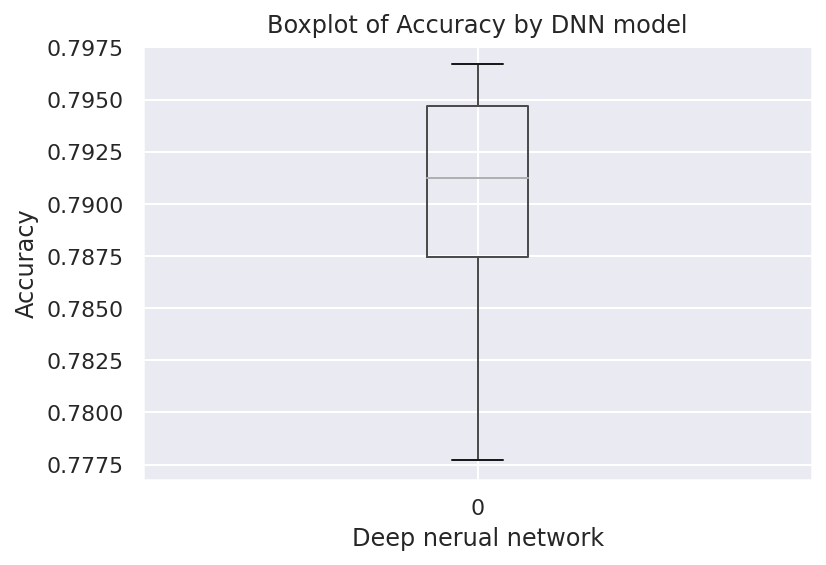

In [ ]:
ACC_NN = pd.DataFrame(acc_NN_stack)
ACC_NN.boxplot()
plt.title("Boxplot of Accuracy by DNN model")
plt.xlabel('Deep nerual network')
plt.ylabel('Accuracy')

In [ ]:
results = pd.DataFrame()
results['randomForest'] = ACC_RF
results['NeuralNetwork'] = ACC_NN

In [ ]:
results

,randomForest,NeuralNetwork
0,0.77,0.79
1,0.78,0.80
2,0.78,0.79
3,0.76,0.80
4,0.78,0.79
5,0.78,0.79
6,0.77,0.80
7,0.76,0.78
8,0.78,0.79
9,0.77,0.78


In [ ]:
joblib.dump(results,'test_results_10.pkl')

['test_results_10.pkl']

In [ ]:
results = joblib.load('/content/drive/MyDrive/A1/test_results_10.pkl')

### 3.2.4 Boxplot of two models in comparison

> Note: Since those ploting functions are too simple. We don't bother to write another function to do this job uniformly. Because it will just add more difficultly on reading the following results.

Text(0.5, 1.0, 'Boxplot of Accuracy between Randomforest and DNN')

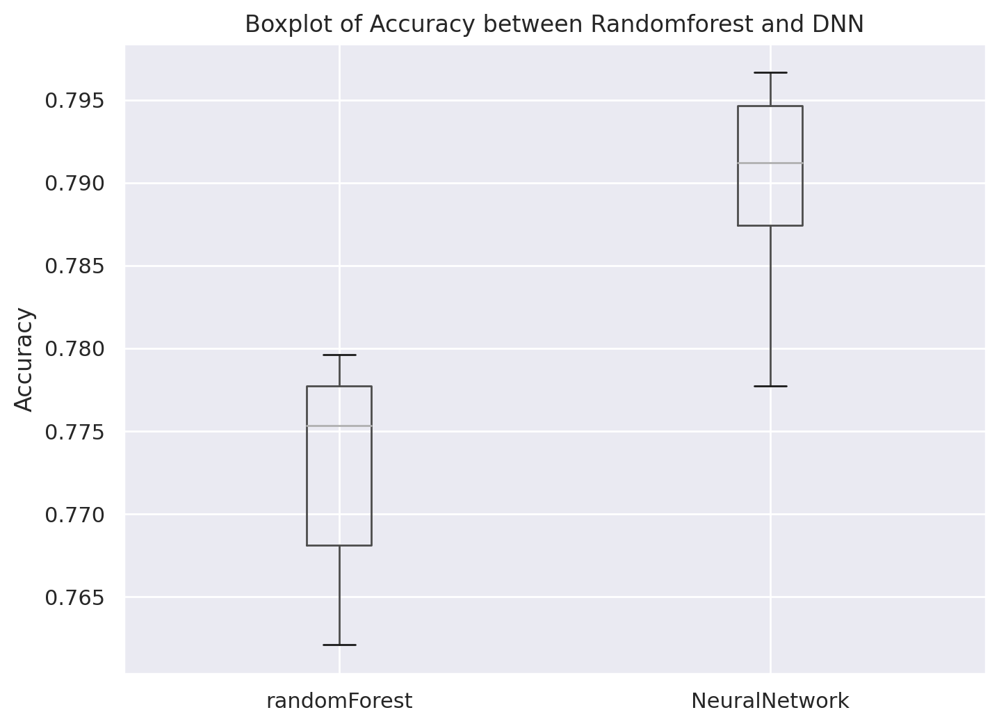

In [ ]:
figure(figsize=(8, 6), dpi=100)
results.boxplot()
plt.ylabel('Accuracy')
plt.title('Boxplot of Accuracy between Randomforest and DNN')

Text(0.5, 1.0, 'Boxplot of Accuracy between Randomforest and DNN')

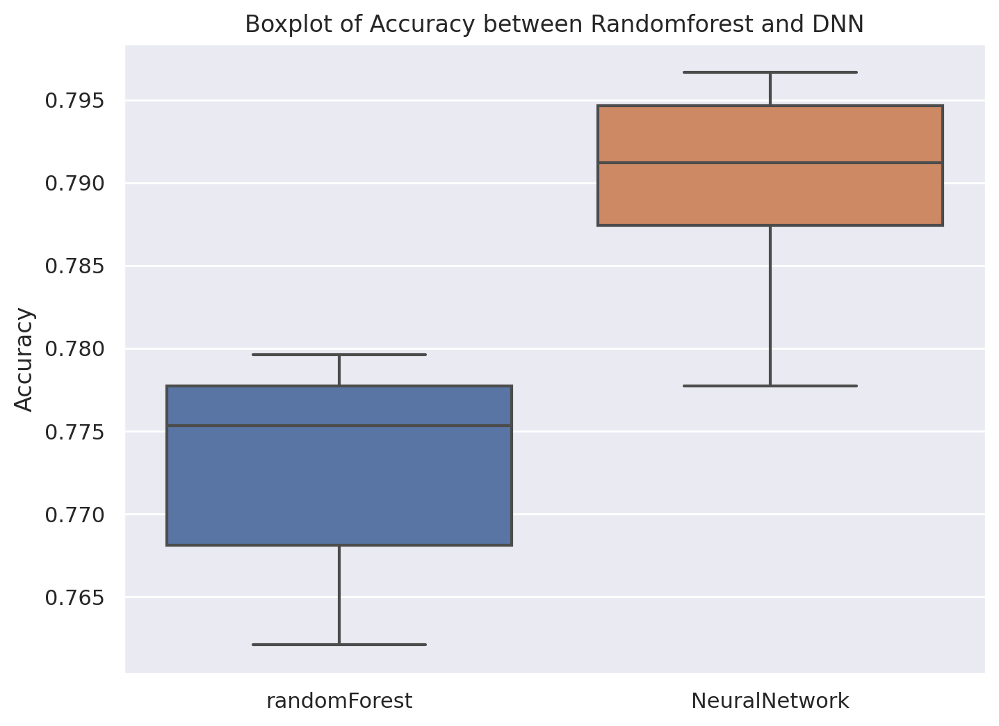

In [ ]:
figure(figsize=(8, 6), dpi=100)
ax = sns.boxplot(data=results)
plt.ylabel('Accuracy')
plt.title('Boxplot of Accuracy between Randomforest and DNN')

### 3.2.5 statistical significance test with Kolmogorov-Smirnov statistic

First, let's what our results' distributions look like.
We would like to find our whether they are normal distributions.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fb2cdb78190>,
      dtype=object)

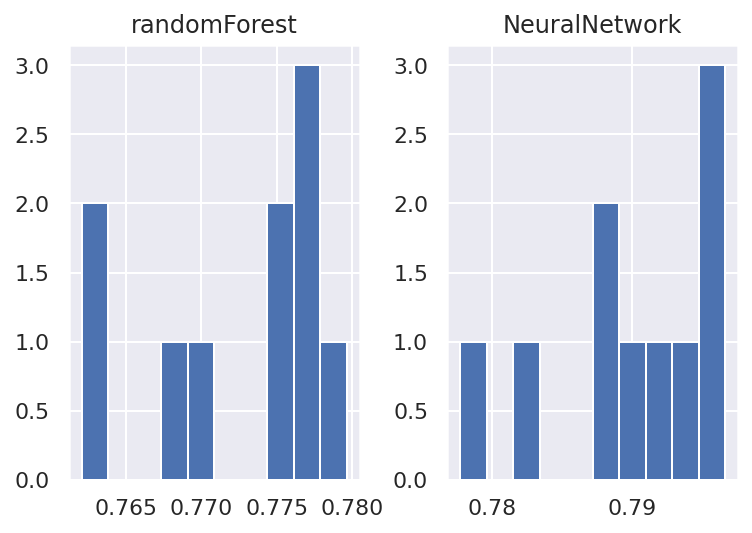

In [ ]:
results.hist()

From the above image, we can clearly see that they are not normal distribution.

Hence We can not use t-test.
For nonparameteric distribution, we use  Kolmogorov-Smirnov statistic test.

In [ ]:
from scipy.stats import ks_2samp
def ks_2samp_test(data, param1='randomForest', param2='NeuralNetwork'):
	max_print_out(True)
	value, pvalue = ks_2samp(data[param1].values,data[param2].values)
	print(value, pvalue)
	if pvalue > 0.05:
		print('Samples are likely drawn from the same distributions (fail to reject H0)')
	else:
		print(' Samples are likely drawn from different distributions (reject H0)')

In [ ]:
ks_2samp_test(results, 'randomForest', 'NeuralNetwork')

0.9 0.00021650176448938054
Samples are likely drawn from different distributions (reject H0)


### 3.2.6 Discussion
From above results, p-value = 0.0002 <<  0.005.

We can say that according to accuracy, our Nerual Network is much better than random forest model. Since, DNN is specailly good at small size of dataset.




***However, we don't want to stop here. Instead of accuracy, we would like also to do test on f1 score, precision and recall score. Let's write a function to do so.***


In [ ]:
def test_scores_on_two_models(test_loader, pred_1, pred_2, function, type = 'Accuracy'):
  RF_score = []
  NN_score = []
  for i in range(10):
    RF_score.append(function(test_loader[i].dataset.y.numpy(), pred_1[i]))
    NN_score.append(function(test_loader[i].dataset.y.numpy(), pred_2[i]))

  results = pd.DataFrame()
  results['randomForest'] = RF_score
  results['NeuralNetwork'] = NN_score

  figure(figsize=(8, 6), dpi=100)
  ax = sns.boxplot(data=results)
  plt.ylabel(str(type))
  plt.title('Boxplot of '+ str(type)+ 'between Randomforest and DNN')
  ks_2samp_test(results, 'randomForest', 'NeuralNetwork')
  return RF_score, NN_score

In [ ]:
from scipy.stats import ks_2samp
def ks_2samp_test(data, param1='randomForest', param2='NeuralNetwork'):
	max_print_out(True)
	value, pvalue = ks_2samp(data[param1].values,data[param2].values)
	print("##################### p-value = ", pvalue, "####################")
	if pvalue > 0.05:
		print('Samples are likely drawn from the same distributions (fail to reject H0)')
	else:
		print('##################### Samples are likely drawn from different distributions (reject H0)####################')

##################### p-value =  0.00021650176448938054 ####################
##################### Samples are likely drawn from different distributions (reject H0)####################


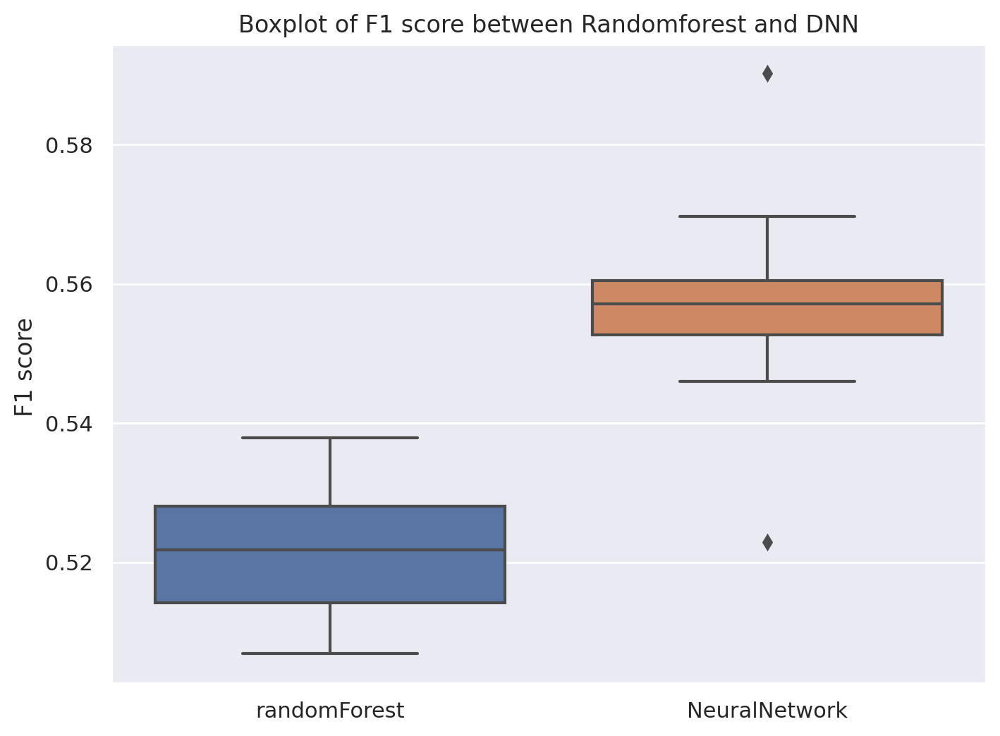

In [ ]:
f1_RF_score, f1_NN_score = test_scores_on_two_models(test_loader ,RF_prediction, prediction_NN , f1_score, 'F1 score ')

##################### p-value =  0.002056766762649115 ####################
##################### Samples are likely drawn from different distributions (reject H0)####################


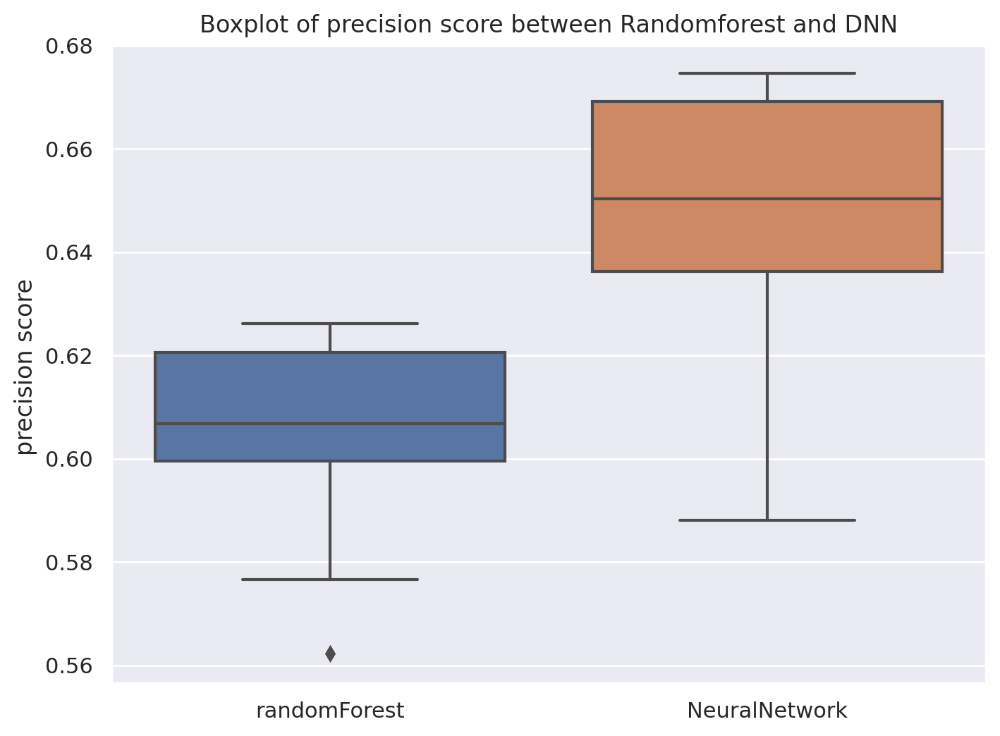

In [ ]:
from sklearn.metrics import precision_score
percision_RF_score, percision_NN_score = test_scores_on_two_models(test_loader ,RF_prediction, prediction_NN , precision_score, 'precision score ')

##################### p-value =  0.012340600575894691 ####################
##################### Samples are likely drawn from different distributions (reject H0)####################


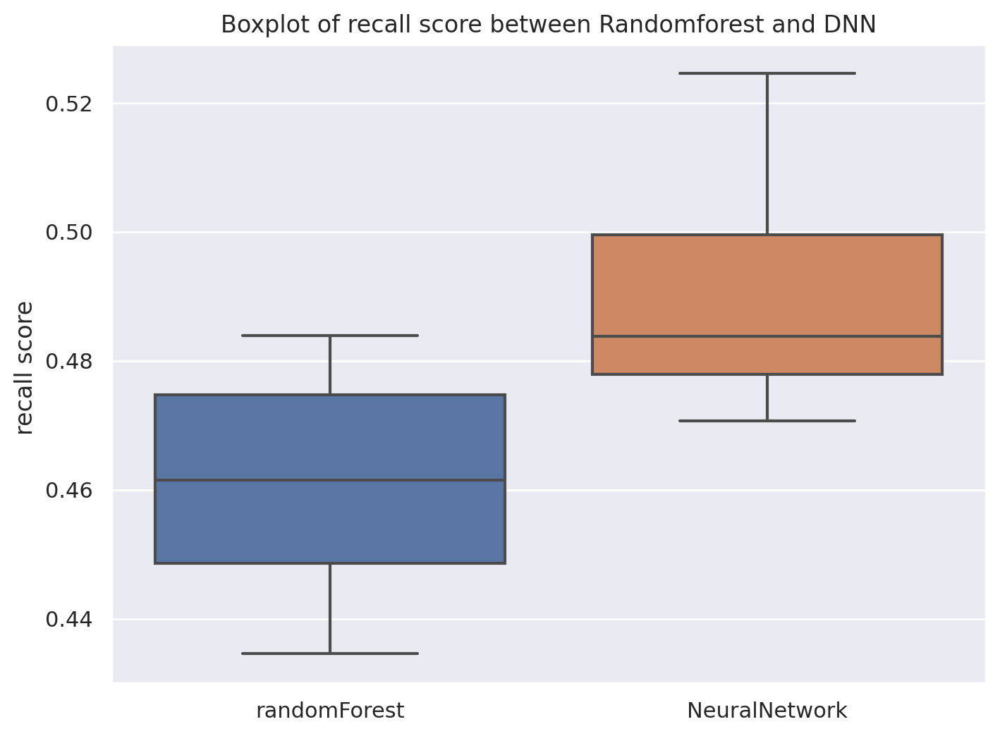

In [ ]:
from sklearn.metrics import recall_score
recall_RF_score, recall_NN_score = test_scores_on_two_models(test_loader ,RF_prediction, prediction_NN , recall_score, 'recall score ')

In [ ]:
from sklearn.metrics import recall_score
percision_RF_score, percision_NN_score = test_scores_on_two_models(test_loader ,RF_prediction, prediction_NN , recall_score, 'recall score ')

### 3.2.7 Final conclusion
We can see that in Accuracy, F1 score, precision score, and recall score. 

Deep neural network is out performed than Randomforest in every way. And significant test reject every H0 in every type of scores.


Therefore, we have our conclusion, Neural network's performance is different than random forest's. And DNN is better.


# Task 4. Concept Drift

Install scikit-multiflow

In [ ]:
!pip install scikit-multiflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 30.8 MB/s 


In [ ]:
raw_data_copy = raw_data.copy()
converted_data = whole_features_remain_pipeline.fit_transform(raw_data_copy)

In [ ]:
converted_data.head()

,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,...,MonthlyCharges,TotalCharges,Bank transfer (automatic),Credit card (automatic),Electronic Check,Mailed Check,Female,Male,Tenure,Churn
0,0,1,1,1,1,0,0,0,0,0,...,65.6,593.3,0,0,1,0,1,0,4562,0
1,0,0,0,1,0,0,0,0,0,0,...,59.9,542.4,0,0,0,1,0,1,4562,0
2,0,0,0,1,1,0,0,0,0,0,...,73.9,280.85,0,1,0,0,0,1,4562,1
3,1,1,0,1,1,0,0,0,0,0,...,98.0,1237.85,0,1,0,0,0,1,4561,1
4,1,1,0,1,1,1,1,0,0,0,...,83.9,267.4,0,0,1,0,1,0,4560,1


Before we plot our data, we already know it will plot with 8 ticks by the experiments I did.
And use train set size is a bad idea as x label to plot stream data graph.


We want our xlabel to be a time.

So we take those 8 ticks and retrevie exact date string from the original dataset's Date.

In [ ]:
date_remain = raw_data.copy()

First we delete all Nan instance from the orignial data set.

In [ ]:
# purge NaN instances
date_remain = raw_data.copy()
Nan_df = date_remain[date_remain.isna().any(axis=1)]  
date_remain = date_remain.drop(Nan_df.index)
date_remain.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7032 entries, 0 to 7042
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7032 non-null   string 
 1   gender            7032 non-null   string 
 2   SeniorCitizen     7032 non-null   Int64  
 3   Partner           7032 non-null   string 
 4   Dependents        7032 non-null   string 
 5   PhoneService      7032 non-null   string 
 6   InternetService   7032 non-null   string 
 7   OnlineSecurity    7032 non-null   string 
 8   OnlineBackup      7032 non-null   string 
 9   DeviceProtection  7032 non-null   string 
 10  TechSupport       7032 non-null   string 
 11  StreamingTV       7032 non-null   string 
 12  StreamingMovies   7032 non-null   string 
 13  Contract          7032 non-null   string 
 14  PaperlessBilling  7032 non-null   string 
 15  PaymentMethod     7032 non-null   string 
 16  MonthlyCharges    7032 non-null   Float64


We get our Date as string from the orignial dataset with every 1000 instances.

In [ ]:
date_labels = []
for i in range(8):
  date_labels.append(date_remain['Date'].iloc[i * 1000])

In [ ]:
date_labels

['01 Jan, 2010',
 '15 Aug, 2011',
 '13 Mar, 2013',
 '10 Oct, 2014',
 '21 Apr, 2016',
 '07 Nov, 2017',
 '30 May, 2019',
 '14 Dec, 2020']

Now we crate a label array to save those self defined ticks.

In [ ]:
labels = ['01 Jan, 2010',
 '13 Aug, 2011',
 '11 Mar, 2013',
 '05 Oct, 2014',
 '15 Apr, 2016',
 '02 Nov, 2017',
 '19 May, 2019',
 '10 Dec, 2020']

Now, we create a function to draw the stream data map and do the ADWIN concept detection after the plotting. 

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

# Import ADWIN
from skmultiflow.drift_detection import ADWIN

# fig, ax = plt.subplots(23,1)

#-------------------plot_stream_data-------------------

def plot_stream_data(converted_data):
  """
  plot our stream data and use ADWIN to detect changes and print the time stamp

  Args:
  converted_data (already converted data from original dataset)

  Return:
  return the detected features with concept drift 
  """
  detected_features = []

  # get the data set has original Date string column
  date_remain = raw_data.copy()
  Nan_df = date_remain[date_remain.isna().any(axis=1)]  
  date_remain = date_remain.drop(Nan_df.index)
  # for loop on detecting all features 
  for j in range(len(converted_data.columns)):
    print("##############################")
    print("#######", converted_data.columns[j], "#######################")
    drift_stream = converted_data.values[:,j].astype(float)
    plt.figure(figsize=(30, 5))
    # plot stream graph
    plt.plot(drift_stream)
    labels = ['01 Jan, 2010',
            '13 Aug, 2011',
            '11 Mar, 2013',
            '05 Oct, 2014',
            '15 Apr, 2016',
            '02 Nov, 2017',
            '19 May, 2019',
            '10 Dec, 2020']
    # matplot settings 
    plt.xticks(ticks = np.linspace(0, len(drift_stream), 8) ,labels = labels, rotation = 'horizontal')
    plt.title("Concept Drift detection on feature " + str(converted_data.columns[j]) )
    plt.xlabel(str(converted_data.columns[j]))
    plt.pause(0.05)
    # instantiate ADWIN object 
    adwin = ADWIN()
    drift_detection = 0
    # for each data point in stream 
    for i in range(drift_stream.size):
        # add a new point to adwin object
        adwin.add_element(drift_stream[i])
        # if adwin detects change, print at what point in the stream 
        # the change was detected
        if adwin.detected_change():
          drift_detection += 1
          print('Change detected at index {}'.format(date_remain['Date'].iloc[i]))

    if drift_detection == 0:
      print("############## NO CONCEPT DRIFT DETECTED!###########")
    else:
        detected_features.append(converted_data.columns[j])

  return detected_features

***This function are meant to draw our gaph in the most longest x-axis size to show more details about it. It may present differ in different devices. But the main idea is to make it long and clear.***

Now, let's draw all features stream data plotting and do the ADWIN detection.

We ignore Tenure feature for now, since we already know it's a continuous feature growing by time and train size. It must have a lot of changes. It is useless if we do the ADWIN on this feature.

##############################
####### SeniorCitizen #######################


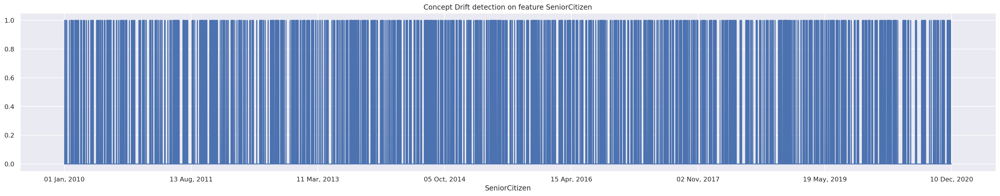

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### Partner #######################


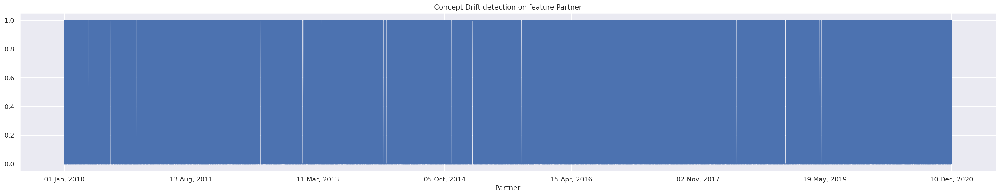

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### Dependents #######################


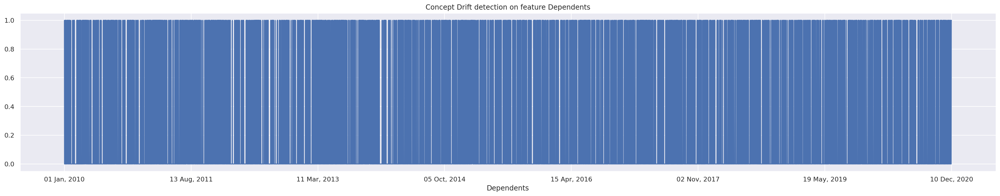

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### PhoneService #######################


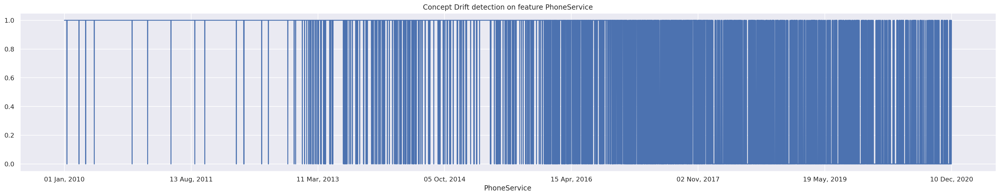

Change detected at index 26 Jul, 2013
Change detected at index 17 Aug, 2013
Change detected at index 22 Nov, 2013
Change detected at index 25 Dec, 2013
Change detected at index 24 Apr, 2014
Change detected at index 20 Nov, 2014
Change detected at index 31 Mar, 2016
Change detected at index 21 Apr, 2016
Change detected at index 03 Jul, 2016
Change detected at index 11 Aug, 2016
Change detected at index 17 Feb, 2017
Change detected at index 08 Mar, 2017
Change detected at index 09 Apr, 2017
Change detected at index 14 Sep, 2017
Change detected at index 18 Jan, 2018
Change detected at index 09 Jul, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 29 Dec, 2019
##############################
####### InternetService #######################


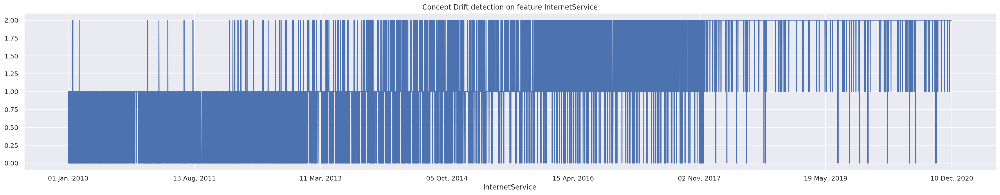

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 22 Nov, 2013
Change detected at index 27 Jan, 2014
Change detected at index 11 Jun, 2014
Change detected at index 30 Aug, 2015
Change detected at index 25 Jan, 2016
Change detected at index 21 Apr, 2016
Change detected at index 27 Aug, 2016
Change detected at index 08 Mar, 2017
Change detected at index 09 Apr, 2017
Change detected at index 18 Jan, 2018
Change detected at index 20 Mar, 2018
Change detected at index 22 Sep, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 29 Dec, 2019
##############################
####### OnlineSecurity #######################


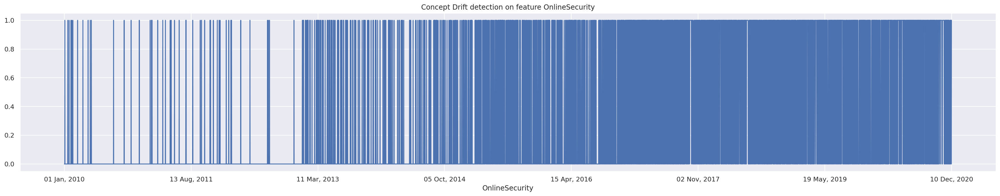

Change detected at index 19 Jun, 2013
Change detected at index 26 Jul, 2013
Change detected at index 08 Dec, 2013
Change detected at index 20 Nov, 2014
Change detected at index 16 Jun, 2015
Change detected at index 25 Jan, 2016
Change detected at index 08 May, 2016
Change detected at index 15 Jun, 2016
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 17 Oct, 2017
Change detected at index 02 Nov, 2017
Change detected at index 14 Dec, 2017
Change detected at index 16 Mar, 2019
##############################
####### OnlineBackup #######################


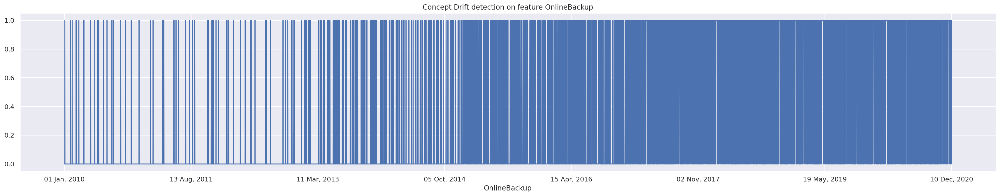

Change detected at index 08 Dec, 2013
Change detected at index 10 Jan, 2014
Change detected at index 02 Apr, 2014
Change detected at index 20 Nov, 2014
Change detected at index 09 Dec, 2014
Change detected at index 21 Mar, 2015
Change detected at index 15 May, 2015
Change detected at index 25 Jul, 2015
Change detected at index 30 Aug, 2015
Change detected at index 15 Jun, 2016
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 09 Aug, 2017
Change detected at index 31 Dec, 2017
Change detected at index 18 Jan, 2018
Change detected at index 10 Apr, 2018
Change detected at index 09 Jul, 2018
##############################
####### DeviceProtection #######################


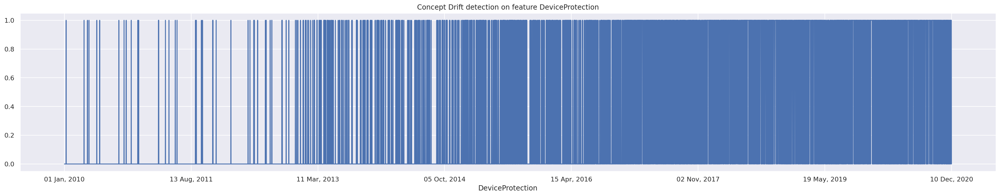

Change detected at index 05 Jul, 2013
Change detected at index 12 Sep, 2013
Change detected at index 22 Nov, 2013
Change detected at index 25 Dec, 2013
Change detected at index 18 Jul, 2014
Change detected at index 20 Nov, 2014
Change detected at index 29 Apr, 2015
Change detected at index 30 Aug, 2015
Change detected at index 25 Jan, 2016
Change detected at index 06 Nov, 2016
Change detected at index 31 Jan, 2017
Change detected at index 14 May, 2017
Change detected at index 20 Jul, 2017
Change detected at index 14 Sep, 2017
Change detected at index 02 Nov, 2017
Change detected at index 14 Feb, 2018
Change detected at index 15 Jan, 2019
##############################
####### TechSupport #######################


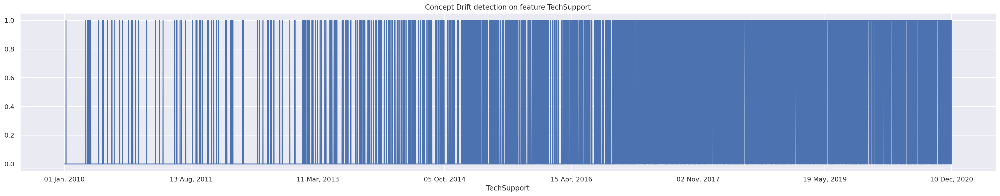

Change detected at index 10 Jan, 2014
Change detected at index 27 May, 2014
Change detected at index 18 Jul, 2014
Change detected at index 20 Nov, 2014
Change detected at index 17 Feb, 2015
Change detected at index 07 Apr, 2015
Change detected at index 11 Aug, 2015
Change detected at index 30 Aug, 2015
Change detected at index 30 Nov, 2015
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 14 May, 2017
Change detected at index 25 Aug, 2017
Change detected at index 17 Oct, 2017
Change detected at index 02 Nov, 2017
Change detected at index 15 Jan, 2019
##############################
####### StreamingTV #######################


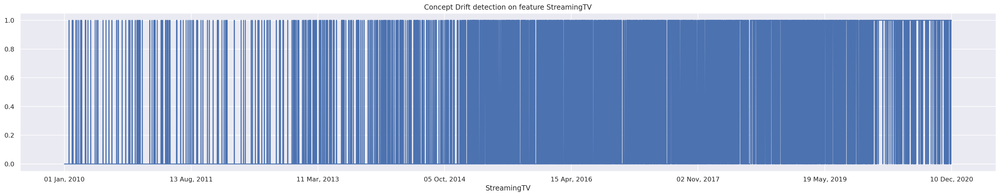

Change detected at index 25 Dec, 2013
Change detected at index 24 Apr, 2014
Change detected at index 27 Jun, 2014
Change detected at index 20 Nov, 2014
Change detected at index 16 Jun, 2015
Change detected at index 30 Aug, 2015
Change detected at index 10 Oct, 2015
Change detected at index 25 Jan, 2016
Change detected at index 31 Mar, 2016
Change detected at index 31 Jan, 2017
Change detected at index 05 Nov, 2018
Change detected at index 15 Jan, 2019
Change detected at index 28 Feb, 2019
Change detected at index 04 Feb, 2020
Change detected at index 12 May, 2020
Change detected at index 17 Aug, 2020
Change detected at index 12 Oct, 2020
##############################
####### StreamingMovies #######################


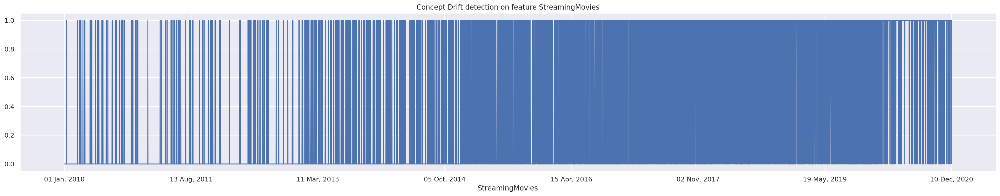

Change detected at index 22 Nov, 2013
Change detected at index 08 Dec, 2013
Change detected at index 15 Feb, 2014
Change detected at index 27 Jun, 2014
Change detected at index 20 Nov, 2014
Change detected at index 07 Apr, 2015
Change detected at index 03 Jun, 2015
Change detected at index 30 Aug, 2015
Change detected at index 25 Jan, 2016
Change detected at index 06 Nov, 2016
Change detected at index 14 May, 2017
Change detected at index 26 May, 2018
Change detected at index 22 Sep, 2018
Change detected at index 05 Nov, 2018
Change detected at index 15 Jan, 2019
Change detected at index 16 Aug, 2019
Change detected at index 16 Mar, 2020
Change detected at index 10 Jul, 2020
Change detected at index 18 Nov, 2020
##############################
####### Contract #######################


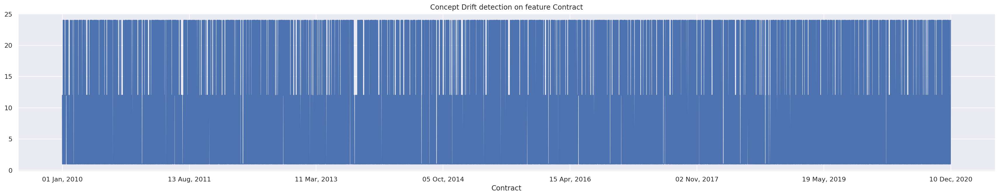

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### PaperlessBilling #######################


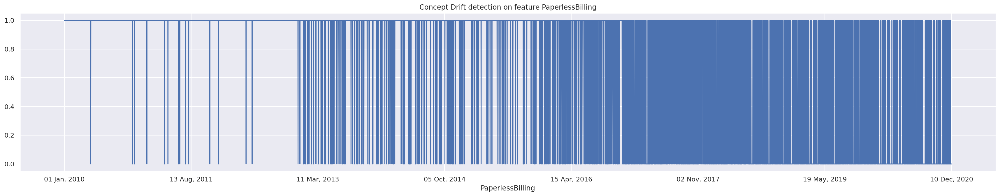

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 22 Nov, 2013
Change detected at index 25 Dec, 2013
Change detected at index 05 Mar, 2014
Change detected at index 20 Nov, 2014
Change detected at index 21 Apr, 2016
Change detected at index 31 Jan, 2017
Change detected at index 24 Mar, 2017
Change detected at index 26 Apr, 2017
Change detected at index 29 May, 2017
Change detected at index 16 Jun, 2017
Change detected at index 17 Oct, 2017
Change detected at index 02 Nov, 2017
Change detected at index 20 Mar, 2018
Change detected at index 17 May, 2019
Change detected at index 16 Jan, 2020
Change detected at index 19 Jun, 2020
##############################
####### MonthlyCharges #######################


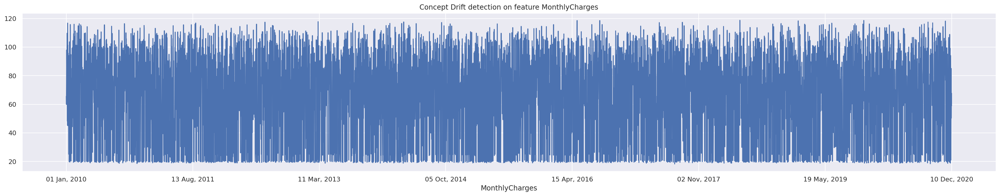

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### TotalCharges #######################


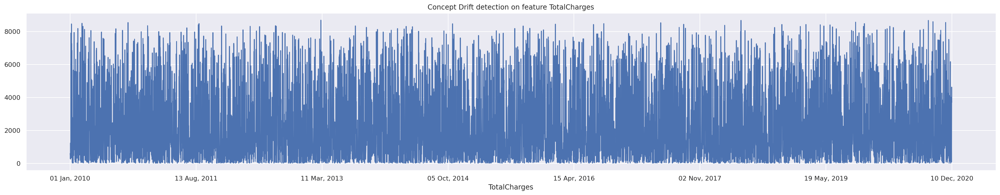

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### Bank transfer (automatic) #######################


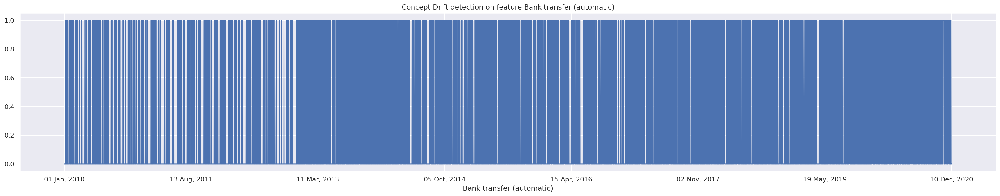

Change detected at index 20 Nov, 2014
Change detected at index 06 Feb, 2016
Change detected at index 09 Apr, 2017
Change detected at index 27 Feb, 2018
Change detected at index 24 Apr, 2020
Change detected at index 27 May, 2020
Change detected at index 19 Jun, 2020
##############################
####### Credit card (automatic) #######################


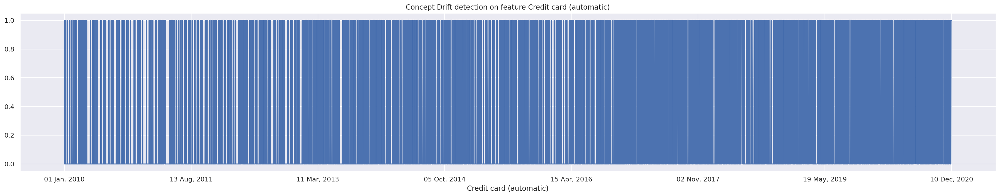

Change detected at index 22 Nov, 2013
Change detected at index 27 May, 2014
Change detected at index 06 Nov, 2014
Change detected at index 09 Dec, 2014
Change detected at index 16 Jun, 2017
Change detected at index 26 May, 2018
Change detected at index 16 Apr, 2019
Change detected at index 04 Feb, 2020
Change detected at index 27 May, 2020
##############################
####### Electronic Check #######################


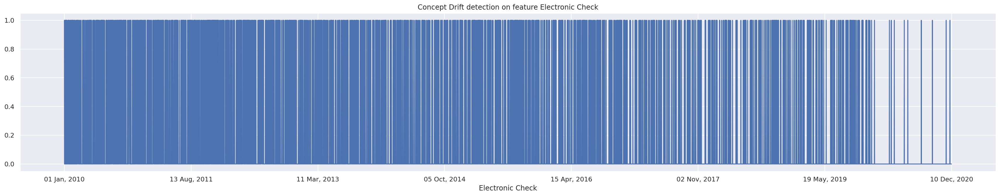

Change detected at index 20 Nov, 2014
Change detected at index 24 Mar, 2017
Change detected at index 30 Sep, 2017
Change detected at index 27 Feb, 2018
Change detected at index 16 Aug, 2019
Change detected at index 28 Feb, 2020
Change detected at index 27 May, 2020
##############################
####### Mailed Check #######################


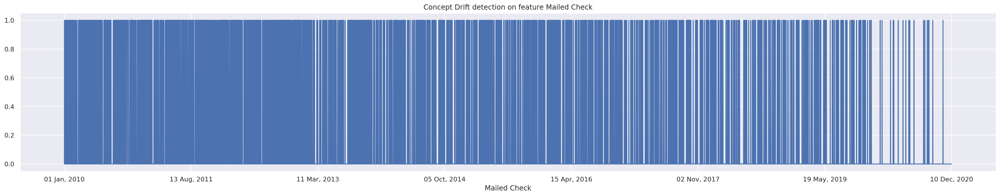

Change detected at index 30 Aug, 2015
Change detected at index 31 Mar, 2016
Change detected at index 09 Apr, 2017
Change detected at index 09 Jul, 2018
Change detected at index 30 Mar, 2020
Change detected at index 27 May, 2020
##############################
####### Female #######################


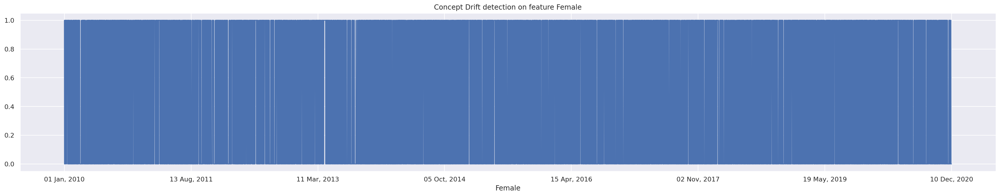

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### Male #######################


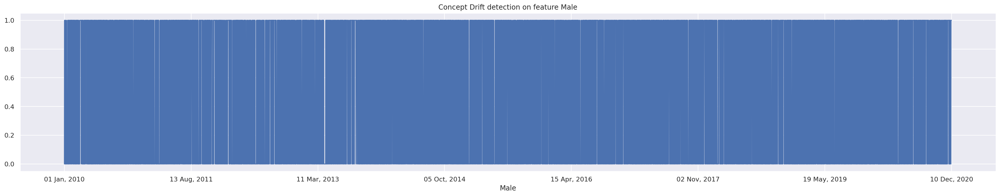

############## NO CONCEPT DRIFT DETECTED!###########
##############################
####### Churn #######################


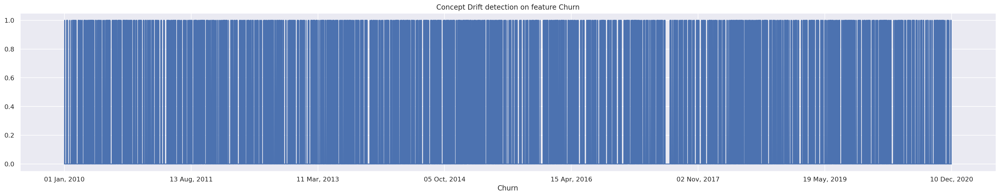

############## NO CONCEPT DRIFT DETECTED!###########


In [ ]:
detected_features = plot_stream_data(converted_data.drop('Tenure',axis=1))
# there more than 20 plots in one line code
# scroll this section's output for more details

Let's take a look at which features has been detected with concept drift.

In [ ]:
detected_features

['PhoneService',
 'InternetService',
 'OnlineSecurity',
 'OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies',
 'PaperlessBilling',
 'Bank transfer (automatic)',
 'Credit card (automatic)',
 'Electronic Check',
 'Mailed Check']

That's quite a lot of features. 

First, we take a look at Phone Service and InternetService.

##### ***1. Phone Service***

##############################
####### PhoneService #######################


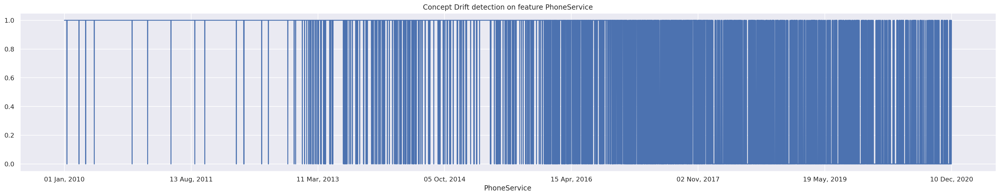

Change detected at index 26 Jul, 2013
Change detected at index 17 Aug, 2013
Change detected at index 22 Nov, 2013
Change detected at index 25 Dec, 2013
Change detected at index 24 Apr, 2014
Change detected at index 20 Nov, 2014
Change detected at index 31 Mar, 2016
Change detected at index 21 Apr, 2016
Change detected at index 03 Jul, 2016
Change detected at index 11 Aug, 2016
Change detected at index 17 Feb, 2017
Change detected at index 08 Mar, 2017
Change detected at index 09 Apr, 2017
Change detected at index 14 Sep, 2017
Change detected at index 18 Jan, 2018
Change detected at index 09 Jul, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 29 Dec, 2019


In [ ]:
detected_features = plot_stream_data(converted_data.loc[:, ['PhoneService']])

We can see that before Jul, 2013. Most of customers will choose to use phone service, and very a few of them will not. 
Since we observed that there is a blue line around y = 1 as YES, which means too many instances who choose YES, they form a line.

Things changed after July, 2013. People were starting to choose not to use phone servie, I would say this is a sign of ***Gradual drift - a new concept gradually replace an old one over a period of time***, and the things happened after Aug, 2016 confirms our assumption.


We can see that after Aug, 2016. More and more people are choosing not to use phone service, so that the distribution of not using phone service and using phone service become almost equivalent. 

And things started to change after Dec 2019, we can see a few gaps here, and if we take a close look, those gaps' values is lay on y = 0, as NO. 
People are more likely to choose not to use phone service after 2019. This is a new concept that never happened before.

And after Dec 2019, there is a chance we are observing ***Recurring drift - the old concept may reoccur after some time***

However, in our dataset, we can not see a clear stage that the people who don't want the phone service take control of the graph. But our dataset stops at 2020.

Now, in 2022, in my opinion, thanks to the development of Internet, people are more like to using text and radio chat than using phones.
Will this new concept takes control of phone service, we will see in a few years later.

In summary, we can see that there is indeed a concept drift in feature PHONESERVIE. And the behavious is people are more likely to not use phone service.

Since the changing of phone service is not very clear and if we separate our dataset from 2010 to 2013 and 2013 to 2020. The first part will contain too few instances. 

Due to that reason, we can just let model train from the begining to the end. Let model itself to adapt this changing.

##### ***2. Internet Service:***

Now, we take a close look at Internet Service, this concept drift is more clear than phone service.

##############################
####### InternetService #######################


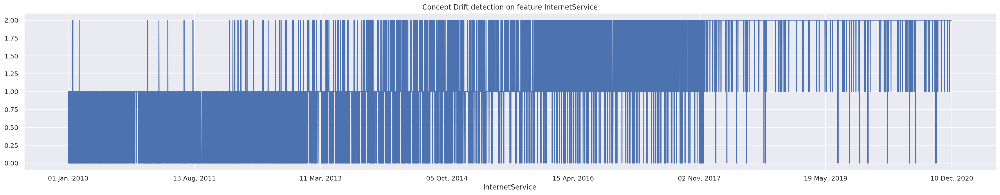

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 22 Nov, 2013
Change detected at index 27 Jan, 2014
Change detected at index 11 Jun, 2014
Change detected at index 30 Aug, 2015
Change detected at index 25 Jan, 2016
Change detected at index 21 Apr, 2016
Change detected at index 27 Aug, 2016
Change detected at index 08 Mar, 2017
Change detected at index 09 Apr, 2017
Change detected at index 18 Jan, 2018
Change detected at index 20 Mar, 2018
Change detected at index 22 Sep, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 29 Dec, 2019


In [ ]:
detected_features = plot_stream_data(converted_data.loc[:, ['InternetService']])

Although we only have 3 kinds of values in Internet service.
This is still a very clear type of ***Incremental drift - the old concept incrementally changes to new concept***
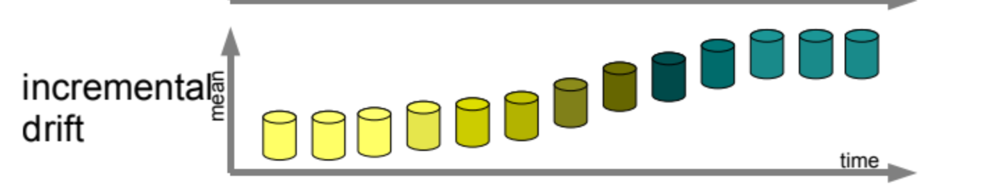

From tutorial 9, [stream data](https://dal.brightspace.com/d2l/le/content/221741/Home?itemIdentifier=TOC)

> Value 0 : No internet Service
> <br> Value 1: DSL internet Service<br>
> Value 2: Fiber optic internet Service

We can see that before 2013, almost no people are using Interent service, as a old concept. 

And during the year 2013 to 2014, we can see that more and more people are chosesing to use DSL for their internet. (There is a new concept here)

After 2014 to 2017, very few people choose to not use Internet service, we can see this is an increment already. And people are choosing both Fiber optic and DSL as their internet choice,

After 2017 we can see that almost everyone choose Fiber optic, a few them choose DSL, and even less who choose not to use internet service.



Base on those conditions, I suggest we divide our dataset into two pieces.
The first one is the period that people don't use internet service at all. From 2010 to 2013. Although it still too few instances for first part of dataset. 

This time, the trends are pretty clear. We can use DNN to minimize the problem with small size of dataset.

##### ***3. OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport,StreamingTV, StreamingMovies***


We take a look at Online Security first.

##############################
####### OnlineSecurity #######################


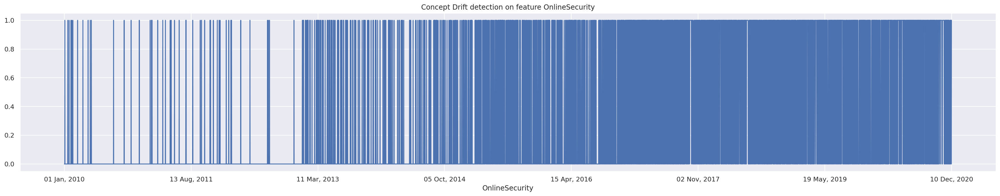

Change detected at index 19 Jun, 2013
Change detected at index 26 Jul, 2013
Change detected at index 08 Dec, 2013
Change detected at index 20 Nov, 2014
Change detected at index 16 Jun, 2015
Change detected at index 25 Jan, 2016
Change detected at index 08 May, 2016
Change detected at index 15 Jun, 2016
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 17 Oct, 2017
Change detected at index 02 Nov, 2017
Change detected at index 14 Dec, 2017
Change detected at index 16 Mar, 2019


In [ ]:
detected_features = plot_stream_data(converted_data.loc[:, ['OnlineSecurity']])

In our dataset, we manage with Yes to 1, No = 0 and No internet service also = 0.

Hence, the changes we are observing are the same with previous one.

Now, let's change our setting to another set up, with Yes = 1, No = 0, No internet service = -1.

***I already update this setting in our pipeline functions, we will not doing so here.***

In [ ]:
# generate a new data set with the setting we talked before
raw_data_copy = raw_data.copy()
converted_data_remain_internet_service_option = remain_internet_service_option.fit_transform(raw_data_copy)

##############################
####### OnlineSecurity #######################


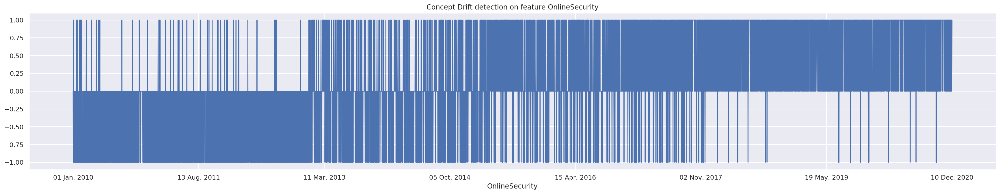

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 26 Jul, 2013
Change detected at index 22 Nov, 2013
Change detected at index 27 Jan, 2014
Change detected at index 27 Oct, 2015
Change detected at index 06 Feb, 2016
Change detected at index 15 Jun, 2016
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 02 Nov, 2017
Change detected at index 18 Jan, 2018
Change detected at index 27 Feb, 2018
Change detected at index 05 Nov, 2018


In [ ]:
detected_features = plot_stream_data(converted_data_remain_internet_service_option.loc[:, ['OnlineSecurity']])

We can find the same pattern with Internet Service. But a little bit difference at the end. People are more and more using Online security, but this concept has not taken over yet.

Now we see the rest of them in a row.

##############################
####### OnlineBackup #######################


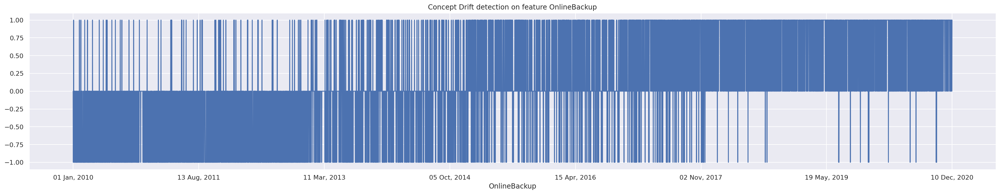

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 04 Nov, 2013
Change detected at index 22 Nov, 2013
Change detected at index 10 Jan, 2014
Change detected at index 24 Apr, 2014
Change detected at index 30 Aug, 2015
Change detected at index 27 Oct, 2015
Change detected at index 30 May, 2016
Change detected at index 06 Nov, 2016
Change detected at index 08 Mar, 2017
Change detected at index 18 Jan, 2018
Change detected at index 27 Feb, 2018
Change detected at index 28 Apr, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 06 Sep, 2020
##############################
####### DeviceProtection #######################


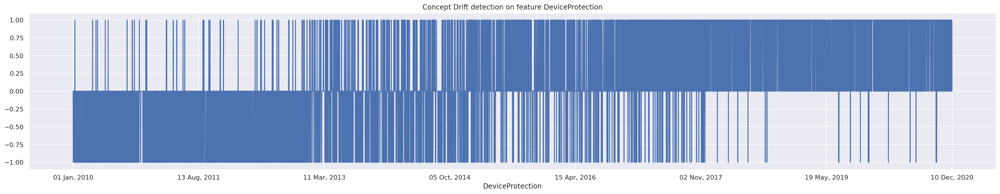

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 05 Jul, 2013
Change detected at index 22 Nov, 2013
Change detected at index 08 Dec, 2013
Change detected at index 02 Apr, 2014
Change detected at index 30 Aug, 2015
Change detected at index 14 Dec, 2015
Change detected at index 30 May, 2016
Change detected at index 06 Nov, 2016
Change detected at index 14 May, 2017
Change detected at index 02 Nov, 2017
Change detected at index 20 Mar, 2018
Change detected at index 26 May, 2018
Change detected at index 05 Nov, 2018
Change detected at index 29 Dec, 2018
##############################
####### TechSupport #######################


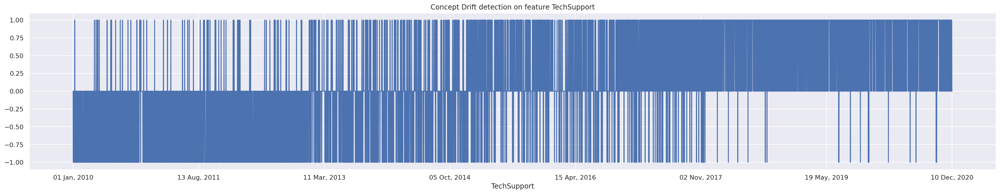

Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 16 Oct, 2013
Change detected at index 22 Nov, 2013
Change detected at index 27 Jan, 2014
Change detected at index 27 May, 2014
Change detected at index 30 Aug, 2015
Change detected at index 30 Nov, 2015
Change detected at index 15 Jun, 2016
Change detected at index 06 Nov, 2016
Change detected at index 09 Apr, 2017
Change detected at index 17 Oct, 2017
Change detected at index 14 Feb, 2018
Change detected at index 28 Apr, 2018
Change detected at index 05 Nov, 2018
##############################
####### StreamingTV #######################


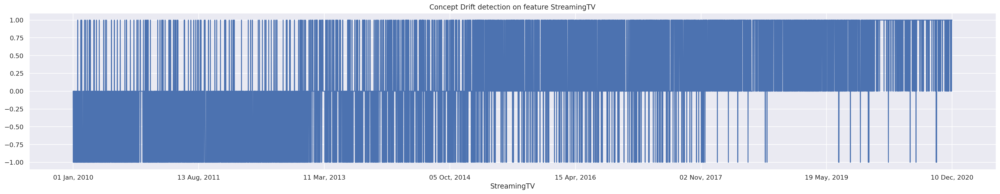

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 05 Jul, 2013
Change detected at index 26 Jul, 2013
Change detected at index 22 Nov, 2013
Change detected at index 10 Jan, 2014
Change detected at index 18 Jul, 2014
Change detected at index 30 Aug, 2015
Change detected at index 11 Nov, 2015
Change detected at index 25 Jan, 2016
Change detected at index 06 Nov, 2016
Change detected at index 24 Nov, 2016
Change detected at index 18 Aug, 2018
Change detected at index 15 Jan, 2019
Change detected at index 28 Feb, 2019
Change detected at index 04 Apr, 2019
Change detected at index 21 Oct, 2019
Change detected at index 16 Jan, 2020
Change detected at index 10 Jul, 2020
Change detected at index 17 Dec, 2020
##############################
####### StreamingMovies #######################


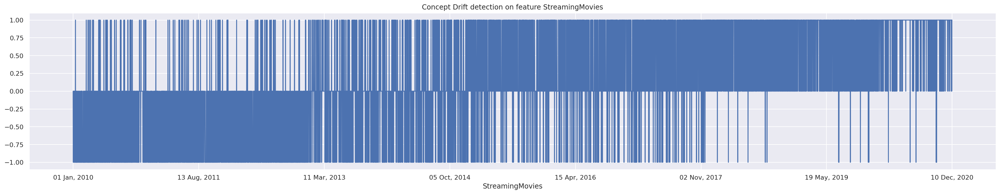

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 05 Jul, 2013
Change detected at index 22 Nov, 2013
Change detected at index 10 Jan, 2014
Change detected at index 02 Apr, 2014
Change detected at index 30 Aug, 2015
Change detected at index 27 Oct, 2015
Change detected at index 06 Feb, 2016
Change detected at index 06 Nov, 2016
Change detected at index 08 Mar, 2017
Change detected at index 18 Aug, 2018
Change detected at index 05 Nov, 2018
Change detected at index 02 May, 2019
Change detected at index 16 Aug, 2019
Change detected at index 28 Feb, 2020
Change detected at index 30 Jul, 2020


In [ ]:
detected_features = plot_stream_data(converted_data_remain_internet_service_option.loc[:, ['OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies']])


Their bahaviours are simialr and they are incremental drift in my opinion.

So my decision is the same, we separate our data set with one from 2010 to 2013 and the other with 2013 to 2020.

#### ***4. PaperlessBilling***

##############################
####### PaperlessBilling #######################


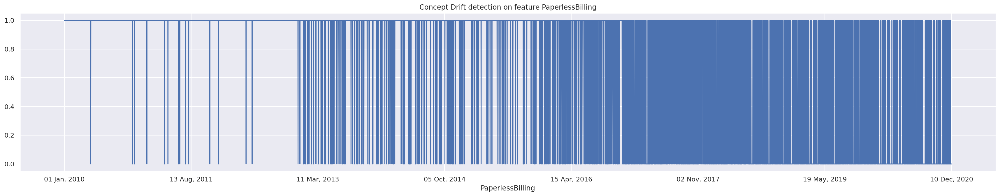

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 22 Nov, 2013
Change detected at index 25 Dec, 2013
Change detected at index 05 Mar, 2014
Change detected at index 20 Nov, 2014
Change detected at index 21 Apr, 2016
Change detected at index 31 Jan, 2017
Change detected at index 24 Mar, 2017
Change detected at index 26 Apr, 2017
Change detected at index 29 May, 2017
Change detected at index 16 Jun, 2017
Change detected at index 17 Oct, 2017
Change detected at index 02 Nov, 2017
Change detected at index 20 Mar, 2018
Change detected at index 17 May, 2019
Change detected at index 16 Jan, 2020
Change detected at index 19 Jun, 2020


In [ ]:
detected_features = plot_stream_data(converted_data_remain_internet_service_option.loc[:, ['PaperlessBilling']])

Same phenomena happened after 2013. 
This one is also an incremental drift.

#### ***5. Bank transfer (automatic), Credit card (automatic), Electronic Check, Mailed Check***

Those are 4 payment methods with one hot encoding. We take a look at first two.

##############################
####### Bank transfer (automatic) #######################


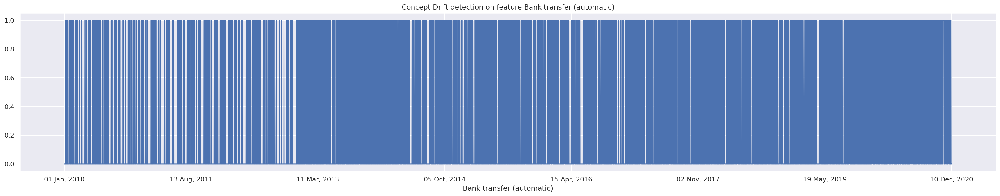

Change detected at index 20 Nov, 2014
Change detected at index 06 Feb, 2016
Change detected at index 09 Apr, 2017
Change detected at index 27 Feb, 2018
Change detected at index 24 Apr, 2020
Change detected at index 27 May, 2020
Change detected at index 19 Jun, 2020
##############################
####### Credit card (automatic) #######################


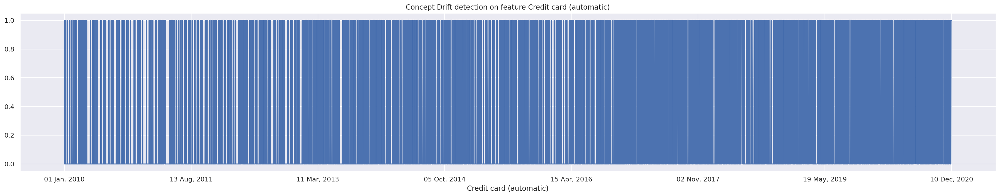

Change detected at index 22 Nov, 2013
Change detected at index 27 May, 2014
Change detected at index 06 Nov, 2014
Change detected at index 09 Dec, 2014
Change detected at index 16 Jun, 2017
Change detected at index 26 May, 2018
Change detected at index 16 Apr, 2019
Change detected at index 04 Feb, 2020
Change detected at index 27 May, 2020


In [ ]:
detected_features = plot_stream_data(converted_data_remain_internet_service_option.loc[:, [
                                                                                'Bank transfer (automatic)',
                                                                                'Credit card (automatic)'
                                                                                ]])

People are starting using those two ways to pay their bills gradually druing 2010 to 2020. But not much. There are also a lot of people choose not to use those at 2020.

This has changes, but not a significant concept drift in those two features.

##############################
####### Electronic Check #######################


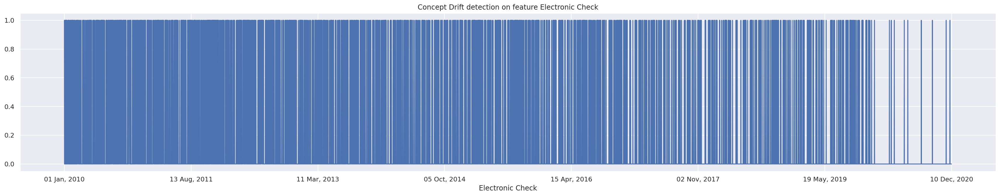

Change detected at index 20 Nov, 2014
Change detected at index 24 Mar, 2017
Change detected at index 30 Sep, 2017
Change detected at index 27 Feb, 2018
Change detected at index 16 Aug, 2019
Change detected at index 28 Feb, 2020
Change detected at index 27 May, 2020
##############################
####### Mailed Check #######################


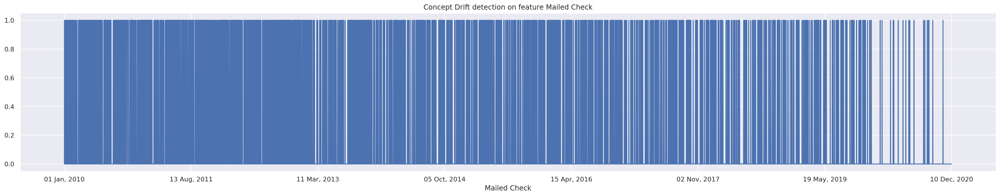

Change detected at index 30 Aug, 2015
Change detected at index 31 Mar, 2016
Change detected at index 09 Apr, 2017
Change detected at index 09 Jul, 2018
Change detected at index 30 Mar, 2020
Change detected at index 27 May, 2020


In [ ]:

detected_features = plot_stream_data(converted_data_remain_internet_service_option.loc[:, [
                                                                                'Electronic Check',
                                                                                'Mailed Check'
                                                                                ]])

Same things happen here, but in an opsite way.

People are stoping using those two ways to pay their bills gradually druing 2010 to 2020. And most of people don't use those after Mar, 2020 anymore.

Those are incremental drifts.

#### ***6. Model Performance on stream data detection***

Now, we know we indeed have concept drift in our data set.

We want to know how bad it is.

We use the function from skmultiflow to load our data to FileStream and use HoeffdingTreeClassifier and EvaluatePrequential to analyze our dataset.

First, we make a new data set with all features and values as numerical numbers.

Since, we are using a new way. We don't do feature selections here. (The performance is the same. We don't write the results here for simplified.)
But we will normalize our data set.

In [ ]:
all_features_data = all_features_remain_and_normalized_pipeline.fit_transform(raw_data_copy)

In [ ]:
all_features_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,PhoneService,InternetService,OnlineSecurity,OnlineBackup,...,StreamingMovies,Contract,PaperlessBilling,Bank transfer (automatic),Credit card (automatic),Electronic Check,Mailed Check,Female,Male,Churn
0,-0.745554,0.02665,1.749703,0,1,1,1,1,0,0,...,0,12,1,0,0,1,0,1,0,0
1,-0.768009,-0.162807,1.749703,0,0,0,1,0,0,0,...,0,1,1,0,0,0,1,0,1,0
2,-0.883393,0.302526,1.749703,0,0,0,1,1,0,0,...,0,1,1,0,1,0,0,0,1,1
3,-0.461207,1.103564,1.748839,1,1,0,1,1,0,0,...,0,1,1,0,1,0,0,0,1,1
4,-0.889327,0.634907,1.747974,1,1,0,1,1,1,1,...,0,1,1,0,0,1,0,1,0,1


Save to a new csv file.

In [ ]:
converted_data.to_csv("stream_data_test.csv")

In [ ]:
 from skmultiflow.data.file_stream import FileStream
 # 1. Load a skmultiflow file stream
 stream = FileStream('/content/stream_data_test.csv')

***This package are not support show_plot anymore with the current matplotlib version. We need to ouput its report and plot by ourselves***

Now, we run EvaluatePrequential function to test our model performance along with the time changes. As our stream data.

In [ ]:
from skmultiflow.data import WaveformGenerator
from skmultiflow.trees import HoeffdingTreeClassifier
from skmultiflow.evaluation import EvaluatePrequential


# 2. Instantiate the HoeffdingTreeClassifier
ht = HoeffdingTreeClassifier()
# 3. Setup the evaluator
evaluator = EvaluatePrequential(show_plot=False,
                                pretrain_size=200,
                                max_samples=20000, output_file='stream_report.csv')
# 4. Run evaluation
evaluator.evaluate(stream=stream, model=ht)

Prequential Evaluation
Evaluating 1 target(s).
Pre-training on 200 sample(s).
Evaluating...
 #################### [100%] [3.65s]
Processed samples: 7032
Mean performance:
M0 - Accuracy     : 0.7406
M0 - Kappa        : 0.2634


[HoeffdingTreeClassifier(binary_split=False, grace_period=200,
                         leaf_prediction='nba', max_byte_size=33554432,
                         memory_estimate_period=1000000, nb_threshold=0,
                         no_preprune=False, nominal_attributes=None,
                         remove_poor_atts=False, split_confidence=1e-07,
                         split_criterion='info_gain', stop_mem_management=False,
                         tie_threshold=0.05)]

Now, we load its report.

In [ ]:
import pandas as pd
# skip row 5, the first 5 rows are long sentences we don't need 
plot_data = pd.read_csv('/content/stream_report.csv',skiprows=5)

In [ ]:
plot_data.head()

,id,mean_acc_[M0],current_acc_[M0],mean_kappa_[M0],current_kappa_[M0]
0,200,1.0000,1.000,0.000000,0.000000
1,399,0.6950,0.695,0.070122,0.070122
2,599,0.6900,0.685,0.031250,0.000000
3,799,0.7050,0.735,0.021198,-0.009524
4,999,0.7175,0.755,0.016664,-0.009893


By reading this function's documentation and instruction in our report's first 5 rows.

We know that id -> the train size it tested.

mean_acc -> the mean accuracy from the beginging to certain train size as ID

current_acc -> the period of steam data's accuracy.

In [ ]:
plot_data.describe()

,id,mean_acc_[M0],current_acc_[M0],mean_kappa_[M0],current_kappa_[M0]
count,36.000000,36.000000,36.000000,36.000000,36.000000
mean,3694.361111,0.731759,0.749306,0.140921,0.243697
std,2099.281852,0.047324,0.061425,0.091255,0.173746
min,200.000000,0.690000,0.650000,0.000000,-0.029281
25%,1949.000000,0.719918,0.713750,0.051446,0.061319
50%,3699.000000,0.723993,0.755000,0.149620,0.294687
75%,5449.000000,0.732076,0.775000,0.230338,0.386345
max,7031.000000,1.000000,1.000000,0.263422,0.461623


We first plot accuracy graph.

Text(0.5, 0, 'train set size')

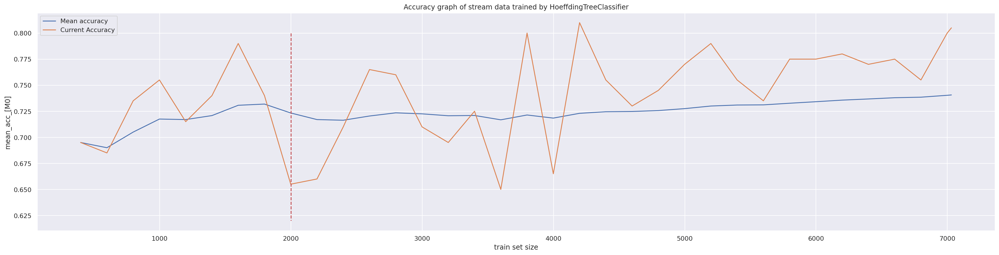

In [ ]:
fig, axs = plt.subplots( figsize=(30,7))
# id = 200 gets accuracy with 100 and kappa with 0, we don't want this
# so we skip the first row and plot the rest.
sns.lineplot(x = plot_data['id'].iloc[1:], y = plot_data['mean_acc_[M0]'].iloc[1:], label='Mean accuracy')
sns.lineplot(x = plot_data['id'].iloc[1:], y = plot_data['current_acc_[M0]'].iloc[1:], label= 'Current Accuracy')
plt.legend()
plt.plot([2000, 2000], [0.8, 0.62], 'r--') # add one red dash line to show the lowest current accuracy
plt.title("Accuracy graph of stream data trained by HoeffdingTreeClassifier")
plt.xlabel("train set size")

We compare this graph with our Internet service, to find out if the performance is influenced by the incremental drift we illustrated before.

##############################
####### InternetService #######################


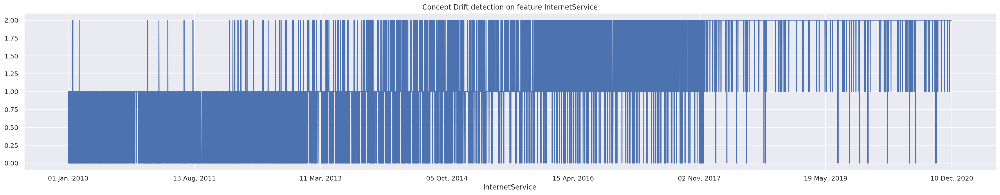

Change detected at index 18 May, 2013
Change detected at index 04 Jun, 2013
Change detected at index 19 Jun, 2013
Change detected at index 22 Nov, 2013
Change detected at index 27 Jan, 2014
Change detected at index 11 Jun, 2014
Change detected at index 30 Aug, 2015
Change detected at index 25 Jan, 2016
Change detected at index 21 Apr, 2016
Change detected at index 27 Aug, 2016
Change detected at index 08 Mar, 2017
Change detected at index 09 Apr, 2017
Change detected at index 18 Jan, 2018
Change detected at index 20 Mar, 2018
Change detected at index 22 Sep, 2018
Change detected at index 05 Nov, 2018
Change detected at index 04 Apr, 2019
Change detected at index 29 Dec, 2019


In [ ]:
plot_stream_data(pd.DataFrame(converted_data_remain_internet_service_option['InternetService']))

By the red line we plot in our accuracy graph. 
We can see that current accuracy trending matches with our assumption that there is a drift from 2013.

There are shifting during 2013 to 2017, when the concept incrementally changed during those 4 years.

And the current accuray becomes better after 2017.

Hence, we could say separate our dataset in two pieces may be a good idea.

Now, it's time to test it.

#### ***7. Testing on new data set separation.***

In [ ]:
# we got our converted data set
converted_data = convert_pipeline.fit_transform(raw_data_copy)
converted_data.head()

,TotalCharges,MonthlyCharges,Tenure,SeniorCitizen,Partner,Dependents,Contract,InternetService,Churn
0,-0.745554,0.02665,1.749703,0,1,1,12,1,0
1,-0.768009,-0.162807,1.749703,0,0,0,1,0,0
2,-0.883393,0.302526,1.749703,0,0,0,1,1,1
3,-0.461207,1.103564,1.748839,1,1,0,1,1,1
4,-0.889327,0.634907,1.747974,1,1,0,1,1,1


Let's make our data loader.

After a few testing, DNN doesn't care about whether we split our dataset, or the concept drift.

Now we testing on random forest.

##### ***1. First we set an baseline, with RandomForest cross validation.***

1. Create orignial size of data set and create train, validation, test set.
Since we are using cross validation, we set our validation loader ratio as 0.0001 and our test size ratio as 0.2. 
We didn't follow assignment 2 Task 2's instruction. Our dataset is too samll. We don't need that ratio of separation here.

In [ ]:
# update new config
config = {
    'seed': 5201314,      # Your seed number, you can pick your lucky number. :)
    'select_all': True,   # Whether to use all features.
    'valid_ratio': 0.0001,   # validation_size = train_size * valid_ratio
    'batch_size': 128,   # since we have a quite large dataset. The batch size should be large too
}

Get our desired dataset.

In [ ]:
from sklearn.model_selection import train_test_split
def stream_data_create_dataset(data):
  training_data, testing_data = train_test_split(data, test_size=0.20, random_state=42) # separate on orginal set.
  train_loader, valid_loader, test_loader = create_data_loader(training_data, testing_data,oversampling=False)
  X_train = train_loader.dataset.x.numpy()
  y_train =train_loader.dataset.y.numpy()
  X_test = test_loader.dataset.x.numpy()
  y_test = test_loader.dataset.y.numpy()
  return X_train, y_train,X_test,y_test

In [ ]:
 X_train_org, y_train_org,X_test_org,y_test_org = stream_data_create_dataset(converted_data)

train_data size: (5624, 9)
  valid_data size: (1, 9)
  test_data size: (1407, 9)
number of features: 8


Initialize classifier


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
import numpy as np

clf =  RandomForestClassifier(max_features=3, n_estimators=22, random_state=42) #Initialize our classifier

Function of ploting results.

In [ ]:
#--------------- output cross validation results---------
def cross_val_output(X_train, y_train, type = 'orignial'):
  # 10-Fold Cross validation
  ACC = cross_val_score(clf, X_train, y_train, scoring='accuracy', cv=10)
  print("Orignial acc accross 10 folds are ", ACC)
  print("Orignial mean ac accross 10 folds are ", ACC.mean())
  ACC_RF = pd.DataFrame(ACC, columns=[str(type)])
  ACC_RF.boxplot()
  plt.title("Boxplot of " + str(type) + " dataset's Accuracy by random forest model")
  plt.xlabel( str(type) + ' dataset')
  plt.ylabel('Accuracy')
  return ACC_RF

Performance on orignial dataset.

Orignial acc accross 10 folds are  [0.76554174 0.78152753 0.77442274 0.77264654 0.8024911  0.8024911
 0.78469751 0.76868327 0.76690391 0.79715302]
Orignial mean ac accross 10 folds are  0.7816558472342497


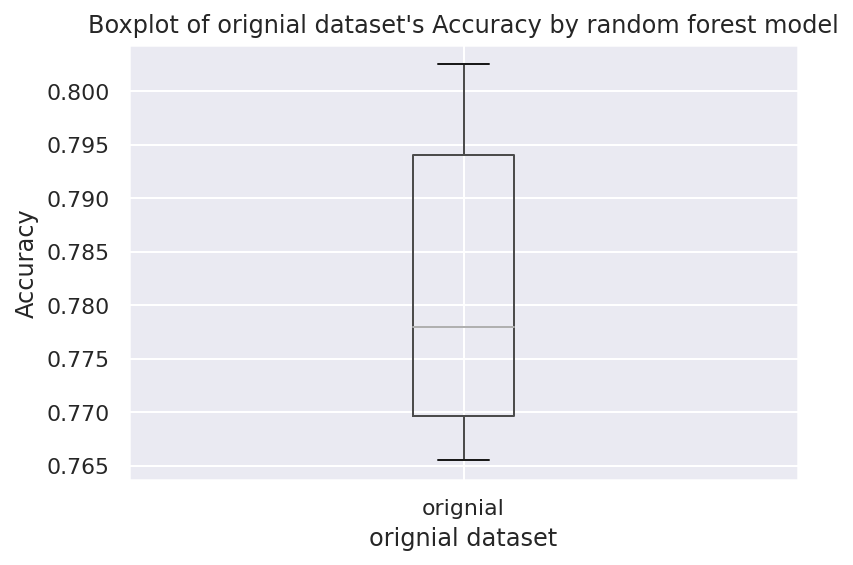

In [ ]:
original_ACC = cross_val_output(X_train_org, y_train_org)

##### ***2. Separate dataset into two parts.***
After testing a few different setting. 
3500 is a good vaule to separate our dataset.

In [ ]:
# we take first part of data from 0 to tarin size 3500
first_part_data = converted_data.iloc[:3500, :]
second_part_data = converted_data.iloc[3500: , :]

##### ***3. Test it on first part.***

In [ ]:
first_part_data.shape

(3500, 9)

In [ ]:
 X_train_1st, y_train_1st,X_test_1st,y_test_1st = stream_data_create_dataset(first_part_data)

train_data size: (2799, 9)
  valid_data size: (1, 9)
  test_data size: (700, 9)
number of features: 8


Draw the boxplot.

Orignial acc accross 10 folds are  [0.78214286 0.76428571 0.77142857 0.76428571 0.775      0.77142857
 0.78214286 0.79285714 0.73571429 0.76702509]
Orignial mean ac accross 10 folds are  0.7706310803891449


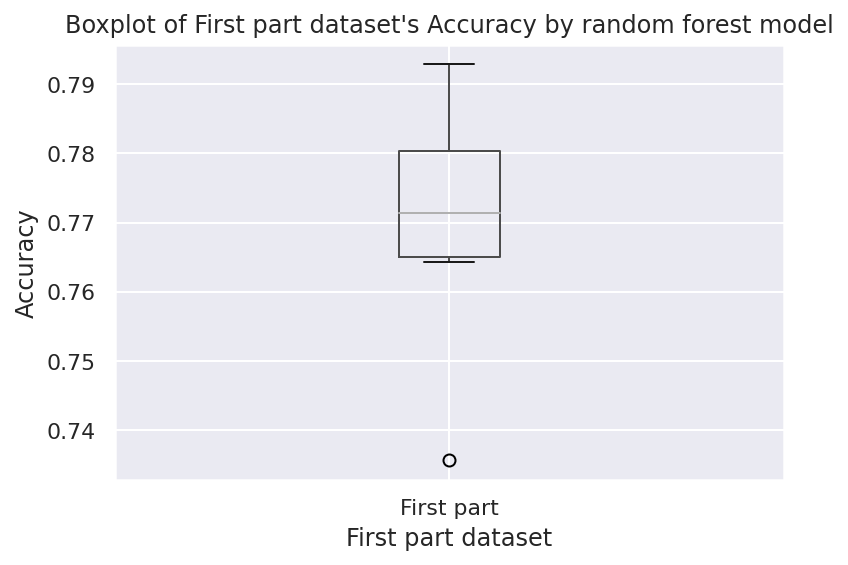

In [ ]:
first_part_acc = cross_val_output( X_train_1st, y_train_1st, 'First part')

##### ***3. Test it on second part.***

In [ ]:
second_part_data.shape

(3532, 9)

In [ ]:
 X_train_2nd, y_train_2nd,X_test_2nd,y_test_2nd = stream_data_create_dataset(second_part_data)

train_data size: (2824, 9)
  valid_data size: (1, 9)
  test_data size: (707, 9)
number of features: 8


Draw the boxplot.

Orignial acc accross 10 folds are  [0.74911661 0.77738516 0.81272085 0.76325088 0.81914894 0.79078014
 0.78368794 0.76595745 0.81560284 0.78723404]
Orignial mean ac accross 10 folds are  0.7864884845750947


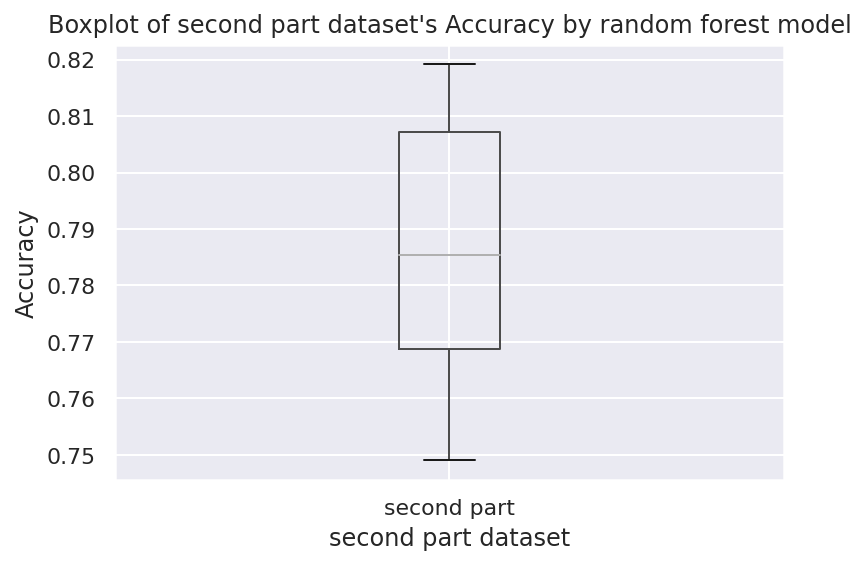

In [ ]:
secnod_part_acc = cross_val_output(X_train_2nd, y_train_2nd, 'second part')

##### ***3. Boxplot on 3 results.***

In [ ]:
# combine 3 results
result = pd.concat([original_ACC, first_part_acc, secnod_part_acc], axis=1)

Draw the boxplot.

Text(0.5, 1.0, 'Random Forest on testing stream data')

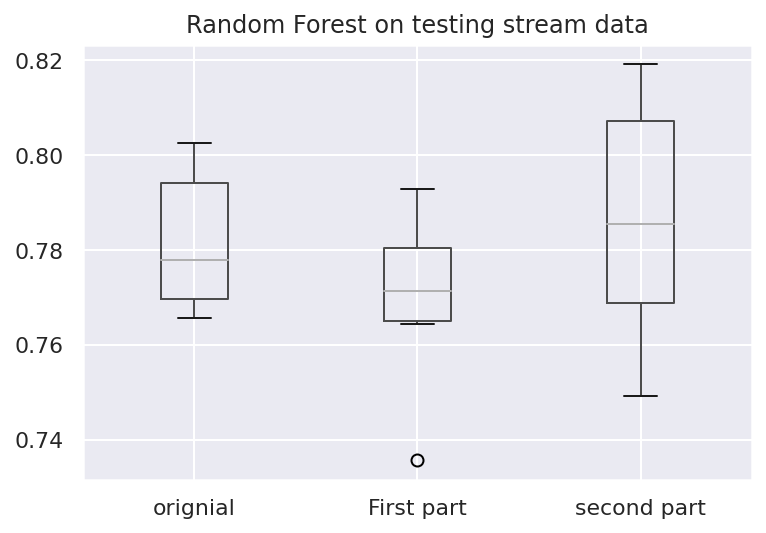

In [ ]:
result.boxplot()
plt.title("Random Forest on testing stream data")

We can see that we have some of improvment than the original datasets.
But because of the lack of enough instances, the first part and second part's performance are not stable.

Now, let's do the significant test.

In [ ]:
def test_scores_on_two_models_stream_data(data, type = 'Accuracy'):
  figure(figsize=(5, 5), dpi=100)
  ax = sns.boxplot(data=data)
  plt.ylabel(str(type))
  plt.title('Boxplot of '+ str(type)+ 'between ' + str(data.columns[0]) + 'and' + str(data.columns[1]))
  ks_2samp_test(data,  str(data.columns[0]) , str(data.columns[1]))
  return 0

##################### p-value =  0.7869297884777761 ####################
Samples are likely drawn from the same distributions (fail to reject H0)


0

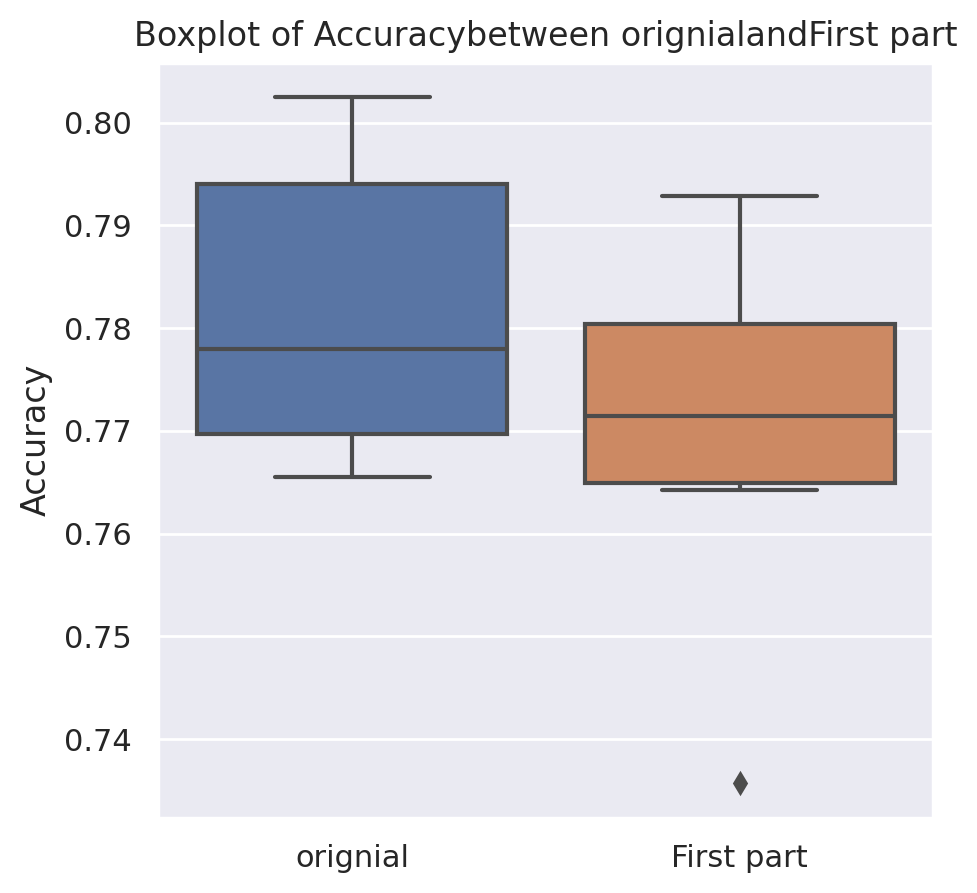

In [ ]:
test_scores_on_two_models_stream_data(result.iloc[:, :2]) # select first two columns

##################### p-value =  0.7869297884777761 ####################
Samples are likely drawn from the same distributions (fail to reject H0)


0

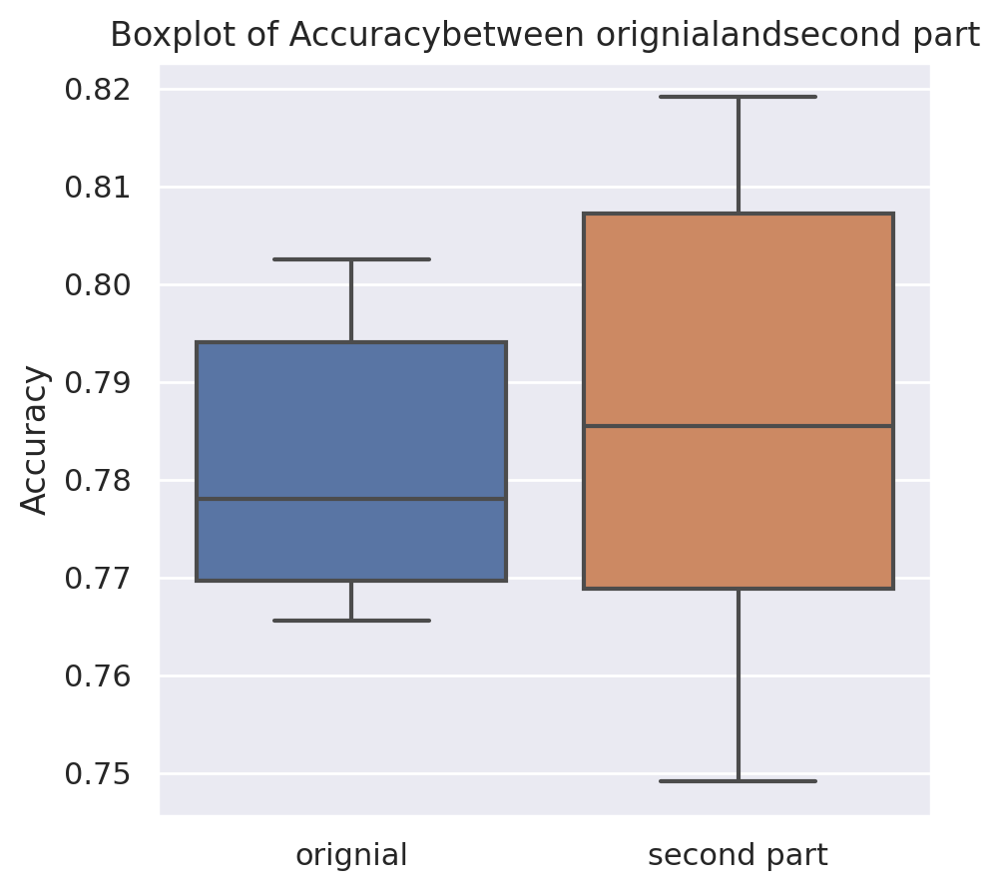

In [ ]:
test_scores_on_two_models_stream_data(result.iloc[:, [0,2]])

Unfortunately, our significant test can not reject our Hypothesis. 

That is our actions doesn't improve the performance in our dataset.

But I believe if we have more datasets. This will work.
We are seeing the trending of improving. But just not there yet.

# <center>References</center>


1. Python Software Foundation. (n.d.). Date time - Basic date and time types. Python. https://docs.python.org/3/library/datetime.html#strftime-and-strptime-behavior
2. Hmghaly. (2013, October 7). Sklearn plot confusion matrix with labels. Stackoverflow. https://stackoverflow.com/questions/19233771/sklearn-plot-confusion-matrix-with-labels
3. R Documentation. (n.d.). Prop.table: Express Table Entries as Fraction of Marginal Table. RDocumentation. https://www.rdocumentation.org/packages/base/versions/3.6.2/topics/prop.table
4. Learning Curve. (n.d.). In Wikipedia. Retrieved July 3, 2022, from https://en.wikipedia.org/wiki/Learning_curve 
5. Scikit learn. (n.d.). Sklearn.svm.SVC. Scikit learn. https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
6. Early stopping. (n.d.). In Wikipedia. Retrieved July 3, 2022, from https://en.wikipedia.org/wiki/Early_stopping 
7. Kassambara, A. (2018). Machine Learning Essentials: Practical Guide in R. CreateSpace Independent Publishing Platform. https://www.datanovia.com/en/product/machine-learning-essentials-practical-guide-in-r/?url=/5-bookadvisor/54-machine-learning-essentials/
8. Hung-Yi Lee. (n.d.). Hung-Yi Lee. Retrieved June 22, 2022, from https://speech.ee.ntu.edu.tw/~hylee/index.php
9. Learning Curve. (n.d.). In Wikipedia. Retrieved June 22, 2022, from https://en.wikipedia.org/wiki/Learning_curve
10. Hung-Yi Lee. (n.d.). Hung-Yi Lee. Retrieved June 22, 2022, from https://speech.ee.ntu.edu.tw/~hylee/index.php
11. Early stopping. (n.d.). In Wikipedia. Retrieved June 22, 2022, from https://en.wikipedia.org/wiki/Early_stopping
12. AdamW. (n.d.). Knowledge Center. Retrieved June 22, 2022, from https://peltarion.com/knowledge-center/documentation/modeling-view/run-a-model/optimizers/adamw
13. Prakharr0y. (2020, October 24). Intuition of Adam Optimizer. GeeksforGeeks. https://www.geeksforgeeks.org/intuition-of-adam-optimizer/
14. Lee, H. (n.d.). Error surface is rugged… Tips for training: Adaptive Learning Rate. (n.d.). Hung-Yi Lee. https://speech.ee.ntu.edu.tw/~hylee/ml/ml2021-course-data/optimizer_v4.pdf
15. Lee, H. (2022, March 6). 【機器學習 2022】魚與熊掌可以兼得的深度學習 [Video]. YouTube. https://www.youtube.com/watch?v=yXd2D5J0QDU&t=1249s
16. Kelleher, J. D. & Name, B. M. (2020). Fundamentals of ML for Predictive Data Analytics: Algorithms, Worked Examples, and Case Studies. The MIT Press. 
17. ADAMW. (2019). Pytorch. Retrieved June 22, 2022, from https://pytorch.org/docs/stable/generated/torch.optim.AdamW.html
18. Géron, A. (2019).  Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 2nd Edition. O'Reilly Media, Inc.
